# Optimization Methods

The right ones can tremendously speed up learning, and increase model performance

#### Packages

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import scipy.io
import math
import sklearn
import sklearn.datasets

from opt_utils_v1a import load_params_and_grads, initialize_parameters, forward_propagation, backward_propagation
from opt_utils_v1a import compute_cost, predict, predict_dec, plot_decision_boundary, load_dataset
from testCases import *

%matplotlib inline
plt.style.use(['dark_background'])
plt.rcParams['figure.figsize'] = (7.0, 4.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

#### Gradient Descent

GD is a simple optimization method. When you take gradient steps with respect to all examples on each step, it is also called Batch GD.

In [2]:
def update_parameters_with_gd(parameters, grads, learning_rate):
    """
    Update parameters using one step of gradient descent
    
    Arguments:
    parameters -- python dictionary containing your parameters to be updated:
                    parameters['W' + str(l)] = Wl
                    parameters['b' + str(l)] = bl
    grads -- python dictionary containing your gradients to update each parameters:
                    grads['dW' + str(l)] = dWl
                    grads['db' + str(l)] = dbl
    learning_rate -- the learning rate, scalar.
    
    Returns:
    parameters -- python dictionary containing your updated parameters 
    """
    L = len(parameters) // 2 # number of layers in the neural networks

    # Update rule for each parameter
    for l in range(L):
        parameters["W" + str(l+1)] = parameters["W" + str(l+1)] - learning_rate*grads['dW' + str(l+1)]
        parameters["b" + str(l+1)] = parameters["b" + str(l+1)] - learning_rate*grads['db' + str(l+1)]
        
    return parameters

In [3]:
parameters, grads, learning_rate = update_parameters_with_gd_test_case()

parameters = update_parameters_with_gd(parameters, grads, learning_rate)
print("W1 =\n" + str(parameters["W1"]))
print("b1 =\n" + str(parameters["b1"]))
print("W2 =\n" + str(parameters["W2"]))
print("b2 =\n" + str(parameters["b2"]))

W1 =
[[ 1.63535156 -0.62320365 -0.53718766]
 [-1.07799357  0.85639907 -2.29470142]]
b1 =
[[ 1.74604067]
 [-0.75184921]]
W2 =
[[ 0.32171798 -0.25467393  1.46902454]
 [-2.05617317 -0.31554548 -0.3756023 ]
 [ 1.1404819  -1.09976462 -0.1612551 ]]
b2 =
[[-0.88020257]
 [ 0.02561572]
 [ 0.57539477]]


A variant of this is SGD (Stochastic Gradient Descent), which is equivalent to MBGD (Mini Batch GD) where each mini-batch has just one example. Essentially training one example at a time.

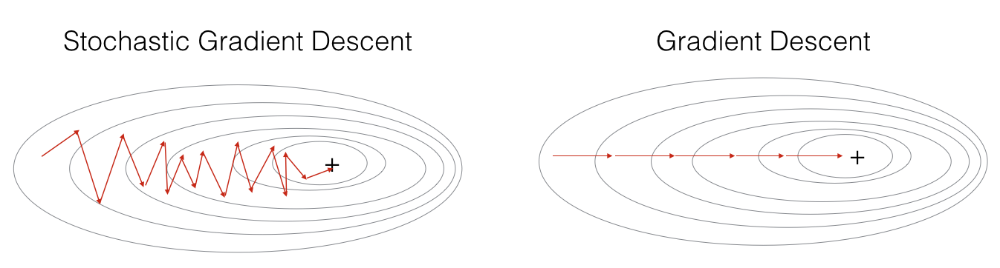

When the training set is large, SGD can be faster but the parameters will "oscillate"

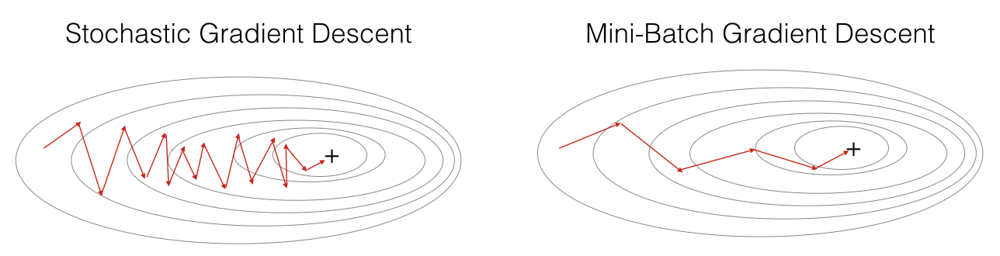

#### Mini-Batch Gradient Descent

Shuffling the training set and target labels synchronously

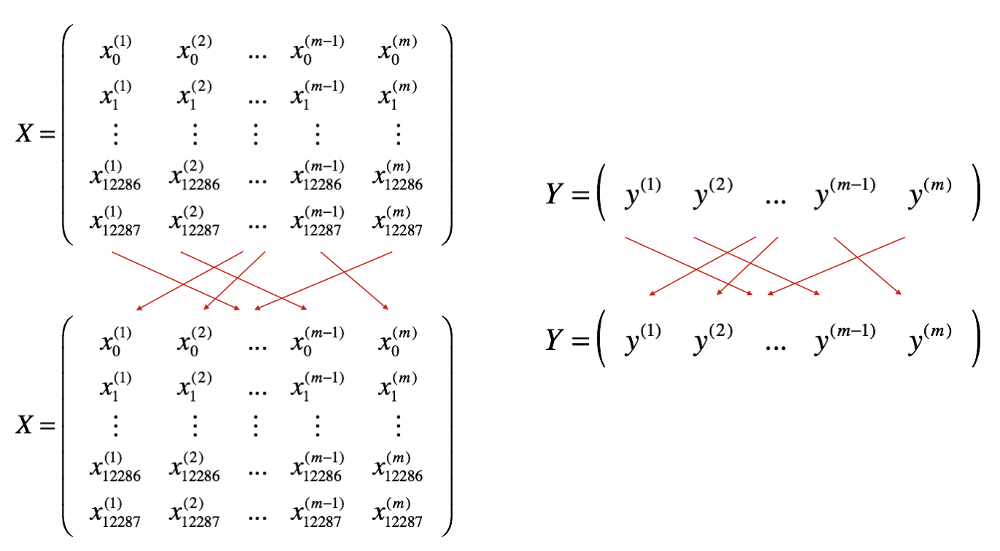

Partitioning the training set into mini-batches of a determined size

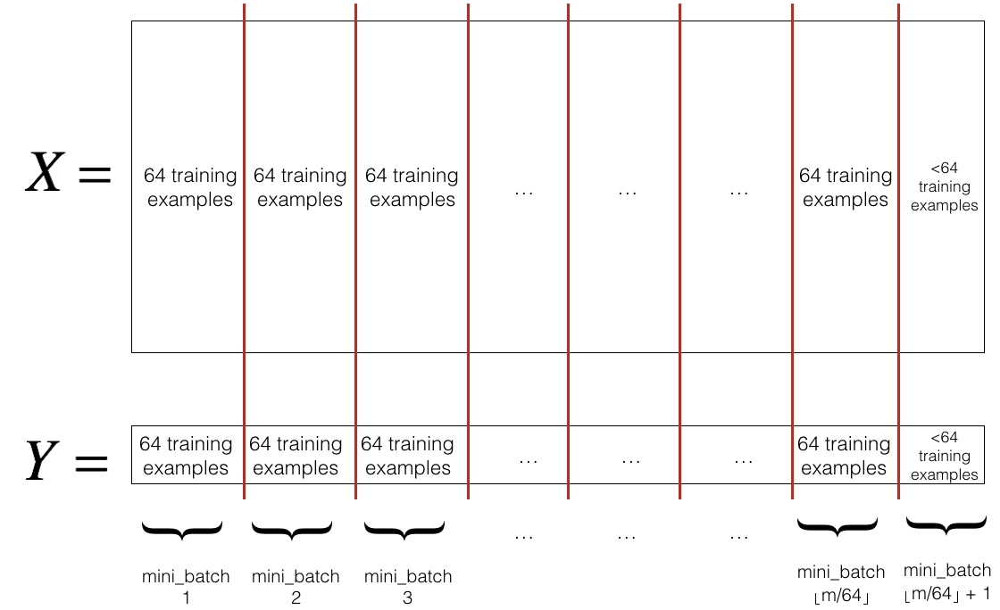

In [4]:
def random_mini_batches(X, Y, mini_batch_size = 64, seed = 0):
    """
    Creates a list of random minibatches from (X, Y)
    
    Arguments:
    X -- input data, of shape (input size, number of examples)
    Y -- true "label" vector (1 for blue dot / 0 for red dot), of shape (1, number of examples)
    mini_batch_size -- size of the mini-batches, integer
    
    Returns:
    mini_batches -- list of synchronous (mini_batch_X, mini_batch_Y)
    """
    np.random.seed(seed)            # To make your "random" minibatches the same as ours
    m = X.shape[1]                  # number of training examples
    mini_batches = []
        
    # Step 1: Shuffle (X, Y)
    permutation = list(np.random.permutation(m))
    shuffled_X = X[:, permutation]
    shuffled_Y = Y[:, permutation].reshape((1,m))

    # Step 2: Partition (shuffled_X, shuffled_Y). Minus the end case.
    num_complete_minibatches = math.floor(m/mini_batch_size) # number of mini batches of size mini_batch_size in your partitionning
    for k in range(0, num_complete_minibatches):
        mini_batch_X = shuffled_X[:, k*mini_batch_size : (k+1)*mini_batch_size]
        mini_batch_Y = shuffled_Y[:, k*mini_batch_size : (k+1)*mini_batch_size]
        mini_batch = (mini_batch_X, mini_batch_Y)
        mini_batches.append(mini_batch)
    
    # Handling the end case (last mini-batch < mini_batch_size)
    if m % mini_batch_size != 0:
        mini_batch_X = shuffled_X[:, int(m/mini_batch_size)*mini_batch_size : ]
        mini_batch_Y = shuffled_Y[:, int(m/mini_batch_size)*mini_batch_size : ]
        mini_batch = (mini_batch_X, mini_batch_Y)
        mini_batches.append(mini_batch)
    
    return mini_batches

In [5]:
X_assess, Y_assess, mini_batch_size = random_mini_batches_test_case()
mini_batches = random_mini_batches(X_assess, Y_assess, mini_batch_size)

print ("shape of the 1st mini_batch_X: " + str(mini_batches[0][0].shape))
print ("shape of the 2nd mini_batch_X: " + str(mini_batches[1][0].shape))
print ("shape of the 3rd mini_batch_X: " + str(mini_batches[2][0].shape))
print ("shape of the 1st mini_batch_Y: " + str(mini_batches[0][1].shape))
print ("shape of the 2nd mini_batch_Y: " + str(mini_batches[1][1].shape)) 
print ("shape of the 3rd mini_batch_Y: " + str(mini_batches[2][1].shape))
print ("mini batch sanity check: " + str(mini_batches[0][0][0][0:3]))

shape of the 1st mini_batch_X: (12288, 64)
shape of the 2nd mini_batch_X: (12288, 64)
shape of the 3rd mini_batch_X: (12288, 20)
shape of the 1st mini_batch_Y: (1, 64)
shape of the 2nd mini_batch_Y: (1, 64)
shape of the 3rd mini_batch_Y: (1, 20)
mini batch sanity check: [ 0.90085595 -0.7612069   0.2344157 ]


#### Momentum

MBGD makes a parameter update after seeing a subset of examples, this causes the direction of the update to have some variance. We can control these oscillations using momentum; This is done by taking account the past gradients to smooth out the update

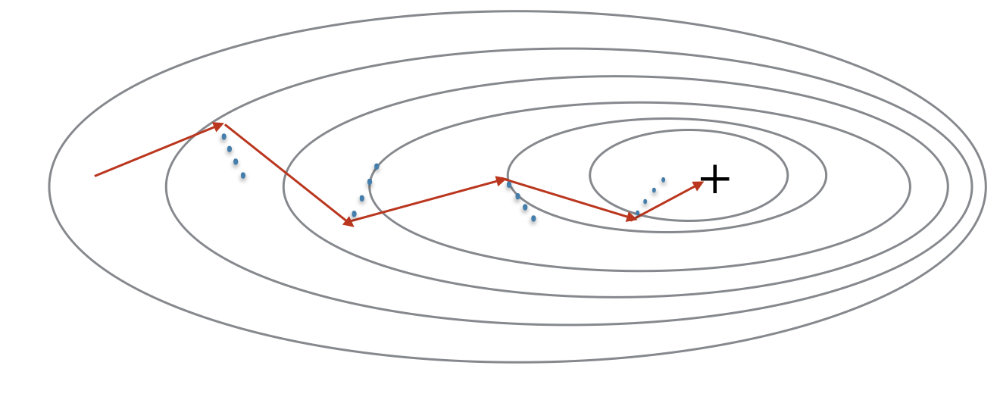

In [6]:
def initialize_velocity(parameters):
    """
    Initializes the velocity as a python dictionary with:
                - keys: "dW1", "db1", ..., "dWL", "dbL" 
                - values: numpy arrays of zeros of the same shape as the corresponding gradients/parameters.
    Arguments:
    parameters -- python dictionary containing your parameters.
                    parameters['W' + str(l)] = Wl
                    parameters['b' + str(l)] = bl
    
    Returns:
    v -- python dictionary containing the current velocity.
                    v['dW' + str(l)] = velocity of dWl
                    v['db' + str(l)] = velocity of dbl
    """
    L = len(parameters) // 2 # number of layers in the neural networks
    v = {}
    
    # Initialize velocity
    for l in range(L):
        v["dW" + str(l+1)] = np.zeros((parameters["W" + str(l+1)].shape[0], parameters["W" + str(l+1)].shape[1]))
        v["db" + str(l+1)] = np.zeros((parameters["b" + str(l+1)].shape[0], parameters["b" + str(l+1)].shape[1]))
        
    return v

In [7]:
parameters = initialize_velocity_test_case()

v = initialize_velocity(parameters)
print("v[\"dW1\"] =\n" + str(v["dW1"]))
print("v[\"db1\"] =\n" + str(v["db1"]))
print("v[\"dW2\"] =\n" + str(v["dW2"]))
print("v[\"db2\"] =\n" + str(v["db2"]))

v["dW1"] =
[[0. 0. 0.]
 [0. 0. 0.]]
v["db1"] =
[[0.]
 [0.]]
v["dW2"] =
[[0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]]
v["db2"] =
[[0.]
 [0.]
 [0.]]


In [8]:
def update_parameters_with_momentum(parameters, grads, v, beta, learning_rate):
    """
    Update parameters using Momentum
    
    Arguments:
    parameters -- python dictionary containing your parameters:
                    parameters['W' + str(l)] = Wl
                    parameters['b' + str(l)] = bl
    grads -- python dictionary containing your gradients for each parameters:
                    grads['dW' + str(l)] = dWl
                    grads['db' + str(l)] = dbl
    v -- python dictionary containing the current velocity:
                    v['dW' + str(l)] = ...
                    v['db' + str(l)] = ...
    beta -- the momentum hyperparameter, scalar
    learning_rate -- the learning rate, scalar
    
    Returns:
    parameters -- python dictionary containing your updated parameters 
    v -- python dictionary containing your updated velocities
    """
    L = len(parameters) // 2 # number of layers in the neural networks
    
    # Momentum update for each parameter
    for l in range(L):
        # compute velocities
        v["dW" + str(l+1)] = beta*v["dW" + str(l+1)] + (1 - beta)*grads['dW' + str(l+1)]
        v["db" + str(l+1)] = beta*v["db" + str(l+1)] + (1 - beta)*grads['db' + str(l+1)]
        # update parameters
        parameters["W" + str(l+1)] = parameters["W" + str(l+1)] - learning_rate*v["dW" + str(l+1)]
        parameters["b" + str(l+1)] = parameters["b" + str(l+1)] - learning_rate*v["db" + str(l+1)]
        
    return parameters, v

In [9]:
parameters, grads, v = update_parameters_with_momentum_test_case()

parameters, v = update_parameters_with_momentum(parameters, grads, v, beta = 0.9, learning_rate = 0.01)
print("W1 = \n" + str(parameters["W1"]))
print("b1 = \n" + str(parameters["b1"]))
print("W2 = \n" + str(parameters["W2"]))
print("b2 = \n" + str(parameters["b2"]))
print("v[\"dW1\"] = \n" + str(v["dW1"]))
print("v[\"db1\"] = \n" + str(v["db1"]))
print("v[\"dW2\"] = \n" + str(v["dW2"]))
print("v[\"db2\"] = v" + str(v["db2"]))

W1 = 
[[ 1.62544598 -0.61290114 -0.52907334]
 [-1.07347112  0.86450677 -2.30085497]]
b1 = 
[[ 1.74493465]
 [-0.76027113]]
W2 = 
[[ 0.31930698 -0.24990073  1.4627996 ]
 [-2.05974396 -0.32173003 -0.38320915]
 [ 1.13444069 -1.0998786  -0.1713109 ]]
b2 = 
[[-0.87809283]
 [ 0.04055394]
 [ 0.58207317]]
v["dW1"] = 
[[-0.11006192  0.11447237  0.09015907]
 [ 0.05024943  0.09008559 -0.06837279]]
v["db1"] = 
[[-0.01228902]
 [-0.09357694]]
v["dW2"] = 
[[-0.02678881  0.05303555 -0.06916608]
 [-0.03967535 -0.06871727 -0.08452056]
 [-0.06712461 -0.00126646 -0.11173103]]
v["db2"] = v[[0.02344157]
 [0.16598022]
 [0.07420442]]


#### Adam

Adam combines RMSProp and Momentum;
- Caluculates exponentially weighted average of past gradients, and stores it as variables before and after bias correction
- Calculates exponentially weighted average of the square of the past gradients, and stores it as variables before and after bias correction
- Updates parameters in a direction based on combining information above

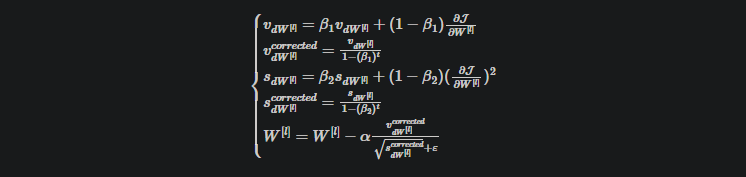

In [10]:
def initialize_adam(parameters) :
    """
    Initializes v and s as two python dictionaries with:
                - keys: "dW1", "db1", ..., "dWL", "dbL" 
                - values: numpy arrays of zeros of the same shape as the corresponding gradients/parameters.
    
    Arguments:
    parameters -- python dictionary containing your parameters.
                    parameters["W" + str(l)] = Wl
                    parameters["b" + str(l)] = bl
    
    Returns: 
    v -- python dictionary that will contain the exponentially weighted average of the gradient.
                    v["dW" + str(l)] = ...
                    v["db" + str(l)] = ...
    s -- python dictionary that will contain the exponentially weighted average of the squared gradient.
                    s["dW" + str(l)] = ...
                    s["db" + str(l)] = ...

    """
    L = len(parameters) // 2 # number of layers in the neural networks
    v = {}
    s = {}
    
    # Initialize v, s. Input: "parameters". Outputs: "v, s".
    for l in range(L):
        v["dW" + str(l+1)] = np.zeros((parameters["W" + str(l+1)].shape[0], parameters["W" + str(l+1)].shape[1]))
        v["db" + str(l+1)] = np.zeros((parameters["b" + str(l+1)].shape[0], parameters["b" + str(l+1)].shape[1]))
        s["dW" + str(l+1)] = np.zeros((parameters["W" + str(l+1)].shape[0], parameters["W" + str(l+1)].shape[1]))
        s["db" + str(l+1)] = np.zeros((parameters["b" + str(l+1)].shape[0], parameters["b" + str(l+1)].shape[1]))
    
    return v, s

In [11]:
parameters = initialize_adam_test_case()

v, s = initialize_adam(parameters)
print("v[\"dW1\"] = \n" + str(v["dW1"]))
print("v[\"db1\"] = \n" + str(v["db1"]))
print("v[\"dW2\"] = \n" + str(v["dW2"]))
print("v[\"db2\"] = \n" + str(v["db2"]))
print("s[\"dW1\"] = \n" + str(s["dW1"]))
print("s[\"db1\"] = \n" + str(s["db1"]))
print("s[\"dW2\"] = \n" + str(s["dW2"]))
print("s[\"db2\"] = \n" + str(s["db2"]))

v["dW1"] = 
[[0. 0. 0.]
 [0. 0. 0.]]
v["db1"] = 
[[0.]
 [0.]]
v["dW2"] = 
[[0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]]
v["db2"] = 
[[0.]
 [0.]
 [0.]]
s["dW1"] = 
[[0. 0. 0.]
 [0. 0. 0.]]
s["db1"] = 
[[0.]
 [0.]]
s["dW2"] = 
[[0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]]
s["db2"] = 
[[0.]
 [0.]
 [0.]]


In [12]:
def update_parameters_with_adam(parameters, grads, v, s, t, learning_rate = 0.01,
                                beta1 = 0.9, beta2 = 0.999,  epsilon = 1e-8):
    """
    Update parameters using Adam
    
    Arguments:
    parameters -- python dictionary containing your parameters:
                    parameters['W' + str(l)] = Wl
                    parameters['b' + str(l)] = bl
    grads -- python dictionary containing your gradients for each parameters:
                    grads['dW' + str(l)] = dWl
                    grads['db' + str(l)] = dbl
    v -- Adam variable, moving average of the first gradient, python dictionary
    s -- Adam variable, moving average of the squared gradient, python dictionary
    learning_rate -- the learning rate, scalar.
    beta1 -- Exponential decay hyperparameter for the first moment estimates 
    beta2 -- Exponential decay hyperparameter for the second moment estimates 
    epsilon -- hyperparameter preventing division by zero in Adam updates

    Returns:
    parameters -- python dictionary containing your updated parameters 
    v -- Adam variable, moving average of the first gradient, python dictionary
    s -- Adam variable, moving average of the squared gradient, python dictionary
    """
    L = len(parameters) // 2                 # number of layers in the neural networks
    v_corrected = {}                         # Initializing first moment estimate, python dictionary
    s_corrected = {}                         # Initializing second moment estimate, python dictionary
    
    # Perform Adam update on all parameters
    for l in range(L):
        # Moving average of the gradients. Inputs: "v, grads, beta1". Output: "v".
        v["dW" + str(l+1)] = beta1*v["dW" + str(l+1)] + (1 - beta1)*grads['dW' + str(l+1)]
        v["db" + str(l+1)] = beta1*v["db" + str(l+1)] + (1 - beta1)*grads['db' + str(l+1)]

        # Compute bias-corrected first moment estimate. Inputs: "v, beta1, t". Output: "v_corrected".
        v_corrected["dW" + str(l+1)] = v["dW" + str(l+1)]/(1 - beta1**t)
        v_corrected["db" + str(l+1)] = v["db" + str(l+1)]/(1 - beta1**t)

        # Moving average of the squared gradients. Inputs: "s, grads, beta2". Output: "s".
        s["dW" + str(l+1)] = beta2*s["dW" + str(l+1)] + (1 - beta2)*np.square(grads['dW' + str(l+1)])
        s["db" + str(l+1)] = beta2*s["db" + str(l+1)] + (1 - beta2)*np.square(grads['db' + str(l+1)])

        # Compute bias-corrected second raw moment estimate. Inputs: "s, beta2, t". Output: "s_corrected".
        s_corrected["dW" + str(l+1)] = s["dW" + str(l+1)]/(1 - beta2**t)
        s_corrected["db" + str(l+1)] = s["db" + str(l+1)]/(1 - beta2**t)

        # Update parameters. Inputs: "parameters, learning_rate, v_corrected, s_corrected, epsilon". Output: "parameters".
        parameters["W" + str(l+1)] = parameters["W" + str(l+1)] - learning_rate*v_corrected["dW" + str(l+1)]/(np.sqrt(s_corrected["dW" + str(l+1)])+epsilon)
        parameters["b" + str(l+1)] = parameters["b" + str(l+1)] - learning_rate*v_corrected["db" + str(l+1)]/(np.sqrt(s_corrected["db" + str(l+1)])+epsilon)

    return parameters, v, s

In [13]:
parameters, grads, v, s = update_parameters_with_adam_test_case()
parameters, v, s  = update_parameters_with_adam(parameters, grads, v, s, t = 2)

print("W1 = \n" + str(parameters["W1"]))
print("b1 = \n" + str(parameters["b1"]))
print("W2 = \n" + str(parameters["W2"]))
print("b2 = \n" + str(parameters["b2"]))
print("v[\"dW1\"] = \n" + str(v["dW1"]))
print("v[\"db1\"] = \n" + str(v["db1"]))
print("v[\"dW2\"] = \n" + str(v["dW2"]))
print("v[\"db2\"] = \n" + str(v["db2"]))
print("s[\"dW1\"] = \n" + str(s["dW1"]))
print("s[\"db1\"] = \n" + str(s["db1"]))
print("s[\"dW2\"] = \n" + str(s["dW2"]))
print("s[\"db2\"] = \n" + str(s["db2"]))

W1 = 
[[ 1.63178673 -0.61919778 -0.53561312]
 [-1.08040999  0.85796626 -2.29409733]]
b1 = 
[[ 1.75225313]
 [-0.75376553]]
W2 = 
[[ 0.32648046 -0.25681174  1.46954931]
 [-2.05269934 -0.31497584 -0.37661299]
 [ 1.14121081 -1.09244991 -0.16498684]]
b2 = 
[[-0.88529979]
 [ 0.03477238]
 [ 0.57537385]]
v["dW1"] = 
[[-0.11006192  0.11447237  0.09015907]
 [ 0.05024943  0.09008559 -0.06837279]]
v["db1"] = 
[[-0.01228902]
 [-0.09357694]]
v["dW2"] = 
[[-0.02678881  0.05303555 -0.06916608]
 [-0.03967535 -0.06871727 -0.08452056]
 [-0.06712461 -0.00126646 -0.11173103]]
v["db2"] = 
[[0.02344157]
 [0.16598022]
 [0.07420442]]
s["dW1"] = 
[[0.00121136 0.00131039 0.00081287]
 [0.0002525  0.00081154 0.00046748]]
s["db1"] = 
[[1.51020075e-05]
 [8.75664434e-04]]
s["dW2"] = 
[[7.17640232e-05 2.81276921e-04 4.78394595e-04]
 [1.57413361e-04 4.72206320e-04 7.14372576e-04]
 [4.50571368e-04 1.60392066e-07 1.24838242e-03]]
s["db2"] = 
[[5.49507194e-05]
 [2.75494327e-03]
 [5.50629536e-04]]


#### Method Testing

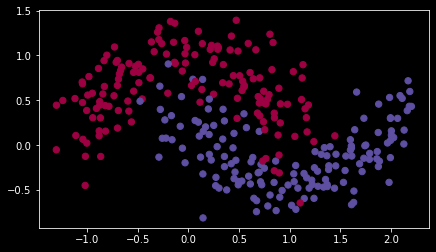

In [14]:
train_X, train_Y = load_dataset()

In [15]:
def model(X, Y, layers_dims, optimizer, learning_rate = 0.0007, mini_batch_size = 64, beta = 0.9,
          beta1 = 0.9, beta2 = 0.999,  epsilon = 1e-8, num_epochs = 10000, print_cost = True):
    """
    3-layer neural network model which can be run in different optimizer modes.
    
    Arguments:
    X -- input data, of shape (2, number of examples)
    Y -- true "label" vector (1 for blue dot / 0 for red dot), of shape (1, number of examples)
    layers_dims -- python list, containing the size of each layer
    learning_rate -- the learning rate, scalar.
    mini_batch_size -- the size of a mini batch
    beta -- Momentum hyperparameter
    beta1 -- Exponential decay hyperparameter for the past gradients estimates 
    beta2 -- Exponential decay hyperparameter for the past squared gradients estimates 
    epsilon -- hyperparameter preventing division by zero in Adam updates
    num_epochs -- number of epochs
    print_cost -- True to print the cost every 1000 epochs

    Returns:
    parameters -- python dictionary containing your updated parameters 
    """
    L = len(layers_dims)             # number of layers in the neural networks
    costs = []                       # to keep track of the cost
    t = 0                            # initializing the counter required for Adam update
    seed = 10                        # For grading purposes, so that your "random" minibatches are the same as ours
    m = X.shape[1]                   # number of training examples
    print("\nThe number of training examples is : %i\n" %m)
    print("The mini-batch size : %i\n" %mini_batch_size)
    # Initialize parameters
    parameters = initialize_parameters(layers_dims)

    # Initialize the optimizer
    if optimizer == "gd":
        pass # no initialization required for gradient descent
    elif optimizer == "momentum":
        v = initialize_velocity(parameters)
    elif optimizer == "adam":
        v, s = initialize_adam(parameters)
    
    # Optimization loop
    for i in range(num_epochs):
        
        # Define the random minibatches. We increment the seed to reshuffle differently the dataset after each epoch
        seed = seed + 1
        minibatches = random_mini_batches(X, Y, mini_batch_size, seed)
        cost_total = 0
        
        for minibatch in minibatches:

            # Select a minibatch
            (minibatch_X, minibatch_Y) = minibatch

            # Forward propagation
            a3, caches = forward_propagation(minibatch_X, parameters)

            # Compute cost and add to the cost total
            cost_total += compute_cost(a3, minibatch_Y)
            print("\n OK OK \n")
            print(minibatch_Y)
            print("\n OK OK \n")

            # Backward propagation
            grads = backward_propagation(minibatch_X, minibatch_Y, caches)

            # Update parameters
            if optimizer == "gd":
                parameters = update_parameters_with_gd(parameters, grads, learning_rate)
            elif optimizer == "momentum":
                parameters, v = update_parameters_with_momentum(parameters, grads, v, beta, learning_rate)
            elif optimizer == "adam":
                t = t + 1 # Adam counter
                parameters, v, s = update_parameters_with_adam(parameters, grads, v, s,
                                                               t, learning_rate, beta1, beta2,  epsilon)
        cost_avg = cost_total / m
        
        # Print the cost every 1000 epoch
        if print_cost and i % 1000 == 0:
            print ("Cost after epoch %i: %f" %(i, cost_avg))
        if print_cost and i % 100 == 0:
            costs.append(cost_avg)
                
    # plot the cost
    plt.plot(costs)
    plt.ylabel('cost')
    plt.xlabel('epochs (per 100)')
    plt.title("Learning rate = " + str(learning_rate))
    plt.show()

    return parameters

#### MBGD Test


The number of training examples is : 300

The mini-batch size : 64


 OK OK 

[[1 0 1 0 1 1 0 0 1 0 1 1 0 0 1 1 1 0 0 1 0 0 1 0 0 1 0 0 0 1 0 0 1 0 0 1
  1 1 0 1 0 1 1 1 1 0 1 0 1 0 1 0 1 1 0 0 1 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 1 1 0 1 0 1 0 0 0 1 1 0 1 1 0 0 0 0 0 0 0 1 1 1 1 0 1 1 0
  1 0 0 0 0 1 1 1 0 1 1 1 0 0 0 1 1 0 1 1 0 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0 1 0 1 1 0 1 1 1 0 1 0 0 0 1 1 1 1 1 1 1
  1 1 0 1 1 1 1 1 1 1 1 0 1 1 0 1 0 0 0 0 1 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 0 1 0 1 0 0 1 1 0 1 0 1 0 1 1 1 1 0 1 0 0 0 0 1 1 1 0 0 1
  0 1 1 0 0 0 0 0 0 0 0 1 1 1 1 0 1 0 0 0 1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 0 1 0 1 0 0 0 0 1 0 1 1 0 1 0 1 0 0 0 1 0 1 1 1 1 0 1 1 0
  1 0 0 0 0 0 0 0]]

 OK OK 

Cost after epoch 0: 0.702405

 OK OK 

[[0 0 0 0 1 1 1 0 0 0 1 1 0 1 0 1 1 1 1 1 0 0 1 0 0 0 0 1 1 0 0 0 1 0 0 1
  1 0 1 0 1 1 1 1 0 1 1 1 1 0 1 1 1 0 1 0 1 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 


 OK OK 

[[0 0 1 1 0 1 1 1 1 1 0 0 1 1 0 1 1 0 0 1 1 1 1 1 1 1 1 0 0 0 0 1 0 0 1 1
  1 1 1 1 0 1 1 0 1 1 0 1 1 0 1 1 0 1 0 0 0 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 0 0 1 0 1 0 1 1 1 0 0 0 1 1 0 1 0 1 0 0 1 0 0 0 0 0 0 1 0
  0 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 1 1 0 1 0 0 0 1 0 1 1 1 1 0 1 0 0 0 1 0 0 0 0 1 0 0 0 0 1
  1 1 0 0 0 0 0 1 0 1 1 1 0 0 0 1 1 0 1 0 0 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 1 1 0 0 1 0 1 0 1 1 1 1 1 1 0 0 0 0 0 0 1 0 0 1 1 0 1 1 0
  0 0 1 1 1 0 1 1 1 1 0 1 0 1 1 0 1 0 0 0 1 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 1 0 1 1 1 0 1 1 1 0 0 0 0 1 0 1 1 1 0 0 0 1 1 1 1 1 1 0 1
  0 0 0 0 0 0 1 0 0 1 0 0 0 0 1 1 1 1 1 0 0 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 0 0 0 0 1 1 0 0 0 0 1 1 0 1 1 1 0 1 1 1 1 0 1 1 0 0 0 0 1
  0 1 1 0 1 1 0 1 1 1 1 0 1 0 1 0 0 1 0 1 0 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 1 1 0 0 0 1 0 1 1 0 0 0 1 0 1 0 0 1 1 0 1 1 1 1 0 1 0 0 0
  1 0 0 1 1 1 1 1]]

 OK OK 


 

  1 0 0 0 1 1 1 0 1 1 1 0 0 0 0 0 0 0 0 0 1 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 1 0 1 0 1 0 1 1 1 1 1 1 1 1 0 1 0 0 1 0 0 1 0 0 0 0 1 0 1
  1 1 1 1 0 0 1 1 1 0 0 1 1 0 0 1 1 0 0 0 1 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 0 1 1 1 1 0 1 1 1 0 0 0 0 1 0 0 0 0 0 1 1 1 1 1 0 0 0 0 1
  1 0 0 0 0 1 0 0 0 1 1 1 1 0 1 1 0 1 0 1 1 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 1 1 0 1 0 1 1 1 1 0 1 0 1 1 1 1 1 1 0 1 0 0 0 1 1 1 0 1 0
  1 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 0 1 1 1 0 0 1 0 1 1 1 0 0 0 1 0 0 0 1 0 0 1 1 1 0 1 1 1 0
  0 1 0 0 0 1 0 1 0 0 1 0 1 1 0 1 0 1 1 0 0 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 0 0 0 1 1 0 1 0 0 1 0 0 0 0 0 1 0 1 0 1 0 0 1 1 0 0 1 1 1
  1 0 1 0 0 0 1 1 0 1 1 1 1 1 1 1 1 0 1 0 1 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 1 1 0 1 0 1 0 0 1 0 1 1 0 0 1 0 1 1 1 1 0
  0 0 0 1 0 0 1 0 0 1 0 1 0 0 0 0 0 1 1 1 1 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 1 0 1 0 0 0 1 1 0 0 


 OK OK 

[[1 0 1 0 0 1 1 0 0 0 0 0 0 1 1 0 1 0 1 0 1 0 0 1 1 0 0 0 0 1 0 0 0 1 1 1
  0 1 1 0 0 0 0 1 1 1 1 0 0 0 1 1 1 0 1 0 0 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 1 1 0 0 1 0 0 1 1 0 1 1 1 0 0 0 0 0 0 1 0 1 1 1 1 0 0 1
  1 0 0 1 1 1 1 0 0 1 1 1 1 0 1 1 1 1 0 0 0 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 0 0 0 1 1 0 0 0 1 1 1 0 0 1 1 1 0 1 0 1 0 1 1 1 0 0 0 0 1
  1 1 0 1 1 0 1 0 1 1 1 1 0 0 0 1 1 1 0 1 0 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 1 1 0 1 0 0 1 0 0 1 1 0 0 0 1 0 0 1 1 1 0 1 0 0 0 0 1 1 0
  0 1 0 1 0 1 1 0 1 0 0 0 0 0 0 1 0 1 1 0 0 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 1 0 0 1 0 0 1 0 0 1 0 1 1 0 0 1 1 1 0 1 1 1 0 0 1 1 1 1 0
  1 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 0 0 0 0 1 1 1 0 1 1 0 1 0 0 1 0 1 1 0 0 0 1 1 0 0 0 0 1 1
  0 1 1 1 1 1 1 0 0 1 1 0 1 1 1 0 0 1 0 1 0 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 1 1 0 0 0 0 0 0 0 1 1 0 0 1 0 0 0 0 1 0 1 0 0 1 1 0 1 1 1
  1 0 0 1 0 0 1 1 0 1 0 1 0 0 1 


[[0 0 1 0 0 0 1 1 1 1 0 1 0 0 0 0 1 0 0 0 0 1 0 0 1 0 1 1 0 0 0 0 1 1 0 0
  0 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 1 0 0 0 0 1 1 0 0 0 0 1 1 1 1 0 0 1 1 0 1 1 1 1 1 1 1 0 1
  1 0 0 0 1 0 1 0 1 0 0 1 0 1 0 0 0 0 1 1 1 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 1 1 0 1 0 0 1 1 1 0 1 1 0 1 1 0 1 0 1 0 0 1 0 0 1 0 0 1 0
  1 1 1 1 0 1 0 0 1 0 1 1 0 1 0 0 1 0 1 1 1 0 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 0 0 1 1 0 1 0 1 1 0 0 1 0 1 0 1 0
  0 1 1 0 0 1 0 0 0 1 1 1 0 0 1 1 0 1 1 1 1 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 1 1 0 0 0 1 0 1 0 0 1 1 1 0 1 0 1 1 0 0 0 0 0 0 0 0 1 1 1
  1 0 1 1 0 1 0 1 1 0 0 1 0 0 1 1 0 0 0 0 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 1 0 0 0 0 0 0 1 1 1 0 1 0 1 1 0 0 0 1 0 1 0 1 1 0 0 0 1 1
  1 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 0 1 1 1 0 1 0 1 1 1 0 0 0 0 0 0 0 1 1 1 0 0 1 0 1 1 0 0 1
  0 0 1 1 0 1 1 0 1 0 0 0 1 1 0 1 1 1 0 0 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 1 0 1 1 0 1 1 1 1 1 0 1 0 0 0 0 0 0 1 0 1 1 1 1 1 0 1 0 0 0 1 1 1 0 1
  1 0 0 1 0 1 0 1 0 0 0 0 1 0 1 1 0 1 1 1 0 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 1 1 1 0 1 1 1 1 1 1 1 0 1 1 0 0 1 1 0 1 1 0 1 1 1 1 1 0 0
  0 0 0 0 1 0 1 0 1 0 0 0 0 0 1 1 0 0 1 0 0 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 1 0 0 0 1 1 1 1 1 1 1 1 0 0 0 1 0 1 0 1 0 1 1 1 1 1 0 1 1
  1 1 1 1 1 0 0 1 0 0 1 1 0 0 0 0 1 0 0 0 1 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 0 0 1 0 1 0 0 0 0 0 1 0 0 0 1 1 0 0 1 0 0 1 0 1 0 0 1 1 1
  0 0 1 1 0 1 1 1 1 1 1 0 0 1 0 0 0 1 1 1 0 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 0 0 0 1 0 0 0 1 0 1 0 1 0 0 1 1 1 0 1 0 0 1 1 1 0 0 1 0 0
  1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 0 0 0 1 0 0 0 1 1 0 0 1 0 0 1 1 1 0 0 0 0 1 1 1 1 1 1 0 0
  1 1 1 1 0 0 1 0 1 1 1 0 1 1 0 0 0 1 1 1 1 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 1 1 0 1 1 0 1 0 0 1 0 1 1 0 0 1 0 0 1 1 0 1 1 1 1 0 0 1 1
  0 0 0 1 0 1 1 0 0 1 1 1 0 0 1 


 OK OK 

[[0 0 1 0 0 1 0 1 0 1 1 0 1 1 0 1 1 1 1 0 0 1 1 1 1 1 1 0 1 1 0 0 1 1 0 1
  1 0 1 1 0 0 1 0 1 0 0 1 1 1 1 0 0 0 1 1 1 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 1 0 0 0 0 1 0 1 0 0 0 1 1 0 1 1 0 1 1 1 0 0 0 0 1 0 0 1
  0 0 0 1 1 1 1 1 0 0 0 0 1 1 0 0 1 0 0 1 0 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 0 1 1 1 1 1 1 0 1 1 1 0 0 0 1 0 1 0 0 0 1 0 1 1 1 0 1 0 0
  1 1 1 0 1 1 1 0 1 0 0 1 0 1 1 1 1 1 0 0 1 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 0 1 0 1 0 1 1 1 1 0 0 1 1 1 0 0 0 0 0 1 1 0 0 1 1 1 0 0 0
  1 0 0 1 0 0 0 1 1 0 1 0 0 0 1 1 0 0 1 0 1 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 0 0 0 0 0 0 0 1 1 1 0 1 1 0 1 1 1 0 0 1 0 0 1 0 1 0 1 0 1
  1 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 0 0 0 1 1 0 1 0 0 0 0 0 1 0 1 0 0 1 1 1 0 0 1 1 0 0 1 1 1
  0 1 1 1 1 0 0 1 1 1 1 0 1 0 1 1 0 1 1 0 1 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 1 1 1 1 1 0 0 0 0 0 0 0 0 1 1 0 1
  1 0 0 0 1 0 1 0 1 1 0 0 1 1 0 


[[0 1 0 0 1 0 1 1 1 1 0 0 0 1 1 0 0 0 1 1 1 1 0 1 0 1 0 0 1 1 0 1 0 1 0 1
  1 1 0 1 0 0 0 1 1 1 0 0 1 0 0 0 0 0 1 1 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 1 1 1 1 1 0 0 0 1 1 0 1 1 0 0 1 0 0 0 0 1 1 0 0 0 0 1 1 0 1
  1 1 1 1 0 1 1 1 0 0 1 0 0 1 0 1 1 0 0 0 1 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 0 1 0 0 1 1 0 1 1 1 1 0 0 1 1 1 0 1 1 1 1 0 1 0 1 1 0 0 0
  0 0 1 0 0 0 1 1 0 0 1 1 1 1 0 1 0 1 0 0 1 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 0 1 1 0 0 1 1 1 0 0 0 0 0 1 1 0 0 0 1 0 1 1 0 0 0 0 1 0 1
  0 1 0 0 1 0 1 1 0 1 0 0 0 0 0 1 0 1 0 1 1 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 0 0 1 1 1 1 1 1 0 0 0 1 0 0 1 0 0 1 0 0 0 1 0 0 0 0 1 0 0
  0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 0 1 0 0 0 1 0 1 0 0 1 0 1 1 0 0 0 1 0 0 1 0 0 1 0 1 1 1 1
  0 0 1 0 1 1 0 0 0 0 1 1 0 0 1 0 1 0 1 0 0 0 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 0 1 0 0 0 0 1 0 0 0 1 1 1 0 1 0 1 1 1 1 1 1 0 0 1 1 1 1 0
  0 0 0 1 0 1 1 0 1 1 0 0 0 0 0 0 0 1 0 1


[[0 1 0 1 0 0 1 1 1 0 0 0 0 1 0 1 1 1 0 0 1 0 0 1 0 0 0 0 0 1 0 1 0 0 1 1
  0 0 1 0 0 1 0 1 1 0 1 0 0 1 1 0 0 0 0 1 1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 1 0 1 1 0 1 0 0 1 1 0 1 0 0 0 1 1 0 1 1 1 1 1 0 1 1 0 1 1
  1 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 1 1 0 1 0 0 1 0 0 0 0 1 0 0 1 1 1 0 0 0 1 0 1 0 0 0 1 0 0
  1 1 1 1 0 1 1 0 1 1 1 1 1 0 1 0 0 0 1 0 0 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 1 0 0 1 1 0 1 0 1 0 1 0 0 0 1 0 1 1 1 1 1 0 0 1 0 0 1 0 0
  1 0 1 1 0 1 0 0 0 0 1 0 1 1 0 0 0 1 0 1 0 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 1 0 1 1 1 0 0 1 0 0 1 1 0 1 1 0 1 0 1 0 1 0 1 0 1 1 1 0 1
  1 1 0 0 1 1 0 1 1 0 1 0 1 1 1 1 0 0 0 1 0 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 1 0 0 0 0 1 1 0 0 1 0 1 0 1 1 1 0 1 0 1 0 0 1 1 1 0 1 1 1
  0 1 0 0 0 1 1 0 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 0 0 1 1 0 1 1 0 1 1 0 1 1 0
  1 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[


[[0 0 1 0 1 1 1 1 1 0 0 0 1 1 0 1 1 0 0 1 0 1 1 1 1 0 1 1 0 0 1 0 0 1 1 1
  1 1 0 1 0 1 1 1 0 0 0 0 1 0 1 0 0 0 0 1 0 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 0 0 1 0 1 0 1 1 0 0 1 0 1 0 0 1 0 0 0 0 0 1 0 1 1 0 1 1 0
  0 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 0 1 0 1 0 0 0 0 1 1 0 1 1 1 1 1 1 0 0 1 1 1 0 1 0 1 1 1 1
  1 0 0 0 1 0 0 1 1 0 0 0 0 1 1 1 1 1 0 1 0 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 0 1 1 1 0 0 0 1 1 1 1 0 1 1 0 0 0 1 1 1 1 1 0 0 1 0 1 1 1
  0 0 0 0 0 1 0 0 1 0 0 1 1 0 1 1 1 0 0 1 1 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 1 0 0 1 1 1 1 0 0 0 1 1 0 1 1 1 0 1 1 1 1 0 0 1 1 1 0 1 0
  1 0 0 0 0 0 1 0 0 1 1 0 1 1 0 0 1 0 1 0 0 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 1 1 1 1 1 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 1 0 1 0 0 1 0
  1 0 0 0 1 0 1 1 0 0 1 0 1 1 1 0 1 0 0 1 1 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 1 1 0 1 1 0 0 0 1 1 0 1 1 1 1 0 1 1 0 0 0 1 0 0 0 0 0 1 0
  1 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[


[[1 1 1 0 1 1 1 0 1 1 0 0 0 1 0 0 1 0 1 0 1 1 0 0 1 0 0 1 1 0 1 0 1 0 1 0
  1 1 1 1 0 0 0 1 0 0 1 0 0 0 1 0 1 1 0 0 1 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 1 0 1 1 1 0 1 1 0 1 1 0 1 0 1 1 1 0 0 1 1 0 1 0 1 0 0 0 1
  0 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 0 0 0 0 1 1 0 0 1 0 1 0 0 0 1 0 0 0 0 1 1 0 1 1 1 1 1 1 0
  1 1 1 0 0 1 0 0 1 0 0 1 1 1 0 0 1 1 1 0 1 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 0 0 1 0 1 1 1 1 0 0 0 1 1 1 0 0 1 0 1 1 1 0 0 0 1 1 0 0 0
  1 0 1 0 1 1 0 1 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 1 0 0 1 1 1 1 1 1 1 1 0 0 0 0 0 1 0 1 0 0 0 0 1 0 1 0 1 0
  1 0 1 0 0 1 1 1 1 1 0 1 1 1 0 0 0 0 0 0 1 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 1 1 0 0 1 1 0 1 0 0 1 0 1 1 1 1 1 0 0 1 1 0 0 1 0 1 0 1 0
  1 0 1 0 1 1 1 0 1 1 1 1 1 0 0 1 0 0 0 0 1 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 1 1 0 1 0 0 0 0 1 1 0 1 0 0 0 1 0 1 0 1 1 0 1 0 1 1 1 0 0
  0 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[

  1 0 1 0 0 1 1 1 1 0 1 1 1 1 0 1 1 1 1 0 0 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 1 0 0 0 0 0 1 1 0 1 0 1 0 1 1 1 0 0 0 0 1 0 1 0 0 1 0 0 1
  1 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 0 0 1 1 1 0 1 0 0 0 0 1 0 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 0
  1 0 0 0 0 1 1 1 0 1 1 0 1 1 1 1 0 1 0 1 0 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 1 0 0 1 0 0 1 1 0 0 1 0 0 1 1 1 1 1 0 0 0 1 1 1 0 1 0 0 1
  0 1 1 0 1 1 0 1 0 0 0 1 1 0 1 0 1 0 0 1 1 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 0 1 1 1 1 1 0 1 1 0 1 1 1 1 1 1 1 0 0 0 1 0 0 0 1 1 1 1 0
  1 0 0 0 0 0 1 0 0 0 0 0 1 0 1 0 0 1 0 0 1 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 1 0 0 0 1 0 0 1 1 1 1 0 0 0 1 0 0 1 0 1 1 1 0 1 1 0 1 0 0
  1 0 0 1 0 0 0 1 0 1 0 0 1 0 0 0 1 1 1 0 0 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 1 0 1 0 0 0 1 0 1 1 0 1 0 1 1 0 0 1 0 1 1 1 1 1 1 1 0 0 1
  0 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 1 0 0 1 1 1 1 0 1 1 0 1 1 1 1 1 1 0 1 0 1 1 1 0 1 0 0 1 1
  


[[1 0 0 0 1 1 0 1 0 1 1 1 0 1 0 1 0 1 0 1 1 1 1 0 1 1 0 1 1 0 0 0 0 1 0 1
  0 1 0 1 1 0 1 1 0 0 1 1 0 0 0 1 1 1 1 1 1 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 1 0 0 1 0 1 0 0 1 1 0 1 0 0 1 0 1 1 0 0 1 0 0 0 1 1 0 1 1
  1 0 0 0 1 0 0 0 0 1 1 0 0 0 1 1 0 0 0 1 0 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 0 1 1 0 0 0 1 0 1 0 0 0 1 0 1 0 1 0 1 1 0 1 1 1 0 1 1 1 0
  1 0 1 1 0 0 1 1 1 0 0 0 1 1 0 0 1 0 1 0 1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 1 1 0 0 0 1 0 0 1 1 0 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0
  0 0 0 0 1 1 0 1 1 0 1 1 1 0 1 1 0 0 0 1 0 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 1 0 1 1 0 1 1 0 1 1 1 0 1 0 0 0 0 0 1 1 1 1 1 0 0 0 0 0 0
  0 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 0 1 0 1 1 1 0 0 0 0 0 0 1 0 0 0 1 1 0 1 0 1 1 0 0 0 0 0 1
  1 1 1 1 1 1 0 0 1 1 1 1 0 1 0 1 0 1 0 0 1 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 1 0 0 0 1 0 1 1 1 1 1 1 1 1 0 1 1 0 1 0 0 0 1 0 1 0 0 1 1
  0 0 1 1 1 1 0 1 1 1 1 1 0 1 1 0 0 1 1 1


 OK OK 

[[0 1 0 1 1 1 1 1 1 0 1 1 1 1 0 1 0 0 0 0 0 0 0 0 1 0 1 1 1 1 0 0 1 1 1 0
  1 0 0 0 0 0 1 0 1 0 1 0 1 1 1 0 0 1 1 1 1 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 0 1 0 1 1 0 0 1 1 0 1 1 0 1 0 1 0 0 0 0 0 0 1 0 0 1 1 1 1
  1 0 1 0 1 1 0 1 1 0 0 1 0 1 1 1 0 0 1 0 0 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 0 0 1 1 0 1 1 1 0 0 0 0 0 0 1 1 1 0 0 1 0 1 1 0 0 0 1 1 0
  1 1 1 0 0 0 0 1 0 0 0 0 1 1 1 1 0 1 0 0 1 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 1 0 0 0 0 0 0 0 0 0 0 1 1 1 1 0 1 1 0 0 1 0 0 0 0 1 1 1 0
  0 0 0 0 0 1 1 0 1 1 1 0 1 0 0 0 1 0 0 0 1 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 0 1 0 0 1 0 1 1 0 0 1 0 0 1 0 1 1 1 0 0 1 0 0 1 1 0 0 1 0
  0 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 0 1 0 1 0 0 1 1 0 0 1 0 0 0 1 1 0 1 0 0 0 0 1 1 0 0 0 1 1
  1 0 1 1 1 1 0 1 0 0 0 0 0 1 1 1 1 0 0 0 1 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 0 1 0 1 0 0 0 1 1 1 0 0 1 1 0 1 0 1 0 1 1 0 0 1 0 0 1 1 1
  1 0 0 1 0 0 1 0 0 0 1 1 1 0 1 


 OK OK 

[[1 1 1 1 0 0 0 0 0 0 1 1 0 0 1 0 0 1 0 1 1 0 1 0 0 0 0 0 0 1 0 1 0 1 0 1
  0 1 1 0 0 1 1 0 1 1 1 0 1 1 0 1 0 0 0 1 1 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 1 0 1 1 0 1 0 0 1 0 0 0 1 0 1 0 0 1 0 0 0 1 0 0 1 1 0 1 1
  1 0 0 1 0 1 0 0 1 0 1 0 0 1 1 0 1 0 1 0 1 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 0 0 0 1 1 0 1 1 0 1 0 0 0 0 0 0 1 0 1 0 1 0 1 0 0 0 0 0 0
  1 0 0 1 0 1 1 0 1 0 0 0 0 1 0 1 0 1 1 0 1 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 1 1 0 1 1 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 1 1 1
  0 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 0 1 1 0 1 1 0 0 0 1 1 0 1 0 0 1 0 0 0 1 0 1 0 1 1 1 0 0 0
  0 0 0 1 1 1 1 0 1 1 0 1 0 1 0 1 1 0 0 0 0 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 1 0 0 0 0 0 1 1 1 1 0 1 1 1 1 0 1 0 0 1 1 0 0 1 1 1 0 0 0
  0 1 1 1 1 0 0 0 0 1 1 0 0 0 0 0 0 0 1 0 0 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 0 0 0 0 1 1 0 1 1 1 1 0 0 1 1 1 0 1 1 0 1 1 1 0 1 0 0 1 1
  1 0 0 1 0 1 0 1 1 1 0 0 0 0 1 


[[0 1 1 1 0 1 0 0 1 1 0 0 1 1 1 1 0 1 1 0 1 1 0 1 0 1 1 1 0 1 0 1 1 1 1 0
  0 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 1 1 1 0 1 1 1 1 1 0 1 0 0 1 1 1 0 1 1 0 1 0 1 1 0 0 0 1 0
  0 0 1 1 0 0 1 0 1 0 0 1 1 0 0 0 0 0 0 0 1 0 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 0 0 1 1 0 0 0 0 0 1 1 1 1 1 1 0 0 1 1 0 0 0 0 1 0 1 1 0 1
  1 0 1 1 1 0 0 0 0 0 1 1 1 0 1 0 1 0 0 0 1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 0 0 0 0 0 0 1 0 0 1 1 0 0 1 0 0 0 0 1 0 0 1 0 1 1 1 1 1 1
  1 1 1 0 0 1 1 0 1 0 0 0 1 1 0 1 1 0 0 0 1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 0 0 1 1 0 0 1 1 1 1 0 0 0 1 1 1 1 1 0 1 0 1 0 1 1 0 0 1 1
  0 1 1 0 0 1 0 1 1 0 1 1 1 0 0 1 0 0 1 1 0 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 1 0 1 0 1 1 1 0 0 1 0 0 1 0 0 0 1 1 0 1 1 1 1 0 0 1 0 0 0
  1 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 1 0 0 0 1 0 1 1 1 0 0 0 0 0 0
  1 0 0 0 1 1 1 0 0 0 0 0 1 1 0 1 0 1 0 1 1 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[


 OK OK 

[[1 0 1 1 1 1 1 0 0 0 1 0 1 1 1 1 0 1 0 0 0 0 0 1 1 0 1 0 1 0 0 0 1 0 1 0
  1 0 1 1 0 1 0 0 0 1 0 1 1 0 1 0 0 0 1 1 1 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 0 0 1 1 0 1 0 1 0 0 0 0 1 1 0 0 1 1 0 0 1 0 0 1 0 0 1 1 1
  1 0 0 0 1 0 1 0 1 1 1 1 1 0 0 1 0 1 0 0 0 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 0 1 0 0 0 0 0 1 0 0 0 1 1 0 1 1 1 1 1 1 1 0 0 0 0 1 1 0 1
  0 1 1 0 1 1 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 0 0 1 1 1 0 1 0 1 1 1 1 0 1 0 0 1 0 0 0 0 1 1 0 0 1 0 0 1
  1 0 1 0 0 1 0 1 0 1 1 0 1 1 1 1 0 0 0 1 1 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 1 0 0 1 0 1 0 0 1 0 1 1 1 1 0 0 1 0 1 1 0 1 0 1 1 0 0 1 0
  0 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 1 1 1 0 1 0 0 0 1 1 0 1 0 0 0 1 1 1 0 1 0 0 0 0 0 0 1 0 1
  1 1 0 1 0 0 0 0 0 0 1 0 0 0 1 1 1 1 1 0 0 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 1 0 1 1 1 1 0 1 1 1 0 1 0 1 0 0 0 0 0 0 0 1 1 0 1 1 1 1 0
  1 1 1 1 0 1 0 1 1 0 1 1 0 0 0 


 OK OK 

[[0 0 1 1 1 1 0 1 0 1 0 0 0 0 0 1 1 1 1 0 1 1 0 0 0 0 0 1 0 1 1 0 0 1 1 1
  0 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 0 1 0 0 1 0 1 1 1 1 0 1 0 1 1 1 0 0 0 0 1 1 1 1 1 0 1 0 1
  0 0 0 1 0 1 1 0 1 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 0 0 0 1 0 1 1 1 1 1 0 0 1 0 0 0 1 1 1 0 1 0 1 1 0 0 0 1 0
  1 1 0 0 1 0 1 0 0 1 0 0 0 1 1 1 1 1 0 1 1 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 0 1 1 0 1 0 0 0 1 1 0 0 0 1 0 0 1 0 0 1 1 0 0 1 0 1 0 1 0
  1 0 1 1 1 0 0 0 0 1 1 1 0 1 1 1 0 0 0 1 0 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 0 1 1 0 1 0 1 1 1 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1 1 1 0 0
  0 0 1 1 1 1 1 0 1 1 1 1 0 0 1 0 0 1 1 1 0 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 0 1 1 0 0 1 1 0 0 1 1 0 1 1 1 1 0 0 0 0 1 0 1 1 0 0 1 0 1
  0 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 0 0 1 1 1 0 1 1 0 0 1 1 0 1 0 1 1 1 0 1 1 0 1 1 1 0 0 1 1
  0 1 1 0 0 1 0 0 1 1 0 0 1 1 0 0 0 0 1 1 1 0 0 1 0 1 0 1]]

 OK OK 


 


[[1 0 1 1 1 0 1 0 1 0 1 0 0 0 1 0 0 0 1 0 1 0 0 1 0 0 0 1 0 0 1 0 1 0 0 0
  0 0 1 1 1 0 0 0 1 0 0 1 1 0 0 1 0 1 0 0 0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 0 1 0 0 1 0 1 0 0 1 0 1 1 0 1 1 0 1 0 1 1 0 1 1 0 1 1 1 1
  0 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 0 1 0 1 0 1 1 1 1 0 1 0 0 1 1 1 1 1 0 1 0 1 1 1 0 1 1 1 0
  1 1 1 0 1 0 1 0 1 1 0 0 1 0 1 0 1 0 1 0 0 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 0 0 1 1 1 1 1 1 0 0 1 1 0 1 0 0 0 1 0 1 0 0 1 0 0 0 0 0 1
  0 0 1 1 0 1 0 1 1 1 1 0 1 1 0 1 0 1 0 1 1 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 1 0 0 0 1 1 0 1 0 0 0 1 1 0 0 0 1 0 0 1 1 1 1 1 0 1 0 1 0
  1 1 0 1 0 1 0 1 0 0 0 1 1 0 0 1 1 0 0 0 1 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 0 0 0 1 1 1 0 1 0 0 1 1 1 0 0 1 0 0 1 0 1 1 0 1 1 1 1 0 1
  0 0 1 1 0 0 0 0 0 0 1 0 1 1 1 0 1 1 0 1 0 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 1 0 1 1 1 1 1 0 0 1 0 0 1 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 1
  0 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[


 OK OK 

[[1 0 0 1 0 0 0 0 0 1 1 0 0 1 0 0 0 0 0 0 1 1 1 1 0 1 1 1 0 1 1 0 1 1 0 0
  1 0 1 0 1 0 0 0 1 1 1 0 0 0 0 0 0 1 0 1 0 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 0 1 1 0 0 1 0 0 1 0 1 0 1 0 1 1 0 0 0 1 1 0 0 1 0 1 0 1 1
  0 1 1 0 0 1 1 0 0 0 1 1 0 0 0 1 0 0 1 0 1 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 1 1 1 1 0 0 0 0 0 0 0 1 0 1 1 0 0 0 0 1 0 1 1 1 0 1 1 0 1
  0 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 0 0 1 1 0 1 0 1 1 0 0 1 0 1 0 0 1 0 1 0 0 0 1 1 1 0 0 1 1
  1 1 1 1 0 1 1 0 0 1 0 0 1 1 0 0 0 1 0 0 0 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 0 0 0 1 0 0 0 1 1 1 1 1 1 1 0 1 0 0 0 0 1 1 0 1 0 1 1 1 0
  1 1 1 1 1 0 0 1 0 1 0 1 0 1 0 0 0 1 1 1 0 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 0 1 0 1 1 1 1 1 1 0 0 0 0 1 1 0 1 1 0 1 0 1 0 1 1 1 0 0 1
  0 0 1 0 1 0 1 1 1 0 1 1 1 0 0 0 0 1 1 0 0 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 1 1 0 0 1 1 0 1 1 0 1 0 1 0 0 1 1 0 0 1 1 1 1 0 1 1 0 1 0
  0 0 0 0 0 0 0 1 0 0 1 1 0 0 1 


[[0 1 1 0 0 0 1 1 0 1 1 0 1 1 1 1 1 0 0 0 0 1 1 1 1 0 1 0 0 1 1 1 0 1 0 0
  0 1 0 1 0 0 0 0 1 1 0 0 0 1 1 0 0 0 0 1 0 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 1 1 0 0 1 1 1 1 0 0 1 1 1 0 0 0 0 1 1 1 0 1 0 1 1 0 1 1 0
  0 0 0 0 0 1 1 0 0 0 0 1 1 1 1 0 0 0 1 0 0 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 0 0 0 0 0 1 1 1 0 0 0 1 0 1 1 0 1 0 1 0 1 1 0 1 1 1 0 1 1
  0 1 1 1 1 0 1 1 0 0 0 0 0 0 0 0 0 1 1 0 1 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 1 0 0 0 1 0 0 0 0 0 1 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 1 0
  0 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 1 0 1 0 1 1 1 1 1 0 1 0 0 1
  1 1 0 0 0 1 1 1 1 1 1 0 0 1 0 1 1 0 0 1 0 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 1 1 0 1 1 0 1 0 1 0 1 1 1 1 1 1 0 0 0 1 0 1 1 0 0 0 0 0 1
  1 1 1 1 1 0 1 0 1 1 0 0 1 1 1 0 1 0 1 0 0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 1 0 1 1 0 1 0 0 0 1 1 0 1 1 1 0 1 0 0 1 1 0 1 1 1 0 0 1 1
  1 1 0 0 0 1 0 1 0 0 1 0 0 1 0 0 1 0 0 0


 OK OK 

[[1 1 1 1 0 0 0 0 1 1 0 0 0 1 1 0 1 0 0 1 1 0 0 1 0 0 1 1 0 0 0 0 1 0 1 1
  0 0 0 1 0 0 0 1 1 0 0 0 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 0 1 0 0 0 0 0 1 0 0 1 0 1 0 1 0 1 1 1 0 0 1 0 1 0 1 1 0 0
  0 1 1 1 1 0 0 1 0 0 0 0 1 0 1 1 1 1 0 0 0 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 0 1 0 0 0 1 1 1 0 1 0 1 1 0 0 1 1 0 0 1 1 1 1 0 0 0 0 1 0
  1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 0 1 1 0 1 1 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 1 0 1 1 0 0 0 1 1 0 1 1 0 0 0 1 0 0 0 0 0 0 0 1 0 1 1 0 1
  1 0 0 1 1 1 1 0 0 0 1 1 0 1 1 0 0 1 0 1 1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 0 0 0 0 1 1 0 1 0 0 1 1 1 1 0 1 1 1 1 1 1 1 0 1 0 0 0 1 0
  1 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 0 1 1 1 0 1 1 1 0 0 1 1 1 1 0 0 1 0 0 0 0 1 1 0 0 0 0 0 1
  0 0 0 0 1 1 1 0 0 1 1 0 0 1 1 0 1 0 0 0 0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 1 0 1 1 1 0 1 0 0 0 0 0 0 0 1 1 1 1 1 0 0 0 1 1 1 1 0 1 1
  0 1 1 0 1 1 1 0 0 0 0 1 0 1 0 


 OK OK 

[[0 1 0 0 1 0 0 0 1 0 0 1 1 0 1 1 0 0 0 0 1 1 0 1 1 0 1 0 1 1 1 1 0 1 0 0
  0 1 1 0 0 0 0 0 1 1 1 1 1 0 0 1 1 1 1 1 1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 1 0 1 1 0 0 1 1 0 0 0 1 0 1 0 1 1 1 1 0 1 0 0 1 0 1 0 0 1
  0 0 1 1 0 0 0 0 1 0 0 1 0 1 0 1 0 0 0 1 0 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 0 1 0 1 1 0 1 0 1 0 1 0 1 1 1 1 1 1 0 1 1 1 1 1 0 0 1 0 0
  0 1 0 0 0 1 0 1 1 0 1 1 0 0 0 1 0 1 1 0 0 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 0 0 0 1 0 0 1 1 0 1 1 0 0 0 1 0 0 1 1 0 0 0 1 0 1 1 1 1 1
  0 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 1 1 0 0 1 1 1 1 1 0 1 0 1 1 0 0 0 1 1 1 0 1 0 1 0 1 0 1 0
  1 0 1 0 0 1 0 1 1 0 0 0 0 1 0 0 1 0 1 0 1 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 0 0 1 1 0 1 1 0 1 0 0 1 0 0 1 1 1 1 1 1 1 0 0 1 0 1 1 1 1
  0 1 0 1 1 1 0 0 1 1 0 1 0 0 0 0 1 0 1 0 1 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 1 1 1 1 1 1 1 0 0 1 1 1 0 1 0 0 0 0 0 0 1 1 0 0 0 0 1 0 1
  1 0 0 1 1 0 1 0 0 1 0 0 1 1 0 

  0 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 1 1 0 1 1 1 0 1 0 0 0 1 1 0 1 0 1 1 1 0 1 0 1 0 0 1 1 1 0
  0 0 1 1 0 0 1 0 1 1 1 0 1 1 1 0 1 1 0 1 0 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 0 1 0 0 1 1 1 0 1 1 1 0 1 1 0 0 1 1 0 0 0 0 0 0 0 1 1 0 0
  1 0 0 0 0 0 0 1 0 0 1 1 1 0 0 0 0 1 0 0 0 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 1 0 0 1 0 0 0 0 0 0 0 1 0 0 1 1 1 1 0 0 1 0 1 0 1 0 1 0 0
  1 1 1 1 0 0 1 0 0 1 1 1 1 1 1 0 0 0 0 1 0 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 1 0 0 0 1 0 0 1 1 1 0 0 1 1 0 1 1 0 1 1 0 1 1 1 1 0 1 0 1
  1 0 0 1 0 0 1 0 0 0 1 1 1 1 1 1 0 0 1 0 0 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 1 1 1 0 0 1 1 0 0 1 0 1 1 0 0 0 1 1 1 0 0 1 0 1 1 1 0 1 0
  0 0 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 0 1 0 0 0 0 1 0 1 0 0 1 1 1 1 0 1 0 0 1 0 1 0 0 1 1 1 0 1
  1 1 0 1 0 0 1 0 0 1 1 1 0 0 0 0 1 1 0 0 1 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 1 0 1 0 0 1 0 1 1 0 1 1 0 0 1 0 1 0 0 0 0 0 1 0 1 0 0 0 0
  


 OK OK 

[[1 1 0 0 1 1 1 0 1 0 1 1 0 0 1 0 1 1 1 1 0 1 1 1 1 0 0 0 1 1 0 1 1 0 0 0
  0 0 1 0 0 0 0 1 1 1 0 1 0 0 0 1 1 0 0 1 1 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 0 0 1 1 1 0 1 1 1 1 1 1 1 0 0 1 1 1 1 0 1 0 1 0 0 1 0 0 1
  1 1 1 0 0 0 1 0 1 0 0 1 1 0 0 0 0 0 1 1 0 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 1 1 1 1 0 0 0 1 0 1 1 0 1 1 1 1 1 1 0 1 1 0 1 0 1 0 0 1 0
  1 1 1 0 1 0 1 1 1 0 1 0 1 0 0 1 0 1 1 1 0 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 1 0 1 1 1 0 1 0 1 0 0 1 0 0 0 1 1 0 0 0 1 0 1 1 0 0 0 0 0
  1 1 0 0 0 0 1 1 0 1 1 0 1 1 0 0 0 1 1 1 1 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 0 1 0 0 0 1 1 0 0 0 1 0 0 0 1 1 0 0 1 0 0 0 0 0 0 1 1 1 0
  1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 1 0 1 1 0 1 1 1 0 0 0 0 1 1 1 1 1 0 0 1 0 0 1 1 0 1 0 1 1
  0 1 1 1 0 0 1 0 0 1 1 0 0 0 0 0 0 1 0 0 0 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 1 0 1 1 0 0 1 0 0 1 0 0 1 1 1 0 1 0 0 1 0 0 0 0 1 1 1 0 1
  1 0 1 1 1 0 0 0 0 0 0 1 0 1 1 

  0 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 1 1 0 0 0 0 1 1 0 0 0 1 0 0 0 0 0 1 0 1 1 0 1 1 0 0 0 0 0
  1 0 0 0 1 1 0 1 1 0 1 0 1 1 0 1 1 0 0 0 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 0 0 1 1 0 0 0 0 1 0 1 1 1 1 1 0 0 1 1 1 0 0 1 0 1 1 1 1 1
  0 0 0 0 0 0 0 1 0 1 1 0 0 1 1 0 0 1 1 1 1 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 0 1 1 0 1 0 0 0 1 1 1 1 1 1 1 0 0 0 1 0 0 0 0 1 0 0 1 0 0
  0 0 0 1 1 1 1 1 0 1 0 1 1 0 1 0 1 0 1 0 1 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 1 1 0 1 0 1 0 0 1 1 0 1 0 0 0 1 0 0 0 0 0 1 1 0 1 1 0 0 0
  0 1 0 0 0 1 1 1 0 1 0 1 1 1 0 1 0 1 1 0 1 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 0 0 0 0 0 1 1 0 1 1 1 1 1 1 0 1 1 1 0 0 0 0 0 1 0 1 0 1 0
  0 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 0 0 1 0 0 1 0 0 1 1 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 1 0 1 1
  1 1 1 1 1 0 1 1 0 1 1 1 0 1 0 0 0 1 1 0 0 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 1 1 0 0 0 1 1 1 0 0 1 1 0 0 0 0 1 1 1 1 1 0 0 1 1 0 1 1 1
  


[[1 0 0 0 0 1 1 1 1 0 1 0 0 0 0 1 1 0 0 1 1 1 1 0 0 0 0 1 1 0 0 1 0 1 1 0
  0 1 1 0 0 1 1 1 1 1 0 1 0 1 0 0 0 0 1 0 0 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 0 0 1 1 1 0 1 0 0 0 0 1 1 0 0 1 1 1 1 1 1 1 0 1 1 1 0 1 1
  0 1 0 0 0 1 0 0 1 0 0 1 1 1 0 1 1 0 0 0 0 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 1 0 1 0 0 0 0 0 1 1 1 1 1 1 1 0 1 1 1 1 0 1 1 0 0 1 0 0 1
  0 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 0 1 1 0 1 1 0 1 0 1 0 1 1 0 1 1 0 1 1 0 1 0 1 0 1 0 1 0 1
  0 1 0 1 1 0 1 1 1 0 1 1 1 1 0 0 0 1 0 1 1 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 1 1 0 1 0 0 1 1 0 1 0 1 0 1 1 0 0 0 0 0 0 1 0 0 1 0 1 0 0
  0 1 1 1 1 1 0 0 0 1 0 0 0 0 0 0 1 0 0 1 1 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 0 1 1 0 0 1 1 1 0 0 1 1 0 0 0 0 1 0 0 1 1 0 1 0 1 0 0 0 0
  0 1 0 0 1 1 0 0 0 1 1 0 1 1 1 0 0 1 0 1 1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 0 0 1 0 0 1 1 1 0 1 0 0 1 1 1 0 1 1 1 0 0 1 0 1 0 0 0 1 0
  1 0 1 0 0 0 0 1 1 0 1 0 0 1 1 0 0 0 0 0

  0 1 0 1 1 0 1 0 1 0 1 1 1 1 0 1 1 1 1 1 0 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 0 0 1 1 1 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 1 0 0 1 1 0 0 1
  1 0 1 0 0 0 0 1 1 0 0 1 0 0 1 0 1 0 0 1 1 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 0 1 1 1 0 0 0 1 1 1 0 0 1 1 1 0 0 1 1 0 0 1 1 1 0 1 0 0 0
  0 0 1 1 1 1 0 0 0 1 0 0 1 1 0 1 1 0 0 0 0 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 0 1 0 1 0 0 0 1 0 1 0 0 0 0 1 0 1 1 1 1 1 0 1 0 1 1 0 0 1
  0 0 1 1 1 0 1 1 1 0 1 0 0 1 0 1 1 1 1 1 1 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 0 1 0 1 1 0 0 0 0 0 1 1 0 1 1 1 1 1 0 0 1 1 1 1 0 1 1 1 0
  0 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 1 0 1 1 0 0 1 1 0 0 1 0 0 1 1 1 0 0 1 1 1 0 1 0 0 0 1 0 0
  1 0 0 0 1 1 0 0 0 0 1 0 0 0 0 0 0 0 1 1 0 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 0 1 1 1 0 1 0 1 0 1 0 1 1 1 0 0 0 1 0 1 0 0 0 1 1 0 1 1 1
  0 1 0 1 0 0 0 1 0 1 1 1 0 0 0 1 1 1 1 1 1 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 1 1 1 0 1 0 1 0 0 1 


[[1 0 0 1 1 0 0 0 1 0 0 0 0 1 1 0 0 0 1 0 0 0 0 0 1 1 1 1 0 1 1 1 0 0 1 0
  1 1 1 0 0 0 0 0 0 1 1 0 0 1 1 0 1 1 1 1 1 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 1 0 0 1 1 1 1 1 1 1 0 1 1 1 0 1 0 1 1 1 1 0 0 0 0 0 0 0 1
  0 0 0 0 0 0 0 0 0 0 1 1 0 0 1 1 1 0 0 1 0 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 1 0 0 1 1 0 1 1 1 0 1 1 0 1 1 0 0 0 1 1 1 1 0 0 0 0 0 0 0
  1 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 0 1 1 1 0 1 0 1 1 1 0 0 0 1 0 0 0 0 0 1 0 0 1 1 0 0 1 0 0
  1 0 0 1 1 0 1 1 1 1 1 0 0 0 0 1 1 0 1 0 0 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 0 1 0 0 1 0 0 0 1 0 0 1 1 1 1 0 1 0 0 0 1 1 0 0 1 1 1 0 0
  1 1 1 0 1 1 1 0 1 1 1 0 0 1 1 0 0 1 0 0 0 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 1 0 1 1 1 0 1 0 0 0 0 0 1 0 1 1 1 0 0 1 0 0 0 0 1 0 0 1 1
  1 1 0 1 1 0 1 0 1 1 0 1 0 1 1 1 1 0 1 1 1 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 1 0 0 0 0 1 1 1 1 0 1 1 1 0 1 0 0 1 0 0 1 0 1 1 0 1 1 0 1
  1 1 0 0 1 1 1 0 1 0 1 0 0 1 0 0 0 0 0 0


 OK OK 

[[1 0 1 1 0 0 1 0 0 1 1 1 1 0 1 1 0 1 0 0 0 0 0 1 0 0 0 1 1 0 0 0 0 1 1 0
  0 1 1 1 0 1 1 0 1 1 0 1 0 0 1 1 0 1 1 1 0 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 0 0 0 0 1 1 1 1 1 0 1 1 0 0 0 1 1 1 0 0 1 0 0 0 1 1 0 0 1
  1 1 0 1 0 0 0 1 0 0 0 1 1 1 0 1 1 1 0 1 0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 1 0 0 0 1 1 0 1 0 0 0 1 1 0 0 1 1 1 0 1 1 1 1 0 1 0 0 1 1
  1 1 0 1 1 0 1 0 1 1 0 1 0 0 0 0 1 1 0 0 0 0 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 0 0 1 0 1 1 0 0 0 0 0 1 1 0 1 1 1 0 1 0 0 1 1 1 1 1 0 1 1
  1 0 1 1 1 0 0 0 0 1 1 0 1 1 1 0 1 0 1 1 1 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 1 0 0 0 0 1 0 1 0 1 1 0 1 1 0 0 0 1 0 0 0 0 0 1 0 1 0 0 0
  1 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 1 0 1 0 0 0 0 1 1 0 1 0 0 0 1 0 0 1 1 1 0 1 0 0 0 1 1 0
  0 1 1 1 0 1 1 1 0 1 1 0 1 0 1 1 1 1 0 1 0 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 1 1 0 0 1 0 0 1 0 1 1 0 0 1 0 0 1 1 1 1 1 1 1 0 1 1 1 1 0
  0 1 1 0 0 0 1 0 1 0 0 1 0 0 1 


[[1 1 0 0 1 1 1 0 0 0 0 1 0 1 0 0 1 1 1 1 0 0 1 1 1 0 0 0 1 1 1 1 1 0 0 0
  0 0 1 0 1 0 1 0 1 0 0 1 0 0 0 0 0 0 0 1 0 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 0 1 1 1 0 0 0 1 1 0 0 1 1 0 0 0 0 0 1 0 1 1 1 0 0 0 1 0 0
  0 0 0 0 0 1 1 1 0 0 0 0 1 0 1 1 1 0 0 0 0 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 0 1 0 1 0 1 0 1 1 1 0 0 0 0 1 0 0 0 0 1 0 1 0 1 0 0 1 1 1
  0 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 0 1 0 0 1 1 1 0 0 1 0 1 1 0 0 0 1 1 1 0 1 1 1 0 0 0 1 0 0
  0 0 1 0 0 1 1 1 1 0 0 1 1 0 0 0 0 0 0 1 0 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 1 1 0 1 1 0 1 1 1 0 1 0 0 1 1 1 1 1 0 0 0 1 1 0 0 1 1 0 1
  0 1 1 1 1 1 1 0 0 0 1 1 0 1 1 1 1 0 1 1 0 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 1 0 0 0 0 1 0 1 1 1 1 1 1 0 0 0 1 1 1 1 0 1 1 1 0 0 1 0 1
  1 1 0 0 0 0 0 0 0 1 0 0 0 1 1 0 0 0 0 0 1 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 0 0 0 0 0 0 1 1 0 1 0 0 1 1 0 1 1 0 1 1 1 0 1 0 1 0 0 0 0
  0 1 1 0 1 1 1 0 0 1 0 1 1 1 1 1 1 1 1 0


[[0 0 1 1 0 1 0 0 0 1 0 1 1 0 0 1 1 1 0 0 1 0 0 0 1 0 1 1 0 0 1 0 1 1 0 0
  1 1 1 1 0 0 0 0 0 1 0 1 1 1 1 1 0 1 0 1 1 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 1 1 0 1 0 0 0 0 0 1 1 0 0 0 0 1 0 1 1 1 1 1 0 1 1 1 1 1 0
  1 0 1 0 0 0 0 1 1 1 0 1 0 1 0 1 1 0 1 0 1 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 0 1 0 1 0 0 1 0 1 1 0 0 0 1 1 1 0 0 0 0 0 0 1 0 0 1 0 0 0
  0 1 0 0 1 0 1 0 0 0 0 0 0 0 1 1 1 0 1 1 0 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 1 0 0 1 1 0 0 0 0 0 1 1 0 1 0 0 1 0 0 0 0 0 0 1 1 1 0 1 0
  1 1 1 0 1 1 1 0 1 1 1 1 0 1 1 1 0 1 0 0 0 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 1 0 0 1 0 0 0 1 1 0 1 0 1 1 1 1 1 0 1 1 0 1 0 0 1 0 1 1 0
  0 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 0 1 0 1 0 0 0 0 0 1 0 1 1 0 0 1 1 1 1 0 1 0 1 1 1 0 1 1 1
  1 1 1 0 0 0 0 0 1 0 0 1 0 0 0 1 1 1 1 1 0 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 0 1 1 1 1 1 1 0 1 0 1 1 1 1 1 0 0 0 1 0 0 1 1 0 1 1 0 0 0
  1 0 1 1 1 0 0 0 1 1 0 1 1 1 0 0 0 0 0 0


[[0 0 0 1 1 1 1 0 0 0 1 0 1 1 0 1 1 0 0 1 1 1 1 0 0 1 0 1 0 0 1 1 1 1 1 0
  1 1 0 0 0 0 1 1 1 1 1 1 1 1 1 0 0 0 1 0 1 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 1 1 1 1 1 0 0 0 0 1 1 1 1 0 1 0 0 0 0 0 1 0 0 0 1 0 1 1 0
  0 1 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 0 0 0 1 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 1 0 1 0 1 0 1 1 1 0 1 1 1 0 1 0 0 0 0 0 1 0 0 1 0 0 0 1 1
  1 0 0 1 0 0 1 1 1 0 1 0 0 1 0 1 0 1 1 1 1 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 0 0 1 1 0 1 1 0 0 0 0 1 0 0 0 1 1 1 0 0 0 0 0 1 1 1 1 1 0
  1 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 1 0 0 1 0 1 1 1 0 0 0 1 1 0 0 0 1 0 0 0 0 1 1 1 0 0 1 0 0
  0 0 0 1 1 0 1 0 1 0 0 0 1 1 0 1 1 1 1 0 1 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 1 1 1 0 0 1 1 0 1 1 1 1 0 0 1 0 1 1 1 0 1 1 0 0 0 1 1 0 0
  1 0 0 1 0 1 1 1 1 1 0 0 0 0 0 0 1 1 0 1 0 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 1 0 1 1 0 0 0 0 0 1 1 0 0 0 0 1 0 0 1 0 1 1 0 0 1 1 0 1 1
  0 0 0 1 0 0 1 1 1 0 1 0 0 0 1 1 1 0 1 1


[[1 1 0 0 0 1 0 0 1 1 1 0 1 0 0 1 0 1 0 1 0 0 0 0 0 0 0 1 1 1 1 1 1 1 0 0
  0 1 1 0 1 1 0 1 1 1 0 1 0 1 1 1 1 1 0 1 0 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 0 1 0 0 0 0 1 0 1 1 1 1 0 0 1 0 1 1 0 1 1 1 1 0 1 0 0 0 1
  1 1 0 1 1 1 1 1 0 1 0 0 1 0 1 0 0 0 0 1 0 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 1 1 0 1 1 1 1 1 1 0 1 0 1 0 0 1 1 0 0 0 1 0 0 1 1 1 0 1 0
  1 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 0 1 1 1 0 0 1 1 1 0 0 1 1 1 1 1 1 1 1 1 1 1 0 0 1 0 0 0 1
  1 0 1 0 1 1 1 1 0 0 1 1 1 1 1 1 0 1 0 1 0 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 0 1 1 0 0 1 1 1 0 0 0 1 1 1 1 1 1 0 0 0 0 1 1 0 1 1 1 1 0
  0 0 1 1 1 0 0 0 1 1 0 0 1 1 0 0 0 1 0 0 0 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 1 0 1 1 1 0 0 0 1 1 1 1 0 1 0 0 1 0 1 0
  0 1 1 0 1 1 1 0 1 0 1 0 0 1 1 0 0 0 1 0 0 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 1 1 0 1 0 0 0 0 1 1 1 1 0 1 0 1 1 0 0 1 0 0 0 1 1 1 1 0 0
  0 1 0 1 1 1 0 0 1 0 1 1 1 1 0 1 0 1 0 1


 OK OK 

[[0 0 0 0 1 1 1 0 1 1 0 0 1 1 1 1 1 1 1 0 0 0 1 1 1 1 1 1 1 0 0 1 1 1 1 0
  0 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 0 0 0 0 0 1 0 1 0 0 0 0 1 0 0 0 0 1 0 1 0 0 0 0 0 0 1 0 0
  0 1 1 0 0 0 1 0 1 1 1 0 0 1 0 1 1 0 1 1 1 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 0 1 1 0 0 1 0 0 1 1 1 0 1 1 1 0 1 0 1 1 0 0 1 0 0 0 1 1 1
  1 1 1 1 0 1 0 0 0 1 1 1 0 0 1 1 0 0 1 0 0 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 0 0 0 0 1 1 1 0 1 1 1 1 0 1 1 1 1 1 0 1 1 1 1 1 1 1 0 1 1
  1 0 1 0 0 0 1 1 0 1 1 1 1 0 1 1 0 0 1 0 1 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 0 1 1 1 1 1 0 1 1 1 0 1 0 1 1 1 1 0 0 1 0 0 0 1 1 1 0 1 1
  0 1 1 0 0 1 1 0 0 0 0 0 0 0 1 0 0 1 0 1 1 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 0 1 0 0 1 0 0 0 0 0 0 0 1 1 1 1 1 1 1 0 0 0 1 1 1 0 1 0 0
  1 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 0 1 0 0 1 0 1 1 1 1 0 1 1 1 0 1 1 1 0 0 1 1 0 1 1 0 1 1 0
  1 0 0 1 1 1 0 0 1 1 1 1 0 1 0 0 1 0 1 0 1 1 0 0 1 1 1 0]]

 OK OK 


 


 OK OK 

[[1 1 0 1 1 1 0 0 0 0 0 1 0 1 0 0 1 0 0 1 1 0 0 1 0 1 1 1 0 1 0 1 0 1 0 0
  1 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 0 0 0 0 0 0 1 1 1 1 0 0 0 1 1 1 1 0 1 0 0 1 0 1 0 0 1 1 1
  0 1 0 1 1 1 0 1 1 1 1 0 0 1 0 1 1 1 1 0 0 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 0 1 1 1 0 1 0 0 0 0 0 1 1 1 0 0 0 0 1 0 0 0 1 1 0 0 0 0 0
  0 0 1 1 0 0 1 1 0 0 1 0 0 1 0 0 1 1 1 1 0 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 1 0 0 1 0 1 1 0 0 1 0 0 1 0 1 0
  1 0 1 1 0 1 0 1 0 0 1 0 0 0 0 0 1 0 0 0 1 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 1 0 1 0 1 0 0 1 0 0 0 1 0 1 1 1 1 0 0 0 1 0 1 0 1 1 1 1 0
  0 1 1 1 0 1 0 1 0 1 1 1 1 1 0 0 1 1 0 0 0 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 0 0 0 1 1 1 1 0 1 1 0 1 1 0 1 0 0 0 1 1 1 0 1 1 0 0 1 1 1
  0 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 0 0 0 1 0 0 0 0 1 1 1 0 0 1 1 0 1 1 0 1 0 0 1 0 1 1 0 0 1
  0 0 1 1 0 1 1 1 0 1 1 0 1 1 1 1 0 0 0 0 1 1 1 0 1 1 0 1]]

 OK OK 


 

  0 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 1 1 1 0 0 0 0 1 0 1 1 0 1 1 1 1 0 0 0 1 1 1 0 1 1 1 0 0 1 1
  1 1 0 1 0 0 0 0 0 0 0 1 1 0 1 1 1 0 1 1 0 0 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 0 1 0 1 1 1 1 0 1 0 0 0 0 1 1 1 1 1 1 1 0 1 1 1 0 0 0 0 0
  1 1 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 1 0 1 0 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 1 1 1 0 0 0 0 1 0 1 0 1 0 0 0 1 1 1 0 0 0 0 0 0 0 1 0 1 1
  0 1 1 0 1 0 1 0 0 1 0 1 0 1 0 0 0 1 0 0 0 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 0 1 1 0 0 1 0 1 1 0 0 1 0 0 1 0 0 0 1 0 0 1 1 1 1 1 0 1 0
  1 0 1 0 0 0 1 1 1 0 1 1 1 0 1 1 0 0 1 1 1 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 0 0 0 0 1 1 1 0 0 1 0 1 1 1 0 1 1 0 1 0 0 0 1 1 0 0 0 0 1
  0 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 1 0 1 1 1 0 0 0 0 0 1 1 0 1 1 0 1 0 0 0 0 1 1 1 0 1 0 0 1
  1 0 0 0 1 1 1 1 1 0 1 1 0 0 1 0 0 0 1 1 0 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 0 1 0 0 0 0 1 0 0 0 1 1 0 0 1 1 0 1 1 1 0 1 0 0 1 0 0 0 1
  


 OK OK 

[[0 1 0 1 0 0 1 1 1 0 0 1 0 0 0 1 1 1 1 1 0 0 0 1 0 1 1 0 1 1 0 1 0 0 0 1
  0 1 1 1 1 1 1 0 1 1 1 1 0 1 1 1 0 1 1 1 0 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 1 0 1 1 0 0 1 0 0 1 1 0 1 0 1 0 1 1 0 1 0 0 0 1 1 1 1 0 1
  0 0 1 0 0 0 0 1 1 0 1 1 1 0 1 0 1 0 0 1 1 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 1 1 0 0 0 0 1 0 0 1 0 0 1 0 1 0 0 0 1 1 0 1 1 1 0 1 1 1 1
  0 0 1 0 0 1 0 1 0 0 1 0 1 1 0 1 0 0 1 1 0 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 0 1 0 0 0 0 0 1 1 1 1 1 1 0 0 1 1 1 1 1 0 0 0 0 1 1 0 0 0
  1 0 0 0 1 0 1 1 1 1 0 1 0 1 0 1 0 0 0 0 0 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 0 0 0 1 1 1 1 0 1 0 1 1 1 0 0 1 0 0 1 1 0 1 0 0 0 1 0 0 0
  0 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 1 0 0 0 1 1 1 1 0 1 0 0 0 1 0 1 1 0 0 1 0 1 0 0 0 1 0 0 0
  1 1 0 1 1 1 1 0 0 0 0 0 1 1 0 1 0 1 0 0 1 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 0 0 0 1 0 1 1 0 1 1 0 1 0 0 0 1 0 0 1 0 0 1 0 0 0 1 1 0 0
  1 0 1 1 1 0 0 1 1 0 0 0 0 1 1 


 OK OK 

[[0 0 1 1 1 1 1 0 0 1 0 0 0 1 0 1 1 1 1 0 1 1 0 0 0 1 0 1 0 0 0 1 1 1 0 0
  0 0 0 0 0 1 1 1 0 0 0 0 1 1 1 0 1 1 0 0 0 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 0 0 0 1 1 0 0 1 1 1 1 1 0 1 1 1 0 0 1 0 1 1 1 1 0 0 1 0 0
  0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 0 1 0 0 1 0 1 0 1 1 0 1 0 1 1 1 1 0 1 1 1 0 1 1 1 0 0 1 0
  0 0 1 1 1 1 0 0 1 0 1 1 1 0 0 1 0 1 1 1 1 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 1 1 0 0 0 0 0 0 0 1 1 1 0 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 1
  0 1 1 1 1 0 1 0 1 0 0 1 0 1 0 1 0 0 1 1 1 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 0 1 1 0 0 0 1 0 0 0 0 0 1 0 0 0 1 1 0 0 0 1 0 1 0 1 1 1 0
  1 0 1 0 1 1 1 1 1 0 1 0 1 0 1 0 0 0 1 0 0 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 1 1 1 0 0 1 0 1 1 1 0 1 1 0 1 1 1 0 0 0 1 1 0 0 1 1 0 1 0
  0 1 0 0 0 0 1 1 1 0 1 0 0 0 1 1 1 1 1 1 0 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 1 1 1 0 1 0 0 1 0 0 0 0 0 1 1 0 0 1 0 1 0 1 1 0 1 0 1 1 1
  1 0 1 0 0 0 1 1]]

 OK OK 


 


 OK OK 

[[1 0 0 0 1 1 1 1 1 0 0 0 1 1 0 0 1 0 0 0 0 0 1 0 1 1 0 0 1 1 0 0 1 0 0 0
  1 0 1 1 1 1 1 0 1 0 0 0 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 1 1 0 0 1 1 0 0 1 1 0 1 1 0 0 1 1 0 1 1 0 0 1 1 0 1 0 1 0
  1 0 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 0 0 0 1 1 1 0 0 0 1 1 0 0 1 0 1 1 1 0 1 1 1 0 0 1 0 0 1 1
  1 1 1 0 1 1 0 0 1 1 0 1 1 1 0 0 1 0 1 1 0 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 1 0 0 0 0 1 0 0 1 1 0 1 1 1 0 0 1 0 1 0 0 0 0 0 0 1 1 1 0
  1 0 1 1 0 0 0 1 0 1 0 1 0 1 0 0 1 1 1 1 1 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 0 0 1 0 1 0 0 1 0 0 1 1 0 1 0 1
  1 0 0 0 0 0 0 0 1 0 1 1 0 0 0 0 1 0 1 0 1 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 0 0 0 1 1 0 0 0 0 1 0 0 1 1 0 0 0 1 0 0 0 1 1 0 1 0 1 1 0
  1 1 0 1 0 0 0 1 0 1 1 0 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 1 1 1 1 0 0 1 1 0 1 0 0 0 0 0 1 0 1
  0 1 1 1 1 0 1 0]]

 OK OK 


 


 OK OK 

[[1 0 1 1 1 0 1 1 0 1 0 1 1 1 0 0 1 0 0 0 0 1 1 1 1 1 0 0 1 1 1 1 0 0 1 0
  0 0 0 1 1 1 1 1 0 1 0 0 0 1 0 1 0 1 0 0 1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 0 1 0 1 1 1 1 1 0 0 0 1 1 1 1 0 1 0 0 0 1 1 1 0 0 0 0 1 0
  0 0 0 0 0 1 1 0 1 1 1 1 0 1 0 0 0 0 0 1 0 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 1 0 1 1 0 0 1 1 0 1 0 1 1 0 1 0 0 0 0 1 0 0 1 1 1 1 0 1 0
  0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 1 0 0 1 1 1 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 1 1 1 0 0 1 0 1 1 0 0 1 0 0 1 0 0 1 1 0 0 0 1 0 1 0 1 1 1
  1 0 0 1 1 0 1 1 1 0 0 0 0 0 1 1 0 0 0 0 1 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 1 0 1 0 0 1 0 1 0 1 1 0 0 0 0 1 1 0 1 1 1 1 1 1 0 1 1 0 0
  0 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 0 1 0 0 0 0 1 1 0 1 0 1 0 0 0 1 0 1 1 1 1 1 1 0 1 0 1 0 0
  0 1 1 0 1 0 0 1 1 0 0 1 1 0 0 1 0 0 1 1 1 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 1 1 1 1 1 0 1 1 1 1 1 0 0 1 1 0 0 0 0 0 1 0 1 1 0 0 0 1 0
  1 0 1 1 1 1 1 1 0 0 0 0 1 0 0 


 OK OK 

[[0 1 1 1 0 0 1 1 1 0 1 0 1 0 1 1 0 0 1 1 0 1 1 1 0 0 1 1 0 0 1 0 1 0 1 0
  0 1 1 0 1 1 1 1 0 0 1 1 0 0 1 0 0 1 0 0 0 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 1 0 1 1 0 1 1 0 0 1 0 0 1 0 0 1 1 0 1 0 1 1 1 0 0 1 0 1 0
  0 1 0 0 0 0 1 0 0 1 0 0 0 1 0 1 1 1 1 1 0 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 0 1 1 1 1 0 1 1 1 1 1 0 1 1 1 0 0 0 0 1 1 1 0 1 1 0 0 1 1
  0 1 0 0 0 1 1 1 0 1 0 0 1 1 1 1 0 0 0 0 1 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 0 0 1 1 0 0 0 1 1 1 1 1 0 1 1 1 0 0 1 1 1 0 0 0 0 0 0 1 0
  0 1 0 0 1 1 0 0 0 0 0 0 0 1 1 0 0 1 0 1 1 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 0 1 0 1 0 1 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 1 1 1 1 1 1 1 0
  1 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 0 1 0 0 0 0 0 0 1 1 1 0 1 1 1 0 1 1 1 0 1 0 0 0 0 1 0 1 0
  1 0 1 0 0 0 0 1 1 0 1 0 0 0 1 0 0 0 0 1 0 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 0 0 0 0 0 1 0 1 1 1 0 1 0 0 0 0 0 1 0 1 1 0 0 1 1 0 1 0 1
  1 1 1 1 0 0 1 0 0 0 0 0 1 0 1 


 OK OK 

[[0 1 1 1 1 0 1 1 1 0 1 0 0 0 1 1 1 1 0 0 0 1 1 1 0 1 1 1 0 0 0 0 1 0 0 1
  1 1 0 0 0 0 0 0 1 1 1 0 0 0 1 0 0 1 1 0 0 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 1 0 1 1 0 1 1 0 1 0 1 1 0 1 0 0 0 1 0 0 0 0 0 1 1 0 1 1 1
  0 0 1 0 1 1 0 0 0 1 1 0 0 1 1 1 1 1 1 1 1 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 1 1 0 0 1 1 1 0 0 0 0 0 0 0 1 0 0 0 0 1 1 1 0 1 0 0 1 0 1
  0 0 1 1 0 1 1 1 1 1 0 1 0 0 0 0 0 1 0 0 1 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 0 1 1 0 1 1 0 0 0 1 0 1 0 0 1 1 1 1 0 0 0 0 0 0 0 1 1 1
  1 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 0 1 0 1 0 1 1 1 1 1 0 0 1 1 1 0 0 1 1 0 0 1 0 1 0 0 1 1 0
  1 0 0 1 0 1 1 0 0 0 0 0 1 0 0 1 1 1 0 0 1 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 1 1 0 1 1 1 1 0 0 0 0 1 1 0 0 1 0 1 1 0 0 1 0 1 1 1 0 0
  0 1 1 0 0 1 1 1 0 1 0 0 0 1 1 0 1 0 1 1 1 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 0 1 0 0 1 1 0 0 1 0 1 0 1 0 1 1 1 1 0 0 0 0 1 1 0 1 1 1 1
  1 1 1 1 1 1 0 0 0 0 1 0 1 0 1 


 OK OK 

[[1 1 0 0 0 1 1 0 0 0 0 1 0 1 1 0 0 0 0 0 0 0 1 1 1 1 1 0 1 1 1 0 0 1 1 0
  1 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 0 1 0 0 0 1 0 1 0 0 1 0 0 0 0 0 1 0 0 0
  1 0 0 0 0 1 1 0 1 1 0 0 1 1 1 1 0 1 0 0 0 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 1 1 1 0 0 1 1 1 1 0 0 0 1 1 1 1 0 0 0 1 1 1 1 0 0 1 1 0 1
  0 1 1 1 1 0 1 0 1 1 0 1 0 0 1 0 1 1 1 0 0 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 0 1 1 0 1 0 0 1 1 1 1 1 1 1 1 0 1 0 0 0 0 0 0 1 1 0 0 1 0
  1 1 1 0 1 1 0 0 1 1 0 0 1 0 0 1 0 0 0 0 0 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 1 1 0 0 0 0 1 1 1 1 1 1 0 1 0 0 1 0 1 1 1 1 0 1 1 1 0 1 1
  1 0 1 1 1 1 1 0 1 0 0 0 0 1 1 1 0 0 0 0 1 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 1 1 1 1 1 0 1 1 1 0 1 1 0 0 0 1 1 0 1 0 1 1 0 0 1 1 1 1 0
  0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 0 0 0 1 1 1 1 0 1 1 0 0 1 0 1 0 1 0 1 1 0 0 1 0 1 0 1 1 0
  0 0 1 1 1 1 0 0 0 1 0 1 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 0]]

 OK OK 


 


 OK OK 

[[1 1 1 0 1 1 0 1 1 1 0 0 0 0 0 0 1 1 1 0 1 1 0 0 1 0 1 1 1 1 0 0 1 1 1 1
  1 1 0 1 0 1 1 0 1 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 0 1 1 1 0 1 0 1 0 0 1 0 1 1 1 0 0 0 0 1 1 1 0 0 1 1 1 0 0
  0 1 0 1 0 0 0 0 0 1 1 1 0 0 1 0 1 0 0 1 1 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 0 1 0 1 1 0 1 1 1 0 1 0 0 1 1 1 1 0 0 0 0 0 1 1 1 0 1 1
  1 0 1 0 1 0 1 1 1 0 0 0 1 1 0 0 1 0 1 1 1 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 1 1 1 1 0 1 1 1 1 0 0 1 1 1 0 1 0 1 0 0 0 0 1 0 1 0 1 0 0
  1 0 0 0 1 0 0 0 1 1 0 1 0 1 1 1 0 1 0 0 0 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 1 0 1 0 0 1 1 0 0 1 0 1 1 0 0 1 0 0 0 1 0 1 0 0 1 0 1 0 0
  1 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 1 1 0 1 1 1 1 0 1 1 0 0 0 0 1 1 1 0 1 0 1 1 0 0 0 0 1 0 0
  0 0 1 0 1 0 1 1 1 1 0 1 1 1 1 0 1 1 0 0 0 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 1 0 1 0 1 0 0 1 1 1 1 1 1 0 0 1 1 0 0 0 1 1 0 0 1 1 0 0 1
  1 0 1 0 1 1 0 0 1 1 0 1 0 1 1 


 OK OK 

[[1 0 0 1 0 0 1 1 1 1 1 0 1 0 1 0 0 1 1 1 0 0 1 0 1 1 0 0 1 0 1 1 1 1 0 0
  1 1 1 0 0 0 1 1 1 0 0 1 1 1 0 1 0 1 1 1 0 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 0 0 0 0 1 0 1 1 1 0 0 0 0 1 0 1 0 0 0 0 0 0 1 1 1 0 0 0 0
  1 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 1 0 0 0 0 0 0 0 1 1 1 1 1 0 1 1 0 1 1 1 1 1 1 1 1 0 0 0 0
  0 0 0 1 1 0 1 0 1 1 0 1 0 0 0 1 0 0 1 0 1 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 1 0 1 1 1 0 1 0 1 1 0 0 0 0 0 1 1 0 0 1 0 1 0 1 0 1 0 1 0
  0 1 0 1 1 0 1 0 1 1 0 1 0 0 0 1 1 1 1 1 1 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 0 1 0 1 1 0 1 0 0 0 0 1 0 1 0 0 0 1 0 1 1 0 1 0 0 0 1 0 1
  0 0 1 1 0 0 1 1 0 1 0 0 0 1 0 1 0 0 0 1 1 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 0 0 1 0 0 0 0 1 0 0 1 0 1 1 1 0 0 0 1 1 1 0 0 0 0 1 1 1 1
  0 1 1 1 1 0 0 0 0 1 1 1 1 0 1 0 1 0 1 0 0 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 1 1 0 1 1 0 0 0 0 0 1 1 1 0 1 0 1 1 1 0 0 1 0 1 0 0 1 1 1
  0 1 1 0 0 1 1 1]]

 OK OK 


 


[[1 0 0 0 1 0 0 1 1 1 0 1 0 0 1 1 1 0 1 1 0 0 0 0 1 1 1 1 0 1 1 0 1 0 0 1
  1 1 0 1 0 0 0 1 0 1 1 0 1 0 1 0 1 0 1 1 0 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 1 1 0 1 0 0 0 0 0 0 1 1 0 0 0 0 1 0 1 1 1 0 1 1 1 0 1 0 1
  1 1 0 1 0 1 0 0 1 1 1 1 0 1 0 1 1 1 0 0 0 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 1 0 1 1 0 0 0 0 1 1 1 1 0 0 0 1 0 1 1 1 1 0 1 1 1 1 1 1 0
  0 1 0 1 0 1 0 0 1 0 1 0 1 0 1 1 0 1 0 1 1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 0 0 0 1 0 1 1 1 1 0 0 0 1 1 1 0 1 1 0 1 0 0 1 1 1 0 1 1 1
  0 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 1 1 0 1 1 0 1 1 0 1 1 1 0 0 1 0 1 1 0 0 1 1 1 1 1 0 0 0 0
  1 0 0 0 0 1 1 0 0 1 1 1 0 1 1 1 1 1 1 1 0 0 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 0 0 0 1 0 0 0 0 1 1 0 1 1 1 0 0 1 0 1 1 0 0 0 1 0 0 0 0 0
  0 1 1 0 1 0 0 1 0 1 0 1 1 1 0 0 0 1 1 1 1 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 0 0 1 1 0 1 1 0 1 0 0 0 1 0 0 1 0 1 0 1 0 1 0 0 0 0 0 1 1
  1 0 1 1 1 1 0 0 0 0 1 1 1 0 0 1 0 1 1 0


 OK OK 

[[0 0 0 0 0 0 0 1 1 1 1 1 0 1 0 1 1 0 1 1 1 1 1 0 0 0 1 0 1 1 0 0 0 0 0 1
  0 0 1 0 1 0 0 0 1 1 0 0 1 1 0 1 0 1 1 1 0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 1 1 1 0 1 1 0 1 0 1 1 1 0 1 0 1 0 0 0 0 0 1 0 1 1 0 0 0
  1 0 1 1 1 0 1 1 1 1 1 1 1 0 0 1 1 1 0 0 0 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 1 1 0 1 0 1 1 0 0 0 0 1 0 0 1 1 0 0 0 0 0 1 1 0 1 1 1 1 1
  1 0 1 0 0 0 1 0 1 0 1 0 1 0 0 0 1 1 0 1 1 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 0 0 1 1 0 0 1 1 1 0 1 1 0 0 0 1 1 0 0 0 0 1 0 1 1 1 1 0 0
  0 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 1 0 1 1 0 0 1 1 0 1 0 0 0 0 0 1 0 1 1 0 0 1 0 0 0 1 1 0 1
  1 1 0 1 1 1 0 1 1 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 1 1 1 0 1 1 1 0 1 1 0 0 1 0 0 0 0 0 1 1 0 1 0 0 0 1 0 1 1
  1 1 1 0 0 0 0 1 0 1 1 0 0 0 0 0 0 0 1 1 1 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 0 1 1 1 1 0 1 1 0 1 1 1 0 1 1 1 1 1 1 0 0 0 0 1 1 1 0 1 0
  1 0 0 1 1 1 0 1 0 0 1 1 1 0 1 


 OK OK 

[[0 1 0 0 0 0 1 0 1 0 0 0 0 1 1 0 1 1 1 0 0 1 1 1 1 1 1 1 1 0 1 1 0 0 0 0
  0 1 0 1 0 0 1 1 1 1 1 0 1 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 0 1 1 0 1 0 0 1 1 0 1 1 1 1 1 1 0 1 0 0 0 1 1 0 1 0 0 1 0
  1 1 1 1 0 0 1 1 0 0 0 1 0 1 1 1 0 0 1 1 0 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 1 0 1 0 1 1 0 0 1 0 1 1 1 0 0 1 1 1 0 0 1 0 1 0 1 0 0 0 0
  0 1 0 0 1 0 1 0 0 1 0 1 1 1 0 1 1 0 1 0 1 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 1 0 0 1 1 0
  0 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 1 1 1 0 0 0 1 1 1 0 0 1 0 0 1 0 1 0 0 0 0 1 1 0 0 0 1 0 0
  0 1 1 1 1 0 0 0 0 1 0 1 1 1 0 0 0 0 1 1 1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 0 1 1 0 1 0 0 0 0 1 1 1 1 1 0 0 1 1 0 0 1 1 0 0 1 1 0 1 1
  0 0 0 1 0 0 1 0 1 0 0 0 0 1 1 0 1 1 0 0 0 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 0 1 0 0 0 1 0 1 1 0 1 0 1 0 1 0 0 0 1 1 0 0 0 1 1 1 0 0 1
  0 1 0 1 1 1 0 1 1 1 1 1 1 1 0 


 OK OK 

[[0 1 1 1 1 1 1 1 1 1 0 0 0 1 1 0 0 1 1 1 1 0 0 1 1 0 1 0 0 0 0 1 1 1 0 1
  1 0 1 0 0 0 0 0 1 0 0 0 0 0 0 1 1 0 0 1 0 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 0 1 1 1 1 0 0 0 1 0 1 0 1 0 0 1 1 0 0 0 0 1 0 1 0 1 0 1 0
  0 1 1 0 1 1 1 1 0 1 0 0 1 0 0 0 0 1 0 1 1 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 0 0 1 1 1 1 1 1 0 0 1 0 0 1 0 0 0 0 1 0 1 0 0 1 0 0 0 1 0
  0 0 0 0 1 0 0 1 0 0 1 1 0 0 0 1 1 0 0 0 1 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 0 0 0 1 0 0 1 0 0 1 1 0 0 1 1 1 0 0 0 1 0 0 0 1 1 1 0 1 1
  1 1 0 1 1 1 0 0 1 0 1 1 0 1 1 1 0 0 1 1 1 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 1 0 0 1 0 0 1 1 1 0 1 0 1 1 1 1 1 1 0 0 0 0 0 0 1 1 0 1 1
  1 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 0 0 0 0 1 1 1 1 0 0 0 1 1 0 0 1 1 1 0 0 1 0 1 1 1 1 0 0 1
  0 1 1 1 1 1 0 0 0 1 1 1 0 0 1 0 1 0 1 0 1 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 1 0 0 1 0 1 1 0 1 1 1 1 1 1 0 0 0 1 0 1 1 1 0 1 0 1 0 1 0
  1 0 1 1 0 1 1 0 1 0 0 0 0 0 0 

  0 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 1 1 0 1 1 0 0 0 0 1 1 0 1 0 1 1 0 1 1 1 0 0 1 1 0 1 0 0 0
  0 1 1 1 1 0 0 0 1 1 1 0 1 0 0 0 0 1 0 0 1 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 1 1 1 1 0 1 0 1 0 0 0 1 0 1 0 0 1 1 1 0 1 1 0 1 0 0 0 0 0
  0 0 1 1 0 1 1 1 1 1 1 1 0 1 0 1 1 0 1 0 1 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 0 0 0 0 0 1 1 0 0 0 1 0 0 0 1 1 1 1 1 0 1 0 1 0 0 0 0 0 1
  1 0 1 1 1 1 1 0 0 1 0 1 0 0 0 1 0 1 0 1 1 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 0 0 0 0 0 1 0 0 1 0 0 0 0 1 1 0 1 1 1 0 0 0 1 1 1 0 0 1 0
  1 1 0 0 1 1 1 1 1 1 1 1 0 0 1 0 1 0 1 1 1 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 1 1 1 0 0 1 0 0 0 1 0 0 1 0 1 0 1 0 0 0 1 1 1 1 0 1 1 1 1
  1 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 0 0 0 1 1 1 1 1 0 1 0 1 0 0 0 1 0 1 1 0 1 0 1 1 1 0 0 0 0
  1 0 0 0 0 1 1 1 1 0 1 1 1 0 1 1 1 0 1 1 1 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 1 1 0 1 0 1 1 0 1 1 0 0 0 0 1 0 0 0 1 0 1 0 0 1 1 0 1 0 0
  

  1 0 0 1 0 0 0 1 1 0 0 1 0 0 1 0 0 1 1 1 1 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 0 0 0 0 1 0 1 1 1 1 0 1 1 0 1 1 0 0 0 0 0 1 0 1 1 0 1 1 0
  0 1 0 0 0 0 1 0 0 0 0 1 0 1 1 1 1 0 1 0 0 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 1 0 1 0 1 1 0 1 1 0 1 0 0 1 1 0 0 0 0 0 1 0 1 0 1 1 1 1 0
  1 0 1 1 0 1 1 1 0 0 1 1 1 0 1 0 0 1 1 0 0 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 1 1 0 1 0 0 1 0 1 1 0 1 0 1 1 0 0 0 0 1 0 0 1 1 1 0 1 0 0
  0 1 0 0 1 1 1 0 1 0 1 0 1 1 0 1 1 1 1 1 0 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 1 1 1 0 0 1 0 1 1 1 1 1 0 0 1 0 1 1 0 1 0 0 0 1 1 0 1 1 0
  1 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 1 0 1 0 0 1 0 1 0 0 0 0 0 0 1 1 0 0 1 1 0 1 1 0 1 0 0 1 1
  0 1 1 1 1 1 0 1 0 0 0 1 0 0 0 1 0 0 0 0 1 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 0 0 1 0 1 1 0 1 0 0 0 0 0 0 0 0 1
  1 0 0 0 1 0 0 1 0 1 1 0 1 0 1 0 0 1 0 1 1 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 1 1 0 0 0 1 0 1 1 



 OK OK 

[[1 1 0 0 1 1 0 0 1 1 0 0 1 1 1 1 0 0 0 1 1 0 1 0 0 1 1 1 1 1 1 1 0 0 0 0
  0 1 1 1 1 1 0 0 0 1 0 1 0 0 0 1 0 0 1 1 0 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 0 1 1 1 0 1 1 0 0 1 0 1 1 0 0 0 0 1 0 0 0 1 1 0 1 0 0 0 0
  1 0 1 1 1 1 1 1 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 0 1 0 0 0 1 1 1 1 0 1 1 1 1 0 1 1 1 0 1 0 0 0 1 1 0 0 0 1
  1 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 1 1 1 0 0 1 1 0 0 0 0 1 0 1 1 0 0 0 1 1 1 0 1 1 0 1 0 0 1
  1 0 1 1 0 1 1 1 1 1 1 0 1 1 0 0 1 0 1 0 0 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 0 1 0 0 1 0 1 1 0 0 0 0 1 1 0 0 1 1 1 0 0 1 1 0 0 1 1 1 0
  0 1 1 1 0 0 1 0 0 1 0 1 0 0 1 1 1 1 0 1 1 0 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 1 0 0 1 0 0 1 0 1 1 1 1 0 1 1 0 1 0 0 0 1 1 0 0 0 1 0 1
  1 0 0 0 0 1 1 1 1 0 1 1 0 0 1 0 0 0 1 1 0 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 0 1 0 0 0 1 1 1 0 0 0 0 0 1 1 0 0 0 0 0 1 0 0 0 0 1 0 1 0
  0 0 0 1 0 1 0 0 1 0 1 1 0 1 0


 OK OK 

[[0 1 0 1 0 0 1 0 1 1 0 0 0 1 1 1 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0
  1 1 0 1 1 0 0 0 1 1 1 0 1 0 0 0 0 1 1 1 1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 1 0 0 1 0 0 1 0 0 0 1 1 0 0 0 0 0 0 0 0 1 1 0 1 0 0 1 0 1
  0 1 1 1 1 0 1 1 1 0 1 1 1 0 1 0 0 0 0 0 1 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 1 0 1 1 1 1 0 1 0 0 1 0 1 0 0 0 1 1 1 1 1 1 1 1 1 0 1 0 0
  1 1 1 1 0 0 0 1 0 1 1 1 0 1 1 1 0 0 1 1 0 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 0 1 1 1 1 1 0 0 0 1 0 1 1 0 0 1 0 1 1 1 1 1 0 1 1 0 1 1 1
  0 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 1 0 0 0 1 0 0 0 0 0 0 0 0 1 0 1 1 0 0 1 0 0 1 0 0 1 1 1 1
  1 0 1 0 0 0 0 0 0 0 1 1 1 0 0 1 0 0 1 1 1 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 0 0 1 1 0 0 1 0 0 1 0 1 0 1 1 0 0 0 1 1 0 1 1 0 0 1 0 1 1
  0 1 0 1 0 1 0 1 1 0 0 0 1 0 0 1 0 0 0 0 1 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 1 0 1 1 0 1 0 1 1 0 1 0 0 0 1 0 0 1 0 1 0 0 0 0 1 0 1 0 1
  1 1 1 0 0 1 1 1 1 0 0 0 1 1 1 


[[1 0 0 1 0 0 0 1 0 1 1 0 1 0 1 1 1 1 1 0 1 0 0 1 0 1 1 0 1 0 0 0 0 1 1 0
  1 1 0 0 1 0 1 0 0 0 0 1 1 0 0 1 0 0 1 1 1 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 1 0 0 0 1 0 0 0 1 0 0 1 0 1 0 1 0 1 0 0 0 1 0 0 1 0 1 1 0
  0 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 1 1 0 0 0 1 0 0 0 1 1 0 1 0 1 1 0 1 0 1 0 0 0 0 1 1 1 0 1
  1 1 1 1 1 1 0 0 1 1 0 1 1 1 0 0 1 1 0 0 1 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 0 1 1 1 1 0 1 1 0 0 1 1 0 0 0 0 1 0 1 1 1 1 0 0 1 1 0 0 0
  0 0 1 0 0 0 1 0 1 1 0 0 1 0 0 0 1 0 0 1 0 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 0 0 1 1 1 1 1 0 0 0 0 1 0 1 0 1 0 1 1 1 0 0 1 1 1 1 0 0 1
  0 0 1 1 1 1 1 0 1 0 0 1 1 0 0 1 1 0 0 0 0 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 1 1 1 1 0 1 1 1 1 1 0 0 1 1 1 1 0 0 1 1
  0 0 0 0 1 0 1 1 1 0 1 1 1 1 0 0 0 1 0 0 0 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 0 1 1 0 0 1 1 1 0 0 0 0 1 0 0 1 1 1 1 0 0 1 0 1 0 1 1 1 0
  1 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[


[[1 1 1 0 0 0 1 1 1 0 0 0 1 1 0 1 1 0 0 0 0 0 1 0 1 0 1 1 1 1 1 0 0 1 1 0
  0 1 0 1 0 0 0 1 0 0 1 1 1 0 1 0 1 1 1 1 0 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 0 0 1 0 0 0 0 1 0 0 0 1 1 1 0 1 1 1 0 0 1 0 1 1 0 1 0 1 0
  1 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 1 0 0 0 0 0 1 1 1 0 0 1 0 0 0 1 1 1 1 1 0 0 0 1 0 0 1 1
  0 1 1 0 0 1 0 1 0 1 1 1 1 1 0 0 1 1 0 1 1 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 0 1 1 1 0 0 0 0 0 0 1 0 1 0 0 1 1
  1 1 1 1 1 1 0 0 1 1 1 1 1 1 1 1 0 1 0 0 1 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 1 1 1 0 1 1 0 0 1 1 0 0 1 0 0 1 0 1 1 0 0 0 0 0 0 0 0 1 0
  0 1 1 0 1 0 1 0 0 0 0 0 1 1 1 0 0 1 0 0 0 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 1 0 0 0 1 0 1 1 1 0 0 1 0 1 0 0 0 1 0 1 0 1 0 1 1 1 1 1 0
  0 0 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 0 0 0 0 0 0 1 1 0 1 1 1 0 0 1 1 0 0 1 1 0 1 1 0 0 0 1 1 0
  1 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[


[[0 1 1 1 1 0 0 0 0 1 0 0 1 1 1 1 1 1 0 0 0 0 0 0 1 1 0 1 0 1 1 0 0 1 0 0
  0 0 1 0 0 1 0 0 0 1 1 0 1 1 1 0 0 0 1 1 1 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 1 1 0 1 1 1 0 1 0 0 1 0 0 0 0 1 0 0 1 1 1 1 1 1 0 0 1 1 1
  1 1 0 0 1 0 1 1 0 1 1 0 0 0 0 0 1 1 0 0 0 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 0 1 1 0 1 0 0 1 0 1 1 1 1 0 0 1 0 1 1 0 0 0 1 0 1 1 0 1 1
  0 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 1 1 0 1 1 1 0 0 0 1 1 0 0 1 1 1 1 1 1 1 1 0 1 1 1 0 0 0 0
  1 1 0 1 0 0 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 0 1 0 1 1 1 1 1 1 0 1 1 1 0 1 1 0 0 0 0 0 0 0 1 0 1 0 1 0
  1 1 0 0 0 1 1 0 1 0 0 0 1 0 1 0 0 0 1 0 1 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 1 1 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 1 1 0 1 0 1 0
  0 1 1 1 0 1 0 1 0 1 1 1 1 0 0 1 1 0 0 0 1 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 1 0 0 1 0 0 0 0 1 1 1 0 0 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0
  1 1 0 0 0 0 0 0 1 1 0 0 0 1 0 0 1 0 1 0


[[1 1 0 1 1 1 0 1 0 1 0 1 0 0 1 1 1 1 0 0 1 0 1 1 0 1 1 1 0 0 0 0 1 0 0 0
  0 0 0 1 0 1 1 1 0 1 0 1 1 0 1 1 0 0 0 1 1 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 0 1 0 1 1 1 0 1 0 1 0 1 1 0 1 1 0 1 1 0 1 0 1 0 0 1 0 0
  1 1 0 0 1 0 0 1 0 0 1 1 0 1 1 1 0 1 1 0 1 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 1 1 0 0 0 0 0 1 1 0 1 0 1 0 1 1 0 0 0 0 0 0 0 1 0 0 0 1
  0 0 0 0 1 0 1 1 0 1 1 1 0 0 1 1 0 1 0 1 0 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 0 0 0 1 1 1 1 0 1 0 0 1 1 1 0 0 1 1 0 1 1 0 0 1 1 0 0 0 1
  0 0 0 1 0 0 0 1 1 0 0 0 0 0 0 0 1 1 1 0 0 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 1 1 0 0 0 1 1 1 0 1 0 0 0 0 0 1 0 1 0 1 0 1 1 1 1 0 1 0 1
  0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 1 1 1 1 1 1 0 0 1 0 0 0 0 0 1 1 1 1 0 0 0 0 1 0 0 1 1 1 1
  1 0 0 1 0 1 0 1 1 0 0 0 1 1 1 0 1 1 1 1 0 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 1 0 0 1 0 0 1 0 1 0 0 1 0 1 0 0 1 1 0 1 0 0 0 0 0 0 1 0 1
  0 0 1 0 1 0 0 1 1 1 0 1 0 0 1 1 0 0 1 1


[[1 0 0 0 1 0 1 0 0 0 1 0 1 1 0 1 0 1 0 1 0 0 1 0 1 1 1 0 1 1 0 0 1 1 0 0
  0 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 1 0 0 1 1 0 1 1 0 1 0 0 1 0 1 1 0 0 1 1 0 0 1 0 0 0 1 0
  1 1 1 0 1 0 0 1 0 0 1 1 1 1 0 0 0 0 1 1 1 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 1 0 0 0 0 0 0 1 1 0 1 1 0 1 0 0 1 0 0 1 1 1 1 1 1 0 0 1 0
  0 0 1 1 0 0 1 1 1 0 0 1 0 1 0 1 0 0 0 0 0 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 1 1 1 0 0 0 0 1 1 1 0 0 1 1 1 0 0 1 1 1 0 1 0 0 0 0 1 0 1
  0 1 0 1 0 1 0 1 1 0 0 0 1 0 0 1 1 1 0 0 1 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 0 0 1 1 0 1 1 1 1 1 0 0 0 0 0 0 0 1 0 0 0 0 1 1 0 0 0 0 0
  1 0 0 1 0 0 0 1 1 1 1 1 0 1 1 1 1 1 0 1 1 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 1 1 1 0 0 0 0 0 1 1 0 1 0 0 1 0 1 1 1 1 0 1 0 0 0 0 0 0 1
  0 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 1 0 0 1 0 0 0 1 0 0 1 1 1 0 0 1 1 1 1 0 0 1 0 0 0 1 0 0 0
  1 1 0 0 1 1 0 0 0 0 1 0 0 0 0 0 0 1 1 0 0 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[


[[0 1 0 0 0 1 0 1 0 0 0 1 0 1 1 0 1 0 1 0 0 0 0 1 1 1 1 1 0 1 0 0 0 0 0 0
  0 1 0 1 0 1 1 0 1 0 1 1 1 1 0 0 1 0 1 1 1 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 1 1 1 1 0 0 1 1 0 1 0 1 0 1 1 1 0 1 1 0 1 0 1 0 1 1 1 1 0
  1 0 1 1 1 1 0 1 0 1 0 0 1 1 1 1 1 0 1 1 0 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 1 1 1 0 1 1 1 1 0 1 0 0 0 1 0 0 1 0 0 0 0 0 0 0 1 1 1 0
  1 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 1 0 0 1 0 1 1 0 0 1 0 0 1 0 0 0 1 0 0 1 1 1 0 0 0 1 1 0 0
  0 0 0 1 1 0 1 0 0 1 0 0 1 1 0 0 1 1 1 1 0 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 1 1 1 0 0 1 0 1 1 0 1 0 1 1 1 0 0 1 1 1 1 0 1 1 1 0 0 1 1
  1 0 1 0 0 1 1 1 1 1 1 1 0 0 1 1 1 1 0 1 0 0 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 1 1 0 0 0 1 1 0 0 0 0 1 1 0 1 0 1 0 0 0 1 0 1 0 0 1 0 0 1
  1 1 1 0 0 0 1 1 0 0 0 0 0 0 1 0 0 0 1 1 0 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 0 0 1 1 1 0 0 1 0 0 1 1 1 0 0 0 1 0 1 0 1 1 1 1 0 0 1 0 0
  1 1 0 1 1 0 0 1 0 0 1 1 1 1 1 1 0 0 0 1


 OK OK 

[[1 0 1 1 0 0 1 0 0 0 1 0 0 0 1 0 0 0 1 0 1 1 1 1 1 1 0 0 0 1 1 0 1 0 0 0
  1 1 1 1 0 0 1 0 0 0 0 1 0 1 1 0 0 0 0 1 1 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 1 1 1 1 1 1 0 0 0 1 0 1 1 1 1 0 1 0 0 1 0 0 1 1 1 0 0 1 1
  1 0 1 0 1 0 1 1 1 1 1 0 0 1 0 0 1 1 0 0 1 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 0 1 1 0 1 1 1 1 0 1 0 0 0 0 1 0 0 1 0 1 1 1 1 0 0 0 0 1 0
  1 1 0 0 0 1 0 0 0 0 1 0 1 1 1 1 1 0 1 1 1 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 1 1 0 0 1 0 1 1 0 1 0 0 1 0 0 0 0 1 1 0 0 0 1 0 1 1 1 1 1
  1 0 0 0 0 0 1 1 0 1 1 0 0 1 1 1 0 0 1 1 0 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 0 1 1 1 0 1 0 1 0 0 1 0 1 0 1 0 0 0 0 0 1 0 1 0 0 1 0 0
  1 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 0 1 1 1 1 0 0 0 1 0 1 0 1 1 1 0 0 1 1 0 0 1 1 1 0 1 0 1 1
  0 0 0 0 1 1 0 1 0 1 0 1 1 1 1 0 0 1 0 0 1 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 1 1 0 0 1 1 0 0 0 0 0 1 0 1 1 0 1 0 1 1 0 1 0 1 0 1 1 0 0
  1 1 1 0 1 1 1 1 0 0 0 0 1 1 0 

  0 0 0 0 1 1 0 1 1 1 0 0 1 1 1 1 0 0 0 1 0 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 1 1 1 0 1 1 1 1 1 1 0 0 0 0 0 0 0 1 1 1 1 0 0 1 0 0 1 0 1
  0 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 0 0 0 1 1 0 0 1 0 1 1 1 1 1 0 0 1 1 1 1 1 0 0 1 1 1 1 0
  0 1 0 1 1 1 0 1 1 0 0 1 0 1 1 1 0 1 0 0 0 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 0 0 0 0 0 1 0 0 1 1 1 1 1 1 0 0 0 1 0 0 1 0 1 1 1 0 1 1 1
  1 1 0 0 1 0 0 0 0 0 1 0 1 0 0 1 1 0 0 0 0 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 1 0 1 0 1 1 1 0 0 0 1 1 1 0 1 1 1 0 1 1 0 0 0 1 0 0 1 1 1
  0 1 1 0 0 0 1 1 0 1 0 0 0 1 1 1 0 1 1 1 0 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 1 0 1 0 1 0 0 0 0 0 0 1 1 0 0 0 1 1 0 1 0 0 0 1 1 0 1 0 1
  1 1 0 1 0 0 1 1 1 1 1 1 1 0 0 1 0 0 1 0 0 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 0 0 0 0 1 0 0 0 1 1 1 1 0 0 1 1 0 1 0 1 0 0 1 0 0 0 1 0 0
  1 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 0 0 1 0 1 1 1 1 1 1 0 0 0 1 0 1 0 0 1 0 1 1 0 0 1 1 1 1 0
  


[[0 0 1 1 0 1 1 1 1 0 0 1 0 1 1 1 1 1 0 1 1 1 0 1 1 0 1 1 0 0 0 1 1 1 0 0
  0 0 0 0 0 0 1 1 1 0 1 1 1 1 1 0 0 1 0 0 0 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 0 1 0 1 0 1 1 1 1 1 0 0 1 1 0 0 0 0 1 1 1 0 1 0 0 1 1 0 1
  0 0 1 0 1 0 0 1 1 0 1 1 0 1 0 0 0 1 0 0 1 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 0 1 0 1 0 1 0 0 0 1 1 0 0 1 1 0 0 1 0 0 1 1 0 0 0 0 1 0 0
  1 0 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 1 0 1 1 1 0 0 0 1 1 0 0 1 1 0 0 1 0 0 0 0 0 1 0 0 0 1 1 1
  0 0 1 1 1 1 1 1 0 1 1 0 0 0 0 1 1 0 0 1 1 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 1 1 1 1 0 0 0 1 0 1 0 1 1 0 1 0 1 1 0 1 1 0 1 0 0 0 0 1 0
  0 1 0 0 1 1 0 0 1 0 1 0 1 1 0 0 0 1 0 0 0 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 0 1 0 1 0 1 1 0 1 0 0 1 0 1 0 0 1 0 0 1 1 0 0 1 0 1 1 0 1
  1 0 1 1 1 0 1 0 1 1 1 0 1 0 0 0 1 0 1 1 1 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 1 0 0 0 0 0 1 1 0 0 1 1 1 1 0 1 0 1 0 0 1 1 0 1 0 1 0 1 1
  0 1 1 0 1 1 1 0 0 0 1 1 1 0 0 1 1 0 1 0

  0 0 0 0 1 1 0 1 0 0 0 1 1 1 1 0 1 1 1 1 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 1 0 1 1 0 0 1 0 0 0 1 0 1 0 0 1 0 1 0 0 1 1 1 0 0 1 1 0 0
  1 0 1 1 0 0 0 0 0 0 0 0 1 0 1 0 0 0 1 1 1 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 0 1 1 0 0 1 1 1 0 1 1 1 0 1 0 0 0 0 0 1 1 1 1 1 0 1 1 0 1
  1 0 0 1 0 0 0 1 1 1 0 0 1 1 1 1 0 1 1 1 1 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 0 1 1 1 0 0 0 0 0 0 0 0 1 1 0 0 1 0 0 1 0 1 0 1 1 0 0 0
  0 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 0 1 0 0 1 0 0 1 0 0 0 1 1 0 0 1 0 1 1 0 1 0 1 0 1 1 1 1 1
  0 0 1 0 0 1 0 1 0 0 1 0 1 0 0 0 1 1 0 1 0 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 0 0 1 1 1 1 0 1 1 1 1 0 0 0 0 1 0 0 0 1 0 1 1 1 1 1 1 0 0
  1 0 1 1 1 1 1 0 1 0 1 1 1 1 1 0 0 0 1 0 1 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 0 1 1 0 0 1 0 0 1 0 0 1 0 0 0 0 1 0 1 1 1 0 1 1 1 1 0 0 0
  0 0 0 1 1 0 0 1 0 0 0 1 1 0 0 0 0 1 1 0 0 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 1 0 0 0 1 1 1 1 0 0 


[[1 1 1 1 0 1 1 0 1 0 1 1 0 1 1 1 0 1 0 1 1 1 0 1 0 1 1 1 1 1 0 0 1 1 1 1
  1 1 0 1 1 0 0 1 0 0 0 0 1 0 1 0 0 1 1 1 1 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 0 1 1 1 0 0 0 0 0 0 1 0 1 1 0 1 1 1 1 1 1 0 0 1 1 1 0 1 1
  1 0 0 0 0 0 0 0 0 1 0 0 0 1 1 0 1 0 1 0 1 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 1 0 0 0 1 1 1 1 1 0 0 1 1 1 1 1 0 0 1 0 1 0 0 0 1 0 0 0 0
  0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 1 1 1 0 0 0 1 0 0 0 1 0 1 0 1 0 1 1 0 0 0 1 1 1 1 0 0 0 0
  1 1 0 0 0 0 0 1 0 0 0 0 1 0 0 1 1 1 1 0 0 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 1 0 0 1 1 1 1 0 1 1 1 0 0 0 0 0 1 0 0 1 0 0 1 0 1 1 0 0 0
  0 0 1 1 0 1 0 1 0 0 1 1 0 0 1 0 0 0 0 1 0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 0 0 0 0 1 0 0 1 1 0 0 1 1 1 0 1 1 0 1 0 0 1 1 1 0 1 1 0 1
  1 1 0 0 1 1 0 0 1 1 0 0 0 1 1 1 1 1 1 0 0 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 0 1 0 0 1 1 1 0 0 0 0 1 1 0 0 1 1 1 0 0 0 0 0 1 0 0 0 0 0
  1 1 0 1 1 1 0 1 1 0 1 0 1 1 1 1 0 0 0 1


[[0 0 1 1 0 0 0 1 0 1 0 0 1 0 1 1 0 0 0 0 1 0 1 0 0 0 0 1 0 1 0 1 0 1 0 0
  0 1 1 0 0 0 0 0 1 0 0 1 0 0 0 0 1 1 0 1 1 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 0 0 0 1 1 0 0 1 0 1 0 1 0 1 1 1 1 1 0 1 1 1 0 0 0 1 0 1 0
  1 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 0 0 0 0 1 0 1 0 0 1 1 0 0 0 1 1 0 1 0 1 1 0 1 1 0 0 1 1 0
  0 1 0 0 0 1 0 1 1 1 1 1 0 0 1 1 0 1 1 0 0 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 0 1 0 0 1 1 1 1 0 0 0 1 1 0 1 1 1 0 0 1 1 1 1 0 0 1 0 1 1
  0 1 1 0 0 0 1 0 1 0 1 1 0 1 0 1 1 1 0 0 1 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 0 1 1 0 1 1 1 1 1 0 1 1 1 1 0 0 0 1 1 1 0 0 0 0 0 1 0 1 1
  0 0 0 0 1 1 1 1 1 0 1 0 1 1 0 1 0 1 1 1 1 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 0 0 0 0 0 1 1 1 0 0 0 1 0 0 0 0 0 0 0 1 0 1 1 1 0 0 1 1 0
  1 1 1 0 1 1 0 1 0 0 1 0 1 0 0 1 0 0 0 1 1 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 0 0 0 0 1 0 0 1 1 0 1 0 1 0 0 0 0 0 1 0 0 0 1 1 1 1 0 1 0
  1 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[


[[0 1 0 0 0 0 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 0 0 0 1 0 0 1 1 0 1 0 0 1
  0 0 1 1 0 1 0 1 1 0 1 0 1 0 1 1 1 0 0 0 1 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 1 1 1 0 0 1 0 1 1 1 0 0 0 1 1 1 1 1
  1 1 0 1 1 1 0 1 0 0 1 0 0 0 1 0 0 0 1 1 1 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 1 1 1 1 1 0 0 0 1 1 0 1 1 1 1 0 1 0 0 1 1 1 1 1 1 1 0 0 1
  1 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 0 0 1 1 0 1 0 1 1 0 0 0 1 0 1 1 0 0 1 1 0 1 1 1 1 0 0 1 0
  1 1 1 0 0 0 0 0 0 1 1 1 0 0 1 0 0 0 1 0 0 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 1 1 1 1 0 1 0 0 1 0 1 1 0 0 1 0 1 1 0 0 1 0 0 1 0 1 0 1 0
  0 0 0 1 1 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 0 1 0 1 0 0 0 1 1 0 0 0 0 1 0 0 0 1 0 0 1 0 0 1 1 0 0 0 0
  0 1 0 1 0 0 1 1 1 1 0 1 0 0 1 1 0 0 0 0 1 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 0 0 1 1 1 1 0 0 1 1 1 1 1 1 0 1 0 1 0 0 1 0 0 0 1 1 1 1 1
  1 0 1 0 1 0 0 0 0 0 0 1 1 0 0 0 0 1 1 1

  1 1 0 0 1 1 0 1 1 1 1 1 1 1 1 0 0 1 1 1 0 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 1 0 0 0 1 1 0 1 1 0 0 0 1 0 1 1 1 1 0 1 1 0 0 1 1 0 1 1 0
  1 0 0 0 0 0 0 0 0 1 0 1 0 1 0 1 0 1 1 1 1 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 1 0 1 1 0 1 0 0 1 1 1 0 1 1 1 0 0 0 1 1 0 1 0 0 0 0 1 0 1
  1 0 1 1 0 0 0 0 0 0 1 0 0 1 1 0 0 0 0 0 1 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 1 1 1 0 1 0 0 0 1 1 0 1 1 0 0 0 1 1 1 1 0 1 1 1 0 1 0 0 0
  1 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 1 1 0 1 0 0 1 0 0 1 1 0 0 1 0 0 0 0 0 0 0 1 1 0 1 1 1 1 0
  0 0 0 1 0 1 1 1 0 0 1 1 1 0 1 0 1 1 0 1 1 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 1 1 1 0 1 1 0 1 0 1 1 0 1 1 1 0 0 0 1 0 0 0 0 1 0 1 0 0 1
  1 0 0 1 1 1 0 0 0 0 0 1 1 1 0 1 1 0 1 0 1 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 0 1 1 0 1 1 0 0 0 0 1 0 0 0 0 1 0 1 1 0 1 0 0 1 0 1 1 0 1
  0 0 0 1 1 0 1 1 1 0 0 0 0 1 0 1 0 1 1 1 0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 


[[0 1 0 0 1 1 1 1 1 0 0 1 1 0 1 0 0 1 0 1 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 1
  1 1 1 1 0 1 0 1 1 0 1 1 1 1 0 1 1 0 1 0 0 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 1 1 0 0 1 1 1 1 1 0 0 0 0 0 1 0 1 0 1 1 1 0 0 0 1 0 0 0 0
  0 0 1 1 1 1 0 1 0 1 1 1 1 1 0 0 1 0 1 1 0 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 0 1 1 0 1 1 1 0 0 1 0 1 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 1 1
  1 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 1 0 1 0 1 1 0 0 0 1 1 0 1 1 0 1 0 0 1 0 1 1 0 0 0 0 0 1
  0 1 1 1 0 0 1 1 0 0 1 1 0 0 0 0 0 1 1 0 0 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 1 0 0 1 1 0 1 1 1 1 1 0 0 0 1 0 0 1 0 0 1 0 0 1 0 1 1 0 1
  0 0 1 1 1 0 0 1 1 1 0 1 0 0 0 1 0 0 0 0 0 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 1 0 0 0 0 0 1 0 1 0 0 0 1 0 0 1 1 1 0 1 0 1 0 1 1 1 1 1 1
  0 0 0 0 1 1 0 0 0 1 0 1 1 1 0 0 1 0 1 0 0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 1 1 1 1 1 0 1 0 0 0 0 0 1 1 0 1 1 1 0 0 0
  1 1 1 0 0 1 0 1 0 1 0 0 0 1 1 0 1 1 0 1


[[1 1 0 0 1 1 0 1 0 1 0 1 1 1 1 0 0 0 1 1 0 1 0 1 1 1 0 1 0 1 0 1 1 0 0 1
  1 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 0 1 1 1 0 1 1 1 0 0 1 0 0 0 1 1 0 0 1 0 0 1 0 0 1 1 0 1 0
  0 1 1 1 1 0 0 0 0 1 0 1 0 1 0 1 0 1 1 1 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 0 1 0 0 1 0 0 1 1 0 0 1 1 0 1 1 0 0 1 1 1 1 0 0 1 1 1 1 0
  0 1 0 1 0 0 1 0 0 0 0 1 1 0 1 0 0 0 1 0 1 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 0 1 0 0 1 0 1 1 1 0 0 1 0 1 0 1 1 1 0 0 0 1 0 1 1 0 0 0 1
  0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 1 0 1 0 1 1 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 1 0 0 0 1 1 1 0 1 0 0 0 1 1 1 0 1 0 0 0 0 1 1 1 1 0 1 1 0
  0 0 1 1 1 1 1 1 1 0 1 0 1 1 1 0 0 1 1 0 0 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 1 0 1 1 0 0 0 1 1 0 0 1 1 0 0 1 1 1 0 0 0 0 1 0 1 0 1 1 0
  1 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 0 1 0 1 1 1 0 1 0 0 1 1 1 0 0 0 1 1 0 1 1 0 1 1 1 0 1 1 0
  1 1 0 1 0 0 1 0 0 0 1 0 0 0 1 0 0 0 1 1 1 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[


[[1 1 1 0 1 1 1 0 1 1 0 0 1 0 1 1 1 0 0 1 0 0 0 1 1 0 1 0 1 1 0 1 0 0 1 0
  1 1 1 0 1 1 0 0 0 0 1 1 0 1 1 1 1 1 1 1 0 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 1 0 0 0 1 1 0 1 0 1 1 1 0 0 0 1 1 1 1 1 0 1 0 0 1 1 0 1 1
  0 1 0 0 1 0 1 0 0 0 1 0 0 0 1 0 1 0 1 0 0 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 1 1 1 0 1 1 0 0 0 1 1 1 1 0 0 0 1 0 1 0 0 1 0 0 0 1 1 1 1
  1 1 0 1 0 0 1 0 0 0 1 0 0 1 0 0 0 0 1 0 1 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 1 0 0 1 1 0 1 0 0 0 0 1 0 1 1 0 1 0 1 1 0 1 1 0 0 1 0 1 0
  0 0 1 0 1 0 0 1 1 1 1 1 1 1 1 1 0 0 0 1 0 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 1 1 1 0 0 0 0 0 1 1 1 0 1 0 0 0 0 0 0 1 0 1 1 1 1 0 0 1 0
  1 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 1 0 0 0 0 1 0 1 1 0 1 1 0 0 1 0 1 1 1 0 0 1 0 1 1 1 1 0 1
  0 1 0 1 1 0 1 0 1 0 0 1 1 1 1 1 1 1 0 0 0 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 0 0 1 0 0 1 1 0 0 1 1 1 0 0 1 0 0 0 1 1 0 0 0 0 1 1 1 1 0
  1 1 0 1 1 0 0 0 0 0 1 0 0 0 1 1 1 0 1 1

  1 1 0 1 1 1 0 1 1 0 1 1 0 1 1 1 0 0 0 1 1 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 1 1 1 1 0 1 1 1 0 0 1 0 0 0 1 0 0 0 1 0 0 0 1 0 1 0 1 0 0
  0 0 1 0 0 1 0 1 0 1 1 0 0 1 1 1 1 1 0 1 1 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 1 0 1 0 1 0 0 0 0 0 0 0 1 1 1 0 1 0 0 1 0 1 1 1 1 1 1 1 0
  1 0 1 1 0 1 1 1 0 0 0 1 0 1 0 0 1 0 0 1 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 0 0 1 1 1 1 0 1 1 1 0 1 1 1 0 1 0 0 0 1 0 1 1 0 1 0 1 0 0
  0 0 0 0 0 0 1 1 0 0 1 1 1 0 1 0 1 0 0 1 0 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 1 0 1 1 0 0 0 0 1 0 1 1 1 0 1 1 0 0 0 0 0 0 0 1 1 1 0 1 1
  1 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 1 1 0 0 0 1 1 0 1 0 1 0 1 1 0 1 0 0 1 0 1 0 1 1 0 0 1 0 1
  0 0 0 0 0 0 0 1 1 1 1 1 1 1 0 0 1 0 0 1 0 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 0 0 1 1 0 1 1 0 1 1 1 1 0 0 0 1 1 0 0 1 0 0 1 1 1 0 1 1 1
  1 0 1 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 1 0 1 0 1 1 1 1 1 0 


 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 1 0 0 0 1 1 1 1 1 0 0 1 1 0 0 1 0 0 1 0 1 1 1 1 1 0 0 0 0
  0 0 0 0 0 1 1 1 1 0 0 0 1 1 1 0 0 1 0 0 1 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 1 0 1 0 0 0 1 1 0 0 0 0 0 1 0 0 0 1 0 0 1 0 1 0 1 1 1 0
  1 1 1 0 1 1 1 0 0 0 0 1 1 0 1 0 0 1 0 0 1 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 0 1 0 0 0 0 1 0 1 0 0 1 0 1 0 1 0 0 1 1 0 1 1 1 1 0 1 0
  0 0 1 0 1 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 1 0 1 0 1 1 1 1 1 1 1 0 0 1 1 1 1 0 1 0 0 1 1 1 0 0 1 1 0
  0 1 1 0 0 1 1 1 0 0 0 1 1 0 0 0 1 0 1 0 1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 0 1 1 1 0 0 1 1 0 1 0 1 1 0 1 1 1 0 1 1 0 0 1 0 1 1 1 0 0
  1 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 0 0 0 0 0 1 1 0 0 0 1 0 0 0 0 1 0 1 0 1 0 1 0 0 1 1 0 1 1
  1 1 0 0 0 0 0 0 0 1 1 0 0 1 0 0 0 0 1 0 0 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 0 1 1 1 0 0 1 1 0 0 1 0 1 1 0 0 1 0 0 0 1 0 1 1 0 0 1 1 1
  0 0 0 1 0 0 1 1 0 1 


[[1 0 1 0 0 1 0 1 1 1 1 0 0 0 0 0 0 1 0 1 0 0 1 1 1 1 1 0 1 1 1 0 1 1 1 0
  1 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 1 0 1 1 0 0 0 1 0 0 0 1 0 0 0 1 0 0 0 0 0 1 1 1 1 1 1 0 0
  0 1 1 1 1 1 0 0 1 1 1 1 0 1 0 0 0 0 0 1 1 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 1 1 0 1 1 0 0 0 0 0 1 0 1 1 0 0 1 1 0 0 0 1 0 1 1 1 1 1 0
  1 1 1 0 1 0 0 1 1 1 1 1 1 1 1 1 0 1 1 0 1 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 1 0 0 1 0 1 0 1 0 0 0 1 1 0 1 0 0 1 1 0 0 0 0 0 0 0 1 0 0
  1 1 0 0 0 1 0 0 0 1 0 0 1 1 0 0 0 1 1 0 0 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 1 1 1 0 0 1 0 0 1 1 1 1 0 1 0 0 1 1 1 1 1 0 0 1 1 0 0 0 0
  1 1 1 0 1 0 0 0 0 0 1 1 1 1 1 0 1 1 1 0 1 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 1 1 0 1 1 1 1 0 1 0 0 0 0 0 1 1 1 0 1 0 0 1 1 0 0 0 0 1 1
  0 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 1 0 0 1 1 1 1 1 1 0 0 0 0 1 1 0 0 0 1 1 0 0 1 0 0 0 1 1 1
  0 0 1 0 1 1 0 0 1 1 1 0 0 1 1 0 1 0 1 0 0 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[


 OK OK 

[[1 0 1 1 0 1 0 1 0 1 0 1 0 0 0 1 0 0 1 1 1 1 0 0 0 1 1 1 0 1 0 1 1 0 0 1
  0 1 0 0 1 0 0 1 1 1 0 1 0 0 0 0 0 1 0 1 0 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 0 0 0 0 1 1 0 0 0 1 1 1 1 1 1 1 0 1 1 0 0 1 1 1 1 1 0 0 0
  1 0 1 1 0 0 1 1 0 0 1 1 0 1 1 0 0 0 1 1 1 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 1 1 0 0 1 1 0 1 1 0 1 1 1 1 0 1 1 0 1 0 0 1 1 0 0 1 1 0 1
  1 0 1 1 1 1 1 0 1 1 1 1 0 0 1 0 1 1 0 0 0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 1 1 1 1 0 1 1 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 1 0
  1 1 1 0 1 1 1 0 1 1 0 0 1 1 0 1 1 0 1 1 1 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 0 1 0 0 1 1 0 0 1 0 0 1 0 0 0 1 0 0 1 0 0 1 1 1 1 0 0 0 1
  0 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 0 1 1 1 1 1 0 1 1 0 0 0 0 0
  0 1 0 1 0 1 1 0 0 1 0 0 0 0 0 1 1 1 1 0 0 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 0 1 0 0 1 0 0 0 0 0 1 0 1 1 0 1 0 1 0 0 1 0 0 0 1 0 1 1
  0 1 1 0 1 0 1 0 0 0 1 1 0 0 0 

  0 1 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 1 1 0 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 1 1 0 1 1 0 0 0 1 0 1 1 1 1 0 1 0 0 0 1 0 1 0 1 0 0 0 1 1
  1 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 0 0 0 1 0 1 1 0 0 1 1 1 0 1 0 0 0 1 0 0 0 0 1 1 1 0 0 0 0
  1 1 0 0 1 1 0 1 0 1 1 1 1 0 0 0 1 0 0 0 1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 0 1 0 0 1 0 1 0 1 1 1 1 0 0 1 0 0 1 1 0 1 1 0 0 0 1 0 1 0
  0 0 1 1 1 0 1 0 0 0 1 0 1 1 1 1 0 0 1 1 0 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 0 1 1 1 0 0 0 0 0 0 1 0 0 0 1 0 1 1 0 0 0 1 0 0 1 1 1 0 1
  1 1 0 1 0 0 1 0 0 0 1 0 1 1 1 0 1 1 0 1 0 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 1 0 1 1 0 1 1 0 0 1 1 0 1 0 0 1 1 1 0 1 1 1 0 1 0 0 0 0 0
  1 0 0 0 1 0 0 0 0 0 0 1 0 0 0 1 0 1 1 1 0 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 0 1 0 1 1 0 1 1 1 1 0 1 1 0 0 1 1 0 0 1 0 0 1 0 1 1 0 0 1
  1 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 0 1 1 1 1 1 1 1 0 1 1 0 0 0 1 0 0 0 1 0 0 0 0 1 0 1 1 1 1
  


[[0 1 0 1 0 1 0 1 1 0 0 0 0 0 1 1 0 0 0 0 1 0 0 0 1 0 0 1 1 1 1 0 1 1 0 1
  1 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 1 1 1 1 0 1 0 0 1 0 1 0 1 1 1 0 0 1 0 0 1 0 1 0 0 1 1 1 0
  1 1 0 0 0 0 1 0 0 1 0 1 1 1 0 1 1 1 1 1 0 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 0 1 1 0 1 0 0 1 1 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 1 0 0 0 1
  1 1 1 0 0 1 0 1 1 1 0 0 1 1 1 0 1 0 0 1 1 0 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 1 1 1 1 0 0 1 0 0 1 1 1 1 1 0 1 0 0 0 0 1 0 1 1 0 1 1 0 0
  0 1 0 1 0 0 1 1 0 0 1 0 1 0 0 0 0 0 1 0 1 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 1 0 1 1 0 0 0 1 0 1 0 0 0 1 0 0 0
  1 1 1 0 0 1 0 0 1 0 0 1 1 0 1 1 0 0 0 1 0 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 1 0 1 1 0 0 1 0 0 1 1 0 1 0 1 1 1 0 0 0 1 1 0 1 1 0 1 1 0
  1 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 0 1 0 0 1 0 1 1 0 1 1 0 0 1 1 0 1 1 1 0 0 1 0 1 0 0 0 1 0
  1 1 1 0 1 1 0 0 1 0 1 0 0 0 1 0 0 1 0 1 0 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 0 0 0 1 1 1 1 1 1 1 0 0 0 1 1 1 0 0 1 0 1 0 1 1 0 0 1 0 1 0 0 1 0 1 1
  0 1 0 1 0 1 1 1 1 1 1 0 1 1 1 0 0 0 1 1 1 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 0 0 1 1 1 0 0 0 0 1 1 0 0 0 1 0 1 0 0 0 0 0 0 1 1 1 0 1 0
  0 1 1 1 0 1 1 0 0 0 1 0 0 1 0 0 0 1 1 0 1 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 0 1 0 0 1 1 0 1 0 0 0 1 1 1 1 1 1 1 0 0 1 0 1 0 1 0 1 0 1
  0 1 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 0 1 0 0 0 1 1 1 0 0 0 0 0 0 0 1 1 1 0 0 1 0 1 1 1 1 0 1 1
  1 0 0 0 1 0 0 0 0 1 1 0 1 0 1 0 0 0 1 0 1 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 0 1 0 1 1 0 0 1 1 1 0 1 1 0 0 0 0 0 1 0 1 0 1 1 0 0 1 1 1
  0 1 0 0 1 1 0 0 1 1 0 1 1 1 1 0 0 1 0 0 0 0 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 1 1 0 1 0 0 0 0 1 0 0 1 0 0 1 1 0
  0 0 1 0 1 1 1 1 1 0 0 1 1 1 1 1 1 0 1 0 1 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 0 1 0 1 0 0 0 0 0 1 0 0 0 1 1 1 1 0 0 1 0 1 1 0 1 0 1 0 1
  0 0 1 1 0 1 1 1 1 1 0 0 1 0 0 



 OK OK 

[[0 1 0 0 1 1 0 1 0 0 0 1 0 0 0 1 1 0 1 0 1 1 1 0 1 1 1 0 1 1 0 0 1 1 0 1
  1 0 1 0 1 1 0 1 0 0 1 0 0 0 1 1 1 1 1 0 0 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 1 0 1 1 0 0 0 1 1 0 0 0 1 1 0 1 1 1 1 0 1 0 0 0 1 0 1 0
  0 1 0 1 0 1 1 0 0 0 1 0 0 0 0 1 0 1 0 0 0 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 1 0 0 1 0 0 0 1 0 0 1 1 0 1 0 1 0 0 1 1 1 1 0 1 0 1 0 0 1
  0 0 1 0 0 1 1 1 0 1 0 0 1 1 0 1 0 0 1 0 1 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 0 1 1 0 0 0 1 1 0 1 1 1 1 1 1 1 0 0 1 1 0 0 1 1 0 0 0 1 0
  0 0 0 0 1 1 0 1 0 1 1 0 0 1 1 1 0 0 0 0 1 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 0 1 1 1 0 1 0 0 0 1 1 0 0 0 0 0 1 0 1 1 0 1 0 1 1 1 1 1
  1 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 0 0 1 0 0 0 0 1 1 0 0 0 0 1 1 1 0 0 1 1 0 0 1 1 1 0 1 0 1
  1 0 1 0 1 1 1 0 0 0 1 1 0 1 0 1 1 0 1 0 0 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 1 0 0 0 0 1 0 1 0 0 1 1 0 0 0 1 1 0 1 1 0 0 0 1 0 1 0 1 0
  1 1 0 1 0 0 1 1 0 1 1 1 1 0 1


[[0 0 0 1 1 1 0 0 1 0 0 1 0 1 0 1 1 0 0 0 1 1 1 0 0 1 1 0 1 0 0 1 0 1 0 1
  1 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 1 1 0 1 1 0 0 0 0 1 0 0 0 0 0 0 0 1 1 0 1 1 1 1 1 0 0 0 1
  1 1 0 1 0 0 0 1 1 1 1 1 1 0 0 0 1 1 1 0 1 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 0 0 0 1 1 0 1 1 0 1 1 1 1 0 1 0 1 1 1 0 1 0 0 1 0 1 0 1 0
  1 0 0 1 0 0 1 1 1 0 1 0 0 0 0 1 1 1 1 0 1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 0 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 1 0 1 0 1 0 0 1 1 1 1 1 0
  1 1 0 1 1 1 1 0 0 0 0 0 1 0 1 1 0 1 1 1 0 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 1 1 1 0 1 0 0 1 0 1 0 0 0 0 0 1 1 1 1 1 1 0 0 0 0 1 0 1
  1 1 1 1 0 1 0 0 1 0 1 1 1 1 1 0 1 0 1 1 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 1 1 0 0 0 0 0 0 0 1 1 0 0 0 0 0 1 0 1 0 1 0 0 1 0 1 0 0 1
  0 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 1 1 0 1 1 1 1 0 1 1 1 0 0 1 0 1 0 1 0 0 1 1 0 0 0 1 0 0 1
  1 0 0 0 1 0 0 0 1 0 0 0 1 0 1 1 0 1 0 0 1 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[

  1 1 1 1 0 0 1 1 0 1 0 1 1 0 1 0 0 1 1 0 1 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0 1 1 1 1 1 1 1 0 0
  0 0 1 0 0 0 1 0 1 1 1 1 0 0 0 1 0 0 1 1 1 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 1 0 0 0 0 1 0 0 1 0 1 1 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1
  0 1 1 0 1 0 1 0 0 0 1 1 0 0 0 0 1 1 1 1 0 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 0 0 0 1 0 0 0 1 1 0 0 1 1 0 1 0 1 1 0 1 1 0 0 0 0 0 0 0 1
  0 1 1 0 1 1 1 1 0 1 1 0 1 1 1 0 1 1 1 1 0 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 1 1 0 1 0 0 0 1 0 0 1 1 0 1 0 1 1 1 1 0 1 0 1 1 0 1 1 1 1
  0 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 0 0 1 1 1 0 0 0 1 0 1 1 1 0 1 0 0 1 0 0 0 1 0 0 1 1 1 1 1
  1 1 1 0 1 1 1 0 0 1 1 1 1 0 1 1 0 0 1 0 1 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 0 1 0 0 0 0 0 1 1 0 1 0 0 0 0 0 0 1 0 0 1 0 1 1 0 1 0 0 1
  1 0 0 0 1 1 0 1 1 1 0 1 0 1 1 1 0 0 1 0 0 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 1 1 1 0 0 0 1 0 1 1 

  0 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 1 0 0 0 0 1 0 1 1 1 1 0 0 1 0 0 1 1 1 0 1 0 0 1 0 1 1 1 0
  1 0 1 1 1 1 0 1 0 1 1 1 1 0 0 0 1 0 1 1 0 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 0 1 1 1 0 1 0 0 1 0 0 0 0 0 1 0 1 1 1 0 1 0 0 0 1 0 0 0 1
  0 0 1 0 0 1 1 1 0 0 1 0 1 1 0 1 0 1 0 0 1 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 0 1 1 1 1 0 0 1 0 1 1 1 1 1 0 0 0 0 1 0 1 1 0 0 1 1 0 0 1
  0 0 1 1 1 0 0 1 1 0 0 1 1 0 0 0 1 1 1 1 0 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 0 0 0 1 0 1 0 0 0 0 0 0 1 0 1 0 1 1 1 1 0 0 0 1 0 0 0 1 0
  0 0 1 0 1 1 0 0 1 1 1 1 0 1 0 1 0 1 1 1 1 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 1 0 1 1 0 0 1 1 0 0 0 0 1 0 1 0 0 0 1 1 0 0 1 0 1 1 1 1 1
  1 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 1 1 1 1 0 1 0 0 1 0 1 0 0 1 0 0 0 0
  1 1 1 1 1 0 1 0 1 1 1 0 0 0 1 1 0 0 1 0 1 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 0 1 1 0 1 0 1 0 1 0 0 1 1 0 0 1 1 0 1 0 1 1 0 0 1 1 1 0 0
  


 OK OK 

[[0 1 1 0 1 0 0 0 0 1 1 1 1 1 1 1 1 0 0 0 1 1 0 0 0 1 1 1 0 1 0 0 1 1 1 0
  1 0 0 1 0 1 1 0 0 0 1 1 1 0 1 1 1 0 1 0 0 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 0 0 0 0 1 1 0 1 1 0 1 0 0 1 1 0 0 0 1 0 1 1 1 0 0 0 0 0 0
  1 0 0 0 0 0 0 1 0 1 1 1 0 0 0 1 1 0 1 1 0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 1 1 1 0 0 1 0 0 1 0 1 1 1 0 1 1 0 0 0 0 1 0 0 1 0 0 1 0 1
  1 0 1 0 0 1 1 1 1 0 1 0 1 1 1 0 1 1 0 1 1 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 0 0 0 0 0 1 1 1 0 1 1 1 1 0 0 1 1 1 1 1 0 0 0 1 1 0 0 0 1
  0 0 0 0 1 0 0 1 0 1 1 1 0 0 1 0 1 0 1 0 1 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 0 1 1 1 0 1 1 0 1 0 0 0 0 0 1 0 1 0 1 1 0 1 1 0 1 0 0 1 1
  0 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 0 1 0 0 0 0 1 1 0 1 0 1 1 1 0 0 1 0 1 1 1 1 1 1 1 0 1 1 0
  0 1 0 1 0 1 1 0 1 0 1 1 1 0 1 0 1 0 0 0 0 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 1 1 0 1 0 0 1 1 0 0 0 0 0 1 0 1 0 1 0 1 0 1 1 0 1 1 1 1 0
  0 1 1 1 0 0 1 1 0 1 0 1 1 0 1 


 OK OK 

[[0 0 0 1 1 0 1 0 0 1 0 0 0 1 1 0 1 1 1 0 1 0 0 0 0 0 1 1 0 1 0 1 1 1 1 1
  1 1 1 0 1 0 1 0 1 1 0 1 0 1 0 0 0 1 1 1 0 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 1 0 1 0 1 1 1 1 1 1 0 1 1 0 1 0 0 1 1 1 1 0 0 1 1 0 1 0 0
  1 1 0 0 0 1 0 0 1 1 1 1 0 1 1 0 1 0 1 1 1 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 1 0 0 0 1 1 1 1 0 1 0 0 1 1 0 0 0 0 0 0 0 1 0 1 1 0 0 0 0
  0 0 0 0 0 1 0 0 0 1 1 1 0 0 1 0 1 0 1 1 0 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 1 0 0 1 1 0 1 0 0 0 1 0 0 0 0 0 0 1 0 0 1 0 1 0 0 0 0 0 0
  0 1 1 1 1 0 0 1 0 0 1 0 1 1 1 1 0 0 1 1 1 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 0 1 0 1 1 1 0 1 0 1 1 0 0 0 0 1 1 1 1 0 1 0 1 1 1 0 1 1 0
  0 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 0 0 0 0 0 1 0 1 1 1 1 1 1 1 0 1 0 0 1 0 0 1 1 0 0 0 0 0 1
  1 1 1 0 0 1 1 0 0 0 0 0 0 1 0 1 1 1 1 0 1 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 0 0 1 1 0 0 1 0 1 1 1 1 1 0 0 0 0 0 0 0 1 0 0 1 1 0 0 0 0
  1 1 0 0 0 0 1 1 1 0 0 1 1 0 1 


 OK OK 

[[0 0 0 1 0 0 1 0 1 1 0 1 1 0 0 0 1 0 1 1 0 1 1 1 1 0 1 1 0 1 1 0 1 0 1 0
  1 0 0 0 0 1 1 0 1 0 1 0 1 1 1 0 0 1 0 0 0 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 1 1 1 1 0 1 1 0 1 1 1 0 0 0 1 0 0 1 1 1 0 1 0 0 0 1 1 1 1
  1 0 0 1 0 1 1 0 1 1 0 1 0 1 1 0 0 1 1 1 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 1 1 0 0 1 1 1 0 1 0 1 1 0 1 1 0 1 1 1 0 1 0 1 0 0 0 1 0 0
  0 0 0 1 0 1 1 1 0 0 1 1 0 0 0 0 0 1 1 1 0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 0 0 1 1 1 0 0 0 0 1 0 0 1 1 1 0 0 1 0 1 1 0 1 0 0 0 1 0 0
  1 0 0 0 1 0 1 1 0 0 0 1 1 1 1 1 1 0 0 0 1 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 0 0 1 1 1 1 0 0 1 0 1 0 0 0 1 1 1 0 0 0 0 0 0 1 1 1 0 1 1
  0 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 1 0 0 0 1 0 1 0 1 1 1 1 0 1 0 1 0 0 0 0 1 1 1 0 0 0 1 1 1
  1 1 1 1 0 1 1 0 0 0 1 0 0 1 1 0 1 0 0 0 0 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 1 1 1 1 1 1 1 1 0 0 0 1 0 0 1 0 1 0 0 0 0 0 1 1 0 0 0 1 1
  1 0 0 0 0 1 1 0 0 1 0 0 1 0 1 

  1 0 0 0 1 0 0 0 0 0 0 0 1 1 0 0 1 0 1 1 1 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 1 1 0 0 0 0 1 1 1 1 0 1 0 1 0 0 0 0 0 0 0 1 1 1 1 1 0 0 1
  1 1 0 0 0 1 0 0 1 0 1 0 0 1 1 0 0 1 1 0 0 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 1 0 1 1 1 1 1 1 1 0 0 1 1 1 1 1 0 1 0 1 0 1 0 1 0 0 0 0 1
  1 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 0 1 0 0 0 0 1 0 0 0 0 1 1 1 1 1 1 1 0 1 0 1 1 1 1 0 0 1 0
  0 0 0 1 1 0 1 0 1 0 0 1 1 1 0 1 0 1 1 0 1 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 1 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 1 1 1
  1 1 1 0 1 0 0 1 1 1 0 1 1 0 1 0 0 1 0 1 1 0 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 0 0 1 0 0 1 0 1 1 1 0 1 1
  1 0 0 1 0 1 1 1 0 1 1 0 1 1 0 0 1 0 1 1 1 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 0 0 0 1 1 1 0 1 1 1 0 0 1 0 1 1 0 0 0 1 0 1 1 1 0 1 0 1 1
  1 1 1 1 0 1 0 0 1 1 1 1 1 1 1 1 0 1 1 0 0 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 1 0 0 1 1 1 0 0 0 0 


[[1 0 1 0 0 1 0 0 1 0 1 1 0 1 1 0 1 1 0 0 0 0 1 1 0 0 1 0 1 0 1 1 0 0 1 0
  0 0 1 1 1 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 0 1 1 0 1 1 1 1 1 0 0 1 0 0 0 1 1 1 1 1 1 0 0 0 0 0 1 1 1
  0 0 0 0 0 1 0 1 1 0 1 0 1 1 1 0 0 1 1 1 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 0 0 0 1 1 0 0 1 0 0 1 1 0 0 1 0 0 0 0 1 0 1 1 0 1 0 1 1 0
  0 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 0 0 0 1 1 1 0 0 0 0 1 1 1 0 0 0 1 1 0 0 1 0 0 0 1 0 0 1 1
  0 0 1 0 1 0 0 1 0 1 1 1 1 1 0 0 0 0 0 0 0 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 1 0 0 0 1 1 0 0 0 0 1 1 0 1 1 1 1 1 0 1 1 1 1 0 1 1 1 1 1
  0 1 0 1 0 0 0 0 1 0 0 0 0 1 1 0 0 1 0 0 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 0 0 0 0 1 0 0 0 0 1 1 0 1 0 0 0 1 0 0 0 1 0 0 0 1 0 1 0 0
  0 0 1 1 1 1 1 1 0 0 1 1 1 1 1 1 0 0 0 1 1 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 0 0 1 0 1 0 1 0 0 1 0 0 0 0 0 1 1 1 1 1 1 0 1 1 0 0 1 1 0
  1 1 0 1 1 1 1 0 0 1 1 0 0 1 1 0 1 0 0 0


 OK OK 

[[0 0 0 1 0 0 0 1 0 0 0 1 1 0 1 1 1 0 1 1 0 1 0 1 1 0 1 1 1 0 0 0 0 0 0 0
  0 1 0 1 1 0 0 1 1 1 1 1 0 1 1 1 1 1 1 0 0 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 0 0 1 1 1 1 1 0 1 0 1 0 1 0 0
  0 1 1 0 1 0 1 0 1 0 0 0 0 0 1 1 1 1 1 1 0 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 0 0 1 0 1 1 0 0 0 1 1 0 1 1 0 1 0 0 0 0 1 0 0 1 0 1 1 1 0
  0 1 0 0 0 0 0 0 1 1 1 0 0 0 1 0 1 0 1 1 1 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 1 0 1 0 1 0 1 0 1 0 1 0 0 1 1 1 1 1 0 0 0 0 0 0 0 1 1 1 1
  1 1 0 0 1 0 0 0 0 0 1 1 0 0 1 0 1 1 0 0 1 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 0 1 0 0 0 1 1 0 0 0 0 1 0 0 0 0 0 1 1 1 1 0 1 1 1 0 1 0 0
  1 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 0 0 0 1 0 0 1 1 0 1 1 1 0 0 0 0 0 1 0 0 0 1 1 1 1 1 1 1 0
  1 0 1 1 0 1 1 0 1 1 1 0 0 0 1 0 0 0 0 0 0 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 1 1 0 0 0 1 1 0 0 0 0 0 1 0 0 1 0 1 1 0 1 1 1 0 0 0 0 0
  0 1 1 1 1 1 0 0 0 0 0 1 1 0 0 


 OK OK 

[[1 1 1 0 1 0 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 0 1 0 0 0 1 0 1 1 1 1 0 1 0
  0 1 1 0 0 1 0 0 0 0 1 1 0 1 1 0 1 0 1 1 0 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 0 1 0 1 0 1 1 1 1 0 1 1 0 1 0 1 1 1 1 0 0 0 0 0 0 1 1 1 0
  0 1 0 0 1 0 1 1 1 0 1 1 0 1 0 1 1 1 0 0 0 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 1 0 0 0 0 1 1 1 0 1 0 1 0 1 1 1 0 0 1 1 0 1 0 1 1 1 0 1 1
  1 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 0 1 0 1 1 1 0 1 0 1 1 1 0 0 0 1 0 0 0 0 0 0 1 0 1 1 1 0 0
  1 0 0 0 0 0 1 0 1 0 1 1 0 0 0 1 1 1 0 0 0 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 0 0 1 0 1 1 0 1 1 1 1 0 0 0 1 1 1 0 0 0 1 0 0 1 1 0 0 1 1
  1 0 0 1 1 1 1 1 1 0 0 1 0 1 0 1 1 0 0 1 0 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 0 1 0 1 1 1 0 1 1 0 0 0 1 1 0 1 0 0 1 1 0 1 0 0 0 1 1 0 0
  1 0 0 1 0 1 0 1 1 0 0 1 1 0 0 1 1 1 0 0 1 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 1 0 1 0 1 1 0 1 1 1 0 1 1 0 1 0 1 1 1 1 0 0 0 0 0 0 1 1 0
  1 1 0 0 0 1 0 1 0 1 0 1 0 0 0 


 OK OK 

[[0 0 0 0 0 0 1 1 1 0 1 0 0 0 1 0 1 0 1 0 1 0 1 1 0 1 0 0 1 1 0 0 1 1 0 1
  1 0 1 0 1 0 1 1 1 0 1 0 0 0 1 1 0 1 1 1 0 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 1 0 1 1 0 1 0 1 0 1 0 1 1 1 0 0 1 1 1 0 1 0 1 1 0 1 0 1 0
  1 0 0 0 1 0 1 0 1 0 1 1 1 1 1 0 0 0 1 1 0 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 0 0 0 0 1 0 1 0 1 0 1 1 1 0 0 1 0 0 1 1 0 1 0 1 0 1 1 1 0
  1 1 1 1 1 1 0 1 1 0 1 0 0 1 1 0 0 1 0 0 1 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 1 1 1 0 1 0 0 0 1 0 0 0 0 0 1 1 0 0 0 0 1 0 1 1 1 0 1 1 0
  0 0 0 0 1 1 0 1 1 1 0 0 0 0 1 1 0 1 0 1 0 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 1 1 1 1 0 1 0 0 0 0 1 1 1 0 1 0 0 1 1 0 1 0 0 0 0 0 1 0 0
  1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 0 1 0 1 0 1 0 0 0 1 0 1 1 1 1 0 1 0 0 1 0 1 0 0 1 0 0 0 0
  0 0 1 0 1 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 0 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 0 1 0 0 0 1 1 0 1 0 0 0 1 1 1 1 0 0 1 1 1 1 0 0 0 1 1 1 0
  0 0 0 0 0 0 1 0 1 1 0 1 1 0 0 


 OK OK 

[[1 0 0 1 0 0 0 1 0 0 0 1 0 1 1 0 0 1 0 0 0 1 1 1 0 0 0 1 0 0 0 0 0 0 0 0
  1 1 1 1 0 1 1 0 0 1 0 1 1 0 0 0 1 1 0 0 1 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 1 0 1 0 0 0 1 0 0 0 0 0 0 0 1 0 1 1 0 0 1 0 1 1 0 1 1 0 1
  1 1 1 1 0 0 1 1 1 1 1 1 0 0 1 0 0 0 1 0 1 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 1 0 1 0 1 1 0 1 1 1 0 0 1 1 0 1 0 0 1 1 0 0 1 0 0 1 0 1 1
  1 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 0 0 0 0 1 0 1 1 1 0 0 0 1 1 0 0 0 1 1 1 1 1 0 0 1 1 0 1 0
  1 0 1 0 0 1 1 1 0 0 0 0 1 1 1 1 0 1 1 0 1 0 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 1 0 0 0 1 0 1 1 1 0 1 1 0 1 1 1 1 1 0 0 1 0 1 1 1 0 1 1 1
  0 0 0 0 0 0 0 1 1 1 1 0 0 0 1 1 1 1 0 0 0 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 1 1 0 1 0 1 0 0 0 0 1 1 0 1 1 1 1 0 1 0 0 0 1 0 0 0 0 0 1
  1 1 0 0 1 1 0 1 1 0 0 0 0 1 1 0 0 1 1 0 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 1 0 0 0 0 0 0 0 0 0 1 1 1 0 1 1 1 1 0 1 0 1 0 1 1 1 0 1 0
  1 0 0 0 1 1 1 0 0 1 1 1 0 1 1 


[[0 1 1 1 0 1 1 0 1 0 1 1 0 1 0 1 0 0 0 0 0 1 0 1 1 1 0 1 1 1 0 0 1 0 1 0
  0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 1 1 1 1 1 1 1 1 1 1 0 0 1 0 1 1 0 1 0 1 1 1 0 0 0 1 0 1 1
  1 1 0 0 0 1 1 0 1 0 1 1 1 1 0 0 1 1 0 1 1 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 1 1 0 0 0 1 0 1 1 1 1 0 0 0 0 1 1 0 1 1 0 0 1 1 1 1 1 0 0
  0 0 1 1 1 0 1 0 0 0 0 1 1 0 0 1 0 1 0 0 0 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 0 0 1 0 1 1 0 0 0 1 1 0 1 1 1 0 1 0 0 1 0 0 1 0 0 1 0 1 0
  1 0 0 0 1 0 0 0 1 1 0 0 0 1 1 1 1 1 0 1 0 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 0 1 1 1 0 1 0 0 1 1 1 0 0 0 1 0 1 0 0 1 0 1 0 0 0 1 0 0 1
  0 0 0 1 0 0 1 0 0 0 0 0 1 0 0 1 1 0 1 0 0 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 0 1 0 1 0 0 1 1 0 0 1 0 0 1 1 0 0 1 1 0 1 0 1 0 1 0 0 0 0
  1 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 0 1 0 0 1 0 0 0 1 0 1 0 0 0 1 1 1 1 1 0 0 1 1 1 0 1 0 1 1
  1 1 0 0 1 0 1 1 0 1 0 1 1 1 1 1 0 0 0 0 0 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[


 OK OK 

[[1 0 1 1 1 0 0 1 1 1 0 0 1 0 0 0 1 0 1 0 0 1 1 1 1 1 0 0 0 0 1 0 0 0 0 0
  0 1 1 1 0 1 1 1 1 1 1 1 0 1 0 1 0 1 1 1 0 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 0 1 0 0 0 1 1 1 1 0 1 0 0 1 1 1 1 0 1 1 0 1 1 0 0 1 1 0 0
  0 0 0 0 1 1 0 0 0 1 1 0 0 1 1 0 0 0 1 0 0 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 1 1 0 0 0 0 1 1 0 0 1 1 1 1 1 0 1 1 0 0 1 1 1 1 0 0 1 0 1
  1 0 0 0 1 0 0 0 1 1 0 1 1 0 0 0 0 1 0 1 0 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 0 1 1 0 1 0 1 1 1 0 0 0 1 0 1 0 0 0 1 1 1 1 0 0 0 1 1 0 1
  1 1 1 0 1 1 1 0 0 0 0 1 0 0 0 0 1 1 1 1 1 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 1 0 1 1 1 0 1 1 1 1 0 1 1 0 0 1 0 1 0 0 0 0 0 1 0 1 0 1 1
  0 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 1 0 1 1 0 0 1 1 1 1 0 1 1 0 1 0 0 0 1 0 1 1 0 1 1 0 0 1 0
  1 1 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 1 1 1 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 0 0 0 1 0 0 1 0 0 0 1 1 1 1 1 0 1 1 1 0 0 0 1 1 1 0 0 1 0
  1 0 1 1 0 1 0 0 0 0 1 0 1 1 1 


[[0 0 0 0 0 1 0 1 0 0 1 0 0 0 0 0 0 1 0 0 1 0 1 0 0 0 0 1 1 1 1 0 1 1 1 1
  0 0 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 0 0 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 1 0 1 1 1 1 0 1 0 1 1 1 1 0 1 0 0 0 0 0 0 0 0 1 0 0 0 1 0
  0 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 0 0 1 0 0 0 1 1 0 0 0 1 0 0 1 1 0 0 1 1 0 0 1 1 0 0 0 1 1
  1 1 0 1 1 0 0 1 0 1 0 0 1 1 0 0 0 1 0 1 1 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 1 0 1 1 1 0 0 0 0 1 1 1 0 0 0 1 0 1 1 1 0 1 1 1 0 1 0 1 0
  1 1 1 1 1 0 0 0 1 1 0 0 0 0 0 0 0 0 1 0 0 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 0 1 1 1 0 1 0 0 0 1 0 1 0 1 0 0 1 0 1 1 0 1 0 1 1 1 0 1 0
  0 0 1 1 0 0 1 0 0 0 0 0 0 1 1 0 1 0 0 0 0 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 0 1 1 1 1 0 1 0 0 0 1 1 0 1 1 0 0 1 0 1 1 0 1 0 1 0 1 1 0
  1 1 0 0 1 0 1 1 1 1 1 1 0 0 0 1 0 0 1 0 0 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 0 1 1 0 0 0 1 1 0 1 0 1 1 1 0 1 1 1 0 1 1 0 0 0 1 1 0 0 0
  1 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[

[[0 1 0 1 0 1 1 1 0 0 1 0 1 0 1 0 1 1 1 1 1 1 1 0 0 0 0 0 0 1 0 0 1 1 1 0
  0 1 0 1 1 0 0 1 1 0 0 0 0 0 1 1 1 1 1 1 0 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 1 0 1 1 1 0 1 0 1 0 0 0 0 1 0 1 0 0 1 0 0 1 0 1 1 0 1 0 1
  0 0 0 1 1 0 1 0 1 1 0 0 0 1 1 1 1 0 0 0 0 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 1 1 1 0 0 1 1 1
  1 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 0 0 1 1 1 0 0 1 1 1 0 1 1 0 0 0 1 1 1 0 0 1 0 0 0 1 0 1 0
  1 1 0 1 0 0 1 0 0 1 1 0 0 0 0 0 1 1 0 1 1 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 1 1 1 1 0 1 1 1 1 0 0 1 1 1 1 1 0 0 0 1 0 1 0 1 1 0 0 1 1
  0 0 0 0 1 0 0 1 1 1 1 0 1 0 0 1 0 0 1 0 0 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 0 1 0 0 0 0 1 0 0 0 1 1 1 1 0 0 1 1 1 1 1 0 1 1 1 0 1 0 0
  0 1 0 1 1 1 1 0 0 1 1 0 1 0 1 0 1 1 0 1 0 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 0 1 0 0 1 1 0 0 1 1 1 0 1 1 0 1 1 1 0 1 0 1 1 1 1 0 0 1 1
  1 0 1 0 0 1 0 1 0 1 1 0 1 1 1 0 1 0 0 1 


 OK OK 

[[0 0 1 1 1 1 0 1 0 1 0 0 1 0 1 0 1 1 0 1 0 0 0 1 0 1 1 0 0 0 1 1 1 1 1 0
  1 0 1 1 1 1 0 0 1 0 0 0 1 1 1 0 0 0 1 0 0 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 1 0 1 1 0 1 1 0 0 0 1 1 1 1 0 1 0 0
  0 0 1 0 1 0 0 1 0 1 0 0 0 0 0 0 1 0 1 1 0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 1 0 0 1 0 1 0 1 1 0 1 0 1 0 1 0 0 0 0 0 1 0 0 1 0 1 1 1 1
  0 0 1 1 0 0 0 0 0 0 0 1 1 1 0 1 1 1 0 1 0 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 0 1 1 0 0 1 0 1 1 1 0 0 0 1 1 1 1 0 1 1 1 1 1 0 1 1 0 0 1
  0 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 1 1 0 0 0 0 0 0 1 0 1 1 0 1 1 1 1 0 1 0 0 1 1 1 0 1 0 0 1
  0 1 1 1 0 1 0 0 1 0 1 0 0 1 1 0 0 0 1 0 0 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 0 1 1 1 0 1 1 0 1 1 0 0 0 1 0 0 0 0 1 0 1 1 0 0 0 0 1 0 1
  1 1 0 0 0 0 1 1 0 0 1 0 1 0 1 0 0 1 0 1 1 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 0 1 1 1 1 1 0 1 1 1 0 0 1 1 0 1 1 0 0 1 0 0 1 1 1 0 1 1 1
  1 0 1 0 0 0 0 1 0 0 0 1 1 0 0 


[[0 1 1 1 0 1 1 1 1 1 1 0 0 0 0 1 0 1 0 0 1 1 1 1 1 0 1 1 0 0 0 0 0 0 0 1
  1 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 1 0 1 1 0 1 0 1 0 1 1 0 1 1 1 1 0 1 0 0 0 0 1 1 1 1 1 0 1
  1 0 0 0 1 0 0 1 0 0 1 0 1 0 0 0 0 0 0 1 0 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 1 1 0 0 0 0 0 1 0 1 0 1 1 1 0 1 0 1 0 1 0 0 1 1 0 1 0 0 1
  1 0 0 1 0 0 1 1 0 0 1 0 1 1 1 1 1 0 0 1 0 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 0 0 1 1 1 0 0 1 0 0 0 1 0 1 0 1 1 0 0 1 1 0 1 1 1 0 0 1 0
  0 0 1 1 1 0 1 1 0 1 0 0 1 0 1 0 0 1 1 0 0 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 0 1 0 0 0 1 0 0 0 1 0 1 0 1 1 0 1 0 0 1 0 1 1 1 0 0 1 1 0
  0 0 1 0 0 0 1 1 1 0 1 0 1 0 0 0 0 1 1 1 1 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 0 1 1 0 1 0 0 1 0 0 1 1 1 1 1 1 0 0 1 1 0 1 1 0 1 0 1 1 1
  1 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 0 1 1 1 1 1 1 0 0 0 0 1 0 1 0 0 0 1 0 0 1 1 0 1 0 0 1 0 1
  0 0 0 1 1 0 0 0 0 1 1 1 0 1 1 1 1 0 0 0 0 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 1 1 0 0 0 1 1 1 1 0 1 0 0 1 1 0 0 1 1 0 0 1 0 0 1 1 0 0 1 1 1 0 1 0 1
  1 0 1 1 0 1 1 1 1 0 0 1 0 1 0 1 0 0 1 0 0 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 0 1 1 0 1 1 1 0 1 1 0 1 0 1 1 1 0 0 1 0 0 0 1 0 1 0 0 1 0
  1 0 1 1 0 0 1 0 0 0 0 0 0 0 1 1 1 0 1 1 0 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 1 1 1 1 1 0 1 0 1 0 0 0 0 0 1 1 1 1 1 0 0 1 0 0 1 1 0 0 1
  0 0 1 1 1 1 1 1 0 0 0 1 1 1 0 1 0 0 0 0 1 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 0 0 1 0 0 1 1 1 1 1 1 1 1 0 0 0 0 0 1 1 1 0 0 1 0 0 0 0 1
  0 0 1 0 1 0 1 1 1 1 0 1 1 1 1 1 1 1 1 0 1 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 0 1 0 0 0 1 1 0 0 0 0 1 1 0 1 0 1 0 0 1 0 0 0 0 0 0 0 0 1
  0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 0 1 1 0 1 1 0 0 0 1 1 0 1 1 1 1 0 1 0 1 0 0 1 0 0 1 1 0 1
  1 1 1 1 0 1 0 1 0 0 0 1 0 0 0 0 1 0 0 1 0 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 0 1 0 0 0 1 0 0 1 0 1 0 1 1 1 0 0 0 0 1 1 0 0 0 0 1 0 1 0
  1 1 1 0 1 1 0 0 0 1 1 1 1 1 1 


[[1 0 1 0 0 1 1 1 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 1 1 0 0 1 0 0 1 0
  1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 0 1 1 1 1 1 0 0 1 0 1 0 0 1 1 0 1 0 0 0 0 0 0 1 1 0 0 0
  1 1 0 1 0 1 1 1 1 1 1 1 1 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 1 0 1 1 1 0 1 1 0 1 1 0 0 0 0 0 1 1 1 0 0 1 1 1 1 1 1 0 1
  0 1 0 1 1 0 0 0 0 0 0 0 1 0 1 0 1 0 0 0 0 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 1 0 1 1 0 0 1 0 1 1 0 1 1 0 1 1 0 1 0 1 0 0 0 1 0 0 1 0 1
  1 1 0 1 1 0 1 0 1 1 1 0 1 1 0 0 1 0 1 1 1 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 1 0 0 1 0 0 1 1 0 1 1 1 1 0 0 1 0 0 1 1 1 1 1 0 0 1 1 0 0
  1 0 1 0 0 1 0 0 1 1 0 0 0 1 0 1 1 1 0 0 1 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 1 1 0 0 1 1 1 0 1 0 0 1 0 0 1 0 1 1 0 0 1 1 1 1 0 1 0 1 1
  0 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 0 1 1 0 0 1 1 1 1 0 1 1 0 1 0 1 1 0 0 0 0 1 1 1 1 0 1 1 0
  1 0 0 1 0 1 1 1 0 0 0 0 1 1 0 0 1 0 1 0 1 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 1 1 1 0 0 1 0 0 1 0 0 0 0 0 1 1 0 1 1 0 1 0 1 1 0 1 1 1 1 1 0 0 0 0 0
  1 1 0 1 0 0 0 0 1 1 0 0 1 1 0 0 1 1 1 1 0 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 1 0 0 0 0 0 1 0 0 1 0 1 0 1 0 1 1 0 1 0 1 1 0 0 0 1 0 1
  1 1 1 0 0 0 1 0 1 0 1 1 1 0 1 1 1 0 0 1 1 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 1 1 1 1 1 0 1 1 0 0 0 1 0 0 1 1 0 0 1 0 1 0 0 0 1 1 0 0 0
  1 0 0 0 0 0 0 0 1 0 0 1 1 1 0 0 1 0 1 1 1 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 0 0 1 0 0 1 0 1 0 0 0 0 1 1 1 1 0 1 1 1 1 0 0 1 0 1 1 1 1
  1 0 0 0 0 1 1 0 1 1 1 1 1 1 1 1 0 1 0 0 0 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 1 0 1 1 1 0 1 0 1 0 1 0 0 1 1 1 0 1 1 1 1 0 1 1 1 0 0 1 0
  0 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 0 0 1 1 0 0 1 0 0 1 0 1 1 0 0 0 1 1 1 1 1 0 0 0 1 0 1 1 0
  1 1 0 0 1 1 1 1 1 0 1 0 1 0 1 1 0 1 0 1 0 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 1 0 0 0 0 1 0 1 0 0 1 1 1 1 0 1 1 0 1 1 1 1 0 1 1 1 0 0 1
  0 0 1 1 0 0 0 0 0 0 0 0 1 0 0 


 OK OK 

[[0 1 0 0 1 1 1 1 1 0 0 1 1 1 0 0 1 0 1 0 1 1 0 0 1 0 0 0 1 0 0 0 0 0 0 1
  1 0 0 1 0 1 1 0 0 0 1 1 1 1 0 1 0 0 1 0 0 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 1 1 1 0 1 1 1 0 0 1 0 1 0 1 1 1 0 1 0 1 1 1 1 1 0 1 0 1 1
  0 0 1 0 1 1 0 0 0 1 0 1 0 0 0 1 0 1 1 1 0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 0 0 1 1 0 0 1 1 1 0 0 0 0 0 0 0 1 1 0 1 0 1 1 0 1 1 0 1 0
  1 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 1 0 1 1 0 1 1 1 0 0 0 1 1 1 0 0 0 0 1 1 0 1 1 0 1 1 0 1 0
  1 0 1 1 1 0 0 1 1 0 0 1 1 0 1 1 0 0 0 1 0 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 0 0 0 1 0 1 1 1 1 0 0 0 1 0 1 1 1 1 0 0 1 1 0 1 0 0 0 1 1
  1 1 0 1 0 0 0 1 1 0 1 0 0 1 1 0 0 0 1 0 0 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 0 1 1 0 1 1 0 1 0 1 0 1 1 1 1 0 0 0 0 0 1 0 1 1 1 0 0 0 1
  1 1 0 1 0 0 1 0 1 1 1 0 1 0 0 1 1 0 1 0 1 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 0 0 1 0 0 1 0 1 0 1 0 0 0 0 1 1 0 0 0 0 1 0 1 1 1 1 1 0 1
  1 0 1 0 0 1 1 0 0 0 0 1 1 1 0 

  1 0 1 1 0 1 1 0 0 1 1 1 1 1 1 1 0 0 0 1 1 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 1 0 1 0 1 1 1 1 1 0 1 0 1 1 0 0 1 0 0 1 1 1 1 0 1 1 0 0 0
  0 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 1 0 0 1 0 0 0 0 1 0 1 0 1 1 0 1 0 1 1 0 0 1 1 0 0 1 0 1 0
  1 0 0 1 0 0 1 1 0 1 0 1 0 1 1 0 1 1 0 1 1 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 1 0 1 1 0 0 0 1 0 0 1 1 1 1 1 0 0 1 1 0 1 0 0 0 0 0 1 0 0 0
  0 1 0 1 1 1 0 1 0 1 0 0 1 0 1 0 0 0 1 1 1 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 0 0 1 1 0 0 1 1 1 0 1 0 1 1 0 0 0 1 1 1 1 1 0 1 1 0 1 1 1
  0 1 0 0 0 1 1 1 1 1 0 0 1 0 0 1 1 1 0 0 1 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 1 0 1 1 1 1 0 0 0 1 0 1 1 0 1 0 1 0 1 1 1 1 1 0 0 0 0 0 1
  0 0 0 0 1 0 0 0 0 0 1 1 0 0 0 1 1 0 1 1 0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 1 1 1 0 1 0 1 0 0 1 0 0 0 1 0 0 1 0 0 0 0 1 0 0 0 0 0 1 0
  1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 1 1 0 0 1 1 0 0 0 0 0 0 1 0 1 1 1 0 0 0 1 1 1 0 1 0 1 1 1
  


 OK OK 

[[1 1 0 0 1 1 0 0 1 0 1 0 1 0 0 1 1 0 0 1 0 1 1 0 1 1 1 0 1 1 1 0 1 1 1 0
  1 0 1 1 0 0 0 0 0 0 0 0 0 0 1 1 1 0 1 0 0 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 0 1 0 0 1 0 0 1 1 0 1 0 0 0 1 1 1 0 0 1 0 0 0 1 0 1 0 1 1
  0 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 1 1 0 1 0 0 0 0 0 0 1 1 1 0 1 0 0 1 0 1 1 1 1 0 1 1 0 0 1
  1 0 0 0 1 1 1 0 0 0 0 1 0 0 1 0 0 0 0 0 1 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 0 0 1 0 1 1 1 0 0 1 1 1 1 1 1 1 0 1 1 0 0 1 0 1 1 1 0 1 0
  1 1 1 0 0 1 1 1 1 1 0 1 1 1 0 1 0 0 1 1 1 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 0 1 1 0 0 1 1 0 0 0 1 1 0 0 0 0 1 0 1 1 0 1 0 0 1 1 0 1 0
  1 1 0 0 0 1 1 0 1 1 0 1 0 0 1 0 1 1 0 1 0 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 0 0 0 0 0 0 1 0 1 1 1 1 1 0 0 0 1 1 1 0 0 1 1 1 0 0 1 0 0
  0 1 1 1 0 1 0 0 1 0 1 0 1 0 1 0 1 1 1 1 1 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 1 0 1 1 0 1 0 1 1 1 0 1 0 0 0 0 0 1 0 0 1 0 0 1 0 1 0 0 0
  0 1 1 0 1 0 0 1]]

 OK OK 


 

  1 1 1 1 1 0 0 1 0 0 0 0 1 0 0 0 1 1 0 0 1 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 1 0 0 1 1 0 1 0 0 1 1 0 1 1 1 1 1 0 0 1 0 1 0 0 0 1 1 1 0
  1 0 0 1 0 1 0 0 1 0 0 0 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 0 1 1 0 0 1 1 1 1 0 1 1 0 0 1 0 0 0 0 1 1 0 0 1 1 0 0 1 1
  1 0 0 1 1 0 0 1 0 0 1 0 1 1 1 1 0 0 0 0 0 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 0 1 1 1 0 1 1 0 1 0 1 1 1 0 1 1 1 0 1 0 0 1 1 0 1 1 0 1 0
  0 0 1 1 1 1 1 1 1 1 0 1 1 1 1 0 1 0 1 0 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 0 0 0 1 1 1 0 0 1 1 0 1 1 1 0 1 0 1 1 0 1 1 0 0 0 0 1 0 1
  1 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 0 0 0 1 0 1 0 1 1 1 1 1 1 0 1 0 1 1 1 1 1 1 0 0 0 0 0 0 0
  1 1 0 0 1 1 1 1 0 1 1 0 0 0 1 0 0 0 1 0 1 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 0 0 0 0 0 0 1 0 0 1 1 0 0 1 1 0 1 0 0 0 1 0 0 1 1 0 0 0 1
  0 1 0 0 0 1 0 0 1 1 1 1 0 0 1 0 0 0 1 1 1 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 1 1 0 1 1 0 1 0 0 1 

  0 1 1 0 0 1 1 0 0 1 1 1 0 0 1 1 0 0 1 1 1 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 0 1 1 1 1 1 0 1 1 0 1 1 1 0 1 1 0 1 1 0 1 0 0 1 0 0 0 0 0
  0 1 1 1 1 0 1 1 0 0 1 0 1 0 1 1 1 0 1 1 1 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 0 0 0 1 1 0 0 0 1 0 0 0 0 0 1 0 1 0 1 0 0 1 0 0 1 1 0 1 1
  1 0 0 0 1 0 1 1 0 1 0 1 0 0 1 0 1 0 0 0 0 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 1 0 1 0 1 0 1 0 1 0 0 1 0 1 1 0 1 0 0 0 0 1 1 1 0 1 0 0 0
  0 1 0 0 0 0 0 1 0 0 1 1 1 1 0 0 0 1 1 1 1 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 1 1 0 1 0 1 1 1 1 1 1 0 0 1 1 1 1 0 1 0 1 0 0 0 1 0 1 1 0
  1 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 0 1 1 0 0 0 0 0 1 0 0 0 1 0 0 0 1 1 1 0 0 1 1 0 1 0 1 0 0
  0 0 0 0 1 1 1 0 1 0 1 0 0 1 1 0 1 0 1 1 1 0 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 0 1 1 1 0 0 0 0 0 1 0 1 0 1 0 0 0 0 1 1 0 1 1 1 0 0 0 0 1
  0 1 1 1 1 1 0 0 1 1 1 1 0 1 0 1 0 1 0 0 1 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 1 1 0 0 0 0 1 1 0 0 


[[0 1 0 0 0 0 0 1 1 1 0 0 1 1 0 1 1 1 1 0 1 1 1 0 0 1 0 0 1 0 0 1 1 0 1 1
  0 0 1 1 0 1 1 1 0 1 1 1 1 1 0 0 0 0 1 0 0 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 1 0 0 0 0 0 0 0 1 1 1 1 0 0 0 0 0 1 1 1 0 0 1 1 0 0 0 1 0
  0 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 1 1 0 0 0 1 0 1 0 0 1 0 0 0 0 1 1 0 1 0 1 0 1 1 1 1 0 1 1
  0 1 1 0 1 1 0 0 0 0 0 0 0 1 0 1 1 1 0 0 0 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 1 1 0 0 0 1 0 1 1 1 1 1 0 0 1 0 1 0 0 1 1 1 1 0 0 0 0 0 0
  0 1 1 0 0 1 1 1 0 1 0 0 1 1 0 0 0 0 0 0 0 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 0 1 1 1 1 0 0 0 0 0 1 1 0 1 0 1 0 1 0 1 0 1 0 1 0 0 1 0 0
  0 1 1 0 0 1 1 0 1 1 1 1 0 0 0 0 1 0 0 1 1 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 1 0 1 0 0 0 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 1 1 1 0 1 0 0 1
  1 0 0 1 0 1 1 0 0 1 0 1 0 1 0 1 0 0 0 1 1 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 0 1 0 1 1 0 0 1 1 1 0 1 0 1 0 1 0 1 1 1 1 1 0 1 0 0 1 0 0
  1 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[


[[0 0 1 1 0 0 0 1 1 1 0 0 0 1 1 0 1 1 0 0 0 1 0 0 1 1 1 0 1 0 1 1 0 0 0 0
  0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 1 1 0 1 1 1 0 1 0 1 1 0 0 0 0 1 0 1 0 1 1 0 0 0 0 0 1 1 0
  1 1 0 1 1 0 0 0 0 0 1 1 1 0 0 1 1 1 1 0 0 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 1 0 1 0 1 0 1 0 0 1 1 0 1 0 1 1 0 1 1 1 0 0 1 1 1 1 0 0 1
  0 1 0 0 0 0 1 0 0 1 1 0 0 1 1 1 1 0 0 0 0 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 0 1 1 1 0 1 0 0 1 0 0 0 0 0 1 1 1 0 1 1 1 0 0 1 0 1 1 1 0
  1 1 1 0 1 0 1 0 0 0 0 1 0 0 1 0 0 0 1 1 0 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 1 0 0 1 0 1 1 1 0 1 0 0 0 1 0 1 1 1 0 0 1 1 0 0 1 0 0 0 1
  1 0 1 0 1 0 1 1 1 1 0 0 1 1 1 0 0 0 1 0 1 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 0 0 0 1 1 1 1 1 0 1 1 1 0 1 1 1 0 0 1 0 0 1 0 0 0 0 1 1 0
  1 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 0 0 1 1 0 0 0 1 1 0 1 0 1 1 0 0 0 0 1 0 1 1 0 1 0 0 1 0 0
  0 0 0 1 0 0 1 1 1 1 0 0 0 1 0 1 0 0 0 0 1 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 1 1 1 1 0 1 0 0 0 0 0 0 0 1 1 1 0 1 0 1 0 0 1 1 0 1 0 0 1 1 0 0 1 0 0
  0 1 0 1 1 1 1 0 1 0 0 1 1 1 1 1 0 1 0 1 1 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 0 1 1 0 0 1 1 0 0 1 1 0 0 0 1 1 0 1 1 1 1 0 1 0 1 0 0 1 0
  0 1 0 0 0 0 1 0 1 1 0 1 1 1 1 0 0 0 0 1 1 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 0 1 1 1 0 0 1 0 0 1 1 1 0 1 0 0 1 0 1 0 1 1 1 0 0 1 0 0 0
  0 0 1 1 0 0 1 0 1 1 0 1 1 1 0 0 1 1 0 1 1 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 0 0 0 0 1 0 0 0 1 0 1 0 1 0 1 1 0 1 0 1 1 0 1 1 1 0 0 0 0
  0 0 1 1 0 0 1 1 0 1 1 0 1 1 1 1 0 0 0 1 0 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 1 0 1 0 1 1 1 0 0 1 1 0 0 0 0 0 0 0 0 0 1 0 0 1 0 1 1 0 1
  1 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 1 0 0 1 0 1 0 0 1 0 0 0 0 1 1 0 1 1 1 1 0 0 0 0 1 1 1 1 1
  1 0 1 1 0 1 1 1 1 1 0 1 1 1 1 0 0 0 0 0 1 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 0 0 1 1 0 1 1 0 0 1 0 1 1 1 0 1 0 1 1 1 0 1 1 0 0 0 1 1 1
  0 1 1 1 0 0 0 1 0 0 1 0 1 1 1 


 OK OK 

[[0 0 0 1 0 0 0 1 0 0 0 0 0 1 0 1 1 0 0 0 1 1 0 0 0 0 0 1 0 1 1 0 1 0 1 0
  1 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 1 0 0 0 1 1 0 1 0 1 1 0 1 0 1 0 0 1 1 0 0 1 1 1 0 1 1 0 0
  0 0 1 0 0 1 0 0 1 1 1 1 1 0 0 0 1 0 0 0 1 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 1 1 0 1 0 0 1 1 1 1 0 1 0 1 0 1 1 0 0 0 1 0 0 1 1 1 0 0 1
  1 1 1 1 0 0 1 1 1 1 1 1 1 0 0 1 0 1 1 1 0 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 1 0 0 1 1 0 1 0 1 0 1 1 0 1 0 0 0 1 0 1 1 1 1 0 0 1 0 0 0
  1 0 0 0 0 0 1 1 1 1 0 0 0 1 0 0 1 0 0 1 1 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 0 1 0 1 0 1 1 0 0 1 1 0 0 1 0 1 1 0 0 0 0 1 1 0 0 1 0 0 0
  1 0 0 0 1 1 1 0 1 0 1 1 0 0 0 1 0 1 0 1 1 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 1 0 1 1 0 1 1 0 0 0 0 1 1 1 1 0 1 0 0 0 0 0 0 0 1 0 1 0 0
  1 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 0 0 0 0 0 1 0 0 1 1 0 0 1 1 0 1 0 1 0 0 1 1 0 0 0 0 1 1 0
  1 0 0 1 1 1 1 0 1 0 0 1 0 0 1 0 0 0 1 0 1 0 1 0 1 1 0 1]]

 OK OK 


 


[[0 1 1 1 0 1 0 0 1 1 0 0 1 0 0 0 0 1 1 0 0 0 1 0 0 0 1 0 0 0 1 1 1 1 0 1
  1 1 1 1 1 1 0 1 0 1 0 1 1 1 0 1 0 1 0 0 1 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 0 0 0 0 0 0 0 0 1 1 1 1 0 0 0 0 1 1 1 0 1 0 1 1 1 0 1 1 1
  0 1 1 1 1 0 1 0 1 1 1 1 1 0 0 0 0 0 1 0 0 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 0 0 1 0 1 1 0 0 1 1 0 1 1 0 0 0 1 1 1 1 0 0 0 1 1 1 0 0 1
  0 1 1 1 0 1 1 1 0 0 0 0 0 0 1 1 0 1 1 0 0 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 0 0 0 0 1 0 0 1 0 1 1 1 0 1 1 0 1 1 1 1 0 1 0 1 1 0 1 1 0
  0 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 0 0 1 1 0 1 0 0 1 0 1 0 0 0 1 1 0 0 1 0 0 0 0 1 0 1 0 1 1
  0 1 1 0 1 0 0 0 1 0 0 0 1 0 0 1 1 0 1 0 0 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 0 1 1 1 1 1 1 0 1 1 0 0 0 1 1 1 1 1 1 1 1 1 1 1 0 0 0 1 0
  1 1 1 1 0 1 1 0 1 1 1 0 1 1 0 1 0 0 0 0 0 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 0 1 0 1 0 0 1 0 0 1 0 1 0 1 0 1 0 1 1 0 0 0 0 1 1 1 1 0 0
  1 0 0 0 1 1 0 1 1 0 0 1 1 0 1 1 0 0 1 1


 OK OK 

[[1 1 0 1 1 1 0 1 0 0 1 1 1 0 1 0 1 0 1 1 0 0 0 1 1 1 1 1 0 0 1 1 1 1 0 1
  1 0 0 0 0 1 0 0 1 1 0 1 1 1 1 0 1 0 0 0 1 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 0 0 1 0 0 1 0 1 0 0 0 1 1 0 0 1 0 1 0 1 0 1 1 1 0 1 0 0 1
  0 1 1 0 0 0 1 0 0 1 1 1 1 1 1 0 1 0 0 0 0 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 1 1 0 1 1 0 0 0 1 0 1 0 1 0 1 0 1 1 1 1 0 1 0 1 0 1 1 1 1
  0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 1 0 1 1 1 0 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 1 1 0 1 1 1 1 0 1 1 0 0 0 1 1 1 1 0 0 0 1 0 0 1 1 1 1 1 1
  1 0 0 0 1 1 0 0 1 0 1 1 0 1 0 0 0 1 1 1 0 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 0 1 0 1 0 0 1 0 0 1 0 0 1 0 0 0 1 0 1 1 0 1 0 0 1 0 0 0 1
  0 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 0 0 1 0 1 1 1 1 0 0 0 1 1 1 1 1 1 0 0 0 0 1 0 1 0 0 0 0 0
  0 0 0 0 1 1 1 0 1 1 1 1 1 0 1 0 0 1 0 0 1 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 0 0 0 1 1 1 0 0 1 1 1 1 1 1 1 0 1 0 0 0 0 1 0 1 0 1 0 1 1
  1 1 0 1 1 0 1 0 1 0 1 1 1 0 0 


 OK OK 

[[1 0 0 1 1 1 1 0 0 0 0 1 0 1 0 0 1 0 1 0 1 0 0 1 0 1 1 1 0 1 1 1 1 0 1 1
  0 1 1 0 0 0 1 1 1 1 1 0 0 1 0 0 1 0 1 0 1 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 0 1 1 1 0 1 1 1 1 0 1 1 0 1 1 0 0 0 0 0 0 0 1 1 0 0 1 0 0
  1 1 0 0 0 1 1 1 0 1 0 1 1 1 0 1 1 1 0 1 1 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 1 1 1 1 1 1 1 0 0 0 0 1 0 0 0 0 1 0 0 0 1 1 0 1 0 0 0 0 0
  1 1 0 0 1 0 1 1 1 1 1 1 1 1 0 0 0 1 0 0 0 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 0 1 0 1 0 0 0 0 0 1 1 1 1 1 1 1 1 1 0 0 0 0 1 0 0 1 1 0 0
  0 0 0 0 1 0 1 0 1 0 0 1 1 1 0 0 1 1 0 1 1 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 1 1 1 1 1 0 1 1 0 0 0 0 0 1 0 0 1 1 1 0 0 1 0 1 0 1 0 1 0
  1 1 0 0 0 1 0 1]]

 OK OK 

Cost after epoch 5000: 0.551977

 OK OK 

[[1 0 1 1 1 1 0 1 1 1 1 0 1 0 1 1 0 0 0 0 0 0 1 1 1 1 0 0 0 1 1 1 0 1 0 1
  0 0 0 0 0 0 0 1 1 0 1 0 1 1 1 1 0 1 0 1 0 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 1 0 1 0 0 1 0 0 1 0 0 0 1 0 1 0 0 0 1 0 0 1 1 1 1 0 1 1 0



 OK OK 

[[0 1 0 1 0 1 1 0 1 1 0 1 1 0 0 0 0 1 1 0 1 0 0 1 1 0 0 0 0 0 1 1 1 1 1 1
  1 0 0 1 1 1 1 1 0 0 1 0 1 0 0 1 0 1 0 0 0 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 0 0 0 1 1 0 1 1 0 0 1 0 0 0 0 1 1 1 1 1 0 0 0 0 0 1 0 1 1
  1 1 1 1 1 0 1 0 0 0 1 1 0 1 0 1 1 1 1 0 1 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 1 1 0 0 0 1 0 0 1 1 1 0 0 0 1 0 1 1 0 1 1
  0 1 1 0 1 0 1 1 0 0 1 1 0 1 1 1 0 1 0 1 1 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 0 1 1 0 0 0 1 1 0 1 1 1 1 0 0 0 1 1 1 0 1 1 1 0 1 1 1 1 1
  0 1 1 0 1 1 1 1 0 0 0 1 0 1 0 1 1 0 1 0 1 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 0 0 1 0 0 1 0 0 0 0 1 1 1 1 0 0 1 1 1 1 0 1 0 0 0 1 1 0 0
  0 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 0 1 0 0 1 1 1 1 0 1 1 0 0 1 1 1 1 0 1 1 1 0 0 1 1 0 1 1 1
  1 0 1 1 0 0 0 0 0 1 1 1 0 0 1 0 0 1 0 1 1 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 1 1 0 0 0 0 1 0 0 1 0 1 0 0 1 0 1 0 0 1 0 1 0 1 1 1 1 1 0
  0 0 1 1 1 1 1 1 0 1 1 1 0 1 0 

  1 0 1 0 0 1 1 0 1 1 0 0 0 0 0 0 0 1 0 0 1 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 0 1 1 1 0 0 0 0 0 1
  0 0 1 0 0 1 0 0 0 0 1 0 0 0 1 0 0 0 0 1 0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 1 1 0 0 1 0 0 0 0 1 0 0 0 0 0 0 1 0 1 0 1 1 0 1 1 1 1 0 1
  0 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 1 1 0 0 0 0 1 1 1 0 0 0 0 1 1 1 0 1 1 0 0 0 1 1 0 1 1 1 0
  0 0 0 1 0 0 1 1 0 1 0 0 0 1 1 0 0 1 0 1 1 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 1 0 1 0 1 0 1 0 1 1 1 0 1 1 0 1 0 0 0 0 0 0 1 1 1 0 1 0 0
  1 0 0 1 1 1 1 0 1 1 1 1 0 0 1 0 0 0 0 1 1 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 0 1 1 0 1 1 1 1 1 0 0 1 1 0 1 1 0 1 1 0 1 0 1 0 0 0 1 0 1
  1 1 0 1 0 0 0 1 1 0 0 0 1 1 0 1 0 0 1 0 0 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 0 1 1 1 0 0 1 0 0 1 1 0 1 0 1 0 0 0 1 0 1 1 1 0 1 0 0 0 1
  0 1 0 1 1 0 1 0 0 1 1 1 0 1 1 0 1 0 1 0 0 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 0 0 0 1 1 1 1 0 0 1 


 OK OK 

[[0 0 1 1 0 0 0 0 0 1 1 1 0 0 1 0 0 1 1 0 0 1 0 0 1 1 1 0 0 1 1 0 1 0 0 1
  1 1 1 0 1 0 1 1 1 1 0 1 1 0 1 1 1 1 0 1 1 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 0 1 1 1 1 0 1 0 0 1 0 1 1 0 0 0 0 0 0 1 1 1 1 0 1 0 0 1 0
  1 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 0 1 0 1 0 0 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 0 0 1 0 0 0 1 0
  1 1 1 1 0 1 0 1 1 0 1 0 0 0 0 0 1 0 0 0 1 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 0 1 1 1 0 1 0 0 0 1 1 1 0 0 1 0 0 1 0 0 0 0 1 1 1 1 0 0 0
  0 1 0 1 1 0 1 1 0 1 1 0 1 1 1 0 0 1 1 1 1 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 0 0 1 1 0 0 0 0 0 1 1 0 1 0 0 1 0 0 0 1 0 1 1 1 1 0 0 1 1
  1 0 1 1 1 0 1 0 1 0 0 1 0 0 1 0 0 0 1 0 0 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 1 0 1 1 1 0 0 1 1 0 0 0 1 0 0 1 1 1 0 1 1 1 0 0 1 0 1 0
  1 1 1 0 0 1 0 1 1 0 0 1 1 0 0 1 1 1 0 1 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 0 0 0 1 0 1 0 0 1 1 1 0 0 0 0 1 1 1 0 1 1 0 1 1 0 1 1 1 1
  0 1 0 0 0 1 1 1]]

 OK OK 


 


 OK OK 

[[1 0 1 1 1 0 1 0 0 0 1 0 0 0 0 0 0 1 0 0 1 0 0 1 0 0 1 0 1 0 0 0 0 1 1 0
  1 1 1 0 0 1 1 1 0 1 0 0 1 0 0 1 0 0 1 1 0 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 0 1 1 0 0 1 0 0 0 0 0 0 1 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 1
  0 1 1 0 1 0 1 0 0 1 1 1 1 1 1 1 1 0 0 0 1 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 1 0 0 1 1 0 1 1 0 1 0 0 1 1 1 0 0 1 0 1 1 1 0 1 1 0 1 1
  1 1 1 0 1 1 1 1 1 1 0 1 0 0 0 1 0 0 0 0 1 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 1 0 0 1 0 1 1 1 1 1 0 1 1 0 0 1 1 0 0 0 0 1 0 1 0 1 1 1 0
  1 1 0 1 0 0 1 1 0 0 0 1 1 1 0 0 1 0 1 0 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 0 1 0 1 1 1 0 0 0 0 1 0 1 0 1 1 0 1 0 1 1 1 0 0 1 1 1 0 0
  0 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 0 0 1 1 1 1 0 0 1 1 1 1 1 1 0 0 0 1 1 1 0 1 0 0 1 1 0 0 0
  0 1 1 0 1 0 0 0 0 0 1 1 1 0 1 0 0 1 1 1 0 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 1 0 0 1 1 1 1 0 0 0 1 0 1 1 1 0 1 1 1 1 1 0 0 0 0 1 0 0 1
  0 1 0 1 1 0 0 1 0 1 0 0 0 1 0 


 OK OK 

[[0 1 1 0 0 1 1 1 0 1 1 1 1 0 0 0 1 0 0 1 0 0 0 1 1 1 0 0 1 1 1 1 0 1 1 0
  0 1 1 1 0 0 1 0 1 0 1 0 1 0 1 1 0 1 1 1 0 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 0 1 0 0 1 0 1 1 0 1 1 0 0 0 0 0 1 1 1 1 0 1 0 1 1 0 1 1 1
  1 1 0 1 0 1 1 0 1 1 1 1 0 1 1 0 0 0 0 1 1 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 1 1 0 0 1 0 1 0 1 0 1 0 0 0 0 1 0 0 1 0 1 0 1 1 1 1 0 1 1
  0 1 1 1 0 1 0 0 1 0 1 1 0 0 1 1 1 0 1 1 0 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 1 1 0 0 0 0 0 0 0 1 1 1 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 1 1
  0 1 1 1 0 1 0 1 1 0 0 1 0 0 1 0 0 0 1 0 0 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 0 1 1 1 0 1 1 1 1 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0
  0 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 1 1 1 0 0 0 1 0 1 0 1 1 1 0 1 0 1 1 1 1 0 0 0 1 0 0 1 0 0
  1 1 1 0 0 1 1 1 1 0 1 0 1 1 0 0 1 0 1 0 1 1 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 1 0 0 1 1 0 0 1 0 1 1 0 0 0 1 1 1 0 0 1 0 0 0 1 0 1 1 0 1
  1 0 1 0 1 0 1 1 1 0 0 1 0 0 0 

  1 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 0 1 1 1 0 0 1 1 0 1 1 1 1 0 1 1 1 1 1 0 0 0 1 1 0 0 1 0 0
  0 1 0 1 1 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 1 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 0 0 1 1 1 1 0 0 0 0 1 1 0 0 1 0 1 0 0 0 0 1 0 0 1 0 0 0 0
  1 1 0 1 1 0 1 1 1 0 1 1 1 1 0 0 0 1 0 1 0 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 1 1 1 1 1 0 0 1 1 1 1 0 1 0 0 1 1 1 0 1 0 0 1 0 1 0 0 0 0
  0 0 0 1 1 0 1 1 1 1 1 0 1 0 1 0 1 0 0 0 1 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 1 0 0 0 0 0 0 1 1 1 0 0 0 0 0 0 0 0 1 1 1 0 0 1 1 1 0 0 0
  0 1 1 0 1 0 0 0 1 1 1 0 1 1 0 0 1 0 0 0 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 0 1 1 0 1 1 0 1 0 1 0 0 1 1 0 1 0 0 1 1 1 1 0 1 1 0 0 1 1
  0 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 0 0 1 0 0 1 0 0 1 1 1 0 1 0 1 1 1 0 0 1 1 1 0 1 1 1 1 0 1
  0 0 0 1 0 0 0 0 1 1 0 0 0 1 0 0 1 1 1 0 1 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 1 1 0 1 0 0 0 1 1 1 0 1 0 1 0 1 0 0 0 0 1 1 0 0 0 0 0 0 0
  


[[0 0 1 0 1 1 0 0 0 0 0 0 0 0 1 1 1 0 0 0 1 1 0 0 1 0 1 0 1 0 0 0 1 0 1 1
  1 0 0 1 1 0 0 0 0 0 0 0 1 0 0 0 1 1 1 1 0 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 0 1 1 1 1 1 0 1 0 1 0 1 0 1 1 1 1 0 0 0 1 0 0 1 1 1 1 0 1
  1 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 0 1 1 0 1 0 0 1 0 1 1 1 0 0 0 1 1 0 0 1 0 0 1 0 1 0 1 1 0
  1 1 0 1 0 0 0 0 0 1 0 1 1 0 0 1 1 0 0 0 0 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 1 1 1 1 0 0 0 0 1 1 0 0 0 1 0 0 0 1 1 0 0 1 0 0 0 0 0 1 0
  1 0 0 1 1 1 0 1 0 0 1 0 0 0 1 0 1 0 1 1 1 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 1 1 1 1 1 0 0 0 1 0 0 0 0 1 1 1 0 1 0 1 0 1 0 1 0 1 0 0 0
  0 0 0 1 0 1 1 1 0 1 1 0 0 0 1 1 0 0 0 1 1 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 0 1 0 0 0 1 1 1 0 0 0 0 1 0 0 0 0 1 1 1 0 0 0 1 1 1 0 1 1
  0 1 0 0 1 0 1 0 1 0 1 0 1 1 1 0 0 1 1 0 1 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 0 0 1 0 0 1 0 1 1 0 1 1 0 1 1 1 0 1 1 0 1 1 0 1 0 1 1 1 1
  0 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[


[[1 0 0 1 1 0 1 0 1 1 1 0 1 1 1 0 1 0 0 1 1 1 0 0 1 0 0 0 1 1 1 1 0 0 0 1
  0 1 1 0 1 0 0 1 0 1 0 0 0 0 1 1 1 1 0 0 0 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 1 0 1 0 1 1 1 0 0 0 0 0 1 0 0 0 0 1 1 1 1 1 0 0 0 1 0 0 0
  1 1 1 0 1 0 1 0 0 0 0 0 1 1 0 1 1 1 0 0 0 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 1 1 0 0 0 0 1 1 1 1 1 0 0 1 0 1 0 1 0 0 1 1 1 0 1 0 1 0 1
  1 1 0 1 0 0 0 0 1 0 0 1 1 0 1 1 1 0 1 1 0 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 0 1 1 1 0 1 1 1 1 1 1 1 1 0 1 0 1 0 1 0 1 0 0 0 1 0 0 0 0
  1 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 0 0 0 0 0 0 1 1 1 1 1 0 1 0 0 1 0 1 1 1 1 0 0 0 0 0 0 0 1
  0 1 0 0 1 0 0 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 0 0 1 1 1 1 1 1 1 0 0 0 1 0 0 0 0 1 1 0 0 1 1 0 0 0 0 0 0
  1 0 0 0 1 0 1 0 1 0 0 0 0 1 1 1 0 0 0 0 1 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 1 1 1 1 1 1 0 0 1 1 1 1 0 1 1 1 0 0 1 0 1 0 1 1 0 1 1 1 0
  1 1 0 0 1 0 1 1 0 1 0 1 1 0 0 1 0 0 0 1


 OK OK 

[[0 1 0 0 1 1 1 0 0 0 1 0 0 0 0 1 0 1 0 1 0 1 1 1 1 1 0 0 0 0 1 0 0 1 0 0
  1 0 0 1 1 0 1 0 0 0 1 1 0 0 1 1 1 0 1 0 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 0 0 0 0 1 1 1 1 1 1 0 1 0 0 1 1 1 0 0 0 0 0 1 0 1 0 1 1
  1 1 1 0 1 0 0 1 0 0 1 0 1 1 1 0 0 1 0 1 1 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 0 1 0 0 1 1 1 0 0 1 0 0 1 0 1 0 0 1 0 1 0 0 0 1 1 1 1 1 1
  0 0 0 0 0 1 0 1 1 1 0 1 1 0 0 0 1 0 1 1 0 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 0 0 0 0 1 1 0 1 0 0 0 1 0 1 1 0 1 1 0 0 1 0 0 0 1 1 0 0 1
  1 1 1 1 1 1 1 1 1 0 0 1 1 0 0 0 1 1 1 0 1 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 1 0 1 1 0 1 0 1 0 1 1 0 1 0 1 1 1 1 0 1 1 0 0 0 1 1 0 0 0
  0 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 1 0 1 1 1 0 1 1 1 1 1 0 0 1 0 0 0 1 0 1 0 1 1 0 0 1 1 1 1
  0 0 0 1 1 1 0 0 1 0 1 0 1 0 0 0 1 0 1 0 0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 1 0 1 1 0 1 1 0 1 0 1 0 1 1 1 1 0 0 0 1 1 0 1 1 1 1 0 1 0
  0 0 0 1 1 0 1 0 1 0 0 1 1 1 0 

  0 0 1 0 1 0 1 1 0 0 1 0 1 1 0 1 0 0 1 0 0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 1 1 0 1 1 0 1 0 1 0 0 1 1 0 0 1 0 0 0 0 0 0 0 1 0 0 1 1 1
  0 1 1 1 0 0 1 1 1 0 1 0 1 0 0 1 1 0 1 1 1 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 0 1 1 1 1 1 1 1 0 1 0 0 0 0 1 0 0 1 1 0 1 0 0 1 0 0 1 0 0
  1 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 0 1 0 1 0 1 1 0 0 1 0 0 0 0 0 0 1 0 1 1 1 1 1 0 0 1 1 0 1
  0 0 0 0 1 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 1 0 1 1 0 0 1 1 1 1 1 1 0 1 0 1 1 1 0 0 1 0 1 1 1 0 0 1 1
  0 1 1 1 1 0 1 0 0 0 0 1 0 0 1 0 0 1 1 0 1 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 0 1 0 1 1 0 0 1 1 1 1 1 1 1 0 0 1 1 1 0 1 1 1 1 0 0 0 1 0
  0 0 0 1 1 1 0 1 0 0 0 0 1 1 0 1 1 1 0 0 1 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 1 0 0 0 1 0 0 1 1 0 0 1 1 0 1 0 1 1 1 1 0 0 0 0 0 0 0 0 0
  0 1 1 0 1 0 1 0 0 1 1 0 1 0 1 0 1 1 0 1 0 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 1 0 0 1 1 1 0 1 0 1 


 OK OK 

[[0 1 1 0 1 0 0 1 1 1 0 1 0 0 0 0 0 0 0 0 0 1 1 0 1 1 0 1 1 1 0 0 1 1 0 0
  1 1 0 1 1 1 1 1 0 1 1 0 0 1 0 0 0 0 1 0 1 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 0 0 0 1 1 1 1 1 0 0 0 0 1 0 0 0 1 1 0 1 0 1 1 0 1 0 0 1 1
  1 0 1 1 1 1 0 0 1 1 1 1 0 0 0 1 1 1 1 1 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 1 1 0 1 0 1 1 1 0 1 1 1 1 0 1 0 0 0 0 0 1 0 1 1 0 1 1 0 1
  0 0 0 0 1 0 0 1 0 1 1 1 0 0 1 0 0 1 0 1 1 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 0 0 1 1 0 0 0 0 0 0 1 0 1 0 1 0 0 1 1 1 0 1 0 0 0 1 1 0 1
  1 0 0 1 1 0 1 0 1 1 0 0 1 0 0 1 0 0 1 0 0 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 1 0 1 0 0 0 1 0 1 1 0 1 0 0 1 0 1 1 1 0 0 1 0 1 0 1 1 1 0
  0 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 1 0 0 1 1 0 1 0 1 1 0 0 1 1 0 1 1 0 1 1 1 0 1 0 0 1 0 0 0
  0 0 0 1 0 0 0 0 1 1 0 0 1 0 1 0 1 1 1 1 0 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 1 0 1 1 0 1 1 0 1 1 1 1 0 1 1 0 0 0
  0 0 0 1 1 1 0 1 0 1 1 0 1 1 0 


 OK OK 

[[0 1 0 0 0 1 1 1 1 0 1 0 1 1 1 0 0 0 1 1 1 0 1 0 1 1 1 0 0 1 1 1 1 1 0 1
  1 0 1 1 0 0 1 1 0 0 1 0 0 1 0 1 1 0 1 0 1 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 0 0 1 1 1 1 1 0 1 0 0 0 0 0 1 0 1 0 1 0 1 0 1 0 0 0 1 0 0
  0 0 0 1 0 1 0 0 0 0 0 0 1 0 0 0 1 1 0 1 0 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 1 1 1 1 1 1 1 1 1 0 0 1 0 1 1 1 0 0 1 1 1 0 0 1 0 0 0 0 1
  1 1 0 1 0 0 0 0 1 1 0 0 1 1 1 1 0 1 1 0 1 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 1 1 1 0 1 1 1 1 0 1 0 0 0 0 0 1 1 0 1 1 0 1 1 1 0 0 0 1 0
  1 0 1 0 1 0 0 1 0 0 0 0 1 0 0 1 1 0 0 0 0 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 0 0 1 1 1 0 1 1 0 1 1 1 1 1 1 0 0 0 0 1 0 0 0 0 1 1 1 1 0
  0 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 1 0 0 1 0 0 1 0 0 0 1 0 0 1 1 1 0 1 0 0 0 1 1 1 1 1 1 1 0
  0 0 1 0 0 0 0 0 1 0 1 1 1 1 1 1 1 1 1 0 0 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 1 0 0 1 1 1 0 1 1 1 0 1 1 0 1 1 0 1 0 0 0 0 0 0 1 1 0 0 0
  1 1 0 0 1 1 0 1 0 0 0 1 0 0 0 


 OK OK 

[[0 0 0 0 1 1 0 1 1 0 0 0 0 1 0 1 0 1 0 1 0 1 0 0 1 1 1 1 0 1 1 0 0 1 1 1
  1 0 0 1 1 1 0 0 0 1 0 1 0 1 0 1 1 1 0 1 0 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 1 0 1 1 1 1 1 0 0 1 1 1 0 0 0 1 1 0 1 0 1 1 0 1 1 1 0 0 1
  0 1 1 1 0 1 1 0 1 1 1 0 0 0 1 0 1 1 1 0 0 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 0 1 0 0 1 1 0 1 1 0 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 1
  0 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 1 0 1 0 1 0 1 0 1 0 0 0 0 1 1 1 1 0 1 1 0 1 1 0 1 0 1 0 0
  1 0 1 0 0 0 1 1 1 0 0 1 1 1 0 0 0 0 0 1 1 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 1 1 0 1 1 1 0 0 1 0 1 0 1 1 0 1 0 1 1 1 0 0 1 1 0 0 0 1 1
  1 1 1 1 1 1 1 1 1 0 0 0 0 1 0 0 0 1 1 1 0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 0 0 0 1 0 1 1 1 1 0 1 0 1 0 1 1 1 0 1 1 1 0 0 0 1 1 0 1 1
  0 1 0 1 0 1 0 1 1 1 0 0 0 1 1 0 1 1 1 0 0 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 1 0 0 1 1 0 1 1 0 0 1 1 0 1 1 1 0 0 1 1 0 1 0 0 0 0 0 1 0
  1 1 0 1 1 0 1 1 1 1 0 1 0 1 0 

  1 1 1 0 1 1 0 1 0 0 0 0 0 1 0 0 1 0 0 1 0 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 0 0 0 0 0 0 1 0 0 0 1 1 1 0 1 1 1 1 0 0 0 0 0 0 1 1 0 0 1
  0 1 1 1 1 0 0 0 0 0 0 0 1 0 0 1 0 1 1 1 1 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 0 1 1 0 0 0 0 0 1 0 1 1 1 1 1 0 1 0 0 1 0 0 0 0 1 0 0 0 0
  1 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 1 1 1 0 0 0 0 0 1 0 0 1 1 0 0 1 1 1 1 0 1 1 1 0 1 0 1 1 0
  1 1 0 0 1 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 1 1 1 1 0 0 0 0 0 1 0 0 0 1 1 0 0 1 1 0 1 1 0 0 1 0 1 0 0
  0 1 1 1 0 1 1 0 1 0 0 1 0 0 1 0 1 0 0 0 1 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 0 0 0 1 1 0 0 0 0 0 1 0 1 1 1 1 0 0 0 1 0 0 1 1 0 0 1 1 0
  0 0 1 1 1 1 1 1 0 0 0 0 0 1 0 0 1 1 1 0 0 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 1 0 1 1 0 0 0 0 1 0 1 1 1 0 0 0 0 1 1 1 0 1 1 1 0 0 1 0 1
  0 1 1 1 0 1 1 0 0 0 0 1 1 0 0 0 0 0 0 0 1 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 1 1 1 1 0 1 1 1 0 0 


 OK OK 

[[1 1 1 0 1 1 0 1 0 1 1 0 1 0 1 1 1 0 0 1 1 0 0 0 0 0 1 1 0 0 0 1 0 0 1 0
  0 0 0 0 0 1 1 1 0 1 0 0 0 1 0 1 1 0 0 1 1 1 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 1 0 0 1 1 0 0 1 0 0 1 0 0 0 1 0 0 1 0 1 1 1 1 1 1 1 0 0 1
  1 1 0 0 1 0 1 0 0 1 0 1 1 0 1 1 1 1 0 1 0 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 1 0 0 0 1 1 0 0 0 1 1 1 1 0 0 1 1 0 0 0 0 1 0 0 1 0 0 1 1
  1 0 1 0 1 1 0 0 1 0 1 1 0 1 1 0 0 1 1 0 1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 1 1 1 0 1 0 0 1 0 1 0 0 0 1 0 0 0 1 0 1 1 1 1 0 0 1 0 1 0
  0 1 1 1 0 1 1 1 0 0 0 0 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 1 0 1 0 1 1 0 1 0 1 0 0 0 0 0 1 0 0 1 0 1 1 0 0 1 0 0 1 0
  1 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 0 0 1 0 0 1 1 0 1 0 0 0 1 1 1 0 0 0 1 0 0 0 0 0 1 0 1 0 1
  0 0 0 1 1 1 0 0 0 0 1 1 0 1 1 1 0 0 0 0 0 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 1 1 1 0 0 1 1 1 0 0 1 0 0 1 1 1 0 0 0 0 0 1 0 1 1 0 1 0 0
  0 0 0 1 0 0 0 0 1 1 1 0 0 1 1 

  0 0 0 0 0 1 1 1 0 1 0 1 0 0 1 0 0 0 1 0 0 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 0 1 1 0 1 0 0 1 0 0 0 0 0 1 0 1 0 1 0 0 1 0 0 0 0 1 0 0 1
  0 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 0 0 1 0 1 1 0 0 1 0 1 0 0 1 1 1 1 0 1 0 1 0 1 0 1 0 1 1 0
  1 1 0 0 1 1 1 0 1 1 0 1 1 1 0 0 0 1 0 1 1 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 0 1 0 1 0 1 1 1 0 0 0 1 1 0 0 1 0 0 1 0 0 1 1 0 0 1 0 0 1
  1 0 0 0 1 0 1 0 1 0 1 0 1 1 1 0 0 0 1 1 1 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 0 0 0 1 1 0 0 1 1 0 0 0 0 1 0 1 1 1 1 1 0 1 0 0 1 1 1 1 1
  1 0 1 0 1 0 0 0 0 0 0 1 1 0 0 1 0 0 1 1 0 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 0 0 0 0 1 0 0 0 0 1 1 0 0 1 1 1 0 1 1 1 0 1 1 0 1 0 0 0 1
  1 1 0 0 1 1 0 0 1 1 1 0 1 1 0 1 1 0 0 0 1 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 0 0 1 1 1 0 1 1 0 1 1 1 0 0 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0
  0 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 0 1 1 1 1 1 0 1 0 1 1 0 0 1 1 1 1 0 0 1 0 0 0 1 1 1 1 0 1
  

[[0 0 0 0 0 0 1 1 0 0 0 0 0 1 0 1 0 1 1 0 1 0 0 1 0 0 0 1 0 1 1 0 1 1 0 1
  1 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 0 0 1 1 0 1 0 1 1 1 0 1 0 1 0 1 0 0 0 0 0 1 1 0 1 1 1 0 1
  0 1 1 0 0 1 1 1 0 0 0 0 1 1 0 1 1 0 0 0 1 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 0 1 1 1 1 0 0 1 1 1 1 0 1 1 1 1 1 0 1 0 1 0 1 1 0 0 0 1 0
  0 0 0 0 0 0 1 1 1 0 1 1 0 1 1 0 1 0 0 1 1 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 1 1 0 1 1 0 1 0 0 1 0 1 0 1 0 0 0 1 0 0 1 1 0 0 1 1 0 0 1
  1 1 1 1 0 0 1 0 0 1 1 1 1 0 0 1 1 1 1 0 0 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 0 0 1 1 1 0 0 1 1 0 0 0 0 0 1 1 0 0 0 0 0 0 1 0 0 0 0 0 0
  1 1 0 1 0 0 1 0 1 0 0 1 1 0 1 0 1 1 0 1 0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 1 0 1 0 1 0 0 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 0 0 0 1 1
  0 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 0 0 1 0 1 1 0 1 0 0 1 1 1 1 0 0 0 1 1 0 1 1 1 1 1 0 1 1 0
  1 1 0 1 0 1 1 0 0 0 1 1 0 1 1 1 1 0 0 1 0 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[


[[1 0 1 0 1 1 0 1 0 1 1 0 0 0 1 1 1 0 0 0 0 0 0 1 0 1 1 1 0 0 0 1 1 1 1 0
  1 1 0 0 1 1 1 0 0 0 0 1 0 0 0 0 0 0 1 1 0 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 1 0 0 1 1 1 0 0 0 1 0 1 1 1 0 0 0 1 1 0 0 1 0 1 1 1 0 1
  0 1 0 0 1 0 1 0 0 0 1 0 1 1 1 1 0 0 1 0 0 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 1 1 0 1 0 1 0 0 1 1 1 0 0 0 1 1 0 0 1 1 0 0 1 0 1 0 1 0 1
  0 1 0 0 1 0 0 0 0 0 0 0 1 1 1 0 1 1 1 1 0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 1 1 0 0 0 1 1 0 1 1 1 1 0 1 1 1 0 0 0 1 0 1 1 0 0 1 1 1 0
  1 0 1 1 0 0 1 1 1 0 1 1 1 0 1 1 1 0 1 0 1 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 0 1 0 0 1 0 1 1 1 1 0 0 0 1 0 1 0 1 1 0 0 0 0 0 1 1 1 1 0
  1 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 1 0 1 1 0 1 0 0 1 0 1 0 0 0 1
  0 0 1 1 0 1 0 1 1 1 1 0 1 1 1 1 1 1 0 0 1 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 1 0 1 0 0 1 0 0 1 1 0 1 0 1 1 0 0 1 0 0 0 1 1 0 1 1 0 1 0
  1 0 1 1 1 0 0 0 0 0 1 1 1 0 1 0 0 0 0 0


 OK OK 

[[0 1 1 1 0 1 1 0 1 0 0 1 0 1 1 1 0 0 1 0 1 1 1 0 1 1 0 0 1 0 0 0 1 1 0 1
  0 0 1 0 1 1 0 1 0 1 0 0 1 1 0 0 0 0 1 0 1 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 1 0 1 1 0 1 1 1 0 0 1 1 1 1 0 0 0 0 1 0 0 1 0 1 1 0 0 0 0
  1 1 0 0 1 0 0 1 1 0 0 1 1 0 1 0 1 1 0 1 0 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 1 1 1 0 0 0 0 1 0 1 0 0 0 1 0 1 0 1 0 1 0 0 1 1 1 1 1 1 0
  1 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 1 1 1 1 1 0 0 1 0 1 0 1 0 1 1 1 1 0 0 1 1 0 0 1 0 1 1 0 0
  0 0 1 0 1 0 0 1 1 1 1 1 0 0 0 0 0 0 0 1 0 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 1 0 1 1 1 1 0 0 1 1 1 0 0
  0 0 0 1 1 0 0 0 1 1 1 1 1 1 0 1 1 0 1 1 1 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 0 0 1 0 1 0 1 0 0 1 0 0 0 0 0 1 1 0 1 1 1 1 0 1 1 0 1 0 0
  1 0 0 1 0 1 1 0 0 0 0 1 1 0 0 0 0 1 1 1 0 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 1 0 1 0 1 0 0 0 1 1 0 0 1 1 0 0 1 1 1 1 0 1 1 1 1 0 1 0 0
  0 1 0 1 1 1 1 0 0 1 0 1 1 1 1 


 OK OK 

[[0 0 0 1 1 1 0 1 1 0 1 0 1 0 1 1 1 1 0 1 1 0 0 1 1 1 0 1 0 0 0 1 0 1 1 0
  1 0 0 0 1 1 0 0 1 0 1 1 0 1 1 1 1 0 1 0 0 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 0 0 1 0 0 1 1 0 0 1 1 0 1 1 0 1 1 1 1 0 0 0 1 0 1 1 0 0 0
  0 0 1 0 1 0 1 1 0 1 0 1 0 0 1 1 1 1 0 1 0 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 1 1 1 1 0 1 1 1 1 0 0 0 1 1 0 1 1 0 0 1 0 0 0 0 1 0 1 0 0
  0 0 1 0 0 1 0 0 1 1 1 0 1 1 1 1 1 0 1 0 1 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 0 0 1 0 0 1 0 1 1 1 1 0 1 0 1 0 1 0 0 0 1 0 1 1 1 0 1 0 1
  0 0 1 1 0 0 1 1 0 0 1 0 0 1 0 1 0 1 1 1 1 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 0 1 1 0 1 0 1 1 1 0 0 0 1 1 0 1 1 0 0 0 1 1 0 0 0 1 1 1 0
  0 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 1 1 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 1 0 0 1 1 1 1 1 1 0 1 1
  0 0 1 0 1 0 1 0 1 0 1 0 1 1 0 0 0 0 0 1 0 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 0 0 1 1 1 1 0 1 0 1 0 1 0 1 0 0 0 0 1 1 1 0 1 0 0 1 1 1 1
  1 1 0 0 0 0 1 1 1 0 1 1 1 0 0 


 OK OK 

[[0 0 0 1 1 1 0 1 0 0 1 0 1 1 1 1 0 1 1 0 0 1 1 1 1 1 1 0 1 1 0 1 0 0 1 1
  1 0 1 0 1 0 1 0 1 1 0 0 1 0 0 0 1 1 1 1 0 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 1 0 1 0 0 1 0 0 1 0 0 1 0 0 1 1 0 1 0 0 0 1 0 0 0 1 1 1 0
  0 1 1 0 1 0 0 1 0 1 1 1 0 1 0 1 0 0 1 0 1 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 0 0 1 0 1 0 0 0 0 1 1 1 1 1 1 1 1 1 1 0 0 0 0 1 1 0 0 1 0
  0 1 0 1 1 0 1 1 0 0 0 1 1 1 1 1 0 1 1 1 1 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 1 1 1 0 0 1 1 1 1 0 1 0 0 1 1 0 1 0 0 0 1 1 1 0 0 1 1 1 1
  1 1 1 0 1 0 0 0 1 0 1 1 0 0 0 0 1 1 0 0 1 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 0 1 0 1 0 0 1 0 0 1 0 0 0 0 1 1 1 1 1 1 0 1 0 0 1 0 0 1 0
  0 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 1 1 1 0 1 0 0 0 0 0 0 1 0 0 1 0 0 1 1 1 1 1 1 0 0 1 1 0 1
  0 1 1 1 0 1 1 0 1 1 1 1 0 0 1 0 0 1 0 1 1 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 0 1 0 1 1 1 0 1 1 0 1 1 0 1 0 1 0 0 0 0 1 1 0 0 0 0 1 1 0
  1 0 0 0 0 0 0 1 1 1 1 1 0 0 1 

  0 1 1 1 0 1 1 1 1 0 1 1 0 1 1 0 0 1 0 0 0 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 1 0 0 0 1 0 0 1 0 1 0 1 0 1 0 0 0 0 0 1 1 1 0 0 1 0 1 0 0
  1 0 1 1 1 0 0 1 1 1 0 1 0 1 1 0 1 0 0 1 0 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 0 1 0 0 0 1 0 0 0 1 0 0 0 0 1 1 0 1 1 1 0 0 0 0 0 1 0 1 0
  1 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 0 1 1 0 1 1 0 0 0 0 1 0 0 0 0 1 1 1 0 0 1 0 0 0 0 1 1 1 1
  1 0 0 1 1 1 1 0 0 0 0 1 1 0 0 0 1 0 1 1 0 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 1 0 0 0 0 1 0 1 1 0 1 1 0 0 0 1 1 0 1 1 1 1 1 1 1 1 0 1 0
  1 0 1 0 1 1 0 0 1 0 0 1 1 0 1 0 0 0 0 0 0 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 1 1 0 0 0 0 1 0 1 0 0 1 1 1 1 1 1 0 0 0 1 0 0 0 1 0 1 0 1
  0 0 1 1 1 1 0 1 1 0 1 0 1 1 1 0 0 0 1 0 1 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 1 1 1 1 0 1 1 1 0 0 0 1 0 1 0 1 0 1 1 1 1 1 0 0 1 1 1 0 0
  0 0 1 0 1 1 0 0 1 1 0 1 1 0 0 1 0 1 0 0 1 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 0 0 0 1 1 1 1 1 1 1 


 OK OK 

[[1 1 0 0 1 0 1 1 0 1 1 1 1 1 0 1 0 1 1 0 0 1 1 1 0 1 1 1 1 0 1 0 0 0 0 1
  0 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 0 1 1 1 1 1 0 1 1 0 0 0 0 0 0 0 1 1 1 0 0 0 0 0 1 1 1 0 0
  1 0 0 1 1 0 0 1 1 0 1 0 1 1 1 0 1 0 0 1 0 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 1 1 1 1 0 0 0 0 0 0 1 0 1 0 1 1 1 0 1 0 1 1 1 1 0 0 1 0 0
  0 0 0 1 1 1 0 1 1 1 0 0 0 0 0 0 0 0 1 0 1 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 1 1 0 1 0 0 0 1 0 0 1 1 1 1 1 1 1 0 1 0 0 1 0 0 0 1 0 0 0
  1 1 1 0 0 0 0 1 1 0 1 0 1 0 1 0 0 0 1 0 1 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 0 1 1 1 0 1 1 0 1 0 1 0 0 0 1 0 0 1 1 1 0 1 0 0 0 0 1 0 1
  1 1 0 0 0 1 0 1 1 1 0 1 0 0 0 1 0 1 0 1 0 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 1 0 1 1 1 1 1 0 0 0 1 1 1 1 0 1 1 1 1 0 1 0 1 0 0 0 0 0 0
  1 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 1 0 0 0 1 1 1 0 1 0 1 0 0 0 1 0 1 1 0 0 0 1 1 1 1 0 0 0 1
  1 1 1 0 1 1 0 0 0 0 0 0 0 1 1 1 0 0 0 0 0 1 1 1 0 1 0 1]]

 OK OK 


 


[[0 1 0 1 0 1 0 0 0 1 1 0 0 1 0 1 1 0 0 1 1 1 0 1 0 1 0 0 0 1 0 1 1 1 0 0
  1 1 1 0 1 0 0 0 0 1 1 0 0 1 0 1 0 0 0 0 0 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 1 1 0 0 1 1 0 1 0 1 1 1 1 0 1 0 1 0 1 0 1 0 0 0 1 0 0 0 0
  0 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 1 1 1 1 1 0 1 0 0 0 1 0 0 1 1 0 1 0 0 1 0 0 0 1 0 0 1 1 1
  1 0 1 1 0 0 0 1 0 1 1 1 0 0 0 0 1 1 0 0 0 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 0 0 1 0 1 1 0 0 1 0 1 0 1 1 0 1 1 0 1 0 1 1 1 1 1 1 1 1 0
  1 0 1 1 1 0 1 0 0 0 1 1 0 1 0 0 0 1 1 0 1 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 0 0 1 1 1 0 0 1 1 1 1 0 1 0 0 0 1 1 0 0 0 1 1 1 0 0 1 1 1
  1 1 1 1 0 1 0 1 1 1 0 0 1 0 1 1 1 1 0 1 0 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 0 1 0 1 0 1 0 0 1 0 1 0 1 1 1 0 0 0 0 1 1 1 1 0 0 0 1 1 0
  0 1 0 1 0 0 1 0 1 0 0 1 0 0 0 1 0 1 0 0 1 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 1 1 0 0 0 0 1 0 0 1 1 1 0 1 0 0 0 0 0 1 0 1 0 1 0 1 0 1
  0 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 0 1 0 0 1 0 1 0 1 1 0 0 1 1 1 1 1 0 0 0 0 0 0 1 1 0 1 1 0 1 0 1 1 1 0
  0 0 0 1 1 1 1 1 1 0 1 0 0 0 0 1 1 1 0 1 0 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 0 0 0 0 1 0 0 1 0 1 0 0 0 1 0 1 0 1 1 1 1 0 0 1 0 1 0 0 1
  0 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 1 1 1 1 0 1 0 0 1 1 1 0 0 1 1 0 0 0 0 0 0 1 1 0 1 0 0 1
  0 1 0 0 0 1 1 0 1 0 0 0 1 1 0 1 1 1 0 1 1 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 1 1 1 0 1 1 0 0 0 0 1 0 0 0 0 1 0 1 0 1 0 1 1 0 1 0 0 1 1
  1 1 1 1 0 0 1 1 1 1 0 0 0 1 1 0 1 0 0 0 0 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 1 0 1 1 1 1 0 0 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 0 0 1 0 1 1
  0 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 0 0 1 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 0 0 0 1 1 1 0 1 1 1 0 0 1 0 0 1 0 0 0 0 1 1 1 0 0 1 1 1 0
  1 0 1 0 1 0 0 0 1 1 1 0 0 0 0 1 0 1 0 0 1 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 1 1 0 0 1 1 0 1 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 1 0 1
  0 0 0 1 1 1 1 1]]

 OK OK 


 


[[1 1 1 1 0 0 1 0 1 1 1 0 1 0 0 1 0 0 0 1 0 0 0 0 0 1 1 1 0 1 0 0 1 0 1 1
  0 0 0 1 1 0 1 1 0 0 1 0 0 1 0 0 0 1 0 1 0 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 1 1 0 0 1 0 0 1 0 1 1 0 1 1 1 0 1 1 1 0 1 0 1 0 0 0 1 0 1
  0 1 1 0 0 1 1 0 0 0 1 1 0 0 0 1 1 1 0 0 1 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 0 0 0 1 1 1 1 0 0 0 1 0 0 0 0 0 1 1 0 1 0 0 1 1 1 1 0 0 0
  1 1 1 0 0 0 1 0 0 0 1 0 1 0 1 0 0 1 0 1 1 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 0 0 0 0 1 0 1 0 1 1 0 0 1 0 1 1 0 1 1 0 1 1 1 0 1 1 0 1 1
  0 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 1 1 1 0 0 1 0 0 1 1 1 0 0 0 1 0 0 0 1 1 0 0 1 0 1 0 1 1
  0 0 1 1 1 0 0 0 0 1 0 0 1 0 0 0 0 1 1 1 1 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 1 1 1 1 1 0 1 0 0 1 0 1 1 1 0 1 0 0 1 0 0 1 1 0 1 1 0 1
  0 1 0 1 1 1 1 0 0 1 0 0 0 1 0 1 0 0 1 0 0 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 0 0 0 0 0 0 1 0 0 0 0 1 1 1 0 0 1 1 1 1 0 1 1 1 1 0 0 0 1
  0 0 1 0 0 1 1 0 1 1 0 0 0 1 0 1 1 0 1 1


 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 0 1 1 0 0 1 1 1 0 1 1 0 1 1 0 0 1 1 0 1 1 0 1 1 0 0 1 1 0
  1 1 1 0 1 0 1 1 0 0 0 1 0 0 0 1 0 0 0 1 1 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 1 0 1 0 1 1 1 0 0 0 1 1 0 0 1 1 0 1 0 0 1 0 0 0 0 1 0 1 0
  1 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 0 0 0 1 0 1 0 0 0 1 1 0 0 1 0 0 0 1 0 1 1 0 1 0 0 0 0 0 1
  0 1 1 1 0 1 1 0 1 1 1 0 0 1 0 1 1 1 0 0 1 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 1 1 0 0 0 1 0 1 0 1 1 0 1 1 1 1 1 0 0 0 1 1 0 0 1 0 1 1 0
  1 0 1 0 0 0 0 0 0 1 0 1 0 0 1 1 1 0 1 1 0 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 1 1 0 0 1 0 0 0 1 1 1 1 0 1 0 1 0 0 1 0 0 0 0 1 0 0 0 1 1
  0 0 1 1 0 0 1 1 0 0 0 1 1 0 0 0 0 1 1 0 1 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 1 1 1 0 0 0 1 1 0 1 1 0 0 1 1 0 1 1 0 1 1 0 1 0 1 0 0 1 1
  1 1 1 0 0 1 1 0 1 0 0 0 0 1 0 1 1 1 1 0 1 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 1 1 1 1 1 1 0 1 1 0 1 1 1 1 0 1 1 0 0 0 1 1 0 1 0 0 1 0 0
  0 1 1 1 0 0 0 0]]

 


 OK OK 

[[1 0 0 1 1 0 0 1 1 1 1 1 0 1 1 1 1 1 1 0 0 1 0 0 0 0 0 1 0 0 0 1 1 1 0 1
  1 1 1 1 1 0 0 1 1 0 0 1 1 0 0 0 1 0 1 1 1 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 1 0 1 1 1 0 0 1 1 1 1 1 0 1 0 0 0 0 1 0 0 1 1 0 0 0 0 0 0
  0 0 1 1 0 1 1 0 0 1 0 0 0 0 1 1 1 1 0 1 0 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 1 1 0 1 0 1 0 0 0 0 0 1 1 0 1 1 0 0 1 1 1 1 1 1 0 0 1 1 1
  0 0 1 0 0 0 1 0 0 1 0 1 1 1 1 0 0 0 0 1 0 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 1 1 1 0 0 1 0 1 0 0 1 0 1 1 0 0 1 0 0 1 0 0 1 1 1 1 0 1 0
  0 1 0 0 1 1 0 1 0 0 0 1 1 0 0 1 0 0 1 0 0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 0 0 0 1 0 1 1 1 1 0 1 1 0 1 1 1 0 0 1 0 1 1 1 1 1 1 0 1 0
  0 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 1 1 1 1 1 0 1 1 1 1 1 0 0 0 1 1 1 0 1 0 0 0 0 0 0 0 0 0 1
  1 1 1 0 1 1 1 0 1 1 1 1 0 0 0 1 0 1 1 0 0 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 0 1 0 0 1 1 1 0 0 1 0 1 1 0 1 1 0 1 1 1 1 1 1 0 1 1 1 1 0
  0 1 1 0 0 1 0 0 0 1 1 1 1 0 0 


[[0 1 0 1 1 0 1 1 1 0 1 0 0 0 0 1 1 1 1 1 1 0 0 0 1 1 0 1 1 0 0 0 0 0 1 0
  1 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 0 0 1 1 0 1 0 1 1 1 0 0 0 1 0 1 1 1 1 0 1 0 0 0 1 0 0 0 1
  1 1 1 1 0 0 0 0 0 0 0 0 0 1 1 1 1 0 1 1 1 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 1 1 0 0 1 1 1 1 1 1 0 1 1 0 1 0 1 1 1 0 1 0 0 0 0 0 0 1 0
  1 1 1 0 0 0 0 1 0 0 1 0 1 1 1 0 1 0 0 1 1 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 0 1 1 0 0 0 1 0 0 0 0 1 1 1 0 1 0 0 1 0 1 1 1 1 0 1 1 0
  1 1 0 0 0 1 0 1 0 0 1 1 0 1 0 0 0 1 0 1 1 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 1 0 0 1 0 0 0 0 1 1 0 1 1 0 0 1 1 1 0 0 0 1 0 1 1 0 0 0 1
  0 0 0 1 0 0 0 0 0 1 1 0 1 1 0 0 0 1 0 0 1 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 1 1 0 1 1 0 0 0 1 1 0 1 0 1 1 0 1 1 1 1 0 1 0 0 0 1 0 0
  1 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 0 0 0 1 0 1 0 1 0 1 0 1 1 1 0 0 1 0 0 0 0 0 0 1 1 1 1 1 1
  0 1 0 1 1 1 0 0 0 1 1 1 1 0 0 0 1 0 1 1 0 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[


 OK OK 

[[1 1 1 1 1 0 1 1 1 0 0 1 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 1 0 1 0 1 1 0 0 0
  1 1 0 1 1 1 1 1 1 0 0 0 0 1 0 0 1 1 0 1 1 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 0 1 0 0 1 1 1 0 1 1 0 0 0 1 0 0 1 0 0 1 1 0 1 0 1 1 1 0 1
  0 1 1 0 1 1 0 1 0 1 1 0 1 1 1 1 1 1 0 1 0 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 0 0 0 0 1 0 0 0 1 1 0 0 1 0 1 0 1 0 0 0 1 1 1 1 0 1 0 0 1
  0 0 0 0 1 1 1 0 1 1 0 1 0 0 1 1 0 0 1 0 1 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 0 1 1 1 1 1 1 0 1 1 0 0 0 0 0 0 1 0 0 1 1 1 1 1 0 0 0 1 1
  1 0 1 1 1 0 0 0 1 0 1 0 1 0 1 1 1 1 1 0 1 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 0 1 0 0 1 0 1 1 1 0 0 0 1 0 0 0 0 1 1 1 0 0 0 0 1 1 0 1 0
  1 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 1 1 1 1 1 0 1 1 1 0 1 1 1 1 0 0 0 1 0 1 0 0 0 0 0 1 0 0 0
  1 0 1 0 1 0 0 1 0 0 1 0 0 1 0 1 0 0 0 1 1 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 1 0 0 0 1 1 1 1 1 1 0 1 0 0 0 0 0 0 0 1 0 0 1 1 0 1 1 1 0
  1 1 1 1 0 0 1 0 0 1 0 1 0 1 0 


[[1 1 1 0 0 0 0 1 0 1 1 1 0 1 0 1 0 0 1 1 0 0 0 1 1 0 0 1 0 0 0 0 1 1 0 1
  1 1 0 0 1 1 1 1 1 0 0 1 1 1 0 0 0 0 0 0 1 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 0 0 1 1 0 1 1 1 1 1 0 1 1 0 1 0 1 0 1 1 0 1 0 1 1 1 1 1 1
  1 1 1 0 1 1 1 0 0 1 1 0 0 0 1 0 0 1 0 0 1 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 0 0 0 1 0 0 0 0 0 1 1 0 1 1 0 0 0 1 1 0 0 0 0 1 0 0 0 1 0
  1 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 1 1 0 0 0 0 0 0 0 0 1 0 1 1 0 1 0 1 0 1 1 0 0 0 0 0 1 1 0
  0 1 1 0 0 0 0 0 0 1 1 1 1 0 0 0 1 1 1 0 1 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 0 1 1 1 0 0 1 0 0 1 0 1 1 0 1 1
  0 1 0 0 0 1 1 0 0 0 0 0 1 0 1 0 0 1 0 1 0 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 1 1 0 1 0 0 1 1 0 0 0 1 1 1 0 1 0 1 0 0 0 1 1 0 0 1 0 0 0
  1 1 0 1 1 0 0 1 1 1 0 1 0 0 0 0 0 1 1 0 0 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 0 0 1 0 1 0 1 1 1 1 0 1 1 0 0 1 0 1 1 0 1 1 0 1 1 1 0 0
  1 1 1 1 1 1 0 0 0 1 1 0 1 1 1 1 1 1 1 1


 OK OK 

[[0 0 1 0 0 1 0 1 0 1 1 0 0 0 0 0 0 1 1 0 0 1 1 0 0 0 1 0 1 0 0 0 1 0 1 0
  0 1 1 1 1 1 1 0 1 1 1 1 0 0 1 0 0 1 1 1 0 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 0 1 0 0 1 1 1 1 1 0 0 1 1 1 1 0 0 0 1 1 0 0 1 0 1 0 0 1 0
  0 0 0 1 0 0 1 1 0 0 0 0 0 1 0 0 1 0 1 0 0 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 0 0 1 0 1 1 0 0 0 0 0 0 0 1 0 0 1 1 1 1 0 0 1 0 1 1 1 1 1
  0 1 0 1 0 1 1 1 0 1 1 1 0 0 0 1 0 0 1 1 1 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 0 1 0 1 1 0 0 1 0 1 0 1 1 1 1 0 0 1 0 0 0 1 1 1 1 0 1 1 1
  1 0 0 1 0 1 1 0 1 0 1 1 1 1 1 1 1 0 0 0 0 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 1 0 0 1 1 0 0 1 0 0 1 0 0 1 0 1 0 0 1 1 0 1 0 0 1 0 1 1 1 1
  1 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 1 1 1 0 1 0 0 1 0 1 1 1 1 0 0 0 0 0 1 0 0 0 1 1 1 1 0 0 0
  1 0 0 1 0 1 1 1 1 0 0 0 0 1 0 1 0 1 0 1 0 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 0 0 1 1 1 1 1 0 0 0 1 1 1 1 0 1 0 0 1 0 0 0 1 1 0 0 1 0 1
  1 0 1 0 1 1 0 1 1 0 1 0 1 0 0 


[[1 1 1 1 1 0 0 1 0 1 0 0 1 1 0 0 0 0 0 1 1 1 1 0 1 0 1 0 0 0 0 0 1 1 0 1
  1 0 1 0 0 1 1 1 0 0 1 1 0 1 1 0 0 0 1 1 0 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 0 1 1 1 1 1 0 0 1 0 0 0 0 0 1 1 0 1 0 1 0 1 1 1 0 0 1 0 0
  0 0 1 0 1 1 0 1 0 1 1 1 1 0 1 1 1 0 0 0 1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 1 0 1 0 1 0 1 0 0 1 1 0 1 1 0 1 1 0 1 0 0 1 0 0 0 0 1 1 0
  0 0 1 0 1 0 0 0 1 0 0 0 1 0 0 1 0 0 1 1 0 0 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 0 0 1 1 0 0 0 0 1 1 0 1 1 0 1 1 1 0 1 1 1 1 1 0 0 1 0 1 1
  0 0 0 0 1 1 1 1 1 0 1 1 0 0 0 0 1 0 0 0 0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 1 1 0 1 0 0 0 1 1 1 0 0 1 1 1 1 0 1 1 1 0 0 1 1 1 1 1 0 1
  1 1 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 1 1 0 1 0 0 0 1 0 1 1 1 0 1 1 1 0 0 1 0 1 0 0 1 0 1 0 0 1
  1 1 0 1 1 1 1 0 0 0 0 1 1 1 1 0 1 0 0 0 0 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 0 0 1 1 1 1 1 0 1 0 1 1 1 0 0 0 1 1 1 1 0 1 1 1 1 1 0 1 0
  1 1 0 1 0 0 0 1 0 1 1 1 1 1 1 0 0 1 1 0


[[0 1 1 1 1 1 0 0 0 1 0 0 0 1 0 0 0 0 1 1 0 1 0 0 0 0 0 1 0 1 1 1 0 1 0 0
  1 0 0 1 0 0 1 1 1 0 0 1 0 1 1 0 1 0 1 0 0 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 1 0 0 1 0 0 1 0 1 1 1 0 1 0 1 0 1 0 0 1 1 0 0 0 1 0 0 0 0
  0 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 1 1 1 0 1 0 1 1 1 0 0 0 1 1 0 1 0 0 0 1 1 0 1 1 1 1 0 0 0
  1 1 0 0 1 1 0 1 0 0 1 1 0 1 1 0 0 1 0 1 0 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 1 0 0 1 0 0 0 0 1 0 0 0 0 1 1 0 0 0 0 0 1 1 1 1 0 1 0 1 0
  0 0 1 0 1 0 0 0 1 1 1 1 1 0 0 1 1 1 1 1 0 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 1 0 0 1 0 1 0 0 1 0 0 0 0 0 1 0 0 0 1 0 1 1 0 0 1 1 0 0 1
  1 0 1 1 0 0 0 0 0 1 1 0 1 0 0 0 0 1 0 0 0 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 1 1 0 0 1 1 1 1 0 1 0 1 1 0 0 1 1 1 0 1 1 1 0 0 0 0 1 0 1
  1 0 1 1 0 0 1 1 1 0 1 1 0 0 1 1 1 1 1 1 1 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 1 1 1 0 0 1 1 1 0 1 1 1 0 0 0 1 0 0 1 1 1 0 0 0 0 0 1 0 0
  0 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[


 OK OK 

[[1 0 0 0 0 0 0 1 1 1 1 0 1 1 0 1 0 0 0 0 0 1 0 1 0 0 0 0 1 1 1 1 1 0 0 1
  0 1 0 1 1 1 1 0 0 0 1 1 1 1 1 1 1 1 0 0 0 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 0 0 1 0 0 0 0 0 0 1 0 0 1 1 0 1 1 0 1 0 1 0 0 0 1 1 1 0 1
  1 0 1 0 1 0 0 1 0 0 0 1 1 1 0 0 0 1 1 1 0 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 1 1 1 0 0 0 0 1 0 1 0 1 0 1 0 1 0 1 0 1 0 0 1 0 0 0 0 1
  0 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 1 0 0 0 1 1 0 1 1 1 0 0 1 1 1 1 1 0 0 0 1 1 1 0 0 1 0 1 1
  0 0 0 1 1 1 1 1 1 0 0 0 0 0 1 0 0 1 0 1 1 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 1 0 1 1 0 1 1 0 1 0 1 0 0 1 0 1 0 0 1 1 1 1 0 1 1 0 0 1 1
  0 0 1 0 0 1 1 1 1 0 1 0 1 1 1 0 1 0 1 1 0 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 0 1 0 1 1 0 0 0 1 0 0 0 0 0 1 1 0 0 0 1 1 0 0 0 1 1 1 1 1
  1 0 0 0 0 0 1 1 0 1 1 0 0 1 0 0 1 1 1 0 1 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 1 0 0 0 1 0 1 0 0 0 0 1 0 0 1 0 1 0 0 0 0 1 1 0 0 0 1 0 0
  1 0 1 1 1 0 0 0 1 1 1 0 0 1 0 


[[0 0 1 0 0 0 0 0 0 0 0 0 1 1 1 0 1 1 0 1 0 1 1 0 0 0 1 0 0 1 0 1 1 1 1 1
  1 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 1 0 0 0 0 0 1 0 1 1 1 1 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 1 1
  1 0 1 0 0 0 1 0 1 1 1 0 1 1 1 1 0 1 1 1 0 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 1 1 0 1 1 0 0 1 1 1 1 0 0 0 0 0 1 0 0 0 0 1 1 0 1 1 1 0 0
  0 0 1 1 1 0 0 0 1 0 1 0 1 0 0 1 1 1 0 1 0 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 1 1 0 0 1 0 0 0 1 0 1 0 0 1 1 0 1 1 1 1 0 0 0 0 0 1 0 0 0
  1 1 0 1 0 0 1 1 1 0 1 1 1 1 1 0 0 0 0 1 1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 0 1 0 1 0 0 0 1 1 0 0 1 1 1 0 0 0 1 0 1 0 0 1 1 0 0 0 1 0
  0 1 1 0 1 0 0 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 0 1 0 1 1 1 0 1 0 1 0 1 0 0 1 1 0 0 1 0 0 0 0 0 0 1 0 1 0
  0 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 0 1 1 1 1 0 1 0 1 0 1 1 0 1 1 1 0 0 1 0 0 1 1 0 0 1 0 0 1
  0 0 1 0 0 1 1 1 1 0 1 1 1 0 1 1 1 0 0 0 1 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[


[[1 1 0 0 1 1 0 1 0 1 0 0 1 1 1 1 1 0 1 0 0 0 0 0 1 0 0 1 1 1 1 1 0 1 1 1
  0 0 1 0 1 1 1 1 1 0 0 0 1 0 0 1 0 0 0 0 1 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 1 0 0 0 0 1 0 0 0 0 1 0 0 0 1 0 1 1 0 0 1 1 1 0 0 1 1 0 1
  0 0 1 1 1 1 0 1 0 0 0 1 1 1 0 0 0 1 0 0 0 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 0 1 0 1 0 1 1 1 0 1 1 1 1 0 0 1 0 1 1 0 0 1 1 1 0 0 1 1 1
  0 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 1 1 0 1 1 1 1 0 1 1 0 1 0 0 0 1 0 0 1 1 1 1 0 0 1 0 1 1 1
  0 0 1 0 1 1 1 1 1 0 1 0 1 1 1 0 0 0 1 1 1 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 0 0 0 1 0 0 0 0 1 0 0 1 0 0 0 0 1 0 1 1 1 0 0 1 1 0 0 1 0
  0 1 0 1 0 0 1 1 1 0 1 1 0 0 1 0 1 0 1 1 1 1 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 0 1 0 0 1 1 0 0 1 1 1 1 0 1 1 1 1 0 1 0 0 1 0 1 1 1 0 1 1
  1 1 1 1 1 0 0 0 1 1 0 1 0 0 0 1 1 0 0 0 0 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 0 0 1 1 1 0 1 0 0 1 0 0 0 0 0 1 0 0 0 0 1 0 0 1 1 0 0 0 1
  0 1 1 0 1 0 1 0 1 1 1 1 0 0 1 1 0 0 0 1


 OK OK 

[[1 0 1 1 1 0 0 0 0 1 0 1 0 0 1 0 1 1 1 1 0 1 0 0 1 1 0 1 0 1 0 0 0 0 0 1
  1 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 0 1 0 1 1 0 0 0 1 1 0 0 0 0 1 1 0 0 0 0 0 1 1 0 0 0 0 1 1
  0 1 1 1 0 1 1 1 1 0 1 0 0 0 0 0 1 0 0 0 1 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 0 1 1 1 1 1 0 0 0 1 1 0 1 1 1 1 1 0 1 1 1 1 1 0 1 1 0 1 0
  0 1 1 1 0 1 1 1 0 1 1 1 0 0 1 0 1 1 1 1 1 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 1 1 0 1 0 0 0 1 0 1 1 0 0 0 0 0 1 1 1 0 1 0 0 1 0 1 0 1 1
  0 0 0 1 0 0 0 0 0 0 0 0 1 0 1 1 0 0 1 1 1 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 1 0 0 1 0 1 0 0 1 0 0 0 1 0 0 1 1 0 1 0 1 1 1 1 0 1 0 0 0
  1 1 0 0 1 1 0 0 1 0 0 1 0 0 0 0 1 1 1 0 0 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 0 0 0 0 1 0 1 0 0 1 0 1 1 0 0 1 1 0 1 0 0 0 0 0 1 1 1 1 1
  0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 0 0 0 0 1 1 1 1 1 0 1 0 1 0 1 0 0 1 0 1 1 1 1 0 0 0 1 1 1
  0 0 1 1 1 0 1 1 1 0 0 0 0 0 0 1 0 0 1 1 0 1 1 0 1 0 1 0]]

 OK OK 


 


 OK OK 

[[0 0 0 0 1 1 0 1 1 1 0 0 0 0 0 1 1 0 0 1 0 0 0 1 1 0 1 1 0 0 1 0 1 0 1 0
  1 0 1 1 1 1 1 0 0 0 1 1 1 0 1 1 1 1 0 1 0 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 1 0 0 0 0 1 1 0 1 1 0 0 0 0 1 0 1 0 1 1 1 1 1 1 1 1 0 0 0
  1 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 0 0 1 1 0 1 0 0 1 0 1 0 1 0 0 0 1 1 1 1 0 1 1 0 0 0 0 0 1
  1 0 0 0 1 0 0 1 0 1 1 1 1 0 0 1 0 0 0 0 1 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 1 0 0 0 1 0 1 1 0 0 1 0 1 1 1 1 1 1 1 1 0 1 1 1 0 1 0 1 1
  1 1 1 0 1 0 0 1 1 0 0 0 0 0 0 1 0 1 1 1 1 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 0 0 1 0 0 0 0 1 0 1 1 0 1 1 0 0 1 0 1 1 1 0 0 1 1 1 1 0 1
  0 1 1 0 1 1 1 0 0 1 1 1 0 1 1 1 1 0 0 1 1 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 0 1 0 1 0 1 0 1 1 0 0 1 1 1 1 1 0 1 0 0 1 0 1 0 0 0 0 1 1
  1 1 0 0 1 0 1 0 1 0 1 0 1 1 0 0 0 1 1 0 0 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 0 0 1 0 0 0 1 1 0 1 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 1 1 0 1
  0 1 0 1 1 0 0 1]]

 OK OK 


 


 OK OK 

[[1 1 1 0 1 1 1 1 1 0 0 0 0 0 1 1 0 0 1 0 1 1 1 0 1 1 1 0 1 1 0 1 1 0 0 1
  0 0 0 1 0 1 1 1 1 0 0 0 0 1 1 0 0 1 0 0 0 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 0 0 0 0 1 0 0 1 1 1 1 0 0 1 0 1 0 0 0 1 1 1 1 1 1 0 1 0 1
  1 1 1 1 0 0 1 0 1 0 1 0 0 0 1 0 0 1 0 0 1 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 1 1 1 0 1 1 1 1 0 1 0 0 1 0 1 1 0 1 1 0 1 1 1 1 1 0 1 1 1
  1 1 0 0 0 1 1 1 0 1 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 1 1 1 1 0 1 1 0 0 0 0 0 0 0 0 1 1 1 0 0 1 1 1 1 0 0 1 0 0
  0 0 1 0 0 0 1 1 0 1 0 0 1 0 0 1 1 1 1 1 1 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 0 1 0 1 0 0 0 1 0 1 0 1 0 0 1 1 0 0 0 1 0 1 0 0 0 0 0 1 1
  1 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 1 0 0 1 1 1 1 1 1 0 0 1 1 0 0 0 0 0 1 0 1 0 1 0 1 0 1 1 0
  0 0 1 1 1 1 0 0 1 0 1 0 1 0 1 1 0 0 0 0 1 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 0 0 0 0 0 0 1 1 0 0 0 1 0 0 1 0 1 0 1 1 1 1 1 1 1 0 1 1 1
  1 1 0 0 0 0 0 1 0 0 1 1 1 1 1 


[[1 0 1 1 1 0 0 1 0 1 0 0 1 0 1 0 1 0 0 1 1 0 1 1 1 1 1 1 1 0 0 1 0 0 1 0
  0 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1 1 1 0 0 0 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 0 1 0 1 1 1 1 0 0 1 0 0 1 1 1 1 0 1 0 1 0 1 1 1 0 0 1 0 0
  0 0 0 1 0 0 1 1 1 1 1 0 0 1 1 1 1 0 0 1 1 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 0 0 0 1 1 1 0 0 1 1 0 0 0 1 1 0 0 1 0 1 1 1 1 0 0 0 0 1 1
  1 1 1 0 1 0 0 1 0 0 0 0 0 0 0 1 1 0 0 1 1 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 0 0 1 1 0 0 0 0 1 1 0 1 1 1 1 0 0 1 1 1 0 0 1 1 0 1 1 1
  0 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 0 1 0 1 1 1 1 0 1 0 0 0 0 0 0 0 1 0 0 1 1 0 1 0 1 1 1 0 0
  1 0 1 0 1 1 1 1 0 0 1 1 1 1 0 0 1 0 1 0 0 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 0 0 0 1 0 1 0 0 0 0 0 1 0 1 0 0 0 1 1 1 0 1 1 1 0 1 0 0 1
  0 1 1 1 0 0 0 0 0 0 1 1 0 1 0 1 1 0 0 1 1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 0 0 1 1 0 1 0 1 1 1 0 0 1 1 1 1 0 1 1 1 1 0 1 0 1 0 1 1 1
  1 0 0 0 1 0 1 1 1 0 1 1 1 1 0 1 0 1 1 1

  1 1 1 0 0 0 1 0 0 0 0 0 1 0 1 0 0 0 0 0 0 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 1 0 1 0 0 0 0 1 1 1 0 0 0 1 0 1 1 0 0 0 0 1 0 1 0 1 0 0 1
  1 0 0 0 1 1 0 0 0 1 0 1 0 1 0 0 1 1 1 0 1 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 1 1 0 1 1 1 1 1 0 0 1 1 1 0 0 0 0 0 1 1 0 1 1 1 0 1 0 1 1
  1 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 0 1 0 1 1 1 0 0 1 1 0 1 1 0 1 0 1 0 0 0 1 0 0 0 0 0 0 1
  0 0 0 0 1 1 1 1 1 0 1 0 0 0 1 0 0 0 1 0 0 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 0 0 0 1 1 1 1 0 1 0 1 0 1 0 1 1 0 0 1 0 0 0 1 1 0 1 1 0 0
  1 1 1 0 0 0 1 0 1 1 0 1 1 0 1 1 0 1 0 0 0 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 0 0 1 0 1 0 1 1 1 0 0 1 1 1 1 0 0 0 0 1 0 1 0 0 1 0 0 0 1
  0 0 1 1 0 1 0 0 0 0 0 1 1 0 1 1 1 1 1 1 1 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 1 0 0 1 0 1 0 1 0 0 1 1 1 0 1 1 0 1 1 0 1 1 0 1 0 1 0 0 0
  1 1 0 0 1 1 1 0 0 1 1 0 1 1 1 0 1 0 0 1 1 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 1 0 1 1 0 0 1 0 0 1 


[[1 0 1 0 1 1 1 1 0 1 0 0 0 0 1 1 0 0 1 0 1 1 0 1 0 1 1 1 1 0 0 0 1 0 0 0
  1 1 0 1 0 1 1 1 0 1 1 0 0 0 0 0 1 1 0 0 1 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 0 1 0 0 0 1 0 1 0 0 0 1 1 0 1 0 0 1 0 0 1 0 1 0 0 0 1 1 1
  1 1 0 0 0 0 0 1 0 0 0 1 0 0 1 0 0 1 1 0 1 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 1 0 1 0 0 0 0 1 0 0 0 0 0 1 1 1 1 1 0 1 1 1 1 0 0 0 1 1 1
  0 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 0 1 1 1 1 1 1 0 0 0 1 1 0 0 1 1 1 0 0 1 0 1 1 0 1 1 0 0 1
  0 1 0 1 0 0 0 1 1 1 1 0 0 0 1 0 1 0 1 1 0 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 1 0 0 1 0 0 1 0 1 0 0 1 1 1 0 0 0 0 0 1 1 0 0 0 0 0 1 1 0
  0 1 1 1 0 0 0 1 1 1 1 0 0 0 1 0 1 0 1 1 1 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 1 1 1 1 1 0 1 0 1 0 1 1 1 1 0 1 0 0 0 1 0 0 1 0 0 1 1 1 0
  0 1 1 1 1 0 0 1 0 1 0 0 0 0 0 0 1 0 0 1 1 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 1 1 1 0 0 0 1 1 0 0 0 0 1 1 0 0 0 1 0 1 1 0 0 0 0 1 1 1 0
  0 1 0 1 1 0 1 1 1 1 0 0 1 1 1 0 1 0 0 0


 OK OK 

[[1 0 1 1 1 1 0 1 0 0 0 1 1 0 0 0 0 0 0 1 0 1 1 0 0 1 1 0 0 1 0 1 1 0 0 0
  0 1 1 0 0 0 0 0 1 1 1 1 0 0 0 1 1 1 1 0 1 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 0 1 1 1 1 1 1 1 1 1 0 1 1 1 1 0 0 0 1 0 0 1 0 0 0 0 1 1 0
  1 1 0 1 0 1 0 1 0 0 0 1 0 1 0 0 1 1 1 1 0 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 0 1 0 0 0 1 0 1 1 1 0 0 1 1 1 1 0 0 0 1 0 0 1 1 1 1 1 1 1
  1 0 1 1 0 0 1 0 0 1 1 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 1 0 0 0 0 1 0 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 0 1 0 1 1 0 1
  1 1 1 1 0 1 0 0 0 0 1 0 0 1 0 0 0 0 0 0 1 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 1 1 0 0 0 1 0 0 1 1 1 0 0 1 0 0 0 1 1 1 1 1 1 0 0 1 0 0 1
  0 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 0 0 0 0 0 0 1 1 0 0 1 0 0 1 1 1 0 1 0 0 1 0 0 1 1 0 1 1 0
  1 1 1 0 0 0 1 1 1 0 0 1 0 0 1 1 0 1 0 0 0 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 1 0 1 0 1 0 0 1 1 1 1 1 1 1 0 1 0 0 0 0 1 1 0 0 0 0 1 1 0
  1 0 1 1 1 1 0 1 0 1 0 0 1 0 1 


 OK OK 

[[1 0 1 0 1 0 0 0 1 1 1 0 0 0 1 1 1 0 0 0 1 0 0 0 1 1 1 1 0 1 0 1 0 1 0 1
  1 1 1 0 0 0 1 1 1 0 0 1 1 1 0 0 0 0 1 0 1 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 0 1 1 1 1 0 0 1 1 1 1 0 1 0 0 0 1 0 0 1 0 0 0 1 1 1 0 1 0
  0 1 0 0 1 1 0 0 0 0 0 1 0 1 1 0 0 0 0 1 1 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 1 1 0 0 1 0 1 0 1 1 1 1 0 0 0 1 1 0 1 0 1 0 0 0 1 0 0 1 0
  0 1 1 1 1 1 0 0 1 0 0 1 0 0 0 0 0 0 0 0 1 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 1 1 0 1 1 1 0 0 0 0 1 0 0 0 0 1 1 0 0 1 1 1 1 0 1 0 0 0 1
  1 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 1 0 1 0 1 1 0 1 0 1 1 0 1 1 0 0 0 1 0 1 0 0 1 1 0 0 1 1 0
  0 0 1 0 0 0 1 1 1 0 0 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 1 0 0 0 0 1 0 1 0 1 1 0 0 1 1 0 1 1 1 1 1 0 0 0 1 0 1 0 0
  1 1 0 0 0 0 1 0 0 0 0 0 0 1 1 0 1 1 1 0 1 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 0 0 0 1 1 0 0 1 0 0 0 0 0 1 0 1 1 1 1 1 1 0 0 1 1 0 1 1 1
  1 0 0 0 0 1 1 1 1 0 0 0 1 0 0 


 OK OK 

[[1 1 1 0 0 1 1 1 1 0 0 0 1 0 0 0 1 0 1 1 0 0 1 1 0 0 0 1 1 1 0 1 1 1 1 1
  1 0 1 0 0 0 0 1 0 1 0 0 1 1 1 0 0 0 0 1 1 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 1 0 0 1 0 1 0 1 0 0 0 1 0 0 0 0 0 0 0 0 1 1 1 0 1 1 0 1 0
  1 0 1 1 1 1 1 0 1 0 1 0 1 1 1 0 1 0 1 0 0 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 1 1 0 1 0 1 1 1 0 0 1 0 1 0 0 0 0 1 0 1 1 1 0 1 0 0 1 0 0
  1 1 1 1 0 0 1 1 1 0 1 0 0 0 1 1 1 0 0 0 1 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 1 1 1 1 0 0 0 1 0 1 1 1 0 0 1 0 0 0 0 1 0 1 1 0 0 1 1 0
  1 0 0 1 1 0 1 0 1 1 0 0 0 1 0 0 1 0 0 0 0 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 1 1 0 1 0 0 1 1 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 0 1 1 1 1 1
  0 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 1 0 0 0 0 1 0 1 1 1 1 1 1 0 0 1 1 0 1 1 1 0 1 1 1 0 1 1 0
  0 0 0 0 0 1 0 0 1 0 1 1 1 0 0 1 0 1 0 0 1 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 0 0 1 1 0 1 1 0 1 0 1 0 0 1 0 0 0 0 0 0 1 0 1 0 0 1 1 0 0
  0 0 0 0 0 1 1 0 1 1 0 0 0 0 1 

[[0 1 0 1 0 1 0 0 1 1 1 1 1 1 0 0 0 1 0 1 0 0 0 0 0 0 1 0 0 1 1 1 0 1 1 0
  0 0 1 0 1 1 1 0 1 0 1 1 0 0 1 0 0 0 0 0 0 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 1 0 0 1 1 1 0 1 1 1 1 0 1 1 1 1 1 0 1 0 0 1 1 0 0 1 1 1 0
  0 1 0 0 1 1 0 0 1 1 0 0 0 1 0 1 0 0 1 0 0 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 0 1 1 0 1 0 0 1 1 0 0 0 0 1 0 1 1 0 0 0 0 1 0 1 1 1 1 0 0
  0 0 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 1 1 1 1 1 0 1 1 1 0 0 0 1 1 0 0 1 1 1 1 1 1 0 1 1 0 0 0 0
  1 1 0 0 1 0 1 0 1 1 1 0 1 0 1 1 1 1 0 1 1 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 0 0 1 1 1 1 0 1 0 1 1 0 0 1 0 0 1 1 0 1 1 0 0 1 0 0 1 1 1
  0 0 0 0 0 1 0 0 0 1 1 0 0 1 1 0 1 1 0 0 0 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 0 0 0 0 0 0 1 0 1 0 1 0 0 0 1 1 1 1 1 0 0 0 1 1 1 0 1 0 0
  1 0 0 0 1 0 0 1 0 0 1 1 0 0 0 1 0 0 0 1 1 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 1 1 1 0 0 0 1 1 0 1 0 1 0 1 0 1 0 1 0 1 1 1 0 0 0 1 1 0 0
  1 0 0 1 0 0 0 0 1 0 0 0 0 0 1 1 0 1 1 0 


[[1 1 0 0 1 0 1 0 0 0 1 0 1 0 1 1 0 0 0 1 1 1 0 1 1 0 0 1 1 1 1 0 0 0 1 0
  0 1 1 0 1 1 1 0 0 0 1 1 1 1 1 1 0 0 1 0 1 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 0 1 0 0 0 0 0 0 0 0 1 0 1 1 0 0 0 1 0 0 1 1 0 1 1 1 1 0
  0 1 0 1 0 1 0 1 1 1 0 0 1 1 0 1 1 1 1 0 0 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 1 0 1 1 1 0 1 0 0 0 0 1 1 0 1 0 0 0 1 1 0 0 1 1 0 0 1 1 0
  0 0 0 1 1 1 1 1 1 0 1 1 1 0 0 1 1 1 0 0 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 1 0 1 0 0 0 0 0 0 1 1 0 1 0 1 1 1 0 0 0 0 1 1 1 0 1 0 1 1
  0 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 1 0 1 0 0 0 0 1 0 1 1 0 1 1 1 0 0 1 1 1 1 1 0 0 0 0 1 0 0
  0 1 0 0 0 1 0 0 0 0 1 0 1 1 1 0 0 0 1 1 0 0 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 0 1 0 0 0 1 0 0 0 1 0 0 0 1 1 0 0 1 0 0 0 1 1 1 0 0 1 1 1
  1 1 1 1 0 1 1 0 0 0 0 0 1 0 0 0 1 1 1 1 0 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 1 1 0 1 1 0 1 0 1 1 1 1 0 0 1 0 0 1 0 0 0 1 1 1 1 0 0 1 1
  0 1 1 0 1 1 1 0 1 1 0 0 0 1 0 0 1 1 1 1

  1 0 1 0 0 0 1 1 0 0 0 0 1 1 1 1 0 1 0 0 0 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 0 0 0 0 1 1 1 1 0 1 1 0 0 1 1 0 0 0 1 1 1 0 1 0 0 0 1 1 0
  1 1 0 1 0 0 1 1 0 1 1 0 1 1 1 1 0 1 1 1 0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 0 0 1 1 0 0 0 0 1 1 0 0 1 0 1 1 1 0 0 0 1 1 0 1 0 1 0 1 0
  0 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 1 0 1 0 0 1 1 1 0 0 0 0 1 0 1 1 0 0 1 0 1 0 0 0 0 0 0 1 0
  0 1 1 0 1 1 1 0 0 1 0 0 1 0 1 0 0 1 0 0 1 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 1 1 0 0 0 1 0 1 1 0 1 0 0 1 0 0 1 1 1 0 0 0 0 0 1 0 0 0 0
  1 0 0 1 1 1 1 1 0 0 1 0 1 1 0 1 1 0 1 0 0 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 1 0 1 1 0 0 0 1 0 1 1 1 1 0 1 0 1 1 0 0 0 1 1 0 1 1 1 0 0
  1 1 1 0 1 1 1 0 1 1 0 0 0 0 0 0 1 1 1 1 0 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 1 0 0 0 0 0 0 0 1 1 0 1 1 0 1 0 0 0 1 0 1 1 0 1 1 0 0 0 1
  1 0 1 0 1 0 0 1 1 1 0 0 0 0 1 0 1 0 0 1 1 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 1 0 0 1 1 1 1 0 1 1 

  0 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 1 0 0 1 1 1 0 0 0 0 1 0 0 0 0 1 1 0 1 1 0 1 0 0 0 1 0 1 0
  0 1 1 0 0 1 0 0 1 0 0 0 1 1 0 1 1 1 1 1 0 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 0 1 0 1 1 1 0 1 1 0 1 1 0 1 1 0 1 0 1 1 1 0 0 0 1 0 1 1 1
  0 0 0 0 0 0 0 1 1 1 1 1 0 1 0 1 0 0 1 0 1 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 0 1 1 1 1 0 0 0 0 0 1 0 1 1 0 0 0 1 0 0 0 0 1 0 0 0 1 1 1
  1 1 0 1 0 0 0 1 1 1 1 0 1 0 0 1 1 0 0 0 1 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 0 1 1 1 0 0 0 0 0 1 1 1 1 0 1 1 1 0 0 0 0 1 1 1 0 0 0 1 1
  0 1 1 0 0 0 1 0 1 1 1 0 0 1 1 0 0 0 1 0 1 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 0 1 1 1 0 0 1 0 0 1 1 0 1 1 0 0 0 1 1 0 1 1 0 1 0 0 1 0 1
  0 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 1 0 1 1 0 0 0 0 0 0 1 1 1 0 1 0 1 1 1 0 0 0 1 1 1 0 0 0 1
  0 1 1 1 1 1 1 1 1 1 1 0 0 0 0 1 0 0 0 1 0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 1 0 0 1 0 0 0 1 1 1 0 1 1 0 0 0 1 1 1 0 0 0 0 1 1 0 1 1 0
  


 OK OK 

[[0 0 0 1 1 0 1 0 1 1 0 1 0 1 1 0 0 0 0 1 1 1 0 1 1 1 0 0 0 1 1 0 0 1 0 0
  1 1 0 1 1 0 1 0 0 1 0 1 1 0 1 0 1 1 0 1 0 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 1 0 0 0 1 0 0 0 0 1 1 0 0 1 0 0 1 0 0 1 1 1 1 1 0 1 1 1 0
  0 1 0 1 0 0 0 1 0 1 1 1 0 1 0 1 0 0 0 1 1 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 0 1 0 0 1 0 0 1 1 0 1 1 1 1 0 1 1 1 1 1 0 0 1 0 1 0 0 1 0
  0 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 0 0 0 0 1 1 1 1 0 0 0 1 1 0 0 1 0 1 0 1 0 1 0 1 1 0 0 1 0
  0 1 1 0 0 0 0 1 0 0 1 1 0 1 1 0 1 0 1 1 0 0 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 1 0 0 1 0 1 0 0 1 1 1 0 1 1 0 0 0 0 1 0 1 1 0 1 0 0 1 0 1
  0 1 0 1 0 1 1 0 1 1 1 0 0 0 1 1 0 1 0 0 1 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 1 1 0 1 1 0 0 0 1 0 0 1 1 0 0 0 0 0 0 1 0 1 0 1 0 1 0 1 1
  1 1 1 1 1 0 1 0 1 0 0 0 1 1 0 0 1 1 1 1 1 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 1 0 1 0 1 1 1 1 0 0 1 1 1 0 1 0 1 0 1 1 0 1 0 1 0 1 1 1 0
  1 1 1 1 0 1 0 0 1 0 0 1 1 1 0 


[[1 1 1 1 0 1 1 1 1 0 0 1 1 0 1 0 0 0 0 0 1 0 0 0 0 1 0 0 1 0 0 0 0 0 1 1
  1 1 0 1 0 0 1 1 1 0 1 1 1 1 1 0 0 1 0 0 0 0 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 1 0 1 0 0 0 1 1 1 0 1 0 1 0 0 0 1 1 0 1 0 1 1 1 0 0 0 0
  1 0 0 1 1 1 1 1 0 1 1 1 1 1 0 1 1 1 1 1 1 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 0 0 1 0 1 1 1 1 0 1 1 0 0 0 1 0 1 0 1 1 0 0 0 0 0 1 0 1 1
  0 0 1 1 0 1 0 0 0 0 1 1 0 0 1 1 0 0 1 0 1 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 0 1 0 1 1 0 0 1 0 0 0 0 0 1 0 0 0 1 0 0 1 0 1 1 1 1 1 1 1
  1 1 1 0 0 0 0 0 0 0 1 1 0 1 1 0 0 1 1 0 1 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 1 0 0 1 0 0 0 0 0 0 1 1 0 1 0 1 0 0 0 1 1 0 1 0 0 0 1 1 0
  1 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 0 0 1 1 0 1 0 0 1 0 1 0 0 0 1 1 0 1 1 0 0 0 0 1 1 1 1 1 0
  0 1 1 1 1 0 0 1 1 1 0 0 0 1 1 0 1 0 1 0 1 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 1 0 1 1 1 0 1 1 0 0 0 1 0 0 1 0 0 0 1 0 0 1 1 0 1 1 1 1 1
  1 0 0 0 0 1 1 0 0 1 0 1 1 0 0 1 0 0 0 0



 OK OK 

[[1 1 0 0 1 1 1 0 0 1 0 0 0 1 0 1 0 0 0 0 0 1 1 0 1 1 0 0 0 1 0 0 1 1 0 1
  1 1 1 0 1 1 0 0 0 0 1 1 1 0 1 1 0 1 0 1 0 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 1 0 1 0 0 0 0 0 0 0 1 1 1 0 0 0 1 1 1 0 0 1 0 1 1 1 0 0 1
  1 1 0 1 0 1 0 1 1 0 1 1 0 1 0 1 1 0 0 1 1 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 1 0 0 1 0 1 0 1 1 1 0 1 1 1 1 1 1 1 1 0 1 1 0 0 0 1 1 0 1
  0 0 0 0 1 1 0 1 0 0 1 1 0 1 1 1 1 0 0 0 0 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 1 0 0 1 1 1 1 1 0 0 0 1 1 0 0 1 0 1 1 0 1 0 1 1 0 1 0 0
  0 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 1 0 0 0 0 1 1 1 1 0 1 1 0 1 1 0 0 0 0 1 0 0 1 0 1 0 0 0 1
  1 0 1 0 0 0 1 0 1 0 1 1 1 1 1 1 0 0 0 1 1 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 0 0 1 0 1 0 1 1 0 1 1 0 1 0 0 0 1 1 0 0 0 0 0 1 1 1 1 0 0
  1 0 1 0 1 0 1 1 0 1 0 1 0 0 0 0 1 0 0 1 1 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 0 1 0 1 1 0 0 0 0 0 0 1 1 0 1 1 0 1 1 0 0 1 1 0 1 1 0 0
  1 1 1 1 0 0 0 0 1 0 0 0 0 1 0


[[0 0 0 1 0 0 0 1 1 0 0 0 1 1 0 1 0 0 0 0 1 1 0 0 1 0 0 1 1 1 0 1 1 0 1 1
  0 1 0 1 1 0 1 1 1 0 0 0 1 1 0 0 1 1 1 1 0 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 0 0 0 1 0 0 1 0 0 0 0 0 1 1 0 0 0 0 0 1 1 0 0 1 0 1 0 1 0
  1 1 0 0 1 1 0 0 1 0 1 0 0 1 0 0 0 0 1 0 0 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 1 0 1 1 1 1 1 1 1 1 1 1 0
  1 0 1 1 0 0 1 1 0 0 1 1 1 0 0 1 1 0 1 1 1 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 1 0 0 0 1 0 0 1 0 0 0 0 1 1 1 0 0 0 0 1 0 1 0 1 0 0 0 1
  1 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 1 0 0 1 1 1 1 0 1 1 1 1 0 0 1 1 0 0 0 0 1 1 0 1 0 1 1 0
  0 0 0 1 0 0 1 0 0 1 1 0 0 1 1 0 1 0 0 0 0 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 0 0 0 0 1 1 1 0 1 0 1 1 1 1 1 1 1 0 0 0 1 0 1 0 1 1 0 1 1
  0 1 1 0 0 1 1 1 1 1 1 0 1 1 1 0 0 1 0 1 1 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 1 1 0 1 0 1 0 1 1 1 0 0 1 0 0 1 0 1 1 0 1 1 1 0 0 1 0 0 1
  1 1 0 1 0 0 0 0 0 0 1 0 1 0 1 0 0 1 1 1


 OK OK 

[[1 1 0 0 1 1 1 0 1 0 0 1 1 0 0 0 0 0 0 0 1 0 0 1 1 1 1 1 1 1 0 1 1 1 0 0
  1 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 0 1 1 0 1 0 1 1 0 0 1 1 1 1 1 1 1 0 1 1 1 1 0 1 0 1 1 0 1
  0 1 1 0 0 0 0 0 0 1 0 1 0 1 0 0 1 0 0 1 0 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 0 1 0 0 0 1 1 0 1 0 1 0 0 1 1 1 1 0 0 1 0 0 1 0 0 1 1 0 0
  1 1 0 1 1 1 1 1 1 1 0 1 1 0 0 0 1 0 0 0 1 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 0 0 0 0 0 0 0 1 1 1 1 0 1 0 1 1 0 1 1 0 0 0 0 0 1 0 0 1 0
  0 1 0 1 1 1 1 1 1 0 0 0 1 1 0 1 0 1 1 1 0 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 0 0 0 0 0 0 1 0 1 1 1 0 0 1 0 1 1 0 0 0 0 0 0 1 0 1 0 0 1
  0 1 0 1 0 1 0 1 1 1 0 0 1 1 1 1 1 1 0 1 0 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 0 0 1 0 0 1 1 1 1 0 0 1 0 1 1 1 0 0 0 1 1 1 1 0 1 0 0 1 0
  0 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 1 0 0 1 0 1 1 1 0 0 1 1 1 0 1 0 1 1 0 1 1 0 1 0 0 0 0 0 0
  0 1 0 1 1 1 1 0 0 1 1 1 1 0 0 1 0 1 0 0 1 0 1 0 0 1 1 1]]

 OK OK 


 


 OK OK 

[[0 0 1 1 1 0 0 0 1 0 0 0 0 1 0 1 0 1 1 0 1 0 1 0 0 0 1 0 0 0 1 1 0 0 0 1
  1 1 1 0 1 1 0 0 1 1 1 0 1 1 1 1 1 1 0 1 0 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 0 1 0 1 1 0 1 1 1 0 1 1 0 0 1 1 0 1 1 0 1 0 0 0 0 0 0 1 0
  0 0 0 0 0 1 0 1 0 1 0 0 1 1 0 0 1 1 1 1 0 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 0 1 1 0 0 0 1 1 1 0 1 0 1 0 0 0 0 0 1 1 1 1 0 0 1 0 1 0 1
  1 1 1 1 1 0 1 1 1 0 1 0 0 0 0 1 0 0 0 1 1 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 1 1 0 1 0 1 1 1 0 1 0 0 0 0 1 1 0 1 0 0 0 0 0 1 0 0 0 0 0
  1 1 0 0 1 1 0 0 0 0 0 1 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 1 0 1 0 0 0 0 0 0 0 1 1 0 0 1 1 1 1 1 1 0 1 1 0 0 0 1 1 1
  1 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 0 1 0 1 1 0 0 0 1 0 1 0 0 1 1 0 1 0 1 0 0 0 0 1 0 0 0 0 1
  1 1 0 1 1 0 1 0 1 1 1 0 0 1 0 1 1 0 1 0 1 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 0 1 1 0 1 0 1 0 0 1 0 1 0 1 0 0 0 1 1 1 1 0 1 1 1 0 1 1 0
  1 0 1 1 1 1 1 1 1 0 0 0 0 1 0 


[[0 1 0 1 1 0 0 1 0 0 1 1 1 1 0 1 0 1 0 1 0 0 1 1 0 1 1 1 1 1 1 1 0 0 0 1
  0 1 0 1 0 0 1 0 1 0 1 1 1 0 0 0 0 0 1 0 1 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 1 0 0 0 0 0 1 1 0 0 1 1 0 0 0 0 1 0 1 1 0 0 0 1 1 1 1 1 0
  0 0 1 1 0 1 1 1 1 1 0 1 0 0 0 1 1 1 0 1 1 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 1 1 0 1 1 1 0 1 0 0 0 1 0 0 1 0 1 0 1 0 1 0 1 0 0 1 0 0 1
  1 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 0 0 1 0 1 1 1 0 0 0 0 1 0 1 0 0 0 1 1 0 1 0 1 1 1 0 1 1 1
  1 0 1 1 1 0 0 0 1 0 1 1 1 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 1 1 0 0 1 0 1 0 1 0 1 1 0 0 1 0 0 1 1 0 0 1 0 1 0 0 1 0 0
  0 0 1 0 1 1 0 0 0 1 0 0 0 0 1 0 1 1 0 1 0 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 0 0 0 1 1 0 0 1 0 0 0 1 1 0 1 0 1 1 1 1 1 0 0 0 0 0 1 1 1
  0 0 0 1 0 1 0 0 1 0 0 1 1 0 0 0 0 1 0 1 0 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 1 0 1 1 0 0 1 1 0 0 0 0 1 1 1 0 1 1 0 1 1 1 1 0 0 1 1 0 0
  0 1 0 0 1 0 0 1 0 0 0 1 1 0 1 1 1 1 1 1

  1 0 1 1 0 0 1 1 1 1 1 0 1 0 0 1 0 1 1 1 1 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 0 0 1 1 1 0 1 0 1 1 0 1 1 0 0 1 1 1 0 0 1 1 0 1 0 1 0 1 1
  0 0 0 0 0 0 1 1 0 0 1 1 1 0 0 1 0 0 0 1 0 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 1 1 0 0 0 0 0 0 1 0 1 0 0 1 1 0 1 1 0 1 0 0 1 0 1 0 1 0 0
  1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 1 0 1 1 0 0 0 0 1 1 0 1 0 0 0 1 1 1 0 0 0 1 0 1 1 1 1 1 1
  0 0 1 0 1 0 1 0 0 0 1 0 1 0 1 0 0 0 1 0 0 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 0 0 0 0 1 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 1 1 1 0 0 0 0 1
  0 1 1 1 0 0 1 1 1 1 0 0 0 0 1 1 0 0 0 0 1 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 0 0 1 1 0 0 1 1 1 0 1 0 1 1 1 0 0 1 0 1 0 0 0 0 1 1 0 1 1
  0 0 0 1 0 1 1 0 1 0 0 0 1 0 1 1 1 0 1 0 0 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 1 1 1 0 0 1 0 1 0 1 0 0 0 1 1 0 1 0 1 0 0 1 0 0 1 1 1 1 1
  1 0 0 0 0 1 0 1 1 0 1 0 1 1 0 0 1 0 1 1 0 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 1 1 1 0 1 1 1 1 0 1 


 OK OK 

[[1 0 1 1 0 0 1 1 1 1 1 0 1 0 1 0 0 0 1 0 0 1 0 1 1 1 0 1 0 1 0 1 0 0 0 1
  1 0 1 0 1 1 0 0 0 0 1 0 1 1 1 1 1 0 1 1 1 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 0 0 1 0 0 1 1 0 0 1 0 0 1 1 1 0 0 1 1 1 0 0 0 1 1 0 0 0 1
  1 0 1 1 0 0 0 1 0 0 1 0 0 0 0 0 0 1 1 1 0 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 0 1 0 0 0 1 0 1 0 1 0 0 1 0 1 1 1 1 0 1 1 1 0 0 1 0 0 1 0
  1 0 0 0 1 1 0 0 0 1 1 1 1 0 0 0 1 1 1 0 0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 0 0 0 1 1 1 0 0 1 0 0 1 1 1 0 1 1 1 1 1 0 1 0 0 1 0 1 0 0
  0 0 1 0 1 1 1 1 0 1 1 0 1 0 0 1 1 0 1 1 1 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 1 1 1 1 1 1 0 0 0 0 0 1 1 1 1 0 0 0
  0 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 1 1 0 1 1 0 0 0 0 1 1 1 1 0 1 1 1 0 1 1 1 0 0 0 0 0 0 1 0
  1 0 0 1 1 0 0 0 0 0 1 0 1 0 0 0 1 0 1 1 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 0 0 1 1 1 0 0 1 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 0 1
  1 1 1 1 1 0 0 0 1 1 0 1 0 1 1 

  1 0 1 1 0 0 1 1 0 1 1 0 0 0 0 0 1 0 0 0 1 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 1 0 0 1 0 1 1 0 0 1 1 1 0 0 1 0 0 0 1 1 1 1 0 1 1 1 0 0
  1 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 1 1 1 1 1 1 0 1 0 1 1 0 0 1 0 0 0 0 1 1 0 1 0 0 0 1 0 1 0
  1 1 0 0 0 0 1 1 0 0 1 1 1 1 1 0 0 1 0 1 1 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 1 0 1 0 1 1 0 0 0 0 1 1 1 0 1 0 0 0 1 0 0 1 1 1 0 1 0 0 1
  1 0 1 1 0 0 0 0 0 0 0 0 1 0 0 0 1 0 1 1 1 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 1 0 1 1 0 1 1 0 1 1 1 1 0 0 0 1 0 1 0 1 1 0 1 1 0 1 0 0 1
  0 0 1 0 1 1 1 0 0 1 1 0 0 0 1 1 1 1 0 0 1 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 0 0 1 1 1 0 1 0 0 0 1 0 1 0 0 1 1 1 0 0 0 1 0 1 0 0 1 1 0
  1 0 1 0 1 1 1 0 1 0 1 0 1 0 1 0 0 1 0 0 1 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 0 0 0 0 0 0 1 0 1 0 0 0 1 1 1 1 0 1 0 1 1 0 1 0 1 1 1 1 0
  0 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 0 0 1 0 0 1 1 0 0 0 0 0 1 1 1 1 1 1 1 1 0 0 0 0 1 1 0 0
  


 OK OK 

[[0 1 0 0 0 0 0 0 1 0 0 1 0 0 0 0 1 0 0 0 1 0 0 0 1 0 1 1 0 1 0 0 0 0 1 0
  0 1 0 1 1 1 0 1 0 1 0 1 1 0 0 1 0 0 0 1 1 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 1 0 1 1 1 0 1 1 0 1 1 1 0 1 0 0 1 0 0 0 0 1 1 1 0 1 1 0 0
  1 1 1 0 0 1 0 1 0 1 1 0 1 0 0 1 0 1 0 0 0 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 0 1 0 1 0 1 0 0 0 0 0 0 1 1 0 0 0 1 1 0 1 0 0 1 1 1 0 0 1
  0 0 1 1 1 1 1 1 0 0 0 1 1 1 1 1 0 1 1 1 1 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 1 0 0 1 0 0 0 1 0 0 0 0 1 0 0 0 1 0 0 1 0 1 1 1 0 1 1 0
  0 1 0 1 1 1 1 0 0 0 0 1 0 1 0 1 0 1 1 0 1 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 0 1 1 0 0 0 0 0 1 1 1 0 1 1 1 0 0 0 1 1 1 0 1 0 1 1 1 0 1
  0 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 0 0 0 0 1 0 0 0 0 1 1 1 0 1 0 0 1 0 0 1 1 0 1 0 0 1 1 1 1
  1 1 1 0 1 1 0 1 0 1 0 0 0 0 0 0 0 1 1 1 0 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 0 0 0 1 1 0 0 1 0 1 1 0 1 0 1 1 1 0 1 0 0 1 1 1 0 0 1 0 0
  0 0 0 0 0 1 0 0 0 1 1 0 1 1 0 

  1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 1 1 0 1 0 0 0 1 0 0 0 1 1 1 1 0 1 1 1 1 0 1 1 0 1 1 0 0 1
  1 0 0 0 1 1 0 1 1 0 0 0 0 1 1 0 0 0 0 1 1 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 0 0 0 0 0 0 1 0 1 0 1 1 1 0 1 1 1 0 0 0 1 0 1 0 0 1 1 0 1
  0 0 0 0 1 0 1 0 1 0 0 0 0 0 1 1 1 0 1 1 1 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 0 0 1 1 1 1 0 1 0 0 1 0 0 1 0 0 0 0 0 1 1 1 1 0 1 0 0 0 1
  0 0 0 1 1 1 1 1 0 1 0 0 0 0 1 1 0 0 0 1 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 0 0 1 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 1 0 0 1 0 1 1 0 1 1 0
  1 1 0 0 1 0 1 1 1 1 0 1 0 1 0 1 0 0 1 0 0 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 0 0 0 1 1 1 1 0 0 1 1 1 1 0 0 0 1 1 0 0 0 0 0 0 1 1 1 1 1
  1 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 0 0 1 1 0 0 0 0 0 1 1 0 1 0 0 0 0 1 1 1 1 1 1 0 1 0 0 1 1
  0 0 1 1 0 0 1 0 0 1 1 0 0 0 0 0 0 1 0 1 1 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 0 1 1 0 0 1 0 0 0 1 1 1 0 0 0 0 1 1 1 0 1 0 1 1 0 1 1 1 1
  


 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 0 1 1 1 0 1 0 0 0 0 1 1 0 1 0 1 1 0 0 1 1 0 0 1 1 1 0 0 0
  0 0 0 1 1 0 1 0 1 1 1 0 1 0 1 1 1 0 0 0 1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 0 1 1 0 1 0 1 1 1 0 1 1 1 0 1 0 0 1 0 1 1 1 1 1 1 0 0 0 1
  0 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 0 1 0 0 1 0 1 1 0 1 0 0 1 1 0 1 1 1 0 1 1 0 1 0 0 1 0 0 0
  1 0 0 1 1 0 1 1 1 1 1 0 0 0 1 0 1 1 1 0 0 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 1 0 0 0 1 1 1 0 0 0 0 1 0 1 0 0 0 0 1 1 0 0 1 1 1 1 1 1 1
  1 0 1 1 0 1 1 1 0 0 1 1 0 0 1 1 1 0 1 1 0 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 0 0 1 1 1 0 0 1 1 1 1 1 1 0 0 1 0 1 1 1 0 1 1 0 0 1 0 1 0
  1 1 0 1 1 0 0 0 1 0 0 1 1 1 1 0 1 0 0 1 1 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 1 1 0 1 1 1 1 1 0 1 1 1 0 1 0 1 0 0 0 0 0 1 1 1 0 0 1 0 1
  0 1 0 1 0 1 0 0 0 1 0 1 1 1 1 1 1 0 0 0 0 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 1 0 0 1 0 0 0 1 1 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0
  0 0 1 1 0 1 0 1]]

 


[[0 0 0 0 1 0 1 1 0 1 1 1 1 0 0 1 0 0 0 0 0 1 0 1 0 0 0 1 1 1 0 0 1 0 1 0
  0 0 1 1 1 1 0 1 1 1 1 0 0 0 1 1 0 0 0 1 0 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 1 0 0 0 0 0 0 1 1 0 1 1 1 1 1 1 0 0 1 0 0 1 1 0 0 1 0 1 0
  1 0 0 0 0 0 1 0 0 0 0 1 0 1 0 1 0 1 1 0 1 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 0 1 1 0 1 0 1 0 0 1 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 1 1 1 1
  0 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 1 0 1 0 0 1 0 1 1 1 1 1 0 0 1 0 1 0 1 0 0 0 0 0 1 1 1 1
  1 0 0 1 1 0 0 1 1 0 1 0 1 0 1 1 0 0 1 0 1 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 0 1 0 0 0 0 0 1 0 1 1 0 1 0 0 1 1 1 1 1 1 1 1 0 0 0 1 0
  1 0 1 0 1 1 0 1 0 0 1 0 1 1 0 1 1 1 1 0 0 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 0 1 1 0 1 0 0 0 0 1 1 1 1 1 0 1 0 1 0 0 1 0 0 0 1 0 1 1 1
  0 1 0 1 1 0 1 1 0 1 1 1 0 1 1 1 0 0 1 0 0 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 1 1 0 1 0 1 0 1 1 0 0 1 0 0 1 0 0 0 0 0 0 1 1 0 0 0 0 1 0
  0 0 0 1 1 1 0 0 0 1 1 1 1 1 0 1 1 0 0 0


[[1 0 1 0 0 1 0 1 1 1 0 0 1 1 1 1 1 1 1 1 0 1 0 0 0 0 1 1 0 0 1 1 0 1 1 0
  0 1 1 0 0 1 0 0 0 1 1 1 0 1 0 0 1 1 0 1 0 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 1 0 1 1 0 1 0 1 1 0 0 0 1 0 1 1 1 1 0 1 1 0 0 1 1 0 0 1 1
  0 0 0 1 0 1 1 0 1 0 1 1 0 0 0 1 1 1 0 0 0 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 1 0 0 1 1 1 1 1 1 1 0 0 1 1 0 1 1 1 1 1 0 1 0 1 1 1 0 1 1
  1 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 0 0 0 1 1 1 1 1 1 1 0 1 0 0 1 1 0 1 0 1 1 1 1 0 0 1 0 1 1
  1 0 1 1 1 0 0 0 0 1 0 1 0 1 1 1 1 0 1 0 0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 1 1 1 0 1 1 1 1 1 1 1 1 0 0 0
  1 1 0 1 1 1 1 0 0 1 0 1 0 1 0 0 0 0 0 1 1 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 0 0 0 1 0 0 0 1 1 1 0 0 0 1 1 1 0 0 1 0 0 1 0 1 0 0 1 1 1
  1 0 1 0 0 0 0 1 0 0 0 1 0 0 0 1 1 0 1 1 1 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 0 1 0 1 1 0 0 0 0 1 0 1 1 1 1 1 1 1 0 0 0 0 1 1 1 1 1 1 1
  0 1 0 0 0 0 1 0 1 1 0 0 0 0 0 1 1 0 1 0

  1 0 1 0 0 1 0 0 1 0 0 0 1 1 1 1 1 1 0 1 0 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 0 0 1 0 1 0 1 0 0 1 0 0 0 1 1 0 1 0 1 1 0 0 0 1 1 1 1 0 1
  1 1 1 0 1 0 1 0 1 1 1 1 0 1 0 0 0 0 1 1 1 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 1 0 0 1 0 1 1 1 0 1 1 1 0 1 1 1 0 1 1 0 0 0 1 0 0 1 1 0 0
  1 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 1 1 0 1 1 1 1 1 0 0 0 1 1 1 0 1 1 0 1 0 1 0 0 1 1 0 1 0 1
  0 0 0 0 0 0 0 0 1 1 0 0 0 1 1 1 0 0 0 1 1 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 1 0 0 1 1 0 1 0 1 0 0 1 1 1 1 0 0 1 0 1 1 0 0 1 0 1 0 0 0
  1 1 0 0 0 1 1 1 1 1 0 0 0 0 0 0 0 1 0 0 1 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 0 1 1 1 1 1 0 1 1 1 1 1 0 1 0 1 0 1 0 0 1 1 1 0 0 0 0 1 0
  0 0 1 1 0 1 1 1 0 1 1 0 0 0 0 0 0 0 0 1 1 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 1 1 1 1 0 1 1 1 1 0 0 1 1 0 0 1 0 0 0 0 0 1 0 1 1 0 0 0 0
  0 0 0 1 0 1 0 1 0 0 1 1 1 0 1 0 1 0 0 1 1 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 1 0 0 0 0 1 1 1 1 0 


 OK OK 

[[1 0 0 0 0 1 1 1 0 0 1 0 1 1 0 1 1 0 0 0 0 1 0 0 0 0 1 0 1 0 0 1 0 1 0 1
  1 0 1 1 1 1 1 0 1 0 1 1 0 1 0 0 1 0 1 0 1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 0 1 1 0 1 0 1 0 1 0 1 1 1 0 1 0 1 1 1 1 1 1 1 0 0 0 0 0 1
  1 1 1 1 1 1 0 0 1 0 1 1 1 0 0 0 0 0 0 1 1 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 1 0 0 0 1 0 0 0 0 1 1 0 1 1 1 0 0 0 1 1 0 1 0 0 1 1 0 1 1
  1 0 1 1 1 1 0 1 0 0 0 1 1 1 0 0 1 0 0 0 0 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 0 0 0 1 0 1 0 0 0 0 1 1 1 1 0 1 1 0 0 0 1 0 0 1 0 0 1 1 0
  0 1 1 0 1 1 1 0 1 1 1 1 1 0 1 0 0 1 0 0 0 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 1 0 0 0 0 0 1 1 0 0 0 0 1 0 1 1 1 0 1 1 1 0 1 0 1 0 0 1 1
  1 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 0 1 0 0 1 0 1 0 0 1 1 1 1 1 0 1 1 0 1 1 1 1 0 0 1 1 0 0 1
  0 0 1 0 0 1 1 0 1 0 0 1 0 1 1 0 0 0 0 0 1 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 1 0 1 1 0 1 0 0 0 1 1 1 0 1 1 0 1 1 1 0 0 1 0 1 1 1 0 1 1
  0 1 1 1 0 0 1 1 0 1 0 1 1 1 0 


[[0 1 1 0 1 0 1 1 0 1 1 0 1 1 1 0 0 1 0 0 0 1 1 0 1 0 1 1 1 1 0 1 1 0 0 0
  1 1 1 0 1 1 0 1 1 0 0 0 0 1 1 1 0 1 0 0 1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 1 0 1 0 1 1 0 1 0 0 0 0 1 1 0 1 1 0 0 1 0 0 1 0 1 1 1 1 0
  0 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 0 0 1 1 1 1 1 0 1 0 1 0 1 1 1 1 0 0 0 0 0 0 0 0 1 1 0 0 0
  1 1 1 1 0 1 0 0 1 1 1 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 1 0 0 1 0 1 0 1 0 0 0 0 0 0 0 1 0 1 1 1 0 0 0 0 0 0 1 0 0
  0 0 0 0 0 1 1 1 0 1 1 1 0 1 1 1 0 0 1 0 1 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 1 1 1 0 0 0 0 1 1 0 0 1 1 0 1 1 0 1 1 1 0 1 1 1 1 1 1 1 1
  1 1 1 1 1 0 0 0 1 0 0 1 1 0 1 1 1 1 1 0 1 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 0 0 1 1 1 0 1 0 1 0 1 1 1 0 0 1 0 0 1 1 0 0 0 0 1 0 0 0 1
  1 0 0 0 1 1 0 0 1 0 1 1 1 0 0 1 0 1 0 1 0 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 0 1 0 0 1 1 0 1 1 1 0 1 0 0 0 1 1 1 1 0 1 1 1 1 1 0 1 0 1
  0 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[


[[1 0 1 1 0 0 1 1 0 1 0 0 1 1 1 0 0 0 1 1 1 0 0 0 1 0 1 0 0 1 1 1 0 0 0 1
  1 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 0 1 0 0 0 0 1 1 1 0 1 1 1 1 1 1 0 0 0 1 0 0 0 1 0 0 0 0 1
  1 1 0 0 1 1 0 1 0 1 0 1 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 1 1 0 0 1 1 1 1 0 0 1 1 0 0 1 0 1 1 1 0 1 1 0 1 1 1 0 0 0
  0 1 1 0 1 0 1 1 0 1 0 1 1 1 1 0 1 1 1 0 0 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 0 0 0 0 1 1 1 1 0 1 1 1 0 1 1 0 1 0 1 0 1 1 1 0 1 0 1 0 1
  0 1 1 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 1 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 0 1 1 0 0 1 0 0 0 0 0 0 1 0 1 0 1 1 0 1 1 0 0 1 1 0 1 0 1
  1 1 0 0 1 1 0 1 1 0 1 1 1 1 0 1 1 1 0 1 0 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 0 0 1 1 0 0 0 1 1 0 1 0 1 1 0 0 0 0 1 0 0 1 0 0 0 0 1 1
  0 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 0 0 1 1 1 1 1 0 0 0 0 1 0 0 0 0 0 0 1 0 1 0 1 1 1 1 1 0 0
  1 1 0 1 1 0 0 1 1 1 1 0 0 0 0 1 0 0 0 0 1 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[

  1 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 0 1 1 0 0 1 1 0 1 0 0 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1
  0 1 0 1 0 1 1 1 1 0 1 0 1 0 1 0 1 1 0 0 1 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 1 1 0 0 1 1 1 0 1 1 0 0 0 1 1 1 1 1 0 0 1 0 1 0 0 0 1 0 0
  0 1 1 0 0 0 0 0 1 1 0 1 0 1 1 0 0 1 0 0 1 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 0 1 1 0 1 0 0 1 0 1 1 1 0 1 0 0 1 1 0 1 0 1 1 0 1 0 0 0 1
  0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 1 1 0 1 1 0 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 0 0 1 1 1 1 1 0 0 1 1 1 0 0 0 1 1 0 0 0 0 1 0 1 0 0 0 1 0
  1 1 1 0 0 1 0 0 1 0 1 0 1 1 0 1 0 0 1 1 0 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 1 0 0 0 1 1 0 1 0 1 1 1 1 0 1 1 1 0 0 1 0 1 1 0 0 1 1 1 1
  0 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 0 0 1 1 1 1 0 1 1 0 0 1 0 0 1 1 1 1 0 1 0 1 0 0 0 1 1 1 1
  0 0 0 1 0 1 1 1 0 1 1 0 0 1 0 1 1 0 0 0 1 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 0 1 0 0 1 0 1 1 1 0 1 1 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0 1 0
  


 OK OK 

[[0 1 0 0 0 1 0 1 0 1 0 0 1 0 1 1 1 0 1 1 0 1 1 0 0 0 1 0 1 1 1 1 0 1 1 0
  0 0 1 0 0 0 1 1 1 1 0 1 1 0 1 0 0 0 0 0 0 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 0 0 0 0 0 0 0 1 0 1 0 1 1 1 0 0 1 0 1 0 1 1 1 1 1 0 1 1 0
  0 0 0 0 1 0 1 1 0 1 0 0 1 0 1 1 0 0 1 1 0 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 1 1 0 1 0 1 1 1 0 0 1 1 0 1 1 0 0 1 0 1 1 0 0 1 1 1 1 0 1
  1 1 0 1 0 1 0 0 1 0 0 1 1 1 1 1 0 1 1 0 0 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 0 0 1 0 0 0 0 1 1 1 1 0 0 1 1 1 1 0 0 1 0 1 1 1 1 1 1 1 0
  0 1 0 0 0 1 1 0 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 0 1 1 0 1 1 1 1 0 0 1 0 1 0 0 0 0 0 1 0 0 0 1 1 0 0 0 0 1
  0 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 1 0 1 1 1 1 1 0 1 0 1 0 0 1 0 0 0 1 1 0 1 1 0 1 0 1 1 1 1
  1 0 1 1 1 1 1 1 1 0 1 1 0 0 1 1 0 1 1 0 0 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 0 1 0 1 1 0 0 1 1 0 0 1 1 1 0 1 1 0 1 1 1 0 1 1 0 0 0 0 1
  1 0 0 0 0 1 0 0 1 0 1 1 0 1 1 


[[1 0 1 0 1 0 0 1 0 0 1 0 0 1 1 1 0 1 0 0 0 1 1 1 1 1 0 0 1 0 0 0 1 1 0 0
  1 0 0 0 0 0 1 1 1 1 0 1 1 0 0 0 1 0 1 1 0 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 0 0 1 1 1 0 1 1 0 1 0 0 1 0 0 0 0 1 1 0 0 0 1 0 1 1 0 0 0
  1 0 0 0 1 0 1 1 1 1 1 1 1 1 1 0 0 1 1 0 1 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 1 0 0 0 1 0 1 0 0 1 0 0 1 1 1 0 1 1 0 0 0 1 1 0 1 0 0 1 1
  0 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 1 1 0 1 0 1 0 1 0 1 0 1 1 0 0 0 1 1 0 0 0 0 1 1 1 1 1 0 1
  1 0 0 0 1 0 0 1 1 1 0 0 0 0 1 0 0 0 1 1 1 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 1 0 0 0 1 1 1 0 1 0 0 0 1 1 0 1 0 0 1 1 0 0 0 0 0 1 1 0 1
  0 1 1 1 0 0 0 0 0 1 0 0 1 0 1 1 1 0 1 0 1 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 1 1 0 0 0 0 1 1 1 1 1 1 0 0 0 0 0 1 0 1 0 0 1 1 1 0 0 1 0
  1 1 0 1 1 1 0 0 1 1 0 1 1 1 1 1 1 0 0 0 1 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 1 1 1 1 0 0 0 0 1 1 1 0 0 1 0 0 0 0 1 0 0 0 1 1 0 1 0 1 1
  0 0 0 1 1 0 1 0 1 1 0 1 0 1 1 1 0 1 1 1


[[0 1 1 1 0 1 1 0 1 0 0 0 1 1 1 1 1 0 1 1 1 1 0 0 0 1 1 0 1 0 0 0 1 0 0 1
  1 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 0 0 0 0 1 1 0 1 0 1 0 1 1 1 1 1 1 0 0 1 0 0 1 0 0 0 1 0 0
  1 0 1 0 1 0 0 0 1 1 1 0 0 1 1 1 1 1 0 1 1 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 0 0 0 0 0 0 0 1 0 1 1 1 0 1 1 0 1 1 0 0 0 1 1 1 0 1 1 0 1
  0 1 0 0 1 0 1 1 0 1 1 1 0 1 1 0 0 1 0 1 1 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 0 1 0 1 1 1 1 0 1 1 0 0 1 0 0 1 1 1 0 1 1 0 0 0 0 0 1 1 1
  0 1 1 0 1 0 1 0 0 1 0 0 0 1 1 0 0 1 0 1 1 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 1 1 0 0 1 0 1 0 0 0 1 0 1 0 1 1 0 1 0 0 1 0 1 0 0 0 0 1 1
  0 1 1 1 1 0 0 1 0 1 0 0 0 0 1 1 0 1 1 1 1 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 1 1 0 0 0 0 0 1 0 1 1 0 1 0 1 1 0 1 1 1 1 0 0 0 1 1 1 0 1
  0 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 1 0 1 1 0 1 1 0 1 0 0 0 1 0 0 1 0 1 1 0 1 1 0 1 1 1 1 0 0
  0 1 0 0 0 1 1 0 0 0 1 1 0 0 1 1 0 0 1 0 0 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[


[[1 1 1 1 0 1 1 1 1 1 0 1 1 1 0 1 0 0 0 1 0 0 0 1 1 1 0 1 1 0 0 0 1 1 1 0
  1 0 0 1 0 1 1 0 0 0 0 1 0 1 0 1 0 1 0 1 0 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 0 0 0 1 0 0 1 0 0 1 1 1 0 0 0 1 0 0 1 0 1 0 0 0 1 1 0 1 1
  0 1 0 1 1 0 0 0 1 1 1 1 0 0 1 1 1 1 0 0 0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 0 1 1 1 0 1 1 1 0 1 0 1 1 0 1 0 0 0 1 0 0 1 1 1 0 0 1 0 0
  0 1 1 1 0 0 0 0 1 0 0 0 1 1 0 0 1 1 1 0 1 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 1 0 1 0 0 0 1 0 0 1 1 0 1 0 0 0 0 1 0 1 0 1 0 0 0 1 0 1 0
  1 0 0 1 1 0 1 0 1 1 1 1 0 1 0 1 0 1 1 0 0 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 1 0 0 1 0 1 0 0 0 0 0 0 1 0 0 1 1 1 1 1 1 0 1 1 0 1 1 1 1
  1 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 1 1 1 0 0 0 1 0 0 0 1 0 1 0 1 1 0 0 1 1 1 1 1 1 0 1 0 0 0
  1 1 1 1 0 0 0 1 0 0 1 1 1 0 0 1 1 1 0 0 1 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 0 1 0 1 0 0 0 1 0 0 1 0 0 1 1 1 1 1 1 0 0 0 0 1 0 1 1 0 1
  0 0 0 1 0 1 1 0 1 1 1 1 1 0 0 0 1 1 0 1


 OK OK 

[[1 1 1 1 1 1 1 0 0 1 0 1 0 1 1 0 0 0 0 0 0 0 1 1 1 0 1 1 1 0 0 1 1 0 0 0
  1 0 1 0 1 1 0 0 0 0 1 1 0 0 0 0 0 0 0 1 1 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 1 0 0 0 1 0 1 1 1 0 1 1 0 0 0 0 0 1 1 1 0 1 1 1 0 1 1 1 0
  1 0 0 1 1 0 1 0 0 1 1 0 1 0 1 1 0 0 1 0 0 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 0 0 1 1 1 1 1 1 1 0 1 0 1 1 0 0 1 0 0 0 1 1 0 0 0 1 0 0 1
  1 0 0 0 0 1 0 0 0 0 1 1 0 0 1 0 1 0 1 1 1 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 0 0 0 1 1 1 1 0 1 0 0 1 0 0 0 1 1 0 1 1 1 1 0 1 1 1 1 1 1
  1 1 0 1 1 0 0 0 1 0 1 1 0 1 0 0 1 1 1 0 0 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 0 1 1 1 1 1 1 1 0 1 0 0 1 0 0 1 1 0 1 0 1 0 1 1 1 1 0 1 0
  1 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 0 1 1 0 0 0 0 0 0 1 0 0 1 0 1 0 0 0 0 0 0 1 1 1 0 1 1 1 1
  1 1 0 1 1 0 1 0 0 0 0 0 1 0 0 1 0 0 1 1 1 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 1 0 1 0 0 0 1 0 0 0 1 0 1 0 1 1 0 1 0 1 1 0 1 1 0 0 1 0 1
  0 0 1 1 0 1 1 1 0 1 1 1 0 0 1 


 OK OK 

[[0 1 0 0 0 1 1 0 1 1 0 1 1 1 1 1 1 0 1 0 1 0 0 0 0 1 1 0 0 1 0 1 0 0 0 1
  1 1 1 0 0 0 0 0 1 1 1 0 0 1 0 0 0 0 1 1 0 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 0 0 0 0 1 1 0 0 1 1 1 0 1 1 0 1 1 0 1 1 0 0 0 1 1 0 0 1 0
  0 0 0 0 1 1 0 1 1 1 0 1 0 1 0 0 0 0 0 0 0 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 1 0 1 1 1 1 0 1 0 1 0 1 0 1 0 1 0 1 0 1 0 0 0 1 1 1 1 0 1
  0 1 1 0 1 1 1 1 1 0 0 1 1 0 1 0 1 1 0 1 1 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 0 1 0 0 1 1 1 1 0 1 1 1 1 0 1 0 0 0 0 1 0 0 0 1 0 1 0 0 0
  0 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 1 1 1 1 1 1 1 1 0 1 1 0 1 1 1 1 1 1 0 1 0 0 1 0 0 1 1 1 0
  0 1 0 0 1 0 1 1 1 1 1 1 1 0 0 0 1 0 1 1 0 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 0 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 0 0 0 1 1 1 0 1 1 0 1
  0 0 1 1 1 1 1 0 1 0 0 0 0 1 1 0 0 1 1 1 1 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 0 1 1 0 1 1 0 1 1 1 0 1 0 0 1 0 0 0 0 1 1 0 1 1 0 0 0 1 0
  1 0 1 0 0 1 1 0 0 0 1 1 1 0 1 


 OK OK 

[[0 1 1 1 1 1 0 0 1 0 1 0 0 1 0 1 1 1 1 1 0 1 1 1 0 1 1 0 1 1 1 0 1 0 0 0
  0 0 1 0 0 0 0 1 1 1 1 0 1 0 0 1 0 1 0 0 1 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 1 1 0 1 0 1 0 0 1 1 0 1 1 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 1 1
  1 0 0 0 1 0 0 1 1 0 0 1 1 1 1 1 1 1 1 1 1 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 1 1 1 0 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 1 1 0 0 0 1 1 0 1 0
  1 0 1 1 1 0 1 1 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 0 1 1 0 1 0 0 0 0 0 0 0 1 1 1 0 1 1 0 1 0 1 1 1 0 0 1 0 1
  1 0 1 0 1 0 1 1 0 0 0 1 1 1 0 1 1 1 1 0 1 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 1 0 0 1 1 1 1 0 1 1 1 0 0 1 1 1 0 1 0 1 0 1 0 0 1 0 0 1 1
  0 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 1 0 1 1 0 0 0 1 0 1 0 0 0 1 1 0 0 0 1 1 1 0 0 1 0 1 1 1 0
  0 0 1 0 1 1 0 0 1 1 0 1 0 1 1 0 1 0 0 0 0 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 1 0 1 0 0 1 0 1 1 0 1 1 0 1 0 1 1 0 1 1 1 0 1 1 1 0 1 1 0
  0 0 1 1 1 0 1 0 1 1 0 0 1 1 0 


 OK OK 

[[1 1 1 1 0 1 1 1 0 1 0 0 0 0 0 0 1 0 1 1 0 0 0 1 1 0 1 1 1 1 0 0 1 1 1 0
  0 1 1 0 0 1 0 0 0 0 1 0 1 0 0 1 1 0 0 0 1 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 1 0 1 0 1 0 0 1 1 1 0 0 0 1 0 0 0 0 0 1 0 0 1 1 1 1 0 1 0
  0 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 1 1 0 0 1 0 1 1 0 1 1 0 1 0 1 1 1 0 0 1 1 1 1 1 0 1 0 0 0
  0 0 1 0 0 0 1 1 0 1 0 0 0 0 0 0 1 0 1 1 0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 0 1 0 0 0 0 1 0 1 1 1 1 0 0 1 0 0 1 1 0 0 1 1 0 0 0 1 1 0
  1 1 1 1 1 1 0 0 0 1 0 0 1 1 1 1 1 0 0 0 1 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 0 1 0 1 1 1 0 1 0 0 0 1 1 0 1 1 0 0 1 0 0 0 0 0 1 0 1 1 0
  0 0 0 1 0 0 0 1 1 0 1 0 0 1 0 1 0 1 1 0 1 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 0 1 0 1 0 0 1 1 0 0 1 1 1 1 1 1 1 1 1 1 0 0 0 1 1 1 0 1 1
  1 0 1 1 0 0 1 1 0 1 1 0 0 1 1 1 1 0 1 0 0 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 0 1 0 1 1 0 1 1 1 1 1 0 0 1 1 0 1 1 0 0 0 1 1 0 0 1 0 0
  0 0 1 0 0 1 0 0]]

 OK OK 


 


 OK OK 

[[1 1 0 0 1 0 0 1 0 1 0 1 1 1 0 1 0 1 1 1 1 1 0 0 0 0 0 0 0 1 0 1 0 1 0 1
  1 0 1 1 1 0 1 0 0 1 1 0 0 0 1 1 1 0 1 1 1 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 0 1 0 1 1 0 0 1 1 1 0 0 0 0 1 0 1 1 0 0 1 0 0 1 0 0 1 1 1
  1 1 0 0 0 1 0 1 0 0 0 0 1 0 0 0 0 0 0 1 0 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 1 1 1 0 0 1 0 1 0 0 1 0 1 1 1 1 0 0 1 0 0 1 1 1 0 1 0 0 1
  1 0 1 0 1 1 0 0 1 1 0 1 0 0 0 1 1 0 0 0 1 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 0 1 0 0 0 0 1 0 0 0 0 1 0 1 1 1 1 0 1 0 0 1 1 1 1 0 0 0 0
  0 1 1 1 0 0 1 0 0 1 1 1 1 0 0 0 0 1 1 0 0 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 0 0 1 1 1 1 1 1 0 0 1 1 0 0 0 0 1 1 0 1 0 0 0 1 1 0 0 0 0
  1 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 0 1 1 1 1 0 0 1 1 0 1 1 1 0 1 1 0 1 0 0 1 1 0 0 0 1 1 0 1
  0 0 1 0 1 1 1 0 0 1 0 1 1 1 0 0 0 0 1 1 0 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 1 1 0 1 1 1 0 0 1 0 1 0 0 1 1 0 1 0 1 0 1 0 1 0 1 0 1 0 1
  1 0 1 1 0 0 0 0 1 1 0 1 0 0 0 


 OK OK 

[[1 0 0 1 1 0 0 1 0 0 1 1 1 0 1 1 1 0 1 1 0 0 0 0 0 1 1 0 0 1 0 0 1 0 0 0
  1 0 1 1 1 1 1 0 1 0 0 0 0 1 0 0 0 0 1 0 0 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 0 0 1 1 0 1 1 1 0 0 1 1 0 0 0 1 0 0 0 0 0 1 0 1 1 1 0 1 0
  0 1 0 1 1 1 1 0 1 1 1 0 0 0 1 1 1 1 0 0 1 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 0 1 1 0 1 0 1 0 1 0 1 0 1 0 1 0 0 0 1 1 1 0 0 0 0 0 1 0 1
  1 1 0 1 0 0 1 1 1 0 0 0 0 0 1 0 0 0 0 0 0 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 0 1 0 1 0 1 0 1 0 0 0 0 1 1 1 0 1 0 1 1 0 0 1 0 1 0 1 0 0
  1 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 1 1 0 0 1 1 1 1 1 1 0 1 0 1 0 1 1 1 0 1 0 0 1 0 0 0 0 1 0
  1 0 0 0 0 1 1 1 0 0 0 1 1 0 0 0 0 1 1 0 1 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 1 0 1 1 0 1 0 1 1 1 0 1 1 1 1 1 1 1 0 1 0 0 0 1 1 1 0 0 0
  0 0 1 1 1 1 1 0 0 1 0 0 1 0 1 1 0 0 0 1 0 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 1 1 1 0 1 0 0 0 1 0 1 1 0 1 1 1 0 1 1 0 0 1 1 1 0 1 1 1
  0 0 0 0 0 1 1 0 1 1 0 0 0 0 0 


 OK OK 

[[1 0 1 0 0 0 0 0 0 1 0 1 1 1 1 0 1 0 0 0 1 0 1 0 1 0 1 1 1 0 0 1 0 0 0 1
  1 0 1 0 1 1 0 0 1 1 0 1 1 1 0 0 0 0 1 1 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 0 0 1 0 0 0 0 0 0 0 1 0 1 0 0 1 1 0 1 1 0 0 0 0 0 1 1 0 0
  0 0 1 1 1 1 0 1 1 0 0 1 0 0 1 0 1 1 0 0 0 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 0 0 1 1 0 1 0 0 0 0 1 0 1 1 0 1 0 0 1 1 0 0 0 1 1 0 0 1 1
  1 1 1 1 0 0 1 0 1 0 1 0 1 0 1 0 1 1 0 1 0 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 0 1 1 1 1 0 1 1 0 1 1 1 0 0 1 0 1 0 0 0 0 0 1 0 0 1 0 0 1
  1 0 1 1 0 1 0 0 1 1 1 0 0 1 1 1 1 1 0 1 1 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 1 0 1 0 0 1 0 0 0 1 1 0 1 0 1 0 0 1 1 0 1 1 0 0 0 0 1 0 0
  0 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 1 1 0 1 0 1 1 0 1 1 0 1 1 1 1 1 1 1 0 0 1 1 0 0 1 0 0 0 1
  0 0 0 1 1 0 1 0 1 0 1 1 0 1 1 1 0 0 0 0 0 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 0 1 1 0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 0 0 0 1 1 1 1 0 0
  1 1 1 0 0 1 1 0 1 0 0 0 1 1 1 


[[0 0 0 0 0 1 1 1 0 0 0 1 1 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 1 0
  1 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 1 0 0 0 1 1 1 0 1 0 0 0 1 1 1 1 1 1 0 0 1 0 1 0 1 0 0 1 0
  0 0 0 1 0 0 1 0 0 1 1 0 0 1 1 1 1 1 0 0 1 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 1 0 0 0 0 1 0 0 0 1 1 0 0 0 0 0 0 0 1 0 1 0 1 1 1 1 1 0 1
  1 0 0 0 0 1 0 1 0 0 1 1 0 1 1 0 1 0 0 1 0 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 0 1 1 1 1 1 0 0 1 0 0 0 1 1 1 1 1 0 1 1 1 1 1 1 1 0 0 1 1
  1 0 0 0 1 0 1 0 1 0 1 1 0 0 0 1 0 1 1 0 0 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 1 0 0 0 1 1 0 0 1 1 0 1 0 1 1 1 0 0 0 0 1 1 1 0 1 0 1 0 1
  0 1 0 1 1 1 1 0 1 0 0 0 0 1 1 1 1 1 1 1 0 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 1 1 1 1 0 0 1 1 0 1 0 0 0 0 1 0 1 0 0 1 1 1 1 0 1 1 0 1 1
  1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 0 1 0 0 1 1 0 0 0 0 1 0 1 1 0 1 1 0 0 1 1 0 1 1 0 1 0 0 0
  1 1 1 0 0 1 1 1 0 1 0 0 0 1 0 0 0 0 1 1 1 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 0 1 1 0 1 1 0 1 0 1 0 0 1 1 0 1 0 0 0 0 1 0 1 0 0 0 1 1 1 0 0 0 1 0 0
  0 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 1 1 0 0 1 0 1 0 1 1 0 1 1 0 0 0 0 1 0 0 1 0 0 1 1 1 0 0 0
  1 0 1 0 0 1 1 0 1 1 0 1 1 0 1 0 1 0 1 1 0 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 0 0 1 0 1 1 1 0 0 1 0 0 0 1 0 0 0 0 0 1 1 0 1 0 0 1 0 1 1
  1 0 1 0 1 1 1 1 0 1 1 0 1 0 1 0 1 0 1 1 1 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 0 1 1 1 1 1 0 0 0 0 1 1 1 1 1 0 0 0 0 1 0 1 1 0 0 0 1 0 0
  1 1 1 0 0 1 1 0 1 1 1 1 0 0 0 1 0 1 1 0 1 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 1 1 0 1 0 1 0 0 0 1 0 0 0 0 0 0 1 0 0 1 0 0 1 0 1 0 1 0 0
  1 1 0 1 1 1 0 1 1 0 1 1 1 0 0 1 1 1 0 0 1 0 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 1 0 0 0 0 1 0 0 1 0 1 0 0 0 0 0 1 0 0 0 0 1 1 0 1 0 1 0 0
  0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 1 1 0 1 1 1 0 0 0 1 1 1 0 1 0 0 1 1 0 1 0 0 0 0 1 0 0 0 0
  0 0 1 0 0 1 1 0 1 0 1 0 0 1 0 1 0 1 1 1 1 1 0 1 0 0 0 1]]

 OK OK 


 


[[1 1 1 1 1 1 1 1 1 0 0 1 0 0 1 1 0 0 0 1 0 0 1 1 0 1 0 1 1 0 0 0 1 1 1 1
  0 0 0 1 1 0 0 1 1 0 1 0 0 1 1 1 0 1 0 0 0 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 1 1 0 1 1 1 0 0 1 1 0 1 1 0 1 0 0 0 1 0 0 0 1 1 1 0 1 1 0
  1 1 1 1 0 0 1 1 0 0 1 0 0 0 0 0 0 1 0 1 0 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 1 1 0 0 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1
  1 0 0 0 1 1 1 0 0 1 0 1 0 0 1 0 1 1 1 1 0 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 1 1 0 0 1 0 0 0 0 0 1 0 0 0 0 0 1 1 1 0 0 1 1 1 1 1 0 1 1
  0 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 0 0 0 0 1 0 1 0 1 0 1 1 1 1 1 0 0 0 0 0 1 0 1 0 1 1 1 1 0
  1 0 0 1 0 1 1 1 0 1 0 1 0 0 0 1 0 1 0 1 0 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 1 1 0 0 1 0 1 0 0 0 1 1 0 0 0 1 1 1 0 0 1 1 0 1 1 1 0 1 0
  1 1 1 1 1 1 1 1 1 1 0 0 1 1 0 1 0 0 1 0 1 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 0 1 0 0 0 0 0 1 0 1 0 0 1 0 1 0 1 1 0 0 1 0 0 0 1 1 0 1 0
  0 1 1 1 1 0 1 1 1 1 0 1 1 0 1 0 0 1 0 0


[[0 0 1 1 1 1 0 0 0 0 1 1 1 0 0 1 0 0 1 1 0 1 0 1 0 0 1 0 0 0 1 1 1 0 0 0
  0 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 0 0 1 1 0 0 1 0 1 1 0 0 0 0 0 0 0 0 1 0 0 1 1 0 0 0 1 1 1
  0 0 1 0 0 0 1 0 1 0 1 1 0 1 1 0 1 0 1 1 0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 1 1 0 0 0 0 0 0 1 1 0 1 0 0 1 0 0 1 0 1 0 0 1 1 0 0 0 0 0
  0 1 0 1 1 1 0 1 1 1 0 1 1 1 0 0 0 1 1 0 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 1 1 0 1 1 1 1 1 0 1 0 1 1 1 0 1 1 0 1 0 0 0 0 1 0 1 0 1 1
  1 0 1 1 0 0 0 1 0 1 1 1 1 0 0 0 0 1 1 0 1 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 1 1 1 1 0 0 1 0 0 1 1 0 1 1 0 1 1 0 0 0 0 0 1 0 1 0 0 0 0
  0 0 1 0 0 1 1 1 1 0 0 1 1 1 1 1 1 1 0 1 1 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 0 1 1 1 0 0 1 1 0 1 0 1 0 1 0 1 0 1 0 1 0 0 1 1 1 0 0 0 0
  1 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 1 1 0 1 1 1 0 0 1 0 0 0 1 0 1 1 0 0 0 0 1 0 0 1 1 0 1 0 1
  1 1 1 1 0 0 1 1 0 0 1 1 1 0 0 1 0 0 0 0 1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[


[[1 1 1 0 0 1 0 1 0 1 1 0 1 0 1 0 0 0 0 1 1 0 0 1 1 0 1 1 0 0 0 0 0 0 1 1
  1 1 1 0 0 0 0 0 1 0 0 1 1 1 0 0 0 1 1 0 1 0 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 1 1 0 1 1 0 0 0 0 1 1 0 0 1 0 1 1 1 1 1 0 1 1 0 1 1 1 1 1
  0 1 1 0 0 0 1 0 0 1 1 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 0 0 0 0 0 1 0 0 1 1 0 1 0 0 0 0 1 1 0 0 1 0 1 0 1 1 1 0 1
  0 1 0 1 1 1 0 0 0 0 0 1 1 1 1 0 1 1 1 1 1 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 0 1 0 1 0 1 1 0 1 1 1 1 1 0 1 1 1 0 0 1 0 0 0 1 1 1 1 1 1
  0 0 0 0 0 0 0 0 0 1 1 1 0 1 0 0 1 0 1 1 1 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 1 0 0 0 0 1 0 0 1 1 0 0 0 1 0 1 1 1 1 1 0 0 1 1 1 1 1 0 1
  0 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 1 1 0 0 0 1 1 1 1 0 1 0 0 1 1 1 0 0 0 1 1 0 1 0 0 1 0 1 1
  1 1 1 0 1 1 1 0 1 1 1 1 1 1 0 0 0 1 1 1 1 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 1 0 1 0 1 1 0 1 1 1 0 1 0 0 0 1 0 1 1 0 0 1 0 1 0 0 1 1
  1 1 1 0 1 0 1 0 1 0 1 0 0 1 1 0 0 0 0 1


[[1 0 1 0 0 1 1 0 1 0 1 1 1 0 0 1 0 1 1 1 1 1 1 1 1 1 1 1 1 0 0 1 1 0 0 1
  1 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 0 1 1 0 0 1 1 0 1 0 1 0 0 1 1 1 0 1 0 1 0 0 0 1 0 1 0 1 1
  0 0 0 0 0 0 0 0 1 1 0 0 1 1 1 0 0 0 1 1 0 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 0 0 1 0 1 1 1 0 1 0 1 0 0 1 1 0 0 1 0 1 0 0 0 1 1 1 1 1 1
  1 0 0 1 1 0 0 0 1 1 1 0 0 1 0 1 1 1 0 0 0 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 1 1 0 0 0 1 1 1 1 1 1 0 1 1 0 0 1 1 1 1 0 1 1 0 1 1 0 1 0
  0 1 0 0 0 0 0 1 0 1 0 1 1 0 0 1 0 1 1 1 1 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 1 1 1 0 0 0 1 1 0 0 0 1 1 0 1 0 1 1 1 1 1 1 0 0 1 1 0 1 0
  0 1 0 1 1 0 1 0 0 1 1 0 0 0 1 1 1 0 0 1 1 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 0 0 1 0 1 1 0 0 0 1 1 1 0 0 0 1 0 1 1 0 1 1 1 1 0 0 0 0 1
  0 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 0 0 1 1 1 0 1 1 0 1 0 0 0 0 1 0 1 0 1 0 1 0 1 0 1 0 1 1 0
  0 0 1 1 1 0 0 0 0 1 1 1 0 0 0 0 0 0 0 1 1 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 1 0 0 0 1 0 1 1 0 1 1 0 1 1 1 1 0 1 1 0 1 0 0 1 0 1 1 1 1 0 1 0 0 1 0
  1 0 1 1 1 1 0 0 0 0 1 1 1 1 0 0 1 0 1 0 0 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 1 0 0 1 0 1 1 1 0 1 1 1 1 0 0 1 0 1 1 0 1 1 1 1 0 0 0 0 1
  0 0 1 0 1 1 0 1 1 0 1 0 0 0 0 1 1 0 0 0 0 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 0 1 1 1 0 0 1 0 1 1 1 1 0 0 1 1 0 1 0 0 0 0 1 0 0 0 0 1 0
  1 1 0 0 1 1 1 1 0 1 0 0 1 0 0 0 1 0 0 0 0 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 1 1 1 1 0 0 1 1 1 1 1 1 1 1 1 0 0 0 1 1 0 1 1 0 1 1 1 1 0
  1 0 1 0 0 1 1 1 0 1 0 0 1 0 1 1 0 0 1 0 0 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 0 1 1 1 1 0 1 0 1 0 1 0 0 0 1 0 1 0 0 0 0 0 0 0 0 1 1 1 1
  1 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 1 1 1 1 1 0 0 0 0 0 1 0 0 0 1 1 0 1 1 1 0 1 1 0 0 0 1 1 1
  0 0 1 0 0 1 1 0 1 1 1 1 0 1 1 0 0 1 0 1 1 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 1 1 0 1 1 1 1 1 0 1 1 1 1 0 1 0 1 1 0 1 0 0 0 0 1 0 0 1 0
  1 1 0 1 1 1 1 0 1 0 0 0 0 0 1 


 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 1 0 1 0 0 1 1 0 1 0 0 0 1 0 0 1 0 1 1 0 1 1 1 0 1 1 0 0 1
  1 1 1 0 0 0 0 0 1 0 0 0 1 1 1 0 0 1 1 0 1 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 0 0 0 0 1 0 1 0 1 1 1 1 1 0 1 1 0 0 0 0 1 0 1 0 0 0 1 0 1
  1 0 0 0 1 1 0 1 0 1 1 0 0 0 1 1 1 0 0 0 1 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 0 0 1 1 0 0 0 0 0 1 0 1 0 0 1 1 0 1 1 1 0 0 1 1 1 0 1 0 0
  1 0 1 1 0 1 1 0 0 0 1 1 0 1 1 1 1 0 0 0 1 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 1 0 1 1 0 1 0 0 0 1 0 0 0 0 0 0 1 0 0 1 0 1 1 1 0 0 1 0 1
  1 1 1 0 1 0 0 1 0 0 1 0 1 1 0 0 1 0 1 1 0 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 1 0 1 0 1 1 1 0 1 1 0 0 0 0 1 0 1 1 0 0 0 0 1 0 0 1 0 0 1
  0 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 0 1 1 0 0 1 0 1 1 1 0 1 1 1 0 0 1 0 0 0 0 1 1 1 0 1 0 0 1
  0 0 0 1 1 0 1 1 1 0 0 0 1 1 1 1 0 1 0 1 0 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 1 0 1 1 0 1 1 0 0 0 1 0 1 0 0 1 1 1 1 0 1 0 1 1 0 1 0 1 0
  0 0 1 1 0 1 0 0 0 0 


[[1 0 1 1 0 0 0 0 0 1 1 1 0 1 1 1 1 0 0 0 1 1 1 0 1 1 1 0 0 1 0 0 0 1 1 0
  1 1 1 1 1 0 0 1 0 1 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 1 1 0 0 0 0 0 1 1 0 1 0 1 1 0 1 1 1 0 0 1 1 1 1 0 1 0 1 1
  1 0 0 0 0 1 1 1 1 0 0 1 0 1 1 0 1 1 0 1 0 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 1 0 0 1 1 0 1 0 1 0 0 0 0 0 0 0 1 1 0 0 1 1 0 1 0 1 1 1 0
  0 0 1 1 1 1 0 1 0 0 1 1 0 1 0 1 0 1 1 0 0 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 1 0 1 0 0 1 1 1 1 0 0 0 1 0 1 1 0 1 0 1 0 0 1 0 1 1 0 0 1 1
  0 0 0 0 1 0 1 1 1 0 1 0 0 0 0 0 1 0 0 1 1 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 1 0 0 1 0 1 1 0 1 0 1 0 0 1 0 1 0 1 0 0 0 0 1 1 0 1 0 0 0
  1 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 1 1 0 0 0 0 1 1 0 0 1 1 1 0 0 0 0 0 0 0 0 0 1 1 0 1 1 0 0
  0 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 1 0 1 1 0 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 1 1 0 1 1 0 1 1 1 0 0 0 1 1 0 1 1 1 0 1 0 1 0 0 1 1 0 0 0
  1 1 1 0 1 1 1 0 0 1 1 0 0 0 0 0 0 1 0 1

  1 0 0 0 1 1 1 1 1 1 1 0 0 0 1 1 0 0 1 0 0 0 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 0 1 0 1 0 1 1 0 1 0 1 0 1 0 1 1 1 0 0 0 1 0 1 0 0 0 1 1 1
  0 0 1 0 1 1 1 0 0 0 1 0 1 1 1 0 1 0 0 1 0 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 1 1 1 0 0 0 1 1 0 0 1 0 1 1 0 1 1 1 0 1 0 0 1 1 1 1 1 1 1
  0 1 0 0 1 1 1 0 0 1 1 1 1 0 0 0 1 0 1 0 1 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 0 0 1 0 0 1 1 0 1 0 1 0 1 0 1 0 1 0 1 0 1 0 0 1 0 0 0 1 1
  1 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 1 0 1 0 1 1 0 0 1 0 1 1 1 0 0 0 0 0 0 1 1 0 0 1 0 1 1 0 1
  0 1 1 1 0 1 1 1 1 1 0 1 0 0 0 0 0 0 1 1 1 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 1 0 0 0 0 1 0 0 0 0 0 1 0 0 0 1 0 0 1 0 1 1 1 0 1 1 1 1 1
  1 1 0 0 0 1 1 1 0 0 1 1 1 0 0 0 1 0 0 0 1 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 1 1 0 0 1 1 1 0 0 0 0 0 1 1 0 1 1 1 1 0 0 1 1 0 0 1 1 0 0
  1 1 0 0 1 1 1 0 1 0 0 0 0 0 0 1 0 0 0 1 1 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 1 0 0 1 1 1 1 1 1 0 


 OK OK 

[[0 0 1 0 1 0 1 1 1 1 1 1 1 0 1 0 0 0 1 0 1 1 1 0 1 0 1 0 1 1 0 0 0 1 1 0
  0 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 0 0 0 1 0 0 0 1 1 1 1 1 0 0 0 0 0 1 1 1 0 1 1 0 1 1 1 1 1
  0 0 0 1 0 0 1 0 0 1 0 1 0 1 0 1 0 1 0 1 1 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 1 0 1 0 1 0 0 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 1 0 0 0 0 0
  0 0 1 1 0 0 1 0 0 1 0 1 0 0 0 1 0 1 1 0 1 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 0 0 1 0 0 0 0 1 0 1 1 1 1 0 0 0 0 1 1 1 1 0 0 1 0 1 0 0 0
  1 0 1 1 0 1 0 1 1 1 0 0 1 1 0 1 1 1 0 0 1 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 0 0 1 1 1 0 0 0 0 1 0 1 0 1 0 1 0 1 0 1 1 0 0 0 1 0 1 1 1
  0 0 1 0 1 0 1 1 1 1 1 1 1 0 0 1 1 0 0 0 0 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 1 1 0 1 1 0 0 0 0 0 0 0 0 1 1 1 1 1 0 1 0 0 1 0 1 1 1 0 1
  1 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 0 0 1 0 0 1 0 0 1 0 1 0 1 1 1 0 1 1 0 0 1 0 0 0 0 1 1 0 1
  0 0 0 0 0 1 0 0 1 1 0 0 0 0 1 0 1 1 0 0 1 1 1 1 1 0 0 1]]

 OK OK 


 


[[0 0 0 0 1 1 0 0 0 0 1 1 1 0 0 1 1 0 1 1 1 0 0 0 1 1 1 0 1 1 1 0 0 1 1 0
  1 1 1 1 1 0 0 1 0 0 1 0 0 0 0 0 0 0 0 1 1 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 1 0 1 1 0 1 1 0 0 0 1 1 0 0 1 0 0 0 1 1 1 0 0 0 1 1 1 1 0
  0 1 0 1 1 1 0 0 1 0 1 1 0 0 0 0 0 0 0 0 0 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 1 0 1 0 1 0 0 1 1 1 0 1 0 0 0 1 0 0 1 1 0 0 1 0 0 1 1 1 1
  1 0 1 1 0 1 1 1 1 0 0 1 1 0 0 1 0 0 1 1 0 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 0 1 0 1 0 0 1 0 1 0 0 1 1 1 0 0 0 1 1 0 1 1 0 0 0 1 1 1 1
  1 0 0 0 0 1 1 1 1 1 1 1 0 1 1 1 1 0 0 1 0 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 0 0 0 1 0 0 1 0 0 1 0 0 0 0 1 1 0 1
  0 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 1 0 0 0 0 1 1 1 0 0 0 1 0 1 1 0 1 0 0 1 1 1 1 1 1 0 1 0 0
  0 1 0 0 1 0 1 0 1 0 0 1 0 0 1 1 0 1 0 1 0 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 0 0 0 0 1 1 0 1 0 1 1 1 0 1 1 0 0 1 1 0 1 0 0 1 0 0 1 1 0
  1 0 0 0 0 1 1 0 0 1 0 0 0 1 1 1 1 1 1 0

  0 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 0 0 0 1 1 1 1 0 0 0 1 1 0 0 1 1 1 1 1 1 1 0 1 1 1 0 1 1 1
  1 0 0 1 1 0 0 0 1 1 1 1 1 0 0 0 1 0 1 0 0 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 0 0 0 1 1 1 0 0 1 0 1 0 1 0 0 0 1 0 1 1 1 0 0 1 1 1 0 1 1
  0 0 0 0 0 0 1 0 1 0 0 0 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 0 1 0 0 0 0 1 0 1 1 1 0 0 1 1 1 0 0 1 1 1 1 1 0 0 1 0 1 0
  1 0 1 0 1 0 1 1 1 1 0 1 1 1 0 0 1 0 0 1 1 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 1 0 1 1 0 1 1 0 0 0 0 1 0 0 1 1 1 0 1 0 0 0 1 0 1 0 0 1 1
  0 0 0 0 0 1 1 1 1 0 1 1 0 1 0 1 1 1 1 0 1 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 1 1 1 0 1 1 1 1 1 1 0 0 0 0 0 0 1 1 0 1 0 1 0 0 1 1 1 0 1
  0 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 0 0 0 0 1 1 1 0 0 0 1 0 0 0 1 0 0 0 1 0 1 0 1 1 1 1 0 0 0
  0 1 1 0 0 0 0 1 0 1 0 0 1 0 0 0 1 1 0 1 1 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 0 1 1 1 1 1 0 0 0 1 0 1 1 0 0 1 1 1 1 0 0 1 1 0 1 0 0 1
  


 OK OK 

[[0 1 0 1 1 0 1 0 1 0 1 1 1 0 1 0 0 0 1 1 0 1 1 1 0 1 1 0 0 0 0 1 0 1 1 0
  0 0 0 0 0 1 0 0 0 0 1 1 0 0 0 0 0 0 0 1 0 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 1 0 0 1 0 0 0 1 1 1 1 0 0 1 1 0 1 1 1 0 0 1 1 1 0 1 1 0 0
  1 1 1 1 1 1 0 1 1 1 0 0 0 1 1 1 1 1 1 0 0 0 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 1 1 0 0 1 1 1 0 0 1 0 0 0 0 1 1 1 1 1 1 1 0 1 0 1 0 0 0 1
  0 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 0 0 1 1 1 0 1 1 1 0 1 1 0 0 1 1 1 0 0 0 0 0 0 0 1 1 1 1 1
  0 1 1 1 1 0 0 1 0 0 0 1 1 1 0 0 0 0 0 1 0 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 1 0 0 1 1 1 0 1 0 0 0 0 0 0 0 0 1 0 1 1 1 1 0 0 0 1 1 1 0
  0 1 0 1 1 0 1 1 0 1 1 0 0 1 1 0 1 1 1 1 0 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 0 0 1 1 0 1 1 0 0 1 1 0 1 1 1 1 0 1 0 0 0 1 0 0 0 1 0 1 0
  0 1 0 1 1 1 1 1 0 1 0 1 0 1 0 1 0 0 0 1 1 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 1 0 1 0 1 0 0 0 0 1 0 0 1 1 1 1 0 1 0 1 0 1 1 1 1 0 1 1 1
  1 0 1 1 1 1 0 0 1 0 1 0 1 0 1 


[[0 1 0 1 1 1 1 0 1 1 1 0 1 0 0 1 1 0 0 1 1 0 0 1 0 0 0 0 0 1 1 0 0 1 0 1
  0 1 0 1 1 1 0 1 0 1 0 1 1 0 0 0 0 1 0 0 0 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 0 0 0 0 1 1 1 0 1 1 0 1 0 0 0 0 1 0 1 1 1 1 1 0 1 1 1 1 1
  1 0 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 1 1 0 0 0 1 1 1 0 0 1 1 0 1 1 0 0 1 1 0 0 1 1 1 0 1 1 1 1
  1 1 1 0 0 0 1 0 0 0 0 1 0 0 0 1 1 1 0 0 1 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 0 1 0 0 0 1 1 1 1 0 0 0 0 1 1 0 1 1 0 0 0 0 0 0 0 0 1 0 1
  1 0 1 1 0 0 0 0 1 1 0 0 0 1 0 0 0 1 1 0 1 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 0 1 0 1 1 1 1 1 1 1 0 0 1 0 0 0 0 1 0 0 0 0 1 0 0 0 1 0 1
  0 1 1 0 0 1 1 0 0 0 1 0 0 1 1 1 1 1 0 0 1 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 1 1 1 1 1 1 0 1 1 1 0 1 1 0 1 0 1 1 1 1 0 1 0 1 0 1 1 1 1
  0 0 0 0 0 0 1 1 1 0 1 1 1 0 0 1 0 0 1 0 1 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 0 0 1 1 0 0 0 0 0 0 0 0 1 1 0 0 0 0 1 0 1
  0 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[

  1 1 0 1 0 1 1 0 0 0 1 0 0 0 0 0 1 1 1 1 0 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 0 1 0 0 0 1 1 0 0 1 1 1 0 1 0 1 1 1 1 1 1 0 1 0 0 0 0 1 0
  0 1 1 1 1 0 0 1 0 1 1 1 1 0 1 1 0 1 0 1 0 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 0 1 1 1 1 0 1 1 0 1 0 1 0 0 0 0 1 1 1 1 1 1 0 1 0 0 0 1 0
  0 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 1 0 1 0 0 1 1 1 0 0 0 0 1 1 1 0 0 0 0 0 1 0 1 0 0 1 1 0 1
  0 1 1 1 0 1 0 0 0 0 0 1 0 1 0 0 1 0 1 0 1 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 0 1 0 0 1 0 1 1 1 0 1 1 1 0 1 0 0 0 0 0 0 0 1 0 0 0 1 0 0
  1 1 1 0 0 1 1 1 1 0 1 1 1 0 1 1 0 0 1 1 1 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 0 1 0 0 1 1 1 1 1 0 1 0 1 0 0 0 0 1 1 1 1 1 0 0 0 0 0 0 1
  1 1 1 1 1 0 1 1 1 0 0 1 1 1 0 1 0 0 0 0 1 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 1 1 0 0 0 0 1 0 1 0 1 1 0 1 0 0 1 0 1 0 0 0 0 1 1 1 0 1 0
  1 0 0 1 0 0 1 0 1 0 0 1 0 1 1 0 0 1 1 1 1 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 0 1 0 1 1 1 1 1 0 0 


 OK OK 

[[1 1 0 0 1 0 0 0 1 0 1 1 0 1 1 0 1 1 1 0 0 0 0 1 0 0 1 1 0 1 1 0 1 0 0 1
  0 0 1 1 0 1 0 1 1 0 0 1 1 0 1 1 1 0 0 1 0 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 1 0 0 1 0 0 1 0 0 0 1 0 0 0 0 1 1 0 0 1 0 0 1 0 1 1 1 0 1
  0 1 1 0 1 0 1 0 1 0 0 0 1 1 0 1 0 1 1 0 1 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 0 0 0 1 0 1 0 0 0 1 0 0 1 1 0 0 0 1 1 1 1 0 0 1 0 1 1 0 0
  0 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 0 1 0 1 1 1 0 0 1 0 1 1 1 1 0 0 1 0 1 1 0 0 0 0 0 1 1 1 1
  1 1 0 1 0 1 1 0 1 1 1 0 0 1 0 0 1 0 1 0 1 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 1 0 0 0 1 1 1 0 0 0 1 1 1 0 0 0 0 0 0 1 1 0 0 0 0 1 0 1 1
  0 0 0 0 1 0 1 0 0 1 1 0 0 0 0 0 1 1 1 1 0 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 0 1 0 0 0 0 1 0 0 0 0 1 1 1 0 1 1 1 1 1 1 0 0 0 1 0 0 0 0
  1 0 1 1 1 0 1 1 0 1 0 1 1 1 0 0 1 1 1 1 1 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 1 1 0 0 1 0 0 0 1 0 0 1 0 0 0 0 1 0 0 1 1 0 0 1 0 0 0 0 0 0
  1 1 0 0 0 1 1 1 1 1 0 1 0 1 1 


 OK OK 

[[1 1 1 0 0 1 0 0 0 1 1 1 1 0 1 0 0 1 0 1 0 1 0 1 0 0 0 0 0 1 0 1 0 0 1 0
  1 1 1 1 1 0 0 1 0 0 0 1 1 1 1 1 0 0 0 0 0 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 0 1 0 0 1 1 1 1 0 0 1 0 0 0 0 0 1 1 1 0 1 0 1 1 0 0 1 0 0
  1 1 0 0 0 0 0 0 0 0 1 0 1 1 0 1 1 0 1 1 1 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 0 0 1 1 0 0 1 1 1 1 0 1 0 0 0 1 1 0 1 1 1 1 1 1 1 0 1 0 1
  1 1 0 1 1 1 0 0 0 1 1 1 1 0 1 0 0 0 1 0 0 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 1 0 0 0 1 0 0 1 0 0 1 0 0 0 0 1 0 0 1 0 1 1 0 1 0 1 1 1
  1 1 0 1 0 0 0 0 0 0 1 1 0 1 0 1 0 1 1 1 1 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 0 1 0 1 0 0 0 0 1 1 1 1 1 1 0 0 0 0 0 1 0 1 0 1 0 1 1 1 1
  1 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 1 1 1 1 1 0 0 0 1 1 1 1 1 0 1 0 1 0 1 1 1 1 0 0 1 1 1 1 0
  0 0 1 0 1 0 0 0 1 0 1 1 0 0 1 1 0 0 0 0 0 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 1 0 0 0 0 0 1 1 1 0 0 0 0 1 0 0 1 0 1 1 0 1 1 0 1 0 0 0 1
  0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 

  0 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 1 1 1 0 1 1 1 1 0 1 1 1 0 0 1 0 0 1 0 0 0 1 1 1 0 1 1 1 0
  1 0 0 1 1 0 1 0 1 1 1 0 1 0 0 1 0 1 1 0 1 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 0 1 1 1 1 1 1 0 0 0 1 0 1 0 0 1 1 1 1 1 0 1 0 0 1 0 1 1 0
  0 1 1 1 1 1 0 0 0 0 1 1 0 1 1 1 1 1 0 0 1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 1 1 0 0 1 0 0 0 1 0 0 1 0 1 1 1 1 0 1 0 0 1 0 1 0 0 0 0 0
  0 0 1 0 1 1 1 1 1 0 1 0 0 0 0 1 0 1 1 0 0 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 1 1 0 1 0 1 0 1 1 0 0 0 1 0 0 1 1 1 0 1 1 1 0 0 0 0 0 1 0
  0 1 1 1 0 0 1 1 1 1 1 0 0 0 0 0 1 1 0 1 0 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 0 1 0 0 1 0 1 0 1 0 0 1 0 0 1 1 0 0 1 1 1 1 1 0 0 1 1 0 0
  1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 1 1 0 1 1 1 0 1 0 1 1 1 0 0 1 1 0 1 1 1 1 1 0 0 0 0 1 1 0
  0 0 0 1 1 0 0 0 0 1 0 1 0 0 0 0 0 1 0 1 1 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 0 1 1 1 0 1 0 1 0 0 1 0 1 0 0 0 0 1 1 0 0 1 0 1 0 1 0 1 1
  


[[0 1 1 1 0 1 1 1 0 1 0 1 1 1 1 0 0 0 1 1 1 0 1 0 1 1 0 1 0 0 1 0 1 0 1 0
  1 0 0 1 1 0 1 0 0 0 1 1 0 1 0 0 1 1 1 0 1 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 0 0 1 0 0 0 1 1 1 0 0 1 0 1 0 0 1 0 1 0 1 0 1 1 1 1 0 0
  1 1 0 1 0 0 0 0 1 1 1 1 1 0 0 1 1 0 1 1 0 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 1 1 0 0 0 1 1 1 1 1 0 0 0 0 0 1 0 1 0 0 1 1 0 0 1 0 0 1 0
  0 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 0 0 0 0 0 1 1 1 0 1 0 1 0 1 1 1 1 1 1 0 0 0 0 1 0 1 1 0 1
  1 0 1 0 1 1 0 0 0 1 1 0 1 0 0 1 0 0 1 0 1 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 0 0 1 0 1 0 0 1 0 0 1 1 1 1 1 0 1 0 0 0 1 1 0 1 0 1 1 1 0
  1 0 0 1 0 1 0 1 1 1 0 1 0 0 0 0 0 1 1 0 0 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 0 1 0 0 1 1 1 0 1 0 1 1 0 1 0 0 0 0 0 0 1 0 1 1 0 0 1 1 1
  1 0 1 1 1 1 0 0 1 1 0 0 1 1 1 1 1 1 1 0 1 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 1 0 1 1 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 1 1 1 1 0 0 1 0 0 0
  1 0 0 1 0 1 1 0 0 1 1 0 1 1 1 1 0 1 0 1


[[1 0 1 0 0 1 1 1 1 1 0 1 0 0 0 1 0 0 1 1 1 0 0 0 0 1 1 0 0 1 0 1 1 0 0 1
  0 1 1 1 1 0 1 0 1 0 1 1 0 0 0 0 1 1 0 1 1 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 1 1 0 1 1 0 1 1 1 0 0 0 0 1 1 0 0 0 1 1 0 1 0 0 1 0 1 0 0
  1 0 0 1 0 1 0 0 0 0 0 1 0 0 1 1 0 1 0 1 1 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 1 1 1 1 1 0 1 1 0 1 1 1 1 0 0 1 1 1 0 0 0 0 1 1 0 1 1 1 0
  1 0 1 1 1 0 1 0 0 1 1 1 0 1 1 0 0 0 0 0 1 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 0 0 0 0 1 0 1 1 0 0 0 0 0 0 0 0 1 0 1 1 1 1 0 0 1 1 0 1 0
  0 1 1 1 1 0 1 1 0 1 0 0 1 1 1 0 0 1 1 1 1 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 1 0 1 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 1 0 0 0 0
  0 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 0 0 0 1 0 0 1 1 1 1 1 1 1 0 0 1 0 1 0 0 0 0 1 1 0 1 1 1 0
  0 1 1 0 0 0 0 1 0 1 1 1 0 1 0 1 1 1 1 0 1 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 0 0 1 0 1 1 1 1 0 0 0 1 0 1 1 1 0 1 0 0 1 0 1 1 0 1 0 1 1
  0 1 1 1 1 1 1 0 0 1 0 1 1 0 1 0 0 0 0 1


 OK OK 

[[0 1 0 1 1 0 0 1 1 1 0 0 0 0 0 1 1 0 1 1 0 0 0 0 0 0 0 1 1 0 0 1 0 1 1 1
  1 1 1 0 1 1 0 0 1 0 1 1 0 0 0 0 0 0 1 1 1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 1 1 0 1 0 1 1 0 0 1 0 1 1 1 1 1 0 1 0 0 1 0 1 0 0 0 0 1 1
  1 1 1 1 1 0 0 0 1 0 0 0 0 1 1 1 0 1 1 1 0 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 0 1 0 1 1 1 0 0 0 0 0 0 1 0 1 1 0 1 1 0 0 0 1 1 0 0 0 1 0
  0 1 1 0 0 1 0 1 1 0 0 1 1 0 1 0 1 1 0 1 0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 1 0 1 0 1 1 1 0 1 0 1 0 1 1 1 0 1 0 0 1 0
  0 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 1 0 0 1 1 1 0 1 1 1 0 0 0 0 1 1 1 0 0 1 1 0 1 0 1 1 0 0 0
  1 0 0 1 0 0 0 0 1 0 0 0 1 1 1 1 0 1 0 1 0 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 1 1 0 1 1 0 0 1 1 0 0 1 0 1 0 0 0 1 0 0 0 1 0 0 1 0 0 0 1
  0 0 0 1 1 1 0 0 0 1 1 1 1 1 1 1 0 0 0 1 1 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 1 0 0 1 0 1 1 0 0 1 0 1 0 0 1 0 1 0 0 0 1 0 0 0 1 1 1 1 0
  1 1 0 0 0 0 0 1 1 0 1 1 0 1 1 


 OK OK 

[[1 1 1 0 1 1 0 0 0 1 1 0 1 0 1 1 1 1 1 0 1 1 1 0 1 0 0 1 1 0 1 0 0 1 0 1
  0 1 0 1 0 0 0 1 1 1 1 0 0 0 1 1 1 0 1 0 0 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 0 1 1 0 0 0 1 0 1 0 0 0 0 0 0 1 1 1 1 0 1 1 1 1 1 1 1 1 0
  0 0 1 0 0 0 0 1 1 1 0 0 1 0 0 1 1 0 0 0 0 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 1 1 1 0 0 1 0 0 1 1 1 1 1 0 0 1 0 1 1 1 1 1 0 1 0 1 1 1 0
  1 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 0 1 0 0 1 1 0 0 0 1 0 1 0 1 1 0 1 1 0 1 0 1 1 0 1 1 0 1 0
  1 1 0 0 0 1 1 1 1 1 1 1 1 0 1 1 0 0 1 0 1 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 0 0 1 1 0 1 1 1 1 0 0 1 0 0 1 1 1 1 1 0 1 0 0 0 0 0 0 0 1
  0 1 0 0 0 0 1 1 1 0 1 0 0 0 1 0 1 0 1 1 1 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 1 1 1 0 1 0 0 0 1 1 0 1 1 0 0 0 1 1 0 0 0 1 0 0 0 1 0 1 1
  1 0 1 1 1 0 0 1 1 0 1 0 0 1 0 0 1 0 1 1 0 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 0 1 1 1 0 1 1 1 1 0 0 0 0 0 0 0 0 0 1 1 0 1 0 0 0 0 1 1 0
  1 0 0 1 0 0 0 1 1 0 1 1 0 1 0 

  0 1 1 0 1 0 1 0 1 0 0 1 1 1 1 0 1 1 0 1 1 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 0 0 0 0 0 0 1 1 0 1 0 1 0 0 1 0 1 1 1 0 0 1 1 1 0 1 1 0 0
  0 0 0 1 0 1 1 0 0 1 1 0 0 0 1 1 0 0 0 0 0 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 0 1 1 1 0 0 0 0 0 0 0 0 1 1 1 0 0 0 1 1 0 1 0 1 1 0 1 0 0
  0 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 1 0 0 0 0 1 1 1 1 0 0 0 1 0 0 1 1 1 1 0 0 0 1 1 0 1 0 0 0 0
  1 1 0 1 0 0 1 1 0 0 1 0 1 1 0 0 0 0 0 1 0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 1 1 0 1 1 1 1 0 0 0 1 0 1 1 0 1 1 0 1 0 0 0 0 1 0 0 0 1 0
  1 1 0 0 1 0 0 0 1 1 1 1 0 1 1 0 0 0 0 0 0 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 0 0 0 0 1 1 0 1 1 1 0 1 1 0 0 1 1 0 0 1 0 0 0 1 0 1 0 1 0
  0 1 0 1 0 1 0 1 0 1 1 1 0 0 0 0 1 0 0 1 1 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 1 0 0 1 1 1 1 0 1 1 1 1 0 1 0 0 0 1 0 0 1 0 1 1 0 1 0 1 1
  1 0 0 0 0 1 1 1 0 0 0 0 0 0 1 1 1 0 1 1 1 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 1 0 0 1 0 1 1 1 0 0 

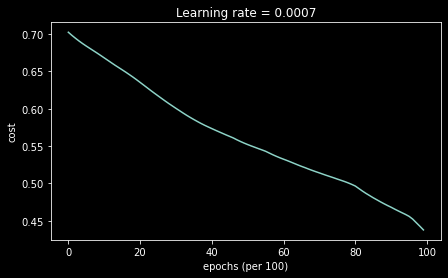

Accuracy: 0.7966666666666666


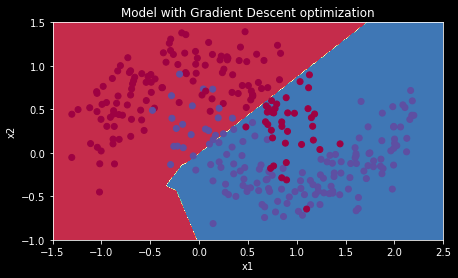

In [16]:
# train 3-layer model
layers_dims = [train_X.shape[0], 5, 2, 1]
parameters = model(train_X, train_Y, layers_dims, optimizer = "gd")

# Predict
predictions = predict(train_X, train_Y, parameters)

# Plot decision boundary
plt.title("Model with Gradient Descent optimization")
axes = plt.gca()
axes.set_xlim([-1.5,2.5])
axes.set_ylim([-1,1.5])
plot_decision_boundary(lambda x: predict_dec(parameters, x.T), train_X, train_Y)

#### MBGD with Momentum Test


The number of training examples is : 300

The mini-batch size : 64


 OK OK 

[[1 0 1 0 1 1 0 0 1 0 1 1 0 0 1 1 1 0 0 1 0 0 1 0 0 1 0 0 0 1 0 0 1 0 0 1
  1 1 0 1 0 1 1 1 1 0 1 0 1 0 1 0 1 1 0 0 1 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 1 1 0 1 0 1 0 0 0 1 1 0 1 1 0 0 0 0 0 0 0 1 1 1 1 0 1 1 0
  1 0 0 0 0 1 1 1 0 1 1 1 0 0 0 1 1 0 1 1 0 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0 1 0 1 1 0 1 1 1 0 1 0 0 0 1 1 1 1 1 1 1
  1 1 0 1 1 1 1 1 1 1 1 0 1 1 0 1 0 0 0 0 1 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 0 1 0 1 0 0 1 1 0 1 0 1 0 1 1 1 1 0 1 0 0 0 0 1 1 1 0 0 1
  0 1 1 0 0 0 0 0 0 0 0 1 1 1 1 0 1 0 0 0 1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 0 1 0 1 0 0 0 0 1 0 1 1 0 1 0 1 0 0 0 1 0 1 1 1 1 0 1 1 0
  1 0 0 0 0 0 0 0]]

 OK OK 

Cost after epoch 0: 0.702413

 OK OK 

[[0 0 0 0 1 1 1 0 0 0 1 1 0 1 0 1 1 1 1 1 0 0 1 0 0 0 0 1 1 0 0 0 1 0 0 1
  1 0 1 0 1 1 1 1 0 1 1 1 1 0 1 1 1 0 1 0 1 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 


 OK OK 

[[0 0 1 0 1 1 1 0 1 0 0 1 0 1 1 1 0 0 1 0 0 0 1 0 0 1 1 0 1 1 1 0 1 0 1 0
  1 0 0 0 0 1 0 1 0 1 0 1 0 0 1 0 1 0 1 0 1 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 1 0 1 1 1 1 0 1 1 0 0 1 0 0 0 0 1 0 0 0 1 0 1 1 0 0 0 0 0
  1 0 0 0 0 1 0 1 1 0 1 0 0 0 0 1 0 1 1 0 1 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 1 1 1 0 1 0 1 0 0 1 0 0 0 1 1 0 0 0 1 0 1 0 1 0 1 1 0 0 1 1
  0 0 1 0 1 0 1 1 1 1 1 0 1 1 1 0 1 0 1 0 1 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 1 1 1 0 0 1 1 0 1 1 0 0 1 1 1 1 1 1 1 1 0 0 0 0 1 0 0 1 1
  1 1 1 1 0 1 1 0 1 1 0 1 1 0 1 1 0 1 0 0 0 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 0 0 1 0 1 0 1 1 1 0 0 0 1 1 0 1 0 1 0 0 1 0 0 0 0 0 0 1 0
  0 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 1 1 0 1 0 0 0 1 0 1 1 1 1 0 1 0 0 0 1 0 0 0 0 1 0 0 0 0 1
  1 1 0 0 0 0 0 1 0 1 1 1 0 0 0 1 1 0 1 0 0 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 1 1 0 0 1 0 1 0 1 1 1 1 1 1 0 0 0 0 0 0 1 0 0 1 1 0 1 1 0
  0 0 1 1 1 0 1 1 1 1 0 1 0 1 1 

  0 1 0 1 0 0 1 0 1 0 1 1 1 1 1 1 0 1 0 1 0 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 0 1 1 0 0 1 1 1 0 0 0 1 1 1 1 0 1 0 1 0 0 1 1 1 1 1 0 0 0
  1 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 1 1 0 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 0 1 1 1 0 0 0 0 1 0 0 0 1 1 1 0 0 1 1 0 0 1 1 0 0 0 0 1 0
  1 0 0 0 1 0 0 0 1 0 1 1 0 0 1 1 1 1 1 0 0 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 1 0 1 1 0 1 1 0 1 1 0 0 1 1 0 1 1 1 1 1 1 0 0 0 1 1 1 1 1
  0 0 0 0 0 0 0 1 1 1 0 1 0 1 1 1 0 1 1 1 0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 0 0 0 1 1 1 0 1 0 0 1 0 0 1 1 1 0 0 0 1 1 0 1 1 0 1 0 0 0
  1 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 1 1 1 0 0 0 0 0 1 0 0 1 1 1 0 1 0 0 1 0 0 0 1 0 0 0 0 1 0
  1 0 1 0 1 1 0 0 1 0 1 0 0 1 0 0 0 0 1 0 0 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 1 0 0 1 1 0 1 1 0 1 1 1 1 0 0 1 1 0 1 1 1 0 1 0 0 1 1 0 1
  1 1 0 1 0 1 0 0 0 0 0 1 1 0 1 1 0 0 0 1 1 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 0 0 1 0 1 1 1 0 0 0 


 OK OK 

[[0 0 1 0 0 0 0 0 0 0 0 1 1 1 0 1 1 0 1 0 0 1 0 1 1 0 0 0 1 1 0 0 0 0 1 1
  0 1 1 1 1 1 1 0 0 1 1 0 1 1 1 0 0 1 0 1 0 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 1 1 0 0 0 0 0 0 0 1 1 0 0 1 0 0 0 0 1 0 1 0 0 1 1 0 1 1 1
  1 0 0 1 0 0 1 1 0 1 0 1 0 0 1 0 1 0 0 1 1 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 1 0 1 0 1 1 1 1 0 1 1 0 0 1 1 1 1 1 0 0 0 0 1 0 0 0 1 0 0
  0 1 1 1 0 1 1 0 0 1 0 0 0 0 0 1 0 1 1 1 1 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 1 1 1 0 0 0 1 0 0 0 0 1 1 0 0 1 0 0 0 1 1 1 1 0 1 1 0 0 0
  0 1 1 0 0 1 1 1 1 0 0 1 0 1 1 1 0 1 0 1 1 0 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 1 0 1 0 0 0 1 0 0 0 1 0 1 1 0 1 0 1 1 0 0 1 1 1 0 0 1 0 1
  1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 1 0 1 0 1 0 0 0 1 0 0 1 0 1 1 1 1 1 0 0 0 1 0 1 0 0 1 1 1
  1 1 1 1 1 1 0 1 0 0 1 1 1 0 0 0 0 0 0 0 1 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 1 1 1 0 0 0 1 1 0 1 1 1 1 0 1 1 0 1 0 1 1 0 1 0 1 1 0 1 1
  0 0 0 1 0 0 1 0 0 0 0 1 0 1 0 


[[1 1 1 1 0 0 1 1 1 1 1 1 0 0 1 1 0 1 1 0 0 1 0 0 1 0 1 1 0 0 0 1 0 0 1 1
  0 1 0 1 1 0 1 0 1 1 1 1 0 1 1 1 0 1 0 1 0 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 0 0 0 1 0 1 0 0 0 1 0 1 1 0 0 1 1 1 0 1 1 1 0 0 1 1 1 1 0
  0 1 1 0 0 1 0 1 1 1 1 0 1 0 0 0 0 1 1 1 0 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 0 1 0 1 1 1 0 0 0 1 1 1 1 1 0 0 1 1 0 0 1 1 0 1 0 0 0 1 1
  1 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 0 0 0 1 0 0 0 0 1 1 0 0 0 0 0 1 0 0 0 0 1 1 1 1 0 0 0 1 0
  1 0 0 1 1 1 1 0 1 1 0 1 1 0 1 0 1 1 1 0 1 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 1 0 1 0 1 0 0 0 1 1 1 1 0 0 0 1 0 0 0 0 0 1 1 0 0 0 1 1 0
  1 1 1 0 1 0 0 0 0 0 0 1 1 0 1 0 0 0 1 1 0 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 1 0 1 1 0 1 1 0 1 1 0 0 1 1 1 0 0 0 1 0 0 0 0 0 0 0 1 0 0
  1 1 1 1 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 1 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 0 0 1 1 1 0 1 1 1 0 0 1 0 0 0 1 0 1 1 1 1 1 1 1 0 0 0 0 0
  0 1 0 1 1 0 1 0 0 0 1 1 1 0 1 1 0 1 1 1


 OK OK 

[[1 0 1 1 0 1 1 1 0 0 0 1 1 1 1 1 1 0 1 0 1 0 0 1 0 1 0 0 1 0 1 0 0 1 0 0
  0 1 1 1 1 0 1 0 1 1 0 1 0 1 0 1 1 0 1 1 0 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 1 1 0 1 1 0 0 0 1 1 1 1 1 1 1 1 1 1 1 0 0 0 1 0 0 1 0 0 1
  1 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 0 1 0 1 1 0 0 1 1 0 1 1 1 0 0 1 1 0 0 0 0 0 1 1 0 0 1 0 0
  1 0 1 0 1 1 0 1 1 1 0 0 1 0 0 1 0 0 1 1 0 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 1 1 0 0 0 0 0 0 0 1 0 0 0 1 0 0 1 0 0 1 1 0 0 1 0 0 1 1 0
  1 1 1 1 0 0 1 1 1 1 0 1 1 0 0 0 0 1 0 1 0 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 1 0 0 0 0 1 0 0 1 1 0 0 1 1 0 1
  1 1 0 1 0 1 1 1 0 1 1 0 1 0 0 1 1 0 0 1 0 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 1 1 0 0 0 1 1 0 1 0 1 1 1 1 0 0 1 0 0 1 1 1 1 1 0 1 0 1 1
  1 0 0 1 0 1 0 0 0 0 1 0 0 1 0 1 0 0 0 1 1 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 1 0 1 0 1 1 0 0 1 1 0 1 0 0 1 0 0 0 0 0 0 0 1 0 1 1 1 1 1
  1 1 1 0 0 1 0 1]]

 OK OK 


 

  0 1 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 0 1 1 0 0 0 0 1 1 1 0 0 0 0 0 1 1 1 1 1 0 0 1 0 1 0 1 1 1
  0 0 1 1 0 1 1 0 0 1 0 0 0 0 1 1 0 0 0 0 1 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 0 0 0 1 0 0 1 0 0 0 1 1 0 1 0 1 1 1 0 1 1 0 0 0 1 1 1 0 1
  0 1 1 0 1 0 0 0 1 1 1 0 1 1 0 1 1 1 1 0 0 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 1 1 1 1 0 1 1 1 1 0 1 0 0 1 1 1 0 0 0 1 1 1 0 0 0 0 1 0 1
  1 1 0 0 0 1 1 0 1 1 1 0 0 1 1 0 0 1 1 1 1 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 1 0 0 0 0 1 1 1 0 1 0 0 0 1 1 1 1 0 1 1 0 1 0 0 0 0 0 1 0
  1 0 1 0 1 0 0 1 0 0 0 0 0 0 0 1 0 1 0 1 0 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 0 1 1 1 1 0 0 1 0 1 0 0 0 1 1 0 0 1 0 0 1 0 1 0 0 0 1 0 0
  1 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 0 1 1 0 0 0 1 0 1 0 0 0 1 0 1 1 0 1 0 0 0 1 0 1 1 1 0 1 1
  1 1 0 1 1 0 0 1 0 0 0 1 0 0 1 0 0 1 0 0 1 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 0 0 1 1 1 1 1 1 0 1 0 1 0 0 0 0 1 0 1 1 0 0 1 1 1 0 0 1 1
  


 OK OK 

[[0 0 0 1 1 0 1 0 1 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 1 1 1 1 0 0 1 0 0 0 1 0
  1 0 0 1 0 1 1 1 0 1 0 1 0 0 0 0 1 1 1 1 0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 1 1 1 0 0 1 0 0 0 1 1 1 1 1 1 1 0 1 0 0 0 1 1 0 0 0 0 0 0
  1 1 1 0 0 0 1 0 1 1 1 0 0 1 0 1 1 1 0 1 1 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 1 1 1 1 0 1 1 1 1 1 1 1 0 1 1 0
  0 0 0 1 1 0 1 0 1 0 1 1 0 0 0 1 1 1 1 0 0 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 0 0 0 1 0 0 0 1 1 1 0 1 0 0 1 0 1 1 1 1 1 1 0 1 0 0 0 1 0
  1 1 0 1 1 0 0 0 0 1 1 0 0 1 0 0 0 1 1 1 1 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 1 1 1 0 1 0 0 0 1 0 0 1 0 1 1 1 0 1 0 0 0 1 0 0 1 0 0 1 0
  1 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 1 1 1 0 0 1 1 0 0 1 0 0 0 0 0 0 1 0 0 0 0 1 1 1 1 1 0 1 1
  0 0 1 0 0 0 1 1 1 1 0 1 0 0 0 0 1 0 1 1 1 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 0 0 1 1 1 0 0 0 0 1 0 1 1 0 0 1 1 0 1 0 1 1 0 0 1 1 1 0 0
  0 0 0 0 1 1 0 0 1 0 0 1 0 0 0 

  1 1 0 1 1 0 0 1 0 1 1 0 0 1 1 1 0 0 1 1 1 0 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 1 1 0 1 0 0 0 1 1 1 1 1 1 1 0 1 0 1 1 0 0 1 0 0 1 0 0 1 1
  0 1 1 0 1 0 0 1 1 0 0 0 1 1 1 0 0 1 1 1 1 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 1 1 1 1 0 0 1 1 0 0 1 1 0 0 0 0 0 1 0 1 1 1 1 1 1 1 1 0 0
  0 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 1 1 1 1 0 1 1 1 1 1 1 0 1 1 1 0 1 0 1 0 1 1 0 1 0 0 1 0 1
  1 1 0 0 1 0 1 1 0 0 1 1 1 1 1 1 1 0 0 1 0 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 0 1 0 0 1 1 0 0 1 0 1 1 0 1 1 0 1 0 0 1 1 0 0 0 1 0 0 0 0
  0 1 0 1 0 1 1 1 0 0 1 1 0 1 1 0 1 0 1 1 0 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 0 1 1 1 0 0 0 0 1 0 1 1 1 1 0 0 1 0 1 0 0 0 0 0 0 1 1 1 0
  0 1 1 0 0 0 0 1 1 1 0 0 1 0 1 1 1 1 0 0 1 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 1 0 0 0 0 1 0 1 1 0 1 0 1 1 0 0 0 0 1 0 1 1 0 1 1 0 0 0 0
  0 1 1 1 0 0 0 0 0 0 0 1 0 1 0 0 0 1 1 1 1 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 1 1 1 0 1 1 1 1 1 1 


[[1 1 1 1 0 0 0 1 0 0 1 0 0 0 0 0 0 1 1 0 0 0 0 1 0 0 0 1 1 0 1 0 0 0 1 0
  0 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 1 0 1 1 0 1 1 0 1 0 1 1 1 0 1 0 0 0 0 0 1 1 1 1 1 1 0 0 0 0
  0 0 0 0 0 1 0 0 0 0 1 1 1 1 1 0 1 1 0 0 0 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 0 0 0 1 1 1 1 1 1 1 1 1 0 0 0 1 1 1 1 1 0 0 0 1 1 1 1 1 0
  1 0 0 1 0 1 1 0 0 0 0 0 1 1 0 0 0 1 1 1 1 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 1 0 1 1 1 1 0 1 0 0 0 0 0 0 1 0 0 1 0 0 1 0 0 0 0 1 1 1 0
  1 1 1 0 0 0 0 0 1 0 1 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 0 1 1 1 0 1 0 0 1 0 1 1 1 0 1 0 0 1 0 0 1 0 0 0 0 0 1 1 0
  1 0 1 1 1 1 1 1 0 1 0 1 0 1 1 0 0 0 1 1 1 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 1 0 1 1 0 1 1 0 1 0 1 0 0 1 1 1 0 1 1 1 0 0 1 1 1 0 0 0 1
  0 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 0 0 0 0 0 0 1 1 1 1 1 1 0 0 1 0 1 1 1 1 0 1 1 0 0 0 1 0 0
  1 0 1 1 1 1 1 0 1 0 0 1 1 0 1 0 0 1 1 1 0 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 0 1 0 1 0 1 1 1 0 1 0 1 1 0 1 1 1 0 0 0 1 1 0 1 0 1 1 0 0 0 1 1 1 1 1
  0 1 1 0 1 1 1 1 1 1 1 1 1 1 0 1 0 0 0 1 0 1 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 0 0 0 1 0 0 1 1 0 1 0 1 0 1 0 0 1 0 0 0 0 1 1 1 0 1 0 1 1
  1 0 1 0 1 1 0 0 1 1 1 0 0 0 0 0 0 0 0 1 0 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 1 0 1 0 1 1 1 1 1 0 0 1 1 0 0 1 1 0 0 0 1 0 1 1 0 0 0 0 1
  0 1 0 0 1 1 1 1 1 0 1 1 0 0 1 1 0 0 1 0 1 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 0 0 0 1 0 1 0 0 0 1 1 1 0 0 0 0 1 0 1 0 0 0 0 1 0 0 0 1 0
  1 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 0 0 0 1 0 0 1 0 1 0 0 1 0 0 0 1 0 1 0 1 0 0 1 0 1 0 1 1 1
  1 1 0 0 1 1 1 0 0 0 1 1 0 1 0 0 0 1 1 0 0 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 0 0 1 0 1 1 1 1 1 1 0 0 0 1 1 1 1 0 1 1 0 1 1 0 0 1 0 0 0
  1 1 1 0 1 0 0 1 0 1 1 1 0 1 1 0 1 0 0 0 1 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 1 0 0 0 1 1 1 0 0 0 1 1 0 1 1 1 0 1 0 1 0 1 1 0 0 1 0 1 1
  0 0 0 1 1 0 1 0 0 0 0 0 0 0 0 


 OK OK 

[[0 0 1 0 1 1 1 0 0 0 1 0 0 0 1 1 0 1 0 1 1 1 1 1 0 1 0 0 1 0 1 0 0 0 0 0
  1 0 1 0 0 1 1 0 1 1 1 0 1 1 1 1 1 1 0 0 0 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 0 0 1 0 0 0 1 0 1 0 0 0 1 0 1 0 1 1 1 1 1 0 0 0 1 1 0 0 0
  0 1 1 1 0 0 0 0 1 1 0 1 0 0 1 1 1 0 1 0 1 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 1 1 1 0 0 0 0 1 1 1 0 1 0 1 1 0 1 1 1 0 1 0 0 1 1 1 1 0
  1 0 0 1 1 0 0 1 1 1 0 0 1 0 0 1 1 1 1 0 0 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 0 0 1 1 0 0 0 1 1 0 1 0 1 0 0 1 1 0 0 0 1 1 0 1 0 1 1 0 0
  0 0 1 1 0 0 1 0 1 0 0 0 1 0 0 1 1 0 1 0 1 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 1 0 1 0 1 0 1 0 1 1 0 0 0 0 1 0 1 0 1 0 0 0 1 1 0 0 0 1 1
  0 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 0 0 0 1 0 0 1 1 0 1 1 0 1 0 1 1 0 1 1 0 1 0 0 0 1 1 1 1 1
  0 1 0 0 1 1 1 0 1 1 0 0 1 0 0 0 0 1 0 0 0 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 1 1 0 0 1 1 0 1 0 0 0 1 0 0 1 1 0 1 1 1 1 1 1 1 0 0 0 0 1
  1 1 0 1 0 0 1 0 1 1 0 0 1 0 1 


 OK OK 

[[0 1 0 1 1 0 0 1 0 1 1 1 1 1 0 0 1 1 1 1 0 0 1 0 0 0 1 0 0 0 1 1 0 1 1 0
  1 0 1 0 1 1 0 0 1 1 1 0 1 1 0 0 1 1 1 0 0 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 0 1 1 0 0 0 1 0 0 1 0 1 0 1 1 0 0 1 0 0 1 0 0 0 0 0 0 1 1
  1 0 0 0 0 1 0 1 0 0 1 1 1 0 1 1 0 1 1 0 1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 0 1 1 0 1 1 1 1 0 1 0 1 1 0 0 1 0 1 0 1 0 1 0 1 0 1 1 0 1
  1 0 1 1 1 0 1 0 1 1 1 1 0 0 0 1 1 1 1 0 1 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 0 1 0 1 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 1 1 1 0 1 1 1 1 1 1
  1 0 1 1 1 0 1 1 0 1 1 1 1 1 1 1 1 0 0 0 0 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 1 1 1 0 1 0 0 1 0 1 1 0 0 0 0 0 1 1 0 0 1 1 0 0 1 1 1 0 1
  0 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 0 0 0 1 0 1 1 1 1 0 0 1 1 0 0 0 0 1 0 1 1 0 0 1 0 1 1 1 1
  1 0 0 0 1 0 0 0 0 1 1 1 0 1 1 1 1 0 1 0 0 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 1 1 1 1 1 1 0 1 1 1 1 0 0 0 1 1 0 0 1 1
  1 0 0 1 0 0 0 1 0 1 0 1 0 1 1 


 OK OK 

[[0 1 1 0 1 1 0 1 1 0 0 1 1 1 0 0 0 1 1 0 0 1 0 0 1 0 0 0 0 1 0 0 1 0 1 1
  0 1 0 1 0 0 0 0 1 1 1 0 0 1 0 1 0 0 1 1 0 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 1 0 0 1 0 0 0 0 1 0 1 0 1 0 1 1 1 1 0 0 0 0 1 1 0 0 0 0 0
  1 1 1 0 1 1 0 1 1 1 0 1 0 1 0 1 1 0 1 1 1 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 0 1 0 1 1 1 0 0 1 1 1 0 0 1 1 1 0 0 1 0 0 0 1 0 0 1 1 1 0
  1 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 1 1 1 1 1 1 0 1 0 0 1 1 0 1 1 0 1 1
  0 1 0 1 1 0 0 1 0 1 0 0 0 1 0 0 1 1 1 1 0 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 1 0 1 1 1 0 1 1 1 0 0 0 0 0 0 0 1 1 0 0 0 1 1 0 0 0 1 0 0
  0 0 1 1 0 1 0 1 1 1 0 0 0 1 0 1 1 0 1 0 1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 0 1 1 0 0 0 1 1 0 0 0 0 0 0 0 1 0 1 0 1 1 0 1 0 1 1 0 1 1
  0 1 0 1 1 0 1 0 0 1 1 1 0 1 0 0 1 1 1 1 1 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 0 1 1 1 1 0 1 0 0 1 0 1 0 0 1 1 0 1 1 0 0 1 0 1 1 0 1 0
  1 0 1 0 1 1 1 1 0 0 1 0 1 1 1 

  0 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 0 0 0 0 1 0 1 1 0 0 1 0 0 0 0 1 1 0 1 1 0 0 1 0 0 1 1 0 1
  1 0 1 0 1 1 1 0 1 0 0 1 0 1 0 1 1 0 0 1 0 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 1 0 0 1 0 1 0 1 1 1 0 1 0 1 1 0 0 0 0 1 0 0 0 0 1 1 1 0 0
  1 1 1 0 0 1 0 1 1 0 0 0 0 0 1 1 0 0 1 1 1 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 0 1 0 1 1 1 1 0 1 1 0 0 0 1 0 1 0 0 1 0 0 0 1 0 1 1 0 1 0
  0 0 1 1 0 1 1 0 1 1 0 1 0 1 1 1 0 0 0 1 0 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 0 0 1 1 0 1 0 1 1 0 1 1 1 0 0 0 1 0 0 1 1 1 1 1 0 1 1 1
  1 0 0 0 1 0 0 0 1 0 0 0 1 1 0 1 1 0 1 0 0 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 0 0 0 0 0 1 1 1 1 1 1 1 0 1 0 0 0 1 1 1 0 1 0 0 0 0 1 1 0
  0 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 0 0 0 0 0 1 0 1 1 0 1 0 0 0 0 1 1 0 0 1 1 0 1 1 1 1 1 1 1
  1 0 1 1 0 1 0 1 1 0 0 0 0 0 0 1 1 1 0 1 0 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 1 1 1 1 1 0 1 0 0 0 0 0 1 1 0 0 1 0 1 0 1 1 1 0 1 1 1 1 1
  

  0 1 1 0 0 0 1 1 0 0 1 0 1 0 0 0 0 1 0 0 1 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 0 0 1 1 1 0 0 0 1 0 0 1 0 1 1 1 1 1 0 0 1 1 0 0 1 1 1 0 1
  1 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 1 1 1 1 0 1 1 1 1 1 1 0 0 0 1 0 1 0 1 0 1 1 1 1 1 1 0 0 0
  0 1 0 0 0 1 1 1 0 1 1 0 0 0 0 1 0 1 0 0 0 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 1 0 1 0 0 0 0 0 0 1 1 0 0 1 0 0 1 1 1 0 1 1 0 1 1 1 0 0 0
  1 0 0 1 0 1 1 0 0 0 1 0 0 0 0 0 1 0 1 0 0 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0 0 0 1 0 0 0 0 0 0 0 1 1 1 1 1 1 1 0 0
  1 0 0 0 1 0 1 1 1 0 1 0 1 1 1 1 1 1 1 0 1 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 1 1 1 1 0 1 0 1 1 0 1 0 0 0 0 0 1 1 1 0 1 0 0 0 0 0 0 0 1
  1 1 1 1 1 1 0 1 0 0 1 1 1 0 1 0 1 0 1 0 0 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 1 0 0 1 0 0 0 0 1 1 0 0 0 0 0 1 0 0 0 0 1 1 0 0 1 1 1 1 0
  0 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 0 0 1 1 1 1 0 1 1 0 1 1 1 1 0 0 0 0 0 0 0 1 0 1 0 1 1 1 0
  


 OK OK 

[[1 1 1 1 0 0 1 1 0 1 1 1 0 1 0 1 0 1 0 1 0 1 1 1 0 1 1 0 0 1 0 0 0 0 1 0
  1 1 1 0 0 0 0 1 0 0 1 1 1 1 1 1 1 0 0 1 1 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 0 0 1 1 1 1 0 1 1 0 0 0 1 0 0 1 1 1 0 0 1 0 1 0 1 0 0 1 0
  1 1 0 0 0 1 1 0 1 1 1 1 0 0 1 0 1 0 0 0 0 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 1 1 0 1 1 1 0 0 0 1 0 1 0 1 1 0 0 0 1 0 1 0 0 0 0 0 0 0 0
  1 1 1 0 1 1 1 0 1 1 1 1 1 0 0 0 1 0 1 1 0 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 1 0 1 1 1 1 0 0 1 1 1 1 0 0 0 1 0 0 1 0 1 1 1 1 0 1 0 1 1
  0 1 0 1 0 1 0 1 1 1 0 1 1 0 0 1 1 0 1 0 0 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 1 1 0 1 0 0 1 1 0 0 1 1 1 1
  1 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 1 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 1 0 0 1 1 1 0 1 0 1 1 0 1
  1 0 1 1 0 0 1 1 1 0 0 0 0 1 1 1 1 1 0 1 1 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 1 0 1 0 0 1 1 1 1 1 1 0 0 0 1 1 1 1 1 1 1 1 0 1 0 0 0 1 0
  0 0 0 1 1 0 1 0 1 0 0 0 1 1 0 


 OK OK 

[[0 1 1 0 1 1 0 0 1 1 1 0 0 0 0 1 0 1 0 1 1 0 1 1 1 1 0 1 1 1 0 1 1 0 0 1
  1 1 1 1 0 0 0 1 0 0 1 0 0 1 0 1 1 0 1 1 1 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 1 0 1 1 0 1 0 0 0 0 0 0 1 1 0 0 0 1 0 1 0 0 1 0 1 0 1 0 1
  1 1 0 0 1 1 0 1 1 1 0 1 0 1 0 1 0 1 0 1 0 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 0 1 1 1 1 1 0 1 0 0 0 1 0 0 0 0 1 0 0 0 0 0 1 1 0 1 0 1 1
  1 1 0 0 0 0 1 0 0 1 0 1 1 1 0 1 0 0 0 1 1 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 0 0 1 0 1 0 0 1 1 1 0 0 1 1 0 0 1 1 0 1 0 0 1 0 1 1 1 1
  1 1 0 0 0 0 1 1 1 1 0 1 0 1 0 1 1 1 0 0 1 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 1 1 0 1 0 1 0 1 0 1 0 1 0 1 1 0 0 1 0 1 1 0 0 1 0 0 0 1 0
  1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 1 1 0 1 0 0 0 0 0 1 1 0 1 1 0 0 1 1 0 0 1 1 0 0 1 0 0 0
  0 0 1 1 1 1 0 0 0 1 1 1 1 0 1 0 0 1 1 0 0 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 0 0 0 0 1 0 0 0 1 1 1 1 1 0 1 0 1 1 1 1 0 0 1 0 0 0 0 1 1
  1 0 0 0 0 0 1 0 1 0 0 1 1 0 1 


 OK OK 

[[1 0 0 0 1 1 0 0 0 1 1 0 1 1 0 0 1 0 0 0 1 1 0 1 0 0 1 0 0 1 0 0 1 0 0 1
  1 0 1 1 0 1 0 0 1 0 1 0 0 0 0 1 1 1 1 0 0 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 0 1 1 1 0 1 0 0 1 1 1 0 1 0 0 0 0 1 0 0 1 1 0 1 0 1 1 1 1
  0 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 1 1 1 1 0 0 0 1 1 0 0 0 0 0 0 0 0 0 1 0 0 0 1 1 0 1 0 0 1
  1 0 1 1 0 0 0 1 1 0 1 1 1 0 1 1 1 0 1 0 1 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 0 0 1 1 1 0 0 0 1 0 1 1 1 0 1 1 1 1 0 1 0 1 1 1 1 0 0 0 0
  1 0 0 0 1 1 0 0 1 0 1 1 0 0 0 0 1 0 0 1 1 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 1 0 1 1 0 0 1 1 0 0 0 0 0 1 0 1 1 1 1 1 0 1 1 0 0 1 0 1 1
  1 1 0 0 0 0 0 1 1 0 1 1 1 1 0 0 1 0 1 0 0 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 1 1 0 1 0 1 1 0 1 0 1 1 1 0 0 0 1 0 1 0 0 1 1 1 0 0 1 1 1
  0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 1 1 1 0 1 1 0 0 1 0 1 0 0 1 0 0 1 1 0 0 1 0 1 1 1 0 1 0
  1 1 1 1 1 1 0 1]]

 OK OK 


 


[[0 1 0 1 0 0 1 0 1 1 0 0 0 0 1 1 0 1 0 0 1 1 1 0 1 1 1 1 1 0 0 1 0 0 0 1
  0 0 1 0 0 0 1 0 0 1 1 0 0 1 1 0 0 0 0 1 0 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 0 0 0 0 1 1 0 0 1 1 1 0 1 0 0 0 0 1 0 0 1 1 0 1 1 1 1 1 0
  1 0 1 0 1 1 1 1 0 0 0 0 0 0 1 1 0 0 1 1 1 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 0 1 1 0 1 0 1 0 0 0 1 0 0 0 1 1 0 0 0 1 0 0 1 1 0 0 1 1 0
  1 0 1 1 0 1 1 0 0 0 0 1 0 1 0 0 1 0 1 0 0 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 0 0 0 1 0 1 1 0 0 1 0 0 1 1 1 1 0 1 0 1 1 1 0 1 1 1 0 1 0
  1 1 0 1 0 0 0 1 0 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 1 0 1 0 1 1 1 0 1 0 1 1 1 0 1 1 1 1 0 0 1 0 1 1 1 0 1 1 1
  0 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 1 1 0 0 0 0 1 1 1 0 0 0 0 1 1 1 1 0 1 0 1 0 1 0 0 1 0 1 1
  1 0 1 1 0 0 0 0 1 1 1 0 1 1 0 0 0 1 0 1 0 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 0 1 1 1 1 0 1 0 1 1 1 0 0 0 1 0 0 0 0 1 0 1 0 0 0 1 1 1 0
  1 1 0 1 0 0 1 0 0 0 1 0 0 1 0 1 0 0 1 0


 OK OK 

[[1 0 0 1 1 1 1 0 1 1 1 0 1 1 1 1 0 1 1 1 1 0 1 0 1 0 1 1 0 1 0 1 0 1 1 0
  0 0 0 0 0 1 0 0 0 0 0 1 0 1 1 0 0 1 0 1 1 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 0 1 1 1 1 0 0 0 0 0 1 0 0 0 1 1 0 1 0 1 0 0 0 0 0 1 1 0 1
  0 1 0 0 0 1 1 1 0 1 1 0 0 0 1 0 0 0 1 0 0 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 1 1 1 1 1 0 1 0 1 0 0 0 1 1 1 0 0 0 1 1 1 1 1 0 0 0 0 0 0
  0 0 1 0 1 1 0 0 1 0 0 1 0 1 1 0 0 0 1 1 0 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 0 1 1 0 1 1 1 1 1 1 0 0 1 1 1 0 1 0 0 0 1 1 1 1 1 0 1 0 1
  1 0 0 1 1 0 1 1 0 1 0 1 1 0 0 0 1 1 1 0 0 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 1 0 0 0 0 0 1 0 1 0 0 0 1 1 0 1 0 1 0 0 1 0 1 0 1 0 0 0 1
  1 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 1 1 0 1 0 1 0 1 0 1 1 0 1 1 0 0 1 0 1 1 0 0 0 0 0 0 0 0 1
  1 1 0 0 1 1 0 0 1 0 1 0 0 1 0 1 0 0 1 1 1 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 0 1 0 0 0 1 1 1 0 0 0 1 1 1 0 0 0 0 1 0 0 0 0 1 0 1 1 0 0
  1 0 1 1 1 0 1 0 1 0 0 0 0 0 1 


 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 0 1 0 1 0 1 0 0 0 0 0 1 1 1 0 1 0 1 0 0 1 0 0 0 1 1 0 1 0
  0 1 1 0 1 0 0 0 1 0 0 1 0 0 1 0 0 1 0 1 0 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 1 1 1 0 0 0 1 0 1 0 1 0 0 1 0 1 1 1 0 0 1 1 1 1 0 0 1 0 0 0
  1 0 0 0 0 0 0 1 0 1 1 1 1 1 0 1 1 0 0 1 0 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 1 0 0 0 0 1 1 1 1 1 0 0 1 0 1 0 0 1 0 1 0
  1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 1 1 0 1 0 0 0 1 0 1 0 1 1 1 0 0 1 1 0 1 0 0 1 0 1 1 0 0 1
  1 1 1 1 0 1 1 1 0 0 0 0 1 1 1 0 0 1 1 0 0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 1 1 1 1 1 1 1 1 1 0 1 1 1 0 0 0 1 1 0 1 0 1 0 0 0 1 0 0 0
  0 1 0 0 0 0 0 1 0 0 1 0 0 0 0 0 1 0 0 1 1 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 1 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 0 0 0 1 1 1
  1 0 1 0 0 0 1 0 1 1 1 1 1 0 1 1 0 0 1 0 0 0 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 0 0 1 1 0 0 0 0 1 1 1 1 1 0 1 0 0 0 1 1 0 1 1 1 0 0 1 0 1
  1 0 0 1 0 0 1 0 0 0 


 OK OK 

[[1 1 1 0 1 1 1 1 1 1 0 1 1 1 1 0 0 0 1 1 1 0 1 0 0 0 0 1 0 0 1 1 0 1 0 1
  0 0 1 0 1 1 1 1 0 0 1 0 0 0 1 0 1 0 1 0 0 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 1 0 1 0 0 1 1 0 0 1 0 0 0 1 0 1 1 0 1 0 0 1 1 0 1 1 1 0 1
  0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 1 1 1 1 1 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 0 0 0 0 1 0 0 1 1 1 1 0 1 0 0 0 0 1 0 0 1 0 0 0 1 0 1 0 0
  1 1 1 1 0 1 1 1 0 0 0 0 0 1 0 1 0 1 0 1 1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 0 0 0 0 1 1 0 0 1 1 1 0 0 0 0 0 0 1 1 1 0 1 0 1 0 0 0 0 1
  1 1 1 0 0 1 0 0 0 1 1 1 0 1 0 0 0 1 1 1 1 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 0 0 0 0 1 1 1 0 1 1 1 0 0 0 1 1 0 1 1 0 0 0 0 0 0 1 0 1 0
  0 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 0 0 0 1 0 0 1 1 1 0 0 1 0 0 0 1 0 0 1 0 0 1 1 1 0 1 0 1 1
  0 0 0 0 0 0 0 0 0 1 1 1 0 0 1 1 1 0 0 0 0 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 1 0 0 0 1 1 0 0 1 0 0 1 1 0 1 1 1 0 1 0 1 1 0 1 0 1 1 1 0
  0 0 1 1 1 0 0 1 0 1 0 1 0 1 1 


[[1 0 0 1 1 1 1 0 0 0 0 0 0 0 0 1 1 0 0 1 1 1 0 1 0 0 0 0 0 1 0 0 1 1 1 1
  1 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 0 1 1 0 0 1 1 0 1 1 0 0 0 1 0 0 1 0 1 1 1 0 0 1 1 0 1 0 1
  1 1 1 0 0 1 0 1 1 1 0 1 1 1 0 0 1 0 1 1 0 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 1 1 1 1 0 1 0 1 1 0 1 0 0 0 0 1 0 0 0 0 1 0 0 0 0 1 1 0 0
  0 1 1 0 0 1 1 1 0 1 1 0 0 1 1 1 0 0 0 1 1 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 1 1 0 1 1 1 1 1 0 1 1 0 1 1 1 1 0 0 0 0 1 0 0 1 1 1 0 0 1
  1 0 0 0 1 0 1 0 1 0 1 1 0 1 0 1 1 1 1 0 1 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 1 0 0 0 1 0 0 0 1 0 0 0 1 0 1 0 1 1 1 0 1 0 1 1 0 0 0 0 0
  1 1 0 0 0 1 0 1 0 0 1 0 0 1 0 0 0 1 1 1 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 0 0 0 1 1 0 0 1 1 1 0 1 1 0 1 0 1 0 0 1 1 0 0 0 1 1 0 1 1
  0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 0 1 1 1 1 0 1 0 1 1 0 0 1 0 1 1 0 0 1 0 1 1 0 1 1 0 1 0 0
  0 0 1 1 0 0 0 1 0 1 0 1 0 1 1 1 0 0 0 0 0 1 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[


 OK OK 

[[1 1 0 0 0 1 1 1 0 0 0 0 0 1 1 1 1 0 1 1 0 0 0 0 0 0 0 1 1 0 0 1 1 1 1 0
  0 0 0 0 1 0 1 1 1 1 1 1 1 0 1 0 1 0 1 1 1 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 1 1 0 0 0 1 1 1 1 0 0 1 0 1 0 1 0 0 0 0 0 1 0 1 1 1 1 1 1
  1 1 1 1 0 0 1 0 1 0 1 1 1 0 1 0 1 1 0 1 1 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 0 0 1 1 0 1 0 1 1 1 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 1
  0 0 0 1 0 0 0 1 0 0 1 1 1 1 0 1 0 0 1 1 1 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 0 0 0 0 0 0 1 1 1 0 1 0 0 0 1 0 1 1 1 0 1 1 0 0 1 0 1 0 0
  1 1 1 0 1 1 0 0 1 0 1 1 0 1 0 0 1 0 1 0 1 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 1 1 1 0 1 1 0 1 0 0 0 1 0 1 1 0 1 0 1 0 0 0 0 0 1 1 1 1 0
  0 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 1 1 1 0 1 0 0 0 1 1 0 0 1 0 0 1 1 0 1 0 1 1 0 0 0 0 1 1 0
  1 0 0 1 1 0 1 0 1 1 1 1 1 0 1 0 1 1 0 0 0 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 1 1 0 0 1 0 0 1 1 1 0 0 1 1 0 1 0 1 0 1 1 1 1 1 1 1 1 0 0
  0 0 1 1 0 1 1 1 0 1 1 0 1 0 0 


 OK OK 

[[0 1 1 1 1 0 0 1 1 0 0 0 1 1 1 1 1 0 1 0 1 1 1 1 0 0 0 1 0 1 1 1 0 1 1 0
  0 1 0 1 0 0 1 0 0 1 0 0 0 1 1 0 0 1 1 1 0 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 0 0 1 1 0 0 1 1 1 1 1 0 1 0 1 0 0 1 1 1 1 1 0 1 1 1 0 0 0
  0 0 1 0 1 0 0 1 0 1 1 1 1 1 0 0 0 0 1 1 1 0 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 0 0 0 1 0 0 0 0 0 0 0 1 1 1 1 1 0 1 0 1 1 1 0 1 0 0 1 1 0
  1 1 1 0 0 1 1 1 0 1 0 1 0 0 0 0 0 0 0 1 0 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 1 1 0 0 1 0 0 0 1 0 0 1 1 1 1 1 1 0 1 1 1 1 0 1 0 1 0 0 1
  1 0 0 0 1 1 1 0 1 0 1 1 0 1 1 0 1 1 1 0 0 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 1 0 0 1 1 0 1 0 0 1 1 1 1 1 0 0 1 1 0 1
  0 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 1 1 0 1 1 0 0 1 0 0 1 0 0 0 0 1 0 0 0 1 0 0 1 1 0 0 1 1 0
  1 0 1 0 1 0 1 0 0 0 0 1 0 1 1 0 1 1 0 0 0 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 0 1 0 1 1 0 1 0 1 0 0 1 0 1 1 1 1 1 1 0 1 0 1 0 1 0 0 0 0
  1 1 0 1 0 1 1 1 0 1 1 0 1 0 1 


 OK OK 

[[0 1 0 0 0 1 0 0 1 0 0 1 1 0 0 0 1 0 1 1 1 1 0 1 0 1 1 1 1 1 1 1 0 1 0 1
  1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 1 1 1 1 0 1 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 1 0 1 0 1 0 1 1 1 1 0 0 0 0 0 0 1 0 1 0 1 0 0 1 0 0 0 0 1
  0 0 1 1 0 0 0 1 0 0 1 1 1 1 0 1 1 0 1 1 0 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 0 0 1 0 0 0 1 0 0 1 1 1 1 0 1 1 0 0 0 0 1 1 1 1 0 0 0 1 0
  1 1 1 0 0 0 1 1 0 1 1 1 1 1 1 0 0 0 1 1 0 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 0 0 0 1 1 0 0 1 0 1 1 0 0 1 0 1 0 1 1 0 1 1 0 0 1 0 1 1 0
  1 0 0 1 1 1 1 1 0 0 1 1 1 0 1 0 1 0 1 0 0 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 1 0 1 1 1 0 1 0 0 0 1 0 0 0 0 0 1 1 0 0 0 0 0 0 1 1 0 1 1
  0 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 0 1 0 1 0 0 1 0 0 1 0 0 1 0 0 0 1 0 1 0 0 1 0 0 1 0 0 1
  0 1 0 1 1 1 1 0 0 1 1 0 1 1 0 1 1 1 1 0 1 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 1 0 0 1 0 1 1 1 1 1 0 0 1 1 1 1 0 0 1 0 1 1 0 0 0 0 1 1 0
  1 0 1 1 1 1 0 1 1 0 0 1 1 0 1 


 OK OK 

[[1 1 0 0 0 0 1 1 0 0 1 1 0 1 0 0 1 0 1 1 1 1 1 0 1 0 0 0 0 1 0 0 1 1 0 1
  0 0 0 0 1 1 1 0 0 1 1 1 0 0 0 1 0 0 0 0 1 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 1 0 0 0 0 1 1 0 0 0 0 0 1 0 0 0 1 1 0 1 0 1 0 1 0 0 0 0 0
  0 0 1 1 0 0 1 0 1 0 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 1 1 0 1 1 1 1 1 0 1 0 1 1 1 0 0 0 0 1 1 0 1 1 0 1 1 1 1 1
  0 1 1 1 1 1 0 1 0 1 0 0 0 0 1 1 1 1 0 0 0 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 1 0 0 0 1 1 0 1 0 1 1 1 1 1 1 0 1 1 0 1 1 1 0 1 0 1 1 0 0
  0 1 0 1 0 1 0 1 1 1 1 1 0 0 0 1 1 1 0 1 0 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 1 0 0 0 1 0 1 0 1 1 1 1 0 0 1 0 0 0 1 1 1 0 0 1 0 1 0 0 0
  1 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 0 1 1 0 0 1 0 0 0 1 1 1 1 0 0 1 1 1 0 1 1 1 1 1 0 0 0 1 1
  0 1 0 1 0 1 0 0 0 1 0 0 0 1 1 0 0 0 0 0 1 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 0 1 1 0 0 1 1 0 0 1 1 0 1 1 1 1 1 1 1 1 0 0 1 0 0 0 1 1 0
  0 0 1 0 1 0 1 0 1 0 1 0 1 1 0 


 OK OK 

[[0 1 1 0 0 1 1 0 0 0 1 1 1 1 0 1 1 1 1 0 0 1 0 0 1 0 1 1 1 1 1 1 0 1 1 1
  0 1 0 1 1 0 1 1 0 1 1 0 1 1 0 1 0 0 0 0 1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 0 0 0 0 0 1 1 1 1 0 0 1 1 1 1 1 0 0 0 1 0 1 1 1 0 0 1 0 0
  1 1 1 1 0 1 0 0 0 0 1 1 0 0 0 1 1 0 0 1 1 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 0 1 0 1 1 1 1 0 1 1 1 1 0 0 0 1 1 1 0 0 0 1 0 0 0 1 1 1 0
  1 1 0 1 1 1 0 1 0 1 1 0 0 1 0 1 1 1 1 0 1 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 0 0 1 1 1 0 1 1 1 1 0 0 0 1 1 1 0 0 1 0 1 1 0 0 0 0 1 1 0
  1 0 0 0 1 0 1 0 1 1 0 0 0 1 0 0 1 0 0 0 0 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 1 0 1 0 0 0 0 1 0 0 1 0 1 0 1 1 1 0 1 1 0 0 0 1 1 0 1 0 1
  1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 1 1 0 1 1 1 0 0 0 0 1 1 1 0 1 0 0 0 0 0 0 0 0 1 0 0 1 0 1
  0 0 0 1 0 0 1 0 1 0 1 1 0 1 0 1 1 0 0 0 1 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 1 0 1 1 0 0 1 1 1 0 1 1 1 1 0 0 1 1 1 0 1 0 1 1 1 0 0 0 0
  0 1 1 0 1 0 0 0 1 0 0 0 0 1 1 


 OK OK 

[[1 1 0 0 1 0 1 1 1 1 1 0 1 0 0 0 0 0 0 0 0 1 1 0 0 1 1 0 0 1 1 1 0 0 0 0
  0 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 1 1 1 1 1 0 1 0 0 0 0 1 0 0 1 1 1 0 1 1 1 0 1 1 1 1 0 1 1
  0 1 0 0 0 0 0 1 0 0 1 1 1 1 1 0 0 1 0 0 0 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 1 1 0 0 1 1 0 0 0 0 0 0 0 1 0 1 1 0 0 0 0 0 1 1 1 1 1 1 0
  1 1 0 0 0 1 0 1 1 0 1 1 0 0 0 0 1 0 1 0 1 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 1 1 1 1 0 0 0 0 0 1 0 0 0 0 0 1 0 1 1 1 0 0 0 1 0 1 0 0 0
  0 0 1 1 1 1 0 1 1 1 0 0 0 1 1 1 1 1 0 1 1 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 0 0 0 0 1 0 1 1 1 0 0 0 1 0 0 0 0 0 1 0 1 1 1 0 0 1 0 1 0
  0 1 1 1 0 1 0 1 1 1 0 1 1 0 0 1 1 0 0 1 0 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 1 1 0 0 0 1 1 0 0 1 0 1 0 0 1 0 1 0 1 1 1 1 0 1 0 0 1 1 1
  1 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 1 0 1 0 0 0 1 1 0 0 0 0 1 1 1 1 1 1 1 0 1 1 0 1 1 1 1 0 0
  0 1 1 1 0 1 0 0 0 0 1 1 1 1 1 0 1 0 0 0 0 1 0 1 1 0 1 0]]

 OK OK 


 


[[0 1 1 0 0 0 1 0 1 0 0 1 1 0 0 1 0 1 1 0 1 1 0 1 0 1 0 1 0 0 0 1 0 1 0 1
  1 1 0 1 0 0 1 1 0 1 1 0 0 1 0 0 0 1 1 1 0 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 0 0 0 0 1 1 1 1 0 1 0 0 0 1 0 0 0 0 0 1 1 1 1 1 1 0 0 1 1
  1 1 1 0 0 0 0 0 1 0 1 1 0 0 0 1 1 1 1 0 0 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 0 1 1 1 1 1 0 0 1 1 1 0 1 1 1 0 1 0 1 1 0 1 1 0 0 1 1 0 0
  1 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 1 1 0 1 0 1 1 1 1 0 0 1 1 1 1 0 1 1 0 0 1 0 0 0 1 1 0 1 0
  1 1 1 1 0 1 1 0 1 0 0 1 0 1 1 1 0 1 0 0 1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 1 1 0 1 0 0 0 0 0 0 1 0 0 1 1 1 0 1 0 1 1
  1 0 0 0 0 0 0 1 1 1 1 0 0 1 1 0 0 1 1 1 1 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 0 1 1 1 1 0 0 0 0 0 1 0 0 0 0 1 0 1 0 1 1 0 1 1 1 1 0 0 0
  0 1 1 1 1 1 1 1 0 0 0 0 1 0 1 0 1 1 0 1 1 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 0 1 1 0 1 1 1 0 1 0 0 1 1 1 1 0 0 1 0 1 0 0 1 1 0 1 1 1 0
  0 1 1 0 0 1 1 1 1 1 1 0 0 1 0 1 0 0 0 1


[[1 1 1 0 1 0 0 1 0 0 1 0 0 0 1 0 0 1 0 1 1 1 0 0 1 0 1 0 1 1 1 0 0 1 0 0
  1 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 1 0 0 1 1 0 0 0 1 1 0 1 0 0 0 1 1 1 1 1 0 1 0 1 0 1 1 0 0
  0 1 1 1 0 0 0 0 0 1 0 1 1 1 1 0 1 0 1 1 1 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 1 1 1 1 0 0 1 0 1 1 0 0 0 0 1 0 0 1 1 1 0 0 0 1 0 0 0 1 0
  0 1 0 0 0 0 1 0 0 0 0 1 1 1 0 1 1 1 0 0 0 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 1 1 0 0 0 1 1 0 0 1 0 1 0 1 1 0 1 1 1 1 1 1 1 1 1 0 1 0 0
  0 0 1 1 0 1 1 0 0 1 1 0 1 0 1 1 0 0 1 1 0 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 0 0 0 1 0 0 1 1 1 1 0 1 1 1 0 0 1 1 1 1 1 1 1 0 0 1 0 0
  1 0 0 0 0 1 0 0 0 0 0 0 0 1 1 0 1 0 1 1 1 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 1 1 1 1 1 0 0 0 1 1 0 1 1 0 0 0 1 0 1 0 0 0 0 0 0 1 1 0
  1 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 1 1 0 0 1 1 0 1 1 1 0 1 1 1 0 0 1 1 1 1 0 1 0 0 0 1 1 0 0
  0 0 0 1 0 0 0 1 1 1 0 1 1 1 1 0 0 1 0 0 1 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[


[[1 0 0 0 0 1 0 1 0 1 1 0 0 0 0 0 1 1 0 0 0 0 1 0 0 1 0 1 1 0 0 1 1 0 1 1
  0 0 0 1 0 0 1 1 1 0 1 0 0 0 1 1 1 0 1 1 0 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 1 0 0 1 1 0 0 0 0 0 0 0 1 0 0 0 1 1 1 0 1 0 0 0 1 1 1 0 0
  0 1 1 0 0 1 1 1 0 1 0 1 1 1 1 1 1 1 0 0 1 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 0 0 1 1 0 1 1 0 0 1 1 0 0 1 1 0 0 1 1 0 1 0 0 1 1 0 1 0 1
  0 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 0 1 0 0 1 0 1 1 0 0 1 1 1 0 1 0 0 0 1 1 1 0 1 0 1 0 1 0 0
  0 0 1 0 0 1 0 0 0 1 1 1 0 1 0 1 0 0 1 0 0 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 1 0 1 1 0 1 1 0 0 0 0 1 0 0 1 1 1 0 1 0 1 0 0 1 0 0 0 0 0
  1 1 1 1 1 1 1 0 1 0 1 0 0 1 0 1 1 0 1 0 1 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 1 0 0 1 1 0 0 1 1 1 0 0 1 1 0 1 1 0 1 1 1 0 1 0 1 0 1 0 1
  1 0 0 1 1 1 0 1 0 0 1 0 1 1 1 1 1 1 0 0 0 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 0 1 0 0 1 0 1 1 0 1 0 0 1 0 1 0 0 1 1 0 0 1 1 1 1 1 1 1 0
  0 1 0 0 0 1 1 1 1 0 1 1 0 0 0 0 1 1 1 1


 OK OK 

[[1 0 0 1 1 1 1 1 1 0 1 0 1 0 0 0 0 0 0 1 1 0 0 1 0 0 1 0 0 1 0 1 0 1 1 1
  0 1 0 0 1 1 1 0 0 0 0 0 1 0 1 1 0 1 1 1 1 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 0 0 0 1 1 0 1 0 0 1 0 0 0 1 1 0 1 1 0 0 0 1 0 0 1 1 0 1 0
  1 0 0 0 0 1 0 1 0 1 0 1 1 0 1 0 0 1 1 1 0 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 0 1 0 1 0 1 0 1 0 1 0 1 0 1 1 0 0 1 1 1 1 0 0 0 1 0 0 1 1
  1 0 1 1 1 1 0 1 1 1 1 1 0 1 1 1 1 1 1 1 1 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 0 0 1 0 1 0 1 1 0 0 0 1 0 0 1 0 1 0 0 0 1 0 0 1 0 0 1 1 1
  0 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 0 1 1 0 1 0 1 0 1 0 0 1 1 1 0 0 0 0 1 0 0 0 0 1 1 0 0 0 0
  1 0 1 1 1 1 1 0 0 1 1 1 1 0 0 1 0 0 0 1 1 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 1 0 1 1 0 1 0 0 1 1 1 0 0 1 1 1 0 1 0 1 1 1 1 0 1 0 0 1 0
  1 0 1 1 0 1 1 1 0 0 0 1 1 1 1 0 0 0 0 1 0 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 1 1 0 0 0 1 1 1 0 1 1 0 1 1 1 1 1 1 0 1 1 1 0 0 0 0 0 0 0
  0 0 0 1 0 1 0 1 0 1 0 0 0 0 0 


[[0 0 1 1 0 1 0 1 1 0 0 0 1 0 1 1 1 0 0 0 1 0 1 1 1 1 0 1 0 1 0 0 0 1 1 1
  1 0 0 1 1 1 1 1 1 0 1 0 1 0 1 0 1 0 0 1 1 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 1 1 0 0 1 1 0 0 0 1 1 0 1 0 0 0 0 1 0 1 1 1 0 0 0 1 0 0 1
  1 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 1 0 1 1 0 1 1 1 0 0 1 1 0 1 0 1 0 1 1 0 1 0 0 1 1 1 1 0 0
  1 0 0 1 1 0 0 1 1 0 0 0 0 1 0 0 0 1 0 0 1 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 1 0 1 0 1 1 0 1 0 1 1 1 0 1 0 0 0 1 1 1 1 1 0 0 0 0 0 0 1
  1 1 0 0 0 0 1 1 0 0 1 0 1 0 1 0 1 0 1 0 0 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 1 1 0 0 1 0 1 1 1 1 1 1 1 1 0 0 0 1 0 0 0 0 1 0 1 1 1 1 0
  1 1 1 0 1 0 0 1 1 1 0 1 1 1 0 0 0 1 1 1 1 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 0 0 0 1 1 1 1 1 1 0 0 1 0 1 1 0 0 1 1 0 1 1 1 1 1 0 0 0 1
  1 0 0 1 0 0 0 0 0 1 0 1 1 0 1 0 1 1 1 0 0 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 1 0 0 1 0 1 0 0 1 0 1 1 0 0 1 1 1 0 1 1 1 0 0 0 1 1 1 0 1
  1 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[

[[0 0 0 1 1 1 0 1 1 0 0 1 0 1 0 0 1 0 0 1 1 0 0 1 1 1 1 0 0 1 0 0 0 0 1 0
  1 0 1 1 1 0 0 0 0 1 1 0 0 1 1 1 1 0 0 1 1 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 0 0 1 0 0 0 0 1 0 1 0 0 1 0 1 1 1 1 1 0 1 0 0 1 1 0 1 1 0
  1 1 0 0 1 1 1 1 0 1 0 0 0 1 1 1 0 0 1 0 0 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 0 0 1 0 0 1 1 1 0 1 0 1 0 0 1 0 1 0 1 0 0 0 1 0 1 1 0 0 1
  1 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 1 0 1 0 0 1 1 1 0 1 0 1 0 1 0 1 0 0 0 1 0 0 1 1 1 0 1 1 1
  0 1 1 1 1 0 0 1 1 0 1 1 1 1 0 1 0 0 0 0 0 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 0 1 1 0 0 1 1 1 0 1 0 1 1 0 1 1 1 0 1 0 0 1 0 0 0 0 1 0 0
  0 0 1 0 0 0 1 0 0 1 0 0 1 1 0 1 1 1 1 0 1 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 0 1 0 0 0 0 1 1 1 1 0 0 1 1 0 1 1 1 1 1 0 1 0 0 0 0 1 0 0
  0 1 0 1 1 0 0 1 1 1 0 0 1 0 1 0 1 0 0 0 1 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 1 0 1 1 1 1 1 0 0 0 1 1 1 0 1 0 0 0 1 1 1 1 0 0 1 1 0 1 1
  0 0 1 0 0 0 1 0 1 1 1 0 1 0 0 1 0 1 0 1 

  1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 1 0 0 1 0 1 1 0 0 0 0 0 0 1 1 0 0 0 0 1 0 0 1 0 0 0 1 0 0
  1 0 0 1 0 1 1 1 0 0 1 1 1 0 1 1 0 0 1 0 1 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 1 1 0 0 1 0 1 0 1 0 1 1 1 1 0 0 0 1 0 0 1 0 0 1 0 1 1 0 0
  1 1 1 1 0 0 0 0 0 1 0 1 1 1 1 0 1 1 0 0 1 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 1 0 0 0 1 1 0 0 1 0 0 0 0 1 0 0 1 1 0 1 0 0 1 0 1 0 0 0 1
  0 0 1 1 1 0 1 0 1 1 1 1 1 1 1 0 1 0 1 0 1 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 1 0 0 1 0 1 0 1 1 1 0 1 1 0 0 0 1 0 1 1 0 0 1 1 1 1 0 0
  1 1 1 1 0 1 0 0 1 0 0 1 0 0 1 0 1 0 0 1 0 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 0 1 1 0 1 0 1 1 1 0 1 0 1 1 1 1 0 1 1 0 1 0 1 0 0 1 1 0 0
  1 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 0 1 0 1 1 1 0 1 0 0 0 0 1 1 1 1 0 0 0 1 1 1 1 0 1 1 1 1 0
  0 0 1 1 1 0 0 0 0 0 1 0 0 1 0 0 1 1 0 1 0 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 1 1 1 1 0 0 1 1 1 0 0 1 1 1 1 0 0 0 1 0 1
  


[[1 0 1 0 1 0 0 1 1 1 0 1 1 1 1 1 1 1 1 0 0 1 0 1 0 1 0 1 0 0 1 0 1 0 1 0
  0 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 0 0 1 1 1 0 1 0 1 0 1 0 0 1 0 1 1 0 1 0 1 1 0 1 0 0 0 0 0
  1 1 0 1 0 0 1 0 1 1 0 0 1 0 1 0 0 1 0 0 0 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 0 0 0 0 0 1 0 1 1 0 1 0 0 0 1 1 0 1 1 1 1 1 1 0 1 1 0 1
  0 1 1 0 1 0 1 1 1 0 1 0 1 0 0 1 1 1 0 1 0 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 0 0 1 1 0 0 0 0 1 1 1 0 0 1 1 1 1 1 1 0 1 0 0 0 0 0 0 0 0
  1 1 0 1 0 1 1 0 1 1 0 1 1 0 1 0 1 1 0 0 1 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 1 0 1 1 0 1 0 0 0 1 1 1 1 1 1 1 0 1 0 0 1 1 1 1 0 1 1 1 0
  0 0 0 0 0 0 0 1 0 0 1 1 1 0 0 0 1 1 0 0 0 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 1 0 1 1 0 0 1 1 0 0 1 1 0 1 0 1 1 1 0 1 0 1 0 0 1 1 0 0 1
  0 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 0 0 0 0 0 1 1 0 1 0 0 0 1 1 1 0 0 1 1 1 0 1 0 1 1 1 1 0 1
  0 1 1 1 0 0 1 1 1 0 1 1 0 1 1 1 1 0 1 1 0 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[

  0 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 1 1 1 0 0 1 1 1 1 1 1 0 0 1 0 1 0 0 1 1 0 0 1 1 1 0 1 0 1
  0 0 0 1 1 0 0 0 1 0 0 1 0 0 1 1 0 0 0 0 0 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 1 1 0 0 1 1 0 0 0 0 0 1 1
  1 0 1 1 0 1 1 1 0 1 1 1 1 1 0 1 1 0 0 0 1 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 1 0 0 1 1 1 0 0 0 0 1 1 0 0 0 1 0 1 0 0 0 0 0 1 0 1 1 0 0
  0 1 1 1 1 0 0 1 0 1 0 1 0 0 1 0 1 0 1 1 1 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 1 1 1 0 1 1 0 1 0 1 1 1 0 1 0 1 1 1 0 1 0 1 1 0 0 1 1 0 0
  0 0 0 1 1 1 1 1 1 0 1 0 1 1 1 0 0 0 0 1 0 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 1 0 1 1 1 0 1 1 1 0 0 0 1 1 0 0 1 1 1 0 0 0 1 0 1 1 0 1 1
  0 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 0 1 1 1 1 1 1 0 0 0 0 1 1 1 1 0 1 1 1 1 0 0 1 1 1 1 1 0 0
  0 0 0 1 0 1 0 1 0 1 0 1 0 0 1 1 1 1 1 0 0 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 1 1 0 0 0 1 1 1 1 1 1 0 0 1 0 1 0 1 0 1 0 1 1 1 0 0 0 1 1
  


[[0 1 0 0 1 1 0 0 0 1 0 1 1 1 0 0 0 1 1 1 0 1 0 1 0 0 1 0 1 1 1 1 1 0 0 1
  1 1 0 0 0 1 0 1 1 1 0 1 1 0 0 0 0 0 1 1 0 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 1 1 1 1 0 1 0 0 0 0 1 1 0 1 1 1 1 0 1 1 0 0 0 1 0 0 1 1 1
  0 0 0 0 0 1 0 0 1 1 0 1 0 1 0 1 0 0 1 0 1 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 0 1 0 0 1 1 1 0 1 1 1 0 1 1 1 0 1 0 1 0 1 0 1 1 0 0 1 0 0
  1 1 1 1 0 0 1 1 1 0 0 1 0 1 1 0 0 1 0 1 0 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 1 0 0 0 1 0 0 1 1 1 0 1 1 0 0 1 0
  0 1 0 1 1 0 0 1 0 0 1 0 0 1 0 1 1 1 0 0 1 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 0 0 0 1 0 0 0 0 1 0 1 0 0 1 1 1 0 1 1 1 0 1 0 0 1 0 0 0
  1 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 1 0 0 1 1 0 0 0 0 0 1 0 0 1 1 1 1 0 0 0 1 1 1 1 0 1 1 0 0
  1 0 1 1 0 1 0 0 0 0 0 1 0 0 0 1 1 1 0 1 0 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 1 0 0 0 0 0 1 1 1 1 0 0 1 1 0 1 0 1 0 1 0 0 0 1 1 1 1 0 0
  1 0 1 0 0 1 0 1 1 1 0 1 0 0 1 1 1 0 1 1


[[0 1 1 0 0 1 0 1 0 1 1 1 0 0 1 0 0 1 0 0 1 0 1 0 0 1 1 0 1 0 1 0 1 1 0 1
  1 1 0 1 0 0 0 0 0 0 0 0 0 1 1 0 0 1 1 1 1 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 1 0 1 1 1 1 0 1 0 1 0 0 1 0 0 1 1 1 1 0 1 0 1 1 0 0 1 1 0
  0 1 1 1 1 1 1 0 0 0 0 1 1 0 0 1 0 1 0 0 1 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 0 0 1 1 0 0 0 0 1 0 0 0 1 1 1 0 1 0 0 1 1 1 1 0 0 1 1 1 1
  1 1 1 1 0 1 1 0 0 0 1 0 1 0 0 1 1 1 1 0 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 0 0 1 0 1 1 1 1 1 1 1 0 1 1 1 0 0 1 1 1 0 0 1 1 0 1 1 1 0
  1 1 0 0 1 0 1 0 0 0 0 1 1 0 0 0 0 1 1 1 1 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 0 0 0 0 0 0 1 0 0 0 1 1 0 1 1 0 0 1 0 1 1 0 0 0 0 1 0 1 0
  1 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 1 1 0 1 1 0 0 0 0 0 0 0 1 1 1 1 1 1 0 0 1 1 1 0 0 1 1 0 0
  1 0 0 1 0 1 1 0 1 0 1 1 0 0 0 0 0 1 1 0 0 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 0 1 0 0 1 0 1 1 1 0 0 0 1 1 0 1 0 0 1 0 1 0 0 1 1 1 1 0 1
  0 1 1 0 1 1 1 1 0 0 0 0 0 1 1 1 1 0 1 1


[[0 1 1 0 0 0 0 1 0 1 1 1 1 0 0 1 0 0 1 0 1 1 0 0 0 1 1 0 0 0 0 0 0 1 0 0
  0 1 1 1 1 1 1 0 1 0 1 1 0 1 1 1 0 1 1 0 1 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 1 0 1 0 1 0 0 0 1 1 0 0 0 0 1 1 0 1 0 0 0 0 1 0 1 0 1 0
  0 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 1 0 0 1 1 1 0 1 0 1 0 0 1 1 0 0 0 1 0 1 0 1 1 1 1 1 1 1 1
  1 1 0 1 0 1 1 1 1 0 0 1 1 0 0 0 1 1 1 1 1 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 0 1 0 1 1 1 0 0 1 1 0 0 1 1 1 1 0 1 0 1 0 0 0 1 1 0 1 0 0
  1 1 1 1 0 0 0 0 0 0 0 1 1 1 0 0 0 1 0 1 0 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 1 0 0 0 0 1 0 1 1 0 0 1 1 1 0 0 0 0 1 1 1 1 0 0 0 0 1 0 0
  0 1 0 1 0 0 0 1 1 0 1 1 0 0 0 0 1 0 0 1 0 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 1 1 1 1 0 0 0 0 0 0 0 1 1 0 1 1 1 1 0 1 1 0 0 1 0 0 0 1
  0 0 1 1 0 1 1 1 1 1 1 0 1 0 0 0 1 1 1 1 0 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 1 1 1 0 0 1 0 1 0 0 0 1 0 0 0 1 0 0 0 1 1 0 0 0 1 1 1 1 1
  0 0 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[


[[0 1 1 1 1 0 1 1 1 1 0 0 0 1 0 1 0 1 1 0 1 1 1 1 0 0 0 0 0 0 0 1 0 0 1 0
  1 1 0 0 0 1 0 0 1 1 1 0 1 0 0 0 1 1 1 0 1 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 0 1 0 0 0 0 1 0 0 1 0 0 1 1 0 1 0 0 1 1 1 0 0 1 0 1 0 1 0
  1 0 1 1 0 0 0 0 0 0 1 0 0 0 0 0 1 0 1 0 1 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 1 0 0 1 0 0 0 0 0 1 0 0 0 0 1 1 1 0 1 1 1 1 1 0 0 0 0 1 0
  0 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 1 0 1 0 1 0 1 1 1 1 0 1 0 0 0 0 0 0 1 1 0 0 0 0 1 1 1 1 1 1
  0 0 1 1 0 0 0 1 0 0 1 0 0 0 1 1 0 1 0 1 1 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 0 0 0 1 0 1 1 1 0 1 0 0 1 0 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0
  0 0 1 1 0 1 0 0 1 1 1 1 1 1 0 0 0 1 0 0 1 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 1 1 1 0 1 0 1 1 1 1 0 0 0 0 1 0 0 1 1 0 1 1 1 0 0 1 0 0 1
  1 1 1 1 0 0 0 1 1 1 1 0 1 1 1 0 1 0 0 0 1 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 1 0 1 0 0 0 1 0 0 1 0 1 1 0 0 1 1 1 0 0 0 1 1 1 1 1 1 0 0
  0 1 0 1 0 1 1 1 0 1 0 0 0 0 1 0 0 0 0 0

[[1 0 1 1 0 1 1 0 1 1 0 0 1 0 0 1 0 1 0 1 0 0 0 1 1 1 1 1 0 0 1 1 0 0 1 1
  0 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 1 1 0 0 1 0 1 1 1 1 1 0 0 1 1 0 1 0 0 1 0 0 0 1 1 1 1 1 1
  1 1 0 1 0 1 0 1 0 0 1 0 0 0 1 0 1 1 1 0 1 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 0 1 1 0 1 1 1 1 1 0 1 1 0 1 0 1 0 1 1 0 0 0 1 1 1 0 1 0 0
  0 0 0 1 1 0 0 1 0 0 0 1 1 0 0 0 1 1 0 0 0 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 1 1 0 1 1 1 0 0 1 1 1 1 1 0 1 0 0 0 0 1 0 1 1 1 1 0 0 0 0
  0 1 1 0 0 0 0 1 1 0 0 0 1 1 1 0 1 1 0 1 1 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 1 1 1 1 0 0 0 1 1 0 0 1 1 1 0 0 0 0 1 0 1 1 1 0 1 1 0 1 0
  1 0 1 0 1 0 1 1 1 0 0 0 1 0 1 1 1 0 1 0 1 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 1 0 1 0 0 1 0 1 0 0 0 0 0 0 1 1 1 1 1 0 1 0 0 1 1 0 1 1 1
  0 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 0 1 0 0 0 1 0 1 1 1 1 0 0 1 1 0 1 0 1 0 0 1 0 0 0 0 1 0 0
  0 1 0 1 0 1 1 0 0 0 1 0 0 1 0 0 0 0 1 1 1 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[

  0 0 1 0 1 1 0 0 1 0 0 0 1 1 1 0 0 1 0 1 1 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 1 0 1 0 0 0 0 1 0 0 0 1 1 0 1 0 1 0 1 1 1 1 1 0 1 1 0 0 0 1
  1 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 1 1 0 1 0 1 0 1 0 0 1 0 0 1 0 1 0 1 0 0 0 0 0 1 1 0 0 0 1 0
  0 1 1 0 1 1 0 0 1 1 1 0 0 1 0 1 0 1 1 1 1 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 0 1 1 0 1 0 0 0 1 0 0 0 1 1 0 1 1 0 1 1 0 0 1 1 0 0 0 1 0
  0 0 1 0 1 1 1 0 0 0 1 1 0 0 1 0 1 0 0 0 1 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 1 1 1 1 0 1 0 1 1 1 0 1 0 1 1 0 0 1 0 0 1 0 0 1 1 0 1 1 1
  1 0 0 1 0 1 0 0 0 1 1 0 0 0 1 1 1 0 1 0 0 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 1 1 0 0 0 1 0 0 0 1 1 1 0 0 0 0 1 1 0 0 0 0 1 0 1 0 0 0 0
  1 1 0 0 1 0 0 1 1 1 1 0 0 1 1 0 0 1 1 0 0 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 1 1 0 1 1 1 0 1 0 0 1 0 0 1 1 0 0 0 1 0 1 1 0 0 1 1 1 1 1
  0 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 1 1 0 0 0 0 0 1 1 1 0 1 0 0 0 0 1 1 1 0 1 1 0 1 0 0 1 1 1
  


 OK OK 

[[0 1 1 1 1 0 0 1 0 0 1 0 1 0 0 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 1 1 0 0 1
  1 0 0 1 0 1 0 1 1 0 1 1 0 0 0 0 1 1 1 0 1 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 1 1 0 1 1 0 1 0 0 1 0 0 0 0 1 1 1 0 1 0 0 0 1 1 1 1 1 0 0
  1 0 0 0 1 1 1 0 0 0 0 0 1 0 0 0 0 0 0 1 0 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 0 0 1 1 0 1 0 1 1 1 1 1 1 1 1 0 1 1 0 0 0 1 1 0 1 1 0 1
  1 0 1 1 1 1 1 0 0 0 0 1 0 1 0 0 0 0 1 1 0 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 0 1 0 1 1 1 1 0 0 1 1 1 1 1 1 0 1 0 0 1 1 1 1 0 1 1 1 0 0
  1 1 0 1 1 1 0 1 0 1 0 0 1 0 0 1 1 0 0 1 0 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 0 0 0 1 1 0 0 1 0 0 1 1 1 1 0 1 1 1 1 0 0 1 1 0 1 0 0 1 0
  0 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 1 1 0 1 0 1 1 1 1 0 0 1 1 1 0 0 0 1 1 1 1 1 1 0 0 1 0 0 0
  1 1 0 1 0 0 1 0 1 0 1 0 0 1 1 1 0 1 1 1 1 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 0 1 1 0 0 0 1 1 1 1 0 0 0 1 0 0 0 1 1 0 0 1 0 0 0 1 1 1 1
  1 0 1 0 0 0 1 0 0 1 0 0 0 0 1 


 OK OK 

[[1 0 0 0 0 1 0 1 0 0 0 1 1 1 0 0 0 1 0 1 1 0 0 0 0 1 1 1 0 0 1 1 1 0 0 1
  0 1 0 1 1 1 0 1 0 1 1 0 0 0 1 1 1 0 1 0 0 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 0 1 0 1 0 1 1 0 1 1 1 0 0 1 1 1 1 0 1 1 0 1 1 0 1 0 0 1 0
  1 0 0 1 0 1 0 1 1 1 1 0 0 0 0 0 0 1 1 0 1 0 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 0 1 1 0 0 0 1 1 0 0 1 1 1 0 1 1 0 1 1 0 0 0 1 0 1 1 0 1 1
  0 0 0 1 0 0 1 1 1 0 0 0 0 0 1 1 0 1 0 1 1 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 0 1 0 0 0 1 0 0 1 0 1 0 1 1 0 1 0 0 1 0 1 1 1 1 1 1 0 1 1
  1 0 0 0 0 0 0 0 1 0 0 1 0 0 1 1 0 0 1 0 1 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 1 1 0 1 0 0 1 0 1 1 1 1 1 0 1 1 1 1 0 1 0 1 1 0 0 0 0 0 0
  1 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 1 1 1 0 1 1 1 1 1 1 1 1 0 1 0 1 1 0 0 0 1 0 1 0 1 0 1 1 1
  0 1 1 0 1 0 1 1 0 1 0 0 1 0 0 0 0 0 0 1 1 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 0 1 1 0 1 1 1 0 0 1 1 1 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0
  0 0 1 0 0 1 1 1 0 1 1 1 0 0 1 


[[0 1 0 1 0 0 1 0 1 1 1 0 0 1 1 1 1 0 1 1 0 1 0 1 1 1 1 1 0 1 0 1 1 0 0 0
  1 1 0 1 0 0 0 1 1 0 1 0 1 0 0 0 0 1 1 1 0 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 1 0 1 1 0 1 1 0 1 1 0 1 0 1 0 1 0 0 1 0 1 1 0 0 1 1 1 0 0
  0 0 1 0 1 1 0 1 1 1 0 0 0 0 1 0 0 0 1 1 1 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 0 0 1 0 1 0 0 1 1 0 0 1 0 0 0 1 1 0 0 0 1 1 0 1 0 1 0 0 0
  1 1 1 1 1 1 0 0 0 1 1 1 1 1 0 0 0 1 1 0 0 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 1 1 0 0 1 0 0 1 0 1 1 0 1 1 0 0 0 1 1 1 0 1 0 1 1 0 1 1 0
  1 1 1 1 0 1 1 1 1 1 1 0 0 0 0 0 1 1 0 0 0 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 1 1 0 0 0 0 1 1 1 1 0 0 0 0 0 0 0 1 1 0 1 0 1 0 0 1 0 0 1
  0 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 0 0 1 0 0 0 1 1 0 1 1 1 1 1 0 1 0 0 1 1 0 1 0 1 1 0 0 0 0
  1 0 0 1 0 0 1 1 0 0 0 1 1 0 1 1 0 1 0 0 0 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 0 1 1 0 1 1 1 1 1 0 1 1 0 1 0 0 1 1 0 1 1 1 1 1 1 0 1 1 0
  0 1 0 1 1 0 1 1 0 1 0 1 0 0 1 1 1 1 1 0


 OK OK 

[[1 0 1 1 0 0 1 1 0 1 1 0 1 0 1 0 0 1 0 1 1 1 1 0 0 0 1 1 0 0 1 1 0 0 0 0
  1 0 0 1 0 1 0 1 0 0 0 1 0 0 1 1 1 0 1 1 0 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 1 0 1 1 0 0 1 1 0 1 0 1 1 1 1 1 1 0 1 1 1 0 0 0 1 0 1 0 1
  1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 0 1 1 0 1 0 1 1 1 1 0 0 1 1 1 1 0 0 1 1 0 0 1 0 0 0 1 1 0
  0 1 0 1 0 1 0 1 1 0 1 0 0 1 1 0 1 0 1 1 1 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 0 1 0 0 0 1 1 1 1 1 0 1 1 0 1 1 1 1 1 1 0 0 0 1 0 0 0 0 1
  0 0 1 1 0 0 0 1 0 0 0 0 0 1 0 0 0 1 1 0 1 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 0 1 1 1 0 0 1 0 0 1 1 0 1 0 0 0 0 0 0 1 1 0 0 0 1 1 1 0 1
  1 1 1 0 1 0 0 0 1 1 0 0 0 0 0 0 0 0 1 1 0 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 1 0 1 1 0 0 0 1 1 0 1 1 0 0 0 1 1 0 1 0 0 1 0 1 0 0 1 1 1
  0 1 1 0 0 1 0 1 1 0 1 1 1 0 0 1 0 1 1 0 0 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 1 0 0 1 1 1 1 0 1 1 1 1 1 0 0 0 1 0 0 1 0 1 1 0 1 0 0 1 0
  0 1 1 1 1 1 1 0]]

 OK OK 


 


 OK OK 

[[0 1 0 1 0 0 1 0 1 1 1 1 1 1 0 0 0 1 0 1 1 1 1 0 0 1 1 1 1 0 1 1 1 0 1 1
  1 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 1 1 0 1 1 0 1 1 1 1 1 0 1 0 1 0 0 1 1 0 1 0 1 1 1 0 1 0 0
  1 1 0 1 1 1 0 0 0 1 1 0 0 1 0 0 0 0 0 0 0 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 1 1 1 0 0 1 1 0 1 1 1 0 1 1 1 0 0 1 0 1 0 1 0 1 0 0 1 0 1
  0 1 0 1 1 1 0 0 0 0 1 1 0 0 1 0 0 1 0 0 1 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 0 1 0 1 1 0 1 1 0 1 1 1 0 1 0 1 0 1 1 1 1 0 0 0 1 1 1 1 0
  1 0 0 0 1 0 1 1 0 0 1 1 0 1 1 0 1 0 0 1 1 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 1 0 0 0 0 0 1 1 1 0 0 1 1 0 1 0 1 1 1 0 0 0 0 1 0 1 0 1 1
  1 1 0 1 1 0 1 1 1 0 0 0 0 1 0 0 0 0 0 1 0 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 1 0 0 1 1 1 0 0 1 1 0 0 1 1 0 1 0 0 1 0 0 0 1 1 0 0 0 0 0
  0 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 1 1 1 0 1 0 0 0 1 0 1 0 0 0 1 0 1 1 0 0 0 1 1 0 1 0 0 1 1
  1 1 0 0 1 1 0 0 0 0 0 0 1 0 0 1 1 0 0 1 0 1 0 0 0 0 0 1]]

 OK OK 


 

  1 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 1 0 1 1 0 1 0 1 0 0 0 0 1 0 1 1 1 0 1 0 0 1 0 0 0 1 1 0 1
  1 1 1 0 0 1 0 0 0 0 1 0 0 0 0 0 1 1 1 0 1 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 0 1 0 1 0 0 0 1 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 1 1 0 0 0 1
  0 0 1 0 1 1 0 0 0 0 0 0 1 0 1 0 0 1 1 0 0 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 1 1 1 0 1 0 1 1 1 0 0 1 1 0 1 1 1 0 1 1 1 1 1 0 1 1 0 1 1
  0 0 0 1 1 1 1 1 1 0 0 1 0 1 0 0 0 1 0 1 0 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 0 0 1 0 1 1 1 1 0 0 1 0 0 1 0 0 0 1 0 0 1 0 1 1 0 1 0 0 0
  0 0 1 1 1 1 1 1 0 1 0 0 1 1 1 1 0 1 0 1 1 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 0 1 1 0 0 0 1 1 0 0 0 0 0 1 1 0 0 0 1 0 1 0 1 0 1 1 1 1 1
  1 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 1 1 1 1 1 1 0 1 0 1 0 1 1 0 0 1 0 0 0 1 1 1 0 1 0 1 0 0 1
  0 0 1 0 0 0 0 1 1 0 1 1 1 1 0 1 1 0 0 0 1 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 0 0 1 0 0 0 1 0 1 1 0 0 1 1 0 0 0 0 1 0 1 1 0 1 0 0 0 0 0
  


[[1 1 1 1 1 1 0 0 0 0 1 1 0 0 0 0 0 0 1 0 1 0 1 1 1 0 0 1 0 1 0 1 0 1 0 1
  1 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 0 1 0 1 0 0 1 0 1 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0
  1 1 0 0 1 1 0 0 0 0 1 1 0 1 1 0 1 1 0 1 0 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 0 1 0 1 1 0 1 0 1 1 0 1 1 0 1 1 0 0 0 0 1 0 1 0 0 0 0 1 1
  1 0 1 1 1 0 1 1 1 0 1 1 1 1 0 1 0 1 0 0 0 0 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 1 1 1 0 0 0 0 0 0 0 1 1 1 0 1 0 1 0 1 1 0 0 1 1 0 0 1 1 1
  1 0 0 0 0 1 0 1 1 0 1 1 1 0 0 0 0 0 0 1 1 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 1 0 1 0 0 1 0 1 0 1 1 1 1 0 1 0 0 1 1 0 1 0 1 1 1 0 0 1 0
  0 0 1 0 0 1 0 0 1 0 1 0 0 1 0 1 1 1 0 0 0 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 0 1 1 0 1 0 0 1 0 1 1 0 0 1 1 0 0 0 0 0 0 1 0 1 0 1 0 0 1
  0 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 1 1 1 0 0 1 1 0 1 0 1 1 1 1 0 1 0 1 1 1 0 1 1 1 0 1 0 0 0
  1 1 1 1 0 1 0 1 0 1 0 0 0 0 1 0 1 0 0 1 0 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[


 OK OK 

[[1 1 0 1 1 1 1 0 0 0 1 1 0 1 1 1 1 0 1 1 1 1 0 1 1 0 1 0 0 1 0 0 1 1 0 1
  1 0 0 0 0 0 0 1 1 0 0 1 0 1 0 0 0 1 1 0 0 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 1 0 0 0 0 0 1 1 0 0 1 1 0 0 1 0 0 1 0 1 0 1 0 0 0 0 1 0 0
  0 1 1 1 1 0 1 0 1 1 0 0 0 0 1 1 1 0 0 0 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 1 0 0 1 1 0 0 1 0 1 0 0 1 1 1 1 1 0 0 0 1 1 0 1 1 0 1 1 1
  0 0 0 1 0 1 1 1 0 1 1 0 0 1 1 0 0 1 0 0 1 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 1 1 1 0 1 1 0 1 0 0 0 1 1 0 0 1 1 1 0 0 0 1 0 0 0 1 1 1 0
  1 0 0 1 0 0 0 0 1 1 1 0 0 1 1 0 1 0 0 1 0 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 1 1 1 1 0 1 1 0 1 1 1 1 0 1 1 0 1 0 0 0 1 0 1 1 0 0 1 1 1
  1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 0 0 0 1 0 0 1 0 1 0 0 1 1 1 1 0 1 0 1 0 0 1 0 0 1 0 1 1 0
  0 0 1 0 0 1 0 0 0 1 1 0 0 1 0 1 1 0 0 0 0 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 0 0 1 1 1 1 1 0 0 1 1 0 0
  0 0 1 1 0 1 1 1 1 0 0 1 1 0 0 


 OK OK 

[[1 0 0 1 0 0 1 1 1 0 1 1 1 0 0 1 0 1 0 1 0 1 0 1 1 0 0 0 1 0 1 1 0 1 1 0
  1 1 0 0 0 0 1 1 1 0 1 1 0 1 0 1 1 0 1 1 0 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 0 1 0 0 1 0 0 0 0 1 1 0 0 1 0 1 0 0 1 0 0 0 1 0 0 0 1 0 0
  1 1 1 0 1 1 1 0 1 0 1 0 1 1 1 1 1 0 0 0 0 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 1 1 1 1 0 0 1 1 0 1 1 0 0 1 0 1 1 0 0 0 1 1 0 0 1 1 0 1 0
  0 0 1 0 1 1 0 1 0 1 0 1 0 0 1 0 0 1 0 1 0 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 1 1 0 0 0 1 0 0 0 1 0 1 1 0 0 1 0 1 0 0 0 0 1 1 0 0 0 1 0
  1 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 0 1 1 1 0 0 1 0 0 1 1 1 1 1 1 1 0 0 0 1 0 1 0 0 1 0 1 1 0
  1 1 1 1 1 1 1 1 1 1 0 0 0 1 1 0 0 1 0 1 1 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 1 0 0 0 1 0 0 0 1 0 1 0 0 1 0 1 1 0 0 0 1 0 0 1 1 1 0 1 0
  0 0 0 0 0 1 0 1 0 0 0 0 1 1 0 1 0 1 1 0 0 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 1 0 0 0 1 1 0 0 0 1 1 0 1 1 1 0 0 0 1 1 1 1 1 0 0 0 0 1 0
  1 0 0 0 0 1 0 0 0 1 0 1 0 0 1 


[[0 1 0 1 0 1 0 1 1 0 1 1 1 1 0 1 0 1 1 0 0 0 0 0 0 1 0 1 0 1 1 1 0 1 1 1
  1 0 0 1 0 1 0 0 1 0 1 1 1 1 0 0 1 1 1 1 1 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 0 0 1 1 1 0 1 0 0 0 1 1 0 1 0 0 0 0 0 0 1 0 1 1 0 1 0 1 0
  1 0 0 0 0 0 0 1 1 0 0 0 1 0 0 0 0 1 1 0 1 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 1 0 0 0 0 1 0 1 1 0 0 0 1 0 1 1 1 0 1 0 1 0 1 0 0 0 0 0 0
  0 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 0 0 1 1 1 1 0 0 0 1 0 0 1 0 0 0 0 1 1 1 1 1 0 0 0 1 1 0
  0 0 1 1 1 0 1 1 1 1 1 0 0 1 0 1 1 0 0 1 0 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 1 1 0 0 0 0 0 0 0 0 1 0 0 0 1 1 1 0 0 0 0 1 1 0 0 1 0 1 0
  1 1 1 1 1 0 0 1 0 1 0 1 1 0 0 0 1 1 0 0 0 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 1 1 0 0 0 1 0 0 0 0 1 0 0 0 0 0 1 1 0 0 0 0 1 0 1 1 0 1 1
  0 0 0 1 1 1 0 1 0 0 1 0 0 1 1 1 1 1 1 1 0 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 1 0 0 1 1 1 1 0 1 1 0 0 1 1 0 0 1 1 1 1 0 1 1 0 0 0 0 0 1
  0 1 0 1 0 0 1 0 0 0 1 1 0 0 1 1 1 1 1 0

  0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 1 0 0 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 0 0 1 1 0 1 0 0 1 1 0 0 1 0 1 1 1 1 0 1 1 0 1 1 1 1 0 1 1
  0 0 1 0 0 1 0 1 1 1 1 1 1 0 1 0 1 1 0 0 1 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 0 0 1 1 1 1 0 1 0 1 1 1 1 1 1 1 0 0 0 1 1 0 0 1 1 0 1 0 1
  0 1 1 1 1 1 0 1 0 1 0 1 1 1 0 1 0 0 1 0 0 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 0 0 0 0 1 0 0 1 0 0 0 0 1 1 0 0 0 1 0 0 0 1 1 0 0 1 0 0 1
  1 1 0 1 1 0 0 1 1 1 0 0 1 0 1 1 0 1 1 0 1 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 1 0 0 0 0 1 0 1 0 0 0 1 0 1 0 0 1 0 1 1 1 1 0 1 0 0 0 0 1
  0 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 1 0 1 0 1 0 1 0 0 0 1 0 1 0 0 0 1 1 1 0 1 1 0 0 1 0 0 0 1
  0 0 0 0 1 0 1 1 1 0 0 0 1 1 1 1 0 1 1 1 0 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 1 0 0 1 1 1 1 1 1 1 1 1 1 0 1 0 0 0 1 1 0 1 1 1 0 1 0 0 0
  0 0 1 1 0 1 1 1 0 0 1 1 1 0 1 1 0 0 1 1 1 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 0 0 0 0 1 0 1 0 0 1 

[[0 1 0 0 1 0 0 0 0 1 1 0 0 0 1 0 1 1 1 0 1 0 0 1 1 1 0 1 1 1 1 1 1 0 0 1
  1 1 0 1 0 1 1 0 0 0 1 1 0 1 1 0 1 0 0 0 1 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 1 0 0 1 0 1 0 0 1 1 0 1 0 1 1 0 1 1 0 0 1 0 1 1 0 1 0 0 1
  1 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 0 1 0 1 0 1 0 0 0 0 0 1 0 0 1 1 1 1 1 1 1 0 1 1 0 1 1 0
  1 1 0 1 1 1 1 1 0 1 0 0 1 0 1 1 0 1 1 0 0 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 0 0 0 1 0 1 0 0 1 0 0 0 0 1 0 0 0 1 0 0 1 1 0 1 1 0 1 1 0
  1 0 1 1 0 1 0 1 1 1 1 1 0 0 1 1 1 1 1 1 1 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 1 0 1 1 1 0 1 1 1 0 1 0 1 1 0 0 1 1 1 1 0 1 0 0 1 0 0 1 1
  1 1 0 0 1 1 1 0 0 1 1 0 1 1 0 0 1 0 0 0 0 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 0 0 0 1 0 1 0 0 1 1 0 1 0 1 0 1 1 0 1 0 1 1 0 0 1 0 1 1 0
  0 1 0 0 0 0 0 0 0 1 1 1 1 1 0 1 0 0 0 1 0 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 0 0 0 0 0 1 0 1 1 1 1 1 0 0 1 0 1 0 0 0 1 0 0 1 1 0 1 1 0
  0 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[


 OK OK 

[[0 0 0 1 0 0 1 0 0 1 0 1 0 1 1 0 0 1 0 0 0 0 1 0 0 1 1 1 0 0 0 1 0 1 0 1
  1 0 0 0 1 0 0 0 1 0 0 0 1 1 0 1 0 1 1 1 0 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 0 1 1 1 0 0 1 0 1 1 1 0 0 1 1 0 1 0 0 0 1 0 0 0 0 1 1 0 1
  0 0 1 0 0 1 1 0 0 0 0 1 1 0 1 0 1 1 1 1 0 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 1 0 0 0 0 1 1 1 1 0 1 1 1 1 1 1 0 1 0 1 0 0 1 1 1 1 1 1 0
  1 1 0 1 0 1 0 0 0 1 1 1 0 1 1 1 1 0 1 1 0 0 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 0 0 1 1 1 1 0 0 1 0 1 0 1 0 0 0 1 0 1 0 0 0 0 1 1 1 1 1 0
  1 0 1 0 0 1 0 0 0 1 1 0 1 1 0 0 1 1 1 1 1 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 1 0 1 1 0 1 1 1 0 0 1 1 1 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 1
  0 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 1 1 0 0 0 1 1 1 1 0 1 0 0 1 0 0 1 1 1 0 1 1 0 0 0 0 1 0 0
  1 0 0 1 1 1 1 1 0 0 1 0 1 1 1 1 0 1 0 0 0 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 0 0 1 1 0 1 0 0 0 1 0 0 1 0 0 0 1 0 0 0 1 0 1 1 1 0 1 0 0
  1 1 1 0 1 1 1 0 0 0 0 1 1 1 1 


[[0 0 1 1 0 1 0 0 0 1 1 0 1 0 0 1 1 1 0 1 0 1 1 1 1 1 1 0 0 0 1 0 0 0 1 0
  0 0 1 1 0 0 1 1 1 1 1 0 0 0 1 0 1 1 1 0 0 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 1 1 0 1 1 1 1 0 1 1 0 0 0 0 0 1 0 0 1 1 0 0 0 1 0 1 1 1 0
  1 1 0 0 0 1 1 0 0 1 1 0 0 0 1 0 0 1 0 1 0 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 0 1 1 1 1 1 1 1 1 1 0 1 0 0 1 0 0 0 0 1 0 1 0 1 0 1 0 0 0
  1 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 1 0 1 1 1 1 0 1 0 1 0 0 1 0 0 1 0 1 0 0 0 0 1 0 1 1 0 0 0
  1 0 0 1 1 0 0 1 0 0 1 0 1 1 0 0 1 1 1 1 1 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 1 1 0 0 1 0 0 1 1 1 0 0 0 1 1 1 1 0 0 0 1 0 0 0 1 1 0 1 1
  1 1 1 0 1 0 1 0 1 1 1 0 0 1 1 0 1 0 0 1 0 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 0 1 1 0 1 0 1 1 1 0 1 0 0 0 1 1 0 1 1 1 1 1 0 1 0 0 1 0 1
  1 1 1 0 0 1 0 1 0 0 0 1 0 1 1 0 1 0 0 1 0 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 1 0 1 1 1 0 0 0 0 1 0 0 1 1 0 0 1 1 0 1 0 1 0 1 0 0 0 1 0
  0 0 1 1 1 1 1 0 0 1 0 0 1 1 0 0 1 0 1 1


[[1 1 1 1 1 0 1 0 0 1 0 1 0 0 0 0 0 1 0 0 1 1 1 1 1 0 1 1 0 0 1 1 1 0 1 1
  1 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 0 1 0 0 0 0 0 1 1 0 1 1 1 1 0 0 1 0 1 0 1 1 0 0 1 0 1 1 1
  1 0 1 0 1 0 0 0 1 1 1 0 0 1 1 0 1 1 1 0 1 0 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 0 1 0 1 0 1 1 0 1 0 1 0 1 1 0 0 0 1 0 0 1 0 1 0 0 1 0 1 1
  1 0 1 1 0 1 1 0 0 1 0 1 1 0 1 1 0 0 1 0 1 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 0 0 1 0 0 0 0 0 1 0 1 1 1 0 1 1 0 1 0 0 1 0 0 0 0 0 0 0 1
  0 1 0 0 0 1 0 0 0 1 1 1 0 0 0 1 0 0 0 0 1 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 0 1 0 0 1 1 1 0 1 0 1 1 0 0 0 0 0 1 0 0 1 1 1 1 0 0 1 1 1
  1 1 1 0 1 1 0 1 0 1 0 0 0 0 0 1 0 1 1 0 1 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 1 1 0 1 1 0 0 1 1 1 0 1 0 1 0 0 0 1 0 1 0 0 0 0 1 0 1 1 0
  1 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 1 0 1 0 0 0 0 0 1 0 1 0 1 1 1 1 1 1 0 0 1 0 0 1 1 0 1 1 1
  0 1 1 0 0 0 0 0 0 1 1 0 0 0 0 0 1 0 1 1 0 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[


 OK OK 

[[1 0 1 1 0 1 0 0 1 0 1 1 1 1 0 1 0 1 1 1 1 0 1 1 1 1 1 1 1 1 0 1 0 1 1 1
  1 0 0 0 0 0 0 0 1 1 1 0 1 1 1 1 1 1 1 0 0 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 1 0 0 0 0 1 0 1 1 1 0 1 0 1 0 0 0 0 1 1 1 1 0 0 0 1 0 1 0
  1 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 1 0 1 1 1 1 0 0 0 1 0 1 1 0 1 1 0 0 1 1 1 1 0 0 0 0 0 1 1
  1 0 1 1 0 0 1 1 0 1 0 0 0 0 0 1 1 0 1 1 1 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 1 0 0 1 0 0 1 0 0 1 1 1 0 1 0 0 1 0 0 1 0 1 1 0 1 0 1 0 1
  0 1 1 0 1 0 0 1 0 1 1 1 0 1 1 1 1 0 1 1 0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 1 1 0 1 0 0 0 1 1 0 0 1 1 0 1 0 0 1 1 0 0 1 0 0 0 0 0 0 0
  1 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 1 0 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 0 1 0 1 0 1 1 0 0 1 0 0 0 1 1 0 1 0 1 1 1 1 0 0 0 1 1 1 1
  1 1 1 0 1 0 0 1 1 1 1 0 1 1 1 0 0 0 1 0 0 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 0 1 1 1 1 0 1 0 1 0 0 0 0 1 0 0 1 0 1 0 0 0 0 1 0 1 1 1 0
  1 1 0 0 0 0 1 0]]

 OK OK 


 


 OK OK 

[[1 1 0 0 1 1 0 0 1 0 0 0 1 0 0 1 0 1 0 1 1 0 1 0 1 0 0 0 0 1 0 0 0 0 1 1
  0 1 0 1 1 0 0 0 0 1 0 0 1 1 0 1 0 1 1 1 0 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 0 1 1 0 0 1 0 1 1 1 0 0 1 1 0 1 1 0 0 0 1 0 0 1 1 1 1 1 1
  0 0 1 0 1 1 0 1 1 0 0 1 0 0 0 0 0 0 1 1 0 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 1 0 0 1 1 1 0 0 1 1 1 1 0 1 1 0 1 0 0 1 1 1 1 1 1 0 0 1 1
  1 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 0 1 0 0 0 1 1 1 0 0 1 1 0 1 1 0 0 1 0 0 1
  1 1 0 0 1 0 1 1 1 0 0 0 0 0 0 1 1 1 1 1 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 0 0 0 1 0 0 0 1 1 1 1 1 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 1 1
  1 0 0 0 0 0 1 1 1 0 1 0 0 0 1 1 1 0 1 1 0 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 0 0 0 1 0 0 1 0 1 0 0 1 1 1 0 0 0 1 0 0 1 0 1 0 0 0 1 0 1
  1 1 1 0 1 0 0 0 0 0 0 1 1 1 0 0 1 0 1 1 1 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 1 1 0 0 0 0 0 1 1 1 1 1 0 1 0 1 1 0 1 1 1 1 0 1 0 0 1 0 1
  1 0 0 1 0 1 0 0 0 1 1 1 1 0 1 


 OK OK 

[[0 1 0 1 1 0 0 0 1 1 1 0 0 0 1 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 0
  0 0 0 1 0 1 1 1 1 1 1 0 0 0 0 0 1 0 1 0 0 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 0 1 1 1 0 1 0 0 0 0 0 0 1 1 1 0 0 0 1 1 0 0 0 1 0 1 1 1 0
  0 0 0 0 1 0 0 1 1 1 1 0 0 1 1 0 1 0 0 1 1 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 1 0 1 0 0 1 0 0 0 0 1 1 1 1 0 0 0 1 0 1 1 0 0 1 0 1 1 1 0
  0 1 1 0 1 1 1 1 1 0 0 0 0 1 1 0 1 1 1 1 1 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 1 0 0 1 1 0 0 0 1 0 0 1 0 0 1 0 1 0 1 1 0 0 0 1 1 1 0 0 1
  1 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 0 1 0 0 1 0 1 1 0 1 1 0 1 1 0 0 1 0 0 0
  0 1 0 1 1 0 0 0 0 1 1 0 0 0 0 1 1 0 0 0 1 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 0 0 0 1 1 0 1 0 1 0 1 1 0 1 1 1 1 1 0 0 1 0 0 1 1 0 1 0 1
  0 1 0 0 1 1 1 0 0 1 1 1 1 1 1 0 0 0 1 1 1 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 1 1 1 1 0 1 0 1 1 0 1 0 0 0 1 0 0 0 0
  0 1 1 0 0 1 0 0 0 0 0 0 1 0 0 


[[1 0 0 1 1 1 1 0 0 0 0 1 1 1 1 0 1 1 0 1 0 0 1 0 1 1 0 0 1 1 1 1 1 1 1 1
  1 1 1 1 0 1 0 0 0 1 0 0 1 0 0 0 0 1 0 0 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 0 1 1 1 0 1 0 0 1 1 0 0 1 0 0 0 1 1 0 1 1 0 1 1 0 1 0 0 0
  1 1 1 1 1 0 0 0 0 1 0 0 1 1 0 1 1 1 1 0 0 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 0 0 0 0 0 1 0 0 0 1 1 0 0 0 1 0 0 1 0 1 1 0 1 0 0 0 1 1 1
  0 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 1 0 0 1 1 1 0 0 0 0 0 0 1 0 0 0 1 1 1 0 0 1 0 1 0 0 0 1
  0 0 1 0 1 0 1 1 0 0 1 1 1 0 1 1 1 0 0 1 0 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 0 1 1 1 1 0 0 1 1 1 1 0 1 0 0 0 0 0 0 1 0 1 0 1 1 1 1 1 0
  0 0 0 1 1 0 1 1 0 0 0 0 1 0 0 0 0 1 0 1 0 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 1 1 0 0 1 0 0 1 0 1 1 0 1 1 1 0 0 0 1 1 0 1 1 1 0 0 0 1
  0 1 1 1 1 1 0 1 0 0 0 1 0 0 0 0 0 0 1 1 0 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 0 0 0 1 0 0 1 0 0 0 1 1 0 1 1 1 1 1 0 1 0 1 1 1 0 1 0 1 0
  0 0 1 1 0 1 0 0 1 0 1 0 1 1 1 1 0 0 1 0


[[1 1 1 0 0 1 1 0 0 1 0 0 0 1 1 1 0 1 1 1 1 0 0 0 1 1 0 0 1 0 0 1 0 0 1 1
  1 1 1 1 0 0 0 1 0 1 1 0 1 0 1 0 0 0 1 0 0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 0 1 1 1 0 0 1 1 0 1 1 0 1 0 1 1 1 0 0 1 1 1 0 1 0 1 1 1 0
  0 1 1 1 1 1 0 0 0 0 1 1 1 1 0 0 1 0 1 0 1 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 0 1 0 0 0 0 1 0 1 0 0 1 1 1 1 0 1 1 0 0 1 0 1 1 0 1 0 1 0
  0 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 0 0 1 1 1 1 1 1 1 0 0 1 0 1 0 0 1 0 0 1 1 0 0 0 1 0 0 0 0
  0 0 1 1 1 0 1 0 1 1 0 0 1 1 1 0 1 1 0 0 0 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 0 0 1 1 0 0 0 0 1 1 0 0 0 1 0 1 0 1 1 1 0 1 0 0 0 1 0 0 0
  1 0 1 1 1 1 0 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 1 0 1 1 1 1 1 1 0 1 1 1 1 1 0 1 1 0 1 0 0 1 0 0 1 0 0 1
  0 0 1 0 0 0 0 0 1 1 1 1 0 0 1 0 0 1 1 1 0 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 1 1 1 0 0 0 1 1 0 0 1 1 0 0 1 0 0 1 0 1 1 0 0 1 0 0 0 1 1
  1 0 1 0 0 1 0 0 0 1 0 0 1 1 1 1 1 0 1 0


[[1 0 1 1 1 0 1 1 1 0 1 0 0 1 1 0 0 1 1 0 0 1 0 1 1 0 0 0 1 1 1 0 0 0 0 0
  1 1 1 0 1 0 1 0 1 0 0 0 0 1 1 0 1 0 1 1 1 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 1 0 0 0 1 0 1 1 1 0 0 1 1 1 0 0 1 1 0 0 1 0 1 1 0 0 0 1 1
  1 0 1 1 0 1 0 0 1 1 1 0 0 1 0 1 0 1 1 1 0 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 0 1 0 1 0 0 1 1 1 0 1 0 1 0 0 0 0 0 0 1 1 0 1 1 0 0 0 1 1
  1 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 0 1 1 1 1 1 0 1 1 0 0 1 0 0 0 0 1 0 0 1 1 0 0 1 0 1 1 0 1
  0 1 1 0 0 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 1 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 1 1 0 0 0 1 0 1 1 1 0 0 0 0 0 1 0 1 1 0 1 1 0 1 1 0 0 0 1
  1 0 1 1 1 1 1 0 0 1 0 1 0 1 0 1 1 0 0 1 1 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 1 0 0 1 0 0 1 0 0 0 0 0 0 0 1 1 0 1 1 0 1 1 0 1 1 1 0 0 0
  1 0 1 1 1 0 1 0 1 1 1 1 1 1 1 0 1 0 0 0 0 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 1 0 0 1 1 1 0 0 1 1 1 0 1 0 1 0 1 0 1 1 1 1 1 0 1 1 1 0 0
  0 0 1 1 0 0 0 1 1 0 0 0 1 0 1 1 1 0 1 1


 OK OK 

[[1 0 0 1 0 0 0 1 0 1 1 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0 0 0
  0 1 0 1 1 0 0 1 1 0 1 1 0 1 1 1 0 1 1 0 0 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 1 1 1 0 1 1 1 1 1 0 0 1 1 0 0 1 1 1 1 1 0 1 0 1 1 1 1 1 1
  0 1 0 1 1 0 1 0 1 0 1 1 1 1 0 0 1 1 0 0 1 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 0 0 0 0 1 0 0 0 0 1 0 0 0 1 0 0 0 1 0 1 1 0 0 0 1 1 0 1 0
  0 1 1 1 1 0 0 0 1 1 0 0 1 1 1 0 1 0 1 1 0 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 1 0 0 0 1 1 0 1 1 1 0 1 0 1 0 0 0 0 0 1 1 1 0 1 0 1 1 0 1
  0 1 1 0 0 1 1 0 0 0 0 1 0 1 1 0 1 0 1 0 1 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 1 0 0 0 1 0 0 1 0 1 1 1 1 0 0 1 1 0 1 0 0 0 1 1 1 0 0 0 0
  1 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 1 1 1 0 1 0 0 0 0 1 0 0 1 0 1 0 1 0 0 1 0 1 1 1 0 0 1 0 1
  1 1 0 0 0 1 1 1 1 0 0 1 1 0 1 0 0 1 1 0 0 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 0 1 1 0 0 0 0 1 0 1 0 0 0 1 1 1 0 0 1 1 0 0 1 1 0 1 1 1 0
  1 0 0 1 0 1 1 1 1 1 0 1 0 0 0 


[[1 0 0 0 1 0 0 1 1 0 0 0 0 0 1 0 0 1 0 1 0 1 0 1 0 0 1 1 0 1 1 0 0 0 1 0
  1 1 1 0 0 0 1 0 0 1 0 1 0 0 1 1 0 1 0 0 1 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 0 1 1 0 0 1 1 0
  1 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 0 1 1 1 0 1 0 0 0 1 0 1 0 1 1 1 0 1 1 0 0 0 0 1 0 1 1 0 0
  0 1 0 0 0 0 0 1 1 0 1 1 1 0 1 1 0 1 1 0 0 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 1 1 0 0 1 1 1 0 1 1 0 1 1 0 0 1 1 1 1 1 0 0 1 1 1 0 0 0 0 1
  1 0 0 0 0 1 0 1 0 1 0 1 0 0 0 0 0 0 1 1 1 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 0 0 0 1 0 0 1 0 1 1 1 0 0 0 1 1
  0 0 0 0 0 0 0 0 1 1 0 0 0 1 0 1 1 1 1 1 0 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 0 1 0 1 0 1 0 1 1 0 0 1 1 1 0 0 1 0 0 1 1 0 1 1 0 0 0 0
  1 1 1 0 1 0 1 0 1 0 1 0 0 1 1 0 1 1 1 0 0 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 1 0 0 1 0 1 0 1 0 1 1 1 1 0 1 1 0 0 1 0 0 0 1 0 0 0 0 0 1
  1 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 1 1 1 1 1 0 1 1 0 1 0 0 1 1 1 1 0 1 1 1 0 0 1 0 1 0 0 0 0 1 1 0 0 1 1
  0 0 1 0 1 0 0 0 1 0 1 0 1 0 1 1 1 0 1 1 1 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 1 0 0 1 0 0 0 1 1 0 0 0 1 0 0 1 1 0 0 0 0 0 0 1 0 1 1 0 0
  0 0 0 0 0 0 1 1 0 0 0 1 0 0 0 1 0 1 0 1 1 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 1 1 1 1 0 0 1 0 1 1 0 0 0 1 0 0 0 1 0 0 1 0 0 1 1 1 0 0 0
  0 1 1 1 1 0 1 0 1 1 1 0 1 0 1 0 1 0 1 1 1 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 1 1 0 0 0 0 1 0 1 1 0 1 0 0 0 1 1 0 0 1 1 0 0 1 0 0 1 0 1
  0 0 1 0 1 0 1 1 0 1 1 0 1 1 0 0 0 1 0 0 0 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 1 0 0 1 0 1 0 0 0 0 1 1 0 0 1 1 1 1 0 1 0 0 0 0 0 0 1 1 0
  1 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 1 0 0 1 0 0 1 1 1 0 0 0 1 1 0 0 1 0 1 0 1 1 0 0 1 0 1 0
  0 0 0 1 0 1 1 0 0 1 1 0 1 1 1 0 0 1 1 0 0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 1 0 0 1 0 0 0 0 1 0 1 1 0 1 0 0 0 1 1 1 1 1 0 0 0 1 1 1 0
  1 0 0 0 1 0 1 1 1 1 1 1 0 1 1 

  0 0 1 0 1 1 0 0 1 1 0 0 1 0 1 1 1 1 0 0 1 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 1 1 1 0 0 0 1 0 1 0 1 1 1 1 0 0 0 0 1 1 0 0 0 1 1 0 1 0 1
  0 1 0 1 1 0 0 1 1 0 1 1 0 1 0 1 1 0 1 1 0 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 0 1 1 0 1 1 1 0 0 1 0 0 1 0 0 1 0 1 0 1 1 0 1 1 1 0 1 1 1
  1 0 0 0 1 1 1 0 1 1 0 0 1 1 0 1 1 1 0 1 0 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 1 0 0 0 0 0 0 0 1 1 0 0 0 1 1 0 1 0 1 0 1 0 1 1 0 1 1 1 1
  0 0 0 0 0 0 0 0 0 1 1 1 1 0 0 0 0 0 0 1 1 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 0 1 0 0 1 1 0 0 1 0 1 1 1 1 1 1 0 1 0 1 1 1 0 0 0 0 0 1 0
  0 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 0 1 0 1 1 1 0 0 1 1 0 0 1 0 1 1 1 0 0 0 1 1 0 1 1 1 1 0 1
  1 1 0 1 1 0 0 1 1 0 1 1 1 0 1 0 1 0 1 0 0 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 0 0 1 1 1 1 1 0 0 0 1 0 0 1 1 0 0 1 1 0 0 0 0 0 1 1 1 1
  0 1 1 1 0 0 1 1 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 1 0 0 0 1 1 1 1 1 1 


[[0 0 0 0 0 0 0 1 0 0 1 0 0 0 1 0 1 1 0 1 1 1 1 1 0 1 0 1 0 0 0 1 1 1 1 0
  1 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 0 1 0 0 1 1 1 1 0 1 1 0 1 0 1 0 1 1 0 1 1 0 1 1 1 1 0 1 1
  1 1 1 1 0 1 0 0 0 1 1 1 0 1 1 1 1 0 1 0 1 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 0 0 0 0 1 0 1 0 0 1 1 1 1 0 0 1 0 0 0 0 1 1 0 0 1 1 0 1 0
  0 0 0 0 0 0 0 1 0 1 1 0 1 1 0 1 1 0 1 0 0 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 0 1 0 1 1 1 1 0 1 0 1 0 0 1 1 0 0 0 1 0 0 1 0 0 1 1 0 1 1
  0 0 1 0 0 0 0 0 0 1 1 0 0 1 0 1 1 1 1 1 0 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 1 0 0 0 1 1 0 1 0 1 1 1 1 0 0 1 0 0 1 0 0 0 0 0 0 1 1 0 1
  0 0 1 1 0 0 0 0 1 1 0 0 0 1 0 0 1 1 0 1 1 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 0 1 1 0 1 1 0 1 0 1 1 1 0 0 0 1 1 0 0 1 0 1 1 1 0 1 1 1 1
  1 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 1 1 0 0 0 1 1 1 0 1 0 1 0 1 1 1 1 0 0 1 1 0 1 1 0 0 1 0 1
  0 0 1 1 0 1 1 1 1 0 0 1 0 1 1 0 0 0 1 1 1 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[

  1 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 1 0 1 1 0 0 0 1 0 0 0 1 0 0 0 1 0 0 0 0 0 1 1 1 1 1 1 0 0
  0 1 1 1 1 1 0 0 1 1 1 1 0 1 0 0 0 0 0 1 1 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 1 1 0 1 1 0 0 0 0 0 1 0 1 1 0 0 1 1 0 0 0 1 0 1 1 1 1 1 0
  1 1 1 0 1 0 0 1 1 1 1 1 1 1 1 1 0 1 1 0 1 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 1 0 0 1 0 1 0 1 0 0 0 1 1 0 1 0 0 1 1 0 0 0 0 0 0 0 1 0 0
  1 1 0 0 0 1 0 0 0 1 0 0 1 1 0 0 0 1 1 0 0 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 1 1 1 0 0 1 0 0 1 1 1 1 0 1 0 0 1 1 1 1 1 0 0 1 1 0 0 0 0
  1 1 1 0 1 0 0 0 0 0 1 1 1 1 1 0 1 1 1 0 1 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 1 1 0 1 1 1 1 0 1 0 0 0 0 0 1 1 1 0 1 0 0 1 1 0 0 0 0 1 1
  0 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 1 0 0 1 1 1 1 1 1 0 0 0 0 1 1 0 0 0 1 1 0 0 1 0 0 0 1 1 1
  0 0 1 0 1 1 0 0 1 1 1 0 0 1 1 0 1 0 1 0 0 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 0 1 1 1 1 1 1 0 1 1 0 1 0 0 0 0 1 1 1 0 1 1 0 0 0 1 0 1 1
  

  1 0 1 0 0 1 0 0 1 0 0 0 1 1 1 0 1 0 1 1 0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 1 1 0 0 0 0 0 0 0 1 0 0 0 0 1 1 0 1 0 0 1 1 0 0 0 0 0 0 0
  1 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 0 1 0 1 1 0 1 0 0 1 1 0 1 0 1 1 1 0 1 0 0 0 1 1 0 0 1 1 0
  0 1 1 0 0 0 0 1 0 1 1 0 0 0 1 1 0 0 1 1 0 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 1 0 1 0 0 0 0 0 1 0 0 1 1 0 1 1 0 0 0 0 0 0 1 1 0 0 1 1 1
  0 0 1 1 0 0 0 1 0 0 1 1 0 0 0 0 1 1 1 1 0 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 1 0 0 0 1 1 0 0 0 0 1 0 0 0 1 0 1 0 0 1 1 0 0 1 0 0 1 0 1
  0 1 0 1 1 0 1 1 0 0 1 0 0 0 0 1 0 1 0 0 0 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 1 0 1 1 1 1 0 0 0 1 0 1 0 1 0 0 0 1 1 0 1 1 0 1 1 1 1 1 0
  1 1 1 1 0 1 1 1 0 0 1 0 1 1 0 0 1 1 1 1 0 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 0 0 0 1 1 1 0 1 0 0 1 0 0 0 0 0 1 0 1 0 0 1 1 1 1 0 1 1 1
  1 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 1 0 0 0 0 0 0 0 1 1 0 0 0 1 1 0 1 0 1 1 1 0 1 0 0 1 0 0 1
  


 OK OK 

[[0 1 0 0 1 1 0 0 1 0 1 0 1 1 1 0 0 1 0 1 1 0 0 1 1 0 0 0 0 1 0 1 1 1 1 0
  1 0 1 1 0 1 0 0 1 1 1 0 0 0 1 0 0 1 1 0 1 0 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 1 0 1 0 0 0 0 1 0 0 0 0 1 0 0 0 0 1 1 0 1 1 0 0 1 1 1 1 0
  0 1 0 1 1 1 0 0 0 1 1 0 1 0 1 1 1 1 1 0 1 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 1 0 0 0 1 0 1 1 0 1 0 1 1 0 0 1 1 1 0 1 0 1 1 0 0 0 1 1 1
  1 1 1 0 1 1 0 0 0 1 0 0 0 1 0 0 1 0 0 1 1 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 1 0 1 1 0 1 0 1 1 0 1 0 0 1 0 1 0 1 1 1 1 0 0 0 0 0 1 1 1
  0 1 0 0 1 0 0 1 1 0 0 0 1 0 0 0 1 1 1 1 0 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 1 0 0 0 0 0 0 0 1 0 1 0 1 0 1 0 0 0 1 1 1 0 0 1 0 1 1 0 1
  1 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 1 0 1 0 0 0 1 0 0 0 0 1 1 0 0 0 0 0 1 1 0 1 1 0 1 0 0 1 0
  1 0 0 0 1 1 1 0 0 1 1 0 1 1 1 0 1 1 0 1 1 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 1 0 0 0 1 0 1 1 1 0 0 1 0 1 1 1 0 0 0 0 0 1 1 0 0 0 1 1 0
  0 1 1 0 1 1 0 0 1 0 0 1 1 1 1 


 OK OK 

[[0 1 0 0 0 1 0 0 1 0 1 0 1 0 1 0 1 1 1 1 1 1 1 0 0 0 1 0 0 0 0 1 1 0 0 0
  1 0 0 1 1 0 0 0 0 1 0 1 0 1 0 0 1 0 1 0 1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 0 1 0 1 1 1 1 0 1 0 0 1 1 0 0 1 0 1 0 1 1 1 0 0 0 1 0 0 1
  0 0 0 1 1 0 1 1 0 0 0 1 0 0 0 1 0 0 1 0 1 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 0 1 1 0 0 0 1 0 0 0 0 1 0 1 1 0 1 0 0 1 1 1 0 0 0 0 1 0 0
  0 1 0 0 1 0 1 0 1 0 1 0 0 1 0 1 0 1 1 1 1 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 1 0 1 1 0 1 1 1 0 1 1 1 0 1 1 1 1 0 0 1 0 0 1 1 1 1 0 1 1
  0 1 0 1 1 0 1 1 0 1 1 1 1 1 0 0 0 0 1 1 1 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 1 1 1 1 0 1 1 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 1 0 0 1
  0 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 0 1 0 1 1 0 1 1 1 0 0 0 0 0 1 0 0 0 0 0 0 1 1 0 1 0 0 1 1
  0 1 1 0 0 0 0 0 0 0 1 1 1 1 1 1 0 0 1 1 1 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 1 1 0 1 1 0 0 0 0 1 0 1 0 1 0 0 0 1 1 1 0 0 1 0 1 0 1 1 0
  0 1 1 0 0 1 1 1 0 1 1 0 1 1 0 


[[0 1 1 1 0 0 1 0 1 1 1 1 0 1 0 1 0 1 0 1 0 0 1 1 1 0 0 1 0 0 0 0 0 1 0 1
  0 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 1 0 0 0 1 1 0 0 1 1 0 1 1 0 0 0 1 1 1 1 1 1 1 1 0 1 0 0 0
  1 0 0 0 1 1 0 0 1 1 0 0 1 0 1 1 1 1 0 1 0 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 1 1 1 1 0 1 0 0 0 0 0 1 1 1 1 0 1 1 1 0 1 0 1 1 0 0 1 0 0
  1 1 1 1 1 1 1 1 0 1 1 1 0 0 1 1 0 0 0 0 1 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 0 0 1 0 1 0 0 0 0 1 1 1 1 1 0 1 0 0 0 1 1 1 0 0 1 0 1 1 1
  1 1 1 0 0 1 0 0 0 0 1 0 1 0 1 1 0 0 1 0 0 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 1 0 0 0 0 1 0 0 1 1 0 1 1 1 1 0 0 1 0 1 1 0 1 1 0 1 0 0 0
  1 0 1 1 1 1 1 0 1 0 1 0 0 1 0 1 1 0 0 1 0 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 0 0 0 0 1 1 0 1 0 0 1 1 1 1 1 0 0 1 0 1 0 0 1 0 1 0 0 1 0
  1 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 1 1 0 1 0 0 0 1 0 1 1 1 0
  0 0 1 1 1 1 0 0 0 1 1 1 1 1 1 1 0 1 0 0 0 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[


[[0 1 1 0 1 0 1 0 0 1 0 1 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 1
  0 1 1 0 0 0 0 0 0 1 1 1 0 0 0 0 1 0 0 1 1 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 1 1 1 0 1 0 1 1 1 1 0 1 1 1 1 0 1 0 0 0 1 1 1 1 1 1 1 0 1
  0 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 0 1 1 1 1 1 0 1 1 1 1 1 0 1 0 1 0 1 0 0 1 0 0 1 0 1 1 1 1
  1 0 0 1 1 0 0 0 1 1 0 0 0 0 0 0 0 1 1 0 0 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 0 1 0 0 1 1 0 0 1 1 0 1 1 1 1 1 1 0 0 1 1 0 0 1 1 0 0 0 1
  0 1 0 1 0 1 1 1 1 0 0 0 1 1 0 0 1 0 0 1 0 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 1 0 1 1 1 1 0 1 0 1 0 0 1 1 0 1 1 0 1 0 0 1 0 1 0 0 0 1 1
  1 0 0 0 0 0 0 0 1 0 0 1 0 1 1 1 0 0 1 1 0 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 1 0 1 1 0 1 0 1 0 0 1 0 0 1 0 1 0 0 0 1 0 0 0 0 0 1 1 1 0
  0 1 0 1 1 0 0 1 1 1 1 1 0 0 1 0 1 1 0 0 0 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 0 1 1 0 0 0 0 1 0 0 1 0 0 1 1 0 1 0 1 1 0 1 0 1 0 0 0 1
  0 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 1 1 1 1 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 1 0 0 1 0 1 0 0 0 0 1 0 1 1 0
  0 1 1 1 1 1 1 1 1 0 0 1 1 1 1 0 0 1 1 1 0 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 0 0 0 1 0 0 0 1 0 1 0 1 0 0 1 1 0 0 1 1 0 0 0 1 0 1 1 0 1
  1 0 0 1 0 1 0 1 0 0 0 0 0 1 0 0 1 1 1 1 0 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 1 0 1 1 0 1 1 0 0 1 0 1 0 0 0 1 0 0 1 0 0 1 0 0 0 1 0 0 0
  1 1 0 1 1 0 1 1 0 1 1 1 1 1 0 1 0 0 0 0 1 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 0 0 1 0 0 1 0 0 0 0 1 0 0 1 0 0 1 0 1 1 0 1 1 0 0 1 0 0 0
  1 0 1 1 1 1 1 0 1 1 0 1 1 1 0 0 0 0 0 1 0 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 0 0 1 1 0 0 0 0 0 0 1 0 0 1 1 0 1 1 0 0 0 0 0 1 0 1 0 0 1
  1 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 0 0 1 0 1 1 1 0 0 1 0 1 1 0 1 0 1 1 1 0 1 1 1 1 1 0 1 1 1
  0 1 0 0 1 1 0 0 1 1 0 1 1 1 0 0 0 1 1 1 1 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 1 1 0 0 1 0 1 1 0 0 1 1 1 1 1 0 0 1 1 1 0 0 0 0 1 0 0 1 1
  0 0 1 0 0 0 1 0 0 0 0 0 1 0 0 

  0 0 1 1 1 1 0 1 1 0 1 1 0 0 1 1 0 1 1 0 1 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 1 1 0 1 0 0 1 1 1 0 1 1 1 0 1 0 1 0 1 0 1 0 1 1 1 0 1 1
  1 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 1 0 1 1 1 1 0 0 0 0 0 1 0 1 0 1 0 0 0 0 1 0 0 1 0 0 1 1 0
  1 1 1 0 1 0 0 0 1 0 1 0 0 1 0 0 1 1 0 1 0 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 1 1 1 1 0 0 1 0 1 0 0 0 0 1 0 0 0 0 0 0 1 1 0 1 1 0 1 1 1
  0 0 0 1 1 1 0 1 1 1 0 1 0 0 0 1 0 0 0 1 0 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 0 0 1 0 1 0 0 1 0 0 1 1 1 0 0 0 0 1 0 1 1 0 0 1 0 0 1 0
  0 0 1 1 0 0 1 0 1 1 0 1 1 1 1 1 0 0 1 1 1 1 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 1 0 1 0 0 0 0 0 1 1 0 0 0 1 1 1 0 0 1 1 1 1 0 1 0 1 1 1 1
  0 0 0 0 1 1 1 0 1 0 0 1 1 1 0 0 1 0 0 1 0 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 1 0 0 0 0 0 1 1 0 1 1 1 0 0 1 1 1 0 1 1 1 1 0 0 0 1 1 1 1
  1 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 0 1 0 0 0 0 1 0 0 1 0 1 1 1 0 0 0 1 0 1 0 0 1 1 1 0 0 0 1
  


 OK OK 

[[1 1 0 1 0 1 1 0 0 1 0 1 1 1 0 1 1 0 1 0 1 1 0 1 0 0 0 1 1 0 0 1 0 0 1 0
  0 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 1 1 1 1 1 1 1 1 0 1 0 0 1 0 1 1 1 1 1 1 1 0 1 1 1 1 1 1
  0 1 0 0 1 1 1 1 0 1 0 1 0 1 0 0 0 0 1 0 0 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 1 1 0 1 0 1 1 0 1 0 1 1 1 0 1 0 1 0 0 0 0 1 0 1 1 0 0 1 1
  1 0 0 1 1 1 0 0 1 0 0 0 1 1 0 1 1 0 0 1 1 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 1 1 1 1 0 1 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 0 0 1 0 1 1 0 1
  0 0 0 0 1 1 1 1 1 0 0 0 0 0 0 0 0 1 0 0 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 0 1 0 0 1 1 0 0 1 1 0 0 1 0 1 0 0 0 1 1 1 0 1 0 0 1 0 0 0
  0 1 1 0 1 0 0 1 0 1 0 1 0 0 0 0 0 1 1 1 0 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 0 0 0 1 1 1 1 1 0 1 1 1 0 0 1 0 0 1 1 0 0 0 1 0 0 0 1 1 1
  1 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 0 1 1 0 0 0 0 1 0 0 0 1 1 1 0 1 1 0 1 0 1 1 0 0 0 1 1 0 0
  1 0 1 1 0 1 0 1 0 0 1 0 0 1 0 1 1 1 0 0 0 1 1 1 0 0 0 0]]

 OK OK 


 


 OK OK 

[[1 1 0 1 1 0 0 0 0 1 0 0 1 0 1 1 0 1 1 0 1 0 0 1 1 1 0 1 0 0 0 0 0 1 1 0
  1 0 1 1 1 1 1 0 1 1 1 1 1 0 0 1 1 0 0 0 1 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 0 0 0 1 0 1 0 0 1 1 1 0 0 0 1 0 1 1 0 1 0 1 0 1 1 0 1 1 1
  0 0 1 0 0 1 1 0 1 1 0 1 1 1 0 0 0 1 1 0 0 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 1 1 0 0 1 1 0 0 1 0 1 1 1 1 1 1 0 1 1 0 0 1 1 1 1 0 0 0 1
  1 0 0 1 1 1 1 1 0 0 1 1 1 1 1 0 0 0 1 0 0 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 1 1 1 0 1 1 0 0 0 0 1 1 1 1 1 0 1 0 0 1 0 0 0 1 0 0 1 1 1
  0 0 0 0 0 0 0 1 0 1 0 0 1 0 0 0 0 0 1 0 0 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 1 0 1 0 0 0 0 0 0 1 1 1 0 1 0 0 1 0 0 1 1 0 0 0 0 1 0 1 0
  1 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 0 0 1 1 0 1 1 1 1 1 1 1 1 1 1 0 1 1 0 0 1 1 1 1 1 0 0 0 0
  1 0 1 1 0 1 0 1 0 1 0 1 0 0 1 1 0 1 1 0 0 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 1 0 0 1 0 0 1 1 0 1 0 1 1 1 0 0 1 1 1 0 0 0 1 1 0 1 1 1 1
  1 1 1 1 0 1 0 0 1 1 1 1 0 0 0 

  1 0 0 0 1 1 0 0 1 1 1 0 1 1 0 0 0 1 1 0 1 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 0 1 0 0 0 1 1 1 1 0 0 1 1 0 1 1 0 0 1 1 1 0 1 1 0 0 0 1 1
  1 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 0 1 0 0 1 0 1 1 1 0 1 0 1 0 1 1 1 1 1 0 1 0 0 1 1 1 0 0 0
  0 0 0 1 0 0 0 0 0 1 1 1 0 1 0 1 0 0 1 0 1 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 0 1 1 0 0 1 1 0 0 1 1 1 1 0 0 0 0 1 1 0 1 1 1 1 0 0 0 0 1
  1 1 1 1 0 0 1 1 1 0 1 0 0 0 1 0 1 1 1 0 0 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 1 0 0 0 1 0 1 1 0 0 1 0 1 1 1 0 0 0 0 0 1 0 1 0 1 0 1 1 0
  1 0 1 0 0 0 1 0 0 0 1 0 1 0 0 1 1 0 0 1 0 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 0 1 1 0 0 1 1 1 0 0 1 1 0 1 0 1 1 1 1 0 0 1 1 1 1 0 1 1 0
  0 0 1 1 0 1 0 1 0 0 0 1 0 1 1 1 0 0 1 0 0 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 0 1 0 0 1 0 1 1 1 0 1 1 1 1 0 0 1 0 0 1 0 1 0 0 1 0 1 0 1
  0 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 0 1 0 1 1 0 1 1 0 0 0 1 1 1 0 0 0 0 0 1 0 0 1 1 1 0 1 0 1
  


[[1 1 1 1 0 1 1 0 1 1 0 0 1 0 0 0 1 0 1 1 1 1 1 0 1 0 1 1 0 0 1 0 1 0 0 1
  0 0 1 1 1 1 1 0 1 1 0 0 0 1 1 1 0 0 0 1 0 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 0 1 1 1 0 1 0 1 0 1 1 1 1 1 1 0 0 0 0 1 0 0 0 1 1 1 0 1 1
  0 1 1 1 1 0 0 0 1 0 1 1 1 1 1 1 0 0 0 1 0 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 0 1 0 0 0 1 1 1 0 0 0 1 1 1 0 0 1 1 0 1 1 0 0 1 0 1 1 0 1
  1 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 1 1 1 1 1 0 0 1 0 0 1 1 1 0 1 0 1 1 0 0 1 0 1 1 0 0 0 0 0
  1 1 0 1 0 0 1 0 0 1 0 1 1 0 0 0 0 0 1 1 1 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 1 0 1 1 0 0 1 1 0 1 0 0 0 0 1 0 0 0 0 0 1 1 1 0 1 1 0 0 1
  0 1 1 1 1 0 1 1 1 0 1 1 1 1 0 0 1 0 0 1 0 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 1 0 1 1 0 1 1 0 0 0 0 1 1 1 1 0 1 1 1 0 1 1 1 1 0 1 1 0 0
  0 1 1 0 0 1 0 0 1 1 0 1 0 0 0 0 0 1 0 1 0 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 1 1 0 0 0 0 0 1 1 1 1 0 0 0 0 1 0 0 0 1 0 0 0 0 1 1 1 0 0
  1 0 0 1 0 1 1 0 0 0 1 1 1 0 0 1 0 0 0 0


[[0 1 0 1 1 0 0 0 0 1 0 1 0 1 0 1 1 0 1 1 0 0 0 0 1 0 1 0 1 0 0 1 0 1 1 0
  0 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 1 1 0 0 1 1 1 1 1 1 1 1 1 1 0 1 0 0 1 0 0 1 1 1 0 0 0 0 1
  0 1 1 0 0 0 0 1 1 0 1 1 0 0 0 1 0 1 0 1 0 0 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 0 1 1 1 1 0 0 1 0 1 1 1 1 0 0 1 0 1 0 0 1 0 0 0 1 0 0 1 0
  1 0 0 0 0 0 1 0 1 0 1 1 0 1 1 0 0 0 1 0 0 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 1 1 0 0 0 0 1 0 0 1 0 1 0 0 1 1 1 0 0 0 0 1 1 0 1 1 0 0 1
  1 1 1 0 1 0 0 0 0 1 1 1 0 1 1 1 1 1 0 0 1 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 0 0 0 0 0 1 1 1 0 1 1 1 1 0 1 0 0 1 1 1 1 0 1 0 1 1 0 0 0
  0 1 1 1 1 0 1 0 1 0 0 1 0 1 1 1 0 1 0 0 0 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 1 0 0 1 1 1 1 0 0 0 1 1 0 1 0 1 1 1 0 0 0 0 0 1 0 0 0 0 0
  1 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 0 1 1 1 0 0 1 0 1 1 1 0 1 0 1 0 1 0 0 1 0 1 0 1 0 1 1 0 0
  1 1 0 0 1 1 0 0 0 1 0 1 1 1 1 1 1 0 1 1 1 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[

  0 1 0 1 0 1 1 1 0 0 1 1 1 0 0 0 1 0 0 0 1 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 1 1 1 0 1 1 0 1 1 0 0 0 1 0 0 0 0 1 0 1 0 0 0 1 0 0 1 1 0
  0 0 1 1 1 1 1 0 0 1 0 1 1 1 0 1 0 0 1 0 0 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 0 1 0 1 0 0 1 1 1 1 1 1 0 1 1 0 0 1 1 1 1 0 0 0 1 0 1 1 1
  1 1 0 1 1 0 1 0 1 0 0 1 1 1 0 1 0 0 1 0 1 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 0 1 0 0 1 0 0 1 0 1 0 0 1 1 1 0 0 1 1 0 0 1 0 0 0 0 0 1 0
  1 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 0 0 0 0 1 0 1 0 1 0 1 1 1 1 0 0 0 1 1 1 1 1 0 1 1 1 1 1 0
  1 1 1 1 0 0 1 0 1 1 1 1 0 0 0 0 0 1 0 0 1 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 1 1 1 0 0 1 0 1 0 1 0 0 0 1 0 0 1 1 0 1 1 1 1 1 1 1 1 0 0
  1 1 1 0 1 0 0 0 1 0 0 0 0 1 0 1 0 0 0 1 0 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 1 1 1 1 0 1 1 0 0 0 1 1 1 0 0 0 0 0 1 0 0 1 0 1 1 1 1 0
  1 1 0 1 1 0 1 1 0 0 0 1 0 1 0 0 0 0 0 1 0 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 1 1 0 0 0 1 1 0 1 1 


 OK OK 

[[1 0 1 0 1 1 1 0 0 0 1 1 1 0 0 0 0 1 1 1 0 0 0 1 1 0 0 1 0 0 0 1 0 0 1 1
  0 0 1 0 1 0 0 1 0 1 1 1 1 1 0 0 0 0 0 0 0 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 1 0 0 0 1 1 0 0 0 0 1 1 0 1 1 1 1 1 0 1 1 1 1 0 1 1 1 1 1
  0 1 0 1 0 0 0 0 1 0 0 0 0 1 1 0 0 1 0 0 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 0 0 0 0 1 0 0 0 0 1 1 0 1 0 0 0 1 0 0 0 1 0 0 0 1 0 1 0 0
  0 0 1 1 1 1 1 1 0 0 1 1 1 1 1 1 0 0 0 1 1 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 0 0 1 0 1 0 1 0 0 1 0 0 0 0 0 1 1 1 1 1 1 0 1 1 0 0 1 1 0
  1 1 0 1 1 1 1 0 0 1 1 0 0 1 1 0 1 0 0 0 1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 1 1 1 0 1 0 1 1 1 0 0 1 1 0 1 1 0 1 0 1 1 0 0 1 1 0 0 0 0
  1 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 1 1 0 1 0 1 0 1 0 0 0 0 1 0 1 1 0 0 0 0 0 0 1 0 1 1 1 0 0
  0 1 0 1 1 0 1 1 0 1 1 0 1 1 1 1 0 0 0 0 0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 1 0 0 0 1 1 0 0 0 1 1 1 0 0 1 1 1 0 0 1 1 1 0 0 0 0 1 0 1
  1 0 1 0 1 0 1 1 0 0 0 0 1 1 1 


 OK OK 

[[1 1 0 0 0 0 1 0 1 0 0 0 0 1 1 1 0 0 0 1 1 0 0 1 0 0 0 0 1 1 0 0 0 1 1 1
  0 1 1 1 0 1 1 0 0 1 0 0 0 1 0 1 0 0 1 0 1 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 1 0 0 1 1 1 1 0 0 1 0 0 1 1 1 0 1 0 1 0 1 1 0 1 1 0 0 1 1
  0 0 1 1 1 0 0 1 0 1 1 1 0 1 1 1 0 0 0 1 1 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 1 1 0 0 0 0 0 1 1 1 0 1 0 1 0 1 1 1 1 1 0 0 1 1 1 0 0 1 1
  0 1 0 0 0 0 0 1 1 1 0 1 0 0 0 0 0 0 1 1 0 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 1 1 0 0 0 0 1 1 1 0 1 0 0 1 0 0 1 0 1 0 0 1 1 1 1 1 0 1 1
  0 0 0 0 0 1 1 1 1 1 1 0 0 0 0 1 1 0 0 0 1 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 0 1 0 0 1 1 1 1 1 0 1 0 1 1 1 0 0 1 1 0 1 0 1 0 1 0 1 1 1
  0 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 1 1 1 0 0 0 0 0 0 0 1 1 1 1 1 1 1
  0 0 1 1 0 1 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 0 1 0 0 1 1 0 1 1 1 1 0 1 1 1 0 1 0 1 1 0 1 0 0 0 1 0 0 1
  0 0 1 1 1 0 0 1 1 0 0 1 1 0 1 


[[1 1 1 1 1 1 0 0 0 1 1 0 0 0 1 1 0 1 1 0 1 1 0 1 1 1 0 1 0 0 1 0 0 1 1 1
  0 1 0 1 0 0 0 1 0 0 1 0 0 0 1 1 0 1 1 1 1 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 0 1 0 0 0 1 0 1 0 0 1 1 0 1 1 1 0 0 1 1 0 1 1 1 0 1 0 1 1
  0 1 0 1 1 0 0 1 1 1 0 1 1 1 0 1 1 0 0 0 0 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 0 1 0 0 1 1 0 0 1 0 1 1 1 0 1 1 0 0 1 1 0 0 1 1 0 0 1 1 0
  0 0 1 0 1 0 0 0 0 1 1 0 0 0 1 1 1 1 0 1 1 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 0 1 1 1 0 1 0 1 1 1 0 0 1 0 1 1 1 0 0 0 0 1 1 1 0 0 1 0 0
  0 0 0 1 1 0 1 1 1 1 1 0 1 0 0 1 0 0 1 0 0 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 1 0 0 1 1 0 1 1 1 1 0 1 1 0 0 1 1 1 0 0 0 0 0 0 0 0 1 1 0
  1 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 1 1 1 1 1 1 0 1 1 1 0 1 0 0 1 1 1 0 0 1 1 0 1 0 1 1 0 1 0
  1 1 0 1 0 0 0 1 0 1 1 1 1 1 0 0 0 1 1 1 0 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 0 1 1 1 0 0 1 0 0 1 1 1 1 1 0 0 0 1 0 0 1 1 0 0 1 1 0 1 1
  0 1 1 0 1 0 0 0 1 1 0 0 1 0 1 0 1 1 1 0

  1 1 0 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 0 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 0 0 1 1 1 0 1 1 1 0 0 0 1 1 1 0 1 0 0 1 1 0 1 0 1 0 0 1 1
  0 1 0 1 0 1 0 0 1 1 1 1 0 1 1 0 0 0 0 0 1 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 0 1 1 0 1 1 0 1 0 1 1 1 0 1 1 1 0 0 1 1 1 1 1 1 1 0 1 1 0
  0 0 0 0 1 0 1 0 0 1 0 1 1 1 0 0 1 1 0 0 0 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 1 1 0 1 0 1 0 1 0 1 0 0 1 0 1 0 1 0 0 1 1 0 0 1 1 1 1 1
  0 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 0 0 1 0 1 0 0 0 0 1 1 0 1 0 1 0 1 0 1 0 1 1 1 0 0 0 1 0 1
  0 0 1 1 1 0 0 1 0 1 1 0 0 1 1 0 1 0 1 0 0 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 1 0 0 0 0 1 1 1 1 1 0 0 1 1 1 1 1 0 0 1 0 0 0 1 0 0 0 0 1
  0 0 1 0 1 0 1 0 1 1 1 0 0 1 1 1 1 1 1 0 0 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 1 0 1 0 1 1 0 0 0 0 1 1 0 0 0 0 0 0 0 0 1 0 1 1 1 0 1 0 1
  1 1 1 0 1 1 0 0 0 1 1 1 0 1 1 0 0 1 1 1 0 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 1 1 1 1 0 1 1 1 0 0 


 OK OK 

[[0 1 1 0 0 1 0 0 0 0 0 0 0 1 1 0 0 1 1 0 0 1 1 0 1 0 0 0 1 0 0 0 1 0 1 0
  0 1 0 1 0 1 0 1 1 1 1 1 0 0 0 0 0 1 1 0 1 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 0 1 1 0 0 0 0 0 0 0 1 1 1 0 0 0 0 1 0 1 1 1 0 1 0 0 0 1
  0 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 0 0 0 1 0 1 0 0 0 1 1 1 0 0 1 1 1 1 0 1 1 0 1 0 0 0 0 0 0
  0 0 1 0 0 0 0 0 1 1 1 0 0 0 0 0 1 0 0 1 0 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 1 1 0 0 1 1 0 1 0 0 1 0 0 1 1 1 0 1 1 0 1 1 0 0 1 1 0 0 1
  1 1 0 0 1 1 1 1 1 1 1 0 1 0 1 0 1 0 1 1 0 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 0 1 1 0 1 0 1 0 0 1 1 1 0 1 1 1 1 0 0 1 1 0 0 0 1 0 0 0 1
  1 0 0 1 0 1 1 0 1 1 0 0 1 1 1 0 1 1 0 0 1 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 1 0 0 1 0 1 0 1 0 0 0 0 0 1 1 0 0 0 0 0 0 1 0 1 0 0 0 0 1
  1 0 1 1 1 1 1 0 1 1 0 0 0 0 1 1 1 0 1 0 1 0 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 1 1 1 0 1 0 1 1 1 1 1 1 0 0 1 1 0 1 0 0 1 1 0 1 1 1 1 0 1
  1 1 1 0 1 1 0 0]]

 OK OK 


 


 OK OK 

[[0 1 0 1 1 0 1 0 1 0 1 0 0 0 1 0 1 0 0 0 1 1 1 0 1 0 0 1 0 0 0 1 1 1 0 0
  1 1 0 1 1 0 0 1 1 0 0 0 1 1 0 0 1 0 0 0 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 1 0 1 0 1 1 1 1 1 0 1 1 0 1 0
  0 0 1 1 0 0 1 0 0 1 1 1 0 1 0 0 1 1 0 1 1 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 0 0 1 1 0 1 1 0 1 0 0 0 0 1 0 1 0 0 0 1 1 1 1 1 1 0 0 0 1
  1 0 1 1 1 0 0 0 0 0 0 1 1 0 1 1 1 1 0 0 1 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 0 1 1 1 1 0 0 1 0 1 0 1 1 0 0 0 1 1 1 1 1 1 1 1 1 1 1 0 1
  1 1 1 0 1 1 1 1 1 0 1 1 0 1 1 0 0 0 0 1 1 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 0 1 0 1 1 0 1 0 1 0 0 0 0 0 1 0 1 1 1 0 1 1 1 0 0 1 0 1 0
  0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 1 1 1 1 1 1 1 1 1 1 0 0 1 0 1 1 0 1 0 1 1 1 0 0 0 1 0 1 1
  1 1 0 0 0 1 1 0 1 0 1 1 1 1 0 0 1 1 0 1 1 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 1 1 0 0 0 1 0 1 1 1 1 0 0 0 0 1 1 0 1 1 0 0 1 1 1 1 1 0 0
  0 0 1 1 1 0 1 0 0 0 0 1 1 0 0 


 OK OK 

[[1 0 0 0 1 1 1 0 1 1 0 0 0 0 1 0 1 1 1 0 0 0 1 0 1 0 1 0 0 1 0 0 0 0 1 1
  0 1 0 1 0 1 1 1 0 1 0 0 1 1 0 0 0 1 0 0 1 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 1 1 1 0 1 0 1 0 0 0 0 0 0 1 1 1 1 1 1 0 1 0 1 1 0 1 0 0 0
  0 1 1 0 0 1 0 0 0 1 1 0 1 1 1 0 0 0 1 1 0 0 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 1 0 1 1 0 1 1 1 1 0 0 1 0 1 1 0 0 0 1 1 0 1 0 1 1 1 1 0 1
  0 0 0 1 0 1 0 0 1 1 0 1 0 0 1 1 0 0 0 0 1 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 1 1 0 0 1 0 0 1 0 0 0 0 1 0 1 0 0 1 0 0 1 1 0 0 1 0 1 1 0
  0 1 1 0 0 0 0 0 0 0 1 1 1 1 0 1 0 1 0 1 0 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 0 1 1 1 0 1 0 0 1 0 1 0 1 1 1 1 1 1 0 1 0 1 1 1 0 0 1 0 1
  0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 0 0 1 0 0 1 0 1 1 0 0 0 1 0 1 0 1 1 0 1 0 0 0 0 0 0 0 1 1
  1 0 0 1 0 1 1 0 0 1 0 1 1 1 0 0 0 1 1 0 0 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 1 0 0 0 1 1 1 1 1 0 1 1 1 0 0 1 1 1 1 1 0 0 1 1 1 0 1 1 0
  1 1 1 0 1 0 1 0 1 1 1 0 1 0 0 


 OK OK 

[[0 0 0 0 1 0 0 1 0 1 1 1 1 1 0 1 1 0 1 1 0 1 1 0 0 1 0 1 1 1 0 0 0 1 0 1
  0 0 0 1 0 1 0 0 0 0 0 0 1 1 0 1 0 1 0 0 1 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 1 0 1 1 0 1 1 1 1 0 0 0 1 0 0 0 0 0 1 1 1 0 1 1 0 0 0 1 1
  1 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 0 0 1 1 0 1 0 1 0 0 0 1 0 0 0 0 1 0 0 1 1 0 0 1 0 0 1 1 0
  1 0 1 1 0 0 1 1 0 1 0 1 1 1 1 0 0 0 1 1 1 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 1 1 1 1 0 0 1 1 1 0 1 1 1 1 0 0 0 0 1 1 1 1 0 0 0 0 0 1 0
  1 0 1 1 1 1 1 1 1 0 0 0 1 0 0 0 1 0 0 0 1 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 1 0 0 1 0 0 0 0 0 1 0 0 1 1 1 1 0 1 0 0 1 0 1 0 0 0 0 0 0
  1 1 1 1 0 1 0 0 0 1 1 1 1 0 1 0 0 1 0 1 1 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 0 1 0 1 1 0 0 1 0 1 1 0 0 0 0 0 1 1 1 0 0 1 0 1 1 1 1 0 0
  0 0 0 1 0 1 1 0 0 1 1 0 0 1 0 1 0 1 1 0 1 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 0 1 0 1 1 1 0 1 1 1 1 1 0 0 0 1 1 1 0 0 1 1 1 0 1 0 0 1 0
  1 1 1 0 0 0 0 1]]

 OK OK 


 


 OK OK 

[[1 1 1 1 1 0 0 1 1 1 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 1 1 0 1 1 1 1 1 1 1 0
  0 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 0 0 0 1 1 1 0 1 0 0 1 0 1 1 0 1 1 1 1 0 1 0 0 0 0 1 1 1 1
  0 0 1 0 0 1 0 0 1 1 0 0 0 1 0 0 1 0 0 0 1 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 1 1 0 1 0 0 0 1 1 1 0 1 1 1 1 0 1 1 1 0 1 0 0 0 0 0 0 0 0
  1 1 0 0 1 0 0 0 1 0 1 0 1 1 1 0 0 1 0 0 0 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 0 0 0 0 1 1 1 0 0 1 1 0 0 0 1 1 1 1 1 0 0 1 0 1 1 1 1 1 1
  1 1 1 0 0 0 1 0 0 0 1 1 0 1 0 1 0 1 0 1 1 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 0 1 0 1 0 0 1 1 1 0 1 0 0 0 1 1 0 1 1 0 1 1 1 1 1 0 1 1 0
  1 1 0 0 1 0 0 1 0 1 0 1 1 1 1 0 0 0 1 0 1 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 1 1 0 0 0 0 1 1 0 1 0 0 0 1 0 1 1 0 1 1 0 1 1 0 0 0 0 1 1
  1 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 0 1 1 1 1 0 0 0 0 0 1 0 1 0 0 0 1 0 0 0 0 1 1 0 0 0 1 1 0
  0 1 1 1 1 1 1 1 0 0 0 1 1 1 0 0 1 0 1 0 0 1 1 0 0 1 1 1]]

 OK OK 


 


[[0 0 0 0 0 1 1 1 0 0 1 1 1 0 1 1 1 1 1 0 1 0 0 1 1 0 1 0 0 0 0 1 0 1 1 0
  1 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 1 0 1 1 0 0 1 1 1 0 0 0 0 0 1 1 0 0 0 0 1 0 1 0 1 0 0 0 1
  0 0 1 0 0 1 0 1 0 1 0 1 1 0 1 0 0 1 0 1 1 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 1 0 1 0 1 1 0 1 0 0 1 1 1 0 1 1 1 1 0 0 1 0 0 0 0 1 0 1 1
  1 1 1 0 1 1 1 0 0 0 1 0 0 1 1 1 0 0 0 0 1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 1 1 1 1 0 1 1 0 0 0 0 0 0 1 1 0 1 1 1 1 1 1 0 1 0 0 1 1 1
  0 1 0 1 0 0 1 0 1 1 0 0 0 0 1 0 0 1 1 1 1 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 0 0 0 1 1 0 1 1 1 1 0 0 0 0 0 0 0 0 1 1 0 1 1 1 1 1 1 0 1
  0 0 1 1 0 1 0 1 1 0 0 1 0 0 0 0 0 1 0 1 1 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 0 0 0 0 1 0 1 0 1 0 1 0 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 1 0
  0 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 1 1 1 1 1 1 0 0 1 1 1 1 0 1 1 0 1 1 0 0 0 1 0 1 1 1 1 0 1
  0 0 1 1 0 1 0 0 1 1 1 1 1 0 0 0 0 0 1 0 0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[


[[0 1 1 1 0 0 0 1 1 1 1 0 0 0 1 0 0 1 0 1 0 0 0 1 0 1 1 0 1 1 1 0 1 1 0 0
  0 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 1 1 1 1 0 1 0 0 1 1 1 1 0 1 1 0 1 1 1 0 0 1 1 1 1 0 1 0 0
  1 1 1 1 0 1 1 1 0 0 0 0 1 1 0 0 1 0 0 0 1 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 0 1 0 1 0 0 0 1 0 0 1 1 0 0 1 0 1 1 1 0 1 0 1 0 1 1 1 0 0
  0 1 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 1 1 0 1 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 1 1 1 1 0 0 1 0 0 1 1 1 1 0 0 1 1 0 0 0 0 0 1 1 0 0 1 1 1
  0 0 1 0 1 0 1 0 1 0 0 0 1 0 1 0 1 1 1 1 1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 1 0 0 0 1 0 1 0 1 1 1 1 1 0 0 1 1 0 1 0 1 1 0 1 1 1 0 1 1
  0 1 1 1 1 0 1 0 1 0 0 1 0 1 0 1 0 0 0 0 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 0 0 0 1 0 0 0 0 1 1 0 0 1 1 0 0 0 1 1 0 0 1 1 0 0 0 0 0 0
  0 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 1 0 1 1 1 0 0 0 0 1 0 0 1 0 1 0 1 0 0 0 1 0 0 1 0 1 1 1 0
  0 0 1 1 0 1 1 0 1 1 0 0 0 0 0 1 1 1 0 1 0 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[


 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 0 1 0 0 1 0 0 0 1 0 1 1 1 1 1 0 1 1 0 1 0 0 1 0 1 1 0 1 0
  0 0 0 0 1 1 1 0 1 0 0 1 1 1 0 1 0 0 0 0 1 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 1 0 0 0 1 0 1 1 0 1 1 0 0 0 1 1 0 0 1 1 0 0 0 0 0 0 1 1 1
  0 1 1 1 0 0 0 1 0 0 0 1 0 1 1 0 1 1 1 0 0 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 0 0 1 0 0 1 1 1 0 0 0 1 1 1 1 0 0 0 0 0 1 1 1 0 0 0 0 0 1
  1 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 0 1 0 0 0 1 1 1 0 1 0 1 1 1 1 1 1 0 0 0 1 1 0 0 1 0 1 0 0
  1 0 0 0 1 0 0 0 0 0 0 0 1 1 1 1 1 1 1 0 1 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 0 0 0 1 0 1 1 1 0 0 1 1 0 0 0 0 0 0 0 1 0 1 0 1 1 1 0 0 0
  1 1 1 1 1 1 0 0 0 0 0 1 1 0 0 1 1 0 0 1 1 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 1 0 0 0 0 1 1 1 1 0 0 0 0 1 1 1 0 0 0 1 0 0 1 1 0 1 1 1 0
  1 1 0 1 0 0 0 0 0 1 0 1 0 0 1 0 0 0 1 1 1 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 0 0 1 0 0 0 0 1 1 0 1 0 1 0 1
  0 0 1 1 1 1 1 0 1 0 


[[0 1 1 1 0 1 0 1 0 1 1 1 1 1 0 1 0 0 0 0 1 1 1 1 1 1 1 1 0 0 1 0 0 0 1 1
  0 1 1 1 0 1 1 1 0 0 1 1 1 1 0 0 0 0 0 0 0 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 0 0 1 1 1 1 1 0 0 1 0 0 1 1 1 1 0 1 0 1 1 0 1 0 1 1 1 0 0
  1 0 0 1 0 0 0 1 1 0 1 0 0 0 1 0 1 1 0 0 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 0 0 1 0 1 0 1 1 1 0 0 1 0 1 0 1 0 0 1 0 1 1 1 0 0 0 0 0 0
  0 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 1 0 1 0 1 0 1 1 0 1 1 0 1 0 0 1 1 1 0 0 1 1 1 0 0 1 1 0 1
  1 0 0 0 0 0 0 0 1 0 1 0 1 1 1 0 0 1 0 1 0 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 1 0 0 1 0 0 1 0 0 1 1 0 1 1 1 1 1 0 0 0 1 0 1 1 0 0 0 0 0
  1 1 0 0 0 0 0 1 1 1 0 0 1 1 0 0 1 1 0 0 0 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 1 1 1 1 1 0 0 0 1 0 0 0 1 1 0 1 1 0 0 0 0 1 0 0 0 1 1 1 1
  1 0 1 1 1 0 0 1 1 0 1 1 1 1 1 0 0 1 0 0 0 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 1 1 0 0 1 1 1 1 1 0 0 1 0 0 1 1 1 0 0 0 0 0 1 0 0 1 1 0 0
  0 0 1 1 0 1 0 1 0 0 0 0 1 1 1 1 1 0 1 0


[[1 1 0 1 1 1 1 1 1 1 1 0 1 0 1 1 1 0 1 0 1 1 1 0 0 1 0 0 0 1 0 1 1 1 0 1
  1 0 0 1 0 0 1 0 0 0 0 1 0 0 1 1 1 0 0 1 0 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 1 1 0 1 0 1 1 0 0 1 1 0 0 0 0 1 1 0 0 1 0 0 1 1 1 0 1 0 0
  0 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 1 1 1 0 0 1 0 0 0 0 1 0 0 0 1 0 0 0 1 1 1 0 0 1 1 1 0 1 1
  0 0 0 1 1 1 1 0 1 0 0 0 0 0 0 1 0 0 0 1 0 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 1 0 1 1 0 0 0 0 1 0 0 1 1 1
  1 0 1 1 1 1 1 1 0 1 0 0 0 1 1 0 0 0 1 1 1 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 0 1 1 0 0 0 1 0 1 1 0 1 0 0 1 0 1 1 1 0 0 0 0 0 1 1 0 1
  0 1 1 1 1 0 0 1 0 0 1 0 0 1 0 0 0 1 1 1 0 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 0 1 0 1 1 0 0 1 0 1 1 1 1 1 0 1 1 1 0 1 0 1 1 0 1 0 1 1 0
  1 1 0 1 1 1 1 0 0 0 1 1 0 1 1 1 0 0 0 1 0 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 1 0 0 0 0 0 0 1 1 0 1 0 1 0 0 0 0 0 0 1 0 1 0 0 0 1 1 0
  0 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[


 OK OK 

[[1 0 0 0 0 0 1 0 0 1 1 0 0 0 1 0 1 0 1 1 1 1 1 0 1 1 1 0 0 0 1 1 0 0 1 0
  1 1 1 0 1 0 0 1 1 1 1 1 1 1 0 0 0 0 1 0 1 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 1 0 1 0 0 0 1 0 0 0 0 0 1 0 1 1 1 1 1 1 1 1 1 0 0 1 0 0 1
  0 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 1 0 1 0 0 1 0 0 0 0 1 0 0 1 0 1 1 1 1 0 1 1 0 0 1 1 0 0 1
  0 0 0 1 1 1 0 0 1 0 1 0 1 0 0 1 1 0 0 0 0 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 1 1 0 0 0 0 0 1 0 0 1 1 0 0 1 1 1 0 1 1 0 1 1 1 0 0 0 0
  1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 0 1 0 1 0 1 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 0 1 1 0 1 0 0 1 0 0 1 0 0 0 0 1 0 1 1 0 1 1 1 0 1 0 1 0 0
  1 0 1 1 1 1 1 1 1 0 1 0 0 0 1 1 1 0 0 0 1 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 0 0 0 1 1 1 0 0 1 1 1 0 1 0 0 0 1 0 1 0 1 0 1 0 1 0 1 1 1
  1 1 0 1 0 1 1 1 0 1 0 0 1 0 0 1 1 0 1 1 0 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 0 1 1 0 0 0 1 1 0 1 0 1 0 0 1 0 0 1 1 1 0 0 1 0 0 0 0 1 0
  0 0 0 0 0 0 1 1]]

 OK OK 


 


[[1 0 0 1 1 1 0 1 0 1 0 1 1 1 1 1 0 1 0 1 1 0 0 1 0 0 1 1 1 1 0 1 1 0 0 0
  0 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 1 0 0 1 0 0 0 0 1 0 1 0 1 1 0 1 0 1 1 0 0 1 1 0 0 1 0 1 0
  1 0 0 1 0 0 1 1 0 1 0 1 0 1 1 0 1 1 0 1 1 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 1 0 1 1 0 0 0 1 0 0 1 1 1 1 1 0 0 1 1 0 1 0 0 0 0 0 1 0 0 0
  0 1 0 1 1 1 0 1 0 1 0 0 1 0 1 0 0 0 1 1 1 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 0 0 1 1 0 0 1 1 1 0 1 0 1 1 0 0 0 1 1 1 1 1 0 1 1 0 1 1 1
  0 1 0 0 0 1 1 1 1 1 0 0 1 0 0 1 1 1 0 0 1 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 1 0 1 1 1 1 0 0 0 1 0 1 1 0 1 0 1 0 1 1 1 1 1 0 0 0 0 0 1
  0 0 0 0 1 0 0 0 0 0 1 1 0 0 0 1 1 0 1 1 0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 1 1 1 0 1 0 1 0 0 1 0 0 0 1 0 0 1 0 0 0 0 1 0 0 0 0 0 1 0
  1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 1 1 0 0 1 1 0 0 0 0 0 0 1 0 1 1 1 0 0 0 1 1 1 0 1 0 1 1 1
  1 0 1 1 0 1 1 0 1 0 1 1 1 1 0 1 1 0 1 1 0 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[

[[0 1 1 0 0 0 1 1 0 1 1 1 1 1 0 1 1 0 0 0 0 1 1 0 0 0 0 1 1 0 0 0 1 1 1 1
  0 0 1 1 1 0 1 1 0 0 1 1 1 0 0 0 1 1 1 0 1 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1 1 0 0 0 0 1 1 1 0 0 1 0 0 0 0 1 0
  0 0 1 1 1 1 0 0 1 0 1 0 1 0 1 1 0 0 1 0 1 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 0 1 0 0 0 1 1 1 0 1 1 1 1 0 0 0 1 0 0 0 1 0 1 1 0 1 1 0
  1 1 1 1 1 0 0 0 0 0 0 0 0 0 1 1 1 1 0 1 0 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 1 0 0 0 0 1 0 0 1 1 1 1 1 1 0 0 0 0 0 0 0 1 1 1 1 1 1 0 1
  0 0 0 1 1 0 1 0 1 1 0 0 1 1 1 0 1 0 1 1 0 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 0 0 1 0 1 1 0 0 1 0 0 0 1 0 1 0 0 0 0 1 1 1 1 0 1 1 0 0 0
  0 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 0 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 1 1 0 1 1 1 1 1 0 0 1 0 0
  0 0 1 0 0 1 0 1 0 0 0 1 1 1 1 1 1 0 0 0 1 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 1 1 1 0 0 1 1 1 1 0 0 1 0 0 1 1 1 1 0 0 1 1 1 0 0 1 0 1 0
  1 0 0 1 1 0 1 0 1 1 0 1 0 0 1 1 0 1 1 1 


 OK OK 

[[1 0 1 0 0 1 1 0 0 1 1 0 0 1 1 1 0 1 0 1 1 0 1 0 1 1 1 1 0 0 0 0 1 1 0 0
  0 0 0 1 1 0 1 1 1 1 1 0 1 1 0 0 1 1 1 1 0 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 1 0 0 1 1 1 1 0 1 1 0 0 1 0 1 0 1 0 0 0 1 1 0 1 0 0 0 1 0 0
  1 1 1 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 1 1 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 0 0 0 0 1 1 0 0 0 0 1 0 1 1 0 1 0 0 1 1 1 1 1 0 1 0 0 0 0
  1 0 0 0 0 0 1 1 0 1 1 0 1 0 0 0 1 1 1 1 1 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 1 0 1 0 0 0 0 1 1 1 1 0 0 0 0 0 0 1 1 1 0 1 0 0 0 1 1 0 0
  0 1 0 1 1 0 1 1 0 0 1 0 0 0 0 0 1 0 0 0 1 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 0 1 1 0 0 0 0 1 1 0 0 0 0 0 0 1 1 0 1 0 1 1 1 0 1 1 0 1 1
  1 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 1 1 0 0 1 0 1 1 0 0 1 1 1 1 1 0 0 0 1 1 0 0 0 1 1 1 1 1 1
  0 0 0 0 0 1 0 1 0 0 0 1 1 0 1 1 0 1 1 0 0 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 0 0 0 1 0 1 1 1 0 0 0 1 0 1 0 0 1 1 0 1 0 1 0 1 1 0 1 0 0
  0 1 1 1 0 0 0 0 1 0 1 0 0 0 0 


[[1 1 0 0 0 0 0 0 0 1 1 1 1 0 0 1 1 0 0 1 0 0 1 0 1 0 1 0 1 1 0 0 0 0 1 1
  0 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 1 1 1 0 1 1 0 0 0 0 0 0 1 0 1 0 1 0 1 0 1 0 1 0 0 1 1 0 0
  1 1 0 0 1 1 1 0 1 0 1 1 0 0 0 1 0 0 1 1 1 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 1 1 0 1 1 1 1 1 1 0 0 1 1 0 1 1 1 1 0 1 0 0 0 0 1 0 1 0 1
  0 0 0 1 1 0 0 0 0 0 1 1 0 0 1 0 1 0 1 0 1 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 1 1 1 1 1 0 0 0 1 0 1 0 1 1 1 0 1 0 1 1 0 0 0 0 1 0 0 1 0
  0 0 1 0 0 1 0 0 1 0 1 0 1 1 1 1 0 1 0 1 0 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 0 1 1 1 1 0 0 1 0 1 1 0 0 0 1 0 1 1 0 0 0 0 1 1 1 0 1 1 1
  0 0 0 1 1 1 0 1 1 0 1 1 1 0 0 1 1 0 0 0 1 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 0 0 0 0 0 0 1 0 1 1 1 1 1 0 1 1 1 1 1 1 1 1 0 0 0 1 1 0 0
  1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 1 1 0 0 1 0 1 0 0 0 1 0 0 0 1 1 1 1 0 1 1 0 0 1 1 0 0 0 0
  1 0 0 1 1 0 1 0 0 0 1 0 1 0 1 1 0 0 0 1 0 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 0 1 0 0 1 0 0 0 0 1 1 0 1 0 1 0 1 0 0 0 0 1 0 1 0 0 1 1 1 0 1 1 1 0 1
  1 1 0 0 0 0 1 1 1 1 1 1 0 0 1 0 0 0 0 1 1 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 1 0 0 1 1 0 0 1 0 0 1 0 0 0 1 0 0 0 1 0 0 0 0 1 1 1 1 0 1
  1 0 1 0 1 1 1 1 1 0 1 1 1 1 0 0 1 0 0 1 1 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 1 0 0 1 1 1 1 0 1 0 1 1 1 1 1 0 0 1 1 0 0 0 1 1 0 1 0 1 0
  1 0 0 1 1 1 1 0 1 1 0 1 0 0 0 1 1 0 1 0 0 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 0 0 0 0 0 1 1 1 1 1 1 1 0 0 0 1 1 1 1 1 0 0 0 1 1 1 0 1 0
  0 1 0 0 0 1 0 1 0 0 1 0 1 1 1 1 0 1 0 0 1 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 1 1 1 0 1 1 0 0 1 1 0 0 0 1 0 1 0 1 0 0 0 1 1 0 1 0 0 1 0
  0 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 1 0 1 1 1 0 1 0 0 0 1 0 1 1 1 1 0 0 0 1 1 1 0 1 0 0 0 1 1
  0 1 0 0 0 1 0 0 0 1 1 1 1 1 0 1 0 0 0 0 1 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 0 0 0 0 0 1 0 1 1 1 1 1 0 1 0 0 1 0 1 0 1 1 0 1 1 1 0 0 1
  0 1 1 0 1 0 0 1 1 0 1 1 0 0 1 

  1 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 1 1 0 1 0 0 0 0 1 1 1 1 0 1 0 0 0 0 1 0 1 1 0 0 0 1 0 0 0
  0 1 0 1 1 0 1 1 1 0 1 0 0 1 0 0 1 1 0 0 1 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 1 0 0 1 0 1 1 0 1 1 1 1 1 0 0 1 1 1 0 1 1 1 0 0 0 0 1 0 0
  0 1 0 1 1 1 1 1 0 0 1 0 0 1 0 0 1 1 1 1 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 1 0 0 1 1 0 1 1 1 1 1 0 0 0 0 1 0 1 0 1 1 1 1 0 1 1 1 1 1
  1 1 0 0 1 1 1 0 0 0 1 0 0 0 0 1 0 0 1 0 0 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 0 1 0 0 1 1 1 0 0 0 0 0 1 1 0 0 0 1 1 1 1 1 0 0 0 1 1 0
  0 0 1 1 0 0 0 1 0 0 1 1 0 0 0 1 0 0 0 1 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 1 1 1 0 1 1 1 0 0 0 1 1 0 1 0 0 1 1 0 0 0 1 0 1 1 1 1 1 1
  1 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 0 1 0 1 1 1 0 0 0 0 0 1 1 1 0 1 0 0 0 1 0 1 0 1 1 0 0 0 0
  1 1 0 0 0 1 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 1 1 1 0 0 0 0 1 1 0 1 0 0 1 0 0 1 1 1 1 0 1 0 0 0 0 0 0 0
  


 OK OK 

[[0 0 1 0 1 1 1 0 0 1 0 1 1 1 1 0 0 0 1 1 1 0 1 0 0 1 1 1 0 1 0 0 1 0 1 0
  0 0 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 1 0 0 0 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 0 0 0 1 1 0 0 0 0 0 0 0 1 0 1 1 1 0 0 1 1 1 0 0 1 0 1 0 1
  1 0 1 0 0 1 0 0 0 1 0 1 0 1 1 0 1 1 0 0 1 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 1 1 0 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 0 0 0 0 1 0 0 1 1 1 1
  1 0 0 0 1 1 1 0 0 1 0 1 0 0 1 0 0 0 0 1 1 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 1 1 1 1 1 1 0 0 0 1 1 1 0 1 0 0 0 1 1 0 0 0 1 0 1 1 1 0 0
  0 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 0 1 0 1 1 0 0 0 1 1 0 0 0 1 0 0 1 0 0 0 0 1 0 0 0 1 1 1 1
  0 0 0 1 1 1 1 0 0 1 1 1 0 0 0 1 0 0 1 0 1 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 1 0 1 1 1 0 1 0 0 1 1 0 1 0 1 0 1 0 0 1 1 1 0 0 1 1 0 0 1
  1 1 0 1 1 0 0 0 1 0 0 0 1 0 1 0 1 1 0 0 0 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 0 0 1 0 0 1 1 1 0 1 0 0 1 0 1 0 0 1 1 0 1 0 1 1 0 1 1 1 1
  1 0 0 0 1 1 1 1 0 1 0 0 0 1 1 


[[0 0 1 1 1 1 1 1 0 0 1 1 0 0 1 0 1 1 0 1 0 0 1 0 0 0 0 1 0 0 1 1 0 1 0 0
  0 0 1 0 0 0 0 0 1 0 0 1 1 1 1 1 1 0 1 1 1 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 1 0 1 0 1 1 0 0 0 0 1 1 1 1 0 0 1 1 1 0 1 0 0 1 1 0 1 1 0
  0 0 0 0 0 1 1 1 0 1 0 0 0 1 0 1 1 0 0 0 1 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 0 1 1 1 0 0 1 1 0 1 0 1 1 0 0 1 1 0 0 0 1 0 1 1 0 0 0 1 0
  1 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 0 1 0 0 1 1 1 0 0 0 0 1 0 1 0 0 0 1 1 1 0 0 0 0 1 0 1 1 0
  1 0 1 0 0 1 1 1 0 1 1 1 1 0 0 0 0 0 0 0 1 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 0 0 1 1 1 1 0 0 1 0 0 0 0 1 1 0 0 1 0 1 0 0 0 0 0 0 1 0 0
  1 1 0 1 0 1 0 0 1 0 1 1 1 0 1 1 1 0 1 0 0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 1 0 0 0 0 1 0 1 1 0 0 0 0 1 0 1 0 1 1 0 1 1 1 0 0 1 1 0 1
  0 1 1 1 0 0 1 0 1 0 0 0 1 1 0 0 0 1 1 0 1 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 1 0 0 1 1 1 0 1 1 1 1 1 0 0 0 1 1 1 1 0 0 0 1 0 0 1 1 0 0
  0 1 1 0 0 1 1 1 0 1 1 0 1 0 1 1 0 0 0 1


 OK OK 

[[0 0 0 1 0 0 0 1 0 0 1 0 0 1 0 1 1 1 1 1 0 1 0 0 0 1 0 1 0 0 1 1 1 0 1 0
  0 0 0 1 0 0 0 1 1 1 1 1 0 1 1 0 1 1 1 0 1 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 0 0 0 0 1 1 1 0 1 0 1 1 0 1 0 1 0 0 1 1 1 0 0 1 1 0 0 1
  0 0 0 1 1 0 0 1 0 0 1 0 0 0 0 1 1 1 0 1 1 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 0 1 1 0 1 1 1 1 0 1 0 0 0 1 0 0 1 1 1 1 1 0 0 1 0 0 1 0 0
  0 1 1 1 1 1 1 1 1 0 0 1 0 1 0 0 1 0 1 0 0 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 0 1 0 1 0 1 1 0 1 0 0 1 1 0 0 0 0 0 0 0 0 1 0 0 1 0 1 0 0
  0 1 0 0 1 1 1 1 1 0 1 0 0 0 0 0 1 1 0 1 1 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 1 1 0 0 0 0 0 0 1 1 1 0 1 1 1 1 1 0 1 1 1 0 1 0 1 1 0 1 1
  1 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 1 1 1 0 0 0 1 1 1 0 1 0 0 1 1 0 1 1 0 1 1 1 0 0 0 1 1 1 1
  1 0 1 0 0 0 1 0 0 1 1 1 1 0 0 0 0 1 0 1 0 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 1 1 0 0 0 1 0 0 0 0 1 1 0 0 1 1 0 1 0 1 0 1 0 1 0 1 0 0 0
  1 0 0 1 1 1 1 1 1 0 1 1 1 1 1 

  0 0 1 0 0 1 1 0 1 0 0 0 1 1 1 1 1 0 1 1 1 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 1 0 0 1 1 0 0 1 1 1 0 1 0 1 1 0 1 1 0 1 0 1 1 1 1 1 1 1 1
  0 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 0 0 0 0 0 1 0 1 1 0 1 0 1 0 1 0 1 1 1 1 0 1 0 1 0 0 0 0 1
  0 1 0 0 1 1 0 0 1 1 1 1 1 0 0 1 0 0 0 0 1 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 1 0 1 1 1 0 0 1 1 0 1 0 0 0 0 0 0 0 1 1 0 0 1 1 0 0 1 0 0
  0 0 1 1 0 0 1 0 0 1 1 1 1 0 0 1 0 0 0 1 1 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 1 1 0 0 1 1 1 1 1 0 0 1 0 0 1 1 1 0 0 0 0 1 1 0 0 1 0 1 0
  1 0 1 1 1 1 1 1 0 1 1 1 0 1 1 1 0 1 0 0 1 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 1 0 0 0 0 0 0 1 1 1 1 0 0 1 0 0 0 0 0 1 0 1 1 0 1 0 1 1 1
  0 0 1 0 0 1 1 0 1 1 0 0 0 0 0 0 0 1 0 1 1 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 1 0 1 1 0 0 1 0 0 1 0 1 0 0 0 1 1 1 1 0 1 1 0 1 1 1 0 0 1
  0 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 1 1 1 1 0 0 1 0 0 0 1 0 0 1 1 1 0 1 1 0 1 1 1 1 1 1 1 1 0
  

  0 0 0 0 1 0 1 0 1 0 0 1 1 1 0 0 1 1 0 1 1 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 1 1 1 1 1 0 1 1 0 0 0 0 0 1 0 0 1 1 1 0 0 1 0 1 0 1 0 1 0
  1 1 0 0 0 1 0 1]]

 OK OK 

Cost after epoch 5000: 0.552058

 OK OK 

[[1 0 1 1 1 1 0 1 1 1 1 0 1 0 1 1 0 0 0 0 0 0 1 1 1 1 0 0 0 1 1 1 0 1 0 1
  0 0 0 0 0 0 0 1 1 0 1 0 1 1 1 1 0 1 0 1 0 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 1 0 1 0 0 1 0 0 1 0 0 0 1 0 1 0 0 0 1 0 0 1 1 1 1 0 1 1 0
  1 1 1 1 0 1 1 0 1 1 0 0 0 0 0 1 1 0 0 1 0 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 1 0 1 1 1 0 1 1 0 0 1 1 0 1 1 0 1 0 1 0 1 0 1 0 0 0 1 0 0
  0 0 1 1 1 0 1 0 1 1 1 0 0 1 0 0 1 1 1 0 1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 0 1 1 0 1 0 0 1 1 1 0 1 0 0 1 0 0 0 0 1 1 1 1 1 0 0 1 0 0
  0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 1 1 1 0 0 1 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 1 1 0 0 0 1 1 1 1 1 1 0 0 1 0 1 1 1 0 1 1 1 0 1 1 1 0 0 0
  0 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 0 1 0 1 1 0 1 1 1 1 0 1 1 1 


 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 1 0 1 1 0 0 1 0 0 0 0 1 0 1 1 1 0 1 0 0 0 1 0 0 0 1 0 1 1
  0 1 0 1 1 1 1 0 1 0 1 1 1 0 0 0 0 1 0 1 1 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 1 0 0 0 1 0 1 0 0 0 0 1 0 1 0 1 0 1 1 1 0 0 1 1 1 1 1 1 0
  0 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 1 1 1 1 0 1 1 1 0 1 1 0 0 1 0 0 0 0 0 0 0 1 0 1 0 1 0 0 1
  1 1 0 1 0 1 1 1 0 1 0 0 0 0 0 1 0 0 0 0 0 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 1 1 0 1 1 1 1 0 0 0 1 1 1 0 1 0 0 1 0 1 0 0 1 0 1 1 1 0 1
  1 0 0 1 1 1 0 1 0 1 0 0 0 0 0 0 1 0 0 1 0 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 0 0 0 0 0 0 0 0 0 1 1 1 1 0 1 1 1 1 1 0 1 0 1 1 0 1 1 1 0
  1 1 1 0 1 1 1 0 0 1 0 0 1 0 1 0 0 1 1 0 0 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 0 1 0 1 1 1 0 1 0 1 0 0 0 0 0 1 0 1 1 0 0 1 0 0 0 1 0 0 0
  0 0 0 1 0 0 0 1 1 0 1 1 1 1 1 0 1 1 0 0 0 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 1 1 1 0 0 1 1 0 1 0 0 0 1 1 1 0 1 0 1 1 0 0 0 1 0 0 0 1
  0 1 0 0 1 1 1 0]]

 


 OK OK 

[[0 1 1 0 0 0 0 0 0 0 1 1 0 1 1 0 1 0 0 0 0 0 0 0 1 0 1 1 0 1 0 1 1 1 0 0
  1 0 0 1 1 0 0 1 0 1 1 0 1 1 0 0 0 0 1 1 0 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 0 1 0 1 0 1 0 0 0 0 1 1 0 0 1 1 0 1 1 0 1 0 0 1 1 1 1 0 1
  1 1 0 0 0 0 0 0 0 1 1 1 1 1 1 1 0 0 1 1 0 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 1 1 0 1 1 0 1 0 1 1 0 1 0 0 1 1 1 0 1 0 1 1 1 0 1 0 1 0 0
  1 0 0 1 1 0 1 0 1 1 1 1 0 1 1 1 1 1 1 1 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 1 1 0 0 0 0 1 1 1 0 0 1 0 0 1 0 1 1 0 0 0 1 0 1 0 1 1 0 0 0
  1 1 0 1 1 0 1 1 0 1 0 1 1 0 0 1 1 1 1 0 0 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 0 0 0 1 0 0 1 1 0 1 0 1 0 1 1 1 1 0 0 0 0 0 0 0 0 1 1 0 0
  0 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 1 0 0 0 1 0 1 1 1 0 1 0 0 0 1 1 0 1 0 0 1 0 0 0 1 1 1 1 0
  0 1 0 1 1 1 1 1 0 1 0 1 0 0 0 1 0 1 0 1 0 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 0 1 1 1 0 0 1 1 1 0 1 1 0 1 0 1 0 1 0 1 1 1 1 0 1 1 0 1 0
  1 0 1 0 1 1 0 1 1 1 0 0 0 0 0 


[[0 0 1 0 0 1 0 0 1 1 0 1 0 0 0 1 0 1 1 0 0 1 1 1 0 0 0 1 1 1 1 0 1 1 1 0
  0 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 0 0 1 1 0 1 0 0 1 0 0 1 0 1 1 0 1 0 0 1 0 0 1 1 0 0 0 0 0
  0 1 0 1 0 0 1 1 1 1 0 0 1 0 0 0 0 0 0 0 0 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 1 0 0 1 1 0 1 0 0 0 1 0 1 1 0 1 1 1 1 1 1 0 1 0 0 1 0 1 0 1
  1 1 1 0 0 0 0 0 0 1 1 1 1 0 1 1 0 1 0 1 1 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 1 1 1 1 1 0 1 1 0 1 1 0 0 0 0 1 1 0 1 1 0 1 1 1 0 0 0 1 0
  1 0 1 1 1 1 0 1 1 0 0 1 0 0 0 1 0 0 0 1 0 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 1 1 1 1 1 0 0 1 1 1 0 1 0 0 0 1 0 0 0 0 0 1 1 1 1 1 1 0 0
  1 1 1 0 1 1 1 0 1 0 1 1 0 1 1 1 1 0 1 0 0 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 1 0 1 0 1 0 0 1 1 1 1 1
  1 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 1 1 1 0 0 0 1 1 0 1 1 0 0 0 1 0 1 0 1 1 1 1 1 0 0 1 1 1 1
  0 1 1 0 0 0 0 1 1 0 0 1 0 0 1 0 0 0 1 0 0 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[


 OK OK 

[[1 0 1 0 0 1 0 1 1 1 1 0 0 0 0 0 1 0 1 0 0 0 1 0 1 1 1 1 1 1 0 1 1 1 0 0
  1 0 0 0 0 0 1 1 1 0 0 0 1 0 0 0 1 0 0 1 1 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 0 0 1 1 0 1 1 0 1 1 0 1 0 1 1 0 1 1 1 0 0 1 1 0 1 0 0 1 0
  0 1 0 0 1 0 1 1 1 0 0 0 1 0 1 1 1 0 1 1 0 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 1 1 0 0 1 0 0 0 0 1 0 0 0 0 1 0 1 0 0 1 1 1 0 1 0 1 0 1 0
  0 1 0 1 0 0 1 1 0 0 0 0 0 0 0 0 1 0 0 1 1 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 1 1 1 0 1 1 1 0 0 0 1 1 1 1 0 0 0 0 0 1 0 0 0 1 1 1 1 1 0
  1 0 0 0 1 0 0 0 1 1 1 0 1 1 0 1 0 1 0 1 1 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 1 0 0 1 1 0 0 0 1 1 1 0 1 1 0 0 1 1 0 1 1 0 0 0 1 1 1 1 1
  0 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 0 1 0 0 0 0 0 0 0 0 0 1 1 0 0 0 1 1 0 1 1 0 1 1 0 1 0 0 0
  0 1 0 1 1 1 1 1 1 0 1 0 0 0 0 1 1 0 0 1 1 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 0 0 0 1 1 1 1 0 0 0 1 1 1 1 0 0 0 1 0 1 0 0 0 0 1 0 1 1 0
  0 0 0 1 1 0 0 0 0 1 0 0 0 1 0 


 OK OK 

[[0 1 0 0 0 0 0 1 1 1 0 1 1 0 0 1 0 1 0 0 0 1 1 1 0 1 1 1 1 1 1 0 1 1 0 1
  1 1 0 0 1 0 0 0 1 1 0 0 0 1 1 1 1 1 0 0 0 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 1 1 0 1 1 0 1 1 1 0 0 1 1 0 0 1 0 1 0 0 1 0 0 1 0 0 0 0 0
  1 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 0 0 0 1 0 0 0 1 1 1 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 1 0 0 0
  1 0 0 1 0 0 1 0 1 1 0 1 0 1 1 1 0 0 0 0 0 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 1 0 0 1 1 0 1 1 1 0 0 0 0 1 1 0 1 1 0 1 1 1 0 0 1 0 0 1 1
  1 0 0 0 1 0 0 1 0 1 1 1 1 0 0 0 0 1 0 0 1 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 0 0 0 1 1 1 0 1 0 0 1 0 0 1 0 1 0 1 0 1 1 0 0 0 0 0 0 0 1
  0 1 0 1 0 0 0 1 1 1 0 1 0 0 0 1 1 1 1 1 0 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 0 1 1 1 0 0 1 1 1 0 0 0 1 0 0 1 0 1 1 1 0 0 0 1 1 1 0 0 0
  1 1 0 0 0 1 1 1 1 0 1 1 1 1 1 1 0 0 1 1 1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 1 0 0 0 0 1 1 0 1 0 1 0 1 1 1 1 1 1 0 0 0 0 1 1 0 0 0 1 1
  0 1 1 1 1 1 0 0]]

 OK OK 


 


[[0 1 0 0 0 0 0 1 1 1 1 0 0 0 0 0 1 0 1 0 1 0 1 1 1 1 1 1 1 0 1 0 0 0 0 0
  1 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 1 1 0 0 0 0 1 0 1 0 1 1 0 1 1 1 1 1 1 0 0 0 0 0 1 1 1 0 0
  1 0 1 0 0 1 1 1 0 1 0 1 1 0 1 0 1 0 1 0 0 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 1 0 0 0 0 1 0 1 0 1 1 0 0 0 0 1 1 0 0 0 1 0 0 1 1 0 0 0 0
  1 1 0 0 0 0 0 0 1 1 1 1 1 1 0 0 0 1 1 0 1 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 1 0 0 0 0 0 0 1 0 1 1 0 0 0 0 0 0 0 1 0 0 0 0 1 0 1 0 0 0
  0 0 0 1 1 0 1 0 0 0 1 1 1 1 0 1 1 1 0 1 1 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 1 1 0 0 0 0 0 0 1 1 1 0 1 1 1 1 0 1 0 0 0 1 1 0 1 1 0 1 1
  1 1 0 1 0 0 1 0 1 1 0 0 0 0 1 1 0 1 0 1 0 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 1 0 1 0 0 1 1 1 1 1 1 1 0 0 1 0 0 1 1 0 0 1 1 0 0 0 1 0 0
  1 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 1 0 0 0 1 0 0 0 0 0 0 1 1 1 1 1 0 1 1 1 1 0 1 0 1 0 1 1 0
  1 0 0 1 0 0 0 0 1 0 0 1 0 0 1 1 0 0 1 1 0 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[


[[1 1 0 0 1 1 1 0 0 1 1 1 1 0 0 1 1 0 1 0 1 0 1 1 1 0 1 1 1 1 0 1 0 1 0 1
  1 0 0 0 0 0 0 0 1 0 1 1 1 0 1 1 0 0 1 0 1 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 1 1 1 0 0 1 0 0 1 1 0 1 0 1 0 1 0 0 1 0 0 1 1 0 0 1 0 0 1
  0 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 1 0 0 0 1 1 1 0 1 1 0 1 0 0 0 0 0 0 1 0 1 1 0 1 1 1 0 1 0
  1 1 0 0 1 0 1 1 1 0 0 1 0 0 1 1 1 1 0 1 1 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 0 1 0 0 1 1 0 1 0 0 0 0 0 0 1 0 0 0 1 1 1 0 1 0 0 0 0 0 1
  1 1 0 0 1 1 1 0 1 0 0 0 1 1 0 1 1 0 1 1 1 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 0 1 0 0 1 0 1 0 1 1 1 0 0 0 0 0 1 0 0 1 0 0 1 0 0 1 0 0 1
  1 0 1 0 1 0 1 1 0 0 1 1 0 0 1 1 1 0 1 1 1 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 0 1 0 1 1 0 0 1 0 1 0 1 1 0 1 1 0 1 0 0 0 1 0 1 0 1 1 1 0
  0 1 0 0 1 1 0 0 1 0 1 0 1 1 0 0 1 1 1 0 1 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 1 1 1 1 0 0 1 0 1 1 0 0 0 0 1 0 0 0 0 0 1 1 0 1 1 1 1 1 0
  0 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 1 1 0 0 0 1 0 0 1 1 1 0 1 1 0 0 1 1 0 1 0 0 0 1 0 1 1 1 0 0 1 1 0 0 1
  1 1 0 1 1 0 0 1 0 1 1 0 0 1 1 0 1 0 1 1 1 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 1 1 0 0 0 1 1 0 0 1 1 0 0 0 0 0 1 0 0 0 0 1 0 0 1 1 0 1 1
  1 0 0 0 0 1 1 1 1 0 0 1 0 1 1 0 1 1 0 1 0 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 1 0 0 0 1 0 1 1 1 1 0 0 1 0 0 1 1 1 1 0 1 1 0 1 0 1 0 0 0
  0 1 0 0 1 0 0 0 1 0 0 1 0 0 1 1 0 1 0 1 1 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 0 1 0 1 1 0 0 1 1 0 0 1 0 1 0 1 1 0 0 0 0 0 0 1 0 1 1 0 0
  1 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 1 0 1 1 0 0 1 0 1 1 1 1 0 1 0 1 0 0 1 1 1 1 1 1 1 0 0 0 1
  1 0 0 0 0 1 0 1 0 0 1 0 0 0 1 1 0 1 1 0 0 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 0 0 0 0 1 0 1 0 1 1 0 1 1 0 1 1 0 0 1 0 0 1 1 1 0 0 1 0 0
  1 0 0 0 0 1 0 1 1 0 0 1 0 0 1 1 1 0 0 0 1 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 1 1 0 0 0 0 0 0 1 0 1 0 1 1 0 0 0 0 1 0 0 0 1 0 1 0 0 0 1
  0 0 1 1 1 1 1 1 1 1 1 1 0 1 1 


[[0 1 0 0 0 1 1 0 1 1 0 1 0 0 1 0 1 1 1 0 0 1 0 0 1 1 0 1 0 0 0 0 1 1 0 1
  1 1 1 0 0 1 0 0 0 0 1 0 0 0 0 1 0 1 1 0 1 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 1 0 0 1 1 1 0 0 1 1 0 1 1 1 1 1 1 0 0 1 0 1 0 1 1 0 0 1 0
  0 0 0 1 0 1 1 0 1 1 1 1 1 1 1 0 1 1 0 1 1 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 0 0 0 1 0 1 1 1 1 1 0 1 1 1 0 1 1 1 1 0 0 1 0 1 0 0 0 0 1
  0 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 0 1 0 0 0 1 0 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 1 1 1 0 1 1 0
  1 1 0 1 1 0 0 0 0 0 0 0 0 1 1 0 0 0 1 0 1 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 1 1 1 0 1 1 1 0 0 1 1 0 1 1 1 0 0 1 0 0 1 0 1 0 0 1 1 0 1
  1 0 0 1 0 1 1 0 1 0 0 0 0 0 0 0 0 1 1 0 1 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 1 1 1 1 1 0 1 1 1 1 1 0 0 0 0 1 1 1 1 1 0 1 1 1 1 0 0 1 1
  0 0 1 1 0 0 0 0 1 0 1 0 0 1 1 1 0 1 0 0 0 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 0 1 1 1 1 0 0 0 1 0 0 1 0 0 1 0 0 1 0 0 0 1 1 0 1 1 0 1 0
  0 0 0 0 1 1 0 0 0 0 1 0 1 0 1 0 0 1 0 1


 OK OK 

[[0 0 1 0 0 0 1 1 0 0 1 0 1 1 1 0 0 1 1 1 0 0 1 0 1 0 0 1 1 1 1 1 1 0 0 0
  1 1 0 0 0 1 0 0 0 1 1 0 0 1 1 1 1 0 1 0 1 0 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 1 0 1 1 1 0 1 0 0 0 1 0 1 0 0 0 0 0 1 1 1 0 1 1 1 0 1 1 0
  1 1 0 1 0 0 0 0 1 1 0 1 0 0 0 1 0 0 0 1 1 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 1 0 1 0 1 0 0 1 0 1 1 1 1 1 0 1 1 1 1 0 0 1 0 1 1 1 1 1 1
  1 1 1 1 1 0 1 0 1 1 1 1 0 1 0 1 1 1 1 1 0 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 1 0 0 1 1 0 0 0 0 0 0 1 0 0 0 1 0 0 1 0 0 0 1 1 1 1 0 0 0
  0 1 0 0 1 0 1 0 1 0 1 0 1 0 0 0 0 0 0 1 0 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 0 0 0 1 1 1 0 1 0 0 1 0 1 0 0 0 0 1 0 1 0 0 0 1 0 0 1 1 1
  1 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 0 1 0 1 1 0 1 0 0 1 0 1 0 0 0 1 0 1 1 1 1 0 1 0 0 0 1 1 0
  1 0 0 0 0 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 0 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 0 1 1 1 0 1 1 0 0 1 1 0 1 0 0 0 0 1 1 1 1 0 0 1 1 0 1 0 0
  1 0 1 0 0 0 0 0 1 0 0 0 1 1 0 

  1 1 1 0 0 1 0 0 1 0 1 1 0 1 0 0 1 0 0 1 1 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 0 0 1 1 1 1 0 0 0 0 0 0 1 1 0 1 1 1 1 0 0 0 0 1 0 1 1 1 0
  0 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 1 1 0 0 0 0 1 1 1 1 1 1 0 1 1 0 0 0 0 1 1 0 1 0 1 1 1 0 1
  0 0 1 0 0 0 0 0 1 0 0 0 1 0 1 1 1 1 1 0 0 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 0 1 0 1 0 1 1 0 1 1 0 1 0 1 0 1 0 1 0 0 0 1 0 0 0 1 0 1 1
  1 1 0 1 1 1 1 1 1 0 0 0 0 1 0 0 0 0 0 0 1 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 0 0 1 1 1 1 1 1 0 1 0 0 0 0 0 1 0 1 1 0 1 1 0 1 0 1 0 1 0
  1 0 0 1 0 1 0 1 1 1 1 0 1 1 0 0 0 0 1 0 1 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 1 0 0 0 0 0 1 1 0 0 1 0 0 0 0 1 0 0 1 0 0 1 1 1 0 1 0 0 0
  0 1 1 0 0 1 0 0 1 0 0 1 0 0 1 1 1 0 0 0 1 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 1 1 0 1 0 1 1 1 1 1 1 1 1 0 0 0 0 0 1 1 0 1 0 1 1 1 0 0 1 0
  1 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 1 0 1 0 0 1 1 1 0 0 0 0 1 1 0 1 1 0 1 1 1 0 1 0 1 1 1 0 0
  


 OK OK 

[[1 0 1 1 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 0 0 0 0 1 1 1 0 1 0 0
  0 0 0 0 0 1 0 0 1 0 1 0 0 0 1 0 1 1 0 1 0 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 0 0 1 1 0 1 0 0 0 1 1 1 0 1 1 0 1 0 0 0 0 0 1 1 0 1 1 1 1
  0 1 0 1 0 0 1 1 0 1 0 0 1 1 0 0 0 1 0 0 1 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 1 1 1 1 0 0 0 0 1 1 1 1 0 1 0 1 1 0 0 0 1 1 1 1 1 1 1 1 1
  0 0 1 1 0 1 1 0 1 0 1 1 1 0 0 0 1 1 0 1 0 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 1 0 0 0 0 0 1 0 1 0 1 0 1 1 1 0 0 1 0 0 0 0 1 0 1 1 1 1 0
  1 0 0 1 1 0 1 0 1 0 1 0 1 0 0 1 0 1 1 0 0 1 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 0 1 0 1 1 1 0 0 1 1 1 0 1 0 0 0 0 0 1 0 0 1 1 0 1 1 1 1 1
  1 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 0 0 0 1 0 1 0 1 0 0 0 1 0 0 0 0 1 0 1 0 0 1 0 1 0 1 1 0 1
  0 0 0 0 0 1 0 1 0 0 1 0 1 0 1 0 1 0 0 1 1 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 1 1 1 1 1 1 1 0 0 0 1 0 0 1 0 1 0 0 0 1 1 1 1 1 1 1 0 1 0
  0 1 1 0 1 0 0 1 1 0 1 0 1 0 1 


 OK OK 

[[1 0 1 1 0 0 0 1 0 1 1 1 1 0 0 1 1 1 1 0 0 0 0 1 0 0 1 0 0 1 1 0 1 1 1 1
  1 1 1 1 1 0 0 1 0 1 0 1 1 1 1 1 1 1 0 0 1 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 0 0 1 1 1 0 1 1 0 1 1 1 0 1 1 0 0 0 0 1 1 0 0 0 1 1 0 1 0
  1 0 0 1 1 1 1 0 0 0 0 0 1 1 0 0 1 0 1 1 0 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 1 0 0 0 1 1 1 0 1 0 1 0 1 0 0 1 0 0 1 1 0 0 0 0 1 0 0 0 0
  1 0 0 0 0 1 0 1 1 1 1 1 1 1 0 0 0 0 0 1 0 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 1 0 0 0 0 1 1 0 0 1 0 0 0 0 1 0 1 1 1 1 0 1 0 1 1 1 1 1 0
  0 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 1 1 0 1 0 0 0 1 1 1 1 1 1 1 1 1 0 1 0 0 0 0 1 0 1 0 0 0 0
  1 0 0 0 0 1 1 1 0 0 1 1 1 0 1 0 0 0 0 0 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 1 1 1 1 1 0 0 0 1 0 0 1 0 1 0 1 0 0 0 1 1 1 1 1 1 0 0 1 0
  1 0 0 1 0 0 1 1 1 1 0 0 1 0 1 1 0 0 1 0 1 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 1 1 1 0 1 1 0 1 0 1 1 1 0 0 0 0 1 1 0 0 0 1 1 0 0 0 1 0 0
  1 1 0 1 1 1 0 1 0 0 0 0 0 1 0 

  0 0 0 1 1 0 1 0 1 0 0 1 0 1 0 0 0 0 0 0 1 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 0 1 1 1 1 0 0 1 0 0 0 1 1 0 1 1 1 0 1 0 1 1 1 0 0 1 0 0 0
  0 1 1 1 0 0 1 0 1 1 0 0 1 0 0 0 0 1 1 0 0 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 1 0 0 0 1 0 1 1 0 1 1 1 1 1 1 1 1 1 1 0 1 0 1 1 0 1 0 1 1
  0 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 1 1 1 0 1 0 0 0 1 1 1 0 0 0 1 1 0 0 0 1 1 0 1 0 1 0 0 1 1
  1 1 0 1 0 1 1 1 0 0 0 1 0 0 1 0 1 0 1 0 0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 1 0 1 1 1 1 0 0 0 1 1 1 1 1 0 1 0 1 1 1 1 1 1 1 0 0 1 0
  1 1 0 0 1 0 0 1 1 1 1 0 0 0 0 0 0 0 0 1 1 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 1 0 0 0 1 1 1 1 1 0 1 0 0 0 1 0 1 0 1 0 0 0 1 1 1 1 0 1 1
  1 0 0 0 0 1 1 0 1 0 0 1 0 0 0 0 0 0 1 1 0 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 1 0 0 0 1 1 1 0 1 0 0 0 0 1 1 1 1 0 1 1 0 1 1 0 0 0 0 1 0
  0 1 1 0 1 0 0 0 0 1 0 1 1 1 1 1 0 0 0 0 1 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 0 0 0 0 1 1 1 0 0 0 


[[0 0 1 0 0 1 0 0 1 0 1 1 1 1 0 1 0 1 0 1 0 1 0 1 0 1 1 1 1 0 0 0 0 1 0 0
  1 0 1 0 0 0 1 1 1 0 0 0 1 1 1 1 0 0 0 0 1 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 1 0 0 1 0 1 0 0 0 1 0 1 0 0 1 0 1 0 1 0 1 1 0 0 0 0 1 0 1
  0 1 0 0 0 1 1 1 1 1 1 1 1 1 0 1 0 1 1 0 1 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 0 0 1 0 1 0 1 1 0 1 1 0 0 1 0 1 0 1 1 0 0 0 1 1 1 1 1 1 0
  1 0 0 0 1 1 0 1 0 0 0 0 0 1 0 1 1 0 0 0 0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 1 1 1 0 1 0 1 0 0 0 0 0 1 0 1 0 0 0 1 1 0 1 1 0 1 1 0 0 1
  0 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 1 1 1 1 1 1 0 1 1 0 1 1 0 0 0 0 0 1 0 0 0 1 0 0 0 1 0 0 1
  0 0 0 0 0 1 1 0 0 0 1 1 1 1 1 1 0 1 1 0 1 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 1 0 1 1 0 1 1 0 1 1 0 1 1 0 1 1 0 0 0 0 1 0 1 0 1 1 0 0 1
  0 0 1 0 1 0 0 0 1 1 1 1 1 0 1 1 1 1 1 0 0 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 1 1 1 1 0 1 1 1 1 1 0 1 0 0 0 0 0 0 0 1 0 0 1 0 1 1 0 1 0
  0 1 1 0 0 1 1 1 1 0 1 0 0 0 1 0 1 0 0 0


 OK OK 

[[1 1 0 0 0 0 1 1 0 1 1 0 0 0 0 1 0 0 0 1 1 1 1 0 0 1 0 1 0 1 1 1 0 1 0 1
  1 0 0 0 1 0 1 0 0 1 1 1 0 0 1 0 1 1 1 0 0 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 0 1 1 0 1 0 1 0 1 1 1 0 0 1 1 1 0 0 1 0 0 1 1 1 0 0 0 0 1
  1 1 1 1 1 0 1 1 0 0 0 0 1 0 1 1 1 1 0 0 1 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 0 1 1 0 0 1 0 1 1 0 0 1 0 0 1 0 1 0 0 0 1 0 0 1 0 0 1 1 0
  1 0 1 1 1 1 1 1 1 0 0 1 1 1 0 0 0 0 0 1 0 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 1 0 0 1 1 0 0 0 1 0 1 0 0 1 0 1 1 1 1 0 1 0 1 1 0 1 0 0 0
  1 1 1 1 1 1 0 0 0 1 0 0 0 1 1 1 1 1 0 0 0 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 1 1 0 0 0 0 0 1 1 0 1 1 1 1 1 0 1 0 0 1 0 0 1 0 0 1 0 1 0
  1 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 1 1 0 1 0 0 1 1 1 1 1 0 1 0 0 0 1 0 1 1 1 1 1 0 1 0 1 0 0
  0 0 0 0 1 1 1 1 1 0 1 0 0 0 0 1 1 1 0 0 0 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 0 0 1 1 1 1 0 0 1 0 0 1 0 1 1 1 1 1 0 0 0 0 1 1 1 0 0 1 1
  1 0 0 1 1 1 0 0 1 0 1 1 1 1 1 


[[1 1 1 1 1 0 1 0 1 0 1 0 0 0 0 0 0 0 1 0 1 1 1 0 1 1 0 0 0 0 1 1 0 1 0 1
  0 1 0 0 0 1 1 0 0 1 1 1 1 0 1 1 0 1 1 0 0 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 1 0 0 0 1 0 1 1 0 0 1 1 1 1 1 0 0 0 0 0 1 0 0 1 0 1 1 1 0
  0 1 1 1 1 1 0 1 1 0 0 0 1 0 1 1 1 0 1 0 1 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 1 0 1 0 1 0 0 0 0 1 0 0 0 1 0 1 0 0 1 0 1 1 0 1 1 1 1 0 1
  1 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 0 0 1 0 0 0 0 0 1 0 1 0 0 1 0 0 1 0 0 1 0 0 1 1 0 1 1 1 0
  1 0 0 0 0 1 1 1 0 1 1 1 1 0 1 0 1 1 0 0 0 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 1 1 0 1 0 1 1 1 0 0 0 1 0 0 0 0 0 1 1 1 1 0 1 1 1 0 1 0 1
  1 0 1 1 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 1 0 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 1 1 0 1 1 1 0 0 1 1 1 1 1 1 1 0 0 1 1 1 0 1 1 0 0 1 1 0 1
  0 0 0 0 0 1 1 1 0 0 0 0 0 0 0 0 0 1 0 1 0 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 0 1 1 0 1 1 1 0 1 0 1 1 1 1 1 1 0 1 1 1 0 1 0 0 1 1 0 1 0
  0 1 1 1 0 0 1 1 0 1 1 0 0 0 1 0 0 0 1 0


[[1 1 1 1 0 0 0 0 1 0 1 0 0 0 1 0 1 1 1 0 1 0 1 0 0 0 0 0 1 0 1 1 0 0 1 0
  0 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 1 0 1 0 1 0 0 0 1 1 1 0 0 0 0 0 1 0 1 1 1 0 1 1 0 0 1 0 0
  0 1 1 1 1 1 0 0 0 1 1 1 0 1 1 0 0 1 0 1 0 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 0 0 1 1 0 1 1 0 1 0 1 0 0 0 1 0 0 0 1 1 0
  1 0 1 1 0 0 1 1 0 1 0 1 1 1 1 0 0 0 0 1 1 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 0 0 0 1 1 1 0 0 0 0 0 1 0 0 1 1 0 0 1 1 0 1 0 1 0 0 1 1 0
  1 0 1 0 0 1 0 1 1 1 0 1 0 0 1 1 1 1 1 1 1 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 1 0 1 0 1 1 0 1 1 1 0 0 1 0 1 0 0 0 1 1 1 1 0 0 0 1 1 0 0
  0 1 1 1 1 1 1 1 0 0 1 0 0 0 1 0 1 1 1 1 0 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 0 0 0 1 1 1 0 1 1 1 0 1 0 0 1 0 1 1 0 1 1 1 1 0 0 0 0 0 1
  1 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 1 1 1 0 0 1 0 1 1 1 1 1 0 0 1 0 0 1 1 0 1 0 0 0 0 0 0 0
  0 0 0 1 0 0 0 1 1 1 1 0 1 0 1 0 1 1 1 0 1 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[

[[0 0 1 0 0 0 1 0 0 1 1 0 0 1 0 0 0 0 1 1 1 0 1 1 1 1 1 1 1 1 0 0 0 1 0 1
  0 0 1 0 1 0 1 1 0 1 1 0 0 0 1 0 1 0 1 1 1 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 1 0 1 0 1 0 1 0 1 1 1 0 1 0 1 1 1 1 0 0 1 1 0 1 1 1 1 0 1
  0 1 1 1 1 1 0 1 0 0 0 0 0 1 1 1 0 0 0 1 1 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 1 0 1 1 0 1 0 0 0 1 0 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 0 0 1
  1 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 0 0 0 1 1 0 0 0 0 1 1 1 1 1 1 1 1 1 0 0 1 1 1 1 1 1 0 0 0
  1 0 0 1 0 1 0 0 0 1 0 0 1 1 0 0 0 0 0 0 0 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 1 0 0 0 1 0 0 1 0 1 1 1 1 1 1 0 0 1 1 0 1 1 0 1 0 0 1 0 0
  0 1 1 1 0 0 1 1 1 0 1 1 0 1 1 1 1 0 0 1 1 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 1 0 0 0 0 1 0 1 0 0 0 0 1 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 1
  1 0 1 0 1 1 1 1 0 0 1 1 0 1 0 1 0 1 0 0 1 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 1 0 1 1 1 1 0 1 1 1 1 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 1 1 0
  0 1 1 1 0 0 1 1 1 0 0 0 0 1 1 0 1 0 1 0 


[[1 1 0 0 1 1 1 0 1 0 0 1 1 0 0 1 1 1 0 1 1 0 0 0 1 0 1 1 0 1 0 0 0 1 1 1
  0 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 1 1 1 0 0 0 0 0 0 1 1 1 1 0 1 0 1 0 1 0 0 0 0 1 1 0 0 0 1
  0 0 0 0 1 1 1 1 0 0 1 1 0 1 0 1 0 1 0 1 0 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1 1 1 0 1 1 0 1 1 0 0 1 1 1 1 1 0
  1 1 0 0 0 0 0 1 1 0 1 1 0 0 1 0 0 0 0 1 1 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 1 1 0 1 1 0 0 0 1 1 1 1 1 0 0 0 0 0 1 1 0 0 0 0 0 1 1 0 0
  0 1 0 1 1 0 1 0 1 1 0 1 0 0 1 0 0 1 1 0 0 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 0 0 0 1 1 1 0 1 0 1 1 1 1 0 1 0 1 1 0 1 0 0 1 1 1 1 1 0 0
  0 0 0 0 1 1 1 0 1 1 1 0 0 1 0 1 0 0 1 1 1 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 1 0 0 0 1 0 0 1 1 0 0 1 1 1 1 0 0 0 0 0 0 1 0 0 0 1 0 0 1
  0 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 1 1 1 1 1 0 0 1 0 0 0 0 0 1 1 1 0 0 0 1 1 0 1 0 1 1 1 0 0
  0 0 0 1 0 1 1 1 1 1 1 1 0 0 1 1 0 1 1 1 1 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[

  0 1 1 0 1 0 0 1 0 1 0 1 1 1 0 0 0 1 1 1 1 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 1 1 0 1 1 1 1 1 1 0 0 0 0 1 0 1 0 1 0 1 1 0 1 1 0 1 1 0 0
  0 1 1 0 0 0 0 0 0 1 0 1 1 1 1 0 1 0 1 0 1 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 1 0 1 0 0 1 1 1 0 0 0 0 0 1 1 1 0 0 0 1 1 0 1 0 1 0 1 0 0
  0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 0 1 1 1 1 1 1 1 1 1 0 1 0 1 1 0 0 0 1 1 0 0 0 1 1 0 0 1 0
  1 0 1 1 0 0 1 1 1 1 1 1 0 0 0 0 0 1 1 0 0 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 1 0 0 0 0 0 1 0 1 0 1 0 0 0 0 0 1 0 0 1 1 1 1 1 1 0 1 0 1
  1 0 0 1 1 0 1 0 1 1 0 0 0 0 1 0 1 1 1 1 0 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 0 0 1 0 1 1 1 0 1 0 1 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0
  1 1 1 0 0 1 1 1 1 0 1 1 1 0 0 1 0 1 0 1 0 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 0 0 1 1 0 0 1 1 0 0 0 1 1 1 1 0 0 1 1 0 0 1 0 1 1 1 1 1 0
  0 0 1 1 0 1 1 1 1 1 1 1 0 1 1 1 1 0 0 1 0 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 0 1 0 0 1 0 0 0 0 1 


[[0 0 1 1 1 0 0 0 0 1 0 0 1 0 1 1 1 1 0 1 0 1 0 1 0 0 0 1 0 1 1 1 0 1 0 1
  0 0 1 1 0 0 1 1 0 0 1 0 0 1 0 1 0 1 1 1 1 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 0 1 1 0 1 0 1 1 1 0 0 0 1 1 0 1 1 0 0 0 1 1 0 0 0 1 1 1 0
  0 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 1 1 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 1 0 0 1 1 1 1 1 1 0 1 1
  0 0 1 0 1 0 1 0 1 0 1 0 1 1 0 0 0 0 0 1 0 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 0 0 1 1 1 1 0 1 0 1 0 1 0 1 0 0 0 0 1 1 1 0 1 0 0 1 1 1 1
  1 1 0 0 0 0 1 1 1 0 1 1 1 0 0 1 1 1 1 1 1 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 1 1 1 1 1 1 0 0 0 1 0 0 1 0 0 1 1 0 0 0 0 1 0 0 1 0 1 1 0
  1 1 1 1 0 0 0 1 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 1 0 1 1 1 0 0 1 1 1 0 0 0 1 0 1 0 0 1 0 0 0 1 0 1 0 0 1 0
  0 1 0 1 0 0 1 1 1 0 1 0 1 1 0 1 0 1 1 0 0 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 0 0 0 1 1 1 0 1 0 0 0 1 0 1 0 0 1 0 1 1 1 1 1 0 0 1 1 1 0
  1 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[


[[0 0 1 0 0 1 1 0 0 1 1 1 1 0 1 1 0 0 0 0 0 1 0 1 1 1 0 1 1 0 1 1 1 0 0 0
  1 0 0 1 0 1 0 1 0 1 1 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 0 1 0 1 1 1 0 1 0 0 0 0 1 1 1 0 0 1 0 1 0 1 1 0 0 0 1 0 1
  0 0 1 1 0 0 0 1 1 1 1 1 0 0 0 1 0 1 1 1 0 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 1 1 0 1 1 0 0 0 0 0 1 0 1 1 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1
  1 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 1 1 0 1 1 0 1 1 1 1 1 0 0 0 0 0 0 1 0 0 0 0 1 0 0 1 1 0 1
  1 0 1 1 0 1 0 1 1 1 0 0 1 1 1 1 1 0 0 1 0 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 0 0 1 0 0 0 1 1 1 1 1 1 1 0 0 1 0 1 0 0 1 1 1 1 0 1 0 1 0
  0 1 1 1 0 0 0 1 1 0 0 0 1 0 1 0 0 0 0 0 1 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 0 0 1 0 0 0 1 0 1 1 1 0 0 0 0 1 0 1 0 1 1 1 1 0 1 1 1 1 1
  0 0 0 0 1 0 1 1 1 0 0 0 1 1 0 1 0 1 1 0 1 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 0 1 0 1 0 1 1 1 0 1 1 1 1 0 1 1 0 1 0 0 1 1 1 0 0 0 1 1 1
  0 1 0 1 1 1 0 1 0 0 0 0 1 1 0 0 0 1 0 0


 OK OK 

[[0 1 1 1 0 1 0 1 0 1 0 0 1 0 0 1 0 0 1 0 0 1 0 1 0 0 1 1 0 0 1 0 1 1 0 0
  0 1 0 0 1 1 0 0 1 1 1 0 1 1 0 1 1 1 1 1 0 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 1 1 1 0 0 1 0 1 0 1 0 0 0 0 0 1 1 0 1 1 1 1 1 0 0 0 1 0 0
  1 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 0 1 1 0 1 1 0 1 0 0 0 1 0 1 0 1 1 1 1 0 0 0 0 1 1 1 0 0
  1 0 1 0 0 1 1 1 1 0 1 0 1 0 1 1 1 0 1 1 0 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 0 1 0 0 0 0 0 0 1 1 0 0 0 0 1 1 1 0 1 0 1 0 0 1 0 0 1 1 1
  1 0 0 1 1 0 0 0 1 0 1 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 0 0 0 1 1 1 0 1 0 1 1 0 0 0 1 1 0 1 1 1 1 1 0 0 0 1 0 0 0
  0 0 0 0 0 1 0 0 0 1 1 1 0 1 0 1 1 0 1 0 1 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 0 1 0 1 1 1 1 1 0 0 1 1 1 0 1 1 1 1 1 0 1 1 0 1 1 0 1 1 0
  0 0 1 1 1 1 1 0 1 1 0 0 1 0 0 1 0 0 1 0 1 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 1 1 1 0 0 1 0 1 1 0 1 1 0 0 0 0 1 1 1 1 0 0 1 1 1 0 0 0 1
  1 0 1 0 0 0 0 1]]

 OK OK 


 

  0 0 1 0 1 1 0 0 0 0 0 1 1 1 1 0 1 1 0 0 0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 1 1 0 0 0 1 1 0 0 1 0 0 1 1 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0
  0 0 1 1 0 0 0 1 1 1 1 0 0 1 1 1 0 0 0 0 0 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 0 1 1 1 1 0 1 0 1 1 1 1 0 0 1 1 1 0 0 0 0 0 1 1 0 1 1 0 1
  1 1 1 1 0 0 1 0 0 0 1 1 1 0 1 0 0 1 1 1 0 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 1 0 0 0 1 0 1 1 0 0 0 1 0 1 0 0 0 0 1 1 1 0 0 1 1 0 0 1 0
  1 1 0 1 1 0 1 0 1 0 0 0 1 0 1 1 1 0 1 1 0 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 0 0 0 1 0 0 0 1 0 0 1 1 0 1 1 0 1 0 1 1 0 1 1 1 1 0 1 0 1
  1 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 0 1 0 1 1 0 0 0 1 0 1 0 1 1 1 1 1 0 1 0 0 0 0 1 1 1 0 1 0
  1 0 1 1 0 1 1 0 1 1 1 0 1 1 0 0 1 0 0 1 0 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 1 0 0 0 0 1 1 0 0 0 0 0 1 1 0 1 0 1 0 1 0 1 0 1 1 0 0 0 1
  1 1 0 0 0 1 1 1 0 0 0 0 1 1 0 1 0 0 1 0 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 1 0 0 0 1 0 0 0 1 0 


[[0 0 1 0 0 0 0 0 0 1 0 1 0 0 1 0 0 0 0 1 1 0 0 1 0 1 1 1 1 0 0 1 0 1 0 1
  0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 1 0 1 0 1 0 1 1 0 1 1 0 0 1 0 1 1 1 0 1 1 1 0 0 1 1 0 1 1
  0 1 0 1 1 0 1 0 1 1 1 0 1 1 0 1 1 0 1 0 0 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 0 0 1 1 1 1 1 0 0 0 1 0 1 1 0 0 1 0 1 1 0 1 0 1 1 1 0 1 0
  0 0 1 0 0 0 0 0 1 1 0 1 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 0 0 0 1 0 0 1 1 1 1 1 0 1 1 0 0 1 1 0 1 1 1 1 1 1 0 0 1 0
  1 1 1 1 0 1 1 1 0 0 0 0 1 0 0 1 1 1 1 0 1 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 0 0 1 0 0 0 0 1 1 0 1 0 0 1 0 0 1 0 1 1 0 1 1 1 1 1 1 0 0
  0 0 0 0 0 0 1 1 1 0 1 0 1 1 1 0 0 1 1 1 1 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 1 1 0 1 0 0 1 1 0 1 0 1 0 1 1 0 0 0 1 1
  0 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 0 0 0 1 1 1 0 0 1 0 0 1 0 0 1 0 0 1 1 1 1 1 0 1 1 0 1 0 1
  0 1 1 1 0 0 1 1 0 0 1 1 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[

  0 1 1 0 1 0 1 0 1 1 0 1 0 1 1 0 1 1 0 0 1 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 1 0 1 1 1 0 0 1 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 1 0 0 1 1
  0 0 1 0 1 0 0 1 0 0 0 0 0 0 1 0 0 1 1 0 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 1 1 1 1 0 1 0 0 1 1 0 1 0 1 1 0 1 1 0 1 1 1 0 1 0 1 1 0 0
  1 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 1 0 1 1 1 0 1 0 1 1 1 1 0 0 1 0 0 1 0 0 1 0 1 1 0 0 0 0 0
  1 1 0 0 0 1 1 0 0 1 1 0 0 0 0 1 0 1 1 1 0 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 0 0 0 1 0 0 1 1 1 1 1 1 1 1 1 0 0 0 1 1 1 1 0 0 0 1 0 0 0
  0 0 0 0 1 0 1 1 0 0 1 1 1 0 1 1 0 1 1 1 1 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 1 0 0 0 1 0 1 1 1 1 0 0 1 0 0 1 0 0 0 0 1 0 0 1 1 1 1 1 0
  0 1 0 1 0 0 1 0 1 0 1 1 1 0 0 0 1 0 0 0 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 1 1 1 1 0 1 0 0 0 0 1 0 1 0 1 1 1 1 0 1 1 0 0 0 0 0 0 1 0
  1 1 0 1 0 0 1 0 1 1 0 0 1 0 1 1 1 1 0 1 0 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 1 0 1 1 1 0 0 0 1 1 


[[1 0 0 0 1 0 1 1 1 1 0 1 0 0 0 1 1 0 1 1 1 1 0 0 0 1 0 0 0 0 1 0 0 1 0 0
  0 1 1 1 1 1 0 1 0 1 1 1 0 0 1 0 1 1 0 1 0 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 1 1 0 1 1 1 0 1 1 0 0 0 0 0 0 0 1 1 1 0 1 0 0 1 1 1 0 0 0
  0 0 0 1 1 1 1 1 0 0 0 1 1 1 0 1 1 0 0 0 1 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 1 1 1 1 1 1 0 1 0 1 0 1 0 1 0 1 1 0 0 1 0 0 1 0 1 1 0 1 0
  0 1 1 0 0 0 0 0 0 1 1 1 1 1 1 0 1 0 1 0 0 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 1 1 1 1 0 0 0 0 1 0 0 1 1 1 1 1 0 1 1 0 1 1 1 0 0 1 0 1 1
  0 1 1 0 1 1 0 0 0 0 0 1 0 0 1 1 0 0 0 0 1 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 0 0 0 1 0 0 0 1 0 0 0 1 0 0 0 1 1 0 1 0 1 1 1 1 1 0 1 0 0
  1 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 0 1 1 1 1 0 1 0 1 1 1 1 1 0 1 1 0 0 0 0 1 1 1 1 1 0 1 1
  0 0 0 0 0 0 1 0 0 0 0 1 1 0 1 0 1 0 0 0 0 1 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 1 1 1 0 1 0 1 0 0 1 0 1 0 1 0 0 0 0 1 0 0 0 0 1 0 1 0 0 0
  1 1 1 0 0 0 1 0 1 1 0 1 1 0 0 0 1 0 0 1


 OK OK 

[[1 0 0 0 1 0 0 1 1 1 0 1 1 1 0 1 1 0 0 1 0 0 0 1 0 1 0 0 0 0 0 0 0 1 1 0
  1 1 1 0 1 1 0 1 1 1 0 1 0 0 0 1 1 0 0 0 1 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 1 0 1 1 0 1 0 0 1 1 1 0 0 1 0 1 1 1 1 1 1 0 1 0 1 0 1 0 1
  0 0 0 0 1 1 0 1 1 1 0 1 0 0 0 0 1 0 1 0 0 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 1 1 1 0 1 1 0 1 1 0 0 1 1 0 0 0 1 0 1 1 0 0 1 0 1 0 0 0 0
  1 0 0 0 1 1 1 0 0 0 0 0 1 1 1 0 1 0 0 0 1 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 1 0 1 0 0 0 1 1 1 0 1 0 1 0 0
  1 1 1 1 1 1 1 0 0 0 1 1 0 0 0 1 1 1 0 1 1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 0 0 0 1 0 0 1 1 1 0 1 1 1 1 1 0 1 0 0 1 1 1 1 1 1 0 0 0 1
  1 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 1 1 1 0 1 1 1 1 1 0 1 0 0 1 0 1 1 1 1 0 0 0 1 1 0 1 1 1 1
  0 0 1 0 0 1 0 1 1 1 1 1 0 1 1 1 1 0 1 0 0 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 1 1 0 1 0 1 0 0 1 0 1 0 0 1 0 1 1 0 1 1 1 1 1 1 0 0 1 0 0
  1 1 0 0 0 1 0 1 0 0 0 0 0 1 1 

  0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 1 0 1 1 0 1 0 1 0 1 0 1 0 1 0 0 0 0 0 1 0 0 1 1 0 0 0 1 0
  0 0 1 1 1 1 1 0 0 0 0 0 1 0 0 1 0 1 1 0 1 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 1 1 1 0 1 1 0 0 0 1 1 1 1 0 0 0 1 0 1 0 1 0 1 1 1 0 0 1 0
  1 1 1 0 1 1 1 1 0 0 0 1 0 1 0 1 1 1 0 1 1 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 1 0 1 1 1 1 0 1 1 0 0 0 1 1 0 0 1 0 0 1 0 0 1 0 0 1 0 0 0
  1 0 0 1 1 0 1 1 0 0 0 0 1 1 0 1 1 1 1 0 0 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 1 1 0 0 1 0 0 1 0 1 1 1 0 0 1
  0 1 1 1 0 1 1 0 0 1 0 1 0 1 1 1 1 0 0 0 1 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 0 1 0 1 0 1 1 1 1 1 1 1 1 1 0 1 1 0 1 0 0 1 0 0 1 0 0 0 0
  1 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 1 1 0 0 0 0 0 1 0 0 0 1 1 1 0 1 1 1 1 1 0 0 1 1 0 0 0 0 1
  0 0 0 1 0 0 0 0 0 1 0 0 0 1 1 1 1 0 1 0 1 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 0 1 0 1 1 1 0 1 0 1 1 0 1 0 0 1 1 0 0 1 0 0 1 0 0 0 0 0 1
  

  0 0 1 1 1 0 0 1 0 1 1 0 0 0 1 1 0 0 0 0 1 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 1 0 0 0 1 1 1 0 1 1 1 1 1 1 1 0 0 0 1 0 1 1 0 1 1 0 0 1 0
  0 1 1 0 0 0 0 1 0 0 0 1 0 0 1 0 1 1 1 1 0 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 0 0 1 1 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 1 1 0 1 1 1 1 1 0 0
  1 1 1 1 1 0 1 1 1 1 1 0 1 0 1 0 0 0 0 1 0 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 0 1 1 0 1 0 1 0 1 1 1 1 1 0 0 1 1 0 0 1 0 0 1 0 1 0 1 0 0
  0 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 1 1 1 1 1 1 1 1 0 0 0 1 0 0 0 1 0 1 0 0 0 1 1 0 1 0 1 1 0
  1 1 0 0 1 0 0 1 1 1 1 1 1 0 0 1 1 1 1 1 1 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 1 1 1 1 1 1 1 1 1 0 1 1 0 0 0 1 1 0 1 1 0 0 0 1 1 0 0 1 0
  1 1 0 1 0 0 1 0 0 1 1 1 1 1 1 1 0 1 0 0 0 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 0 0 1 1 0 0 1 0 1 0 0 0 1 0 0 0 1 0 0 0 0 1 0 1 0 1 1 0 0
  1 0 1 1 0 1 0 0 0 1 0 1 0 0 0 1 0 1 0 1 1 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 0 0 0 1 0 0 0 0 1 1 


[[0 1 1 1 0 1 0 1 1 1 0 0 0 1 1 0 0 0 0 0 0 1 1 0 1 1 1 1 1 0 1 0 0 0 1 0
  1 1 1 1 0 0 1 1 0 1 1 1 1 0 1 1 0 1 1 1 1 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 0 1 1 0 0 1 0 0 1 1 0 1 0 1 0 0 0 0 0 1 1 0 0 1 0 0 1 0 1
  1 0 0 1 0 0 0 1 1 1 1 1 1 0 0 1 0 1 0 0 0 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 1 0 0 1 1 0 0 1 1 0 1 1 1 1 0 0 0 0 1 0 1 1 1 1 0 1 1 0 0
  0 1 0 0 1 1 1 0 1 0 0 0 0 0 0 0 0 0 0 1 1 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 1 0 1 1 0 1 0 1 1 0 0 1 0 1 1 0 0 0 0 1 0 1 1 0 0 1 0 1 1
  1 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 0 0 0 0 0 1 1 1 1 0 0 0 1 1 1 1 1 0 0 1 0 1 1 1 1 1 0 0 0
  0 1 1 1 0 0 1 0 1 0 1 0 0 1 1 0 0 1 1 1 1 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 0 1 0 1 1 0 1 1 0 0 0 1 1 1 1 0 1 1 1 0 1 0 0 0 0 0 1 0 0
  0 0 1 1 1 0 1 0 0 1 1 0 0 1 0 0 1 0 0 1 0 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 1 0 1 0 0 1 1 1 0 0 0 1 1 0 1 1 0 1 1 1 1 1 0 0 0 0 1 0 0
  0 1 1 1 1 0 0 0 1 0 1 1 1 1 0 0 0 1 0 1


 OK OK 

[[0 1 1 0 0 0 0 0 1 1 1 1 0 1 1 1 0 1 1 1 1 1 1 0 0 1 1 1 1 1 1 0 1 0 0 1
  0 1 0 0 1 0 1 1 0 0 1 1 0 1 0 1 0 1 0 0 1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 1 1 1 1 1 0 1 0 0 0 1 0 1 1 1 1 0 0 0 1 0 0 0 1 0 1 1 1 1
  0 1 0 0 1 1 0 0 1 0 0 0 1 0 0 0 1 0 1 1 1 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 0 1 1 0 0 0 1 1 0 1 1 1 0 0 1 1 0 0 0 1 0 0 1 1 0 1 1 1 1
  0 1 1 1 0 0 0 0 1 0 0 0 0 0 1 0 0 1 0 1 0 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 1 1 0 0 0 1 1 0 0 1 0 0 0 1 0 1 0 1 1 1 0 1 1 1 1 0 0 1 1
  1 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 1 0 1 0 0 0 1 0 0 1 1 1 1 0 0 1 0 0 0 1 1 1 0 1 1 1 0 1 0
  0 1 1 0 0 1 0 0 1 0 0 0 1 0 0 0 1 1 0 1 0 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 0 0 0 0 1 0 0 0 0 0 1 1 0 0 1 0 1 1 0 1 0 0 1 0 0 1 0 1
  0 1 0 0 0 1 0 1 0 0 1 1 0 1 1 1 0 0 1 1 1 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 0 1 1 0 1 0 1 0 1 1 0 0 0 1 1 1 1 1 0 1 0 0 1 0 1 1 0 0 1
  0 0 0 1 0 0 0 1 1 1 1 1 0 1 0 


 OK OK 

[[1 0 0 0 0 1 1 1 0 1 1 1 0 0 1 0 0 0 0 1 0 1 0 1 0 1 0 1 1 1 1 0 1 0 0 0
  0 1 0 1 0 1 0 1 0 1 0 0 0 1 0 1 1 1 0 1 0 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 1 0 1 0 0 0 0 0 1 1 1 0 1 0 0 0 1 1 0 1 1 1 1 0 0 1 1 0 1
  1 0 1 1 1 1 0 0 0 1 1 1 1 1 0 0 1 1 1 1 0 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 1 0 1 0 1 1 1 1 1 0 1 1 0 1 0 0 1 0 1 1 0 1 1 1 0 1 0 0 0
  0 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 0 1 1 1 1 1 0 1 1 0 0 1 0 1 1 1 0 1 1 1 0 1 0 1 0 0 1 0 0
  0 0 1 0 1 0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 0 0 0 0 1 1 1 0 0 0 0 0 0 1 0 0 1 0 1 0 0 0 1 0 0 1 0 1 0
  0 0 1 0 1 0 0 1 1 0 0 1 0 1 0 1 0 1 0 0 1 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 1 0 0 0 1 1 0 1 0 0 1 0 0 0 1 0 1 0 1 1 1 1 1 0 0 0 0 0 0
  1 1 1 1 0 0 0 0 1 1 0 1 1 1 1 0 1 0 1 0 0 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 1 1 0 0 1 0 0 0 0 1 0 0 0 0 1 1 1 1 1 0 1 1 1 0 1 1 1 1 0
  1 1 1 1 1 0 0 0 1 0 0 1 0 1 1 

  0 1 1 0 1 1 0 1 1 0 0 1 1 1 1 1 1 0 1 1 0 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 1 1 1 0 0 0 1 0 0 0 0 0 1 0 0 0 1 1 0 0 1 1 0 1 1 0 1 0 0
  0 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 1 0 1 1 0 0 0 0 0 0 1 1 0 0 1 1 0 0 0 1 0 1 0 0 0 1 0 1 0
  0 1 1 1 1 1 1 0 1 1 1 1 0 0 1 0 0 1 1 1 0 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 0 1 0 0 1 1 1 1 1 0 0 1 1 1 1 0 0 0 1 1 0 0 1 0 1 0 0 1 0
  0 0 0 1 0 0 1 1 0 0 0 0 0 1 0 0 1 0 1 0 0 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 0 0 1 0 1 1 0 0 0 0 0 0 0 1 0 0 1 1 1 1 0 0 1 0 1 1 1 1 1
  0 1 0 1 0 1 1 1 0 1 1 1 0 0 0 1 0 0 1 1 1 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 0 1 0 1 1 0 0 1 0 1 0 1 1 1 1 0 0 1 0 0 0 1 1 1 1 0 1 1 1
  1 0 0 1 0 1 1 0 1 0 1 1 1 1 1 1 1 0 0 0 0 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 1 0 0 1 1 0 0 1 0 0 1 0 0 1 0 1 0 0 1 1 0 1 0 0 1 0 1 1 1 1
  1 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 1 1 1 0 1 0 0 1 0 1 1 1 1 0 0 0 0 0 1 0 0 0 1 1 1 1 0 0 0
  


 OK OK 

[[0 0 1 1 0 1 1 0 1 0 1 1 0 0 1 0 1 0 1 1 0 0 1 0 0 0 0 0 1 0 1 0 1 0 1 0
  1 0 0 0 0 1 0 0 0 0 1 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 1 1 0 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 0 0 1 0 1 0 1 1 0 1
  0 1 0 0 0 0 0 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 1 0 0 0 1 0 1 1 0 1 1 1 0 1 1 0 0 0 1 1 0 1 0 0 1 1 0 0 1
  1 0 0 0 0 1 0 0 0 1 1 0 1 1 0 0 0 0 0 0 1 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 1 1 0 1 1 1 0 1 1 1 1 0 1 1 1 1 1 0 1 0 1 1 0 1 1 1 1 1 0
  1 1 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 0 1 0 0 1 0 1 0 1 1 0 1 1 0 1 1 0 0 0 0 1 1 0 0 1 1 1 1 1
  1 0 0 0 1 1 0 1 1 1 1 1 1 0 0 1 1 0 0 0 0 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 1 1 1 0 0 1 0 1 0 0 0 1 1 1 0 1 0 1 0 0 0 1 1 1 0 0 0 1
  0 1 0 1 1 1 0 1 0 1 0 1 0 0 1 1 0 1 1 0 0 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 1 0 0 1 0 1 1 1 1 1 0 0 0 1 0 0 0 1 0 1 1 1 1 1 0 1 0 0 1
  1 1 0 0 1 0 0 1 1 0 0 1 1 0 1 


[[1 1 0 0 0 1 0 0 1 0 0 1 1 0 0 0 0 0 1 0 1 0 0 0 0 1 0 0 1 0 0 1 1 1 1 1
  1 1 0 0 0 0 0 0 0 1 1 1 1 0 0 1 1 1 1 0 1 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 1 0 1 1 1 1 1 0 1 1 0 0 1 0 1 1 1 0 1 1 0 1 1 0 1 0 0 0 1
  1 0 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 1 0 1 1 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 1 0 1 1 0 1 0 1 0 0 0 0 0 0 1 0 0 1 0 0 1 0 0 0 0 0 0 0 1
  0 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 1 0 0 1 0 0 0 1 0 0 0 0 1 0 0 1 0 1 1 0 1 0 1 1 0 0 1 0 0
  0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0 1 0 1 0 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 1 1 1 1 1 1 1 0 1 1 1 0 1 0 0 1 1 1 1 0 0 1 0 0 1 0 1 0 0
  0 0 0 0 1 0 1 1 0 1 1 0 0 1 1 1 1 0 0 0 0 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 1 0 1 0 0 1 1 1 0 0 0 1 1 1 1 1 0 1 0 1 0 1 0 0 0 0 1 1 0
  0 0 1 1 0 1 1 0 1 0 0 0 1 1 1 1 0 0 0 0 0 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 0 0 0 1 1 1 0 0 0 1 0 1 1 1 1 1 1 1 1 1 1 0 0 1 0 0 0 1 1
  1 1 1 1 1 1 1 0 1 1 1 0 0 0 1 1 0 1 1 0

  0 0 1 1 0 1 1 0 1 0 0 0 1 1 1 1 0 1 0 0 1 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 1 0 1 0 0 0 0 1 1 1 0 1 1 0 0 1 1 1 1 1 0 1 1 0 0 1 0 0 1
  0 1 0 1 0 1 1 1 0 0 0 1 0 1 0 0 0 0 1 0 0 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 0 1 0 1 1 1 1 0 1 1 1 1 1 1 1 0 0 0 1 0 1 1 1 0 1 1 0 0 1
  0 1 1 1 1 1 0 1 0 0 1 1 0 0 0 1 1 0 0 0 0 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 0 1 1 1 1 0 1 0 1 0 1 0 1 0 1 1 1 0 1 0 0 0 1 0 0 1 1 1 1
  0 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 0 0 1 0 1 0 1 1 0 1 1 0 0 0 1 1 0 1 0 1 0 1 0 0 1 0 1 1 0
  1 0 0 0 1 1 1 0 1 0 0 1 1 0 0 0 1 1 1 0 1 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 0 0 0 0 1 0 0 0 0 1 0 1 1 1 0 0 1 0 1 1 1 0 0 1 1 0 0 1 0
  0 1 1 0 0 1 0 1 0 1 0 1 1 1 1 0 0 1 0 0 0 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 0 0 0 0 0 1 0 1 0 1 1 1 0 0 0 1 1 1 1 0 0 1 0 1 1 1 1 1 1
  0 1 0 0 1 0 0 0 0 1 0 1 1 0 1 1 1 1 0 1 1 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 0 1 1 0 1 1 1 1 0 1 


 OK OK 

[[1 1 0 0 1 0 0 1 1 1 0 0 1 1 0 1 0 1 1 1 0 0 0 1 0 1 0 0 0 0 1 0 1 1 0 0
  0 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 0 0 0 0 0 0 1 1 0 0 0 1 1 0 0 0 0 1 1 0 1 0 1 1 0 0 1 0 1
  0 0 0 1 0 1 1 1 1 0 0 0 1 1 1 1 1 0 0 1 0 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 1 1 1 1 0 1 0 1 1 0 0 1 0 1 0 0 1 1 1 0 0 0 1 0 0 1 0 1 0
  1 0 1 1 0 0 1 0 1 1 0 0 1 0 1 1 1 0 1 0 1 1 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 1 0 0 1 0 0 0 1 0 1 1 1 1 0 0 1 1 1 1 0 0 0 0 1 0 1 0 1 0
  0 1 0 0 1 1 1 0 0 0 1 0 0 0 0 0 0 0 1 1 0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 1 0 0 0 1 0 0 1 1 1 1 0 0 0 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1
  1 0 1 1 1 1 0 0 1 1 1 0 1 0 1 1 0 0 0 0 1 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 0 1 1 1 0 0 0 0 1 0 0 0 0 0 1 0 1 0 1 1 1 0 1 1 1 1 0 1 0
  1 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 1 1 1 1 1 1 1 0 0 1 1 1 0 0 0 1 1 1 0 0 0 0 1 1 0 1 0 1 1
  0 0 0 0 1 0 1 1 0 0 0 1 1 1 0 0 1 1 1 0 0 0 0 0 1 0 0 0]]

 OK OK 


 


 OK OK 

[[1 1 0 1 1 0 1 1 0 0 0 0 0 0 1 0 0 1 0 1 1 1 1 1 0 0 1 0 1 1 1 1 0 0 1 1
  0 1 0 0 0 1 0 0 1 0 0 0 0 1 1 1 1 0 0 0 0 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 0 1 1 0 0 1 0 1 1 0 0 1 0 1 1 0 0 0 0 0 0 1 1 0 0 0 1 0
  1 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 1 0 0 0 1 0 1 1 1 1 1 1 1 1 1 0 1 1 0 0 0 1 0 0 1 0 0 0 1
  0 0 1 1 0 1 0 1 0 0 1 0 0 0 0 1 0 0 1 1 0 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 0 1 1 1 0 1 0 1 0 1 0 0 1 1 1 1 1 1 0 0 0 1 1 0 0 1 1 1 1
  1 0 0 1 0 0 0 0 0 0 1 1 0 0 1 0 1 0 1 0 1 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 1 0 1 0 0 1 1 0 1 1 0 0 1 0 0 0 1 0 1 0 0 0 0 1 0 1 1 0 0
  1 1 1 0 1 0 0 1 1 0 0 0 1 0 1 1 1 1 1 0 1 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 1 1 0 1 0 1 1 0 1 0 1 0 0 1 0 0 1 0 0 1 1 1 1 1 0 0 0 1 1
  0 1 0 0 0 1 0 1 0 1 0 0 1 0 0 0 1 1 1 0 1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 0 1 1 1 0 0 0 0 0 1 1 1 1 0 0 1 1 1 0 1 0 0 1 0 1 1 0 0 1
  1 0 0 1 0 0 0 0]]

 OK OK 


 


[[0 0 1 0 0 1 0 0 1 0 1 0 0 0 1 0 1 1 0 1 0 0 0 0 0 1 1 0 0 0 0 1 0 1 0 0
  1 0 1 1 1 1 1 0 1 1 0 0 0 0 1 1 0 1 0 0 0 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 1 1 0 0 0 1 0 0 0 0 0 1 1 0 1 1 0 1 1 1 0 0 0 0 0 0 1 1 0
  0 0 0 1 1 1 1 1 1 0 0 1 1 0 0 0 0 0 0 0 0 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 0 1 1 1 0 1 1 1 1 0 0 1 0 0 1 1 1 1 1 1 0 1 1 0 1 1 0 0 0
  1 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 1 0 0 1 0 0 1 1 0 0 1 1 1 1 1 1 0 1 0 0 1 0 0 0 0 1 0 1 1
  0 1 1 1 1 1 0 0 1 0 0 1 1 0 1 0 0 0 1 1 0 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 0 1 0 0 0 1 1 1 1 1 1 0 0 1 0 1 0 0 0 1 1 1 0 1 1 0 0 0 1
  0 1 0 0 0 0 1 1 1 0 0 0 0 0 0 0 0 0 1 0 1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 1 1 1 0 1 0 1 0 0 1 0 1 0 0 0 1 1 0 1 1 0 0 0 0 0 0 1 0 0
  1 1 0 1 1 1 0 1 0 1 0 0 1 1 1 1 1 1 0 1 1 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 1 1 1 0 0 1 1 1 1 0 0 1 0 0 0 1 0 0 0 0 1 0 1 1 0 1 0 0 0
  0 1 0 1 0 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1


 OK OK 

[[1 1 1 0 1 1 0 1 0 0 0 0 0 0 1 1 1 0 1 0 1 1 0 0 1 0 0 0 1 0 1 1 1 1 1 1
  1 0 0 0 0 0 1 1 1 0 0 0 1 1 0 0 0 0 1 0 1 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 0 1 1 1 1 0 0 1 0 1 1 0 1 1 0 1 1 1 1 0 0 0 0 1 1 0 0 1 0
  1 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 0 0 1 0 1 0 0 1 0 1 1 1 1 0 0 0 1 1 0 1 1 1 1 0 1 0 1 1 1
  1 0 1 0 0 0 0 0 0 1 1 1 0 0 0 0 0 0 0 1 1 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 1 0 0 0 1 0 0 1 1 1 1 0 1 1 1 0 1 0 1 0 0
  0 0 1 0 0 0 0 1 0 1 0 1 1 1 0 0 0 1 0 1 0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 1 0 1 0 0 0 0 0 1 1 1 1 1 0 1 1 1 1 0 1 0 1 1 0 0 1 0 1 0
  1 0 0 1 0 1 0 0 0 0 1 1 1 0 0 1 1 1 1 0 0 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 0 0 0 1 0 0 1 1 0 0 1 0 0 0 1 1 1 1 1 1 1 1 0 0 0 1 0 1 1
  0 1 1 0 1 1 0 0 0 0 1 1 1 1 1 0 1 1 1 1 0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 1 1 0 0 1 0 1 1 1 0 1 0 0 1 1 1 1 0 1 1 1 1 1 0 0 0 1 1 0
  1 1 1 0 0 1 0 0]]

 OK OK 


 


 OK OK 

[[0 1 0 1 1 0 1 0 0 0 0 0 1 0 0 0 0 1 1 1 0 0 1 1 0 0 1 0 1 1 0 1 0 1 0 0
  0 1 1 0 0 0 1 1 0 0 1 0 1 1 0 0 1 0 0 0 0 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 1 0 1 1 1 0 0 0 1 1 0 1 0 0 1 1 1 1 0 1 1 0 0 0 0 1 0 0 0
  1 0 1 0 1 1 0 1 1 1 1 0 1 1 1 1 1 1 1 1 1 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 0 0 0 1 1 1 1 1 0 0 0 0 1 0 1 0 1 0 1 1 1 1 1 0 1 1 0 0 1
  0 1 0 0 1 1 1 1 1 1 0 1 0 1 0 1 0 0 0 1 1 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 1 0 0 0 1 1 1 1 0 0 1 1 0 1 1 0 1 1 1 0 0 1 0 1 0 1 0 1 1
  0 1 1 0 1 1 1 1 1 1 0 1 0 1 1 0 1 1 1 1 0 0 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 1 0 0 1 1 1 1 0 1 0 1 0 1 1 0 0 0 0 0 1 0 0 1 0 0 1 1 1 1
  0 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 1 1 0 1 1 1 0 1 0 0 1 0 1 1 1 0 1 0 1 1 0 1 1 1 1 0 0 1 0
  1 0 1 0 1 1 0 0 0 1 0 0 0 1 0 1 0 0 0 0 1 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 1 1 1 0 0 0 1 0 0 0 0 1 1 1 1 0 0 0 1 1 0 0 1 0 1 1 1 0 1
  0 0 0 0 1 1 1 0 0 1 0 0 0 0 0 


[[0 1 1 1 1 0 0 0 1 0 0 0 0 0 0 0 1 1 1 1 1 1 1 0 1 1 1 0 0 0 1 1 0 0 0 0
  0 1 1 0 1 0 1 0 1 1 1 0 0 0 0 1 1 1 0 0 1 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 1 0 1 1 1 1 1 0 0 1 0 1 1 0 0 1 0 0 1 1 0 0 1 1 0 1 1 1 0
  1 0 0 0 1 1 1 0 0 1 0 1 1 1 1 0 0 0 1 0 1 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 1 1 1 1 0 1 0 1 1 0 0 1 0 1 0 0 0 1 1 0 1 1 0 1 0 1 1 0
  0 1 1 0 0 1 0 1 0 0 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 1 0 0 1 1 1 1 1 1 1 0 1 1 1 1 0 0 0 0 0 0 0 0 0 1 1 1 1 0
  0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 1 0 1 0 0 1 0 1 1 1 1 0 0 0 0 0 1 0 0 1 1 1 1 1 0 1 1 1
  1 0 0 0 0 0 1 1 1 1 0 0 0 1 1 1 1 0 1 1 1 0 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 1 1 1 0 0 0 0 0 0 0 1 0 1 1 1 1 0 0 0 0 1 0 1 1 1 0 1 1 1
  1 0 0 1 0 1 0 1 0 0 1 0 0 0 1 0 1 1 0 1 1 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 1 1 1 1 1 0 0 0 1 0 1 0 0 0 0 1 0 1 1 0 1 0 0 0 1 1 1 1 0
  1 1 0 0 0 0 1 0 1 0 1 0 0 0 0 1 0 0 1 0


 OK OK 

[[1 1 0 0 1 1 1 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 1 0 0 1 1 1 0 1 0 1 1 1 1 0
  1 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 0 0 0 1 1 1 1 1 0 0 0 0 0 1 0 1 0 0 1 1 1 1 1 0 1 0 0 1 0
  1 1 0 1 1 0 1 1 0 1 0 0 0 1 0 1 1 1 1 1 0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 1 1 1 1 0 1 1 1 1 0 1 1 0 1 0 1 1 1
  1 1 1 1 0 0 0 0 1 1 0 0 1 0 0 0 0 1 1 1 0 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 1 1 0 1 0 0 1 1 0 0 0 0 1 1 1 0 1 1 0 1 0 0 1 0 1 1 1 0 1
  1 1 0 0 1 0 0 1 0 0 0 1 1 0 1 1 0 0 1 0 1 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 1 1 1 0 0 1 0 0 0 1 0 0 0 1 0 0 0 1 0 1 1 1 0 1 0 0 0 1 0
  1 0 0 0 1 1 0 1 1 1 1 0 1 1 1 0 1 1 0 1 0 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 1 0 0 0 0 0 1 1 0 0 1 0 1 1 0 0 0 1 0 0 0 1 0 0 0 0 0 1 1
  0 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 0 0 1 0 1 0 0 1 1 0 0 0 1 1 1 1 0 1 1 0 0 0 0 0 0 1 1 0
  0 0 0 0 1 0 1 1 0 0 0 1 0 0 1 0 1 1 1 0 0 1 0 1 0 0 0 1]]

 OK OK 


 


 OK OK 

[[1 0 0 1 1 1 0 0 1 1 0 1 0 1 1 0 0 0 1 0 0 1 0 1 1 1 0 0 0 0 0 0 1 0 1 0
  0 0 1 1 0 0 0 1 1 1 0 1 1 1 0 0 1 0 0 1 1 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 0 1 1 1 1 0 0 0 0 0 1 0 1 0 0 1 0 1 1 0 0 0 0 0 0 1 1 0 0
  0 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 0 1 0 0 0 1 0 1 1 1 1 1 1 1 0 0 0 1 0 0 0 0 1 0 1 1 0 1 1
  0 1 1 0 0 0 0 1 1 1 1 0 0 0 0 1 1 1 0 0 1 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 0 1 0 0 0 0 1 1 0 0 1 0 0 1 1 1 1 1 0 1 0 1 0 1 0 1 1 0 1
  0 0 0 1 1 1 0 0 1 1 1 0 1 0 0 0 0 1 1 0 0 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 1 0 0 0 0 0 1 1 0 1 1 1 1 1 1 0 0 1 0 0 1 0 0 0 1 0 1 0
  1 1 0 1 1 0 0 0 0 1 1 1 1 0 0 0 1 1 1 0 0 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 1 1 0 0 1 1 0 0 0 1 1 1 0 0 1 0 1 1 1 0 1 0 1 1 1 0 1 1 0 0
  0 1 0 0 1 1 1 0 1 0 1 0 0 1 0 0 1 1 0 0 0 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 1 1 1 0 0 1 1 1 0 1 0 1 1 1 1 0 0 0 0 1 1 1 0 1 1 1 1 0
  0 0 1 1 0 0 1 0]]

 OK OK 


 

  0 0 1 0 0 0 1 0 0 1 0 0 0 1 0 0 0 0 0 0 1 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 0 0 0 1 0 1 0 1 0 0 0 1 1 1 0 0 1 1 1 0 1 1 0 1 0 0 0 0 1
  0 1 1 1 1 1 1 0 1 0 0 1 0 1 1 0 1 1 0 1 1 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 1 1 1 1 1 0 0 0 0 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 1 1 1 1 1
  0 1 0 1 0 0 0 1 1 0 0 0 0 0 1 1 0 0 0 0 0 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 0 1 0 0 0 0 0 1 1 0 1 1 1 0 0 0 1 1 1 1 0 0 1 1 0 1 1 1
  1 0 1 0 0 1 0 0 0 1 0 1 1 0 1 1 1 0 0 0 1 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 1 0 0 1 0 1 1 0 1 0 0 0 1 1 1 0 1 0 0 1 0 1 0 0 1 1 1 0 1
  0 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 0 1 0 0 1 1 1 1 1 1 0 1
  0 0 1 1 0 0 0 0 1 1 0 1 1 0 0 0 0 0 1 0 0 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 1 1 1 0 0 0 0 1 1 1 0 1 0 0 1 1 0 0 0 0 1 0 1 1 0 0 1 1 0
  1 0 1 1 1 0 0 1 0 0 0 0 0 0 1 0 1 1 0 0 1 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 1 0 0 0 1 0 0 1 0 1 


 OK OK 

[[1 0 0 1 1 1 0 0 1 1 0 0 0 1 0 1 1 0 0 1 0 1 1 0 1 1 0 0 1 1 0 0 1 1 0 0
  1 1 0 1 1 0 1 0 0 1 0 0 1 1 1 1 0 0 1 0 0 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 1 0 0 0 0 1 1 1 1 1 0 1 0 1 1 0 1 1 0 0 1 0 1 0 0 1 1 1 0
  1 0 0 1 1 0 0 1 0 1 1 0 1 1 0 1 1 1 1 0 0 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 0 1 1 0 1 1 0 0 0 0 0 1 1 0 1 1 0 0 1 1 0 1 1 1 1 1 0 1 1
  0 1 0 0 0 1 0 0 0 0 0 0 0 0 1 1 1 0 0 0 1 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 1 0 1 1 0 1 1 0 0 0 0 0 0 1 0 0 1 1 0 0 1 1 0 1 0 1 0 1 1
  1 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 1 0 1 0 1 1 1 1 1 0 0 1 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 1 1
  0 1 1 0 0 1 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 0 1 1 0 0 1 0 1 0 1 0 0 0 0 0 1 0 0 1 0 1 1 0 1 1 0 0 1 1
  1 0 0 0 1 1 1 0 1 1 1 0 1 1 0 1 0 0 0 1 0 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 1 1 0 1 0 1 1 1 1 1 0 0 0 0 0 1 0 0 1 0 0 1 0 1 1 1 1 1 0
  1 1 1 0 0 1 0 1 0 1 1 0 0 0 0 


[[1 0 1 0 0 0 1 0 0 1 1 0 0 1 0 1 1 1 1 1 1 1 1 0 1 1 0 1 1 1 1 0 1 1 1 0
  1 0 0 0 0 0 0 1 0 0 1 0 1 1 1 1 1 0 1 0 1 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 1 1 1 1 0 0 1 0 1 1 0 1 1 0 0 0 0 1 1 0 0 0 1 0 0 0 1 0 0
  0 0 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 0 0 0 1 0 1 0 0 1 1 1 1 0 1 0 0 0 1 1 1 0 0 1 0 1 0 0 0 0
  0 0 1 1 1 0 1 0 1 0 0 0 0 1 0 1 0 0 0 0 1 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 0 1 1 0 1 0 1 0 0 1 1 0 1 1 0 0 1 1 0 1 0 0 0 1 0 1 1 1 0
  0 1 0 0 0 1 1 1 0 1 0 1 1 1 1 0 0 1 0 0 0 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 0 0 1 0 1 1 0 1 1 1 0 0 1 0 0 0 0 1 1 0 1 1 1 0 1 0 0 1 1
  1 1 1 1 0 0 0 1 0 1 1 1 1 0 0 1 0 0 0 0 0 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 1 1 0 0 0 1 0 0 0 0 1 0 1 0 1 0 0 1 1 0 1 1 0 0 1 0 0 1 0
  1 1 0 1 1 0 1 1 0 1 0 0 0 0 0 0 0 1 0 1 0 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 1 0 1 1 1 0 1 0 1 1 1 0 0 0 1 1 1 0 1 0 1 1 0 1 1 0 0 0 0
  0 0 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 0 1 1 1 0 0 0 0 1 0 1 0 1 1 0 0 0 0 1 0 1 1 1 0 1 0 1 1 1 0 0 1 1 0 0
  0 1 0 1 1 1 1 0 0 1 1 0 1 1 0 0 0 1 1 0 1 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 0 1 1 1 0 0 0 0 0 1 1 1 0 0 0 0 1 0 0 0 0 1 1 0 1 0 0 1 1
  1 0 1 1 0 0 0 1 1 0 1 1 0 1 0 1 1 0 1 1 1 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 1 1 1 0 1 0 1 1 0 0 0 0 1 0 1 0 0 0 1 1 0 1 1 0 0 0 0 1
  1 0 1 0 0 0 1 0 0 1 1 1 1 1 1 0 0 1 1 0 0 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 0 0 0 1 0 0 0 1 0 1 0 1 1 1 0 0 1 0 0 1 0 0 1 0 1 1 1 1 1
  0 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 0 1 0 1 1 0 0 1 1 0 0 0 0 0 1 0 1 1 1 1 0 1 1 0 0 0 1 1 0
  1 0 1 1 0 1 0 1 0 1 1 0 0 0 1 0 0 0 0 0 0 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 1 1 0 1 0 0 0 1 1 0 1 1 0 0 1 1 0 0 0 1 0 0 1 0 1 1 0 1 1
  0 0 1 0 0 1 0 0 1 1 1 1 0 0 1 1 0 1 1 0 0 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 1 0 1 1 1 1 1 1 1 0 0 1 1 0 1 1 1 1 0 1 0 1 1 1 1 1 1 1
  1 0 0 0 1 1 1 1 1 0 0 1 1 1 1 


 OK OK 

[[1 0 0 1 1 0 0 0 1 0 1 0 0 1 0 1 0 0 0 1 0 0 0 0 0 1 1 0 1 1 1 1 0 0 1 0
  1 1 0 0 0 1 0 1 1 0 0 0 1 1 1 1 0 0 1 0 0 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 0 0 0 0 0 1 1 1 1 0 0 1 1 0 0 0 1 0 1 1 1 0 0 0 1 0 1 1 1
  1 1 1 1 1 1 0 0 0 0 1 1 0 0 1 0 1 0 1 1 1 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 0 0 1 1 0 0 0 0 1 0 1 0 0 0 1 1 0 1 1 1 1 0 0 1 0 1 1 1 1
  1 0 1 1 0 1 0 0 0 0 0 1 1 1 1 1 0 1 1 0 1 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 0 1 1 0 1 1 1 0 0 0 0 0 1 0 1 0 1 1 0 1 1 0 1 0 0 1 1 0 0
  0 1 1 1 0 1 1 1 1 1 1 0 0 1 1 0 1 1 0 1 1 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 0 1 1 0 0 0 0 1 1 1 1 1 0 1 0 0 0 0 1 0 0 0 0 1 1 1 0 1 0
  1 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 0 1 0 0 1 1 1 0 0 1 0 1 0 0 1 1 0 0 0 0 0 1 0 0 0 0 0 0 1
  0 1 0 0 0 0 0 1 0 1 1 1 0 0 1 1 1 1 0 0 1 0 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 0 1 0 0 0 1 0 0 1 1 0 1 0 1 0 1 0 0 1 1 1 1 1 1 1 0 0 1 1
  1 1 1 0 1 1 0 1 0 1 1 1 0 0 1 


 OK OK 

[[1 0 1 0 1 0 1 0 0 0 0 0 0 0 1 1 0 1 1 0 0 0 1 0 1 1 1 1 1 1 0 1 0 1 1 1
  0 0 1 0 0 1 0 1 1 1 0 0 0 0 0 1 0 1 1 0 0 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 1 0 1 0 1 1 1 0 1 1 0 0 1 1 0 0 1 0 1 0 0 0 0 1 0 0 0 0 1
  0 0 1 1 1 1 0 1 1 1 1 1 1 0 0 1 1 0 1 1 0 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 0 0 1 1 0 0 1 1 0 1 1 0 0 0 0 0 1 0 0 0 1 0 0 0 0 1 0 1 0
  1 0 1 0 0 1 0 0 0 1 1 0 0 1 0 1 1 0 0 1 0 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 1 1 0 1 1 1 0 0 0 0 1 0 0 0 1 1 0 1 1 1 1 1 1 1 1 0 0 1
  0 1 0 0 0 1 0 0 0 0 1 0 0 0 1 1 0 0 0 0 0 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 0 0 1 1 1 1 1 0 1 0 1 0 1 1 0 0 1 1 0 0 1 0 1 1 1 1 1 0 1
  0 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 1 0 0 0 1 1 0 1 0 1 0 1 0 0 0 1 1 0 0 0 1 0 0 1 1 0 1 1 1
  0 1 0 0 1 0 0 0 0 1 0 1 1 1 1 0 1 1 1 1 0 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 1 0 1 1 0 0 1 0 1 1 0 0 1 1 1 1 1 0 1 0 1 1 0 1 1 1 1 0 0
  0 1 0 0 1 1 0 1 0 1 0 0 0 0 1 


 OK OK 

[[0 0 0 0 1 0 1 1 1 1 1 1 1 0 1 1 0 0 1 1 0 0 0 1 1 0 1 0 0 1 1 1 1 0 1 0
  0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 1 1 0 1 0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 0 1 1 1 1 1 0 0 1 0 1 1 0 0 1 0 1 1 0 1 1 0 0 0 1 0 0 1 0
  1 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 1 0 0 0 0 0 1 0 1 0 1 1 0 0 1 0 0 0 0 1 0 1 1 1 0 1 0 1 0
  1 0 1 1 0 0 1 0 0 0 0 1 0 0 0 0 1 1 0 0 1 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 1 0 1 0 0 1 0 1 1 0 1 1 1 0 0 1 0 0 1 0 0 0 0 1 1 0 1 1 0
  1 1 0 0 0 0 0 1 0 1 0 0 1 1 0 1 1 1 0 0 1 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 1 0 1 1 1 0 0 0 1 1 0 1 1 1 1 1 0 0 1 0 0 0 0 1 1 1 1 0 0
  1 0 1 0 1 1 0 0 0 0 1 1 1 0 0 0 0 0 0 0 1 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 1 0 1 1 0 0 0 0 1 1 0 1 1 0 0 1 1 0 1 1 0 0 0 1 1 1 0 1 1
  0 1 1 0 0 1 1 0 0 1 1 1 1 0 1 1 0 1 0 0 1 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 1 1 1 0 1 0 1 1 1 1 1 1 0 1 1 0 0 0 1 1 1 1 0 0 0 0 1 0 0
  0 0 1 1 0 1 1 1]]

 OK OK 


 


[[1 1 1 0 1 0 0 0 0 1 0 0 0 1 0 0 0 1 0 0 1 0 0 1 0 1 1 1 0 0 1 0 0 0 0 1
  1 0 0 1 0 1 0 1 0 1 0 1 0 0 1 1 0 0 0 1 0 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 1 0 1 0 1 0 0 1 1 1 1 1 0 0 0 1 1 0 1 0 0 0 1 0 0 1 0 1 1
  0 1 1 1 0 1 1 1 1 0 1 0 1 1 0 0 0 1 0 1 1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 1 1 1 1 0 0 0 1 1 0 1 1 1 0 1 0 0 1 1 1 1 0 0 1 1 0 0 1 1 0
  0 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 1 0 0 0 0 1 1 0 1 0 0 0 0 0 0 0 1 1 1 0 0 0 0 0 1 1 0 0 1
  1 1 0 0 1 0 0 1 1 1 1 0 0 0 1 1 0 1 0 0 1 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 1 1 1 1 0 1 1 1 1 1 0 1 0 0 0 1 0 1 1 1 1 0 0 1 0 1 1 1
  0 0 0 1 1 1 1 0 0 1 1 0 0 1 0 0 0 0 0 0 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 1 1 0 1 0 0 1 0 1 1 1 1 1 0 0 1 1 1 1 1 1 0 1 1 0 0 1 1 0
  0 0 0 1 1 1 0 1 1 0 0 0 0 1 0 0 1 1 1 1 1 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 0 1 0 1 0 1 0 1 0 1 1 1 1 1 0 0 0 0 1 0 1 1 0 0 0 1 0 0 0
  1 1 0 0 0 0 1 0 1 0 0 0 1 1 0 0 0 0 1 1


[[0 1 1 1 1 0 1 0 0 1 0 0 0 1 0 1 1 1 1 0 1 0 1 0 0 1 1 1 0 0 1 1 0 0 1 1
  0 1 0 1 0 0 0 0 0 1 0 1 1 0 0 0 0 0 1 0 0 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 1 0 1 1 1 1 0 1 0 0 1 1 1 0 1 0 0 1 0 0 1 1 1 1 0 0 1 1 0
  1 1 0 1 1 1 1 1 0 0 0 0 1 0 1 0 0 1 0 1 0 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 0 0 1 1 0 1 0 0 1 1 0 1 0 1 1 1 0 1 0 1 1 0 1 1 1 1 0 0 1
  1 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 0 1 1 0 1 1 1 1 0 0 0 0
  0 0 0 0 1 1 0 0 1 1 0 1 0 1 0 0 0 1 0 1 1 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 1 0 1 0 0 0 1 1 0 0 1 1 1 0 1 1 0 1 1 1 1 0 1 1 0 1 0 1 1
  1 1 1 0 1 1 0 0 1 0 1 1 0 1 0 0 0 0 0 1 0 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 0 0 0 1 1 0 1 0 0 1 1 1 1 0 1 1 0 1 1 0 0 1 1 0 0 1 1 0 0
  1 0 1 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 1 1 0 0 1 1 1 1 1 1 0 1 1 0 0 1 0 0 0 1 0 1 1 0 0 0 0 0 1
  1 0 0 0 1 0 1 1 1 1 1 1 0 0 1 1 1 1 0 0


 OK OK 

[[0 0 0 1 0 1 1 0 1 0 1 1 1 0 1 1 0 1 1 0 1 1 0 1 0 1 1 1 0 0 0 1 0 1 1 1
  0 0 0 0 0 0 0 1 1 1 1 1 0 1 0 1 0 0 1 0 1 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 0 1 1 1 1 0 0 0 0 0 1 0 1 1 0 0 0 1 0 0 0 0 1 0 0 0 1 1 1
  1 1 0 1 0 0 0 1 1 1 1 0 1 0 0 1 1 0 0 0 1 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 0 1 1 1 0 0 0 0 0 1 1 1 1 0 1 1 1 0 0 0 0 1 1 1 0 0 0 1 1
  0 1 1 0 0 0 1 0 1 1 1 0 0 1 1 0 0 0 1 0 1 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 0 1 1 1 0 0 1 0 0 1 1 0 1 1 0 0 0 1 1 0 1 1 0 1 0 0 1 0 1
  0 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 1 0 1 1 0 0 0 0 0 0 1 1 1 0 1 0 1 1 1 0 0 0 1 1 1 0 0 0 1
  0 1 1 1 1 1 1 1 1 1 1 0 0 0 0 1 0 0 0 1 0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 1 0 0 1 0 0 0 1 1 1 0 1 1 0 0 0 1 1 1 0 0 0 0 1 1 0 1 1 0
  0 1 0 1 1 1 0 1 1 0 0 1 1 1 0 1 0 1 1 1 0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 1 1 1 0 0 1 1 1 1 0 1 0 0 0 0 1 1 1 1 0 0 1 0 0 0 0 0 0 0
  0 1 1 0 0 1 0 1 1 1 1 1 1 0 1 


[[1 1 1 0 1 1 0 0 0 0 1 1 0 1 1 0 1 1 0 0 0 1 0 1 0 0 0 0 1 1 0 1 1 1 0 1
  1 0 0 1 0 1 1 1 0 0 0 1 1 0 1 0 1 0 1 0 1 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 1 0 1 0 0 1 1 1 1 1 0 0 0 1 1 1 1 0 1 0 1 1 1 1 1 1 1 0 0
  0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 1 1 0 0 1 0 0 1 1 1 1 0 1 0 1 0 0 0 1 1 1 1 0 1 1 1 0 1 0
  0 0 0 0 1 1 0 0 1 0 1 1 1 1 1 1 1 1 0 0 1 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 0 1 0 1 0 1 0 0 1 0 0 1 0 1 1 0 0 1 0 1 0 1 0 1 1 0 0 0 1
  1 0 1 0 0 0 0 1 1 1 0 0 0 0 0 0 1 0 0 0 1 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 0 1 0 0 1 0 0 0 0 1 0 0 0 1 0 1 1 0 0 1 1 1 1 0 1 1 0 0
  0 0 0 0 1 0 1 0 1 1 1 1 1 0 0 0 1 1 0 1 1 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 1 1 1 0 0 0 1 1 1 0 0 1 1 1 1 1 1 0 0 1 1 1 1 0 0 0 0 0
  1 0 1 1 0 1 1 1 1 0 0 1 1 1 0 0 0 0 0 0 1 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 1 1 0 1 1 1 0 1 1 1 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 1 1 0 0
  0 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[


[[0 1 0 1 1 1 1 0 1 0 0 0 0 1 0 1 0 1 1 1 1 1 0 0 0 0 1 0 0 0 0 0 0 0 1 0
  0 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 0 0 0 0 1 0 1 1 0 1 1 1 0 0 0 1 0 0 1 1 1 1 1 0 1 0 1 0 0
  1 0 1 1 0 0 0 0 0 0 0 0 0 1 1 1 1 0 0 0 1 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 0 1 0 0 0 1 1 1 1 1 1 0 0 0 0 1 1 1 0 0 0 1 0 0 1 1 0 1 0
  0 1 0 1 0 1 0 1 1 0 1 1 1 0 0 1 1 1 0 1 1 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 0 0 0 0 0 0 1 1 0 1 1 0 1 1 0 0 0 1 1 1 0 1 1 0 1 1 0 0 0
  1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 0 0 1 0 1 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 1 1 0 0 1 1 1 1 1 0 0 1 1 0 0 1 1 1 1 1 1 0 1 0 0 0 0 0 1
  1 0 1 1 0 1 1 0 1 1 0 0 0 0 1 0 0 0 0 0 0 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 1 0 0 0 1 1 1 1 1 1 0 0 0 1 1 0 0 1 0 0 0 1 0 1 0 1 0 0 1
  1 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 0 0 1 1 1 0 1 0 0 1 1 0 1 1 0 0 0 0 0 1 1 0 1 1 0 1 1 1 0
  1 1 1 0 1 0 1 0 0 0 0 1 1 0 1 1 0 0 1 1 0 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[


 OK OK 

[[1 1 0 1 1 1 1 0 1 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 0 1 1 0 0 0 0 0 0 0 1 1
  1 1 1 0 1 1 1 1 1 1 1 0 1 1 1 0 0 0 1 0 1 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 0 1 1 0 1 1 0 1 0 1 0 1 1 0 1 0 0 0 1 0 0 1 1 1 1 0 0 0 0
  0 0 1 1 1 1 1 0 0 0 0 0 1 0 0 1 0 1 1 1 1 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 0 1 1 1 0 1 0 0 0 0 0 0 0 1 0 1 0 0 0 0 1 1 0 1 1 0 0 1 1
  0 1 0 1 0 1 0 1 0 0 0 1 1 1 0 0 0 1 0 0 0 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 0 1 0 0 1 1 1 0 0 0 0 0 1 0 0 0 1 0 1 1
  0 0 1 1 1 0 0 0 1 1 1 1 0 0 0 1 0 1 0 0 1 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 0 1 1 1 1 0 0 0 0 1 0 0 1 0 1 1 0 1 0 0 1 1 0 1 1 1 1 1 1
  1 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 1 1 0 1 1 1 0 1 0 1 0 1 0 1 0 1 0 0 1 1 0 1 0 1 1 1 0 1 1
  0 1 1 1 0 0 1 1 0 1 1 0 0 1 0 1 1 1 0 1 0 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 1 0 0 1 0 0 1 1 1 1 0 0 0 0 0 0 0 1 0 1 0 1 1 1 1 1 1 0 0
  0 1 0 1 0 1 1 1 1 0 0 1 0 0 1 

  1 0 1 0 0 0 1 1 1 1 0 0 0 1 0 1 1 1 1 0 1 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 1 0 0 1 0 0 0 1 1 1 0 0 0 0 1 1 0 1 0 1 0 1 1 0 0 0 1 0 0
  0 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 1 1 0 0 1 1 1 0 1 0 1 1 0 0 1 0 0 0 1 1 0 0 0 1 1 0 1 1 0
  0 1 1 0 0 0 0 1 1 1 1 1 1 1 1 1 0 1 1 1 0 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 1 0 1 1 0 0 0 1 0 1 1 0 0 1 1 1 1 1 0 0 1 1 0 0 0 1 1 1
  0 0 0 1 0 0 1 0 1 1 0 1 0 1 0 0 0 0 0 1 1 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 1 0 1 1 1 1 1 0 0 0 0 0 0 1 1 1
  1 1 0 1 1 1 1 1 0 1 1 1 0 1 0 1 0 1 0 0 1 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 0 0 0 1 1 0 0 1 1 1 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0 1 1 0
  1 1 0 1 0 0 1 0 0 0 1 1 1 1 0 0 0 0 0 0 0 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 0 0 1 1 1 0 0 0 1 1 0 1 0 0 1 0 1 1 1 1 1 0 1 1 0 1 0 1 0
  1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 1 0 1 0 0 0 1 0 1 1 0 0 0 0 1
  


 OK OK 

[[1 1 0 1 0 0 1 0 1 1 0 0 1 1 1 1 0 1 0 0 1 1 0 0 0 0 0 0 1 1 1 0 1 1 0 0
  1 1 0 1 0 1 0 0 1 1 1 0 1 0 1 1 1 0 1 1 0 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 0 0 1 1 1 0 1 0 1 1 0 1 1 0 1 1 1 1 0 1 1 1 0 1 1 1 1 1 0
  1 0 1 0 0 1 0 1 0 0 0 1 0 1 0 1 1 0 0 0 1 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 1 1 0 1 0 0 0 1 1 1 0 1 1 1 0 1
  0 1 0 0 1 1 0 1 0 1 1 0 1 0 0 0 1 0 1 0 1 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 0 0 1 0 1 1 1 0 1 1 0 1 1 0 1 1 0 0 1 1 1 0 0 1 0 1 1 0 1
  1 0 1 0 1 1 0 1 1 1 0 1 0 0 0 0 1 0 0 1 1 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 0 1 0 0 0 1 0 0 0 0 1 1 1 1 1 1 0 1 1 1 0 0 0 0 1 0 0 0 1
  1 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 0 1 0 1 0 1 0 1 0 0 0 0 1 0 0 1 1 0 1 1 0 1 1 0 1 1 1 0 1
  0 1 1 1 0 1 0 1 0 1 1 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 0 0 0 1 1 0 1 0 1 1 0 0 0 1 1 1 0 0 1 0 1 1 0 1 0 1 1 0 0
  0 0 1 1 0 1 0 1 0 1 1 1 0 0 0 

  0 0 0 1 1 1 1 0 1 1 0 0 1 1 0 0 1 0 1 1 0 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 1 0 1 1 0 1 1 1 0 1 1 1 0 0 0 0 0 1 0 1 1 1 0 0 0 1 0 0 1
  1 0 1 1 1 1 0 1 0 0 0 0 0 0 0 0 1 0 1 0 1 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 0 1 0 1 1 0 0 0 1 0 1 1 1 0 0 1 1 1 1 1 1 0 0 1 0 1 0 1 1
  1 0 1 0 1 1 1 0 1 1 0 0 0 0 0 1 0 0 0 1 0 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 1 0 1 1 1 1 0 0 1 0 0 0 1 1 1 1 0 0 0 1 0 1 0 0 0 0 1 0 1
  0 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 0 0 1 1 0 0 0 1 0 0 0 1 0 1 0 1 0 1 1 1 1 0 1 1 0 0 0 1 0
  0 0 0 0 1 0 1 1 0 0 1 0 1 1 1 1 0 0 0 0 0 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 1 1 0 1 1 0 0 1 1 0 0 1 1 0 0 1 1 0 1 1 1 1 1 1 1 1 0 1 1
  1 1 0 1 1 1 0 0 1 0 0 1 0 1 1 0 1 0 0 1 1 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 0 1 0 0 1 1 1 0 1 0 0 0 1 0 0 0 1 1 1 0 1 0 0 0 0 0 0 0 1
  1 0 0 1 1 0 0 1 1 0 0 0 0 1 0 1 1 1 0 1 1 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 0 0 1 1 1 0 1 0 1 0 

  0 1 0 0 0 0 0 0 0 1 0 1 1 0 0 0 0 1 1 1 1 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 1 1 0 1 1 0 0 1 0 1 1 1 1 1 0 1 1 1 1 0 1 0 1 0 0 0 0 0 1
  1 1 1 0 0 1 0 1 0 1 1 1 0 0 1 1 1 0 1 0 1 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 0 1 0 1 1 0 0 1 0 0 1 0 0 0 0 1 1 0 0 0 1 1 0 1 1 0 1 0 0
  0 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 1 0 1 1 0 0 1 0 0 0 1 1 1 1 1 1 0 0 0 1 1 0 1 0 0 1 0 0 0
  1 0 0 0 0 1 1 1 0 1 1 1 0 1 0 1 0 1 0 0 0 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 1 0 0 1 0 1 1 1 0 1 0 0 1 1 1 1 0 0 0 0 1 1 0 0 0 0 1 1 0
  0 0 1 1 0 0 0 1 0 1 0 1 1 0 0 1 1 1 0 1 1 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 1 1 0 1 1 1 0 0 0 1 1 1 0 1 1 1 1 0 1 1 0 0 1 1 1 0 1 1 1
  1 0 1 0 0 1 1 0 0 0 0 1 0 0 0 0 0 0 0 1 1 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 1 0 1 1 0 0 1 1 1 0 0 0 1 1 1 1 0 0 1 0 1 0 1 0 0 0 0 0 1
  0 1 0 0 0 0 1 0 0 1 0 0 0 1 1 0 0 1 1 0 1 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 0 1 0 0 1 1 1 1 0 1 


 OK OK 

[[0 0 0 0 0 1 1 0 1 1 0 0 1 1 0 1 0 0 1 1 1 1 0 0 1 1 0 0 0 1 0 1 0 1 0 0
  1 1 1 0 1 0 0 1 1 0 0 1 1 0 0 0 1 1 0 0 1 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 0 1 0 0 0 0 1 1 0 0 0 0 1 1 1 1 0 0 0 0 1 0 0 0 1 1 1 0 1
  1 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 0 0 1 0 1 1 1 0 1 1 0 1 0 1 0 1 1 0 1 0 0 0 1 1 0 0 1 0 0
  0 0 0 0 1 0 1 1 1 0 0 1 1 0 0 0 0 0 0 0 0 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 0 0 1 0 0 1 0 0 1 0 1 1 1 1 1 1 1 1 1 1 0 0 1 0 0 1 1 1
  1 1 1 1 1 1 0 0 0 0 0 1 1 1 0 0 1 0 1 0 0 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 1 1 0 0 0 1 1 1 0 1 0 0 0 0 0 1 0 1 1 0 1 0 0 1 0 1 1 0 1
  1 1 1 1 0 1 1 1 0 0 1 1 0 0 0 1 1 0 1 0 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 0 0 1 1 1 1 1 0 1 1 1 0 0 0 0 1 0 1 0 0 0 0 0 0 0 1 0 1 0
  0 1 1 1 0 1 0 0 0 1 0 0 1 1 0 1 0 0 1 1 1 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 0 1 1 1 1 0 1 1 1 0 1 1 1 1 1 0 0 1 1 1 1 1 0 0 1 1 1 0 0
  0 0 1 1 1 0 0 0]]

 OK OK 


 

  1 1 0 1 1 0 1 1 1 0 1 1 1 0 1 1 0 0 1 0 1 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 1 1 1 0 0 0 1 1 0 0 0 0 1 0 1 1 1 1 1 1 1 1 0 0 0 0 0 1 1
  0 1 1 1 1 0 0 1 0 1 0 1 0 1 1 0 1 1 1 0 1 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 0 0 0 1 0 0 0 0 0 0 1 1 0 1 0 0 1 0 1 1 0 1 1 1 0 1 1 1 0
  0 1 1 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 0 0 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 0 0 1 1 0 0 0 1 1 0 0 1 0 1 0 0 0 1 1 1 0 1 0 0 1 0 0 0 0
  0 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 1 1 1 0 0 1 0 0 1 1 0 0 0 1 1 1 1 0 0 0 1 1 1 0 0 1 0 1 1
  0 1 1 1 1 1 1 1 0 0 1 0 0 1 0 0 0 1 1 1 1 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 1 0 0 1 1 0 0 0 1 1 1 1 1 0 0 0 0 0 1 0 0 0 1 0 1 1 0 1 0
  0 1 1 1 1 1 1 0 1 1 0 1 1 0 0 0 0 1 1 0 0 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 0 1 1 1 1 0 1 0 0 0 0 0 0 0 1 1 1 0 0 1 1 0 0 0 1 1 1 0 1
  1 0 1 1 0 1 1 0 0 0 0 1 0 0 0 0 1 0 1 0 0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 1 1 0 0 0 1 0 1 1 1 


 OK OK 

[[1 0 0 1 0 1 0 0 1 0 1 0 0 0 0 0 1 1 1 1 1 0 0 1 0 1 1 0 1 0 1 1 0 1 1 1
  0 1 0 1 1 1 0 1 0 1 0 1 1 0 1 1 0 0 1 0 1 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 0 1 0 1 0 1 0 1 1 0 1 1 1 0 1 1 1 0 0 1 1 0 0 0 1 0 1 0 0
  1 0 1 1 0 1 0 1 0 1 0 0 1 0 0 0 1 1 1 1 0 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 1 0 0 1 0 1 0 0 1 1 0 1 1 1 1 1 1 0 1 0 0 0 1 0 1 0 0 0
  0 0 1 1 1 0 1 1 0 0 1 1 1 1 0 0 0 1 0 0 0 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 1 0 1 0 1 0 0 1 0 0 1 1 1 1 0 1 1 1 0 1 1 1 1 0 0 1 1 0 0
  0 0 1 1 0 0 1 1 1 1 0 1 0 1 1 1 0 0 0 1 1 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 1 0 1 0 1 1 1 1 0 1 0 1 0 1 1 0 1 0 0 0 0 0 1 1 0 1 0 1 1
  0 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 1 1 1 0 1 1 1 0 0 0 0 0 0 0 1 1 0 0 1 1 0 1 1 0 0 0 1 0 1
  0 1 0 0 0 0 1 0 1 1 0 1 0 0 1 0 0 1 1 1 1 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 0 1 0 0 0 0 0 0 0 0 0 1 1 0 1 1 0 1 0 0 1 0 1 1 0 0 0 1 1
  0 1 0 1 0 0 1 0 0 0 1 1 1 0 1 


[[0 0 0 0 1 0 0 0 1 0 0 1 1 1 1 1 1 1 0 0 1 1 0 0 1 1 0 0 1 0 0 0 0 1 0 1
  1 0 0 1 1 1 1 0 0 1 0 0 0 1 0 1 1 1 0 0 1 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 1 1 0 1 0 1 1 0 1 1 0 1 1 0 1 0 1 0 0 1 0 1 1 0 0 1 1 1 0 0
  0 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 1 1 1 0 0 0 0 1 1 0 0 0 1 1 0 0 1 0 0 0 1 0 1 0 1 0 1 0 1
  0 0 0 1 0 1 0 1 1 1 1 0 1 0 1 1 1 0 0 0 1 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 0 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 0 1 1 0 0 0 1 1 1 1 0
  1 1 0 0 0 1 1 1 0 1 1 0 0 1 1 0 1 0 1 0 0 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 1 1 1 1 0 1 0 0 0 0 1 1 0 1 0 0 0 0 0 0 1 0 0 0 1 1 0 1 1
  1 0 0 0 1 1 0 0 1 0 1 0 1 0 1 0 0 0 1 1 1 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 1 1 1 1 0 0 0 0 1 0 0 0 1 0 0 1 0 0 1 0 0 1 1 1 0 0 0 1 1
  1 0 0 1 1 0 1 0 1 1 0 1 0 1 0 0 0 1 1 1 0 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 0 1 1 0 1 1 1 1 0 1 0 1 1 1 1 1 0 0 0 0 0 1 0 0 1 0 1 1 1
  1 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[


[[1 1 0 0 0 1 0 0 1 0 1 1 1 1 0 1 0 1 1 1 0 1 1 0 1 1 0 1 0 1 0 1 1 1 0 0
  0 1 0 0 0 0 1 1 1 1 0 0 0 0 0 0 0 0 0 0 1 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 1 1 1 0 1 1 1 0 0 1 0 1 1 0 0 0 1 1 0 0 0 1 1 0 1 0 1 1 0
  1 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 0 0 0 0 1 0 1 1 1 0 1 0 1 1 1 0 1 1 0 0 1 1 0 1 0 0 0 0 1
  1 0 1 0 0 1 1 0 0 0 1 1 0 0 1 0 1 0 0 0 0 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 0 0 1 0 0 0 0 1 0 0 1 0 0 1 0 0 1 1 0 0 0 1 1 1 0 0 0 1 1
  0 0 1 1 0 1 1 0 0 0 0 1 0 0 1 1 0 1 0 0 1 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 1 0 1 1 0 0 1 1 1 1 1 1 1 1 0 0 1 0 0 1 1 1 1 1 0 0 0 0 0
  1 1 0 1 1 1 0 1 0 0 0 1 1 0 0 1 0 1 0 0 1 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 0 0 0 1 1 1 1 1 1 0 0 1 0 1 1 0 1 0 0 0 0 0 0 1 1 1 1 1 0
  0 1 0 0 0 0 0 1 0 0 0 0 0 0 1 1 0 0 1 0 1 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 1 1 1 0 1 0 1 0 0 1 1 1 1 0 1 0 0 0 1 0 1
  1 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 1 1 0 0 0 1 1 0 1 1 1 1 1 1 0 0 0 0 0 1 0 1 0 0 0 1 1 0 0 0 0 1 0 0 0
  0 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 1 0 1 0 1 1 0 0 1 0 1 0 0 0 0 0 0 1 1 0 1 1 0 0 1 0 0 0 0
  1 0 0 1 1 0 1 1 1 1 1 0 1 1 1 0 1 1 1 0 0 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 1 1 1 0 1 1 0 0 1 0 1 1 0 1 1 0 1 0 0 0 1 1 0 1 0 1 1 0 1
  1 0 1 0 1 0 0 1 1 0 1 0 1 0 0 1 1 0 0 1 0 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 1 0 1 0 0 0 1 0 0 0 1 0 0 0 1 1 1 0 1 1 1 1 1 0 0 1 1 1 1
  0 1 0 0 0 1 1 1 1 0 1 0 0 0 1 1 0 0 1 1 0 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 0 0 0 0 0 1 0 1 1 0 1 0 0 1 0 0 1 1 0 0 1 0 1 1 0 0 1 1 1
  0 1 0 1 1 1 0 0 0 0 1 1 1 0 1 1 0 0 0 0 0 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 1 0 0 0 0 1 1 1 0 0 0 1 0 1 0 1 1 1 0 0 1 1 0 0 0 1 1 0
  1 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 0 1 1 0 1 0 1 0 1 0 0 0 1 0 1 1 0 1 0 0 1 0 0 0 1 1 0 0 0
  1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 1 0 0 0 1 0 0 0 1 0 1]]

 OK OK 


 


[[0 1 1 0 1 1 0 1 1 0 0 0 1 1 1 0 0 0 0 0 0 0 0 1 1 1 0 0 0 0 0 1 0 1 0 0
  0 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 0 0 0 1 0 1 0 0 0 0 1 0 0 0 1 1 0 0 0 1 0 1 1 0 1 0 1 1 0
  1 1 1 1 0 1 0 1 1 0 1 0 0 0 0 0 0 1 0 1 1 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 0 1 1 0 0 0 1 0 0 0 1 0 0 1 1 1 0 1 1 1 1 0 0 1 1 0 0 0 1
  0 1 1 0 1 1 1 1 1 1 0 0 1 0 0 1 0 0 0 0 0 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 0 1 1 1 0 0 1 1 1 0 1 1 1 1 0 1 1 0 0 1 1 0 0 1 1 0 0 1 0
  0 1 1 0 0 1 0 0 1 1 1 1 1 1 1 0 1 0 0 1 0 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 1 1 1 0 0 0 0 0 1 0 1 0 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0
  0 1 0 1 0 0 0 1 1 1 0 1 1 0 0 1 0 0 1 1 1 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 1 1 1 1 1 1 0 0 1 1 1 1 0 0 1 1 1 1 0 1 1 1 1 0 1 1 1 0 0 0
  1 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 0 1 0 1 1 1 0 1 1 0 1 0 1 1 1 1 1 0 0 0 0 1 1 0 1 1 1 1
  0 0 1 1 1 0 1 1 1 1 0 0 0 0 1 0 1 1 0 0 0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[


[[0 0 0 0 1 1 0 1 1 0 1 1 0 1 0 1 1 1 1 0 0 1 0 1 1 0 0 1 1 0 1 1 0 0 0 0
  0 1 1 1 1 1 0 0 0 1 1 1 1 0 1 1 0 0 1 1 1 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 0 1 1 1 1 1 1 0 1 1 0 0 0 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1
  1 0 1 0 0 0 0 0 0 0 0 1 1 1 0 0 0 1 0 0 1 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 0 0 0 0 0 1 0 1 0 0 0 1 0 1 1 1 0 1 1 1 0 1 0 1 0 1 1 0 0
  1 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 0 0 1 0 0 1 0 0 1 1 1 0 0 1 0 1 0 0 1 0 0 0 0 0 1 1 1 0 0
  1 1 0 0 1 0 0 0 0 0 1 1 1 0 0 1 0 1 0 0 0 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 0 1 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 1 1 1 1 1 1 0 0 1 0 0 1
  1 0 1 0 0 0 1 1 0 0 0 0 0 1 1 0 0 0 1 0 1 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 1 1 1 0 0 1 0 0 1 1 1 1 1 1 1 0 1 1 0 1 1 1 0 1 1 1 0 0 0
  1 1 0 1 1 0 0 1 1 1 0 0 0 0 1 0 1 0 1 1 1 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 0 0 0 0 1 0 1 1 0 0 0 0 1 1 0 1 1 0 1 1 0 0 0 0 0 0 1 1 0
  1 1 0 0 0 1 1 0 1 1 0 1 1 1 1 0 1 1 0 0


 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 0 1 0 1 1 1 0 0 1 1 1 1 0 1 0 0 0 0 1 1 0 0 1 0 0 0 0 0 1
  1 1 0 1 1 0 1 1 1 1 0 1 1 1 1 1 0 0 1 1 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 1 0 0 0 1 0 0 1 1 1 1 1 0 0 0 1 1 0 0 0 1 1 0 0 0 0 0 0 0
  0 0 0 0 0 0 0 1 0 1 0 0 0 1 1 1 1 0 0 0 0 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 1 0 0 1 1 0 1 0 1 1 1 0 1 1 0 0 0 0 1 0 1 1 1 1 0 0 0 0 0
  0 1 1 0 0 1 1 1 1 0 1 0 1 0 1 0 0 0 0 1 1 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 0 1 1 1 1 0 1 1 1 1 1 1 0 1 1 0 0 0 0 1 0 1 0 0 1 0 0 0 0
  0 1 0 1 0 1 0 1 1 1 0 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 0 0 1 1 1 1 1 0 0 0 1 0 0 0 1 0 1 1 1 1 1 1 1 1 1 0 1 1 0
  0 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 1 1 0 1 0 0 1 1 1 1 0 1 1 0 1 0 1 1 1 0 1 1 1 1 0 0 1 1 1
  1 1 0 0 0 0 1 1 1 0 0 1 0 1 1 1 1 0 0 1 0 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 1 1 0 1 1 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 0 0 1
  1 0 0 0 1 0 1 0 0 1 


 OK OK 

[[1 1 0 0 1 0 0 1 1 1 0 0 1 1 0 0 1 0 1 1 1 0 0 1 0 1 0 0 0 0 1 1 0 0 1 0
  0 1 1 0 0 1 0 1 1 0 0 0 1 0 0 0 1 1 1 0 1 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 1 1 1 1 1 0 0 0 0 1 0 0 0 0 0 0 0 1 0 1 1 0 0 1 0 0 1 0 1
  1 0 0 1 1 1 1 1 1 0 0 1 0 1 0 1 1 1 0 1 1 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 1 1 0 0 1 0 0 0 1 0 1 1 1 0 0 0 1 0 1 0 1 0 0 1 0 0 0 1 1
  0 1 0 0 1 1 1 1 1 0 0 0 0 1 1 0 0 0 1 0 0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 0 0 0 0 1 0 0 0 0 1 1 0 1 1 1 0 0 1 0 0 1 1 1 0 1 1 1 1 1
  1 0 0 1 0 0 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 0 0 1 1 0 1 1 0 1 1 1 1 0 0 1 1 1 1 1 1 0 1 0 1 0 1 0 1 0
  1 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 1 1 0 0 1 0 0 1 0 1 1 0 0 0 0 0 1 1 0 1 0 1 1 1 0 1 1 1 0
  1 1 1 0 0 0 0 0 0 0 1 1 0 1 1 1 1 1 0 1 0 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 1 0 0 0 0 0 1 1 1 0 0 1 0 1 0 1 0 1 0 0 0 1 1 0 0 1 0 0 0
  1 1 0 1 0 0 0 0 1 1 1 1 0 1 0 


[[1 0 1 1 1 0 0 0 0 0 0 1 1 1 1 0 0 1 1 1 1 0 1 1 0 1 0 1 0 0 0 0 1 1 0 0
  1 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 1 0 1 0 0 0 1 0 0 1 0 1 0 0 0 0 1 0 1 0 1 0 1 0 0 1 1 0 1
  0 1 1 1 1 1 1 1 1 1 1 0 1 1 0 1 1 1 1 0 0 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 0 1 1 1 1 1 1 1 0 1 0 0 0 0 0 0 0 1 1 1 1 1 1 0 1 0 1 0 0
  1 1 0 0 0 0 0 1 0 1 0 0 1 0 0 0 0 1 1 1 1 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 0 1 0 1 0 1 0 0 0 1 1 0 0 0 0 0 0 1 0 0 1 1 0 0 0 1 1 1 0
  0 1 1 0 0 1 0 0 1 1 0 0 0 1 0 1 1 1 0 0 0 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 0 1 1 0 1 1 0 0 0 0 1 0 1 1 0 0 0 1 0 1 0 0 1 1 0 1 1 0 1
  0 0 1 1 1 0 1 0 0 1 0 1 1 1 0 1 0 0 0 1 0 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 1 1 1 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0 1 1 1 0 0 0 1 1 1 0 1
  0 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 1 0 0 1 0 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 1 1 1 1 0 1 1 0
  0 1 1 1 1 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 0 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[


 OK OK 

[[1 0 1 1 0 1 0 0 0 0 1 0 0 0 1 0 1 1 1 1 0 0 1 0 0 1 0 0 0 0 1 1 1 1 0 0
  1 0 1 1 0 1 1 1 1 1 0 0 1 1 1 0 1 0 1 0 1 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 1 1 0 0 1 1 1 0 1 1 1 1 1 0 0 1 0 0 0 1 0 0 0 0 1 1 1 0 1
  0 1 0 1 1 0 1 1 0 0 0 0 0 0 1 1 1 0 0 1 0 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 0 0 1 0 0 1 0 0 1 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 1 0 1 1
  1 0 0 0 1 1 1 1 1 0 0 1 0 0 1 1 0 0 1 0 0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 1 1 0 1 0 1 1 0 0 1 0 0 1 0 0 0 0 1 0 0 1 0 1 1 1 0 1 0 1
  0 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 0 1 1 0 0 1 1 1 1 1 0 1 0 1 1 0 1 1 0 1 0 0 0 1 0 1 1 0 1
  1 0 0 0 1 0 0 1 1 0 0 0 0 0 0 1 0 1 0 1 0 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 0 1 0 0 1 1 1 0 0 1 1 0 1 1 0 0 1 0 1 1 0 0 0 1 0 1 1 0 0
  1 1 1 0 0 0 0 1 0 0 0 0 0 0 0 1 0 1 0 0 1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 1 1 1 0 0 1 1 1 1 1 0 0 1 1 1 0 1 1 1 0 0 0 0 1 1 1 0 0 1
  0 0 1 1 1 0 0 1 0 0 1 0 1 1 0 


 OK OK 

[[0 0 0 1 1 0 1 1 0 0 1 0 1 1 1 0 0 1 0 0 0 1 0 0 1 0 1 0 0 0 0 0 1 0 0 1
  1 1 0 0 1 1 0 0 1 1 0 1 0 0 0 1 1 0 0 0 1 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 1 0 1 0 1 1 1 0 0 1 1 0 1 1 1 1 0 0 0 1 0 1 1 1 1 0 1 0 1
  1 0 0 1 1 0 0 0 0 1 1 0 0 1 0 1 0 1 0 1 1 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 0 0 0 0 1 1 1 0 1 0 0 1 1 1 0 1 1 1 0 1 0 1 0 1 0 0 0 1 1
  0 1 1 0 0 0 0 0 0 0 0 1 0 1 1 0 0 0 1 0 0 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 1 1 0 1 1 0 1 0 1 0 1 1 1 1 0 0 0 1 0 1 1 1 0 0 1 0 1 0 1
  0 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 0 0 1 0 1 0 1 1 0 0 1 0 1 0 1 1 0 0 1 0 1 1 0 1 0 0 0 1 0
  1 1 1 0 0 1 0 1 0 1 0 0 0 0 0 1 0 0 1 0 0 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 1 1 0 0 1 0 0 0 0 1 1 0 1 0 1 0 1 1 1 0 0 0 0 1 0 1 0 0 0
  0 1 0 0 1 0 0 0 1 1 1 0 1 1 0 1 0 0 0 0 0 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 1 0 1 1 1 1 0 0 1 1 1 0 0 0 1 1 0 0 1 1 0 0 0 0 0 1 1 1 1
  1 0 1 1 1 1 0 1 1 1 1 1 1 1 1 


 OK OK 

[[1 1 0 1 0 1 1 1 1 1 0 0 0 1 1 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 1 1 1 0 0 1
  0 1 0 1 1 0 1 0 0 1 1 1 1 1 0 0 0 0 0 0 1 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 0 1 1 1 0 0 1 1 0 1 1 1 1 1 0 0 1 0 1 1 1 0 1 0 0 1 0 1 0
  0 0 1 0 1 0 1 0 1 0 0 1 0 0 1 1 1 0 0 0 1 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 1 0 0 0 0 1 0 0 1 1 1 0 0 1 1 1 0 0 1 1 1 1 1 0 1 1 1 1 1
  1 1 1 1 0 0 1 0 1 1 0 1 0 1 0 1 0 1 1 1 1 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 1 1 0 1 0 1 0 0 1 1 1 0 1 0 0 0 0 1 1 0 1 0 0 1 0 0 1 0 0
  1 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 0 1 1 0 1 1 0 1 1 1 0 0 1 0 0 0 1 0 0 0 1 1 0 0 0 0 0 0
  1 0 1 0 1 0 1 1 0 1 0 0 1 1 1 0 1 0 0 1 0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 1 0 0 1 1 0 1 0 0 1 1 0 1 1 1 1 1 0 1 1 1 1 0 0 0 0 1 1 0
  0 0 0 1 0 1 1 0 1 0 1 1 0 1 0 0 1 1 0 0 0 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 1 1 1 1 0 0 0 0 1 0 1 0 1 1 0 0 1 0 0 0 1 1 1 0 0 1 0 1 0 1
  1 1 0 1 0 1 0 0 1 1 1 1 0 0 1 


 OK OK 

[[1 0 1 0 1 0 1 1 0 0 0 1 1 0 1 1 1 0 1 1 0 1 0 1 0 0 0 1 0 0 1 1 0 1 0 0
  0 1 0 0 1 0 0 0 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 1 1 1 0 0 1 0 0 0 0 1 0 1 0 0 1 0 1 1 0 1 0 0 1 1 1 0 0 0
  1 0 0 1 0 0 1 1 1 0 1 1 1 1 0 0 1 0 1 1 0 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 1 1 1 1 0 0 1 1 0 0 1 1 0 1 1 1 1 0 1 1 0 0 0 1 0 1 1 0 0
  0 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 0 0 0 0 0 1 1 1 0 0 0 0 1 1 0 1 0 1 0 1 0 1 1 1 0 0 0 1 1
  1 1 0 1 0 0 0 0 1 0 0 0 0 0 1 0 0 1 0 0 0 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 1 0 1 0 1 0 1 1 0 0 1 1 1 0 1 0 1 0 1 1 0 0 1 1 1 0 1 0 1
  1 0 1 0 1 0 1 1 1 0 1 1 1 0 0 1 0 1 1 0 1 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 0 0 0 0 1 1 0 0 0 0 1 0 0 1 1 0 0 1 1 1 1 1 0 0 0 0 0 0 1
  1 0 1 1 0 1 0 1 1 1 1 1 1 0 0 1 0 1 1 0 0 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 1 1 0 0 0 1 1 1 1 0 0 1 1 1 0 0 0 0 1 0 1 1 0 0 1 1 1 0 0
  1 1 0 0 0 0 1 0 1 1 1 0 1 0 1 


 OK OK 

[[1 0 1 0 0 1 0 0 1 0 0 0 1 1 0 0 1 0 1 1 1 1 0 1 1 0 0 1 0 0 1 0 1 0 1 1
  1 1 0 1 1 0 0 0 1 0 0 0 1 1 1 1 1 1 0 0 0 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 1 0 0 1 1 1 0 1 1 1 0 0 1 1 0 1 0 0 0 0 0 0 1 1 1 0 0 1 1
  1 0 0 0 0 0 0 1 1 1 1 1 1 0 0 1 1 0 1 0 0 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 1 0 0 0 0 1 1 0 0 0 1 1 1 1 1 0 0 1 1 0 1 1 0 0 0 1 1 0 0
  1 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 0 1 1 0 0 1 1 0 1 0 0 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1
  0 1 0 1 0 1 1 1 1 0 1 0 1 0 1 0 1 1 0 0 1 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 1 1 0 0 1 1 1 0 1 1 0 0 0 1 1 1 1 1 0 0 1 0 1 0 0 0 1 0 0
  0 1 1 0 0 0 0 0 1 1 0 1 0 1 1 0 0 1 0 0 1 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 0 1 1 0 1 0 0 1 0 1 1 1 0 1 0 0 1 1 0 1 0 1 1 0 1 0 0 0 1
  0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 1 1 0 1 1 0 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 0 0 1 1 1 1 1 0 0 1 1 1 0 0 0 1 1 0 0 0 0 1 0 1 0 0 0 1 0
  1 1 1 0 0 1 0 0 1 0 1 0 1 1 0 

[[0 1 1 1 0 0 1 0 1 0 0 0 1 0 1 1 0 1 1 1 1 0 1 1 0 0 1 1 0 0 0 1 0 1 0 1
  1 0 0 0 0 0 0 0 1 1 1 0 0 1 1 0 0 1 1 0 0 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 1 1 0 1 0 1 0 1 0 0 0 0 1 1 1 0 0 0 1 1 1 1 1 0 0 1 0 0 1
  1 1 1 0 0 0 0 0 1 1 1 1 1 0 0 1 0 1 1 0 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 0 0 0 1 1 0 1 0 0 1 1 0 1 1 0 0 0 0 1 1 1 0 0 0 1 0 1 1 1
  0 1 1 0 1 0 0 0 1 1 1 1 1 0 0 0 1 1 0 0 0 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 1 1 0 0 0 1 1 0 0 1 0 1 0 1 1 0 1 1 1 1 0 0 0 1 0 0 1 1 0
  1 0 1 0 1 1 0 1 0 1 1 0 0 0 1 0 1 1 1 0 0 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 1 0 1 0 0 1 1 0 1 1 1 1 1 1 1 0 1 1 0 1 0 0 1 0 1 0 0 0
  1 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 0 0 0 1 1 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 0 1 0 1 1 0 1 0 1
  0 1 0 0 0 0 0 1 1 0 0 0 1 0 0 0 1 1 1 1 0 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 1 0 1 1 0 0 0 0 1 1 1 0 0 1 1 1 0 0 1 0 0 0 0 0 1 1 1 1 1
  0 0 0 0 0 0 1 1 1 0 1 1 1 1 0 1 0 0 0 0 


 OK OK 

[[0 1 0 0 0 1 1 0 0 1 0 1 1 0 1 1 0 1 1 0 1 1 1 1 1 0 1 1 0 0 0 0 0 1 0 1
  0 1 1 0 0 0 1 0 0 1 1 0 1 1 0 1 0 0 0 1 1 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 0 0 0 0 0 1 0 0 0 0 1 0 1 1 1 1 1 0 1 1 1 0 1 1 0 0 0 0 1
  1 0 0 0 1 0 1 0 1 1 1 1 1 1 0 1 0 1 0 0 1 1 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 1 1 0 1 0 1 0 0 0 0 1 0 1 1 1 1 0 1 1 1 1 1 1 1 0 1 1 0 1
  0 1 0 1 1 0 1 0 1 1 1 1 1 0 0 0 0 1 1 1 0 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 1 1 1 1 1 0 0 1 0 0 0 1 0 1 0 0 1 1 0 0 0 0 0 1 0 1 0 0 0
  1 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 1 1 1 0 0 1 0 1 0 0 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 1 0 1
  0 0 1 0 0 1 1 1 1 0 1 1 1 1 1 1 1 1 1 0 0 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 1 1 0 1 0 0 1 1 1 0 1 1 1 0 1 0 0 1 1 0 1 0 1 1 0 0 1 0 1
  0 1 0 0 1 1 0 0 1 1 0 1 1 1 0 0 1 0 0 1 0 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 1 0 1 0 1 0 0 0 1 1 0 1 1 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1
  0 0 0 1 0 0 1 1 0 1 1 0 1 0 0 


 OK OK 

[[1 0 0 1 0 1 0 1 0 1 0 1 1 1 1 1 0 0 1 1 0 1 0 1 1 0 0 1 0 0 1 0 0 0 0 1
  1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 0 0 1 0 1 1 1 0 1 1 1 0 0 1 0 0 1 1 1 0 0 1 0 0 0 0 1 1 1
  1 1 0 1 1 0 0 1 0 1 1 0 0 1 1 0 0 1 1 0 0 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 1 0 1 0 0 0 1 0 1 0 0 1 1 0 0 1 1 0 1 0 0 0 1 1 1 0 0 0 1
  1 1 1 0 0 0 0 1 0 0 0 0 1 1 0 1 1 1 1 0 1 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 0 0 1 1 1 1 1 1 1 1 0 0 0 1 1 1 0 1 1 1 0 0 0 1 1 1 0 0 0
  0 0 1 1 1 1 0 0 0 1 1 1 0 1 1 1 1 1 1 0 1 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 1 1 1 1 0 0 0 1 1 1 0 0 1 0 1 0 1 1 0 0 0 1 0 1 1 1 0 1 0
  1 0 1 0 0 1 0 1 0 0 1 1 0 0 0 1 0 1 0 0 1 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 0 0 1 1 0 0 0 1 1 0 0 0 1 0 1 0 1 1 0 0 1 0 1 0 0 0 1 0 0
  0 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 0 0 1 0 0 0 1 1 1 1 0 0 0 0 1 1 0 0 1 1 1 1 1 0 0 1 0 1 0
  1 0 0 0 0 0 0 1 0 1 1 0 1 0 1 1 1 1 0 0 1 1 0 0 0 1 1 1]]

 OK OK 


 


[[0 1 1 0 1 1 0 0 0 0 0 0 1 1 1 0 0 0 0 1 1 1 0 0 1 0 0 1 0 0 0 1 0 1 1 0
  1 0 0 0 1 0 1 1 1 1 1 1 1 1 0 0 0 1 0 0 1 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 1 0 1 1 0 1 1 0 0 0 0 0 1 0 1 0 0 1 1 1 0 0 0 0 1 1 0 0 0
  0 0 0 0 0 0 0 0 1 1 0 0 0 1 1 0 1 0 1 0 1 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 0 1 0 0 0 1 0 1 0 1 0 1 1 1 1 1 0 0 0 0 1 1 1 0 0 1 0 1 1
  0 1 1 1 1 0 0 1 1 1 0 0 0 1 0 1 0 1 1 1 0 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 1 1 1 1 1 1 1 1 0 1 1 1 0 1 1 1 0 0 0 1 1 1 1 0 1 1 0 1 1
  1 0 0 1 0 1 0 1 0 0 1 0 0 1 0 0 1 0 1 0 1 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 0 0 1 1 0 1 1 1 0 1 0 1 0 1 0 0 1 1 0 1 1 1 0 0 1 0 1 0 1
  1 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 1 1 0 0 0 0 0 0 1 0 1 0 1 1 1 0 0 1 0 1 0 0 0 0 1 0 0 1 0
  0 0 1 1 1 0 1 1 0 1 0 1 1 1 0 1 0 0 1 0 0 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 1 1 1 0 0 1 1 0 0 0 0 0 1 1 1 0 0 0 1 1 0 1 1 0 1 1 1 1 0
  0 0 1 1 1 1 0 0 0 0 1 1 0 0 1 0 0 1 0 1


 OK OK 

[[0 0 0 0 1 0 1 0 0 0 1 1 1 1 1 0 0 1 1 0 0 0 1 1 0 0 1 1 1 1 0 1 0 0 1 1
  1 1 1 0 0 0 0 1 1 1 0 0 1 0 0 1 1 0 0 1 0 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 1 1 0 0 1 0 1 1 0 1 0 0 0 0 1 0 1 0 0 0 0 1 1 0 0 1 1 0 0
  1 1 0 1 0 1 0 1 0 0 1 1 1 0 1 0 0 0 0 1 0 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 0 0 1 0 0 1 0 0 0 0 1 1 1 1 0 1 1 0 1 1 1 0 1 1 1 1 0 1 0
  0 1 0 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 0 1 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 1 1 1 0 0 1 1 1 1 1 1 0 0 0 1 1 1 0 1 1 0 1 0 0 1 0 0 1 1
  1 0 0 1 0 1 1 0 1 1 1 1 1 1 0 1 1 0 0 0 0 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 0 1 1 0 0 0 1 1 1 0 0 0 0 0 1 0 1 0 1 1 1 0 0 0 0 0 0 0 0
  0 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 0 1 0 1 0 1 1 0 0 0 0 0 0 1 0 0 0 0 1 0 0 1 0 0 1 1 0 1 1
  0 0 1 1 1 0 1 0 1 0 0 1 0 0 0 0 0 0 1 1 1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 0 1 0 1 0 0 1 0 1 0 0 0 0 1 1 1 1 1 0 1 0 1 1 0 1 1 0 1 0
  0 1 1 1 1 0 1 1 1 0 1 1 1 0 0 


 OK OK 

[[1 1 1 0 1 1 0 0 1 1 0 0 0 0 0 0 1 0 0 1 0 1 0 0 0 0 0 0 1 1 1 0 1 1 1 1
  1 1 0 1 1 0 1 0 0 0 0 0 1 0 0 1 0 0 1 1 1 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 1 0 1 0 0 0 1 0 0 0 1 0 1 0 1 1 0 1 0 1 1 0 1 1 0 0 1 0 1
  0 0 1 1 0 1 1 1 0 1 1 1 0 0 1 1 0 1 1 1 0 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 0 1 0 1 0 0 0 1 1 1 1 1 0 1 1 1 0 1 1 0 0 0 0 1 1 0 1 1 0
  0 1 0 1 1 0 1 1 1 1 0 1 0 0 1 1 1 1 0 0 0 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 0 1 1 0 1 1 0 0 0 1 0 0 0 0 1 0 0 0 1 0 1 0 0 0 0 0 0 0 1
  1 1 0 1 1 0 0 1 0 0 1 1 1 1 0 0 1 0 1 0 1 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 1 1 1 1 1 1 0 1 0 0 0 1 1 0 1 1 1 1 0 0 1 1 0 0 1 0 0 0 0
  0 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 0 0 0 0 1 1 1 0 0 0 0 1 0 0 0 0 0 1 1 1 1 1 1 1 1 0 0 1
  0 1 1 1 0 1 0 0 1 1 0 1 1 1 0 0 1 1 0 0 0 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 1 0 0 1 1 0 0 0 0 0 0 1 1 0 1 0 0 0 1 0 1 1 1 0 0 1 0 1 1
  0 1 0 1 1 0 0 1 1 0 1 1 1 0 0 


[[1 1 1 0 0 1 0 1 0 0 0 0 1 0 0 0 1 1 1 1 1 0 1 0 1 0 0 0 0 0 1 1 0 1 1 1
  0 0 0 0 1 0 1 0 0 1 0 1 1 1 0 1 1 0 0 1 1 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 1 1 0 1 0 1 0 1 1 0 1 0 0 1 1 1 1 0 1 0 1 1 0 0 1 0 0 1 0 1
  1 1 1 0 0 0 1 0 0 0 1 1 0 1 0 0 0 1 1 1 1 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 0 1 1 1 0 0 0 0 1 1 0 0 1 1 0 1 1 0 1 1 1 1 0 1 0 0 0 0
  1 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 1 0 0 0 0 1 1 1 1 1 0 1 0 1 1 1 0 1 0 1 1 1 1 0 1 1 0 1 0
  1 1 1 0 1 0 1 1 1 0 1 1 1 1 0 1 0 0 0 0 0 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 0 1 0 1 1 1 1 0 0 0 1 1 0 1 1 1 1 1 0 0 1 1 0 1 0 0 1 0 1
  1 0 1 0 1 0 0 1 0 1 1 0 0 0 1 1 1 1 1 1 0 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 0 0 1 0 0 0 1 0 1 0 1 1 1 1 0 1 1 1 0 1 0 1 0 0 0 1 0 0 1
  0 1 0 1 1 1 0 0 1 1 0 1 1 1 0 0 1 0 1 0 1 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 1 0 0 1 0 0 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 0 1 1 0 0 0 0 1
  1 1 0 0 1 1 1 1 1 1 0 1 0 0 0 0 0 0 1 1

  1 1 1 0 1 1 0 0 1 1 0 0 1 1 0 0 0 1 0 1 0 0 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 0 1 1 0 1 1 1 0 0 1 1 1 1 1 0 1 1 1 1 0 0 1 0 1 1 0 1 1 1
  1 0 0 1 0 0 1 0 0 1 1 1 1 1 0 1 0 0 0 1 0 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 0 0 1 1 0 0 0 1 1 0 1 0 0 0 0 1 0 1 1 0 0 0 0 0 1 0 1 1 1
  1 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 1 1 0 1 1 1 0 0 0 1 0 1 0 1 1 0 1 0 0 1 1 0 0 1 1 1 0 1 0
  0 0 0 1 1 1 0 1 0 1 1 0 1 0 0 0 0 1 0 0 1 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 0 0 1 1 0 0 1 1 0 0 1 1 0 1 1 1 1 0 0 0 1 1 0 0 0 1 1 1 1
  1 1 1 1 1 1 0 0 0 1 1 0 0 0 1 0 1 1 1 0 0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 0 0 0 0 1 0 0 0 1 0 1 1 1 1 1 0 0 0 1 1 1 0 0 1 1 1 0 1 1
  0 0 0 1 0 0 1 1 1 0 1 0 0 0 0 1 0 0 1 0 1 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 1 1 0 1 0 1 1 0 1 1 1 0 0
  1 0 0 1 1 1 0 1 1 1 1 0 0 1 1 1 0 0 0 1 0 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 1 1 0 1 1 0 0 1 1 1 

  1 0 1 0 1 0 1 0 0 1 1 1 0 1 0 0 0 1 0 1 0 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 1 1 1 1 1 0 1 0 0 0 1 1 1 1 1 0 0 1 0 1 0 1 0 1 1 1 0 0 0
  1 1 0 0 0 1 1 0 0 1 1 0 1 1 0 1 1 0 1 1 0 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 0 1 1 1 0 0 1 1 0 1 0 1 1 1 1 0 0 0 0 1 1 1 1 0 0 0 0 1 0
  1 0 0 0 1 1 1 0 0 1 1 0 1 1 1 0 0 0 0 0 1 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 0 1 1 1 1 0 1 0 0 0 1 0 0 1 0 1 1 0 0 0 0 1 0 1 0 1 1 1 1
  0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 1 1 1 0 1 0 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 1 1 1 1 1 0 1 1 0 0 0 1 1 1 0 0 0 1 1 0 1 1 0 0 0 0 0 0
  1 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 0 1 0 0 0 0 1 0 1 1 1 1 0 1 1 0 0 1 0 0 1 0 0 1 1 0 1 1 0
  1 1 0 0 0 0 0 1 0 0 1 0 1 0 1 0 1 0 1 0 1 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 0 0 1 1 1 1 1 1 0 1 1 0 1 0 1 0 0 1 1 1 0 1 1 0 1 1 1 0 0
  0 1 0 0 1 1 0 0 0 0 1 0 1 1 1 0 1 1 0 1 1 0 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 0 0 1 1 0 0 0 0 1 1 


 OK OK 

[[0 0 1 1 1 1 0 1 0 1 1 1 1 0 1 1 0 1 1 1 0 1 0 1 0 0 1 0 1 0 0 0 1 0 1 1
  1 1 1 0 1 0 0 0 1 0 0 1 1 0 0 1 1 1 1 1 1 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 0 1 1 1 0 1 0 1 0 1 0 0 1 1 0 1 1 0 1 1 0 0 0 0 1 1 1 1 1
  1 0 1 0 1 0 0 0 0 1 1 0 1 1 0 1 0 0 0 1 1 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 0 0 1 1 1 0 1 1 0 1 0 0 1 1 0 0 1 0 0 1 0 1 0 0 0 0 0 1 0
  1 1 0 0 0 0 0 1 0 0 0 0 1 1 1 1 1 1 0 0 1 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 1 1 1 1 0 1 0 1 1 0 1 0 0 1 0 0 0 0 1 0 1 0 0 1 0 0 0 1 1
  1 1 1 1 0 1 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 0 1 0 0 0 0 0 1 1 1 0 1 0 0 1 0 0 1 0 0 0 0 1 1 0 0 1 0 0
  0 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 0 1 1 1 0 0 1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1
  1 0 0 0 1 0 1 1 1 1 1 0 1 1 1 0 0 0 1 0 0 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 1 0 0 1 1 1 0 0 1 1 1 0 1 0 1 1 0 0 1 1 0 0 0 1 0 1 0 0 1
  0 1 1 0 1 1 1 0 0 1 1 0 1 1 0 


[[1 1 1 1 0 0 1 0 0 1 0 1 0 1 1 0 0 1 0 1 1 1 0 1 1 0 0 0 0 0 0 0 1 1 0 0
  0 0 1 1 0 1 1 0 0 0 0 0 1 0 1 0 0 0 1 1 0 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 1 0 0 1 0 1 1 0 1 0 1 0 1 0 0 0 1 0 1 1 1 1 0 0 0 1 1 0 0
  0 0 0 1 0 0 0 1 0 0 1 1 0 0 1 0 0 1 1 0 0 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 0 1 0 1 1 0 0 0 1 0 1 0 0 0 1 1 0 1 1 1 1 0 1 0 0 0 1 1 1
  1 0 1 0 0 1 1 0 1 0 1 1 1 1 1 0 1 1 0 0 1 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 0 1 1 1 1 1 1 1 1 1 0 1 0 1 0 0 0 0 0 0 0 0 1 1 0 0 1 1 1
  1 0 0 1 1 0 0 0 0 1 1 0 1 1 1 0 1 1 1 0 1 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 1 0 0 0 1 1 0 1 1 1 1 0 1 1 1 0 1 1 0 1 0 1 0 0 0 0 0 1 1
  1 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 0 0 1 0 1 0 1 1 0 0 1 1 1 0 0 0 1 1 1 0 0 1 0 1 0 0 1 1 0
  0 1 1 1 0 1 1 0 0 1 1 1 0 0 1 1 0 1 0 0 0 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 0 0 0 0 0 1 1 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 0 0 0 1 0 0
  0 1 0 1 1 1 1 0 0 0 0 1 1 1 0 0 1 1 1 1


[[1 1 1 1 0 0 0 0 0 1 1 1 1 1 0 1 1 1 1 0 0 0 0 1 1 0 1 0 1 1 0 1 1 0 0 1
  0 0 1 1 0 0 0 1 1 0 1 0 0 0 0 0 0 0 0 1 1 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 0 1 1 0 0 0 1 1 1 1 0 1 0 0 1 1 0 1 1 0 1 0 0 1 0 1 0 1 0
  1 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 1 0 0 0 0 1 1 1 1 1 0 1 1 1 1 0 1 1 1 1 0 1 0 1 0 0 1 1 1
  1 0 1 1 0 0 0 1 1 0 1 0 1 1 0 0 0 1 0 1 0 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 0 1 1 0 1 0 0 1 1 1 0 0 1 0 0 0 1 0 1 1 1 0 0 1 1 0 1 1 1
  0 1 0 0 1 1 0 0 1 1 0 0 1 0 1 0 0 0 1 0 0 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 1 0 1 0 1 1 0 1 1 1 0 0 0 0 1 0 0 1 1 1 0 0 0 1 1 0 1 1 0
  0 0 0 1 0 0 0 0 0 1 1 1 1 1 0 0 0 0 1 1 1 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 1 1 1 1 0 1 1 0 0 0 0 1 0 0 1 0 0 1 0 0 1 0 1 0 1 1 0 1 1
  0 1 1 0 1 1 1 0 0 0 1 0 1 0 1 1 1 1 0 0 0 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 1 0 0 0 0 0 0 1 1 1 1 0 1 0 1 1 1 1 1 1 0 1 1 0 1 1 1 0 0
  1 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[


[[0 0 0 0 1 0 1 0 0 1 0 1 0 0 1 1 0 1 1 0 1 1 1 0 1 0 0 1 1 0 1 1 1 1 1 0
  1 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 0 1 1 0 1 1 0 1 1 0 0 1 0 0 0 1 0 0 0 1 0 1 1 0 0 1 1 1 1
  0 1 0 0 1 1 0 1 0 1 0 0 1 0 1 0 0 0 1 0 1 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 0 0 0 0 1 1 0 1 1 1 0 0 1 1 0 0 1 1 1 0 0 1 1 0 1 1 1 1 0
  1 0 0 0 0 0 1 0 1 1 1 1 0 0 1 0 1 0 0 0 0 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 1 1 0 1 1 1 0 1 0 0 0 1 1 0 0 1 0 1 0 1 0 0 1 0 0 1 1 0 0
  0 1 1 0 0 1 1 1 1 0 0 1 0 1 1 0 1 0 1 1 0 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 0 0 1 0 0 1 0 1 0 1 1 0 0 1 1 0 0 0 1 1 1 0 0 1 0 0 1 0 0
  1 1 0 0 0 0 0 1 1 0 0 1 1 1 0 1 0 0 0 0 0 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 0 0 1 1 1 1 1 0 1 1 1 1 1 1 1 1 0 0 0 0 1 1 1 0 0 0 0 0 0
  1 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 0 0 1 1 1 1 0 1 1 1 1 1 1 1 0 0 1 0
  1 1 0 1 0 1 0 0 0 0 0 1 1 0 0 0 1 1 1 1 0 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[


 OK OK 

[[1 0 0 1 0 0 0 1 0 0 0 0 1 1 1 1 1 1 1 0 1 0 1 0 1 0 1 0 0 0 0 1 0 1 0 0
  0 0 1 1 0 0 1 1 0 0 0 1 1 0 1 0 0 0 0 1 0 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 0 1 1 1 1 0 1 0 0 0 0 0 1 0 1 1 1 0 1 1 1 1 0 0 0 1 0 0 0
  1 1 0 1 0 1 1 1 0 0 0 1 1 0 0 0 1 1 0 1 0 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 1 0 0 1 0 1 0 1 0 1 1 0 1 1 0 0 0 0 0 1 0 0 0 1 1 1 1 1 1
  1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 0 0 0 1 0 0 0 0 1 0 0 1 1 1 0 0 0 1 1 1 1 1 0 1 0 0 1 0 0
  0 0 0 1 0 1 1 0 0 0 0 0 0 0 1 1 1 1 0 0 0 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 1 1 1 1 1 1 0 0 1 1 1 1 1 0 0 1 0 1
  0 0 1 1 1 0 1 0 0 1 0 1 0 0 1 0 0 1 0 0 1 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 1 1 1 0 1 1 0 1 0 0 1 0 1 0 1 0 1 1 0 0 1 1 1 0 1 1 1 0 1
  1 1 1 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 1 1 0 1 0 0 1 1 1 1 0 1 1 1 0 0 1 0 0 0 1 1 1 1 1 0 1 1 1
  1 1 1 1 1 0 0 0 1 0 1 0 1 0 1 


[[1 0 0 1 1 1 1 0 1 0 1 1 0 0 1 0 0 0 1 1 0 0 0 1 1 1 1 1 0 1 1 1 0 1 0 1
  1 1 0 1 1 0 1 0 0 0 1 0 0 0 0 1 0 1 1 0 0 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 0 1 1 0 0 0 0 1 0 0 1 1 1 0 0 0 0 0 0 1 1 0 0 0 0 0 1 1 0
  0 1 1 1 1 0 0 0 1 1 1 0 0 0 1 0 0 0 1 0 0 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 1 0 1 1 0 0 1 0 1 1 1 1 1 1 0 1 0 1 1 0 1 0 0 0 1 0 1 1 1
  0 1 1 0 1 0 1 1 0 0 1 1 1 0 0 1 1 0 0 1 0 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 1 0 1 0 1 0 0 1 0 0 0 0 0 1 0 1 1 1 1 1 0 1 1 1 1 1 0 1 0
  0 1 1 1 1 0 1 1 1 1 1 1 1 1 1 0 1 1 1 0 0 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 1 1 0 0 0 0 0 1 1 1 0 0 1 1 0 0 1 0 1 0 0 0 0 0 0 1 1 1 1
  1 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 1 1 0 1 1 1 1 1 1 1 1 0 0 0 0 1 1 0 1 0 0 1 0 0 1 0 1 0
  1 1 1 0 1 0 1 0 1 1 1 0 1 0 0 1 1 1 0 0 0 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 0 1 1 1 0 0 1 0 0 1 0 0 0 1 1 0 0 1 0 1 0 1 0 0 0 0 0 0 1
  0 0 0 1 0 0 1 0 0 0 1 1 0 1 1 1 0 1 0 0


[[0 0 1 0 1 1 1 0 0 1 0 0 1 1 0 1 0 0 1 0 0 0 0 1 1 0 0 1 1 0 1 0 0 1 1 0
  1 1 1 0 1 0 0 1 1 1 0 1 1 0 1 0 0 0 1 0 1 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 1 0 0 0 1 1 0 1 1 1 1 1 0 1 1 1 1 1 0 0 0 0 0 0 0 0 1 0 0
  1 0 1 0 1 1 0 0 0 0 1 1 1 1 1 0 0 0 1 1 1 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 1 0 1 0 0 1 1 0 0 1 1 0 1 1 1 1 0 1 1 0 0 0 1 0 0 0 1 0 0
  0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 0 1 1 1 1 0 1 1 0 0 0 0 1 0 0 1 0 1 0 0 1 0 1 0 1 0 1 0 1
  1 1 0 0 0 1 0 0 1 0 0 0 1 0 1 0 0 1 1 0 1 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 0 0 0 0 1 1 1 0 0 0 1 1 1 1 1 1 0 1 1 1 1 0 1 1 1 0 0 0
  1 0 0 1 1 1 0 1 0 0 1 0 0 0 1 1 1 0 0 1 1 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 1 0 0 0 0 1 0 0 1 0 1 0 1 0 0 1 1 1 1 1 1 0 0 0 0 0 0 0 1
  1 0 1 0 1 0 0 1 1 0 1 1 0 1 1 1 1 1 1 1 0 0 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 0 1 0 1 1 0 1 1 0 0 1 1 0 1 0 0 0 0 1 1 0 0 1 0 0 1 1 0 0
  0 1 0 1 1 0 1 0 0 1 0 1 0 1 0 0 1 0 1 0


 OK OK 

[[1 0 0 0 1 0 1 1 1 0 0 0 1 1 1 1 0 1 0 0 1 1 1 0 0 0 1 1 0 1 0 0 1 0 1 1
  1 1 1 0 1 1 1 0 1 1 1 1 1 1 0 0 0 1 1 1 1 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 1 0 1 0 1 1 0 1 1 1 0 1 0 0 0 1 0 1 1 0 0 1 0 1 0 0 1 1
  1 1 1 0 1 0 1 0 1 0 1 0 0 1 1 0 0 0 0 1 0 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 1 1 1 0 0 1 1 0 0 0 0 0 1 1 1 1 0 1 1 1 1 1 1 0 0 1 0 1 0
  0 0 1 0 0 0 1 1 1 1 1 0 0 0 1 1 1 1 0 1 0 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 1 1 1 0 0 1 1 0 0 0 0 0 1 0 0 1 0 1 1 0 0 0 1 1 1 1 0 1 1
  0 0 0 1 0 1 0 1 1 1 0 0 1 1 1 1 1 0 0 0 0 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 1 1 1 1 0 1 0 0 1 1 0 0 0 0 1 1 1
  0 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 1 1 0 0 1 1 1 0 1 1 0 1 1 0 0 0 1 1 0 1 0 0 1 1 0 0 0 0 1
  0 0 1 0 0 1 0 0 1 1 1 0 0 0 1 1 1 1 1 1 0 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 0 0 1 1 0 1 0 1 0 1 1 0 0 0 1 0 1 0 1 0 1 0 0 0 1 0 0 1 1
  0 1 0 0 1 1 1 0 1 1 1 1 1 0 0 


 OK OK 

[[0 1 1 1 1 0 0 1 0 1 1 0 1 1 0 0 1 1 1 1 1 0 0 1 0 1 1 0 1 1 1 0 1 0 0 0
  1 1 1 1 0 0 0 1 1 0 0 0 0 1 0 1 0 0 0 1 1 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 1 0 0 0 0 1 0 1 1 1 0 1 1 1 1 0 0 0 0 1 0 1 0 1 1 1 1 0 0
  0 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 0 1 0 1 1 0 1 1 1 0 1 0 1 1 1 0 1 1 0 1 1 1 0 0 1 0 0 1 1
  1 0 0 1 0 0 1 1 1 0 1 1 0 0 0 0 1 0 0 1 1 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 1 1 1 0 1 0 1 0 0 1 1 0 0 1 1 1 1 1 0 0 1 1 0 0 0 0 0 1 0
  0 1 0 0 0 0 1 0 1 1 1 1 1 0 1 0 1 0 1 1 0 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 0 1 1 0 0 0 1 1 0 0 0 0 0 1 0 0 1 1 0 0 0 0 1 1 0 0 1 1 1
  1 1 0 0 0 0 1 0 0 0 1 0 1 0 0 1 0 0 1 1 1 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 1 1 0 1 1 1 0 0 1 1 1 0 0 0 1 1 0 1 0 0 1 1 0 1 1 1 0 0 1
  0 0 1 0 0 0 1 1 1 0 0 0 0 0 0 0 1 0 1 1 0 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 1 0 0 0 0 1 0 0 0 1 0 1 1 0 0 1 0 0 1 0 0 0 0 1 1 0 0 0 1
  1 0 0 1 0 1 0 1]]

 OK OK 


 


[[1 1 1 0 1 0 0 0 1 1 1 1 0 1 1 1 0 0 1 1 0 1 0 0 1 0 1 0 0 1 0 0 1 0 0 0
  1 1 0 1 0 1 0 1 1 0 0 1 0 1 1 0 1 0 0 1 1 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 1 0 0 1 1 0 0 1 1 0 1 0 0 0 1 0 0 1 1 0 0 1 1 0 0 0 0 1 1
  1 0 0 1 0 1 1 1 0 1 1 1 0 0 1 0 1 1 1 0 1 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 0 0 0 0 0 1 0 1 1 1 0 0 1 1 0 1 0 0 0 1 1 1 0 1 1 1 0 0 1
  1 0 1 0 0 0 0 0 0 0 1 1 0 0 0 0 1 1 0 1 1 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 1 0 0 0 0 1 1 0 1 0 0 0 0 0 0 1 1 1 1 1 0 1 0 1 1 0 1 0 1
  1 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 0 0 1 1 0 1 1 0 0 0 1 1 1 1 0 1 1 1 0 1 0 0 0 0 1 1 0 1 0
  1 0 0 0 1 1 0 1 1 0 1 0 1 0 1 0 0 0 0 1 0 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 1 0 0 0 1 1 0 1 1 1 0 0 1 1 0 0 0 1 0 0 0 1 0 0 0 1 0 1 0
  1 0 0 1 1 0 0 0 0 1 1 0 0 0 1 0 1 1 1 0 0 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 1 0 0 1 0 1 0 0 1 1 1 0 1 0 0 0 0 0 1 0 0 1 1 1 0 1 0 1 0
  0 1 1 0 0 0 0 1 1 1 1 1 1 1 1 0 1 1 1 1


 OK OK 

[[1 1 0 0 1 0 1 0 0 1 0 0 1 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0 1
  1 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 1 1 0 1 0 0 0 0 1 1 0 0 0 1 1 0 0 0 1 1 1 0 1 0 0 1 0 1 1
  0 1 1 1 1 1 0 1 1 0 1 0 0 1 1 1 0 0 0 1 0 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 1 1 0 0 1 0 0 0 0 0 1 0 1 1 0 1 0 0 1 1 0 0 1 1 0 1 1 1 0
  0 0 0 1 1 0 0 1 1 1 0 0 0 0 1 1 1 0 1 0 0 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 0 0 0 0 0 1 1 0 0 0 0 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 0 1
  0 0 1 0 0 1 0 1 0 0 0 1 0 0 1 1 1 0 0 0 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 1 1 1 0 1 0 1 0 0 1 1 0 0 1 0 1 1 1 0 0 1 1 0 1 1 0 1 1 1
  1 1 0 0 0 1 1 0 1 1 0 0 1 0 0 0 1 1 1 1 1 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 0 1 0 1 1 1 0 1 1 0 0 1 0 0 0 0 1 0 1 0 0 0 1 0 1 0 1 1
  0 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 1 1 1 1 1 1 1 1 0 1 1 1 1 1 0 0 0 0 1 0 1 1 1 1 0 1 0 1 1
  1 1 0 0 0 0 1 1 1 0 1 1 0 0 0 1 1 1 0 0 0 0 1 1 1 1 0 1]]

 OK OK 


 

  1 1 0 1 0 1 1 0 1 1 0 1 1 0 1 0 1 0 0 0 0 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 0 0 0 1 1 0 1 0 0 0 0 1 1 0 0 0 1 1 1 0 0 0 0 1 1 1 0 1 1
  0 0 0 1 1 0 1 1 1 0 0 0 0 0 1 1 0 0 1 1 0 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 1 1 0 1 0 1 0 1 1 1 1 1 0 1 1 0 0 1 0 1 1 0 1 1 1 0 1 0 0
  1 1 0 0 1 1 0 0 1 1 0 1 1 1 1 1 1 0 1 0 0 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 0 1 1 0 0 0 1 0 1 1 0 0 0 0 1 0 1 1 0 0 0 1 1 1 1 0 0 1 0
  1 1 0 1 1 0 1 1 1 0 1 0 0 1 0 0 0 0 0 1 0 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 0 0 1 1 0 1 0 0 0 1 0 0 1 1 1 0 0 1 1 1 1 1 0 1 1 1 0 1 0
  0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 0 0 1 1 1 0 1 1 1 1 0 0 0 1 1 1 0 1 1 1 0 0 1 0 0 0 1 1 0
  1 1 1 1 1 0 0 1 0 1 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 1 1 0 0 0 0 0 1 1 0 1 0 1 1 0 1 1 1 0 0 1 1 1 1 0 1 0 1 1
  1 0 0 0 0 1 1 1 1 0 0 1 0 1 1 0 1 1 0 1 0 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 1 0 0 1 1 0 1 0 1 0 


 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 1 1 0 0 0 1 0 0 1 0 0 1 0 0 0 1 0 0 1 0 0 1 0 0 1 0 0 1 0
  1 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 1 0 0 0 0 1 1 0 0 1 0 1 1 1 1 1 0 0 1 1 0 0 1 1 0 0 0 1 1
  1 0 1 1 0 1 0 0 0 0 0 1 0 0 1 1 1 1 1 1 0 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 0 1 0 1 0 1 1 0 1 1 1 0 1 0 0 1 1 0 0 0 0 0 1 0 0 0 1 0 1
  0 1 0 1 1 0 0 0 1 1 1 0 0 1 0 1 0 0 0 1 0 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 0 0 1 1 0 0 1 0 1 0 1 0 1 0 1 1 0 0 0 1 0 0 1 1 1 1 1 0 1
  1 1 0 0 0 0 1 0 0 1 0 0 1 1 0 1 0 0 0 0 1 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 1 1 0 1 0 1 1 0 0 1 1 0 0 0 1 1 0 0 0 1 0 1 1 1 1 0 0 1 0
  0 1 0 1 0 0 0 1 0 1 1 0 1 0 1 1 1 0 1 1 0 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 1 1 0 0 1 1 1 0 0 1 0 1 0 0 0 0 0 1 1 1 0 0 0 0 0 1 0 1 0
  0 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 1 0 1 0 1 0 0 1 0 0 1 1 0 0 0 1 1 0 1 0 0 1 1 0 0 0 1 0 1
  0 0 1 1 1 0 0 1 1 0 0 1 0 0 1 1 0 0 1 0 1 0 1 0 0 0 1 1]]

 


 OK OK 

[[1 0 1 1 1 1 1 0 0 0 0 0 1 1 0 0 1 0 0 1 1 0 0 0 0 0 0 0 0 1 0 1 0 1 0 0
  1 1 0 1 1 0 0 1 0 0 1 0 0 1 0 1 0 1 1 0 0 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 0 0 1 1 1 1 0 0 1 1 0 0 1 1 0 0 1 0 0 0 1 0 1 0 1 0 1 1 1
  1 1 0 1 1 0 1 0 1 0 1 1 1 0 0 1 1 0 0 0 1 0 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 1 1 1 0 0 1 0 1 0 1 0 1 1 0 0 1 1 1 1 0 1 0 0 1 0 0 1 0 1
  1 1 0 1 0 0 0 1 0 0 0 1 0 1 1 1 1 1 1 0 0 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 0 0 0 0 0 1 1 0 0 0 1 0 0 1 0 1 0 0 0 0 1 1 1 1 1 0 1 1 0
  0 0 0 1 0 0 1 0 1 1 1 0 0 0 0 0 1 1 1 1 1 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 1 0 0 1 1 1 0 1 1 1 1 0 1 0 1 1 1 0 1 1 0 1 1 0 1 0 0 1 1
  0 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 0 0 1 0 1 1 1 0 0 0 1 1 0 1 1 0 0 1 0 0 1 1 0 0 0 0 1 1 1
  1 0 0 0 1 0 1 0 0 1 1 1 1 1 0 0 0 0 0 0 1 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 1 0 0 1 0 1 1 0 0 0 0 0 1 0 1 0 1 1 1 0 1 1 0 0 1 1 0 0 0
  1 1 0 1 1 1 0 0 1 0 0 0 1 1 1 


[[0 0 1 1 0 1 1 1 1 0 0 1 1 0 1 1 1 1 1 1 1 0 1 0 0 1 1 0 1 1 0 1 0 1 0 1
  1 1 0 0 1 1 1 0 1 0 0 1 1 0 0 1 1 1 0 1 0 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 0 1 0 1 0 0 0 1 1 1 1 1 1 0 0 1 0 1 0 0 1 1 0 1 1 1 1 1 0
  0 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 0 1 1 1 0 0 1 1 0 0 1 0 0 0 1 1 1 1 0 0 0 0 1 1 1 0 1 1 1
  0 1 1 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 1 1 0 0 0 1 1 0 0 1 1 0 0 0 1 1 1 1 0 0 1 0 0 0 0 0 1 0
  1 0 0 0 1 1 1 1 0 0 0 0 0 0 1 0 0 0 1 0 0 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 1 1 0 0 0 1 1 0 0 0 0 1 1 0 1 1 0 0 0 1 0 1 0 1 0 1 1 1
  1 1 1 1 1 1 1 0 1 0 1 1 1 0 0 0 1 1 1 0 0 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 1 0 0 0 0 0 0 1 0 1 0 0 0 1 0 1 0 1 0 1 1 0 0 0 0 1 1 0 1 1
  1 0 0 0 1 1 0 0 0 1 0 0 0 0 1 1 1 0 0 0 0 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 0 1 1 0 0 0 0 0 0 0 1 1 1 0 0 0 1 1 0 0 1 1 1 1 1 1 1 0 0
  1 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 0 1 0 0 0 0 1 0 0 1 0 1 0 0 0 0 1 1 1 0 1 0 0 1 1 1 0 0 1 1 1 0 0 0 1
  0 1 0 1 0 1 1 1 1 0 1 0 0 1 1 0 0 1 1 1 1 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 0 0 1 0 0 1 1 0 1 0 0 0 0 1 0 0 0 0 0 1 1 1 1 0 0 0 0 1 1
  1 0 0 0 1 1 0 1 1 0 0 1 1 1 0 1 1 1 1 0 0 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 0 0 1 1 1 1 1 1 1 0 1 0 1 1 0 0 1 1 1 0 1 0 0 0 0 0 0 1 0
  1 1 1 0 1 0 1 0 1 1 0 1 1 0 0 0 0 1 0 1 1 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 0 0 0 0 0 0 1 0 0 1 1 1 1 1 1 1 1 0 0 1 0 1 0 1 1 0 0 1 1
  1 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 0 1 1 1 0 1 1 1 0 0 0 0 0 0 0 1 0 0 1 1 0 0 1 1 0 0 1 1 0
  1 1 1 0 0 1 1 0 0 0 0 1 0 0 1 0 1 0 0 0 0 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 1 0 1 0 1 0 1 1 1 1 0 1 0 1 1 0 1 0 1 0 1 1 0 0 0 0 1 0
  0 1 0 0 0 0 1 1 0 1 1 1 0 1 0 0 0 0 0 0 0 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 1 1 1 1 1 1 1 0 1 0 0 1 1 1 1 1 1 0 0 1 1 1 1 1 1 1 0 0 1
  0 0 0 1 0 0 1 0 1 0 1 1 0 1 0 


[[1 1 0 1 0 0 1 1 0 1 0 0 1 1 1 0 1 1 0 1 1 1 1 0 0 0 0 0 1 0 0 0 1 0 1 0
  1 0 1 0 1 1 0 0 0 0 1 0 0 1 0 1 0 1 1 0 0 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 1 0 1 0 0 0 1 1 0 1 1 1 1 1 0 0 0 1 0 1 1 1 0 1 0 0 0 1 0
  1 1 0 1 1 1 1 1 0 1 1 1 1 0 1 1 0 0 0 1 0 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 0 1 0 0 1 1 1 0 0 0 1 1 0 1 0 0 1 0 1 0 0 0 1 1 0 0 0 0 1
  1 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 0 1 0 0 0 1 1 0 1 0 1 1 1 0 1 1 1 0 0 0 0 0 1 0 0 1 1 1 1
  0 1 1 1 1 1 1 1 1 0 1 0 1 0 0 1 0 1 0 0 1 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 0 1 0 1 1 1 0 1 1 1 0 1 1 1 0 0 1 1 0 1 0 0 0 0 0 0 1 1 1
  0 0 0 1 0 1 1 0 0 0 0 0 1 1 1 1 1 1 0 1 1 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 1 0 1 0 0 1 0 1 0 1 1 0 1 1 1 1 0 1 1 1 0 1 0 0 0 0 0 1
  0 1 0 0 1 1 1 1 0 1 0 1 0 0 1 1 0 1 0 0 0 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 0 0 0 0 1 1 1 0 1 0 1 0 1 0 0 1 0 0 1 1 1 1 1 0 0 1 1 0 0
  0 0 1 0 0 1 1 1 0 1 1 0 0 0 1 0 0 1 1 0

  1 1 0 1 1 1 1 1 0 0 0 0 0 0 0 1 1 0 0 0 0 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 0 1 1 1 1 0 1 1 1 1 0 0 1 1 1 1 0 0 1 0 0 1 0 0 1 0 0 0 0
  0 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 1 0 0 1 0 0 0 1 0 1 1 1 0 0 1 1 1 1 1 1 1 0 0 1 1 1 1 0 1
  1 0 1 1 1 1 0 1 0 1 1 0 1 1 0 1 0 1 1 0 1 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 1 1 0 0 0 0 0 0 0 1 1 0 0 0 0 1 1 0 1 0 0 1 0 0 1 1 1 0 1
  1 0 1 1 0 0 1 1 1 1 1 1 0 1 1 1 0 0 0 0 0 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 1 1 0 0 1 0 0 1 0 1 1 0 1 1 1 0 1 0 0 1 0 0 1 0 1 0 1 0 1
  0 1 0 1 0 0 1 0 0 1 1 0 1 0 1 0 0 1 1 0 1 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 1 0 1 1 1 0 0 1 0 0 1 0 0 0 1 0 0 0 0 1 1 0 1 0 1 0 1 0 0
  0 0 0 0 1 0 0 1 1 0 0 0 0 1 0 0 0 0 0 1 1 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 1 1 1 1 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 1 1 1 0 1 1 0 1 0 1
  1 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 0 1 1 0 1 1 0 1 0 1 1 0 1 0 0 1 1 0 1 0 0 1 0 0 0 1 1 1 1
  


[[1 1 0 1 1 1 1 1 0 0 0 1 0 0 1 1 0 1 1 1 1 0 1 1 0 1 0 1 1 0 0 1 0 0 0 0
  1 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 1 1 1 0 1 0 0 1 0 1 1 1 1 1 1 1 1 0 0 1 0 0 1 0 1 0 1 0 0
  0 0 1 1 0 0 0 1 1 0 0 1 1 1 0 0 1 1 0 1 0 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 1 0 1 0 1 1 0 1 0 1 0 1
  1 1 0 1 0 1 1 1 1 0 0 0 0 1 1 1 0 1 0 0 0 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 0 1 0 0 1 0 0 1 1 0 0 1 1 1 0 0 0 0 0 0 0 1 1 0 1 1 0 0 1
  1 0 1 1 1 1 1 1 1 1 0 1 0 0 0 0 1 0 0 0 0 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 1 1 0 1 1 0 1 0 0 0 0 0 1 1 0 0 1 0 1 1 1 1 0 0 0 0 0 0 0
  0 0 0 0 0 1 1 0 1 1 1 1 0 0 1 1 1 0 0 0 1 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 1 0 0 1 1 1 0 1 0 1 0 1 1 1 0 0 0 0 1 1 0 1 1 0 1 0 1 1 0 1
  1 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 0 1 1 0 1 0 1 0 0 0 0 1 1 1 1 0 1 0 0 0 0 1 0 1 1 1 1 0 0
  0 1 0 1 1 1 1 0 1 0 1 1 1 1 0 1 1 1 1 0 1 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[


[[0 1 0 0 0 1 0 1 0 0 1 1 0 1 1 1 1 1 0 1 1 0 1 1 1 0 1 0 0 0 0 1 0 0 1 1
  0 0 1 0 1 1 0 0 0 1 0 1 1 1 0 1 1 1 0 0 1 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 0 1 0 1 0 1 1 1 0 1 1 1 0 0 1 0 0 0 0 0 1 1 1 1 1 1 0 1 1
  1 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 0 1 1 0 1 0 0 0 0 0 1 0 1 1 0 1 1 0 1 1 0 1 1 0 0 1 1 0 0
  0 0 1 0 1 1 1 1 0 1 0 1 0 0 1 1 1 1 0 1 0 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 0 0 0 0 0 1 0 0 1 0 1 0 0 1 1 0 0 1 0 0 1 1 1 0 0 1 0 1 1
  1 0 1 1 1 0 0 1 1 0 1 0 1 1 1 1 1 0 1 0 0 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 1 0 0 0 0 1 0 1 1 0 1 1 1 1 0 0 1 1 1 1 0 1 0 1 0 0 0 0 0
  1 1 0 0 1 1 1 1 1 1 1 1 1 1 0 1 1 1 0 0 1 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 0 1 0 1 0 1 1 1 0 0 0 0 0 0 1 1 0 1 0 1 0 0 0 0 0 1 1 0 1
  1 0 0 0 0 0 1 1 1 0 1 1 1 0 0 1 0 1 0 0 1 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 0 0 1 0 1 1 0 0 0 0 1 1 0 0 0 1 1 1 1 1 0 0 0 1 1 1 0 0 0
  1 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 0 1 0 1 0 1 1 0 0 1 1 1 0 0 1 1 1 1 0 1 1 1 0 0 1 1 0 0 1 0 0 0 0 1 0
  1 0 1 1 0 0 0 0 0 0 1 0 1 1 0 0 0 0 0 1 1 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 1 0 1 1 1 1 1 0 1 0 1 1 0 1 0 1 1 0 0 1 1 0 1 1 1 0 0 1 0
  1 1 0 0 1 0 0 0 0 1 0 0 1 1 1 0 0 1 0 1 1 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 1 1 1 0 1 0 1 0 0 1 0 1 1 1 1 1 1 1 1 0 1 0 0 1 0 1 1 0 0
  1 0 0 0 0 0 0 1 1 1 0 0 0 0 1 0 0 0 1 1 0 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 1 1 0 0 1 0 0 1 1 0 1 0 0 0 1 0 0 0 1 1 1 0 1 0 0 1 0 0 1
  1 1 0 0 1 0 1 0 1 1 0 0 1 0 0 1 0 0 1 1 1 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 0 1 1 0 0 0 1 1 1 1 0 1 0 1 1 0 1 1 1 1 1 1 0 0 0 0 1 0 0
  1 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 1 0 0 0 1 0 1 1 1 1 0 1 1 1 0 0 0 1 0 0 1 0 1 0 1 1 1 1 0
  0 0 0 1 1 0 0 0 1 0 1 0 0 0 0 0 1 1 0 1 0 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 0 1 0 0 1 1 1 0 1 0 1 0 1 1 1 1 0 0 1 1 1 1 0 0 1 0 1 1 1
  0 1 1 0 0 1 0 1 0 0 0 1 0 1 0 


 OK OK 

[[0 0 0 0 0 0 0 1 0 1 0 1 1 0 1 1 0 0 1 1 1 0 0 0 1 0 1 0 1 0 1 1 0 0 0 1
  1 0 0 0 0 1 1 0 0 1 1 1 1 1 0 1 0 0 0 0 1 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 0 1 0 0 1 1 1 1 1 0 0 1 1 0 0 0 1 1 0 1 0 1 0 0 1 0 1 0 1
  1 1 0 0 0 1 1 0 0 0 1 0 0 0 1 0 0 0 1 1 0 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 0 0 1 0 0 0 1 0 0 1 1 0 1 1 1 0 1 0 0 1 1 0 1 0 0 1 0 0 0
  1 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 0 0 0 1 0 0 1 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 0 0 1 0 1 0 1
  1 1 0 0 0 1 1 1 0 0 0 0 0 0 1 0 1 0 0 1 1 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 0 0 1 1 1 1 1 0 0 0 1 0 1 1 1 1 0 0 0 0 1 1 1 1 1 0 1 0 0
  0 0 1 1 1 0 0 1 1 1 1 1 0 0 1 0 1 0 0 1 0 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 1 0 0 0 1 0 0 0 1 1 1 1 1 0 0 0 1 0 0 0 1 0 1 1 1 0 1 1 1
  1 0 0 0 0 1 1 0 1 0 0 0 0 1 0 0 0 1 0 0 0 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 1 0 1 0 0 1 0 0 1 0 1 1 1 1 0 0 0 0 0 0 1 0 1 0 1 1 1 0 0
  1 0 1 1 0 1 1 1 0 1 0 1 1 1 1 


 OK OK 

[[1 1 1 0 1 0 0 0 1 0 0 1 0 0 0 1 0 0 0 1 1 0 0 1 1 0 0 1 1 1 0 0 0 1 0 0
  0 1 0 0 0 0 0 0 0 1 0 1 1 1 1 1 1 1 1 0 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 1 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 1 1 0 1 0 1 0 1 1 1 0 0
  0 1 1 1 0 1 1 1 1 0 0 1 0 0 0 0 0 1 0 0 0 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 1 0 0 1 0 0 1 1 1 1 1 1 1 0 1 1 1 1 0 0 0 1 1 1 0 1 0 1 0
  0 1 1 1 1 0 0 0 0 0 1 1 1 0 0 0 1 0 0 0 0 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 0 0 1 1 0 0 1 1 0 1 0 1 1 1 0 1 1 1 0 1 1 1 1 1 1 1 1 1 1
  0 1 0 1 1 0 0 0 1 0 1 0 0 1 0 1 0 0 1 0 0 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 0 1 1 0 1 0 1 0 1 1 0 1 0 0 1 1 0 1 1 1 0 0 0 1 1 0 1 1 1
  1 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 0 0 1 1 0 1 1 1 1 1 1 0 0 0 1 0 0 1 1 0 0 0 1 0 1 1 0 0 1
  1 1 1 0 1 1 1 0 1 0 0 1 1 0 1 0 1 1 0 0 0 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 0 0 1 0 1 0 0 0 0 0 1 1 0 1 1 1 0 0 1 0 0 0 1 0 1 0 0 0 1
  0 1 0 0 0 1 0 0 1 0 1 1 0 0 1 


[[1 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 1 1 0 1 0 1 0 0 0 1 1 0 0 1 1 0 0 0 1 1
  0 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 1 0 1 1 0 1 1 1 0 0 1 0 0 0 0 1 1 0 0 0 0 1 1 1 0 1 1 0 0
  1 0 0 0 1 0 1 0 0 0 0 0 0 1 1 1 1 0 1 1 1 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 0 0 1 1 1 0 0 1 0 1 0 0 0 1 0 1 0 0 1 1 1 1 1 0 1 0 1 1 1
  0 0 0 0 1 1 1 0 0 0 0 1 0 0 0 0 0 0 1 1 1 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 1 1 0 1 1 0 1 0 0 0 1 0 1 1
  1 0 0 1 0 0 0 1 0 1 0 1 0 0 1 1 0 1 1 0 0 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 1 0 0 1 1 0 1 1 1 1 1 0 0 1 1 1 0 0 0 1 1 0 1 0 1 1 0 1 1
  1 0 0 0 0 1 1 1 1 1 0 1 1 1 0 1 1 0 0 1 1 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 1 0 1 0 1 1 1 0 0 0 1 1 0 0 1 1 1 0 1 0 0 0 0 1 1 0 0 1 1
  1 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 0 1 1 0 0 1 1 1 1 0 1 1 1 0 1 0 0 1 1 0 0 1 0 1 0 0 1 0 1
  1 1 1 0 1 1 0 0 1 0 1 0 1 1 0 1 0 0 0 1 0 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 0 1 0 1 0 0 0 1 0 0 0 0 1 1 0 0 1 0 1 0 1 1 1 0 0 1 1 0 1 1 0 0 0 1 0
  1 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 0 1 0 1 0 1 0 0 1 0 1 0 1 0 0 0 0 1 1 0 1 0 1 0 1 0 0 1 0
  0 1 0 0 0 0 0 0 0 1 1 0 0 0 1 1 1 1 0 1 0 0 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 0 1 0 0 0 0 1 1 1 1 1
  0 1 0 1 0 1 1 1 1 0 1 1 1 0 1 0 1 1 0 1 0 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 1 0 1 1 0 1 1 0 1 0 1 0 1 0 0 1 1 0 1 0 1 1 0 1 0 1 1 0 1
  1 0 1 0 1 1 1 1 0 1 1 0 0 1 1 0 0 1 0 0 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 1 1 1 1 1 1 1 1 1 1 0 0 0 1 0 0 0 1 0 1 1 0 1 0 0 1 0 0 0
  1 0 0 0 1 0 0 1 1 0 1 1 1 0 1 1 1 1 0 0 1 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 0 1 1 1 1 1 1 0 0 1 0 0 1 1 0 0 1 1 1 1 0 0 0 0 0 0 0 1 0
  1 1 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 0 1 1 1 1 1 1 0 1 1 1 1 0 0 0 0 0 1 1 0 1 1 1 1 0 1 0 1 1
  1 1 0 1 1 0 1 0 1 1 1 0 1 1 1 1 1 0 0 1 0 1 1 0 0 0 1 0]]

 OK OK 


 


[[1 0 0 1 1 1 0 1 1 1 0 0 0 1 1 0 1 0 0 1 1 1 0 1 1 0 0 0 1 1 1 0 1 1 1 1
  0 0 1 1 0 1 1 1 1 0 1 1 1 1 1 1 1 0 1 0 0 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 0 0 1 1 0 1 1 0 0 0 1 1 0 1 1 0 0 1 1 1 1 0 0 0 1 1 1 1 1
  1 0 1 0 0 1 1 1 0 1 1 0 0 0 1 0 1 0 0 0 0 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 0 0 0 1 0 0 1 0 0 1 0 1 0 1 0 1 0 1 1 0 1 0 0 1 0 0 1 0 0
  0 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 1 1 0 1 1 0 1 0 1 0 0 1 0 0 0 0 1 1 1 1 1 1 0 0 1 1 1 0 1
  1 1 1 1 1 0 0 1 0 0 0 1 0 0 0 1 0 0 1 1 1 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 0 0 1 1 1 0 1 1 1 0 1 0 1 1 0 0 0 1 1 0 1 0 0 1 0 0 0 0 0
  1 0 1 0 1 1 0 1 1 1 1 0 0 0 1 1 1 0 0 0 1 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 1 1 0 0 1 1 0 1 0 0 1 0 0 1 0 1 0 0 1 1 0 1 0 0 0 1 1 1 1 0
  0 0 1 1 0 0 0 0 0 0 1 0 1 0 1 0 1 1 1 0 0 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 0 0 1 1 1 1 0 0 1 0 0 1 0 1 0 0 0 0 1 0 0 1 0 0 1 1 1 0 0
  1 0 1 1 1 1 1 1 0 0 0 1 1 1 0 0 0 1 0 0


[[0 0 0 0 0 1 0 0 1 0 0 1 1 1 0 0 1 0 0 0 1 1 0 1 1 1 1 1 0 1 0 1 0 1 0 0
  0 0 1 0 1 0 1 0 0 0 1 1 1 1 1 0 0 0 1 0 1 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 0 0 0 0 0 1 1 0 1 0 1 1 0 0 1 0 0 1 1 1 0 0 0 0 0 0 1 1 1
  0 0 1 0 1 1 1 1 0 1 1 1 1 1 0 1 1 1 0 1 1 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 0 0 0 1 1 0 1 1 0 1 0 0 1 1 1 1 1 1 0 0 1 1 1 0 1 1 0 1 1
  0 1 1 1 0 1 1 1 0 0 0 1 0 0 0 1 1 0 0 0 0 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 0 1 1 1 0 1 1 0 1 1 1 0 0 0 0 0 0 1 0 0 0 1 0 1 1 1 0 0 1
  0 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 1 0 0 1 0 0 0 1 0 1 0 0 0 0 0 1 0 0 1 1 1 1 1 0 0 1 0 0 0
  0 1 1 1 0 0 1 1 0 0 0 0 1 1 1 0 0 0 0 0 0 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 0 1 0 0 1 0 0 0 0 1 0 0 0 1 0 0 1 1 1 1 0 0 1 1 1 1 1 0 1
  0 1 0 1 0 1 0 1 1 1 1 1 1 0 0 1 0 0 0 0 0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 0 1 1 0 1 0 1 0 1 1 1 0 1 1 0 0 1 0 0 0 1 1 0 1 1 1 1 1 0
  0 0 1 1 0 1 1 0 0 0 0 1 0 0 1 1 0 1 1 0



 OK OK 

[[0 0 1 0 1 0 1 1 1 0 0 0 1 0 0 1 1 1 1 1 0 1 0 0 0 1 1 1 1 0 1 0 1 0 1 1
  1 1 1 0 0 0 1 0 1 1 0 0 0 0 0 0 1 1 0 1 0 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 0 0 1 1 1 1 0 0 1 0 0 0 0 0 0 1 1 0 1 1 1 1 1 0 0 0 0 0 0
  0 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 1 0 0 1 1 1 1 0 0 0 1 1 0 0 0 1 0 0 0 0 0 1 1 1 0 0 1 0 1
  1 0 0 1 0 1 0 0 0 0 0 1 1 1 1 1 1 0 1 1 1 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 1 1 0 0 0 0 0 1 0 0 1 1 1 1 1 0 1 0 0 1 0 0 0 0 0 1 0 0 1
  1 0 1 1 0 1 1 1 0 1 1 0 0 1 1 0 1 1 0 1 1 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 0 1 1 0 1 0 0 0 1 0 1 0 1 1 1 1 1 0 0 0 0 0 0 1 0 0 1 0 1
  1 0 1 0 0 0 1 0 1 0 1 0 0 1 0 0 0 1 1 0 0 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 1 0 1 1 1 0 0 1 0 0 0 0 1 1 1 0 1 1 0 0 1 0 0 0 1 0 0 1 1
  0 1 1 1 0 0 0 1 1 0 1 1 0 1 0 0 0 1 1 0 0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 0 1 1 1 1 0 1 1 1 0 1 0 0 1 0 1 0 1 1 1 0 0 1 0 1 0 1 0 0
  1 0 1 0 0 1 1 0]]

 OK OK 




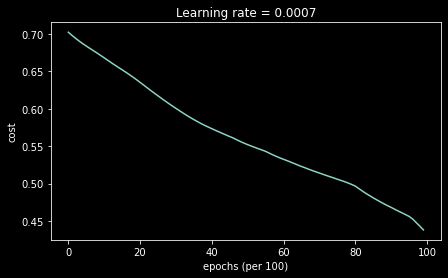

Accuracy: 0.7966666666666666


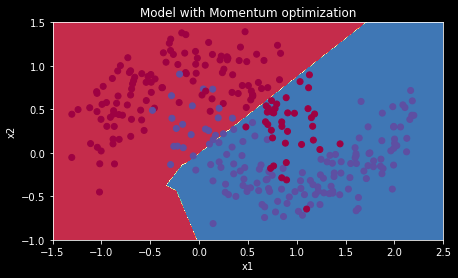

In [17]:
# train 3-layer model
layers_dims = [train_X.shape[0], 5, 2, 1]
parameters = model(train_X, train_Y, layers_dims, beta = 0.9, optimizer = "momentum")

# Predict
predictions = predict(train_X, train_Y, parameters)

# Plot decision boundary
plt.title("Model with Momentum optimization")
axes = plt.gca()
axes.set_xlim([-1.5,2.5])
axes.set_ylim([-1,1.5])
plot_decision_boundary(lambda x: predict_dec(parameters, x.T), train_X, train_Y)

#### Mini-Batch with Adam Mode


The number of training examples is : 300

The mini-batch size : 64


 OK OK 

[[1 0 1 0 1 1 0 0 1 0 1 1 0 0 1 1 1 0 0 1 0 0 1 0 0 1 0 0 0 1 0 0 1 0 0 1
  1 1 0 1 0 1 1 1 1 0 1 0 1 0 1 0 1 1 0 0 1 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 1 1 0 1 0 1 0 0 0 1 1 0 1 1 0 0 0 0 0 0 0 1 1 1 1 0 1 1 0
  1 0 0 0 0 1 1 1 0 1 1 1 0 0 0 1 1 0 1 1 0 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0 1 0 1 1 0 1 1 1 0 1 0 0 0 1 1 1 1 1 1 1
  1 1 0 1 1 1 1 1 1 1 1 0 1 1 0 1 0 0 0 0 1 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 0 1 0 1 0 0 1 1 0 1 0 1 0 1 1 1 1 0 1 0 0 0 0 1 1 1 0 0 1
  0 1 1 0 0 0 0 0 0 0 0 1 1 1 1 0 1 0 0 0 1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 0 1 0 1 0 0 0 0 1 0 1 1 0 1 0 1 0 0 0 1 0 1 1 1 1 0 1 1 0
  1 0 0 0 0 0 0 0]]

 OK OK 

Cost after epoch 0: 0.702166

 OK OK 

[[0 0 0 0 1 1 1 0 0 0 1 1 0 1 0 1 1 1 1 1 0 0 1 0 0 0 0 1 1 0 0 0 1 0 0 1
  1 0 1 0 1 1 1 1 0 1 1 1 1 0 1 1 1 0 1 0 1 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 


 OK OK 

[[1 0 0 1 1 0 1 1 0 1 1 0 1 1 0 1 1 0 0 0 0 0 1 1 0 0 0 0 1 1 1 0 0 0 0 0
  1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 1 1 0 0 0 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 1 1 0 0 0 0 0 0 0 0 1 1 0 0 1 0 0 1 1 0 1 1 1 1 1 1 0 1 0
  1 1 1 0 1 1 0 0 0 1 0 1 0 0 1 1 1 0 1 0 1 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 1 1 0 1 1 1 1 0 0 0 0 0 0 1 1 1 0 1 1 0 1 0 0 1 1 1 1 0 1
  1 0 0 0 0 0 0 0 1 1 0 1 1 1 0 1 1 0 1 1 0 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 1 1 1 0 1 0 0 1 0 1 0 0 0 1 1 0 1 0 0 0 0 1 1 1 0 0 0 1
  1 0 1 0 1 1 1 0 0 0 1 0 0 0 0 1 0 0 0 1 0 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 0 1 0 0 0 0 0 0 0 0 0 1 1 1 0 1 0 1 1 1 0 0 0 0 1 0 1 0 1
  1 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 1 1 1 1 0 1 1 1 1 0 1 1 1 0 0 0 1 0 1 0 0 1 0 0 0 0 1 0 1
  1 1 0 0 0 1 0 1 1 1 1 0 1 1 0 0 1 0 1 0 0 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 1 1 1 1 0 1 0 1 1 1 1 0 0 1 0 0 1 0 0 1 1 1 1 1 0 0 1 0 1
  1 1 1 0 0 0 0 0 0 1 0 1 0 0 1 


 OK OK 

[[1 1 1 0 1 1 1 0 1 0 1 1 1 0 1 1 1 1 1 1 0 1 1 1 0 0 0 1 1 0 0 0 0 1 0 0
  1 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 1 1 0 0 0 0 1 0 0 1 0 0 0 1 0 1 1 1 1 0 1 1 0 1 0 0 0 1 1
  0 1 0 1 0 1 1 1 0 0 1 0 0 0 0 1 0 0 1 1 1 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 1 0 0 0 1 1 0 1 0 0 1 0 0 1 1 0 1 1 0 1 1 1 0 1 1 0 1 0 0
  0 0 0 1 1 1 1 0 1 1 1 0 0 0 1 1 1 1 0 0 1 0 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 1 0 1 1 0 1 0 1 1 1 1 0 1 1 1 1 0 0 1 1 0 0 1 0 1 0 0 1 0
  1 1 0 0 0 1 1 0 0 1 0 1 0 1 0 0 1 0 0 1 0 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 0 0 1 0 1 0 0 0 0 0 0 0 1 1 0 1 0 0 0 0 0 0 0 1 1 0 1 1 0
  1 1 0 1 1 0 1 0 0 1 0 0 1 1 1 0 0 1 0 0 1 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 1 1 1 0 0 1 1 0 1 0 1 0 0 0 1 0 1 0 0 1 0 0 0 0 1 0 1 1 1
  1 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 0 1 1 0 0 1 0 1 1 0 1 0 0 0 1 0 1 0 0 0 0 1 0 0 0 0 0 0 0
  0 0 1 0 0 1 1 1 0 1 0 1 0 0 1 0 0 1 0 0 1 0 1 0 1 0 0 1]]

 OK OK 


 

  1 1 0 0 0 1 0 1 0 0 0 1 0 0 1 0 1 1 1 0 1 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 0 0 0 0 0 1 1 1 0 1 0 0 1 1 0 1 0 1 1 0 1 1 1 1 1 0 0 1 0
  0 1 1 0 0 1 1 1 0 1 0 1 1 0 0 1 0 1 0 1 1 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 0 0 0 0 0 0 1 0 1 0 1 0 1 1
  0 1 1 1 1 1 1 1 1 0 1 1 0 0 0 1 1 0 0 0 0 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 1 1 0 1 0 1 1 1 1 0 1 0 1 0 1 0 0 0 0 0 1 1 0 0 1 1 0 1 0
  1 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 0 1 0 1 1 0 1 1 0 0 1 1 0 0 0 1 0 0 0 0 1 0 0 1 0 0 0 1 1
  1 0 1 1 1 0 1 0 1 1 0 0 0 0 0 1 0 1 1 1 1 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 0 0 0 1 1 1 1 1 0 0 1 0 1 0 1 1 0 1 1 1 0 1 0 0 1 0 1 0 1
  1 0 0 0 0 0 1 1 0 0 0 1 1 0 0 0 0 0 1 1 0 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 0 1 0 0 1 1 1 1 1 0 1 1 1 0 1 1 0 1 1 1 1 1 0 0 1 1 1 1 1
  1 0 0 1 1 1 0 0 1 1 0 0 0 1 1 0 0 1 1 1 1 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 1 1 1 0 0 0 0 0 0 1 


 OK OK 

[[0 0 0 1 0 0 1 1 0 0 1 1 1 1 0 0 1 0 0 0 1 1 0 0 1 1 0 1 0 0 1 0 1 1 1 0
  1 1 1 0 1 1 1 0 0 1 0 0 0 0 1 0 0 1 1 1 0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 1 1 0 1 1 1 0 0 1 1 0 1 1 1 1 1 1 1 1 0 1 0 1 0 0 0 0 1 0
  1 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 0 0 0 0 0 1 1 0 1 0 1 0 1 0 0 1 1 0 0 0 0 1 0 0 0 1 1 1
  0 1 1 0 0 0 0 1 1 1 1 0 0 0 1 1 1 0 1 0 0 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 1 1 0 0 1 0 0 1 1 0 1 1 1 0 0 0 0 0 0 1 0 1 1 1 1 0 0 1
  1 0 0 1 1 1 1 0 0 1 1 1 1 0 1 1 1 1 0 0 0 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 0 0 0 1 1 0 0 0 1 1 1 0 0 1 1 1 0 1 0 1 0 1 1 1 0 0 0 0 1
  1 1 0 1 1 0 1 0 1 1 1 1 0 0 0 1 1 1 0 1 0 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 1 1 0 1 0 0 1 0 0 1 1 0 0 0 1 0 0 1 1 1 0 1 0 0 0 0 1 1 0
  0 1 0 1 0 1 1 0 1 0 0 0 0 0 0 1 0 1 1 0 0 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 1 0 0 1 0 0 1 0 0 1 0 1 1 0 0 1 1 1 0 1 1 1 0 0 1 1 1 1 0
  1 1 0 0 0 1 1 1]]

 OK OK 


 


 OK OK 

[[1 0 1 0 0 0 0 1 1 1 1 0 1 0 0 1 1 1 1 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0
  0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 0 1 1 0 0 1 1 1 1 0 0 0 1 1 1 1 0 1 1 1 1 1 0 1 1 1 0 0 1
  1 0 1 0 1 0 0 1 1 1 1 0 0 1 1 1 0 0 0 0 1 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 1 1 1 0 1 0 1 1 0 0 1 1 0 0 1 1 1 1 1 1 0 0 1 0 0 0 1 0 1
  0 0 0 1 1 0 0 1 0 0 1 0 1 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 0 1 0 0 1 0 0 1 1 0 0 1 1 1 1 0 0 1 0 0 1 0 0 1 1 0 1 0 1
  1 1 0 1 0 1 0 1 0 0 0 0 0 0 0 0 1 1 1 0 0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 0 0 1 1 1 1 1 1 0 0 0 0 0 0 0 0
  0 0 0 1 1 0 0 0 1 0 1 0 1 1 1 1 1 1 1 1 0 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 1 1 0 1 0 0 1 0 0 1 0 0 0 1 0 0 0 0 0 1 1 1 1 1 0 0 0 0 1
  0 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 0 1 1 0 0 1 1 0 1 0 0 1 1 0 1 0 1 0 0 1 1 0 1 0 0 1 1 1 0
  0 1 1 1 0 1 1 0 0 1 1 1 0 0 0 1 0 0 1 0 0 1 1 1 1 0 0 1]]

 OK OK 


 


 OK OK 

[[1 0 0 0 0 1 0 1 1 0 0 0 0 0 1 1 0 0 1 1 0 0 1 1 0 1 0 1 0 1 1 0 0 0 1 1
  0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 0 0 0 1 0 1 0 1 1 0 0 1 0 0 0 0 0 0 1 1 1 0 0 1 1 1 0 0 1
  0 0 0 1 0 1 0 1 1 1 1 1 0 1 0 1 0 1 0 1 1 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 0 1 1 1 1 1 1 0 1 1 1 0 0 0 1 0 1 1 1 0 0 1 1 1 0 1 0 0 1
  1 1 1 0 1 1 0 0 1 0 1 1 0 1 1 1 1 0 0 1 0 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 0 0 1 0 1 0 1 0 1 1 0 1 1 1 0 0 1 1 0 0 0 1 0 1 0 1 1 1 0
  1 1 1 0 1 0 1 0 0 1 1 1 1 1 0 1 0 0 0 1 0 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 1 1 0 0 0 1 1 0 0 0 1 0 0 0 0 0 1 1 0 0 1 0 0 1 0 1 1 0 1
  0 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 0 1 0 1 0 1 1 1 1 1 1 1 1 1 0 0 1 0 0 0 0 1 0 1 1 1 0 0 0
  1 1 0 0 0 1 1 1 1 0 1 1 0 0 1 1 1 1 0 1 1 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 0 0 1 0 0 0 1 1 1 1 0 1 0 0 0 1 1 1 0 1 1 0 0 0 0 1 1 1 0
  1 0 0 1 1 0 0 0 1 1 1 0 0 1 1 


[[0 1 1 1 0 1 1 1 0 0 0 0 1 1 1 0 1 0 0 0 1 1 1 1 0 1 1 0 1 0 0 0 0 0 1 0
  1 0 1 0 1 0 0 1 0 0 0 0 0 0 0 1 0 1 0 1 0 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 0 1 1 1 1 0 0 1 0 1 0 0 0 1 1 0 0 1 0 0 1 0 1 0 0 0 1 0 0
  1 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 0 1 1 0 0 0 1 0 1 0 0 0 1 0 1 1 0 1 0 0 0 1 0 1 1 1 0 1 1
  1 1 0 1 1 0 0 1 0 0 0 1 0 0 1 0 0 1 0 0 1 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 0 0 1 1 1 1 1 1 0 1 0 1 0 0 0 0 1 0 1 1 0 0 1 1 1 0 0 1 1
  0 1 1 1 1 1 0 1 0 0 1 1 1 0 0 0 0 0 1 1 1 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 1 1 0 0 1 1 1 0 0 0 1 1 1 0 1 0 1 1 0 1 1 0 1 1 0 0 1 1 0
  0 0 1 0 1 0 1 1 1 0 1 1 0 1 0 1 0 1 1 1 1 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 1 0 0 1 0 1 0 1 0 1 0 1 0 0 0 1 0 0 0 1 0 0 1 1 0 1 0 1 1
  0 1 0 1 0 0 1 0 1 1 0 0 1 1 0 1 1 0 1 1 0 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 1 0 1 1 0 0 0 1 1 1 0 1 0 0 1 0 0 1 1 1 0 1 1 0 1 0 1 1 0
  0 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 0 1 1 0 0 0 1 0 1 0 0 0 1 1 0 1 1 0 0 0 0 0 0 1 0 1 0 1 0 1 1 1 1 0 0
  1 0 1 1 1 0 1 0 0 0 1 1 1 1 1 0 1 0 1 1 1 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 1 1 1 1 1 0 1 1 0 0 0 1 1 1 1 1 0 1 1 1 1 0 1 1 1 1 0 1 0
  1 1 0 0 0 1 1 0 0 0 1 0 1 1 1 0 1 1 0 1 0 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 0 1 0 1 0 1 1 1 1 1 1 0 1 1 1 0 0 0 1 0 0 1 0 1 1 0 1 1 1
  0 1 0 0 1 0 0 1 0 1 0 0 0 0 0 1 1 1 0 1 0 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 1 1 0 0 0 0 1 1 0 0 1 1 0 0 1 1 1 1 0 0 0 0 0 0 1 0 1 1 0
  1 0 1 0 1 1 0 0 0 0 0 0 0 1 0 0 1 1 1 0 0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 1 0 1 1 1 1 1 0 0 1 1 0 1 0 0 0 1 1 0 0 1 1 0 1 0 0 1 0 0
  0 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 1 1 0 0 0 1 0 1 1 1 1 1 0 1 1 1 1 0 1 0 0 0 1 1 0 0 0 0 1
  0 1 1 1 0 1 1 1 0 0 0 0 1 0 1 1 0 0 1 0 0 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 1 0 0 1 1 1 0 0 0 0 1 0 0 0 0 1 0 1 0 0 1 1 1 0 0 0 0 0 0
  0 1 0 0 0 0 0 1 0 1 1 1 0 1 1 


 OK OK 

[[0 0 1 0 0 1 1 1 1 1 0 1 0 1 1 0 1 1 0 0 1 0 0 0 0 0 0 0 0 1 1 0 1 1 1 0
  1 0 1 1 1 0 1 0 0 1 0 1 1 0 0 1 0 1 1 1 1 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 1 0 0 0 1 0 1 0 1 1 0 1 1 0 1 0 1 0 1 0 1 0 1 0 1 1 0 0 0
  1 0 0 0 1 1 1 1 0 0 1 1 0 0 0 1 1 1 0 0 0 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 1 0 0 1 1 0 0 0 1 1 0 0 1 0 1 1 1 0 0 1 0 1 1 0 1 0 1 0 0
  1 1 0 1 1 1 0 0 1 0 0 1 1 0 1 1 1 0 0 0 0 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 1 0 1 1 0 1 0 0 1 0 0 1 0 0 1 0 1 1 0 0 1 0 0 0 1 0 1 0 1
  0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 0 0 1 0 0 0 0 1 0 0 1 1 1 0 0 0 1 1 0 1 1 1 1 1 1 0 1 1 0
  0 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 0 0 1 0 0 1 0 1 0 1 0 1 0 1 1 0 1 0 0 0 0 1 0 1 1 0 0 0 1
  0 1 1 1 0 0 0 0 0 1 0 0 1 1 1 1 1 1 1 1 1 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 0 0 0 0 0 0 1 0 1 0 1 1 1 0 1 1 1 0 0 1 0 0 1 1 0 0 0 1 1
  0 0 1 1 1 1 0 1 0 1 1 1 0 1 0 

  0 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 1 0 0 1 1 1 1 1 0 1 0 1 0 1 1 0 0 0 1 1 0 0 0 1 0 0 0 1 1
  0 1 0 1 1 1 1 0 0 1 1 1 1 1 0 0 0 0 1 0 1 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 0 1 0 1 0 1 0 1 1 0 1 1 0 1 0 0 1 1 1 1 1 1 0 1 0 1 1 0 1
  0 1 0 0 0 1 1 0 1 0 0 0 0 1 1 0 0 0 0 1 0 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 0 0 1 0 0 0 0 0 0 1 1 0 1 1 1 1 1 0 0 0 1 0 0 0 1 1 0 1 0
  1 1 1 0 0 0 0 0 0 1 0 1 1 1 0 0 1 1 0 0 0 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 0 0 1 0 1 0 1 1 0 1 0 0 1 1 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0
  1 1 1 1 1 1 1 0 0 1 0 0 0 1 0 1 0 1 0 0 1 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 1 0 1 1 1 1 1 0 1 1 1 1 1 1 0 1 0 0 1 0 0 1 0 1 1 0 1 0 0
  0 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 1 0 0 1 1 0 1 1 0 0 1 1 1 0 0 1 1 1 1 0 1 0 0 0 0 1 1 0 1
  0 1 1 1 1 0 1 1 0 0 1 1 1 1 1 1 0 0 0 1 0 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 0 0 0 0 1 0 0 1 1 1 0 1 0 1 0 1 0 0 1 1 1 0 0 0 1 1 0 0 1
  


[[0 0 0 0 0 1 1 1 0 0 1 0 1 0 0 0 1 1 1 1 0 0 0 0 0 0 0 1 1 1 0 0 0 0 0 1
  0 0 1 1 0 1 1 1 1 0 0 1 0 1 0 1 1 1 1 1 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 1 1 1 0 0 1 0 1 1 1 0 0 1 0 1 0 0 0 0 0 1 0 1 0 0 0 1 0
  1 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 1 1 0 0 0 0 1 1 1 0 1 1 1 0 0 0 0 0 1 1 0 1 0 1 0 0 1 1 1
  0 0 0 1 0 0 1 1 0 1 1 0 0 1 1 1 0 1 1 1 0 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 0 0 0 1 1 1 1 1 1 0 1 0 0 1 1 1 1 0 0 0 0 1 0 1 1 1 1 1 1
  0 1 0 1 0 1 1 1 0 1 1 1 1 1 1 0 0 1 0 1 1 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 0 0 0 1 1 0 0 0 0 1 1 1 0 0 0 0 1 0 0 0 0 1 1 1 1 0 0 1 0
  0 0 0 1 1 0 1 0 1 1 1 1 0 0 0 1 0 0 0 1 0 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 1 1 0 0 1 1 1 1 0 0 0 1 0 0 0 0 0 1 1 1 1 1 0 1 0 1 0 0 1
  0 1 0 1 0 1 0 1 0 1 0 1 0 1 1 0 1 0 0 1 1 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 1 0 1 0 1 1 0 0 1 0 1 1 0 0 1 1 1 0 0 1 0 1 1 0 1 0 1 1 0
  0 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[


[[0 0 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1 1 0 0 1 1 1 1 0 1 1 0 1 1 1 0 1 1 0 0
  0 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 0 0 0 1 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 0 0 0 1 0 1 1 1 1 1 0 1 1 1 1 0 1 0 1 1 0 0 0 0 1 0 0 0 0
  1 0 0 0 1 1 1 1 0 0 1 1 1 0 1 0 0 1 0 0 1 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 1 0 1 1 0 1 0 0 1 1 1 1 0 0 1 1 0 0 0 1 1 0 1 1 1 1 1 0 1
  1 1 1 1 0 0 1 0 1 1 1 1 0 0 1 1 0 0 0 0 1 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 1 0 0 0 0 1 0 1 1 1 0 1 0 0 0 0 1 0 0 0 0 0 1 0 0 0 1 1 0
  1 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 0 1 1 1 1 0 0 1 1 0 0 0 1 0 1 1 1 0 0 0 0 0 1 0 0 1 0 1 0
  0 0 0 1 0 0 0 0 1 1 0 0 0 1 0 1 0 1 0 0 0 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 0 1 1 1 0 0 0 1 1 0 0 1 0 1 1 1
  1 1 1 1 1 0 0 0 1 1 1 1 1 1 1 1 0 0 0 1 1 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 1 1 0 0 1 1 1 0 1 0 1 0 0 1 1 1 1 0 1 0 0 0 1 0 0 0 1 0 1
  0 0 1 0 1 0 0 1 1 0 0 1 0 1 1 0 1 1 0 0


 OK OK 

[[0 0 1 1 0 1 0 0 1 1 1 0 0 0 1 1 0 1 0 0 1 0 1 0 1 0 0 0 0 0 0 0 1 0 0 1
  1 1 0 0 0 0 1 1 0 1 0 1 1 1 0 1 0 0 0 0 1 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 1 0 0 1 1 1 1 0 0 1 0 0 1 0 1 1 1 1 1 1 1 1 0 1 1 1 1 0 1 1
  0 0 1 0 1 1 1 0 0 1 0 0 1 1 0 1 1 1 1 0 0 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 1 1 0 0 1 0 0 0 1 0 0 0 1 1 1 0 1 0 0 0 1 1 0 1 0 1 1 1 0
  1 0 1 1 0 1 1 1 1 1 0 1 0 0 0 1 1 1 0 1 0 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 0 0 0 1 0 0 0 1 1 0 0 1 0 0 1 1 1 1 0 0 1 0 1 0 0 1 0 0 0
  1 0 1 0 1 1 0 0 0 0 0 0 0 1 0 1 0 0 0 1 1 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 1 1 0 0 1 0 0 1 0 0 0 1 1 1 0 1 1 0 0 1 0 1 0 1 1 1 0 1 1
  0 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 1 1 1 0 1 1 0 1 0 0 1 1 1 0 0 0 1 1 1 0 1 1 0 1 0 1 1 0 1
  1 1 1 1 1 1 1 1 0 1 0 1 1 0 1 0 1 1 1 0 0 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 1 0 1 0 0 1 0 0 0 0 1 1 1 0 0 1 0 1 0 0 0 0 1 0 0 0 0 0 0
  0 0 1 0 1 0 1 0 1 0 0 0 1 1 1 


[[0 0 1 0 0 0 1 0 1 1 0 1 1 1 1 1 0 1 1 1 0 1 1 1 0 0 1 0 1 0 0 1 1 1 1 1
  1 0 1 0 0 1 0 0 0 0 0 1 1 0 1 1 1 1 1 1 0 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 1 1 1 0 1 1 0 1 0 0 1 1 0 1 0 0 1 0 0 0 0 1 1 1 0 0 1 1 1
  0 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 1 1 1 1 1 1 0 0 0 0 1 0 1 0 1 1 0 0 1 1 0 0 0 1 0 1 1 0 1
  0 1 0 1 0 1 1 0 0 1 1 1 0 1 1 1 0 0 0 0 1 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 1 0 1 0 0 0 0 1 0 1 1 1 1 0 0 0 1 0 1 1 1 1 0 1 0 0 1 1 0
  1 0 1 1 1 0 0 0 0 1 0 1 1 1 1 1 0 0 1 1 0 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 0 1 0 0 1 1 0 0 1 0 1 1 1 1 1 1 1 0 1 1 0 0 1 0 1 0 0 1 1
  0 1 1 0 0 1 1 1 0 1 0 0 0 1 1 0 0 1 0 0 0 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 0 1 1 0 0 1 1 1 0 0 0 1 1 0 0 1 0 0 1 0 0 0 0 0 0 1 1 0 1
  1 0 1 0 1 0 1 1 0 1 0 1 0 0 1 1 0 1 1 0 0 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 0 1 1 1 0 1 0 0 1 1 0 1 1 1 0 1 1 1 1 1 0
  1 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 0 0 1 1 0 1 0 1 0 0 0 0 0 1 0 1 0 0 0 0 0 1 1 0 0 1 1 1 1 1 0 1 1 0 0
  0 1 0 1 1 1 0 1 0 1 1 0 0 0 1 0 1 0 0 0 0 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 1 1 1 0 1 0 1 0 1 1 0 1 0
  0 1 1 0 0 0 1 0 0 0 1 0 1 1 1 1 1 1 0 1 0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 0 1 1 0 0 1 1 0 0 1 1 0 1 0 0 0 1 1 0 1 0 0 1 1 0 1 0 1 1
  0 0 0 1 0 0 0 1 0 1 0 0 1 0 1 0 1 1 1 0 1 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 0 0 1 1 1 0 0 1 0 1 0 1 1 1 1 0 0 0 1 1 0 1 0 0 1 0 0 0 0
  1 0 0 0 1 1 1 1 0 1 1 1 1 0 1 0 1 1 1 1 1 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 1 0 1 0 1 1 0 0 1 1 0 1 0 1 0 0 0 0 0 1 1 1 1 1 0 1 0 0 0
  1 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 1 1 0 1 1 1 1 1 0 1 0 0 0 0 1 0 0 1 0 0 1 1 0 1 0 0 0 0 1
  1 0 1 1 0 0 1 1 0 1 1 1 1 0 0 0 1 1 0 1 0 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 1 0 1 0 1 1 1 0 1 1 1 0 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 1 1
  1 0 0 0 1 1 1 0 0 1 0 0 1 1 0 


 OK OK 

[[1 1 1 0 1 1 1 0 1 0 1 0 1 0 0 1 0 0 0 1 1 0 1 1 0 1 0 1 0 0 1 1 0 1 1 1
  0 1 1 1 0 0 0 0 0 0 0 1 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 0 1 0 1 1 1 1 1 1 0 0 1 0 0 0 0 0 1 0 1 1 1 0 0 1 1 1 0 0
  1 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 1 0 0 0 1 0 0 0 1 1 0 0 1 1 1 0 1 0 1 0 1 1 0 0 0 0 0 1 0
  0 1 1 1 0 1 0 0 1 0 1 1 0 0 0 0 0 1 1 1 1 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 1 0 0 1 1 0 1 1 0 0 1 0 1 1 0 1 1 1 0 0 1 1 1 0 1 0 0 0 1
  1 0 0 0 0 1 0 0 1 0 0 0 0 0 1 1 0 0 0 1 0 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 0 1 0 0 1 0 0 1 0 1 0 1 1 0 1 0 0 1 0 0 1 1 1 1 1 1 0 0 0
  0 1 0 1 0 0 0 1 0 0 1 0 1 0 0 1 0 1 1 1 1 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 0 0 0 0 1 0 1 1 0 0 0 1 0 1 1 1 0 1 1 1 0 1 0 0 0 0 0 0 0
  1 1 1 0 0 0 0 1 0 1 1 0 0 1 1 1 1 1 0 1 1 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 0 1 1 1 0 1 0 0 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 1 0 1
  1 1 1 1 1 1 0 0]]

 OK OK 


 


 OK OK 

[[0 1 0 1 0 0 0 1 1 0 0 0 1 0 0 0 1 0 0 0 1 0 0 0 1 0 1 0 0 1 0 0 0 1 1 0
  1 0 1 1 0 1 0 1 0 0 0 1 0 0 1 1 1 0 1 1 0 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 0 0 1 0 0 1 0 1 1 1 0 1 0 1 0 1 1 1 0 1 0 1 0 0 0 0 0 1
  1 1 0 0 1 1 0 0 1 0 0 1 1 1 1 0 0 0 1 0 1 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 0 1 0 1 1 0 1 1 1 0 0 0 1 0 0 0 0 0 1 1 0 0 0 0 1 1 0 1 0
  1 0 1 0 1 0 1 1 0 1 0 1 1 1 1 0 1 1 0 0 0 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 1 1 0 0 1 0 1 1 0 0 1 0 1 0 1 0 1 0 1 0 1 0 0 0 0 1 1 1
  1 1 1 1 1 1 1 0 1 1 0 1 0 1 1 0 1 1 0 1 0 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 1 0 1 1 0 0 1 1 1 1 1 0 0 1 0 0 0 1 0 0 0 0 1 1 1 1 1 1 0
  0 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 0 0 1 1 1 1 1 1 0 1 1 0 0 0 1 1 0 1 1 1 0 1 0 1 1 0 1 0 0
  0 0 1 1 0 1 1 0 0 0 1 1 1 0 0 1 0 0 0 1 0 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 1 0 0 0 0 1 1 0 0 0 0 1 1 0 1 0 0 0 0 1 1 0 0 1 1 1 0 0 1
  1 0 0 1 1 0 1 0 1 0 0 1 0 1 1 


[[1 1 1 0 1 0 1 1 0 0 1 0 0 0 0 1 0 0 0 0 0 0 1 1 1 1 0 1 0 1 0 0 0 0 0 0
  1 1 1 0 0 1 1 0 0 0 0 0 1 1 0 1 0 1 0 0 1 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 1 1 1 0 0 0 1 0 0 0 1 1 1 1 1 1 0 0 1 1 1 1 0 0 0 0 1 0 0
  1 1 1 1 1 1 0 1 1 1 1 0 1 1 0 1 0 1 1 1 1 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 1 1 1 1 0 1 0 1 1 1 1 1 0 1 1 1 0 0 1 0 1 0 0 1 0 1 0 0 0
  0 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 0 0 1 0 0 1 0 0 0 1 0 0 1 1 1 0 1 0 1 1 1 0 1 0 0 1 0 1 1
  1 1 1 0 0 1 1 0 0 0 0 0 0 0 0 0 1 0 1 0 1 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 1 0 0 0 1 1 0 0 0 1 0 1 1 1 1 0 0 0 0 0 0 1 0 1 1 1 1 0 0
  0 1 1 1 1 0 0 0 1 1 1 1 0 0 0 1 0 1 0 0 1 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 1 1 1 1 0 1 1 1 1 1 0 0 0 0 0 1 1 1 0 0 0 0 1 1 1 0 1 1 1
  0 1 0 0 0 0 1 0 1 1 0 1 1 0 1 1 0 1 1 1 0 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 0 0 1 0 0 0 1 1 1 0 1 1 1 1 0 1 1 1 1 0 1 0 1 1 1 1 0 1 1
  1 0 0 0 1 0 1 0 1 0 0 1 0 0 1 1 0 0 0 1


[[0 0 0 1 1 0 0 1 0 0 0 0 1 0 0 0 1 1 1 0 1 1 0 0 1 0 0 1 0 1 0 1 1 1 1 0
  1 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 0 1 0 0 0 1 0 0 1 1 1 0 0 0 1 0 1 1 0 1 1 1 0 0 0 0 1 1 0
  0 1 1 1 1 1 0 0 0 1 0 1 1 0 0 0 1 1 0 0 1 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 0 0 0 0 0 1 1 1 0 1 0 1 1 0 1 0 1 1 0 0 0 0 1 0 0 1 0 0 0
  1 1 1 0 1 0 0 1 1 0 0 0 0 0 1 0 0 1 0 1 0 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 1 0 0 0 1 1 0 0 0 1 0 1 0 1 1 1 1 1 0 0 1 1 1 0 0 0 1 0 0
  0 0 0 0 0 0 0 1 1 0 1 0 1 0 0 1 0 1 1 0 0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 1 0 1 1 0 0 1 0 1 0 0 1 1 1 0 1 1 1 1 0 1 1 0 0 1 0 0 0 1
  0 1 1 1 1 1 1 0 1 0 0 0 0 1 0 1 1 0 1 0 1 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 0 1 1 1 0 0 1 1 1 1 0 1 1 1 0 0 1 1 0 0 0 0 1 0 0 0 1 1 1
  1 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 0 0 1 0 0 1 1 1 0 0 1 1 1 1 0 1 0 1 0 1 0 1 0 1 1 0 1 0 1
  0 0 1 0 0 0 1 1 0 1 0 1 0 0 0 1 0 0 1 1 1 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 0 0 0 0 1 1 1 1 1 0 1 0 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 0 0 1 0 1 1
  1 0 1 0 1 0 1 0 1 1 0 1 0 1 0 1 0 0 0 1 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 1 0 0 1 1 1 1 1 0 0 1 1 1 1 0 1 1 0 1 1 1 0 0 0 1 0 0 0 0
  1 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 1 0 0 0 0 1 0 0 0 1 0 1 1 1 1 1 1 0 0 1 0 1 0 0 0 0 1 1 0
  1 0 0 1 1 1 1 0 0 1 1 0 0 0 0 0 0 0 1 0 0 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 0 0 0 0 0 1 1 0 1 0 1 1 1 0 0 1 1 1 0 1 1 1 0 1 0 1 1 0 1
  0 0 0 0 0 1 0 1 0 1 1 1 1 0 0 0 0 1 1 1 0 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 0 0 0 0 1 1 1 0 1 1 0 1 0 0 1 1 0 0 1 0 0 1 1 1 1 0 0 1
  0 0 1 0 0 1 1 0 1 1 1 1 0 0 1 1 0 0 1 0 0 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 1 0 1 1 1 1 1 1 1 1 0 0 0 1 1 0 1 1 1 1 0
  0 1 0 0 1 0 0 1 1 1 0 1 0 1 1 1 1 1 1 1 0 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 0 0 1 0 0 1 1 1 0 0 0 0 1 0 1 0 1 1 0 0 0 1 1 0 0 1 0 0 1
  0 1 0 1 1 1 1 1]]

 OK OK 


 


[[0 1 1 0 1 1 0 1 1 1 0 0 1 0 0 1 1 0 0 0 0 1 1 1 1 1 0 0 1 0 1 0 0 0 0 1
  1 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 1 0 0 1 0 1 1 1 0 0 1 1 1 1 0 0 0 1 1 0 0 0 0 1 1 1 0 0 0
  0 1 1 1 1 1 0 1 0 0 0 1 0 1 0 1 1 0 0 0 0 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 1 0 0 0 0 1 0 0 0 0 1 0 0 0 1 1 0 0 0 0 1 0 0 0 1 0 1 0 0
  1 1 1 0 0 1 0 1 0 1 0 0 0 1 0 0 0 0 0 1 1 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 0 1 1 0 1 0 1 0 0 0 0 0 0 0 1 1 0 1 1 1 1 1 0 0 1 0 0 1 0
  1 0 0 0 1 0 1 1 1 0 1 1 0 0 1 0 1 0 0 1 0 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 1 1 0 1 1 0 1 1 1 0 1 1 1 1 1 0 0 0 1 1 0 1 1 0 0 0 0 1 1
  1 1 1 1 0 0 1 0 0 0 1 0 1 1 1 0 0 1 0 0 1 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 0 0 0 1 1 0 1 1 1 0 0 1 1 1 1 1 1 1 1 1 0 0 0 1 1 1 1 1 1
  0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 0 0 1 0 0 0 1 1 1 1 1 0 1 1 0 0 0 1 0 0 1 0 1 1 0 0 0 0 0
  1 1 1 0 1 1 0 0 0 0 1 0 0 0 0 0 0 1 1 1 1 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[


 OK OK 

[[1 0 1 1 0 1 0 0 1 0 0 0 1 1 1 1 0 0 1 1 1 1 0 0 1 0 1 0 1 0 1 1 1 1 1 1
  0 0 0 1 0 0 1 1 0 1 0 1 1 1 0 0 0 1 0 0 1 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 1 0 0 0 1 1 0 0 0 1 0 1 0 0 1 1 1 1 1 0 0 1 0 1 0 1 0 0 0
  0 0 1 1 1 1 1 0 1 0 0 0 1 1 0 1 0 0 0 1 0 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 0 0 0 0 1 0 0 0 0 1 1 1 0 1 1 1 1 1 1 1 1 1 1 0 1 0 1 1 0
  0 0 0 1 0 0 1 0 1 1 0 0 0 0 0 0 0 1 0 0 1 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 1 1 0 0 1 0 1 1 0 0 0 0 1 0 0 1 1 0 0 0 1 0 0 0 1 0 0 0 1
  1 0 1 1 0 1 0 1 1 0 1 0 1 0 1 0 1 1 1 1 0 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 1 0 1 1 1 0 1 1 0 1 1 0 1 0 0 1 1 1 1 0 1 1 1 1 0 1 0 0 0
  0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 1 1 0 1 0 1 1 0 1 0 1 0 1 0 0 0 0 1 1 1 1 0 0 1 0 0 1 1 1
  1 0 0 1 0 1 1 1 0 0 0 0 0 0 1 0 1 0 1 1 0 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 1 0 0 0 0 1 0 1 0 0 0 0 1 1 1 0 1 0 1 0 0 1 1 1 0 0 1 0 0
  0 1 1 0 0 1 1 1 0 1 1 1 0 0 0 


[[0 1 0 0 0 1 0 0 0 1 0 0 1 0 0 0 0 1 1 0 0 0 0 0 1 0 1 0 1 1 0 1 0 1 1 0
  0 0 1 1 0 0 0 1 0 0 0 1 0 1 0 1 1 0 0 0 0 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 1 1 1 0 0 0 1 1 1 0 1 1 0 1 1 0 1 0 1 0 1 1 0 0 1 0 1 0 1
  0 0 0 1 1 1 0 1 1 0 0 0 1 1 0 1 1 0 1 0 1 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 0 1 0 1 0 0 1 1 0 0 1 0 0 1 0 0 1 0 1 0 1 1 0 1 1 0 1 0 1
  0 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 0 1 0 1 0 1 0 0 1 1 0 1 1 1 1 1 1 0 1 1 0 0 0 0 1 0 0 0 1
  1 1 0 0 0 0 1 1 0 1 0 0 1 0 1 0 0 0 1 0 0 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 0 0 1 1 0 0 0 1 1 1 0 1 1 1 1 0 0 0 1 1 1 0 0 1 1 0 1 1 0
  1 0 0 1 0 1 1 1 1 0 1 0 1 1 1 1 0 1 0 1 0 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 0 0 1 1 1 0 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 1 1 1 1 0 0 1 0
  0 0 0 1 0 0 1 1 0 1 1 1 1 1 1 1 0 0 1 0 0 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 1 1 0 1 0 0 1 0 1 0 1 0 0 1 0 0 0 1 0 1 1 0 0 1 1 1 0 0 0
  0 1 1 0 1 1 0 1 1 1 1 1 0 1 0 0 0 0 0 1


 OK OK 

[[1 0 0 1 1 1 0 0 0 0 1 0 1 1 1 1 0 1 0 1 0 0 0 0 1 0 0 1 1 0 1 1 0 0 0 0
  0 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 0 1 0 0 0 0 0 1 1 0 0 0 0 1 1 1 1 0 0 0 0 0 1 1 1 0 1 0 0
  1 1 0 1 0 1 0 0 1 1 1 1 0 1 1 0 0 1 0 1 0 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 0 0 0 1 1 1 1 1 1 1 1 0 1 0 1 1 1 1 1 0 1 0 0 1 0 0 0 0
  1 0 1 0 0 1 1 1 0 0 1 0 1 1 0 1 0 0 0 1 1 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 0 0 0 1 0 1 1 1 0 0 1 1 1 0 1 0 0 0 1 0 1 1 0 1 1 0 1 1 0
  1 0 1 0 0 0 0 1 1 1 0 1 0 1 0 0 1 0 1 0 0 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 1 0 0 0 1 1 1 0 1 0 0 1 1 0 0 1 0 0 1 1 1 1 0 0 0 1 0 0 1
  0 0 1 1 0 0 1 1 1 1 0 0 0 1 1 0 0 0 0 0 0 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 0 0 1 1 0 1 0 1 1 1 1 0 1 1 1 0 0 1 0 1 0 0 0 0 1 0 1 0 1
  1 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 1 0 1 1 0 0 1 1 1 1 0 0 0 0 1 1 0 0 0 1 1 0 0 1 0 1 1 0 0
  0 0 1 0 1 0 1 0 0 1 0 0 1 0 1 0 1 0 0 1 0 1 0 0 1 0 0 1]]

 OK OK 


 

  0 1 1 1 1 1 0 1 1 1 1 1 1 1 0 0 0 1 0 0 0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 1 0 1 0 1 1 1 1 0 1 1 0 1 1 1 0 0 0 1 1 0 0 0 1 0 1 0 0 1
  0 1 0 0 1 0 0 1 0 0 1 0 1 1 0 1 1 1 0 1 0 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 1 0 1 1 0 1 1 1 1 1 1 1 0 1 0 0 1 1 1 1 1 0 1 1 1 1 1 1 1
  1 1 0 0 1 0 1 1 1 1 0 1 0 1 0 0 1 1 0 0 0 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 0 0 1 1 0 1 0 1 0 0 0 1 0 1 0 1 0 1 0 1 1 1 0 0 1 0 0 0 1
  0 0 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 0 0 0 1 0 1 1 0 0 0 0 0 0 1 0 1 1 1 1 0 0 0 1 0 1 0 1 0 0
  0 1 1 0 1 0 1 0 0 1 0 0 1 1 1 0 0 0 0 0 0 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 0 1 0 1 1 0 1 1 1 0 0 1 1 1 0 1 1 1 1 0 1 1 1 1 1 1 1 0 0
  0 1 0 1 1 1 1 1 1 0 1 0 1 0 1 1 1 0 1 1 1 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 1 0 1 1 1 0 1 0 1 0 0 1 0 0 0 1 1 1 0 1 0 0 0 0 1 0 1 0 1
  0 1 0 0 0 1 1 1 1 1 1 1 0 1 0 1 0 1 0 1 1 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 0 0 1 1 0 1 1 1 1 1 

  0 1 0 0 0 1 0 1 1 0 1 1 0 0 0 1 0 1 1 0 0 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 0 0 0 1 0 0 1 1 0 1 1 0 0 0 1 0 0 1 1 0 0 0 1 0 1 1 1 1 1
  0 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 1 1 0 0 1 1 1 1 1 0 1 0 1 1 0 0 0 1 1 1 0 1 0 1 0 1 0 1 0
  1 0 1 0 0 1 0 1 1 0 0 0 0 1 0 0 1 0 1 0 1 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 0 0 1 1 0 1 1 0 1 0 0 1 0 0 1 1 1 1 1 1 1 0 0 1 0 1 1 1 1
  0 1 0 1 1 1 0 0 1 1 0 1 0 0 0 0 1 0 1 0 1 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 1 1 1 1 1 1 1 0 0 1 1 1 0 1 0 0 0 0 0 0 1 1 0 0 0 0 1 0 1
  1 0 0 1 1 0 1 0 0 1 0 0 1 1 0 0 0 1 0 1 0 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 1 1 0 1 0 0 0 0 1 0 0 0 0 0 0 0 1 0 1 1 0 1 1 0 0 1 0 1 0
  0 1 1 0 1 1 0 0 0 0 0 1 0 0 0 1 0 1 1 1 1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 1 0 1 0 1 0 1 1 0 0 0 0 0 1 0 0 0 1 1 1 0 1 0 1 1 0 1 1 0
  1 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 0 1 1 0 1 1 1 0 1 1 0 1 0 1 1 1 0 1 1 0 0 1 0 0 1 1 1 1 1
  


[[1 1 0 0 0 1 0 0 1 0 0 0 1 1 1 1 1 0 1 0 0 1 1 1 1 1 1 0 1 0 0 1 1 0 0 1
  1 1 0 1 1 0 1 0 0 0 1 1 1 1 0 0 0 1 1 1 1 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 0 1 0 1 1 0 0 1 0 0 0 1 0 0 1 1 1 0 1 1 1 0 0 0 0 0 0 0
  1 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 0 0 1 0 1 1 1 1 1 1 0 1 1 1 0 1 1 0 0 1 0 0 0 1 1 0 0 0 0
  0 0 0 0 0 1 1 1 0 1 1 1 0 0 0 0 1 0 1 1 1 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 0 0 0 1 0 1 0 0 1 0 1 1 1 1 1 0 0 1 1 1 0 0 0 0 0 1 1 0 1
  1 0 1 0 0 1 1 0 0 0 1 0 1 1 1 0 1 0 1 0 1 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 1 0 0 1 1 0 0 1 1 1 1 1 1 1 1 0 1 0 0 0 1 1 0 0 1 0 1 1 0
  0 1 0 0 0 0 1 1 0 1 0 0 0 0 1 1 1 1 1 1 1 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 0 0 1 1 1 1 1 1 1 0 0 0 0 1 1 1 0 0 0 0 1 0 0 0 0 0 0 1 0
  0 0 1 0 1 1 1 1 1 0 1 0 0 0 1 1 0 0 0 1 1 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 0 0 0 0 1 1 1 0 1 0 0 1 1 0 0 1 0 0 1 0 1 0 0 0 0 1 1 1 1
  1 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[

  1 1 0 1 1 1 0 1 0 0 0 0 0 0 0 1 0 0 0 1 1 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 1 0 0 1 0 1 0 1 0 0 0 0 1 1 1 0 1 1 0 0 1 1 1 0 1 0 0 0 0
  0 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 1 0 0 1 0 0 1 0 1 1 0 1 0 1 1 0 1 1 1 0 0 1 1 0 1 0 0 0 0
  0 0 1 1 1 0 0 0 1 1 1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 1 0 1 1 1 1 1 0 1 1 1 0 0 1 1 0 1 1 1 1 1 1 1 0 1 0 1 0 1
  0 0 1 1 0 1 0 0 1 0 1 1 0 1 0 1 1 1 0 1 0 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 0 0 1 1 1 1 1 0 0 0 0 1 1 1 1 1 1 1 0 1 0 1 0 0 0 1 0 1 0
  0 0 0 1 0 1 0 0 0 1 1 1 0 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 0 0 1 0 1 1 1 0 0 1 1 1 0 0 1 1 1 0 1 0 1 1 0 0 1 0 1 0 0
  0 1 0 1 0 0 1 1 1 0 1 0 0 1 1 1 1 1 0 0 1 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 0 1 1 0 0 1 0 0 1 0 0 1 1 1 0 0 0 1 0 1 1 0 1 0 1 1 1 1 0
  1 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 0 1 0 0 1 1 1 0 0 0 0 0 0 1 1 1 0 0 1 1 1 0 0 0 0 0 0 1 0
  


 OK OK 

[[1 1 0 1 0 0 0 1 0 0 0 0 0 1 0 1 1 0 1 1 1 1 0 1 1 0 0 1 1 1 1 1 0 0 0 1
  1 0 1 0 0 0 0 0 0 0 0 1 1 1 0 0 0 1 0 0 1 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 1 0 1 0 1 0 0 0 1 1 0 0 1 1 0 0 1
  0 0 0 1 1 1 1 0 1 0 1 1 0 1 1 1 0 0 0 1 1 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 0 0 0 0 1 1 0 0 0 1 1 0 1 1 1 1 1 0 1 1 0 0 1 1 1 1 1 0
  1 1 1 1 1 0 1 1 0 0 1 0 0 0 0 1 0 1 0 1 1 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 0 0 0 0 0 1 0 0 0 1 1 1 1 0 0 1 1 0 0 0 0 1 0 0 1 0 0 1 1
  1 0 0 1 0 0 1 1 0 0 1 0 1 0 1 0 1 1 0 1 1 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 1 0 0 1 1 1 0 0 0 0 1 1 0 1 1 1 1 1 0 0 0 1 0 0 0 0 0 0 1
  0 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 1 0 0 0 1 0 0 0 0 1 1 0 1 1 0 1 1 0 1 1 1 1 1 1 1 1 1 0 1
  0 0 0 0 0 0 0 0 0 0 1 0 0 1 1 1 0 1 1 0 0 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 1 0 0 1 1 1 1 0 0 1 0 1 1 1 1 1 1 1 1 0 0 0 0 0 0 1 1 0 0
  0 0 1 0 1 0 1 0 1 1 1 0 0 0 0 


[[0 0 0 1 1 0 1 1 0 1 0 1 1 1 0 1 1 0 0 0 0 1 1 0 0 0 1 1 0 1 1 1 1 0 1 0
  0 1 0 1 1 1 1 1 0 1 1 1 1 1 0 1 0 0 1 0 0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 1 1 0 1 0 1 0 0 1 1 0 0 0 1 1 0 0 0 0 0 0 1 0 1 1 1 1 0 1
  0 0 1 0 1 1 0 0 0 1 1 1 0 1 1 0 1 0 0 0 1 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 0 0 0 1 0 0 1 1 0 0 0 1 0 0 1 1 1 1 1 1 1 0 0 0 1 0 1 1
  0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 0 0 1 1 0 1 0 0 0 0 0 0 1 1 0 0 0 1 0 0 0 0 1 0 0 0 0 0 1
  0 0 0 0 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 1 0 1 1 0 1 0 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 1 0
  0 1 0 0 0 1 1 0 0 1 1 0 1 0 1 1 0 0 1 0 0 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 1 0 0 1 1 1 0 1 1 1 1 0 0 0 1 1 1 1 0 1 1 0 1 0 1 1 0 1 1
  0 1 1 1 1 1 1 1 0 1 1 1 0 0 1 1 0 1 1 0 1 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 1 1 0 0 0 1 0 1 1 1 1 0 1 0 1 1 1 0 1 1 1 1 1 0 0 1 0 0 0
  1 0 0 1 0 1 1 0 0 1 1 1 1 1 1 1 1 1 0 1

  0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 1 0 0 1 1 1 1 1 0 1 1 1 1 0 1 1 1 0 1 0 1 1 0 1 1 1 1 1 1
  1 0 1 0 1 1 0 1 0 0 0 1 1 1 1 0 1 1 0 0 1 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 1 1 0 0 1 0 0 0 0 0 0 1 0 0 0 1 0 0 0 1 0 0 1 0 0 1 1 0 1 1
  0 0 1 0 1 0 0 0 0 1 1 1 0 1 0 1 0 0 0 1 1 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 0 0 0 1 1 1 1 0 1 1 0 1 0 0 1 1 0 0 1 0 1 0 0 1 0 0 1 0 0
  1 0 1 1 0 1 0 1 1 1 1 1 0 0 1 1 1 0 0 1 0 0 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 1 0 1 1 1 1 0 1 0 1 1 0 1 0 1 1 1 1 0 0 0 1 1 0 0 0 0 1 0 0
  1 1 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 1 1 0 0 0 0 1 1 0 0 1 1 0 1 1 0 0 1 1 0 0 1 0 0 0 1 0 0 0
  1 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 0 0 0 1 1 0 0 0 1 1 1 0 0 1 0 0 1 1 1
  1 0 1 0 1 0 0 1 1 0 1 1 0 1 1 1 0 1 0 1 1 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 0 1 1 0 0 0 1 0 1 1 1 0 1 1 1 0 1 0 0 0 1 0 0 0 1 0 1 0 1
  


 OK OK 

[[1 1 1 1 0 1 1 0 1 1 1 0 1 1 0 1 0 1 1 1 0 0 0 1 1 1 1 1 1 0 0 0 0 0 0 1
  1 0 0 1 1 0 0 1 0 0 1 1 1 1 0 0 0 0 1 0 0 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 0 0 0 1 0 1 1 0 0 1 1 1 1 1 1 0 0 1 0 0 0 0 1 1 0 0 1 1 1
  0 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 1 1 0 0 0 0 0 1 1 0 0 1 1 1 1 1 0 1 0 0 0 0 1 1 1 1 0 0 1
  1 1 1 0 0 0 0 1 0 0 1 0 1 0 1 1 0 0 0 0 0 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 1 1 1 0 1 0 1 0 0 0 1 0 0 1 0 0 0 0 0 1 1 1 1 1 1 1 1 0 0
  0 1 0 0 1 0 1 1 0 0 1 1 1 0 0 1 1 0 1 0 0 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 1 0 1 1 1 0 0 1 1 0 0 1 1 0 1 1 0 1 1 0 0 1 1 0 1 1 1 0 1
  0 1 1 0 0 0 1 0 1 0 1 0 1 1 0 1 0 1 0 0 0 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 0 1 1 0 0 1 0 0 0 0 0 0 1 0 0 1 0 1 1 1 0 1 1 0 1 0 1 0 0
  0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 1 1 1 0 1 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 0 0 1 0 1 0 1 1 1 0 1 1 0 1 0 0 0 0 1 1 1 1 0 1 0 0 0 0 1
  1 1 1 1 0 1 1 1]]

 OK OK 


 


[[0 0 1 1 0 0 1 0 1 0 0 1 1 1 1 1 1 0 0 1 1 1 1 0 1 1 0 0 1 0 1 0 0 0 1 0
  0 1 1 1 1 1 0 1 0 0 1 0 0 1 1 1 0 0 0 0 0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 0 1 0 0 1 1 1 0 1 1 0 0 0 0 1 1 1 1 1 1 0 0 1 1 1 0 0 1 0
  0 1 0 0 1 0 1 1 1 1 1 0 0 0 1 1 1 0 0 1 1 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 1 1 1 0 1 0 0 1 0 0 1 1 1 0 1 1 0 0 0 0 0 0 1 1 1 1 1 1 1
  0 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 1 1 1 1 0 1 0 0 1 1 1 1 0 1 1 1 0 1 0 0 1 0 1 1 1 1 1 1
  0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 1 1 0 0 0 0 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 0 0 1 0 1 1 1 1 1 0 1 1 1 0 1 0 1 1 0 1 0 0 1 1 0 1 0 1 0
  0 1 0 0 1 0 1 0 0 1 0 1 1 0 0 1 1 0 0 1 1 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 1 0 0 0 0 0 0 1 0 1 0 0 0 1 0 1 0 0 1 0 1 1 0 0 1 1 0 1 0
  1 0 0 0 1 1 0 0 1 0 1 0 1 0 0 1 0 1 0 1 1 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 0 1 0 0 1 0 1 1 0 1 0 1 0 0 0 0 0 1 0 1 0 0 0 0 0 0 1 1 0
  0 1 0 0 0 1 0 0 0 1 1 0 0 0 1 1 1 1 0 1


 OK OK 

[[0 0 0 0 0 1 0 0 1 1 0 0 0 1 0 1 1 0 0 1 1 0 0 0 1 0 1 1 0 1 1 0 1 0 0 0
  1 0 1 1 0 0 1 1 0 1 1 0 0 0 1 0 0 0 1 0 0 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 1 0 0 1 1 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 1 0 1 0 1
  0 0 1 0 1 1 0 0 1 1 1 1 0 0 1 1 1 1 1 1 1 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 1 1 0 1 0 0 0 0 0 1 1 0 0 1 1 0 0 1 1 1 0 0 0 1 1 0 1 1 0
  0 1 0 1 1 1 0 0 1 1 0 0 0 0 1 0 0 1 1 0 0 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 1 0 0 0 1 1 0 0 0 1 1 1 0 1 0 1 1 1 0 0 0 0 0 1 1 1 1 1 1
  0 1 1 1 0 0 0 0 1 1 1 0 0 1 0 1 1 1 0 1 0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 1 1 0 1 1 1 0 1 0 1 0 1 1 1 1 0 0 1 0 1 1 0 1 0 0 0 1 0 1
  0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 1 0 0 1 1 0 1 1 0 1 0 0 0 1 0 0 0 1 0 1 1 1 1 0 1 0 1 0 1
  1 1 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 1 1 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 0 0 0 1 1 1 0 0 1 1 1 0 1 0 1 1 1 0 0 0 1 1 0 0 0 0 1 1 1
  0 1 0 0 1 0 1 0 1 1 0 1 1 0 1 



 OK OK 

[[0 1 0 1 0 0 0 1 1 1 0 0 0 0 1 1 0 0 0 0 1 0 0 0 1 1 0 0 1 0 0 1 0 1 1 0
  1 0 1 0 0 0 0 0 0 0 0 1 1 1 1 0 1 1 0 0 0 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 1 1 1 1 0 1 0 0 1 0 1 0 0 1 0 1 0 0 1 1 0 0 0 0 1 0 1 0 1
  0 1 1 1 1 0 1 0 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 1 1 1 0 0 1 0 0 0 1 0 0 1 0 1 1 0 0 0 0 1 1 0 1 1 1 1 1 1
  0 1 1 1 0 0 0 1 0 0 0 1 0 1 0 0 0 0 0 0 1 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 1 1 1 0 0 1 0 1 1 0 1 0 1 1 1 0 0 1 0 1 0 0 1 0 1 0 0 0 0
  1 0 1 1 1 1 0 0 0 1 0 1 0 1 1 0 1 0 1 0 1 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 1 0 0 0 1 0 0 0 1 1 1 1 0 1 0 1 0 1 0 1 0 0 0 1 0 0 1 1 0
  0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 0 0 1 1 1 1 0 1 0 1 1 1 0 0 0 1 1 1 0 1 1 0 1 1 0 1 0 1 1
  0 0 0 1 1 0 1 1 0 1 1 0 0 1 0 1 1 0 0 0 1 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 1 1 0 1 0 1 0 0 1 1 1 1 0 0 0 1 1 1 0 0 0 1 1 1 0 1 0 0 0
  0 0 0 1 1 0 0 1 0 1 0 1 0 0 0


 OK OK 

[[0 0 1 0 1 1 1 1 0 0 0 1 1 1 0 1 1 1 0 1 0 0 0 1 1 1 0 0 0 1 1 1 1 1 1 1
  0 0 0 0 1 0 1 1 0 0 0 0 1 1 1 1 0 0 1 0 1 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 1 1 0 1 1 0 1 1 1 1 1 1 1 0 0 1 0 0 0 0 1 0 1 0 1 0 0 1 0
  0 0 1 0 0 0 0 1 0 0 0 1 0 1 1 1 1 0 0 0 0 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 0 0 1 0 1 0 0 0 0 0 1 0 0 0 0 1 1 0 0 1 1 0 1 0 1 0 1 0 0
  1 1 0 0 0 1 1 1 0 0 0 0 1 0 0 0 1 1 1 0 1 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 1 1 0 1 1 1 1 1 0 0 1 1 1 1 0 0 0 1 1 0 0 1 0 1 0 1 0 1 1
  0 1 0 0 1 1 1 0 1 0 0 1 1 0 1 0 0 0 0 1 1 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 0 0 0 0 1 0 1 1 0 1 0 1 1 0 1 1 0 1 1 1 0 0 1 0 1 1 0 0 1
  0 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 0 0 1 0 0 0 1 0 1 1 0 1 0 1 1 0 0 0 0 1 1 0 0 1 0 1 1 0 1
  0 1 1 1 0 0 0 1 0 0 0 0 0 1 0 0 0 1 0 1 0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 1 1 1 1 0 1 1 1 1 1 1 1 1 0 0 0 0 0 1 0 1 0 1 1 1 1 1 1 0
  0 0 1 0 0 1 0 1 1 0 1 0 1 1 0 


 OK OK 

[[1 1 0 0 0 0 1 0 0 0 0 0 1 0 0 1 0 1 0 0 0 1 1 1 1 1 1 1 1 0 1 1 0 1 0 1
  1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 0 0 0 1 0 0 0 1 0 1 1 1 1 1 1 0 1 1 1 0 1 1 0 0 1 1 0 1 1
  1 0 0 0 1 1 1 0 0 1 1 1 0 1 0 1 0 0 1 0 1 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 0 0 1 1 1 1 1 0 0 0 0 0 1 0 0 1 0 0 1 0 1 1 0 0 0 1 0 1 0
  1 0 1 1 1 0 0 1 0 0 1 1 1 1 0 1 1 0 1 0 0 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 0 1 0 1 1 0 1 0 1 1 0 1 0 1 1 0 1 1 0 1 1 0 1 0 0 1 1 0 1
  0 1 0 0 0 1 0 1 0 0 1 1 1 0 0 1 0 0 1 0 0 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 1 0 0 1 1 0 0 1 0 0 0 0 1 0 0 0 0 1 0 0 0 1 1 1 1 1 0 0 1
  1 1 0 1 1 0 1 0 0 1 1 1 0 1 0 0 0 0 1 0 1 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 0 0 0 0 1 0 1 0 0 1 1 1 0 1 0 1 0 1 1 0 1 1 0 0 0 0 0 1 0
  0 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 0 1 1 0 0 1 0 1 0 0 1 1 0 0 0 1 1 0 0 1 0 0 0 0 1 1 0 0 1
  1 0 1 0 1 1 1 0 0 1 1 0 1 1 1 1 1 0 1 0 1 1 0 0 1 1 1 0]]

 OK OK 


 


 OK OK 

[[1 1 1 0 1 0 1 0 1 0 0 0 1 0 0 0 0 1 1 0 0 0 1 0 1 1 1 1 1 0 1 1 0 0 1 1
  1 0 0 1 1 1 1 0 1 0 0 1 1 1 1 1 0 1 0 0 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 0 0 0 0 1 1 1 1 0 1 0 1 0 0 0 1 0 0 0 0 1 1 0 1 1 1 1 0 1
  0 0 1 0 0 0 1 0 0 0 1 1 1 1 1 1 0 1 0 0 0 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 0 1 1 1 0 1 1 1 1 0 1 0 0 0 0 0 0 1 1 1 0 0 0 0 1 0 0 1 1
  1 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 1 0 1 1 0 1 0 0 1 0 1 1 1 1 1 0 0 1 0 0 1 0 0 1 0 1 0 0
  1 0 0 0 0 1 1 1 1 1 0 0 1 1 0 1 0 1 0 0 0 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 1 1 0 1 1 1 1 1 1 1 1 0 0 1 1 0 0 1 0 1 0 0 1 0 0 0 1 0 1
  0 1 0 1 1 0 0 0 0 0 0 1 1 1 1 1 0 1 1 0 0 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 0 1 1 0 1 1 0 1 1 1 0 0 0 0 0 0 0 1 1 1 1 1 0 0 1 1 0 1
  0 0 1 0 0 1 0 1 1 1 0 0 1 1 0 0 1 0 1 0 1 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 1 0 1 0 0 0 0 0 1 0 1 0 1 0 1 1 1 1 0 0 0 0 0 0 0 0 0 1 0
  1 1 1 1 0 0 0 1 1 1 1 0 0 0 1 


[[1 1 0 0 0 1 0 1 1 0 0 0 1 1 0 0 1 0 0 1 0 1 1 1 1 0 1 1 0 0 1 0 1 1 0 1
  0 0 0 1 0 1 0 1 1 0 1 0 1 0 1 1 1 1 1 0 0 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 1 0 1 1 1 1 1 0 0 1 0 0 0 0 0 0 0 1 1 0 0 0 1 0 0 1 1 1 1
  0 0 0 1 0 1 1 0 0 1 1 0 1 0 0 0 1 0 1 0 1 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 1 1 0 1 1 1 0 0 1 1 0 1 0 0 1 1 0 1 1 0 1 0 1 0 0 0 1 1 1
  0 0 1 0 1 1 1 0 0 1 1 0 1 0 1 0 0 0 0 1 0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 0 1 1 1 1 0 1 1 0 1 1 0 0 0 0 0 0 1 1 0 0 1 1 1 0 0 0 1 0
  1 0 1 0 0 0 0 1 1 1 1 0 1 1 0 1 0 1 0 0 0 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 0 0 1 0 0 1 0 0 0 1 1 1 1 0 1 1 1 0 1 0 0 0 1 0 1 1 0 0 1
  0 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 0 1 1 1 1 1 0 0 1 1 0 0 0 0 0 0 1 1 1 0 0 0 1 1 0 0 0 0 0
  0 1 1 0 1 0 1 0 0 1 1 1 1 1 1 0 0 1 0 0 1 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 0 0 1 1 1 0 1 0 1 1 0 1 1 0 1 1 1 1 0 0 1 1 1 0 1 0 1 0 0
  1 0 0 1 0 1 0 1 0 0 1 1 1 0 1 1 1 1 1 1


 OK OK 

[[0 0 1 1 0 1 1 1 1 1 1 0 0 1 1 0 1 1 0 0 0 0 1 0 0 0 1 1 0 1 0 0 1 0 0 1
  0 0 1 0 1 1 1 0 1 1 1 1 1 1 0 1 1 1 0 0 1 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 1 0 0 0 1 0 0 1 1 1 1 0 0 1 0 1 1 0 0 0 0 1 1 1 1 1 0 0 1
  1 1 0 1 0 0 1 0 0 0 1 0 0 0 1 0 1 0 1 1 0 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 1 1 0 0 1 0 1 0 0 0 1 1 0 0 0 0 0 0 1 0 1 0 1 1 0 1 1 1 1
  0 0 1 0 1 1 0 1 0 1 1 0 0 0 0 1 1 1 1 0 0 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 0 0 0 1 0 0 1 0 0 1 1 0 1 0 1 1 1 1 1 0 0 0 1 0 1 1 1 1 0
  0 0 1 0 1 1 1 1 0 1 0 1 1 1 1 1 0 0 1 1 1 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 0 0 1 1 0 0 1 1 1 0 0 0 1 0 0 0 0 0 0 0 1 1 0 0 1 0 0 0 0
  0 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 0 0 1 1 1 0 0 0 0 0 0 0 1 0 1 0 1 1 0 0 1 1 0 0 1 0 1 0 0
  1 1 0 0 1 0 0 0 1 0 1 1 1 1 0 0 0 0 1 1 1 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 1 0 1 1 1 0 0 0 0 1 1 0 0 0 0 1 1 1 0 1 1 1 0 0 0 0 0 0 0
  1 1 1 1 0 1 0 1 1 0 0 1 0 1 1 

  0 1 1 0 0 1 0 1 0 1 0 1 0 1 0 1 1 0 0 0 1 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 0 1 1 1 1 0 1 1 1 0 0 0 1 0 1 1 0 0 0 0 1 1 0 0 1 1 0 1
  1 1 0 0 0 0 0 1 1 1 1 1 1 1 1 0 1 1 0 0 1 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 0 0 1 0 0 0 0 1 1 0 0 1 0 0 0 0 1 0 1 1 1 0 1 1 0 0 0 0 0
  1 0 0 1 0 1 0 0 0 1 1 1 1 0 1 0 0 0 1 1 1 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 0 0 1 0 1 1 0 0 1 0 1 0 0 0 0 1 0 0 1 1 1 0 1 0 1 1 0 0 1
  1 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 1 0 0 0 0 1 1 1 1 1 0 0 1 1 0 1 0 1 0 1 1 0 1 1 0 0 1 1
  1 1 0 0 1 0 0 0 1 1 0 0 1 1 1 1 0 1 0 1 0 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 0 0 0 0 0 1 1 1 1 1 0 1 1 0 0 0 1 1 1 0 1 0 1 0 0 0 0 1 1
  0 0 0 0 1 0 0 1 0 1 1 0 1 0 1 1 1 0 1 0 1 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 1 1 0 0 1 0 1 0 0 1 0 0 1 1 0 0 1 1 1 1 0 0 1 0 0 0 0 1 0
  1 0 1 1 1 0 0 0 0 1 1 0 0 1 1 1 1 0 0 1 1 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 0 0 1 0 0 0 0 1 0 1 


 OK OK 

[[1 0 0 1 0 1 1 1 0 0 1 1 0 1 0 0 1 1 0 1 1 1 0 1 1 0 1 0 0 0 0 0 1 1 1 0
  0 1 1 0 0 1 1 1 1 1 1 1 1 1 0 0 1 1 0 0 1 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 0 0 1 0 1 1 1 1 1 0 0 1 1 1 1 0 0 0 0 1 1 1 1 1 1 0 1 0 0
  0 1 1 1 0 0 1 0 1 0 1 1 1 1 0 0 0 1 1 1 0 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 1 0 0 0 0 1 1 1 1 0 1 0 0 1 0 0 0 0 1 1 0 1 1 0 1 1 1 1 0
  0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 0 0 1 0 1 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 1 0 0 0 1 0 0 1 1 1 0 1 1 0 0 0 0 1 0 1 1 1 1 0 1 0 0 0
  1 1 0 0 0 1 0 1 0 1 1 1 0 0 1 0 1 0 0 1 1 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 1 0 0 1 0 1 0 0 1 0 1 0 1 1 1 1 0 0 1 1 1 0 1 0 1 0 0 0 0
  0 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 1 0 0 1 0 1 0 0 1 0 0 1 0 0 1 1 1 1 1 1 1 0 1 0 1 0 0 0 0
  1 1 1 0 0 1 1 0 1 0 1 0 1 1 1 0 0 0 1 1 0 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 0 0 0 0 0 1 0 1 0 0 0 0 0 1 1 0 0 0 0 0 0 0 1 1 0 0 1 1 1
  0 1 1 1 0 0 0 0 1 0 0 1 1 0 1 


[[0 1 1 1 1 0 0 1 1 1 1 1 0 1 0 1 1 0 1 0 0 0 0 1 1 1 0 0 0 1 1 1 0 1 0 1
  0 0 0 0 0 1 1 1 0 0 1 1 0 0 0 1 1 1 0 0 0 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 1 0 0 1 1 1 1 0 1 1 0 1 1 1 0 1 1 0 0 0 0 0 0 0 1 0 1 1 1
  1 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 0 1 0 0 0 1 1 1 1 0 0 0 1 0 1 0 1 0 0 1 1 0 0 1 1 0 0 1 1
  0 0 1 0 1 1 0 0 0 1 1 1 1 0 0 1 1 1 0 1 0 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 1 0 1 0 0 1 1 1 1 1 0 0 1 1 1 0 0 0 1 1 0 1 0 0 0 1 0 1
  0 0 0 1 1 0 0 1 1 0 1 0 1 1 1 0 0 1 0 1 1 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 1 0 0 1 0 1 0 0 1 0 1 0 0 0 1 0 1 1 0 1 1 0 1 0 1 1 0 1 0
  1 0 0 0 1 1 1 1 0 1 0 1 0 1 0 1 1 0 0 0 0 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 0 1 1 0 1 0 0 0 0 0 1 1 0 1 0 1 0 1 1 1 0 1 1 0 1 0 0 1 1
  0 1 1 1 0 0 1 1 1 1 1 0 0 1 1 0 0 1 0 0 1 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 0 1 0 0 0 0 1 1 1 1 1 1 1 1 1 0 1 1 0 0 1 1 1 0 1 0 0 0 0
  0 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 1 0 0 1 1 1 0 1 1 0 0 0 1 0 0 0 0 0 1 0 0 0 1 1 0 0 0 1 0 1 0 1 1 1 0
  1 0 1 0 1 1 1 1 1 0 1 0 1 0 1 0 0 0 1 0 0 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 1 1 1 0 0 1 0 1 1 1 0 1 1 0 1 1 1 0 0 0 1 1 0 0 1 1 0 1 0
  0 1 0 0 0 0 1 1 1 0 1 0 0 0 1 1 1 1 1 1 0 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 1 1 1 0 1 0 0 1 0 0 0 0 0 1 1 0 0 1 0 1 0 1 1 0 1 0 1 1 1
  1 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 0 1 0 1 0 0 0 1 1 0 1 1 0 0 0 1 1 0 0 0 1 0 0 0 1 0 1 1 1
  1 1 1 1 1 0 1 0 0 0 0 0 1 0 1 1 0 1 1 1 0 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 1 0 1 0 1 0 1 1 1 0 1 0 0 1 1 1 0 1 0 1 0 1 1 1 0 1 0 1 1 1
  1 0 1 1 0 1 0 1 0 0 0 1 0 1 0 1 1 0 1 1 0 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 1 1 1 1 1 0 0 0 1 1 0 0 0 1 0 1 0 0 0 0 0 1 0 1 1 1 0 1 0
  0 1 0 0 1 1 0 1 1 0 1 0 1 0 1 0 0 1 0 1 1 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 0 0 0 1 1 0 0 1 1 0 0 1 1 0 0 0 0 1 0 1 0 0 1 0 1 0 0 1 0
  1 0 1 1 1 0 0 0 1 1 0 0 0 0 0 


[[1 0 0 1 0 0 1 0 0 1 1 1 1 1 0 0 1 1 0 0 1 0 1 1 1 0 1 1 1 1 0 0 0 0 1 0
  1 1 1 1 1 1 1 0 1 1 1 1 0 1 0 0 0 1 1 1 1 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 1 1 0 1 0 0 1 0 1 1 1 1 0 1 0 0 0 0 0 1 0 0 0 1 0 1 1 0 0
  0 0 0 1 1 1 1 0 0 0 1 1 0 1 0 0 1 1 0 0 1 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 1 0 0 0 0 1 1 0 0 1 1 1 1 0 1 0 1 1 0 0 1 0 1 0 0 1 0 0 1
  0 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 0 1 1 0 1 1 0 0 0 1 0 0 1 0 0 0 0 1 0 1 0 0 1 0 0 0 0 1 0
  0 1 1 0 1 1 1 1 0 0 0 0 0 0 1 0 0 0 0 1 1 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 1 1 0 0 1 1 1 1 1 1 1 1 1 1 1 1 0 1 0 0 1 1 0 0 0 0 1 0 1
  1 0 1 0 0 0 0 1 1 0 0 0 1 1 0 0 0 1 0 1 0 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 1 0 1 0 1 0 1 1 0 0 1 1 0 0 1 1 0 0 0 1 1 0 0 0 1 1 1 0 0
  1 0 1 0 1 0 0 0 1 0 1 0 1 1 1 0 1 1 1 0 0 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 1 1 0 0 0 1 1 0 0 1 0 0 0 0 0 1 0 1 1 0 0 1 1 0 0 1 0 0 0
  1 0 1 1 1 1 1 0 1 0 0 0 1 0 1 0 0 1 1 0


 OK OK 

[[0 0 0 0 0 0 1 1 1 0 1 1 1 1 0 1 1 0 1 1 0 1 0 0 1 0 1 1 1 1 1 0 0 1 1 1
  1 0 0 1 0 1 0 0 0 0 1 0 1 1 0 0 0 1 0 1 0 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 0 0 0 1 1 0 0 1 0 1 0 0 1 0 0 1 0 1 0 1 0 0 1 0 0 0 0 1 1
  0 1 1 1 0 0 0 1 0 0 1 0 1 0 1 1 1 1 0 0 1 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 1 1 1 1 1 1 0 1 1 1 0 0 0 0 1 1 0 1 1 1 0 0 0 0 0 1 0 1 1
  1 1 0 1 0 1 1 0 0 0 1 0 0 0 0 1 0 0 1 0 1 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 1 0 0 0 1 1 1 1 1 0 0 1 0 1 1 1 0 1 0 1 1 1 0 0 0 0 1 0 0
  1 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 0 0 1 1 1 1 1 1 0 1 1 1 0 1 0 1 1 1 1 0 1 0 1 0 0 1 0 0 0
  1 1 0 0 0 1 0 0 1 1 0 0 1 1 1 1 1 0 1 1 1 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 1 1 0 0 1 0 0 1 1 1 1 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 1 0
  0 1 1 0 1 1 1 1 0 0 0 0 0 0 0 0 0 1 1 0 0 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 0 0 0 0 0 0 1 1 1 0 1 1 1 0 0 1 1 0 1 0 0 1 1 0 0 1 0 1 1
  0 0 1 0 1 0 1 0 0 1 0 1 0 0 1 


 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 1 1 1 0 1 1 0 1 0 1 1 0 0 0 0 0 0 1 1 1 0 1 0 0 0 0 1 1 1
  0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 1 1 1 0 1 1 1 0 0 0 1 0 0 0 1 0 1 1 0 1 1 1 1 1 0 0 1 0 1
  1 1 0 1 0 1 1 1 1 0 0 1 1 0 0 0 1 1 1 0 0 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 1 0 0 1 1 1 1 0 0 1 0 1 1 1 0 1 0 1 1 1 1 0 0 0 1 0 0 1
  0 1 1 1 1 0 1 0 0 1 0 0 1 0 0 1 1 1 0 1 1 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 0 1 1 0 0 1 0 1 0 0 1 1 0 1 0 0 1 0 0 0 1 1 0 0 1 1 0 0 1
  1 0 1 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 0 1 1 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 0 0 0 0 1 1 0 0 0 1 0 1 0 0 1 1 1 0 1 1 0 0 0 1 0 1 0 0 0
  0 0 1 0 1 1 1 0 1 1 1 0 0 1 0 0 0 1 1 1 0 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 0 1 0 1 1 0 0 0 1 1 1 0 0 1 1 0 1 0 0 1 0 1 1 0 1 1 1 1 1
  1 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 0 1 0 1 1 1 1 0 1 0 0 0 0 0 1 0 1 0 0 0 0 1 1 0 1 0 1 0 0
  1 1 0 0 1 1 0 1 0 1 1 0 0 0 1 0 1 1 1 1 1 0 1 0 0 0 0 0]]

 


[[0 1 0 0 1 0 1 0 0 0 1 0 0 1 1 0 1 1 1 0 1 1 1 0 0 1 1 1 1 1 1 0 0 1 1 1
  1 0 1 1 0 0 1 1 1 1 0 1 1 1 0 1 0 1 1 1 1 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 1 1 0 0 1 1 1 0 0 0 1 0 0 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 0
  0 0 0 0 1 0 0 1 1 0 1 1 1 0 0 1 0 1 0 1 0 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 0 1 1 0 0 1 1 1 1 1 0 0 1 0 1 1 1 0 1 1 0 1 1 1 0 0 1 0 0
  0 0 0 1 1 0 1 1 0 1 0 0 0 0 0 0 1 1 0 0 1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 1 1 0 0 1 1 0 0 1 1 1 0 1 0 0 0 1 1 0 1 1 0 0 0 0 1 1 1 0
  1 0 0 0 0 1 0 0 1 1 1 1 1 1 0 0 1 0 1 0 1 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 1 0 1 0 1 0 1 0 0 0 0 0 1 1 1 0 1 0 0 1 0 0 0 0 0 0 1 1 1
  0 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 1 1 0 1 0 1 1 0 1 1 0 1 0 0 1 1 1 0 1 0 1 1 0 1 0 0 1 0 0
  1 1 1 0 1 0 1 1 0 0 1 1 0 0 1 1 1 0 0 0 0 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 1 1 1 0 1 0 0 1 0 1 1 1 1 1 0 1 1 0 0 0 1 0 1 0 0 0 0 0 1
  0 1 1 1 0 1 1 0 0 0 1 1 1 0 0 0 0 1 0 1



 OK OK 

[[0 1 0 1 0 1 0 1 0 0 1 0 1 0 1 1 1 0 0 0 1 1 1 0 0 0 0 0 0 1 0 1 1 1 1 1
  0 1 1 0 1 1 0 1 1 0 1 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 0 1 0 1 0 0 0 0 0 0 1 1 1 1 1 1 1 0 0 1 0 1 1 1 0 0 1 1 0
  1 1 0 0 0 1 1 1 1 0 0 1 0 1 1 0 0 0 1 1 0 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 1 1 1 1 1 1 0 0 1 1 0 1 0 0 0 0 0 0 0 1 1 1 1 1 0 1 1 0 0
  1 0 0 1 1 1 0 0 1 0 1 1 1 1 1 0 0 0 0 0 0 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 1 0 0 0 1 0 0 0 1 1 0 0 0 1 1 0 1 0 1 0 0 0 0 0 1 0 0 1 0
  0 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 1 0 1 1 0 1 0 0 1 1 0 1 1 0 0 0 0 0 1 0 0 1 1 0 0 1 0 0 0
  0 0 0 1 1 0 0 1 1 1 0 1 0 1 1 1 1 0 0 0 0 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 1 1 1 1 1 0 1 1 1 1 1 0 0 0 0 0 1 1 1 0 1 0 1 0 0 0 1 0 0
  1 1 1 0 1 1 0 1 1 0 1 1 0 0 0 1 1 1 1 0 1 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 1 1 0 0 0 1 0 1 0 0 0 0 0 0 1 1 1 0 0 1 1 0 1 0 1 1 0 0 0
  1 1 1 0 1 0 1 0 1 0 1 0 0 0 1


 OK OK 

[[0 1 1 1 1 0 0 0 1 0 0 0 1 0 1 1 1 1 0 0 1 1 0 1 0 1 0 0 1 0 0 0 0 1 0 0
  0 1 0 1 0 1 1 0 0 0 1 0 0 1 0 0 0 0 1 1 1 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 1 1 0 0 0 0 0 0 0 1 0 1 1 1 1 1 0 1 1 0 0 0 0 1 1 1 0 0 1
  1 0 1 0 0 1 1 0 1 1 1 1 0 1 0 0 1 1 0 0 0 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 1 0 0 0 1 0 0 1 1 0 0 0 1 1 0 0 0 0 0 1 0 1 0 0 0 0 0 1 0
  0 0 1 1 1 1 1 0 1 1 1 0 1 0 1 0 1 1 0 0 0 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 0 0 0 1 1 1 1 1 0 1 1 1 0 0 0 0 0 1 1 0 1 1 0 0 1 0 1 1 0
  0 0 1 0 1 0 1 1 0 0 1 0 0 1 1 1 1 1 1 1 0 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 0 1 1 1 0 0 0 1 0 1 1 0 1 1 1 0 0
  0 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 1 1 1 1 0 1 1 1 0 1 1 0 0 1 0 0 1 1 0 0 0 0 1 0 0 0 1 0 0
  1 0 0 0 0 0 1 1 0 1 0 0 0 1 1 1 1 0 1 1 0 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 0 1 0 1 1 1 0 1 1 1 0 0 1 0 0 1 0 1 0 0 0 1 1 0 1 1 0 0 0
  0 0 0 0 0 0 1 0 1 0 1 1 0 1 1 

  1 0 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 1 0 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 1 0 1 0 1 1 0 1 0 1 0 1 1 1 1 0 0 1 1 1 0 1 0 0 0 1 0 0 1
  0 0 1 0 0 0 1 0 1 1 0 0 1 0 1 0 1 0 1 1 1 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 0 0 0 1 1 1 0 1 0 1 1 0 0 0 0 0 0 0 0 1 1 1 1 0 0 0 1 1 1
  0 1 0 1 1 0 1 1 1 1 1 0 0 0 1 1 1 0 0 1 0 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 0 0 0 1 1 1 1 1 0 0 1 1 1 1 0 0 0 0 0 0 1 1 1 1 0 0 1 1 0
  0 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 1 1 0 1 1 0 0 1 0 1 1 1 1 0 1 0 0 1 0 1 1 1 1 0 0 1 0 1 0
  0 1 1 1 0 1 1 1 0 1 0 1 1 0 0 0 1 0 1 0 1 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 1 0 0 1 1 0 1 0 1 1 1 1 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0
  0 1 0 1 1 0 0 0 0 0 1 0 0 0 0 1 0 1 0 0 0 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 0 0 1 1 1 0 0 0 1 1 0 0 1 1 0 0 0 1 0 0 0 0 0 0 1 0 1 1 0
  0 0 1 1 1 1 1 0 0 1 0 0 1 1 1 1 0 0 1 0 1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 0 0 1 0 1 1 1 1 0 1 


 OK OK 

[[1 1 0 0 0 0 0 0 1 1 1 0 0 0 1 0 1 0 1 1 0 0 1 0 1 0 1 1 0 0 0 0 1 0 0 1
  0 0 0 0 0 0 0 1 0 1 0 1 0 1 0 1 1 1 1 1 0 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 1 1 0 0 1 0 0 1 1 1 1 1 0 0 0 1 1 1 1 0 0 1 0 0 1 1 0 0
  1 1 0 1 1 1 1 1 0 1 1 1 0 0 0 0 0 1 1 0 0 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 1 0 1 1 1 1 0 1 1 1 1 0 0 1 1 1 1 0 0 1 0 0 0 1 1 1 1 0 1
  0 1 0 1 1 0 1 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 1 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 1 0 1 1 1 1 0 1 1 1
  0 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 0 1 1 1 1 0 1 1 0 1 1 1 0 1 0 0 0 0 0 0 0 1 0 1 1 0 1 0 0
  1 0 1 0 1 1 0 0 0 0 1 1 0 1 0 1 1 1 0 1 0 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 1 1 0 0 0 0 0 0 1 0 1 0 1 0 1 1 0 0 1 1 0 0 1 1 0 1 0 1 1
  1 0 0 1 1 1 1 1 0 1 1 0 1 0 0 0 0 1 1 1 0 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 0 0 1 1 0 1 0 0 0 1 1 1 0 0 1 0 0 1 0 1 0 0 1 0 1 0 1 0 0
  1 0 0 1 1 0 1 1 0 0 1 0 0 1 0 


[[1 0 1 1 1 0 0 1 1 0 1 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 0 0 1 1 0 0 0 0 1
  1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 1 1 0 1 0 1 0 1 1 1 1 1 1 0 1 1 0 0 0 1 0 0 0 0 1 1 1 0 1
  0 0 0 1 1 1 1 0 1 1 1 0 0 1 1 0 0 1 0 1 0 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 1 0 1 0 1 1 0 0 1 1 0 1 1 1 1 0 0 1 1 0 1 1 0 0 1 0 0 1 0
  1 0 0 1 0 1 1 0 0 0 0 1 1 1 0 1 0 1 1 0 0 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 0 1 0 1 1 1 1 0 1 0 1 0 1 1 0 1 1 0 1 0 1 0 0 0 0 0 0 1 1
  0 1 0 1 1 0 0 1 0 0 0 0 1 1 1 1 1 0 1 0 1 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 0 0 1 0 1 0 0 1 1 0 0 1 1 1 0 0 1 0 1 1 0 1 0 1 0 1 1 1 1
  0 1 1 1 1 1 0 0 1 0 1 0 0 1 0 0 0 1 1 0 1 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 0 1 1 0 0 1 0 1 0 0 1 0 1 0 0 0 0 0 1 1 0 0 0 1 1 1 0 0 0
  0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 1 1 1 0 0 0 1 0 0 1 1 0 1 1 0 1 0 0 0 0 1 0 1 0 0 1 0 0 1
  0 0 1 1 1 1 0 1 1 1 1 0 1 0 1 0 1 1 0 0 1 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[


 OK OK 

[[1 1 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0 0 1 0 0 1 0 1 1 0 1 0 1 0 1 1 1 1 1
  0 0 1 0 0 0 1 0 0 0 1 1 0 1 1 1 0 1 1 1 1 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 1 1 1 1 1 1 0 1 0 1 0 1 0 1 0 1 0 0 1 1 1 1 0 1 1 1 0 0 1
  0 0 0 0 1 0 1 0 0 1 0 1 1 1 0 0 0 0 0 1 1 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 1 1 1 1 0 1 1 0 0 1 0 1 0 0 1 0 1 1 1 1 0 1 1 1 0 0 0 0 0
  1 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 0 1 1 1 1 0 0 1 1 0 0 1 0 1 1 1 1 1 0 1 0 0 0 1 0 0 1 0 0
  0 1 1 1 1 0 1 0 0 1 1 0 0 1 0 0 1 0 0 1 1 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 0 0 1 1 0 1 1 0 1 0 1 1 1 0 1 1 0 1 0 1 0 0 0 1 0 0 0 0 1
  0 0 1 0 0 0 0 0 1 0 1 0 0 1 1 1 1 0 0 1 0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 1 1 1 0 1 1 1 0 0 1 1 1 0 0 0 0 0 1 1 0 0 1 0 0 0 1 1 1 0
  1 0 0 1 0 1 1 1 1 0 1 0 1 1 0 1 0 1 1 1 0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 0 1 0 1 0 1 0 1 0 1 1 1 0 0 1 1 1 0 0 0 1 1 0 1 0 1 1 1 0
  1 1 1 0 1 1 1 1 1 1 1 0 1 1 1 

  1 1 1 0 1 1 1 1 0 0 0 1 0 1 0 0 0 1 1 1 0 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 0 1 0 1 0 0 1 0 1 0 1 0 1 1 0 0 1 1 1 0 1 1 0 0 0 1 1 0 0
  0 0 1 1 1 1 0 1 0 0 1 0 1 1 0 0 0 0 1 1 0 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 0 0 0 0 1 0 0 0 0 1 1 0 0 1 0 1 0 1 1 1 0 1 0 0 0 0 1 1 1
  1 0 1 0 0 1 1 0 0 1 1 1 0 0 0 0 0 0 0 0 0 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 0 0 1 1 1 0 0 1 1 0 0 1 0 0 1 0 0 1 1 1 0 0 1 1 1 0 1 1 0
  0 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 1 0 1 1 0 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 1 0 1 0 0 1
  0 0 0 1 1 0 1 1 1 1 1 1 1 0 1 0 1 1 1 0 1 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 0 0 0 1 1 1 1 1 1 1 1 1 0 0 1 1 1 1 0 0 0 1 1 0 0 1 1 1 1
  0 1 0 1 1 1 0 0 0 1 1 1 1 0 1 1 1 0 1 1 1 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 1 1 0 1 1 1 0 1 0 1 1 0 0 1 1 0 1 0 0 1 0 1 1 1 1 1 1 1 0
  0 1 1 0 1 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 1 1 1 0 1 1 0 1 0 0 


[[1 0 1 0 1 1 0 0 0 1 1 0 1 1 0 1 1 0 1 0 0 0 1 1 1 1 1 1 0 0 0 1 0 1 1 0
  0 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 0 1 1 0 1 1 0 1 1 0 0 0 1 1 0 1 1 0 1 1 0 1 1 0 1 0 1 1 0
  1 1 0 0 1 1 0 1 0 0 1 0 1 1 0 0 1 0 1 0 1 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 1 1 0 1 1 1 0 1 0 1 0 0 0 1 0 1 0 1 1 0 1 0 0 1 0 1 0 1
  0 1 0 1 1 1 1 0 0 1 1 1 0 0 0 0 0 0 1 0 0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 1 0 0 1 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 1 1 0 1 1 0 1 0 0 0
  0 1 1 1 0 1 1 0 1 0 1 0 1 1 0 0 1 1 0 1 1 0 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 1 0 0 1 1 1 0 0 1 1 1 0 1 0 0 1 0 0 1 1 1 0 0 0 1 0 1 1 0
  0 0 1 0 1 1 0 0 1 0 0 0 1 1 1 0 0 0 0 1 0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 1 0 1 0 0 1 1 1 0 1 0 1 1 0 1 0 0 0 0 0 0 1 1 1 0 0 0 0 0 0
  0 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 0 1 0 1 0 0 1 0 0 1 0 0 1 1 1 1 0 1 1 0 0 1 0 1 0 1 1 0 0
  0 1 0 0 1 1 1 1 0 0 0 0 1 1 1 1 1 1 0 1 1 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[


[[0 0 1 0 0 1 1 1 1 0 1 0 0 0 0 0 1 1 1 0 1 1 1 1 1 1 1 0 0 1 0 1 1 1 1 1
  1 1 0 0 0 1 1 1 0 0 1 1 1 0 0 0 0 1 1 0 0 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 0 1 0 1 0 1 0 1 0 1 0 0 0 1 0 0 1 1 1 0 0 0 1 0 1 0 1 0 1
  1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 1 1 0 1 0 0 1 0 0 1 0 1 0 1 1 0 1 0 1 1 1 1 1 1 0 0 0 1 0
  1 1 0 1 1 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 0 1 1 0 1 0 0 0 0 1 1 1 0 1 0 0 1 0 1 0 0 1 1 1 1 0 1 1 1
  0 0 1 0 1 1 0 0 1 0 1 0 0 0 0 1 1 1 1 0 1 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 0 1 0 0 0 1 0 0 0 1 1 1 1 0 0 0 1 0 0 1 1 0 1 1 1 1 0 0 0
  1 1 0 1 1 1 1 1 1 0 1 0 0 0 0 1 0 0 1 0 0 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 1 1 0 0 0 1 1 1 0 0 0 1 1 1 0 0 0 1 1 0 0 1 1 1 0 1 0 0 1
  0 0 1 0 0 1 0 1 1 1 1 1 1 1 0 1 1 0 0 1 0 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 1 1 1 1 0 1 0 0 0 0 0 1 1 0 1 1 1 1 1 1 1 0 1 0 0 0 0 1 1
  1 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[


[[1 1 1 0 0 0 1 0 1 1 1 1 0 1 0 1 1 0 0 0 0 1 1 1 0 1 1 1 0 0 1 1 0 1 1 0
  1 1 1 0 1 0 1 1 0 1 0 0 1 0 1 0 0 0 0 1 1 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 0 1 1 0 1 1 0 0 1 0 0 1 1 1 1 1 0 0 1 1 1 0 1 0 0 0 0 0 0
  0 0 1 0 1 1 0 0 0 0 1 1 1 1 1 0 1 0 1 1 0 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 1 1 1 1 0 1 1 1 1 0 0 0 1 0 0 0 0 0 1 0 1 1 1 1 0 1 1 1 0
  1 0 1 0 1 0 0 1 1 0 0 1 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 0 0 0 1 0 0 1 1 1 1 1 1 1 0 0 0 0 0 1 0 1 0 1 0 1 0 0 0 0
  1 0 1 1 1 0 1 0 1 1 0 1 1 1 0 1 1 0 1 1 1 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 0 1 1 0 0 0 1 0 0 1 1 1 0 0 0 0 0 0 0 0 1 1 1 0 1 0 0 1 0
  1 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 1 1 1 0 0 1 0 0 0 0 0 0 1 0 1 0 1 1 1 1 0 0 1 0 0 0 1 1 1
  0 0 1 0 0 1 0 1 1 1 1 1 1 0 1 0 1 0 0 0 1 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 0 0 0 0 0 0 0 0 1 0 1 0 0 1 0 0 0 1 0 1 0 1 1 1 1 1 0 0 0
  0 1 0 1 0 0 1 0 1 0 0 0 1 0 1 0 1 1 1 0


 OK OK 

[[1 0 0 0 0 0 1 0 0 0 1 0 0 1 0 1 0 1 0 1 1 1 0 1 0 0 0 1 1 1 1 0 0 0 1 0
  1 0 0 1 1 0 1 1 1 1 1 0 1 0 0 1 0 0 0 1 1 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 1 1 1 1 0 0 1 1 0 0 0 1 0 1 1 1 0 0 1 0 1 0 1 1 0 0 1 1 0
  1 0 0 1 1 0 0 0 1 1 0 1 1 1 1 0 1 1 1 0 1 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 1 0 0 0 0 1 1 1 0 1 1 1 0 0 0 1 0 0 1 1 0 0 1 1 1 1 1 0
  0 1 0 0 1 0 1 0 0 1 1 1 0 0 0 0 0 1 1 1 0 0 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 1 1 1 0 0 1 1 0 0 0 0 0 1 1 0 0 1 0 1 0 1 1 1 0 1 1 0 1 0
  1 0 0 1 1 0 0 0 1 0 0 0 0 1 1 0 0 0 0 0 0 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 0 0 1 1 0 0 1 1 0 0 1 0 1 0 1 0 1 1 0 0 1 0 0 0 1 1 0 1 0
  0 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 0 0 1 0 1 1 0 0 1 0 1 1 0 0 1 1 0 1 1 0 0 1 0 0 0 1 0 1
  1 1 0 0 0 0 0 1 0 0 0 0 0 1 1 0 0 1 1 1 1 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 0 0 1 1 1 0 0 1 0 1 0 1 1 1 0 1 0 0 0 1 0 1 0 1 1 0 0 0 1
  1 0 1 0 1 1 0 1 0 0 0 1 1 1 0 


 OK OK 

[[0 1 0 0 0 1 1 1 1 1 1 0 1 1 0 1 1 1 1 0 1 1 0 1 0 0 0 1 0 1 1 0 0 1 1 1
  1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 0 0 0 1 0 0 1 0 1 0 0 1 1 1 1 0 1 0 1 0 0 1 0 0 1 0 1 1 0
  0 0 1 0 0 1 0 0 0 1 1 0 0 1 0 1 1 0 0 0 0 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 0 0 1 1 1 1 1 0 0 1 1 0 0
  0 0 1 1 0 1 1 1 1 0 0 1 1 0 0 1 1 1 0 1 1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 0 0 0 0 0 1 0 1 1 0 0 0 1 1 0 1 0 1 0 1 0 1 0 1 1 0 0 0 0
  1 0 0 1 0 0 0 1 1 0 0 1 0 1 0 0 1 0 0 0 0 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 1 1 1 0 0 1 0 1 1 0 0 1 0 0 1 0 0 1 0 1 0 0 0 0 1 0 1 1 1
  0 1 1 0 0 0 0 0 1 1 1 0 0 0 0 1 1 1 0 1 1 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 1 1 0 1 1 1 1 0 0 0 0 1 0 0 1 0 0 0 1 1 0 1 0 0 1 0 0 0 1
  1 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 1 1 1 1 0 1 0 1 0 0 1 1 1 0 1 0 0 0 0 1 1 1 1 1 0 1 0 0 1
  1 0 1 1 1 1 0 1 0 0 0 0 0 0 1 1 0 0 1 0 0 0 1 1 1 1 0 0]]

 OK OK 


 


[[0 1 0 0 0 1 0 1 0 0 0 1 1 0 0 0 1 1 0 1 1 1 0 0 0 1 1 1 1 1 0 0 0 0 1 0
  1 0 0 0 0 1 0 0 0 1 0 1 0 0 1 0 0 0 0 0 0 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 1 0 1 0 0 0 1 0 1 0 0 1 1 0 1 1 0 0 0 0 0 1 1 0 0 0 1 1 0
  0 0 0 0 1 1 1 1 1 1 1 1 0 1 0 1 1 0 0 1 1 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 1 1 0 1 1 1 1 1 0 1 1 1 1 0 1 0 0 1 0 0 0 1 0 1 0 0 1 1 1
  1 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 1 0 1 1 0 1 0 0 0 1 0 1 1 1 0 1 1 0 0 0 1 0 0 0 1 0 0 1 1
  1 1 0 1 1 1 1 1 1 1 1 1 0 0 1 0 1 1 1 1 1 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 1 1 1 1 0 1 0 0 0 1 1 1 1 0 0 1 0 0 1 0 0 0 0 1 1 0 0 1 1 1
  0 1 0 1 0 0 0 0 0 1 1 1 0 1 0 0 1 1 0 1 1 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 0 1 0 0 0 1 1 1 1 0 1 0 1 1 0 0 1 0 1 1 1 1 1 1 1 1 1 0 1
  1 0 1 0 0 0 1 0 0 1 0 1 0 0 0 0 0 1 0 0 1 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 1 0 0 0 0 0 0 0 1 1 1 1 0 1 0 0 1 0 0 0 1 0 0 0 0 1 1 0 0
  0 1 0 0 0 1 1 0 0 0 0 0 1 1 1 1 1 1 0 0


[[1 1 0 0 0 0 0 0 1 1 0 1 1 0 0 1 1 0 1 0 1 0 0 1 1 0 0 1 1 0 0 0 0 1 0 0
  1 0 1 1 1 1 1 1 1 1 1 0 0 1 0 0 1 0 1 0 0 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 0 1 1 1 0 0 1 0 0 1 0 1 1 1 0 1 1 1 1 1 0 1 1 1 0 1 1 1 0
  1 1 1 0 1 1 1 1 0 0 0 0 0 1 0 1 1 1 0 0 1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 1 1 0 0 1 1 0 0 0 1 0 0 1 1 1 1 1 1 0 0 1 0 1 1 0 0 0 0 0
  0 1 1 1 1 0 0 1 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 1 1 1 1 1 1 1 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 1 1 0 0 1 0 1
  0 0 1 1 0 0 0 1 0 0 1 1 1 0 1 1 1 0 1 0 1 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 1 1 0 1 1 0 1 1 0 0 0 0 0 1 1 0 0 1 0 0 0 1 0 1 0 0 1 0 1
  0 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 0 1 0 0 1 0 1 0 0 0 0 1 0 1 1 0 0 1 1 1 1 1 1 1 1 0 0 0 0
  1 0 1 1 0 1 0 1 0 1 0 0 1 0 0 1 0 1 1 1 1 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 1 1 0 1 0 0 1 1 1 0 1 0 0 1 0 0 1 0 0 0 1 1 1 0 0 0 1 0 0
  1 1 0 1 1 0 1 0 0 1 1 0 0 1 0 0 0 0 1 0


 OK OK 

[[1 0 0 0 0 0 0 1 1 0 0 1 0 0 0 0 1 0 0 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 0 1
  1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 1 0 0 0 1 0 1 0 1 1 0 0 1 1 1 1 0 0 1 0 1 0 0 1 0 1 1 0 1
  1 1 0 1 1 0 1 1 1 1 0 1 1 1 1 0 1 1 0 1 0 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 1 0 1 1 0 0 0 1 0 0 1 1 0 1 1 1 0 1 0 0 1 0 0 0 1 1 0 1 0
  1 1 1 1 0 1 1 0 0 1 0 1 0 1 1 1 0 0 1 0 0 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 1 1 1 1 1 0 0 1 0 0 1 1 1 1 0 1 1 1 0 0 0 0 0 0 0 0 0 1 0
  1 1 1 1 1 0 0 1 1 0 0 0 0 0 0 0 0 0 1 1 1 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 1 1 1 0 1 0 0 0 0 1 1 0 0 1 0 1 1 0 0 0 1 0 0 1 1 0 0 1 0
  1 0 0 1 1 0 0 1 0 0 1 0 0 1 1 0 1 0 0 1 1 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 0 0 0 1 1 0 1 1 1 0 0 0 1 0 1 0 1 0 0 1 1 1 0 0 0 1 1 0 1
  1 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 0 0 0 1 0 1 0 1 0 1 1 0 0 0 0 1 0 0 0 1 1 0 1 0 0 1 0 1 0
  1 0 1 1 0 1 0 0 1 1 0 0 1 1 1 1 0 1 0 1 0 1 0 1 0 0 0 1]]

 OK OK 


 

  1 1 0 0 0 0 1 1 1 0 0 1 1 1 0 1 0 1 1 1 1 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 1 1 1 0 0 0 0 1 1 0 0 1 0 1 0 0 1 0 0 0 1 0 0 1 1 1 0 1 1
  0 1 0 1 1 0 0 0 0 1 1 0 1 1 0 1 1 1 1 0 1 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 1 0 0 0 0 1 1 0 0 0 0 0 1 0 0 1 1 1 1 0 0 1 0 1 0 0 0 0 1
  0 1 0 0 0 1 1 1 0 1 1 0 1 0 1 0 1 1 1 0 0 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 1 1 0 0 0 0 1 1 1 1 1 1 0 0 1 1 0 1 1 1 0 1 0 0 0 1 0 0 1
  1 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 0 0 1 1 1 1 0 1 1 1 0 1 1 0 0 0 0 1 0 1 1 1 0 0 0 1 0 1 1
  0 0 0 1 0 0 1 0 0 1 0 0 1 1 1 0 0 1 0 1 0 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 1 1 0 0 0 1 0 1 0 1 1 1 0 0 1 1 0 0 1 0 1 0 0 1 1 1 0 0 1
  1 0 1 0 0 1 1 0 0 0 0 1 0 0 1 0 0 0 0 1 1 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 1 0 1 1 1 0 0 1 0 0 1 0 0 0 0 1 0 1 0 0 0 0 1 1 0 1 1 0 1
  0 1 1 0 1 1 1 1 0 1 1 1 1 1 0 1 0 0 0 0 0 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 1 0 1 1 1 1 0 1 0 0 


[[0 1 1 0 1 1 1 0 1 1 1 0 0 1 1 1 1 0 0 1 1 0 0 1 0 0 1 0 1 1 1 0 0 0 1 1
  0 0 1 0 1 0 0 0 1 0 1 0 1 1 0 1 0 1 1 0 0 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 1 1 1 1 0 1 0 0 0 0 1 0 1 1 1 1 0 1 0 0 0 1 1 1 0 1 1 1 1
  0 1 0 1 0 1 1 0 1 0 1 0 1 0 1 0 1 1 0 1 0 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 0 0 1 0 1 0 0 0 1 0 0 1 0 0 0 1 1 0 1 1 1 1 1 0 0 0 0 1 0
  1 0 0 0 0 1 1 1 0 1 0 1 0 1 0 1 1 1 0 0 1 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 0 1 0 1 1 0 1 0 0 1 0 0 1 0 1 1 0 0 0 1 1 1 0 1 1 1 1 1 1
  0 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 0 1 1 1 0 0 0 0 0 0 1 0 0 0 0 1 1 0 1 0 0 1 0 1 0 1 0 0 0
  1 0 0 1 1 0 1 0 0 0 0 0 1 1 0 1 1 0 1 1 1 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 0 1 0 0 1 1 1 1 1 0 1 0 1 1 0 0 1 0 1 0 0 0 1 1 0 0 0 1 1
  0 1 1 0 0 1 0 1 1 0 0 0 1 1 1 1 0 1 0 0 0 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 0 0 1 1 0 0 1 1 1 0 1 1 0 0 0 1 1 1 1 0 1 0 1 0 1 1 0 0 0
  1 0 1 0 1 0 1 1 1 1 0 0 0 1 0 0 1 1 0 0


[[0 1 1 0 1 1 1 1 0 0 1 0 0 0 1 0 1 0 1 1 0 0 1 1 0 0 1 0 1 0 1 1 0 1 1 1
  1 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 0 1 0 0 1 0 1 1 1 1 1 0 1 0 1 0 0 1 0 0 0 1 1 1 0 1 0 1 0
  1 1 1 0 0 0 0 1 1 1 1 0 0 1 0 1 0 0 1 0 1 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 0 1 0 0 0 1 1 0 1 0 1 0 1 1 0 1 0 1 1 1 0 0 0 0 1 1 1 0 1
  1 0 1 1 1 1 0 0 1 0 0 1 1 0 1 0 1 1 1 1 0 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 1 1 1 1 1 0 1 0 1 1 0 1 0 1 0 0 0 1 0 0 1 0 1 0 1 1 1 1 0
  1 1 0 1 1 0 1 0 0 0 0 1 0 1 1 1 0 1 1 0 0 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 0 1 0 0 1 0 1 0 0 0 0 1 0 1 0 1 0 0 1 1 0 0 1 1 0 0 1 0 0
  0 1 0 1 1 0 1 1 0 1 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 1 0 0 0 1 1 0 0 1 1 0 1 1 0 0 1 0 1 0 1 1 1 1 0 0 1 1 0 0
  1 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 1 1 1 1 0 0 0 0 1 0 1 0 1 0 1 1 1 1 0 1 1 1 0 1 1 0 0 0 1
  1 0 0 1 1 1 0 0 1 0 1 1 0 1 1 0 1 0 1 1 1 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[


[[1 0 0 0 1 0 1 0 1 1 0 0 1 0 1 0 1 1 0 1 0 0 0 0 0 0 1 1 1 1 1 0 0 0 1 1
  0 1 1 0 0 0 1 1 1 1 1 0 0 0 1 1 0 0 0 1 1 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 1 1 0 0 1 0 0 0 0 1 0 1 1 0 1 0 0 1 1 0 1 0 1 0 1 1 0 0 1
  0 0 0 0 0 1 1 0 0 1 1 1 0 0 0 1 0 0 1 0 0 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 1 1 1 1 1 0 0 0 0 1 0 0 1 0 1 0 1 0 0 1 0 0 1 0 1 1 0 0 0
  0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 0 0 1 1 1 0 0 0 0 0 1 0 1 1 1 1 0 0 0 1 1 1 0 0 1 1 1 0 1
  1 0 1 0 0 0 1 0 1 1 0 1 0 1 1 1 1 1 0 1 0 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 1 0 0 0 1 1 0 1 0 1 0 0 0 0 1 1 0 1 1 1 1 1 1 0 1 0 1 1 0
  0 1 1 0 1 1 0 0 0 0 1 1 0 0 1 1 0 0 0 1 0 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 0 1 1 0 1 0 0 1 1 1 0 0 1 0 1 1 0 0 0 1 0 1 1 0 0 0 1 0 0
  1 0 1 1 0 1 1 1 1 1 1 1 1 1 0 0 1 1 0 0 0 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 1 1 1 1 1 0 1 0 1 0 1 0 0 1 0 1 0 1 0 1 0 1 0 1 1 1 1 1 0
  0 0 1 0 1 1 0 1 1 0 0 1 0 1 1 0 1 0 0 0


[[1 0 1 0 0 1 1 1 1 1 1 1 0 1 0 1 0 0 1 0 1 1 0 1 0 0 0 0 1 1 0 1 1 0 0 1
  0 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 1 1 1 0 0 1 0 1 1 1 0 1 1 0 0 1 0 0 0 0 1 0 0 0 0 1 1 0 0
  1 0 1 1 0 0 1 1 0 0 1 1 0 1 0 0 0 0 0 1 1 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 0 1 1 0 0 0 1 0 1 0 0 0 1 1 1 1 1 1 0 1 1 1 1 1 1 0 0 0 0
  0 0 0 0 0 1 1 0 0 0 1 0 1 1 0 1 1 0 1 1 1 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 1 1 1 0 0 0 1 0 1 1 0 0 0 0 1 0 0 0 1 1 0 0 1 0 0 1 0 0 1 0
  0 1 0 0 1 1 1 1 1 0 0 0 1 1 0 0 0 1 0 0 0 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 1 0 1 0 0 0 1 0 1 0 0 1 0 1 1 0 1 0 1 0 1 1 0 0 1 0 1 1 1
  0 0 1 0 1 0 0 1 0 0 0 0 1 1 1 1 1 1 0 0 1 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 1 0 0 1 1 0 0 1 1 0 1 0 0 0 0 1 0 0 0 1 1 1 1 0 1 1 1 0 0
  1 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 1 1 1 1 1 1 1 0 0 1 0 1 0 0 0 0 0 1 0 0 0 0 1 0 0 1 0 0 0
  1 1 1 0 1 1 1 0 0 0 1 1 1 1 1 0 0 0 0 1 0 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[

  1 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 0 1 1 1 0 0 1 0 1 1 0 0 0 1 1 1 1 0 0 1 1 0 0 0 1 0 1 0 1
  1 1 1 0 1 0 1 0 1 1 1 0 1 1 0 0 0 0 1 1 1 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 1 1 0 1 0 0 0 0 1 0 1 1 0 0 0 0 0 0 0 0 0 1 1 1 0 0 0 1 1
  1 1 1 1 1 1 0 0 1 1 1 0 0 0 0 0 0 0 0 1 1 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 1 0 0 1 1 1 0 0 0 0 1 0 1 1 0 0 1 0 0 1 0 1 0 1 0 1 1 1
  0 0 0 1 1 1 0 0 0 0 1 1 0 1 0 1 0 0 1 0 0 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 1 0 0 0 1 0 0 1 0 1 1 1 1 0 0 1 1 0 1 0 1 0 0 0 0 0 1 1 1
  1 0 0 1 0 1 0 1 0 1 1 0 0 0 1 0 1 0 1 1 0 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 0 1 1 0 0 0 1 0 1 0 0 0 1 1 1 0 1 0 0 1 1 0 0 1 1 1 1 0 1
  1 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 1 0 0 1 1 1 0 1 1 0 0 0 0 0 0 1 0 1 1 1 1 1 1 0 0 1 0 0 0
  0 0 1 0 0 1 1 0 0 1 1 1 0 1 0 0 1 0 0 1 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 0 1 0 1 0 0 1 0 0 0 1 0 1 1 0 0 0 1 0 0 1 1 0 1 0 1 1 0 1
  


 OK OK 

[[0 1 0 0 0 0 0 0 1 0 0 1 0 1 0 1 1 0 1 1 0 0 0 1 1 1 1 0 1 1 0 0 1 1 0 0
  0 1 1 0 0 1 0 1 0 0 0 1 0 1 1 1 1 1 1 0 1 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 1 0 0 1 0 0 1 0 0 0 1 0 0 0 1 1 1 1 0 1 1 0 1 1 0 1 0 1 0
  1 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 1 0 1 0 0 0 1 1 1 1 0 1 1 0 0 0 1 1 0 1 1 1 0 0 1 0 1 1 1
  0 0 1 1 1 1 0 1 1 0 1 0 1 1 1 0 0 0 0 1 0 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 1 0 1 0 1 1 1 1 0 0 1 0 1 0 0 0 1 1 0 0 1 0 0 1 1 0 0 1 0
  0 1 0 1 0 1 1 0 0 0 1 0 1 0 1 1 0 1 0 0 0 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 1 1 0 1 0 1 1 1 0 1 1 1 0 1 0 0 0 1 1 0 1 0 1 1 0 0 0 0 0
  0 0 1 1 1 0 0 1 0 1 1 1 0 0 1 0 0 1 1 1 1 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 0 0 1 1 1 0 1 0 0 0 0 0 0 1 0 0 0 0 1 1 1 0 1 0 0 1 1 1 1
  0 0 1 1 0 0 0 1 0 1 0 0 0 0 0 0 1 0 1 0 0 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 1 1 0 1 1 0 0 1 0 1 0 1 0 1 1 0 0 1 1 0 0 1 1 1 1 1 1 0 1
  0 0 1 1 1 0 0 1]]

 OK OK 


 


[[1 1 0 1 0 0 0 1 1 0 1 1 0 0 0 0 0 1 1 0 1 1 0 0 1 1 1 0 0 1 0 0 0 0 1 0
  1 1 1 1 1 1 0 1 0 1 0 1 1 0 0 0 1 1 0 0 0 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 1 0 1 0 1 1 1 1 0 0 0 0 0 0 1 0 1 1 0 0 0 0 1 0 1 0 1 0 0
  1 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 1 0 1 0 1 1 0 0 1 1 1 0 0 0 0 0 0 0 1 1 0 0 1 0 1 0 1 1 1
  1 0 1 1 0 0 1 1 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 0 0 0 1 1 0 1 1 0 0 1 0 1 1 0 0 1 0 1 1 1 1 1 0 1 0 1 0 0
  1 1 1 0 1 1 0 0 1 1 1 1 0 0 1 0 1 0 1 1 0 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 1 1 0 1 0 0 0 0 0 1 0 1 1 1 1 0 0 0 0 0 0 0 0 0 0 1 0 0 1
  1 0 0 1 0 0 1 0 1 0 0 0 1 0 1 1 1 1 0 1 1 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 0 0 0 1 1 1 0 0 1 0 0 0 1 1 0 1 0 0 0 1 1 1 0 0 0 0 1 1 1
  0 0 0 1 1 0 0 1 0 1 0 1 0 1 1 0 0 1 0 1 1 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 1 1 1 0 1 1 1 1 1 0 0 1 0 0 1 1 1 1 1 1 0 1 0 1 0 1 0 0 1
  1 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[


[[1 0 0 1 0 1 0 0 0 0 1 0 1 1 1 1 0 1 1 1 1 1 1 1 0 0 0 0 0 1 0 1 1 0 0 0
  1 0 0 0 1 1 1 1 1 0 1 0 1 0 1 1 1 0 1 0 1 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 0 0 1 1 1 1 0 1 0 1 0 0 1 1 1 0 1 1 0 1 1 1 1 1 0 0 1 0 0
  1 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 0 0 0 0 1 1 1 1 1 0 1 0 1 0 1 0 1 1 1 0 1 1 1 0 0 1 1 0 1
  1 1 0 1 0 0 1 1 0 0 0 1 0 1 1 0 0 0 0 0 1 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 0 1 1 1 0 0 1 0 0 0 0 1 1 1 1 0 0 1 0 0 1 1 1 0 1 0 1 0 0
  0 0 0 1 1 0 0 0 1 0 1 0 1 0 0 1 0 0 0 1 0 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 0 1 0 0 0 0 0 1 1 1 0 0 0 0 1 1 1 1 1 1 1 1 1 0 1 1 0 1 1
  0 1 0 1 1 0 1 0 0 0 1 1 1 0 1 0 1 1 1 0 0 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 1 0 0 1 1 1 0 1 0 0 1 1 0 1 1 1 1 0 1 0 0 0 0 0 0 1 0 0 1
  1 1 1 1 1 1 0 0 0 0 0 0 0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 1 0 1 0 0 0 1 0 0 0 0 0 1 1 0 1 1 0 0 0 0 1 0 1 0 1 0 1 1
  1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[


[[0 1 1 1 1 1 1 0 0 0 0 0 1 1 1 0 1 0 0 0 1 1 1 1 1 0 1 1 1 0 1 1 1 0 1 1
  1 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 0 0 0 0 1 1 1 1 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 1 0 0 1 1 1
  0 0 0 0 1 0 0 1 1 1 0 0 1 1 0 0 1 1 0 1 1 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 0 1 1 1 0 1 1 1 0 0 1 0 1 0 1 0 0 1 1 1 0 1 1 0 1 1 1 1 1
  0 0 0 0 1 0 1 1 0 1 1 0 1 0 0 1 0 1 1 0 0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 0 0 0 1 1 1 0 1 1 1 1 1 0 0 1 1 0 0 1 1 0 0 0 0 1 1 0 0 0
  0 0 0 1 0 0 1 1 1 1 0 1 1 0 1 1 1 1 1 1 0 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 0 1 1 1 1 0 1 1 1 0 1 0 0 0 1 0 0 1 0 0 1 0 1 1 0 0 1 1 1
  0 1 1 0 1 0 0 1 1 0 1 1 0 0 1 1 0 1 0 1 1 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 1 0 1 1 1 1 0 0 1 1 0 0 1 0 1 0 0 1 0 0 0 1 0 1 0 1 0 0 0
  1 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 1 0 0 1 1 1 0 1 0 1 1 1 0 1 0 1 0 0 0 0 1 0 1 0 0 0 0 0 0
  1 0 0 0 0 0 0 0 1 0 0 1 0 1 0 0 0 0 1 0 0 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[


[[0 0 0 0 0 1 1 0 0 1 0 0 0 1 1 0 0 0 0 1 1 1 0 0 1 1 1 1 1 0 1 1 1 1 0 0
  1 1 1 0 0 1 0 0 0 1 0 0 0 1 1 1 0 1 1 1 0 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 1 1 0 1 1 1 1 1 0 1 1 0 0 1 1 1 0 1 1 1 1 0 1 0 0 1 1 0 0
  0 0 0 0 1 1 0 0 0 1 1 0 1 0 1 0 0 1 1 0 0 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 1 0 1 0 0 0 1 1 1 1 1 1 1 0 0 0 0 1 1 1 0 0 0 0 1 0 1 0 1
  0 1 0 1 1 0 1 0 1 1 1 0 0 0 1 0 0 0 1 1 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 0 1 0 1 0 1 1 1 1 1 0 0 1 0 0 0 0 0 1 1 0 1 1 0 1 0 1 0 1
  1 1 1 0 1 0 1 0 1 0 0 0 0 0 0 1 1 1 0 0 0 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 0 1 0 0 0 0 0 0 0 1 0 1 1 1 1 0 0 0 0 1 0 1 1 0 1 1 0 1 0
  1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 0 0 0 1 0 1 0 0 1 0 1 0 0 1 0 0 1 0 0 1 0 0 1 0 1 0 0 1 0
  1 1 0 0 1 0 1 1 1 1 0 0 1 1 0 1 0 0 1 1 0 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 1 1 0 0 0 0 1 1 1 1 0 1 0 0 1 0 0 1 0 1 1 0 1 1 1 1 0 0
  1 1 1 1 1 0 1 0 1 1 0 1 1 0 1 0 0 0 0 0


[[0 1 0 0 1 1 1 0 0 0 0 0 1 1 0 0 0 0 1 1 0 0 0 1 0 0 0 0 0 0 1 0 1 0 1 0
  0 1 1 1 1 0 1 1 1 0 1 0 1 1 0 0 0 0 1 0 1 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 1 0 0 1 1 0 1 0 1 0 1 1 0 0 0 1 0 0 1 0 1 0 0 1 1 0 1 1
  0 1 1 1 0 1 0 0 0 0 0 1 1 0 0 1 1 1 0 0 0 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 0 1 0 1 1 0 0 1 0 1 1 1 0 0 0 0 1 0 0 1 1 0 1 1 0 1 0 0 1
  0 1 1 0 0 1 1 0 1 1 1 0 1 1 0 1 0 1 0 1 1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 0 0 0 1 0 0 1 1 0 1 1 0 0 1 1 1 1 1 1 0 0 0 1 1 1 0 0 0 1
  1 0 0 0 1 0 1 0 1 1 0 1 1 1 1 0 0 0 1 1 0 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 0 1 1 0 1 0 1 0 0 0 1 0 0 1 0 0 1 0 0 0 1 0 1 0 1 1 0 0 1
  1 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 1 0 0 1 0 0 1 0 0 1 1 1 1 0 1 1 1 0 1 0 0 1 0 0 0 0 1 1 0
  1 0 0 0 1 1 1 0 1 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 0 0 0 1 0 1 1 0 0 1 0 0 0 0 1 1 0 0 0 0 0 0 0 1 1 1 0 0 1
  0 0 1 1 1 1 0 1 1 0 0 0 0 1 0 1 0 1 1 1


 OK OK 

[[0 1 0 1 0 0 1 0 0 1 0 1 1 1 0 0 0 0 1 0 1 0 0 1 1 0 0 0 0 1 0 1 1 1 1 1
  0 1 1 0 1 0 1 1 1 0 0 1 0 0 1 0 1 1 1 0 1 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 1 1 1 0 0 0 0 0 1 1 0 1 1 1 0 0 1 0 1 1 0 1 1 0 0 0 1 0 1
  1 1 0 1 0 0 1 0 0 1 1 0 0 0 0 1 0 0 1 1 0 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 0 1 1 0 0 1 0 1 1 1 1 1 1 0 1 0 1 0 1 1 1 1 0 0 0 0 1 0 0
  0 0 0 0 1 1 0 0 1 1 1 1 1 1 1 1 1 0 0 0 1 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 0 0 0 1 1 1 1 1 1 1 1 0 0 1 0 1 1 0 1 1 0 1 1 0 1 1 0 0 1
  0 0 0 0 0 0 1 1 0 1 1 0 0 1 1 1 1 0 0 0 0 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 1 1 1 1 1 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 1 0 0 1 1 0 0 0 1
  0 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 1 1 0 0 0 0 0 1 0 1 0 1 0 1 1 0 1 1 1 1 1 1 1 1 1 0 1 0 1
  0 0 0 1 1 1 1 1 1 0 1 0 1 0 0 0 1 1 1 0 1 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 1 0 0 1 0 1 1 0 1 1 1 0 0 1 0 1 0 1 1 0 0 1 1 0 1 0 0 1 1
  1 0 0 0 1 1 1 0 0 1 1 0 0 1 0 


 OK OK 

[[0 1 1 1 0 1 1 1 1 0 0 1 1 1 0 1 0 1 0 1 1 0 0 1 1 1 1 1 0 0 0 0 1 1 1 1
  1 0 0 1 0 1 1 1 1 1 1 0 1 1 0 0 0 1 0 0 0 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 0 0 1 0 0 1 0 0 0 0 1 1 1 1 0 0 0 1 0 0 0 0 0 0 1 1 0 0 0
  1 0 1 1 1 0 1 1 0 1 1 0 0 0 0 1 1 0 1 1 1 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 1 1 0 0 0 0 0 1 0 0 1 0 0 1 0 0 1 1 1 1 1 0 1 0 0 0 0 1 1
  0 1 1 0 1 0 0 0 0 1 0 1 1 1 1 0 1 0 0 0 1 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 1 1 1 1 1 1 0 0 1 1 0 0 0 0 0 0 1 0 0 0 0 0 0 1 1 0 1 0 1
  1 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 0 1 1 1 1 1 1 0 1 1 1 0 1 1 1 1 0 0 1 1 1 0 1 0 0 0 0 0 0
  0 0 1 0 0 0 1 1 1 1 1 0 1 1 1 1 1 1 1 0 1 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 0 0 0 1 0 1 1 1 0 1 0 0 0 0 1 1 1 1 1 0 0 1 1 1 1 0 0 1 1
  0 0 0 1 0 0 1 0 1 0 0 1 0 1 0 0 0 1 0 0 1 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 1 1 1 1 0 1 1 0 1 1 1 0 1 1 1 0 0 1 0 1 1 0 0 1 1 0 0 1 0
  0 0 0 1 1 1 1 0 1 1 1 0 1 1 0 

  0 0 0 1 1 1 1 0 0 1 0 1 0 0 0 0 1 1 0 0 1 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 1 0 1 1 0 0 0 0 0 1 1 0 0 0 1 1 0 0 0 0 0 0 0 1 1 1 0 1 0
  1 1 1 1 0 1 0 1 0 1 0 1 0 0 0 1 1 0 0 0 0 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 1 0 1 0 0 1 0 1 1 0 1 0 1 1 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0
  0 0 1 0 0 0 1 0 0 1 0 1 1 0 1 0 1 1 0 1 1 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 1 1 0 0 0 0 0 1 1 1 0 0 0 1 1 1 0 1 1 0 0 0 0 1 0 0 1 1 1
  1 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 0 0 0 1 0 1 1 1 1 0 1 0 0 0 0 0 0 0 0 1 0 0 1 1 0 1 0 0 1
  1 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 1 0 1 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 1 0 0 1 1 1 1 1 0 1 0 1 1 1 0 1 0 0 0 1 1 0 1 0 0 0 0 1 1
  0 1 0 0 1 0 1 1 1 0 1 1 1 0 1 0 1 0 1 0 0 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 0 0 0 1 1 1 0 0 0 1 1 1 1 1 1 0 0 1 0 1 1 0 0 0 0 1 1 0 1
  1 1 0 1 1 1 1 1 0 0 1 0 1 0 1 0 0 1 0 0 0 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 0 1 1 1 1 1 0 1 0 1 


[[1 1 0 1 1 0 0 1 0 1 1 1 1 1 0 1 0 0 0 1 0 0 0 0 0 0 1 1 1 1 1 1 0 1 1 0
  1 1 1 0 1 1 0 0 1 1 0 0 1 1 1 0 1 0 1 1 0 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 1 0 1 1 1 0 0 1 0 1 1 0 1 1 0 0 0 1 1 0 1 0 0 0 0 0 1 1 1
  1 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 0 0 1 0 1 1 1 1 0 1 1 0 0 1 1 1 0 1 1 0 1 1 1 0 0 0 0 1 1
  0 0 1 1 0 1 1 0 1 1 1 1 0 0 1 1 1 0 1 1 0 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 0 1 1 1 1 0 0 1 0 0 0 0 1 0 1 0 0 0 1 0 1 1 0 1 1 1 0 0 0
  0 0 1 0 0 1 0 1 1 0 1 0 1 1 0 1 0 1 1 0 0 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 0 1 1 1 0 1 0 0 0 1 1 1 0 1 0 1 0 0 1 0 1 0 1 1 1 1 0 0 0
  1 0 0 0 0 1 0 1 0 1 0 0 1 0 1 1 0 1 0 0 1 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 0 0 0 0 0 0 0 1 0 0 1 1 0 1 0 1 1 0 0 0 0 1 1 0 1 0 1 1 1
  0 0 0 0 1 1 1 1 1 1 0 0 1 1 1 0 1 1 0 1 0 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 0 1 1 0 0 0 1 0 0 1 0 1 0 1 1 1 0 0 1 1 1 0 0 0 1 0 1 1 0
  1 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 1 0 0 0 0 1 0 0 0 1 0 1 0 1 1 1 0 1 1 1 0 1 1 1 0 0 0 1 1 0 1 0 1 0 1
  0 1 0 1 0 1 1 1 0 0 1 0 0 1 0 1 1 1 0 1 0 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 1 1 0 1 1 0 1 1 1 0 0 1 0 0 1 1 0 1 1 0 0 1 0 1 0 1 0 1 1
  1 0 1 1 1 0 1 1 1 1 1 1 0 0 0 0 1 0 1 1 1 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 1 1 1 0 0 0 1 0 1 0 0 1 0 0 0 1 1 1 1 0 0 1 0 1 0 0 1 0 1
  0 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 0 1 1 1 0 0 0 1 1 1 0 1 1 1 1 0 1 0 0 0 0 1 0 0 1 1 1 1 0
  0 0 1 0 1 0 1 0 0 1 0 1 0 0 1 0 1 0 0 1 1 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 1 1 1 1 0 0 0 1 0 0 0 1 0 0 1 0 1 1 0 1 1 0 0 0 1 1 1 1 1
  1 0 1 0 1 1 0 1 0 1 0 1 1 0 0 1 1 1 0 1 1 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 0 0 0 0 1 1 0 1 1 0 0 1 1 1 1 1 1 0 0 1 0 0 1 0 1 1 0 0 0
  1 0 0 0 1 1 1 1 1 0 0 0 1 0 0 1 1 0 1 1 0 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 0 0 1 0 0 0 0 0 0 1 1 0 1 1 1 1 0 1 0 1 0 0 0 1 0 1 0 0 1
  0 0 1 1 0 1 1 0 0 0 1 0 1 1 0 

  0 1 0 0 1 0 1 1 0 0 1 1 1 0 0 0 1 1 1 1 1 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 1 1 1 0 0 0 0 1 0 1 0 0 1 1 1 1 0 1
  0 1 0 0 0 0 0 0 0 1 0 1 1 0 1 0 0 1 1 1 1 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 1 1 1 0 1 0 1 0 1 0 0 0 1 1 1 0 0 1 1 0 0 0 0 0 0 1 1 1 0
  1 1 0 1 1 0 1 0 0 0 1 1 1 1 1 1 0 0 0 1 0 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 0 0 0 0 0 1 0 0 1 1 1 0 0 1 1 0 1 1 0 0 1 1 1 1 0 0 0 1 0
  0 0 1 0 0 0 1 1 1 0 0 0 1 1 0 1 0 0 0 0 0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 1 1 0 0 1 0 1 0 1 1 0 0 1 1 1 1 1 0 1 0 1 1 1 1 1 1 0 1 1
  1 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 0 0 1 1 0 0 0 0 1 1 1 1 0 0 0 1 1 1 0 0 1 1 0 0 0 1 1 0 0
  0 0 1 0 1 1 0 1 0 1 0 1 0 1 0 0 1 1 0 1 0 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 1 1 1 1 0 0 1 0 1 0 1 0 1 0 1 1 0 1 0 1 1 0 0 1 1 0 1 0 1
  0 0 1 0 1 1 0 0 0 0 1 0 0 1 1 1 1 1 0 1 1 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 0 0 1 1 1 1 0 1 1 0 


 OK OK 

[[0 1 0 1 0 0 1 0 1 0 1 0 1 1 1 0 1 1 0 1 1 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0
  1 0 1 1 0 0 1 1 1 0 1 1 0 1 1 0 0 0 0 1 1 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 1 1 0 1 0 1 0 0 0 1 0 0 0 1 1 1 0 0 0 1 1 1 1 1 1 0 0 0 1
  0 1 0 0 1 1 1 1 1 1 0 1 1 1 1 0 1 1 1 0 1 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 1 0 0 0 0 1 0 1 0 0 0 1 0 0 0 0 1 0 1 1 0 1 0 1 1 0 0 1 0
  1 1 0 0 1 0 1 0 0 0 0 1 0 1 0 0 1 0 1 1 1 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 0 0 0 0 1 0 1 1 1 1 1 0 1 1 0 0 0 1 1 0 1 0 1 0 0 0 1 1 0
  0 1 1 0 0 0 1 0 1 0 0 0 0 0 1 1 0 0 0 0 1 1 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 1 0 0 0 0 1 0 0 1 0 1 1 0 0 1 0 1 1 0 0 1 1 0 0 1 0 1 1 1
  1 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 0 1 0 1 1 1 1 1 1 0 1 0 1 1 1 0 1 1 1 1 1 0 1 0 0 1 1 0 1
  0 0 0 1 0 0 0 0 1 0 0 1 0 1 1 1 1 0 0 1 1 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 0 1 1 1 1 0 0 1 1 1 0 0 0 1 1 1 0 0 1 0 1 0 0 1 0 1 1 1 0
  1 0 1 0 0 1 1 0 0 0 1 1 1 0 0 


 OK OK 

[[0 1 0 1 0 1 0 0 0 0 1 1 1 1 0 1 1 1 1 0 1 1 1 0 0 1 1 0 1 1 0 0 0 0 0 1
  0 0 1 0 1 0 0 1 0 1 0 0 1 1 1 0 0 0 0 0 1 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 1 1 1 0 1 1 1 0 0 0 0 0 0 1 1 1 0 1 0 0 0 0 0 0 1 0 0 1 1
  0 0 0 0 0 0 0 1 1 1 0 1 1 0 1 1 0 0 1 1 0 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 1 1 1 0 0 1 1 1 1 0 0 1 0 0 0 1 1 1 0 1 0 1 0 0 1 1 1 0 1
  0 0 1 1 0 0 0 1 0 1 1 0 0 0 1 1 0 0 1 0 0 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 1 1 1 0 0 1 0 0 0 1 0 0 1 0 0 1 1 0 0 0 1 0 1 1 1 1 1 1 1
  0 0 1 1 1 0 0 0 0 1 1 1 1 0 1 0 1 0 0 1 0 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 0 1 1 0 1 1 0 0 1 1 0 0 0 1 1 1 1 1 0 1 1 1 1 0 0 0 0 0 1
  1 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 0 0 0 1 1 0 1 1 1 0 0 0 1 1 0 1 0 1 0 1 1 0 0 0 1 1 1 0 0
  1 0 0 0 1 0 1 1 0 0 1 0 0 1 0 1 1 0 0 1 0 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 1 1 1 0 0 0 0 1 1 0 0 0 1 1 0 0 1 1 1 1 1 1 0 1 1 1 1 0 0
  1 1 0 0 0 1 1 0 0 0 0 0 0 0 0 


 OK OK 

[[0 0 1 0 0 1 0 0 0 1 0 1 0 1 0 0 1 1 0 0 0 1 0 0 0 0 0 0 1 0 0 1 1 1 1 0
  1 1 0 1 0 1 1 0 1 1 0 1 0 0 1 1 1 1 0 0 1 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 1 1 0 0 1 1 0 0 0 0 1 0 1 0 1 0 0 1 0 1 1 0 0 1 1 1 1 1 1
  0 1 0 0 1 1 0 1 0 1 0 1 0 1 1 1 1 1 1 0 0 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 1 0 0 1 0 0 1 0 1 0 1 1 0 0 0 1 1 0 1 0 1 1 1 0 0 1 0 0 0
  1 1 0 1 1 0 1 1 1 0 0 1 0 0 1 0 1 0 1 0 0 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 0 0 1 1 0 0 0 1 1 1 1 1 1 1 0 1 0 1 0 0 1 1 1 1 1 0 1 1 0
  1 0 1 1 1 0 0 0 1 0 1 0 0 1 1 0 1 0 1 0 1 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 0 1 0 0 0 0 1 1 0 0 0 1 0 1 0 0 1 0 0 1 1 1 0 1 0 1 0 0 1
  1 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 1 1 1 1 0 1 0 1 0 1 1 1 0 1 0 1 0 1 1 0 0 0 0 1 0 0 0 1 1
  1 1 0 1 0 1 0 1 1 0 0 0 1 0 1 1 0 0 0 1 0 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 0 1 1 1 1 1 1 1 0 1 1 1 0 1 1 0 1 1 0 0 0 1 1 1 1 1 1 0 1
  1 1 0 1 0 1 0 1 0 0 1 1 1 1 1 

  1 0 0 1 0 1 0 0 1 0 1 1 0 0 1 1 1 0 0 0 0 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 1 1 1 0 0 1 1 1 0 1 1 0 1 0 0 1 1 0 0 1 0 1 0 0 1 1 1 1 0
  1 1 1 0 1 1 1 1 0 0 0 1 1 0 1 0 0 0 0 0 1 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 0 0 0 0 0 1 0 1 0 0 0 0 1 1 0 1 0 1 1
  1 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 1 1 0 0 1 1 1 1 1 0 0 1 0 0 0 0 0 1 0 1 1 1 0 0 0 0 0 0 0
  1 1 1 0 1 1 1 0 0 1 1 0 0 0 1 0 0 0 0 0 0 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 1 1 1 1 1 0 0 0 1 0 1 1 0 1 0 0 0 1 1 1 0 1 0 1 1 1 0 0 1
  1 0 0 0 0 0 1 0 1 0 1 1 0 0 1 0 1 1 0 0 0 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 0 0 1 1 1 0 1 1 1 0 1 1 0 1 1 1 1 1 0 0 0 1 0 0 1 1 0 1 1
  1 1 0 0 0 0 1 0 0 1 0 0 0 1 1 0 0 1 0 1 0 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 1 1 0 1 1 1 1 1 1 0 1 0 0 1 0 0 1 1 0 0 1 1 1 1 0 0 0 0 1
  1 0 0 1 0 1 1 1 0 0 0 1 0 1 0 0 0 0 0 1 0 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 0 1 1 0 0 0 1 1 1 0 


 OK OK 

[[0 1 0 1 0 0 0 1 0 0 0 1 1 1 1 0 1 1 1 1 0 1 1 0 0 0 0 0 1 1 1 0 1 0 1 0
  0 1 0 0 0 1 1 1 0 1 1 0 1 0 1 1 1 0 0 0 0 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 0 1 0 1 1 0 0 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1
  0 0 1 1 0 1 1 1 0 0 1 0 1 1 1 0 0 0 1 1 0 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 1 1 0 1 0 1 1 0 0 0 0 1 1 1 1 1 1 0 1 1 0 1 0 1 1 0 0 1 0
  0 0 0 1 0 0 1 0 1 0 0 0 0 1 0 1 1 0 1 0 1 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 1 0 1 0 1 0 1 0 1 1 1 0 1 0 0 1 0 1 1 0 0 1 1 1 0 1 1 1 0
  1 1 0 0 1 1 0 0 0 1 1 0 0 0 0 1 0 0 1 1 0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 0 1 1 0 1 0 1 1 0 0 1 1 1 0 0 1 0 0 0 1 1 0 1 1 1 1 1 0 1
  0 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 1 0 1 0 1 0 1 0 0 0 0 1 1 1 1 1 1 0 1 0 1 1 1 1 0 1 1 0 0
  1 0 1 0 0 1 0 1 0 0 1 1 0 1 1 1 1 0 0 1 1 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 1 1 0 1 1 0 0 0 1 0 0 1 1 1 0 0 0 0 0 0 1 1 0 0 0 1 1 1 0
  1 0 1 1 1 1 1 1 1 1 1 0 0 1 0 


 OK OK 

[[1 0 1 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 1 1 1 0 1 1 1 0
  0 0 1 1 0 0 0 0 0 0 0 0 1 0 0 0 0 1 1 1 0 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 0 1 0 1 0 0 1 0 0 1 0 1 1 0 1 1 0 0 0 0 1 0 0 1 0 0 0 1 0
  1 0 0 1 1 1 0 0 0 1 1 1 0 1 1 1 0 0 1 0 0 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 0 0 1 1 1 1 1 0 1 0 1 0 0 1 0 1 1 0 0 1 1 1 1 0 1 0 1 1
  1 1 1 1 0 0 0 0 1 1 0 1 0 1 1 1 0 1 1 1 1 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 1 1 1 0 1 0 1 0 0 0 1 0 1 1 1 1 1 0 1 1 0 0 0 1 1 1 0 0 1
  1 0 0 1 1 1 1 1 0 1 0 0 1 0 1 1 1 0 0 1 0 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 0 1 0 0 1 0 1 1 1 0 0 1 0 0 0 1 0 1 0 1 0 0 1 0 0 1 1 1 1
  1 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 1 0 0 0 0 0 1 1 0 0 1 1 0 0 1 1 1 1 0 0 1 1 0 0 1 1 0 1 1
  0 1 0 0 1 0 1 0 0 1 0 0 0 0 1 1 1 0 0 1 1 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 1 0 0 0 0 0 1 1 1 1 1 1 0 0 0 1 0 1 0 0 1 0 1 0 1 0 0 1 0
  1 0 0 0 1 0 1 0 1 0 1 1 1 1 0 


 OK OK 

[[0 0 1 0 0 1 0 0 0 0 0 1 1 0 1 0 1 0 0 0 1 1 1 1 0 0 0 0 1 1 0 1 1 0 1 1
  1 0 0 0 0 0 0 0 1 1 1 0 0 0 1 1 1 1 0 1 0 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 1 0 1 0 0 1 1 0 1 1 0 0 1 1 0 1 1 1 1 0 1 1 1 1 1 0 1 0 1
  0 1 0 0 0 1 1 1 1 1 0 0 1 0 0 0 0 0 1 1 0 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 0 0 0 1 0 1 0 0 0 1 1 1 0 0 0 1 1 0 0 0 1 0 0 1 1 0 0 1 1
  1 1 0 0 0 0 0 1 1 1 0 1 0 1 1 1 1 1 0 1 1 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 1 0 1 0 1 0 1 0 0 1 0 0 1 1 1 0 1 0 0 1 1 1 0 0 0 1 0 0 0
  1 1 1 0 0 0 0 1 0 0 0 1 1 1 1 0 1 1 1 0 1 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 0 0 0 1 0 0 1 1 0 0 0 0 0 1 1 1 0 1 0 1 1 1 0 0 1 1 1 0 0
  1 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 0 1 1 0 0 1 1 0 0 0 0 1 1 0 1 1 0 0 1 1 0 0 1 0 0 1 0 1 0
  0 1 0 0 0 0 1 1 1 1 1 1 0 1 0 1 1 0 0 0 1 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 1 1 1 0 0 0 0 1 0 1 0 1 1 0 0 0 1 0 1 0 0 1 1 1 1 0 1 0 1
  1 0 1 1 1 1 0 0 1 0 1 0 0 0 1 


 OK OK 

[[1 0 1 1 0 0 1 1 1 1 0 0 1 1 0 1 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0
  0 1 0 1 1 1 1 1 0 0 0 0 0 0 0 1 1 0 0 1 1 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 1 1 0 1 0 1 0 1 1 0 1 1 1 0 1 1 0 1 0 0 1 1 1 1 1 1 1 0 1
  0 1 1 0 1 1 0 1 0 1 0 0 0 0 0 0 0 1 0 1 1 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 1 0 0 0 1 0 1 1 0 1 1 1 0 0 1 0 0 0 1 1 0 1 0 0 0 0 1 1 0
  1 0 1 0 1 1 1 1 0 1 0 0 1 1 0 1 0 1 0 1 1 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 0 0 0 1 1 1 1 1 0 0 1 0 0 1 0 1 0 1 0 0 1 0 1 0 1 0 0 0 1
  1 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 0 0 0 0 0 1 1 1 1 0 1 1 1 0 1 0 1 1 0 1 1 1 0 0 1 0 0 1 1
  1 0 1 0 0 1 1 1 0 0 1 0 0 0 0 0 0 0 1 0 1 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 1 0 1 1 1 1 1 0 0 0 1 0 0 1 0 1 0 1 1 0 1 0 0 1 0 1 0 0 1
  1 1 0 0 0 0 0 0 1 0 1 1 0 1 0 1 1 1 0 1 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 0 0 1 0 1 0 1 1 0 1 1 0 1 0 1 1 1 0 1 0 0 0 0 0 1 1 1 1 0
  1 0 1 0 0 1 0 1 0 1 1 0 0 1 1 

  1 0 1 1 1 1 1 1 1 0 0 0 1 0 0 1 0 0 1 0 0 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 0 1 0 0 1 0 1 1 0 1 0 1 1 1 0 0 0 1 0 1 0 0 1 1 1 1 1 1 1
  1 0 0 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 1 1 0 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 0 0 0 1 1 1 1 1 1 0 1 0 0 1 1 0 1 0 0 0 1 1 0 1 1 1 0 0 1
  0 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 1 1 1 0 0 1 1 0 0 1 1 1 1 0 0 1 0 0 0 0 1 0 1 1 1 0 1 1 0
  0 1 1 0 0 1 1 1 0 0 1 0 1 1 0 0 0 0 0 0 0 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 1 0 1 0 0 1 1 1 1 0 0 0 1 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1
  0 0 1 1 1 0 1 0 0 0 1 1 1 0 0 0 1 1 0 1 0 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 1 0 0 0 0 0 1 0 1 1 1 0 0 0 1 1 1 1 0 0 1 0 0 1 0 1 1 0
  0 0 1 0 1 1 1 1 0 0 0 1 0 0 0 1 1 0 1 1 0 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 0 0 0 0 1 1 1 1 1 0 1 1 0 1 0 0 0 1 0 0 1 1 0 0 1 1 0 1 0
  0 1 1 1 0 0 1 0 1 1 1 0 1 1 1 1 1 0 0 0 0 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 1 0 1 0 1 1 1 0 0 1 

  1 1 0 0 0 1 0 1 1 0 1 1 1 1 1 0 0 0 1 0 1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 1 0 1 1 1 0 0 1 0 0 1 0 0 0 1 1 1 1 0 1 1 1 1 0 1 1 1 1 1
  0 0 1 0 1 1 0 0 0 0 1 1 0 0 1 1 0 0 0 1 1 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 1 0 1 0 0 0 0 0 1 0 1 1 0 0 0 1 0 1 1 0 0 1 1 0 0 0 0 0 1
  0 1 1 0 1 0 1 0 1 1 0 0 1 0 0 1 1 0 1 1 1 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 1 0 0 1 0 1 1 0 1 1 0 0 0 1 0 0 0 1 1 1 0 1 0 0 0 0 1 1 0
  1 1 1 0 0 0 0 0 0 0 1 0 1 1 0 0 1 1 1 1 1 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 0 0 0 0 0 0 1 1 0 0 1 1 0 0 1 1 0 1 0 1 0 1 1 1 1 0 1 0
  1 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 1 0 1 0 1 0 1 0 0 1 1 0 1 1 1 0 1 1 1 1 1 1 0 1 1 1 1 1 0
  0 0 1 1 0 1 1 0 1 0 0 1 0 0 0 0 0 1 1 1 1 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 1 0 0 0 0 0 1 0 1 0 1 1 0 1 0 0 1 1 1 1 0 0 0 1 0 0 0 0 0
  0 1 1 0 1 0 1 0 1 0 1 0 1 0 1 1 0 0 1 0 1 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 0 0 1 1 0 0 0 1 0 0 


[[0 0 0 0 1 1 1 1 0 0 1 1 0 1 0 0 1 1 0 0 0 1 0 0 0 0 0 1 0 1 1 1 1 1 0 0
  1 1 0 0 1 0 0 1 0 0 1 1 1 1 1 1 1 0 0 1 1 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 1 0 1 1 1 1 0 0 1 0 0 0 1 1 0 1 1 1 0 1 1 1 1 1 1 0 1 0 1
  0 1 1 0 1 0 0 1 0 0 0 1 1 0 0 0 0 0 0 1 1 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 1 1 0 1 1 0 0 0 0 0 1 0 1 0 1 0 1 0 1 1 1 0 0 0 1 0 0 1 1
  1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 0 0 1 1 0 1 1 1 0 0 1 1 1 0 1 1 0 0 1 1 1 1 0 1 0 0 1 1 0
  1 0 1 0 0 0 1 1 1 1 1 1 0 0 0 0 0 1 0 1 0 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 1 0 1 0 1 0 1 0 0 1 0 1 0 0 1 1 1 0 1 1 1 0 1 0 0 0 1 1 1
  0 1 1 0 1 1 0 1 0 0 0 0 0 0 1 0 0 1 0 1 0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 0 1 0 1 1 0 1 1 1 0 1 1 0 0 1 1 1 0 1 0 0 0 1 0 0 1 0 0 1
  1 0 0 0 1 1 1 0 1 0 1 1 0 1 1 0 0 0 0 0 1 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 0 0 1 0 1 1 1 1 1 1 0 0 0 1 1 0 0 1 0 1 0 0 1 1 1 0 1 0 0
  1 1 0 0 0 0 0 0 0 0 0 1 0 1 1 0 1 1 0 1


[[1 1 1 1 0 0 1 0 0 0 1 1 1 1 0 0 0 0 1 1 0 0 1 1 0 0 0 0 0 1 1 1 0 1 1 1
  0 0 0 1 1 1 0 0 1 1 0 1 0 1 1 0 0 1 0 0 1 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 1 1 1 1 0 0 0 0 0 0 1 0 1 1 0 1 1 0 1 1 0 0 0 0 0 0 1 0
  0 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 0 1 0 0 1 1 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 1 0 0
  0 1 1 0 0 1 0 1 0 1 1 1 0 1 0 1 1 0 0 1 1 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 0 0 0 1 0 1 1 1 1 1 0 1 0 1 1 0 1 1 1 0 1 1 1 0 1 0 0 1 1
  0 0 1 1 0 0 0 1 1 1 0 1 1 1 0 0 0 1 0 0 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 0 1 0 0 1 0 1 1 1 1 0 0 1 0 1 1 1 0 0 1 0 1 1 1 1 0 0 1 1
  0 1 1 0 1 1 1 1 0 0 1 1 1 0 0 0 0 0 0 0 1 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 1 1 1 0 1 0 1 0 1 1 0 0 0 0 1 1 0 1 1 0 1 0 1 1 1 1 1 1 0
  0 1 0 0 0 0 0 0 0 1 0 0 0 1 1 1 0 0 1 0 1 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 0 0 0 1 0 1 0 1 1 0 1 1 1 0 0 1 0 1 0 1 0 0 1 1 0 1 1 1 1
  0 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[


[[0 1 1 0 1 0 0 0 1 1 1 1 1 1 0 1 1 1 1 1 0 0 1 0 0 1 1 1 0 0 0 1 0 0 0 0
  0 1 0 1 0 0 1 0 0 1 0 1 1 0 1 1 0 1 1 0 1 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 1 1 0 1 1
  0 0 1 1 1 1 1 1 0 0 0 1 0 1 1 0 1 1 1 1 1 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 1 0 0 1 1 1 1 0 0 1 0 1 0 1 0 0 0 1 0 1 1 1 1 0 0 1 1 1 1
  0 1 1 0 1 1 1 1 1 1 1 1 0 1 1 0 0 0 0 1 1 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 0 1 1 1 0 0 0 1 1 0 1 0 1 0 1 0 0 1 0 1 1 1 1 0 1 0 1 1 0
  1 0 0 0 1 0 1 1 0 1 0 1 0 1 0 1 0 0 1 1 1 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 0 1 1 0 0 0 1 0 0 0 0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 0 0 0 1
  1 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 0 1 0 0 0 1 1 1 1 0 1 1 0 1 1 1 0 0 1 0 0 0 0 1 0 0 1 0 1
  0 1 0 1 0 1 1 1 0 1 0 1 1 1 0 0 1 1 0 0 0 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 0 0 0 1 0 0 0 1 1 0 0 0 1 1 0 1 0 0 1 1 1 1 1 0 0 1 0 0 1
  1 0 1 0 1 0 1 0 1 1 0 0 1 1 1 0 0 1 0 0


 OK OK 

[[1 1 0 1 0 1 0 0 0 1 1 1 1 1 1 1 1 0 0 1 1 1 0 1 1 1 1 0 1 1 0 1 1 0 0 0
  0 0 0 0 0 1 0 1 1 1 0 0 0 1 1 1 0 1 1 1 0 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 0 0 1 1 0 0 0 0 0 1 1 1 0 1 1 1 0 1 0 1 0 0 1 1 0 1 1 0 1
  1 0 1 0 1 1 0 0 1 0 1 0 0 0 1 0 1 0 0 0 0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 1 0 1 0 1 0 0 1 0 0 1 0 1 1 0 1 0 0 0 1 1 0 0 0 1 0 0 0 0
  0 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 1 0 0 1 1 1 0 0 1 0 0 0 1 1 1 1 0 0 1 1 0 1 1 0 1 0 0 1 1 1
  1 1 1 1 1 1 0 1 0 0 0 0 1 1 0 0 0 1 0 0 0 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 0 0 0 0 1 0 0 0 1 1 1 1 1 1 0 0 0 1 1 1 1 1 0 0 0 0 1 1
  0 1 0 1 1 1 1 1 1 0 1 0 0 1 0 0 0 1 1 0 0 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 0 1 0 1 0 1 0 0 1 1 0 1 1 0 1 1 1 1 0 1 1 1 1 0 1 0 0 1
  1 1 0 0 0 0 1 1 0 0 0 1 1 0 1 0 0 0 0 0 1 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 0 0 0 0 0 1 0 1 0 0 1 0 0 1 1 1
  1 1 0 1 0 0 0 1 0 0 0 0 1 0 0 

  0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 0 1 1 1 0 1 0 1 0 0 1 0 0 1 0 1 1 0 1 0 0 1 1 0 0 0 1 1 1
  0 0 1 0 1 0 0 0 0 0 1 1 0 0 1 1 0 0 1 0 1 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 0 0 0 0 0 1 1 0 1 1 1 0 0 1 0 1 0 0 1 1 1 1 0 0 1 1 0 0 1
  1 1 1 0 1 0 1 0 0 1 0 0 0 0 1 1 0 0 0 0 0 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 0 1 0 1 0 0 1 1 0 1 0 1 0 1 1 0 1 1 0 1 1 0 1 0 0 0 0 0 0
  1 0 1 1 0 1 1 0 1 1 0 0 1 1 1 0 0 0 0 1 0 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 1 1 1 1 0 0 1 0 0 1 1 0 1 1 0 0 0 1 1 1 1 1 1 0 1 1 0 0 0
  1 1 1 0 1 1 0 0 1 1 1 0 1 1 1 1 1 1 0 1 0 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 0 1 0 0 0 1 1 0 1 0 1 1 0 0 1 1 0 0 1 0 1 0 1 1 1 1 1 1 0
  1 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 1 0 1 0 1 1 0 0 1 1 0 1 0 1 0 1 1 1 1 1 0 0 0 1 1 1 0 0 0
  1 0 0 1 1 1 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 0 0 1 0 0 1 1 1 0 1 1 0 1 0 0 1 1 1 0 1 1 1 0 0 1 0 1 0 1
  


[[0 1 1 0 1 1 1 0 0 1 1 0 1 0 0 1 1 0 1 1 1 0 1 1 0 0 0 0 1 1 0 0 0 0 0 1
  1 0 0 1 1 0 0 1 0 0 1 1 1 1 1 1 0 0 0 1 1 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 0 1 1 1 1 1 1 1 0 1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 1 0 1
  1 0 0 1 0 0 0 1 1 1 1 1 0 0 1 0 0 1 0 0 1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 1 0 1 1 1 0 1 0 1 1 0 0 0 1 1 0 0 1 0 1 1 1 0 0 0 1 1 0 1
  1 0 1 0 1 1 1 1 0 1 1 0 1 0 0 1 1 1 0 1 0 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 1 0 0 1 0 0 1 1 0 0 1 1 1 0 1 1 1 0 0 1 1 0 1 1 0 0 0 0 0
  1 1 1 0 0 1 0 1 0 0 0 0 1 0 0 0 1 1 0 0 1 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 0 0 1 1 1 1 0 1 0 0 0 1 1 0 1 1 1 1 1 0 0 0 1 0 0 0 1 1 1
  1 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 1 0 0 1 0 1 1 0 1 1 1 0 0 1 0 1 0 0 1 1 1 0 1 0 1 0 0 0 1
  1 0 1 0 1 1 0 1 0 1 0 0 1 0 1 1 1 1 0 1 1 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 1 1 1 1 0 1 1 1 0 0 0 1 1 1 0 0 1 1 1 1 1 0 0 0 1 1 0 1 1
  1 1 1 1 0 0 0 0 0 1 1 1 1 0 1 0 1 1 1 0

  1 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 1 0 0 0 1 0 0 1 1 1 1 0 0 1 1 0 1 0 1 0 0 0 0 1 1 1 0 0 1
  1 0 0 0 1 1 0 1 1 0 0 1 1 1 1 0 1 0 1 1 1 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 0 0 0 0 1 1 0 1 1 1 1 1 0 1 1 0 1 0 1 1 0 1 0 1 1 1 1 1 1
  1 0 0 0 0 1 0 1 0 0 0 1 0 1 0 0 1 0 1 0 1 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 1 0 1 0 0 0 0 0 0 1 0 1 0 1 1 1 1 0 0 0 1 0 1 0 0 0 1 1 0
  1 0 0 0 0 1 0 1 0 0 0 1 1 0 1 1 1 0 0 1 0 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 0 1 1 0 1 0 1 0 1 1 1 0 1 1 0 0 1 1 0 0 0 1 1 1 0 1 0 0 0
  0 0 0 1 1 1 1 0 0 0 1 1 1 0 1 0 1 1 1 0 1 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 1 1 0 0 1 1 1 1 1 0 0 0 1 0 0 0 1 0 0 1 0 1 0 0 1 1 0 0 0
  0 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 0 1 0 1 0 0 0 1 1 1 0 1 1 0 1 1 0 0 0 0 0 1 0 0 0 1 0 0 1
  1 1 1 1 0 1 1 0 0 1 0 1 1 0 1 0 1 1 0 1 0 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 1 1 0 1 1 1 0 0 0 1 0 0 0 1 0 1 0 1 0 1 1 1 0 1 0 1 0 1 1
  


[[0 1 1 0 0 1 1 1 0 0 1 0 0 1 1 1 0 1 0 0 1 1 0 0 0 0 0 0 0 1 1 1 1 1 0 1
  1 1 0 0 1 1 1 0 1 0 1 0 1 0 0 1 0 1 1 1 1 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 0 0 1 1 0 1 1 0 1 0 0 0 0 0 1 0 1 1 1 1 0 1 0 0 0 0 0 0 1
  0 0 1 0 0 0 1 1 1 1 1 1 1 1 0 1 0 1 1 1 0 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 0 0 0 0 0 0 1 0 1 0 0 0 0 1 1 0 0 1 1 1 1 0 1 0 1 1 1 1 0
  0 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 0 0 0 0 1 0 0 0 0 1 1 0 0 0 1 0 1 0 0 1 0 1 1 0 0 0 1 1 1
  0 1 0 1 0 1 0 1 0 1 0 1 0 1 1 0 1 1 0 0 1 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 0 0 1 0 1 0 0 0 1 1 0 0 1 0 1 1 1 0 1 1 0 1 1 0 0 1 1 0 0
  1 1 0 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 0 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 0 0 1 1 1 0 1 1 1 0 0 0 1 1 1 0 1 0 0 1 1 0 1 0 1 0 0 1 1
  0 1 0 1 0 1 0 0 1 1 1 1 0 1 1 0 0 0 0 0 1 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 0 1 1 0 1 1 0 1 0 1 1 1 0 1 1 1 0 0 1 1 1 1 1 1 1 0 1 1 0
  0 0 0 0 1 0 1 0 0 1 0 1 1 1 0 0 1 1 0 0


[[1 0 1 0 0 1 0 0 1 0 1 0 0 1 1 1 0 0 0 0 1 0 1 0 0 1 0 0 0 0 0 1 1 1 0 1
  0 0 0 0 1 0 0 1 0 1 0 1 0 1 0 1 0 0 0 1 1 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 1 1 0 1 0 0 1 1 1 1 1 1 1 0 1 0 0 1 0 1 0 1 1 1 0 1 0 1 1
  1 0 0 1 1 0 0 0 1 1 1 0 1 0 1 1 1 1 1 0 0 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 1 0 1 0 1 1 0 1 1 1 0 0 1 0 0 0 1 0 1 1 0 1 0 1 0 0 1 0 0
  0 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 0 0 0 1 0 1 0 0 1 0 0 0 0 1 1 0 0 1 0 1 1 0 0 0 0 1 1 1 1
  0 1 1 0 1 1 1 1 1 1 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 1 1 1 1 0 1 0 1 1 1 1 1 0 0 0 1 0 1 1 1 1 0 0 0 1 1 0 0 1
  0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 0 0 0 1 1 0 0 1 0 0 1 1 0 0 0 1 1 1 1 0 1 1 1 0 1 1 1 0 0
  0 0 0 1 0 1 1 1 0 1 0 0 1 1 0 0 0 0 0 0 1 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 1 0 1 0 0 0 0 1 1 1 1 1 0 1 0 0 0 1 1 0 0 0 1 0 0 0 0 1
  1 1 0 1 0 1 1 0 1 1 0 0 1 1 0 1 0 0 1 1

  0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 0 1 1 0 1 0 0 1 1 0 0 0 1 0 1 1 1 0 0 1 0 1 0 0 0 1 1 0 1
  1 1 0 1 1 0 0 0 0 0 1 1 0 0 0 1 0 1 0 1 0 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 1 0 0 0 1 0 1 0 1 1 1 1 1 0 1 0 0 0 0 1 0 1 0 1 0 1 1 0 1
  1 0 1 0 0 1 1 0 0 0 0 0 0 1 1 1 1 0 0 1 1 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 1 0 0 0 0 1 1 0 0 1 1 1 1 0 0 1 1 1 1 1 1 1 0 0 0 1 1 0 0
  0 0 1 0 1 1 1 1 0 0 0 1 1 0 1 0 0 1 0 0 1 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 0 1 1 1 0 1 1 0 0 1 0 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 0 0 1
  0 0 1 0 0 1 1 1 1 0 1 0 1 1 0 0 0 0 0 1 1 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 0 1 1 0 0 1 0 1 0 1 1 1 0 1 0 1 1 0 0 0 1 1 1 0 1 1 0 1 0
  0 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 1 1 1 0 1 0 1 1 1 1 0 0 1 1 1 0 0 1 1 1 0 1 1 1 1 1 0 1 1
  0 1 0 1 0 1 1 1 1 1 0 0 0 1 1 0 1 1 1 0 1 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 0 0 0 1 0 1 0 1 1 1 1 0 1 0 0 1 0 1 0 0 1 0 0 0 0 0 0 1 0
  


[[0 0 0 1 0 1 1 1 0 1 1 0 1 1 0 1 0 1 0 1 1 1 1 1 0 1 1 1 1 1 0 0 0 1 0 0
  0 0 0 0 0 1 0 1 0 1 1 0 1 0 1 0 0 0 0 1 1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 0 1 0 0 1 1 1 0 0 0 1 0 0 1 0 1 1 1 1 0 1 0 1 1 0 1 0 1 0
  1 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 0 1 0 1 1 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 1 1 0 0 1 1 0 0 1 0 0 1 1 0 1 1 1 0 0 0 1 1 0 0 1 0 0 1 0
  0 0 1 0 1 0 0 1 1 1 1 0 1 0 0 1 1 1 0 1 0 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 0 1 1 0 0 1 1 1 0 0 1 1 1 1 0 1 0 1 0 1 0 0 1 0 1 1 1 1 0
  1 1 1 0 1 0 1 0 1 0 1 0 0 0 0 1 0 1 1 0 1 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 0 0 0 1 1 1 1 0 0 0 0 0 1 0 1 0 1 0 1 0 0 0 0 1 0 0 0 0 1
  1 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 1 0 0 0 1 1 0 0 0 0 1 0 0 0 0 1 1 1 0 0 0 1 0 0 0 1 1 1 0
  1 1 0 1 1 1 0 0 0 0 0 0 0 0 1 1 0 1 1 1 0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 0 1 0 0 0 1 0 1 0 1 0 1 1 1 0 0 1 0 0 1 1 1 0 1 0 0 1 1 1
  0 1 1 0 0 0 0 1 1 0 1 1 1 1 0 0 1 1 0 1

  1 1 0 0 1 0 1 0 1 1 0 1 0 1 0 0 0 0 0 1 0 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 0 0 0 1 1 0 0 1 0 0 1 0 0 1 0 1 1 0 1 0 1 0 0 1 0 0 1 0 0
  0 0 0 0 1 1 0 1 0 1 0 1 0 0 0 1 1 0 1 0 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 0 0 0 1 1 1 1 1 1 0 0 1 1 1 0 0 0 0 0 1 0 1 0 0 1 1 0 1 1
  0 1 1 1 1 0 1 1 0 1 0 1 1 1 0 1 1 1 0 1 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 1 1 1 1 1 0 0 1 0 0 0 1 0 1 1 1 1 0 0 0 1 1 0 0 1 0 1 1 1
  0 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 1 0 1 0 1 0 1 0 0 1 0 1 1 1 1 1 1 0 1 0 1 1 0 1 0 0 1 0 1
  0 0 0 1 1 0 0 1 0 1 1 1 0 1 1 0 0 1 1 0 0 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 1 0 1 0 0 0 0 1 1 1 0 0 0 0 1 1 0 0 1 0 1 1 0 1 0 0 0 0 1
  0 0 1 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 1 0 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 1 1 0 1 1 0 1 1 1 1 1 1 0 1 1 0 1 1 0 1 1 0 0 0 0 0 0 0 0
  1 1 0 0 1 0 1 0 1 1 0 1 0 1 0 0 1 0 1 1 1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 0 1 1 1 0 0 1 0 1 0 


 OK OK 

[[1 0 0 1 0 1 1 1 1 0 1 1 0 1 1 0 0 0 1 0 0 1 0 1 0 0 1 1 1 0 0 1 1 1 0 1
  1 0 0 0 1 0 0 1 0 1 1 0 0 0 0 1 1 1 0 1 0 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 0 1 0 1 1 0 1 0 1 0 1 0 1 0 1 1 1 0 0 0 1 0 1 1 1 1 0 1 0
  0 0 0 0 1 0 0 1 1 0 1 0 1 0 1 1 0 1 0 0 0 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 0 1 1 1 1 0 1 0 0 0 0 1 0 1 0 0 1 0 1 1 0 0 0 0 0 0 1 1 0
  0 0 0 1 0 0 0 0 1 0 0 0 0 1 1 0 1 1 1 0 1 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 0 0 0 1 1 0 1 0 1 0 1 0 1 0 1 1 1 0 0 1 1 0 0 1 0 0 0 1 0
  0 1 0 1 1 1 1 0 1 0 1 0 1 1 1 0 1 0 1 0 0 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 0 0 0 1 1 1 1 0 0 1 0 0 1 0 1 1 1 0 0 1 1 0 1 1 1 0 1 1
  0 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 1 0 0 0 1 0 1 1 0 0 1 1 1 1 0 0 1 0 0 0 1 1 0 1 0 1 1 1 0
  0 1 0 0 1 0 1 0 1 1 1 1 1 0 1 1 0 1 0 0 0 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 0 0 1 0 1 0 1 0 1 0 1 1 1 0 0 0 0 0 0 1 0 1 1 0 0 0 0 1 0
  1 0 0 1 1 1 1 1 0 0 0 0 1 0 0 


 OK OK 

[[0 1 1 1 1 0 0 1 0 0 0 0 1 0 1 1 1 0 1 1 1 1 1 0 0 1 1 1 0 1 0 0 1 0 0 0
  0 0 1 1 1 0 0 1 0 0 0 0 1 1 1 0 0 0 1 1 0 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 0 0 0 0 1 0 1 1 1 0 0 0 0 1 0 1 1 1 0 0 0 1 1 0 0 1 1 1 1
  0 1 0 0 1 1 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 0 1 0 1 1 1 0 1 0 0 0 0 1 1 1 0 1 1 1 1 1 0 1 1 1 0 1 0 0
  0 1 1 1 1 0 0 0 0 1 1 1 1 1 1 1 0 1 1 0 1 0 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 0 1 0 1 1 1 0 0 0 1 1 0 1 0 1 1 0 0 1 1 1 0 1 1 0 0 0 0 1
  0 1 1 1 0 1 1 0 1 0 1 0 1 1 0 0 0 0 0 0 1 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 1 0 1 1 1 1 1 1 1 0 1 1 1 0 1 0 0 0 0 1 0 0 1 1 0 1 1 1 1
  1 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 0 0 0 1 0 0 1 0 1 0 1 1 0 0 0 0 0 1 1 0 0 1 0 1 1 0 0 1 1
  0 0 0 0 1 0 1 0 1 1 1 0 1 1 0 1 0 1 0 1 0 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 0 0 0 1 1 0 0 0 0 1 0 1 1 0 1 0 1 0 0 1 1 1 0 1 0 1 0 0 1
  0 0 1 0 0 1 1 1 0 1 0 0 1 0 0 


[[1 0 0 0 1 1 0 0 1 1 1 0 0 1 1 1 0 1 1 1 0 0 0 0 0 0 0 1 0 0 1 1 1 0 0 0
  0 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 1 1 0 1 0 0 1 1 0 1 1 0 1 0 1 1 0 0 0 0 0 0 1 0 1 0 0 1 1
  1 1 0 1 1 1 0 1 1 0 1 1 0 1 0 0 0 1 0 0 0 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 0 1 1 1 1 0 1 1 1 0 1 0 1 1 0 1 1 1 0 0 0 1 1 1 0 0 1 0 1
  0 0 0 1 0 0 0 1 1 1 0 0 0 0 0 0 1 1 1 0 0 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 1 0 1 0 1 0 0 1 0 1 0 1 0 1 1 1 0 0 1 0 1 0 1 1 1 1 1 0 0
  0 0 0 1 0 0 0 1 0 0 0 0 1 1 0 1 0 0 0 1 0 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 0 1 0 1 0 1 0 1 1 1 0 1 0 0 0 0 0 1 1 0
  1 1 0 0 1 1 0 1 0 1 0 0 1 1 0 1 1 1 1 0 0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 0 1 1 0 0 0 0 0 1 1 0 1 1 0 1 0 0 1 1 1 1 1 0 1 1 0 0 1 0
  0 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 1 1 1 1 0 1 0 0 1 0 1 1 1 0 0
  0 0 0 0 0 0 0 1 0 1 1 0 1 0 0 1 0 1 1 1 0 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[


 OK OK 

[[1 0 1 1 1 0 0 0 1 1 1 0 1 1 1 1 1 0 1 1 0 0 0 1 0 0 1 1 1 1 1 0 0 1 0 1
  1 1 0 0 1 1 0 1 0 0 1 1 0 1 1 1 0 0 0 0 0 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 0 0 1 0 0 1 0 1 0 1 0 0 0 0 0 0 0 1 1 1 0 0 0 0 1 1 0 0 1
  1 0 1 0 0 1 0 0 1 1 0 1 1 0 1 0 1 1 1 1 0 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 1 0 1 1 1 1 1 1 0 0 1 1 0 1 0 1 1 1 0 0 1 1 1 1 0 0 0 1 0
  0 1 1 0 1 1 1 1 1 1 0 1 0 1 1 0 0 1 0 1 0 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 1 1 1 1 0 1 1 0 0 1 0 1 0 1 1 1 1 1 1 1 1 0 1 0 0 1 1 0 1
  1 0 1 0 0 0 0 1 0 0 1 0 0 1 0 0 0 1 0 0 0 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 1 1 0 0 0 1 0 0 1 1 0 1 0 1 1 0 1 1 0 0 0 0 0 0 1 0 0 0 0
  0 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 0 1 0 0 0 0 0 1 0 1 0 1 1 0 0 0 1 1 0 0 0 0 1 0 1 0 1 0
  1 1 1 0 1 1 1 1 1 0 0 0 1 1 0 0 1 0 0 1 0 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 0 0 0 1 1 0 0 1 1 1 0 0 1 1 1 1 1 1 0 1 0 1 1 1 0 1 0 1 1
  0 1 0 1 0 0 1 0 0 1 1 1 1 0 1 


[[1 0 1 1 0 0 1 0 1 0 0 1 1 0 0 0 1 1 0 1 1 0 1 0 1 1 0 1 0 0 1 0 1 1 0 0
  0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 1 1 0 0 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 1 1 0 1 1 0 1 1 1 0 1 1 1 0 1 1 0 0 1 1 0 0 1 1 0 1 0 0 1 1
  1 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 1 1 0 0 0 0 0 0 1 1 1 0 1 0 0 1 0 1 1 0 1 0 0 0 0 0 0 0 1
  0 1 0 0 0 0 1 0 0 1 1 0 0 1 1 1 0 1 0 0 0 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 1 1 1 1 0 1 0 1 1 0 0 1 1 0 1 0 0 0 1 0 0 0 0 1 1 1 1 0 1
  0 1 0 0 0 0 0 1 1 1 0 1 1 1 1 1 1 1 0 0 1 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 1 0 1 1 1 1 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 1 1 0 0 0
  0 1 1 0 1 0 0 1 1 1 0 0 0 1 1 1 1 1 1 1 0 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 0 1 1 0 0 1 0 1 1 1 1 0 1 1 0 1 1 1 1 1 1 0 1 1 1 1 0 0 1
  1 0 1 0 1 1 0 0 0 0 1 0 0 1 0 1 1 1 1 1 0 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 1 0 0 1 0 1 1 0 0 0 1 0 1 0 1 0 1 1 0 0 1 1 0 1 0 1 0 0 1
  0 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[


[[1 0 1 1 1 0 0 1 0 1 0 1 1 1 1 0 0 0 1 0 0 1 1 1 1 0 1 0 0 1 1 1 1 1 0 0
  0 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 0 0 1 0 1 1 0 1 1 0 1 1 0 1 0 1 1 1 1 1 0 0 1 0 1 1 1 1 1
  0 1 0 1 1 1 1 0 0 0 1 0 1 1 0 0 1 0 1 0 0 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 1 0 1 0 0 0 1 1 1 1 0 1 0 1 0 1 0 0 0 1 0 1 0 0 0 1 0 0 1
  0 0 0 0 1 1 0 0 0 0 1 0 1 0 0 1 1 0 1 1 1 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 1 0 1 1 1 1 1 0 1 0 0 0 0 1 1 1 1 1 1 1 1 0 0 1 0 0 0 1 1
  0 1 1 1 0 1 1 1 0 0 1 1 1 1 0 0 0 0 0 0 0 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 0 0 1 1 1 1 1 0 0 1 0 0 1 1 1 1 0 1 0 1 1 0 1 0 1 1 1 0 0
  1 0 0 1 0 0 0 1 1 0 1 0 0 0 1 0 1 1 0 0 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 0 0 1 0 1 0 1 1 1 0 0 1 0 1 0 1 0 0 1 0 1 1 1 0 0 0 0 0 0
  0 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 1 0 1 0 1 0 1 1 0 1 1 0 1 0 0 1 1 1 0 0 1 1 1 0 0 1 1 0 1
  1 0 0 0 0 0 0 0 1 0 1 0 1 1 1 0 0 1 0 1 0 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[


[[1 0 0 1 0 1 0 1 0 1 1 0 1 1 0 0 1 1 0 1 0 0 0 0 0 0 1 1 1 0 1 0 0 1 1 0
  0 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 0 0 1 0 0 0 0 0 1 1 0 0 0 1 0 1 1 1 1 1 0 0 1 1 0 0 1 0 1
  0 1 0 1 0 1 1 1 1 0 0 0 0 0 1 0 0 1 1 1 1 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 0 0 1 0 1 1 0 1 0 0 1 0 1 0 1 0 1 0 1 0 0 1 1 0 0 0 1 1 1
  0 1 1 0 1 0 0 0 1 1 0 1 0 1 0 0 1 1 1 1 1 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 0 1 0 0 0 1 0 0 0 1 1 1 1 0 1 0 1 0 1 1 0 0 0 1 1 1 0 1 0
  1 0 0 0 1 1 1 0 0 0 1 0 1 1 0 1 0 0 0 0 0 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 0 1 0 1 0 1 1 0 1 1 0 1 1 0 1 0 1 1 0 1 0 1 1 1 1 1 1 1 0
  1 0 1 1 0 1 1 0 1 1 1 0 1 0 0 1 0 1 1 0 0 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 1 1 1 1 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 1 1 0 1 1 0
  0 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 1 1 0 1 0 0 1 0 1 0 0 1 1 1 0 0 1 0 0 1 0 1 1 0 0 0 1 1 1
  0 1 0 1 0 0 0 1 1 0 1 0 1 0 0 1 0 1 1 1 0 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[


 OK OK 

[[1 1 1 1 0 1 1 1 0 1 0 0 1 0 0 0 0 1 0 0 1 0 1 1 1 1 0 1 1 0 0 1 1 0 0 1
  0 0 0 1 1 1 0 0 1 0 1 0 1 0 0 1 1 0 0 0 0 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 1 1 0 0 0 0 0 1 0 0 1 1 0 0 1 1 1 0 1 1 0 1 1 1 0 0 0 0
  1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 0 1 0 1 0 1 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 0 1 1 0 1 0 0 1 0 0 1 0 0 0 0 1 0 1 1 0 1 1 1 0 1 0 1 0 0
  1 0 1 1 1 1 1 1 1 0 1 0 0 0 1 1 1 0 0 0 1 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 0 0 0 1 1 1 0 0 1 1 1 0 1 0 0 0 1 0 1 0 1 0 1 0 1 0 1 1 1
  1 1 0 1 0 1 1 1 0 1 0 0 1 0 0 1 1 0 1 1 0 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 0 1 1 0 0 0 1 1 0 1 0 1 0 0 1 0 0 1 1 1 0 0 1 0 0 0 0 1 0
  0 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 0 1 1 0 0 0 0 1 0 1 1 0 1 0 0 1 0 0 1 1 0 1 1 1 1 1 0 0 0
  1 1 0 0 0 1 0 1 1 0 0 1 0 1 1 0 0 0 1 1 1 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 1 0 0 0 0 0 0 1 0 0 0 1 1 1 1 1 0 1 0 0 1 0 0 0 1 0 1 0 1
  1 1 1 1 1 0 0 1 0 1 0 0 0 1 1 


 OK OK 

[[0 1 1 0 1 0 1 0 0 0 1 0 0 0 1 0 1 1 1 0 1 1 0 1 1 1 1 1 0 1 0 0 0 1 1 1
  1 0 0 1 0 1 1 0 0 0 1 1 0 0 1 1 0 1 0 1 0 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 0 1 0 0 1 1 0 1 0 0 1 0 0 1 0 0 1 0 1 0 0 1 0 1 0 1 0 1
  1 1 1 0 1 0 0 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 0 0 1 0 1 0 0 0 0 1 0 0 0 1 0 1 1 0 1 0 1 0 0 0 0 1 0 1 1
  0 0 0 1 0 0 0 0 0 1 0 1 0 1 1 1 1 1 1 0 0 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 1 0 1 1 0 1 1 1 0 0 1 1 0 1 0 0 1 1 1 1 1 1 0 0 0 1 1 0 0
  0 0 1 0 1 1 1 1 0 1 1 1 0 1 1 0 1 1 0 1 0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 0 0 1 0 0 0 1 1 1 1 0 0 1 0 1 1 1 1 1 1 0 0 0 1 0 1 0 0 0
  0 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 1 1 1 1 0 1 0 0 1 0 0 1 1 0 0 1 0 0 1 1 0 0 1 1 0 0 1 1 1
  1 1 0 1 1 0 0 1 0 1 1 0 1 0 0 1 1 0 1 1 1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 0 1 0 0 1 1 1 1 0 1 1 1 1 1 1 0 1 1 1 1 0 1 1 1 0 1 1 0 1
  0 0 1 1 1 1 1 1 1 1 0 0 0 1 0 

  1 1 0 1 0 0 1 0 1 1 1 0 1 0 1 0 1 1 1 0 1 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 1 0 0 1 1 0 1 1 1 0 1 1 1 1 1 0 0 1 1 0 1 1 0 1 1 0 0 1 1
  1 0 1 0 0 1 1 0 0 1 0 0 1 1 0 0 1 0 1 0 0 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 1 0 1 0 0 0 0 1 1 1 0 0 1 0 0 0 1 1 0 1 1 1 0 1 1 0 1 0 0
  0 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 1 0 0 0 0 1 1 0 0 1 0 0 1 0 1 1 1 0 1 1 0 0 1 1 0 1 1 0 1
  1 1 0 1 1 1 1 0 0 1 1 1 1 0 1 0 1 0 0 1 1 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 0 0 1 0 1 1 1 0 0 1 1 0 1 0 1 0 0 0 0 1 0 0 1 1 1 1 0 1
  0 1 0 1 1 0 0 0 1 1 1 0 1 1 1 1 0 0 0 0 1 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 1 1 0 1 0 1 0 0 0 1 1 1 0 1 0 1 0 1 0 1 0 1 0 1 1 0 1 0 0
  1 0 0 0 0 0 0 1 1 0 0 1 0 0 1 1 1 0 1 0 1 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 0 0 0 0 0 1 0 1 1 1 1 0 0 1 1 1 1 0 1 0 0 1 1 0 1 1 1 0 1
  0 1 1 1 0 1 1 1 1 1 1 1 1 0 0 1 0 1 0 1 0 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 1 0 0 1 0 1 1 1 0 1 


 OK OK 

[[0 0 1 0 0 1 0 0 1 0 1 0 1 0 1 1 0 0 0 0 0 1 1 0 1 1 1 1 0 0 0 1 0 1 0 1
  1 1 1 0 1 0 1 1 1 0 0 0 1 0 0 0 1 0 0 0 0 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 1 1 1 1 0 0 0 1 1 0 0 0 0 0 1 0 0 0 0 1 0 1 1 1 1 1 0 0 1
  0 0 0 1 1 0 1 0 0 1 1 1 0 1 1 0 0 0 0 1 1 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 1 1 1 1 0 1 0 1 1 1 1 0 0 1 0 1 1 0 1 1 1 0 0 0 0 1 0 1 1
  0 1 0 0 1 1 0 0 0 1 1 0 1 0 1 0 1 0 0 0 1 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 1 0 1 1 0 0 1 0 1 1 0 0 1 0 0 1 1 0 0 1 1 1 1 0 0 1 1 0 0
  1 0 1 0 0 0 0 1 0 1 1 1 1 1 1 1 0 0 1 0 0 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 1 1 1 0 1 1 0 0 1 0 0 1 1 1 1 0 1 1 1 1 0 0 1 0 1 0 1 1 0
  1 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 0 0 0 0 1 1 0 0 0 0 1 0 1 1 1 1 0 0 1 1 1 1 1 1 1 0 0 0 0
  1 0 1 0 1 1 0 0 1 0 0 0 1 1 0 0 1 0 1 1 1 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 0 0 0 0 1 1 1 0 1 1 1 1 1 0 1 0 0 1 1 0 0 0 0 0 1 1 1 0 0
  1 1 1 1 0 1 0 0 0 0 1 1 1 1 1 


[[1 1 0 0 0 1 0 0 0 0 1 1 1 0 0 1 0 0 0 1 0 1 1 0 0 1 1 1 0 1 1 0 0 0 1 1
  0 0 1 0 1 0 0 1 1 1 1 0 0 0 1 1 0 0 1 0 0 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 0 1 1 1 1 0 0 0 0 0 1 0 1 1 1 0 0 0 0 1 0 1 1 1 1 1 1 0 1
  1 1 1 0 0 0 1 1 0 0 1 1 1 0 1 0 0 0 0 1 1 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 0 0 0 1 0 0 0 1 1 0 0 1 0 1 0 0 1 1 1 1 1 1 1 0 1 1 1 0 0
  0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 1 1 1 0 0 1 1 0 1 1 0 1 1 1 1 1 1 0 0 1 1 0 0 1 1 1 0 0 1
  1 1 0 0 0 1 1 1 1 0 0 0 1 0 1 0 1 1 0 1 1 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 1 0 0 1 0 1 1 1 1 1 0 0 1 1 0 1 0 0 1 0 1 1 0 1 0 1 0 1
  0 0 0 0 0 0 1 1 0 1 1 1 0 1 0 1 0 1 0 1 0 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 0 1 0 0 0 1 0 1 0 0 0 1 0 0 0 1 1 0 0 0 0 0 1 1 0 1 1 0 1
  1 0 0 1 0 0 1 0 1 0 0 0 1 1 0 0 0 1 0 1 0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 1 0 0 0 1 0 1 0 0 0 1 0 0 1 0 0 0 0 0 1 1 0 1 0 0 0 0 1 1
  1 0 1 1 0 0 1 1 0 0 1 1 0 1 1 0 0 1 0 0


[[0 1 0 1 0 0 1 1 1 0 1 1 1 1 0 1 0 0 0 0 1 1 1 1 1 0 0 1 1 0 1 1 0 1 1 1
  0 1 0 1 0 0 0 1 0 1 0 1 0 1 0 1 1 1 0 0 0 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 1 0 1 1 1 1 1 0 1 1 0 1 0 0 0 0 1 0 0 0 0 0 1 1 0 1 1 0 0
  1 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 0 0 0 1 0 0 0 1 0 0 1 0 0 1 1 1 1 1 1 0 0 0 0 1 1 1 1 1 1
  1 0 1 1 0 1 0 1 0 1 0 1 1 0 1 0 0 1 0 0 0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 0 1 1 0 0 0 1 1 1 1 1 1 1 0 0 0 0 1 0 0 1 1 1 0 1 0 1 1 1
  0 1 0 0 1 0 1 1 0 1 1 1 0 0 1 1 0 0 1 1 1 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 1 0 1 0 1 1 0 0 1 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 1 0
  0 0 1 0 1 1 0 0 1 1 1 0 1 1 0 1 0 0 0 0 1 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 0 1 1 1 1 0 1 0 0 1 1 0 0 0 0 0 1 0 1 0 1 0 0 1 0 0 1 0 0
  1 0 0 0 1 1 1 1 0 0 1 1 1 1 1 0 1 1 1 1 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 0 1 1 0 1 1 1 0 1 1 0 1 1 1 0 0 0 1 0 1 1 0 0 0 0 0 1 1 1
  1 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[


[[0 1 1 1 0 0 0 1 1 0 0 1 1 0 1 1 0 0 1 0 0 0 1 1 1 0 1 0 1 1 0 1 0 0 0 0
  0 0 1 1 1 1 0 0 0 1 1 0 0 0 1 1 1 1 1 0 0 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 0 0 1 1 1 1 1 0 1 0 1 0 1 1 0 1 1 1 0 0 1 1 0 1 1 1 0 1 1
  1 0 0 1 1 0 0 0 1 1 0 0 1 0 1 1 1 1 1 0 1 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 1 0 1 0 0 0 1 1 0 0 0 0 0 1 0 0 1 0 1 0 0 1 1 0 0 1 1 1 1
  1 1 0 0 1 1 1 1 1 0 0 1 0 0 1 1 1 0 0 0 0 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 0 1 1 1 1 1 1 1 1 0 0 1 1 0 0 0 1 0 0 1 0 0 1 0 1 1 0 0 0
  1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 1 1 1 1 0 1 0 0 0 1 0 1 1 1 0 0 0 1 0 0 1 1 1 0 0 0 1 0 0
  0 1 0 0 0 0 1 1 1 1 1 0 1 0 0 0 1 1 0 1 0 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 0 1 0 1 0 0 1 1 1 1 0 0 1 1 1 0 0 0 1 0 1 1 1 0 0 0 0 0 1
  1 1 0 0 0 1 0 1 0 0 0 1 0 0 1 0 0 1 1 0 0 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 1 0 0 0 0 1 0 1 0 0 1 1 0 0 1 0 1 0 1 1 0 1 0 0 1 0 0 0 1
  1 0 1 1 1 0 1 1 1 0 1 1 0 0 1 0 0 1 1 1


[[1 0 1 0 0 0 1 1 0 0 1 1 1 0 0 1 1 0 0 1 0 1 0 0 1 0 0 1 0 1 1 0 1 1 1 0
  1 0 0 0 1 1 1 0 0 0 1 1 1 1 0 1 1 0 1 0 1 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 0 0 0 1 1 0 1 1 0 1 1 1 1 1 0 1 1 0 0 1 0 0 0 0 1 1 0 1 0
  1 1 1 0 0 1 0 0 0 1 1 0 1 1 0 1 0 1 0 0 0 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 1 1 0 0 1 0 1 1 0 1 1 1 0 0 0 0 1 0 0
  1 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 1 0 1 1 0 0 1 0 0 0 1 0 0 0 0 1 1 1 0 0 1 1 0 0 0 0 1 0 0
  0 0 0 0 1 0 1 1 0 1 1 1 1 1 1 1 0 0 0 1 0 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 0 1 0 1 0 1 0 0 1 1 0 1
  0 1 0 1 1 0 1 0 0 0 1 0 0 1 1 1 0 1 1 1 1 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 0 1 0 0 1 1 1 1 1 1 0 0 1 1 0 1 0 0 0 0 0 0 0 1 0 1 0 0 0
  0 1 1 0 1 1 1 1 0 0 1 1 1 1 0 0 0 0 0 0 1 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 1 1 1 0 0 0 1 0 0 0 1 1 1 1 1 1 1 0 0 1 1 0 0 1 1 1 0 0 0
  1 0 0 1 0 0 1 1 1 0 1 1 1 1 1 1 0 1 1 0


[[0 1 1 1 1 1 0 1 0 1 1 1 0 1 1 1 0 1 1 1 1 1 1 1 0 1 1 1 0 0 0 0 0 0 0 0
  1 1 1 1 1 1 0 1 1 0 1 1 1 1 0 0 0 1 0 1 0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 0 1 1 0 1 0 0 1 0 1 1 1 1 1 0 0 1 0 1 1 1 0 1 0 0 0 1 1 1
  1 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 0 1 1 1 1 1 1 0 0 0 1 1 1 0 1 0 1 0 0 1 0 0 1 0 0 1 0 0 1
  0 1 0 0 0 1 1 1 1 1 1 0 0 0 1 0 1 0 1 0 1 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 1 0 1 1 0 1 1 0 1 0 1 0 1 1 1 1 0 1 0 1 1 1 1 0 0 1 1 1 0
  1 1 0 1 0 1 0 1 1 1 0 0 0 1 1 1 0 0 0 1 0 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 1 1 0 0 1 1 0 1 0 0 0 0 1 0 1 0 1 1 1 1 1 0 0 1 1 1 1 1 1
  1 1 1 0 0 0 0 1 1 0 0 1 1 0 1 1 0 1 0 1 1 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 0 0 1 0 1 0 1 0 1 1 0 1 1 0 1 0 0 0 1 1 1 1 0 1 0 0 1 1 0
  1 0 0 0 0 1 0 0 0 0 0 0 0 1 0 1 1 1 1 0 0 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 0 1 0 1 0 1 1 0 1 1 0 1 0 0 0 1 0 0 0 1 1 0 0 0 1 0 1 1 1
  0 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[


[[0 0 1 1 0 0 0 1 0 1 0 1 1 0 1 1 1 0 0 1 1 1 1 1 0 0 1 0 0 0 0 0 1 0 0 0
  1 0 0 1 1 1 0 1 1 0 1 1 0 1 0 0 0 1 0 0 1 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 1 0 0 1 1 1 0 0 0 0 1 1 1 1 1 1 0 1 0 1 1 1 0 1 0 0 1 1 1
  1 1 1 1 1 0 0 0 1 1 1 1 1 1 1 0 1 1 0 0 1 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 1 0 0 1 0 0 1 0 1 0 0 1 0 0 1 0 0 1 0 1 1 0 1 1 0 0 0 1 0
  1 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 1 0 1 1 1 1 0 0 0 1 0 1 0 1 1 0 1 1 0 0 0 0 1 1 0 1 1 0 1
  0 0 1 1 0 1 1 1 0 1 1 0 0 1 0 0 1 1 0 0 1 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 1 0 0 1 0
  1 0 0 0 1 0 1 0 0 0 1 1 1 1 0 0 0 0 1 0 1 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 0 1 1 0 0 0 1 0 0 0 0 1 1 1 0 1 1 1 1 1 0 0 1 0 0 0 1 1 0
  1 1 1 1 1 0 1 1 0 0 1 0 1 0 0 1 0 0 1 0 0 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 1 0 1 0 0 1 0 0 0 1 1 1 0 0 0 1 0 1 0 0 0 1 0 0 1 1 0 0
  1 1 0 1 0 1 1 1 0 0 0 1 1 1 0 0 0 0 0 1

  1 1 1 1 1 1 1 0 0 1 0 0 0 0 0 0 0 0 1 1 0 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 1 1 1 0 1 0 1 1 1 0 1 1 0 1 0 0 0 0 1 1 0 1 0 0 1 0 1 1 0
  1 0 0 0 1 1 0 1 0 1 0 1 0 1 0 1 0 0 0 0 0 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 1 1 1 0 0 1 0 1 1 0 1 0 1 0 1 0 0 1 0 0 0 0 1 1 0 0 1 1 0
  0 1 1 0 0 1 1 0 0 1 0 0 1 1 1 0 1 1 0 1 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 1 0 1 0 1 0 0 1 1 0 1 0 0 0 0 1 0 1 1 1 0 0 0 0 0 1 1 1 0
  1 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 0 0 1 1 0 0 0 0 0 0 1 0 0 1 0 0 1 1 0 0 1 1 1 0 1 1 1 0 1
  0 0 1 0 0 1 1 1 0 0 1 1 0 1 0 0 0 0 0 0 0 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 0 1 0 1 0 0 0 0 0 0 0 1 0 0 1 0 1 0 1 1 0 0 0 1 1 1 1 1 1
  0 1 0 1 0 1 1 1 0 0 0 1 0 1 0 0 0 0 1 0 0 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 1 0 1 0 1 1 0 0 0 1 1 1 1 0 0 0 0 0 1 0 0 0 1 1 1 1 0 0 0
  1 1 1 0 1 0 0 0 1 1 1 1 1 1 0 0 1 1 1 1 1 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 0 0 0 1 0 0 1 0 1 1 

  1 1 0 0 1 0 1 1 1 0 0 0 1 0 0 1 0 0 1 0 0 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 1 1 0 1 0 1 1 0 1 1 1 1 0 1 0 0 0 1 1 0 1 1 1 1 1 1 0 1 1
  0 1 0 1 0 1 1 0 1 1 1 1 1 1 1 0 1 0 1 1 1 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 1 0 0 0 1 1 0 1 0 1 1 0 0 0 0 1 0 0 1 0 1 1 0 1 0 0 1 1 0
  1 0 0 1 0 0 0 0 0 1 1 1 0 0 1 1 0 1 0 1 1 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 1 0 0 0 1 0 1 1 1 0 1 0 1 1 1 1 0 0 0 0 0 0 1 0 1 0 0 1 0
  1 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 0 1 1 0 0 0 1 0 0 0 0 1 1 0 0 1 1 1 0 0 1 1 1 1 1 0 0 0 1
  1 0 0 1 0 0 0 1 0 0 1 0 1 1 1 1 0 1 1 0 0 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 1 0 0 0 1 1 1 0 0 1 0 1 1 0 1 1 1 1 0 1 0 0 1 1 1 1 0 1
  1 1 1 0 1 0 0 0 0 1 1 0 1 0 0 0 1 1 0 1 1 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 1 1 1 1 0 1 0 0 0 0 0 0 1 0 1 1 0 0 0 0 0 1 0 0 0 1 0 0 1
  1 0 1 0 1 1 0 1 1 1 1 0 1 0 1 0 0 0 0 0 1 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 0 0 1 1 1 0 1 0 0 1 


[[0 0 1 1 0 0 0 0 1 0 1 0 0 0 1 0 0 0 1 1 0 0 1 1 1 0 0 0 1 1 0 1 0 1 0 1
  0 1 0 1 1 0 0 0 0 0 1 1 1 0 0 0 0 1 1 1 1 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 0 1 1 0 0 0 0 1 0 1 0 0 1 1 0 0 0 0 1 0 0 0 0 0 1 1 0 1 0
  0 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 0 0 0 0 1 0 1 0 0 1 0 1 0 1 0 0 1 0 1 1 1 0 1 1 1 1 0 1 1
  0 1 1 0 0 0 1 1 1 1 1 0 0 1 0 0 1 0 1 0 1 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 0 1 1 1 0 1 1 1 1 0 1 1 0 1 1 0 0 0 0 0 0 0 1 1 0 0 1 0 0
  1 1 0 0 0 1 1 1 0 1 0 1 1 1 0 1 1 1 0 1 1 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 1 1 1 1 1 1 1 0 0 0 0 1 0 0 0 0 1 0 0 0 1 1 0 1 0 0 0 0 0
  1 1 0 0 1 0 1 1 1 1 1 1 1 1 0 0 0 1 0 0 0 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 0 1 0 1 0 0 0 0 0 1 1 1 1 1 1 1 1 1 0 0 0 0 1 0 0 1 1 0 0
  0 0 0 0 1 0 1 0 1 0 0 1 1 1 0 0 1 1 0 1 1 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 1 1 1 1 1 0 1 1 0 0 0 0 0 1 0 0 1 1 1 0 0 1 0 1 0 1 0 1 0
  1 1 0 0 0 1 0 1]]

 OK OK 

Cost after 


 OK OK 

[[1 0 1 0 1 0 1 1 1 1 1 0 1 1 1 0 1 1 0 0 1 0 0 0 0 0 0 0 1 0 1 0 1 0 0 1
  1 1 0 1 0 1 1 1 0 1 0 0 0 0 0 1 0 0 0 0 0 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 1 1 0 1 1 1 1 0 0 0 1 1 1 0 1 0 0 1 0 1 0 0 1 0 1 1 1 0 1
  1 0 0 1 1 1 0 1 0 1 0 0 0 0 0 0 1 0 0 1 0 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 0 0 0 0 0 0 0 0 0 1 1 1 1 0 1 1 1 1 1 0 1 0 1 1 0 1 1 1 0
  1 1 1 0 1 1 1 0 0 1 0 0 1 0 1 0 0 1 1 0 0 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 0 1 0 1 1 1 0 1 0 1 0 0 0 0 0 1 0 1 1 0 0 1 0 0 0 1 0 0 0
  0 0 0 1 0 0 0 1 1 0 1 1 1 1 1 0 1 1 0 0 0 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 1 1 1 0 0 1 1 0 1 0 0 0 1 1 1 0 1 0 1 1 0 0 0 1 0 0 0 1
  0 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 0 0 1 1 1 0 1 1 0 1 0 1 1 0 0 0 1 0 0 0 0 1 0 0 1 1 1 0 1
  0 0 1 0 1 1 0 1 0 0 1 0 1 1 0 1 0 0 0 1 1 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 0 0 0 0 0 1 0 0 0 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 1 0 0 1 0
  0 1 1 0 0 0 0 0 1 0 0 1 1 1 1 


 OK OK 

[[0 0 1 1 1 1 0 1 1 1 0 1 0 0 0 1 0 1 0 1 1 0 1 0 1 0 0 0 0 1 0 0 0 1 1 1
  0 1 0 1 1 0 0 0 1 1 1 0 0 0 1 0 0 1 1 0 1 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 1 1 1 1 0 1 0 1 1 0 1 0 0 0 0 0 1 0 1 0 1 1 0 0 0 0 1 1 0
  0 1 1 0 0 1 1 1 0 1 0 1 1 1 0 1 1 0 0 0 1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 0 1 1 0 1 1 0 1 0 0 0 0 1 0 1 1 1 0 1 0 1 0 1 1 0 1 0 0 0
  0 1 1 0 0 0 0 1 1 0 1 0 0 1 1 1 0 1 0 0 0 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 0 0 1 1 1 1 0 1 0 0 0 0 1 1 0 1 0 1 1 0 0 1 0 0 1 1 1 1 1
  0 1 0 1 0 0 1 1 0 1 0 0 0 1 0 0 1 1 1 0 0 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 1 0 1 0 1 0 1 1 0 1 1 1 0 0 0 1 1 0 0 1 1 1 1 1 0 1 0 1 0
  0 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 0 1 0 1 0 0 0 0 1 1 0 1 0 0 0 1 0 1 0 0 1 1 0 0 0 1 0 1 0
  0 1 1 1 0 0 1 0 1 1 0 0 1 0 0 1 0 1 0 0 1 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 0 1 1 1 1 1 1 0 0 1 0 1 0 1 1 1 0 1 0 1 0 0 0 0 1 0 0 1 1
  0 0 0 0 0 0 1 1 0 1 1 0 0 0 1 


[[0 0 0 1 0 1 0 0 1 0 0 1 0 0 0 0 1 0 1 1 1 1 1 1 0 1 0 0 1 0 1 1 0 0 1 0
  1 1 0 0 0 1 1 0 1 1 1 1 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 0 1 0 0 0 0 1 0 1 1 0 0 1 1 0 0 0 1 1 1 1 1 1 0 0 0 0 1 0
  1 0 0 0 0 1 0 0 0 1 0 1 1 0 1 1 0 0 1 0 1 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 0 0 1 0 1 0 1 1 0 0 0 0 1 0 1 1 1 0 0 1 1 1 1 1 1 0 1 0 1
  1 1 1 0 0 1 0 1 1 1 1 0 1 0 1 1 0 1 0 0 0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 1 1 1 0 0 0 0 0 0 1 1 1 1 1 0 0 1 0 1 1 0 0 1 1 0 1 0 0 0
  0 1 0 0 1 1 0 1 1 1 1 1 1 0 0 1 1 0 1 1 1 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 0 0 0 1 1 0 0 0 0 0 0 0 1 1 0 1 0 1 0 1 1 0 1 0 0 1 0 0 0
  1 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 0 1 1 0 0 1 0 1 1 1 0 1 0 1 0 1 1 1 0 0 1 1 1 1 1 0 1 0 1
  0 0 1 1 1 0 1 0 1 1 0 0 1 0 1 1 1 0 0 1 1 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 0 0 0 0 1 1 1 0 1 0 0 0 0 0 1 1 1 1 0 0 0 0 1 0 0 0 1 0 0
  0 1 1 0 0 0 1 0 1 0 0 0 0 0 1 0 0 0 1 0


[[1 1 0 0 0 0 1 1 0 0 0 0 0 0 0 0 1 1 1 1 0 0 1 1 0 0 0 0 1 1 0 1 0 0 0 0
  0 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 0 1 0 0 1 0 0 1 1 1 1 1 1 1 1 0 0 1 0 1 1 1 1 0 0 0 1 1 1
  1 1 0 0 1 0 0 1 0 0 1 1 1 0 1 0 1 0 0 0 0 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 1 0 0 0 1 1 0 1 0 1 1 1 0 1 0 1 1 1 1 0 0 0 0 0 0 1 0 0 0
  0 0 0 1 1 1 1 0 0 1 0 1 0 1 0 0 1 0 0 0 1 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 1 1 0 1 0 1 0 1 1 0 0 1 1 1 1 1 0 0 1 0 0 0 0 0 1 0 1 1 1
  1 0 0 1 0 0 1 1 1 0 1 1 0 1 0 0 1 1 0 0 1 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 0 0 0 1 1 1 1 0 0 1 0 1 1 0 1 1 1 0 0 0 1 0 0 0 1 1 1 0 0
  0 1 0 1 0 1 0 1 1 1 1 1 1 0 1 1 1 1 0 1 1 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 0 0 1 0 1 0 0 1 0 0 1 0 1 0 1 0 1 0 1 0 1 1 1 0 1 0 0 0 1
  0 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 1 0 1 1 1 0 0 1 1 1 0 1 1 1 0 1 1 0 0 0 0 1 0 0 1 1 1 0
  1 1 0 0 0 1 0 1 1 1 1 1 0 1 1 0 0 0 0 1 0 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[


 OK OK 

[[1 1 0 0 1 0 1 1 1 0 0 0 1 1 1 1 1 0 0 1 0 1 0 1 1 1 0 0 0 1 1 1 1 0 1 0
  0 1 1 0 1 1 1 1 0 0 1 1 1 1 0 0 0 0 0 1 1 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 1 1 1 0 0 1 1 1 0 1 1 0 1 1 0 1 1 0 0 1 1 0 0 0 0 1 1 1 1
  0 0 1 0 1 1 1 0 0 0 1 0 1 1 0 1 1 1 1 0 0 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 0 1 1 1 0 0 1 1 0 0 0 0 1 0 0 0 1 0 1 1 1 0 1 1 0 0 1 0 1
  1 0 0 0 1 1 1 0 0 1 1 1 1 0 1 1 1 1 0 0 0 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 0 0 0 1 1 1 0 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 1 1 1 1 0 0 0
  0 1 0 0 1 1 0 0 0 1 0 1 0 0 1 0 0 1 1 0 1 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 1 1 0 0 0 1 0 1 0 0 1 0 1 1 0 1 0 0 0 1 0 1 1 1 0 0 0 1 0
  0 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 1 1 1 0 1 0 1 1 1 0 0 1 0 0 0 1 1 1 0 0 0 0 1 0 0 0 0 0 1
  0 1 1 0 1 1 0 0 1 0 0 0 1 0 1 1 1 0 0 0 1 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 1 0 1 0 0 1 1 1 0 0 0 1 0 1 0 1 1 0 1 0 0 0 0 0 1 0 1 0 0
  1 1 0 1 1 1 0 0 1 0 1 0 0 1 1 


[[0 0 0 0 1 0 1 0 0 1 1 0 1 0 0 0 0 1 0 0 1 0 1 0 0 1 0 0 1 0 1 0 0 1 1 0
  0 0 1 1 1 1 0 1 1 1 0 0 1 1 1 1 1 0 1 0 1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 0 0 1 1 1 0 0 0 0 0 0 1 1 1 0 1 0 1 0 0 1 0 1 0 1 1 1 1 1
  1 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 1 0 1 0 0 1 1 1 0 1 0 0 1 1 1 0 0 1 1 0 1 0 0 1 0 1 0 1 1
  1 1 0 0 1 1 1 1 1 0 0 0 0 1 1 1 1 0 1 1 1 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 1 0 1 0 1 0 0 0 0 0
  1 0 1 1 1 1 0 0 0 1 1 1 1 1 1 1 1 1 1 0 1 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 1 1 1 1 0 0 1 0 0 1 1 1 0 0 0 0 1 1 1 1 0 1 1 0 1 0 0 0 0
  1 0 0 0 0 1 1 1 0 1 1 0 1 1 0 0 0 0 0 1 1 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 1 0 0 0 1 1 0 0 1 0 1 1 1 0 1 1 0 0 1 0 1 1 1 0 0 0 1 0 0
  1 0 0 0 0 1 0 1 0 1 1 0 0 1 0 0 1 1 0 0 1 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 1 0 1 0 1 0 1 0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 0 1 0 0 0 0 0
  0 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 0 0 0 1 1 1 0 1 0 0 0 0 0 0 1 1 1 1 0 1 1 0 0 1 1 0 0 1 0 1 0 0 1 1 0
  0 1 1 1 1 1 1 1 0 0 0 0 1 1 0 0 1 1 1 1 0 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 0 1 0 0 0 1 0 0 1 1 0 1 1 0 1 0 0 0 1 0 0 1 0 1 1 1 1 0 1
  1 1 0 1 1 0 0 0 1 1 1 1 1 0 1 1 1 1 0 1 1 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 0 0 0 0 1 1 0 0 0 0 0 0 1 1 1 1 0 0 0 1 1 0 1 0 1 0 0 0 1
  1 1 0 0 1 1 1 0 0 0 1 0 0 1 1 0 1 1 0 1 0 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 0 1 1 1 1 0 0 1 1 1 0 0 1 0 1 1 1 0 1 0 1 0 1 1 0 1 0 0 1
  1 1 1 0 1 1 1 0 1 0 1 0 1 0 0 1 0 0 0 0 1 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 1 0 0 1 1 0 1 1 0 1 1 1 1 0 0 0 0 0 1 1 0 0 1 0 0 0 0 1 0
  1 0 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 0 1 1 0 1 1 1 0 1 1 1 1 0 1 1 0 1 1 1 1 1 0 1 1 0 1 0 1 1
  0 1 1 0 1 0 0 0 0 1 0 0 0 0 1 1 0 0 1 1 0 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 1 1 0 0 0 0 1 0 1 0 0 0 0 1 1 1 1 0 0 0 1 0 1 1 0 0 0 0 0
  0 0 0 1 0 0 0 0 1 0 0 1 0 1 0 


[[1 1 1 1 0 0 0 0 0 0 1 0 1 1 0 1 1 0 1 1 1 1 1 1 1 1 0 1 0 0 1 0 0 0 1 1
  0 0 1 0 1 0 1 0 1 0 0 0 0 1 0 1 1 0 1 0 1 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 1 0 0 1 0 0 1 1 0 0 0 1 1 0 0 1 0 1 0 1 1 1 1 0 1 1 0 1 0
  0 0 0 0 0 0 0 1 1 1 1 0 1 1 0 1 1 0 0 0 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 1 0 1 0 1 1 1 1 1 1 0 1 1 0 1 1 1 1 1 0 0 1 1 1 0 0 0 0 0
  1 0 1 0 1 1 1 0 0 0 1 1 1 1 0 0 0 0 0 0 1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 1 1 1 0 1 1 1 0 0 1 0 1 0 0 0 1 1 0 1 1 1 0 0 0 1 1 1 0 0
  1 1 1 0 1 1 0 0 1 1 1 0 0 1 1 1 0 1 1 0 1 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 1 1 1 1 1 1 0 0 0 0 0 1 0 0 0 0 1 0 0 1 0 1 1 1 0 1 0 0 0
  0 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 1 0 0 0 0 0 0 0 1 1 0 1 0 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1 1
  0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 0 1 1 1 0 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 0 1 1 1 0 1 1 1 1 0 1 0 0 0 1 0 1 0 0 1 1 0 1 1 0 0 0 1 1
  1 1 1 1 1 1 1 0 0 1 1 0 0 0 0 1 1 1 0 0


 OK OK 

[[0 0 0 1 0 0 1 1 1 0 0 1 0 1 0 1 1 1 1 0 0 0 1 1 1 1 1 0 0 1 0 1 0 0 0 0
  1 1 1 1 0 0 1 1 0 1 0 1 1 0 1 1 0 0 1 0 0 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 1 1 1 0 1 1 0 0 1 1 0 0 1 0 0 1 0 0 1 1 0 1 0 1 0 1 1 1 1
  0 1 1 0 1 1 1 1 0 0 1 1 1 0 1 0 1 1 0 1 1 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 1 0 0 0 0 1 1 0 1 0 0 1 0 1 1 1 0 1 1 0 1 0 1 0 0 0 0 1 1
  0 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 0 0 1 0 1 0 0 0 0 1 1 1 1 0 0 1 1 0 0 1 0 0 1 0 1 1 0 0 1
  0 0 0 0 0 0 1 1 1 1 1 0 1 0 1 0 1 0 0 1 0 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 0 0 0 0 0 0 0 1 1 0 0 1 1 0 1 0 1 0 1 1 0 1 0 0 0 0 0 1 0
  1 0 0 1 1 1 0 1 1 1 1 0 1 1 1 1 1 1 0 0 0 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 1 0 1 0 0 0 1 0 1 0 1 0 1 1 1 1 0 1 1 0 0
  1 0 0 0 1 0 0 0 1 1 1 1 0 1 0 1 0 0 1 1 0 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 0 1 0 1 0 0 1 0 1 0 0 0 0 0 1 0 0 1 1 1 1 1 0 0 1 0 1 0 1
  1 0 1 0 0 0 0 1 1 1 1 0 1 1 0 


 OK OK 

[[1 0 1 1 1 0 0 0 1 0 1 0 1 1 1 0 1 1 0 0 1 1 0 0 0 0 1 0 1 0 1 1 0 1 1 0
  0 0 1 1 0 0 0 0 0 0 1 1 0 0 0 0 1 1 0 1 0 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 0 0 1 1 1 1 0 0 0 1 1 0 1 0 0 0 0 1 0 1 1 1 0 1 0 1 1 0 0
  1 1 1 1 1 0 1 1 0 0 0 1 1 1 0 1 0 1 1 0 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 1 0 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 1 0 1 1 0 1 1 1 1 1 1 1
  0 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 1 0 1 0 1 1 1 1 1 1 0 0 0 1 1 1 1 0 0 0 1 0 0 1 1 0 1 1 1
  0 1 0 0 1 0 1 1 0 0 1 0 1 0 0 0 0 0 0 1 0 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 1 0 1 1 1 0 1 1 0 0 1 1 0 0 1 1 0 0 1 0 0 1 1 0 0 1 0 1 1
  1 1 0 1 1 0 0 1 1 0 1 0 1 0 1 1 0 0 1 1 0 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 0 1 0 1 0 0 0 0 1 1 1 1 1 0 0 1 0 0 1 0 1 1 1 0 0 1 1 0 1
  0 0 0 1 1 1 1 0 1 0 1 0 1 0 0 0 0 1 0 0 1 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 1 1 1 0 0 0 1 0 0 0 0 1 0 1 0 1 0 1 1 0 0 0 0 1 1 0 0 1 1
  1 0 1 1 1 1 0 1 1 0 0 0 0 0 1 


[[1 0 0 1 1 1 1 1 0 0 1 0 0 0 1 1 0 1 0 1 0 1 0 1 1 0 1 0 1 1 1 1 0 0 0 1
  1 0 1 1 0 1 1 1 1 0 0 0 1 1 1 0 0 1 0 0 0 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 0 1 0 0 1 0 0 0 0 1 0 1 0 1 1 0 0 1 0 0 0 1 0 0 1 0 0 0 1
  0 0 0 0 1 0 1 0 1 1 0 0 1 0 1 0 0 1 1 1 1 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 1 0 0 0 0 0 0 1 0 1 1 0 1 1 1 1 1 1 1 0 1 0 0 1 1 0 0 0
  0 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 1 1 1 0 1 0 0 0 1 0 0 0 0 0 1 0 0 0 1 1 0 1 1 1 0 0 1 0 0
  1 0 1 0 1 0 1 0 0 0 1 0 0 0 0 1 0 1 1 1 1 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 0 1 1 1 0 1 0 1 1 0 0 0 1 0 1 1 1 0 0 0 1 1 0 0 1 0 0 1 0
  1 1 0 1 0 1 1 1 1 0 0 1 1 0 1 0 1 1 1 1 0 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 0 0 0 1 0 1 0 1 1 0 0 0 0 0 1 1 0 0 1 1 1 0 1 0 0 1 0 1 1
  1 1 1 1 0 1 1 1 1 0 1 1 1 0 1 1 0 1 1 1 0 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 0 0 1 0 0 0 1 0 1 1 1 0 1 0 1 1 0 1 0 0 0 1 0 0 1 0 0 0 1
  1 1 0 1 0 1 1 1 1 1 1 0 0 0 1 0 0 0 0 1


[[0 0 0 1 0 0 0 1 0 1 0 1 1 1 1 0 0 0 1 0 1 0 1 0 0 1 0 0 0 1 1 0 0 0 1 0
  0 1 1 1 1 0 1 0 0 1 1 1 0 0 0 1 1 0 1 1 1 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 1 1 0 1 1 1 1 1 0 1 0 1 0 1 0 1 0 1 1 1 0 0 1 0 0 1 1 1 0
  0 1 1 1 0 0 1 1 1 0 1 0 1 0 1 1 1 1 1 1 0 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 0 0 0 0 1 1 1 0 1 0 1 0 1 1 0 1 0 0 1 1 0 0 0 1 1 1 1 0 0
  0 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 1 1 1 0 1 0 0 0 0 0 0 0 0 0 1 1 0 1 1 0 1 1 1 0 0 1 1 0 0
  1 1 0 1 1 1 1 1 0 1 1 0 0 1 0 0 0 0 1 0 1 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 0 0 0 1 1 1 1 1 0 0 0 0 1 0 0 0 1 1 0 1 0 1 1 0 1 0 0 1 1
  1 0 1 1 1 1 0 0 1 1 1 1 0 0 0 1 1 1 1 1 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 1 1 0 1 0 1 1 1 0 1 1 1 1 0 1 0 0 0 0 0 1 0 1 1 0 1 1 0 1
  0 0 0 0 1 0 0 1 0 1 1 1 0 0 1 0 0 1 0 1 1 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 0 0 1 1 0 0 0 0 0 0 1 0 1 0 1 0 0 1 1 1 0 1 0 0 0 1 1 0 1
  1 0 0 1 1 0 1 0 1 1 0 0 1 0 0 1 0 0 1 0


 OK OK 

[[0 1 1 1 1 0 1 0 0 0 0 1 0 1 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 1 1 0 0 0 1 1
  0 1 0 0 0 0 1 0 1 1 1 1 0 1 0 1 0 1 1 1 0 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 1 0 0 0 0 1 0 0 1 1 0 1 1 0 0 0 0 1 0 0 0 1 1 0 1 1 1 0 0
  1 1 0 1 1 0 0 0 0 1 0 0 0 1 0 1 1 1 1 1 0 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 1 0 0 0 1 0 1 1 0 1 0 0 1 0 1 0 0 0 0 0 1 1 1 0 0 1 1 1 0
  0 1 1 1 0 1 1 1 0 0 0 0 0 0 1 1 0 1 0 0 1 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 1 0 1 1 0 1 0 1 0 0 1 1 1 1 0 1 0 1 0 1 0 0 1 1 0 1 1 0 1
  0 1 1 1 1 0 1 1 0 0 1 0 0 0 0 1 0 1 1 0 1 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 0 0 0 1 0 1 1 0 0 1 0 1 1 1 0 0 1 0 0 1 1 0 1 0 1 0 0 0 0
  1 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 1 0 1 0 0 1 0 0 1 0 0 1 0 0 0 0 1 1 0 1 1 0 0 0 1 1 1 0 0
  0 0 1 1 0 1 0 1 0 1 0 0 0 1 1 1 1 1 1 1 1 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 1 0 1 0 1 0 0 0 0 1 1 0 0 0 1 1 0 1 1 0 1 0 0 0 0 1 1 0 0
  0 0 1 0 1 1 1 1 0 1 0 0 1 0 0 


 OK OK 

[[1 0 1 0 1 1 1 0 1 0 0 1 0 0 0 1 1 0 0 0 1 0 0 1 1 0 0 1 0 0 0 0 1 0 0 1
  1 0 0 0 1 0 0 0 1 0 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 1 1 1 1 1 0 0 0 1 1 0 1 1 1 0 1 1 0 0 0 0 1 0 1 0 1 1 1 1
  1 1 0 0 0 0 1 0 1 1 0 0 0 0 1 0 0 1 1 0 1 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 1 0 0 0 0 1 0 0 0 1 0 0 0 0 1 1 1 1 1 1 0 1 0 1 1 1 0 1 1
  0 1 0 1 0 1 1 0 1 0 0 1 0 1 0 1 1 1 1 1 0 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 1 1 1 1 0 1 0 1 0 1 0 1 1 0 1 1 0 0 0 1 0 1 1 0 1 1 1 0 1
  1 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 1 1 1 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 1 1 1 1 0 1 1 1 1 0 1 1 1 0 0 0 0 0 1 1 0 1 0 1 1 1 1 0 1
  0 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 0 1 0 0 1 1 0 0 1 1 1 0 1 0 1 1 0 0 1 0 1 1 1 1 1 0 0 1 1
  1 1 1 0 0 1 0 0 1 1 0 0 1 1 0 1 0 0 0 1 1 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 1 1 0 1 1 0 0 0 1 1 1 0 1 0 0 0 1 0 0 0 1 1 1 0 0 1 0 1 0
  0 0 0 0 0 0 0 0 0 1 1 1 0 0 0 


[[0 0 0 0 0 0 1 1 0 1 1 0 1 0 0 1 1 1 0 0 0 0 1 0 0 0 0 1 1 1 1 1 0 1 0 0
  1 1 1 0 1 1 0 1 0 1 0 0 0 0 1 1 1 0 0 0 1 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 1 0 0 1 0 1 0 1 0 0 0 0 1 1 0 0 0 1 1 1 0 0 0 1 0 1 0 1 1
  0 0 0 0 1 1 1 0 1 1 0 0 1 0 1 0 0 0 0 0 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 1 1 0 0 0 1 1 0 1 0 1 1 0 1 0 0 1 0 1 1 0 1 0 1 1 1 0 0 1
  0 1 1 0 1 0 1 1 0 1 0 0 0 0 0 0 1 1 0 0 0 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 0 1 1 0 0 1 0 0 1 0 0 1 1 1 0 0 1 1 1 1 1 1 1 0 1 1 1 0 1
  0 1 1 0 0 1 0 1 1 0 0 1 1 1 1 1 1 1 1 1 0 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 0 1 0 0 0 1 0 0 0 1 0 1 1 1 0 1 1 0 1 1 0 0 0 1 0 1 0 0 0
  1 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 1 1 0 0 1 1 0 0 1 0 1 1 0 0 0 1 0 0 0 1 1 0 1 0 1 0 0 1 1
  1 0 1 1 1 1 1 1 1 1 1 0 0 0 1 1 0 0 1 1 0 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 0 0 1 1 1 0 0 0 1 1 0 1 1 1 0 1 1 0 1 0 1 1 0 0 0 1 0 1 0
  1 0 1 0 1 1 0 0 1 1 1 0 1 1 1 0 0 0 0 1


[[0 0 0 0 0 0 0 1 1 1 0 1 0 0 1 0 0 1 0 0 1 0 1 0 0 1 1 1 0 0 0 0 1 1 0 0
  0 0 1 1 1 0 0 0 0 1 0 1 1 1 1 1 0 1 1 1 0 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 1 0 1 0 0 1 1 1 0 0 0 0 0 1 1 1 1 0 0 0 0 0 1 1 1 1 0 1 1
  0 1 1 0 0 0 1 1 1 0 1 1 1 1 1 1 0 1 0 0 1 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 1 1 0 0 0 1 0 0 0 0 1 0 1 1 0 0 0 1 1 1 0 0 0 1 0 0 1 0 0
  1 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 0 1 1 1 0 1 1 0 1 0 0 1 0 1 1 1 0 0 1 1 1 1 1 1 0 0 0 0 1
  0 1 1 1 0 0 1 1 0 1 1 1 1 0 0 1 0 1 0 0 0 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 1 1 1 1 1 1 1 0 1 0 1 0 1 0 1 0 0 0 1 0 1 1 0 0 0 0 0 1 1
  0 1 1 1 1 1 1 1 0 0 0 1 0 0 1 1 0 0 1 0 0 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 0 1 1 0 0 1 0 1 0 1 1 0 0 1 1 1 0 1 1 0 0 0 0 1 0 1 0 0 1
  1 0 1 0 1 0 1 0 1 1 0 1 0 0 1 0 1 0 0 0 0 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 0 1 1 0 1 1 1 0 1 0 0 0 0 0 0 1 0 1 0 0 0 0 1 0 0 0 1 0 0
  1 0 1 0 0 1 1 0 0 1 1 0 0 0 0 1 1 0 0 0


 OK OK 

[[0 0 1 0 1 0 1 1 1 1 1 0 1 1 1 0 0 0 1 1 1 1 0 0 1 1 0 1 1 0 0 0 0 1 0 0
  1 0 1 1 1 0 0 1 0 0 0 1 0 1 0 1 1 1 0 0 0 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 0 0 1 1 1 1 1 0 0 1 1 1 0 1 1 1 0 0 1 1 0 0 0 0 1 0 1 1 0
  1 1 0 0 0 0 0 0 1 1 0 0 0 1 1 0 0 0 0 0 1 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 1 0 0 1 0 0 1 0 1 1 0 1 1 1 0 1 1 1 1 1 1 0 1 0 0 0 0 0 0
  1 0 0 0 1 0 0 0 0 1 0 1 0 1 1 0 0 1 1 0 1 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 0 0 0 0 1 1 0 0 1 0 1 1 0 0 1 0 1 0 1 1 1 0 1 0 1 1 0 1 0
  0 1 1 0 1 1 1 0 0 0 0 0 0 1 1 1 0 1 1 0 1 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 1 1 1 1 1 0 0 1 0 1 1 0 1 1 1 0 0 1 0 1 1 0 1 1 1 1 0 1 0
  0 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 0 0 1 0 1 1 1 1 1 0 0 0 0 0 1 0 0 1 1 0 1 0 1 1 0 0 0 1 0
  0 1 1 1 0 0 0 0 1 0 0 1 0 0 1 1 1 0 0 0 0 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 0 0 1 1 1 1 0 0 1 1 0 0 0 0 0 0 1 0 1 0 0 1 1 0 1 1 0 0 1
  0 1 1 1 0 1 1 1 1 1 1 1 1 1 1 


 OK OK 

[[1 0 0 1 0 0 1 0 0 0 1 0 0 1 0 0 1 1 0 0 1 0 0 0 1 1 0 1 0 1 0 0 0 0 0 0
  0 1 1 0 1 0 1 0 1 1 0 0 0 0 0 1 1 1 1 0 1 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 0 0 0 1 1 1 0 1 1 1 1 0 1 1 0 0 1 1 0 0 1 0 1 0 0 1 0 0 1
  1 1 0 1 0 1 1 1 1 0 1 1 1 1 0 0 1 0 0 0 0 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 1 1 1 0 0 0 1 0 1 0 0 1 0 0 0 0 0 0 0 1 1 1 0 0 0 1 0 0 0
  1 1 1 1 0 1 1 1 0 1 0 1 0 0 1 1 0 1 0 0 1 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 1 0 1 0 1 1 0 1 1 1 1 0 1 0 0 1 0 0 1 0 0 1 0 0 0 1 1 0 1
  1 1 1 1 0 1 1 1 0 0 0 0 1 0 0 0 0 0 1 0 0 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 1 0 1 0 0 1 1 1 1 0 1 1 1 1 1 0 1 1 0 0 1 0 1 1 1 1 0 1 0
  0 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 1 1 1 0 0 1 0 0 1 0 1 0 0 0 0 0 1 0 0 0 1 1 0 0 0 1 1 1 0
  1 0 1 1 1 0 0 1 0 0 0 0 1 1 0 0 0 1 0 0 1 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 0 1 0 1 0 0 0 0 0 0 1 1 1 1 1 1 1 0 0 1 0 1 1 0 0 0 1 0 1
  0 1 0 0 0 1 0 1 0 0 1 0 0 1 1 


 OK OK 

[[0 1 0 0 0 1 1 0 0 1 0 1 1 1 0 1 0 0 0 1 0 0 0 1 0 0 0 0 0 1 1 0 0 1 1 0
  1 1 1 0 0 1 1 0 0 1 1 1 0 1 1 0 1 0 0 1 0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 1 0 1 1 1 1 0 0 0 1 1 1 0 0 1 0 0 0 0 1 1 1 1 0 0 1 1 0 0
  1 0 1 0 0 0 1 0 1 1 1 1 0 1 1 1 0 0 0 0 1 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 1 1 1 0 1 0 0 1 1 1 1 0 1 1 1 1 0 1 1 1 1 0 1 1 0 1 1 0 1
  0 0 0 0 1 0 0 1 0 0 1 0 1 0 0 0 0 1 0 0 1 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 1 1 1 1 1 0 1 0 1 1 0 1 0 1 1 0 1 0 1 0 0 1 0 0 0 1 0 0 0
  1 0 1 0 1 0 0 0 0 1 1 1 1 0 1 0 0 1 0 0 0 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 0 1 1 1 0 0 0 0 0 1 0 0 1 1 0 1 1 0 0 0 0 0 0 1 1 1 0 1 1
  1 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 0 0 0 1 1 0 0 1 1 1 0 1 0 1 0 0 1 1 1 1 0 0 0 1 1 1 0 1 0
  0 0 1 0 0 1 0 0 0 0 0 0 0 0 1 0 0 1 0 1 0 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 0 0 1 1 1 1 0 0 1 1 0 1 0 0 0 0 0 0 1 0 1 1 1 1 1 1 0 1 0
  0 1 1 1 1 1 1 0 1 1 1 0 0 1 1 

  0 1 0 0 1 1 1 1 1 0 0 0 1 0 1 1 0 0 1 1 1 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 0 1 0 1 0 0 0 0 1 0 0 1 0 1 0 0 1 1 1 0 1 0 0 0 1 0 1 0 0
  0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 0 0 0 0 0 1 1 1 0 1 0 0 0 0 1 1 1 0 1 1 0 0 1 0 0 1 0 1 0
  0 0 1 1 1 0 1 0 1 1 0 0 0 1 0 0 0 0 1 1 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 1 0 1 0 0 1 0 0 0 0 0 0 1 1 1 1 0 1 0 1 1 1 1 1 0 0 0 1 1
  1 0 1 0 1 1 1 0 1 0 0 1 0 1 1 1 1 0 1 0 0 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 0 0 1 1 1 1 1 1 0 1 1 1 0 1 0 1 1 0 1 0 1 0 1 1 0 1 1 1 0
  1 1 0 0 1 0 1 0 0 0 0 0 1 1 1 0 1 1 1 0 1 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 1 0 0 1 0 1 1 1 1 1 0 1 0 1 1 0 0 0 1 0 0 1 1 1 0 0 0 0 1
  1 1 0 0 0 0 1 1 0 1 1 1 0 1 0 0 0 1 0 1 0 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 0 0 0 0 0 1 0 1 0 0 1 0 0 0 1 1 1 0 0 1 1 0 1 1 0 0 1 0 0
  0 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 1 1 1 1 1 1 1 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 1
  

  1 1 1 1 1 1 0 1 1 1 0 1 1 1 1 1 0 1 0 0 0 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 0 1 0 1 1 0 0 0 0 1 1 0 0 1 0 1 0 1 0 0 0 0 0 1 1 1 1 1 0
  1 0 1 1 0 0 0 1 0 1 0 0 0 0 0 0 0 0 1 1 1 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 1 0 1 1 0 0 1 1 1 1 1 0 0 0 1 1 0 0 1 0 1 1 0 1 0 1 0 0 1
  0 0 1 1 1 0 0 1 1 1 1 1 0 1 0 1 1 0 1 0 1 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 0 1 1 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 0 0 0 0 0 1 1 0 0 0
  1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 1 1 0 1 0 0 0 1 1 1 0 1 1 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 0
  0 0 1 1 0 0 1 1 0 1 0 0 0 1 0 0 1 1 0 1 0 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 1 0 1 1 1 1 1 0 1 0 0 1 0 0 0 0 0 0 1 0 1 1 0 1 1 1 0 1 0
  1 0 1 1 0 1 0 1 1 0 0 0 0 0 1 1 1 0 1 1 0 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 1 1 0 0 0 1 0 1 0 0 0 0 0 1 1 0 1 1 0 1 1 1 0 0 1 0 0 1 1
  1 1 0 0 0 1 0 1 0 0 1 1 0 1 0 0 1 1 0 0 1 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 0 1 0 1 1 1 0 1 1 0 


 OK OK 

[[1 0 1 1 1 1 1 1 1 0 1 1 0 0 0 1 1 0 1 0 0 0 1 0 0 1 1 1 1 1 0 0 1 0 1 0
  1 0 1 0 0 1 0 1 1 0 1 0 1 1 0 1 1 1 1 0 1 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 0 0 1 0 1 1 1 0 0 1 0 0 0 1 0 0 0 1 0 0 1 0 0 1 0 0 0 1
  1 0 1 0 0 1 1 1 0 0 1 0 1 1 1 0 1 0 0 1 1 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 0 1 0 0 1 1 0 1 1 0 1 1 0 0 0 1 0 1 1 1 0 0 1 0 0 1 1 1 0
  0 1 1 1 1 0 1 1 0 0 0 0 0 0 1 1 0 0 0 1 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 1 0 0 1 0 0 1 1 0 0 1 0 0 0 0 1 0 0 1 0 1 0 0 0 0 0 1 1 0
  0 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 0 0 0 1 1 1 1 1 0 1 0 1 0 1 0 0 1 0 1 1 1 1 0 1 1 1 1 0 0
  1 1 1 1 1 0 0 1 0 1 0 0 0 1 0 1 1 0 0 1 1 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 1 0 1 0 1 0 0 1 0 1 0 1 0 1 0 1 0 1 0 1 1 0 1 1 0 0 0 1 1
  0 1 0 0 1 1 0 0 0 0 0 0 1 1 0 0 1 0 0 1 0 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 1 0 1 1 0 1 1 1 1 1 0 0 1 0 1 0 1 1 1 0 0 1 1 0 0 0 0 1 0
  1 1 0 1 1 0 1 0 0 0 0 0 1 1 1 


 OK OK 

[[1 0 1 0 1 0 0 1 1 1 0 0 0 0 0 1 0 0 1 0 1 1 0 0 1 0 0 0 0 1 0 1 0 1 1 0
  0 1 1 1 1 1 0 0 1 0 0 1 0 0 1 0 0 1 0 1 0 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 0 1 0 1 0 0 1 0 0 0 0 1 0 0 1 1 1 1 0 1 1 1 1 1 0 0 1 1 0
  1 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 1 0 1 1 0 0 0 0 1 0 0 1 1 1 0 1 0 1 1 0 0 0 1 1 1 0 1 0 0
  1 1 1 0 1 0 1 0 0 1 1 1 0 1 0 1 0 0 1 0 0 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 0 0 0 0 1 0 1 0 0 0 1 0 0 0 1 0 1 1 0 0 1 0 0 1 1 1 1 0 0
  1 1 1 1 1 1 0 0 0 0 1 1 1 0 0 1 0 0 0 1 0 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 0 1 1 0 0 0 0 0 0 1 0 0 0 0 1 0 1 1 0 1 0 0 0 0 1 1 0 1 0
  1 1 0 1 1 1 1 0 1 0 0 0 0 1 1 0 1 1 1 0 1 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 0 0 0 1 1 1 1 1 1 0 0 0 0 0 0 0 0 1 0 1 0 1 0 0 1 0 0 0 1
  1 1 0 0 1 1 0 1 0 1 1 1 1 0 0 1 1 0 1 0 0 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 1 0 1 0 0 1 0 1 1 1 0 1 0 1 1 1 1 1 1 1 0 0 0 1 1 0 0 1 0
  0 1 1 0 1 0 1 1]]

 OK OK 


 


[[0 0 1 0 0 0 1 0 0 1 1 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1 0 1 0 1 0 0 0 1 0
  0 0 1 0 0 0 1 1 1 0 1 1 1 0 1 1 1 0 1 0 0 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 1 0 0 0 1 1 1 1 0 1 0 0 0 1 0 0 0 0 1 1 1 0 1 1 0 1 1 1 1
  1 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 1 1 0 1 0 1 0 1 0 1 1 1 0 0 1 0 0 1 1 1 0 1 1 0 1 1 1 1 0
  1 1 0 0 0 0 1 0 0 1 0 1 0 1 1 0 1 1 1 1 0 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 1 1 1 0 0 0 0 0 1 1 1 1 0 0 0 1 0 0 1 0 0 0 1 1 1 0 1 1 1
  1 0 1 0 0 1 0 1 1 1 0 0 0 0 0 0 1 1 1 0 1 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 1 1 0 0 1 1 1 0 0 0 0 0 0 0 1 0 1 0 0 1 1 0 0 0 1 1 1 0 0
  0 1 1 0 0 1 1 1 1 1 1 0 1 0 1 1 1 0 0 0 1 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 0 1 1 0 0 0 1 1 1 0 1 0 1 1 0 0 1 0 0 0 0 1 1 1 0 0 0 1 1
  0 1 1 0 0 0 1 1 1 0 1 0 1 1 1 0 0 0 1 1 1 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 0 0 0 1 0 0 0 0 0 0 1 0 1 0 0 0 1 1 1 1 1 1 1 0 0 1 0 0 0
  0 1 0 0 1 1 0 1]]

 OK OK 

Cost after 


[[0 1 1 0 0 0 0 1 0 0 0 1 1 1 0 0 1 0 0 0 0 1 1 0 0 1 0 0 1 0 1 1 1 0 1 0
  0 1 0 1 1 0 1 0 1 1 1 0 1 0 0 0 1 0 0 0 1 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 0 1 1 0 0 1 0 1 0 0 0 1 1 1 0 1 1 1 0 0 0 0 1 0 1 1 0 1 1
  0 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 1 0 1 0 0 0 0 0 1 1 1 0 0 0 1 1 0 1 0 0 1 0 0 0 1 1 1 1 0
  0 1 0 0 0 1 1 1 0 1 0 0 1 1 1 0 1 0 0 1 0 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 1 0 0 1 1 0 1 1 0 0 1 1 0 0 1 0 0 1 1 0
  0 1 1 0 1 1 1 0 0 1 1 0 1 1 0 1 1 1 1 1 0 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 1 1 1 1 1 0 0 0 0 0 0 0 1 0 0 0 1 0 1 1 0 1 1 1 1 0 1 1 0
  1 0 0 1 0 0 0 0 0 1 0 0 0 0 1 0 1 1 1 1 1 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 1 1 1 0 1 0 0 1 0 1 0 1 1 1 0 1 1 1 0 1 0 1 0 1 1 0 0 1 1
  1 1 0 0 0 1 1 0 0 1 1 0 1 1 1 1 0 1 0 1 0 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 1 0 0 1 0 0 0 1 1 0 1 0 0 0 0 1 0 0 0 0 1 0 1 0 0 0 1 0 0
  1 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 0 0 0 0 0 0 0 0 0 1 1 0 1 1 1 1 1 0 0 0 1 1 1 0 1 1 0 0 0 0 0 1 1 1 0
  1 0 0 0 0 1 1 0 0 0 0 0 0 1 1 0 0 1 0 0 0 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 0 1 1 1 0 0 1 1 1 0 0 1 1 1 1 1 1 0 1 1 1 0 1 1 0 0 0 1 1
  0 1 1 0 0 1 0 0 1 1 0 1 1 0 0 1 1 1 1 0 0 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 0 0 0 0 1 1 0 1 1 1 0 1 0 1 1 1 0 1 0 0 1 1 0 0 0 1 0 0 1
  1 1 0 0 0 0 1 1 1 0 0 1 0 0 0 1 0 0 1 1 0 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 1 0 1 0 1 1 0 1 0 0 0 1 1 0 1 0 1 1 0 1 1 0 0 1 0 0 0 1 1
  1 0 0 0 0 0 1 1 1 1 1 1 0 0 1 1 0 0 0 1 0 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 0 1 1 1 1 1 0 0 1 0 0 1 1 1 0 0 0 0 1 0 0 1 1 1 0 1 1 0 1
  1 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 0 1 0 1 0 0 1 0 0 0 1 0 1 0 1 1 0 0 1 1 0 1 0 0 1 1 0 0 1
  1 1 0 0 0 1 0 0 0 0 0 1 0 1 1 1 1 0 1 1 0 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 1 0 0 1 1 0 0 1 1 0 0 1 0 0 0 1 1 0 1 1 1 1 0 1 1 1 1 0 1
  1 1 1 1 1 1 0 1 1 0 1 1 0 1 1 

  1 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 1 0 0 1 0 1 0 1 1 1 1 0 1 1 1 0 1 1 0 0 1 1 1 0 0 1 1 1 1
  0 0 1 0 1 0 1 1 0 0 0 0 0 1 1 0 1 1 0 0 1 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 1 0 0 0 0 1 0 0 1 1 0 1 0 0 0 0 0 0 1 1 0 0 0 0 1 1 0 1 0
  1 0 0 1 1 1 1 0 1 0 1 1 0 1 0 0 1 1 1 0 1 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 1 0 1 1 0 1 1 1 0 1 0 1 0 1 0 0 0 0 1 0 0 1 0 1 1 0 1 0
  0 1 1 1 0 0 1 1 0 1 0 1 1 1 1 0 0 0 1 1 0 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 1 0 1 0 1 1 1 0 1 1 0 0 1 1 1 1 1 1 0 1 0 0 0 0 0 1 1 0 1
  0 1 0 0 1 1 1 0 0 0 1 1 1 0 0 0 0 1 0 0 1 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 0 0 1 0 1 0 0 1 0 0 0 0 1 1 0 0 1 0 1 1 1 1 0 0 1 0 1 0 1
  0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 1 0 1 0 1 0 1 1 0 1 1 0 0 1 0 1 1 1 0 1 1 1 0 0 1 1 0 1 1
  0 1 0 1 1 0 1 0 1 1 1 0 1 1 0 1 1 0 1 0 0 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 0 0 1 1 1 1 1 0 0 0 1 0 1 1 0 0 1 0 1 1 0 1 0 1 1 1 0 1 0
  


[[0 1 1 1 1 1 1 1 1 1 0 1 1 1 1 0 1 0 1 1 0 1 0 0 0 1 1 1 1 1 1 1 0 0 0 1
  1 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 1 1 0 0 1 1 1 0 1 1 1 0 0 0 0 0 0 1 0 0 1 0 1 1 0 1 0 1 0
  0 0 1 0 1 0 0 1 1 1 0 1 1 0 1 0 0 0 0 0 0 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 0 0 0 1 0 0 0 1 0 0 1 1 0 1 1 0 1 1 1 0 0 1 1 1 1 0 1 1 0
  1 1 1 1 0 1 0 1 0 1 1 0 0 1 0 0 1 0 1 1 1 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 0 0 1 1 1 0 1 1 1 1 0 0 0 1 0 0 0 1 0 0 0 0 0 0 1 1 0 1 0
  0 0 0 0 1 1 1 1 1 1 1 0 0 1 0 1 1 0 1 0 1 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 1 0 0 0 1 1 0 0 0 1 0 1 0 1 0 1 1 1 0 0 0 1 0 0 0 1 1 0 1
  0 0 0 1 0 1 0 1 0 0 0 0 0 1 1 0 1 0 0 1 1 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 1 1 0 1 1 0 0 1 1 0 1 0 1 0 1 1 0 0 1 0 1 1 0 0 0 1 1 0 0
  1 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 1 1 1 0 0 1 1 1 0 0 1 0 0 1 1 1 1 1 0 0 0 0 0 0 1 0 0 1 1
  1 0 0 1 0 1 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[


 OK OK 

[[1 1 0 1 1 0 0 0 0 0 0 0 1 0 0 1 1 1 1 0 1 1 0 1 1 1 1 0 1 0 0 0 0 0 1 1
  1 0 1 1 0 0 0 0 1 1 1 0 1 1 0 1 0 0 0 1 0 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 1 1 1 1 0 0 0 0 0 0 1 0 0 0 1 1 0 0 0 0 0 1 1 1 1 1 0 0 0
  1 0 0 0 1 0 1 0 1 0 0 1 1 1 0 1 0 1 1 0 1 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 0 1 1 0 0 1 0 1 1 1 1 0 0 1 0 0 1 1 1 1 0 1 1 0 1 0 1 0 1
  0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 1 0 1 1 1 0 0 0 1 0 0 1 1 0 0 1 0 0 0 1 1 0 0 0 0 1 0 0 1
  0 0 1 0 0 0 1 1 1 0 0 1 1 0 0 1 0 1 1 0 0 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 1 1 0 1 1 1 0 1 0 0 0 1 0 0 0 0 1 0 0 1 0 0 1 0 0 1 0 1 1
  1 1 0 1 1 1 1 1 0 1 1 0 0 0 0 0 1 0 1 1 0 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 1 0 1 0 1 0 1 0 1 1 0 0 1 0 1 1 0 0 0 0 0 1 1 1 1 0 0 0 1
  1 1 0 1 1 0 0 1 1 1 1 0 0 0 0 1 0 0 1 1 1 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 0 1 0 0 1 1 0 1 0 1 0 0 0 0 0 1 0 0 1 0 0 1 0 0 1 1 1 1 1
  0 1 1 0 1 0 0 1 1 0 0 1 0 1 1 


[[0 1 0 0 1 0 0 0 0 1 0 1 0 0 1 1 0 0 1 1 0 0 1 1 0 0 1 0 0 1 0 1 1 1 1 0
  0 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 0 1 0 0 0 0 0 1 1 0 0 1 1 1 1 1 1 1 0 1 1 0 1 1 1 0 0 1 1
  1 1 1 1 0 0 0 1 0 0 1 1 0 0 0 1 0 1 0 1 1 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 0 1 1 1 1 1 0 1 1 0 0 1 0 1 1 0 0 1 1 0 1 0 0 1 0 1 1 0 0
  1 0 0 1 0 1 0 0 1 0 1 1 1 0 1 1 0 0 1 1 0 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 1 0 1 1 0 0 1 0 1 0 1 0 0 0 1 0 0 0 1 0 0 1 1 0 1 1 0 1 1
  1 0 1 0 0 0 0 0 1 0 1 1 0 1 1 0 0 0 0 1 0 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 1 1 1 0 0 1 1 1 0 1 1 1 0 0 1 1 0 0 0 1 0 0 0 1 1 1 1 0 0
  1 1 0 1 1 0 0 1 0 0 1 1 1 0 1 1 0 1 1 0 0 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 1 1 0 1 0 1 0 1 0 0 0 1 0 0 0 1 0 0 1 0 0 0 0 1 0 1 0 1 1
  1 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 0 0 0 1 1 0 1 0 1 1 1 1 1 0 0 0 1 1 0 1 1 1 1 0 0 1 1 0 0
  0 0 1 1 0 0 1 0 0 0 1 0 1 1 1 0 0 1 0 1 0 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[


[[1 0 0 1 0 1 0 0 1 1 0 0 1 0 0 0 1 0 0 1 0 0 0 1 0 0 1 0 1 1 1 0 0 1 1 0
  0 1 1 1 0 1 0 1 1 1 0 1 1 0 0 0 1 1 0 0 1 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 1 1 1 0 1 1 0 0 0 0 0 1 0 0 1 1 0 1 0 0 0 0 0 0 1 0 0 1 1
  0 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 0 0 1 1 1 1 1 0 0 0 1 1 0 0 1 1 0 1 1 0 0 1 1 1 0 0 0 0 1
  0 0 1 0 0 1 0 0 1 0 1 0 0 0 0 1 1 0 0 0 1 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 0 1 1 0 1 1 1 0 0 0 0 0 0 1 0 0 0 0 1 1 1 0 0 1 1 1 0 0 1
  0 1 1 0 1 1 1 0 1 1 1 1 1 0 0 1 1 0 1 0 1 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 0 1 0 0 0 0 1 1 1 0 0 1 1 1 1 1 1 1 0 0 1 1 0 0 0 0 1 0 1
  1 0 1 1 0 0 1 1 1 0 0 0 1 1 1 0 1 0 0 1 0 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 0 1 1 0 0 1 1 1 0 1 1 0 1 1 0 0 1 1 0 1 1 0 1 1 0 0 1 1 0
  1 1 1 0 1 0 1 1 0 0 0 1 0 0 0 1 0 0 0 1 1 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 1 0 1 0 1 1 1 0 0 0 1 1 0 0 1 1 0 1 0 0 1 0 0 0 0 1 0 1 0
  1 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[


[[0 0 0 1 1 1 0 0 0 0 0 1 1 0 0 1 0 1 1 0 1 0 1 0 1 1 0 1 0 1 0 0 0 0 1 0
  0 0 1 1 1 0 1 0 1 0 1 0 1 0 1 0 1 0 0 1 1 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 0 0 0 0 1 0 0 0 1 1 1 0 0 1 0 0 0 1 1 0 1 1 1 1 0 0 0 1 0
  1 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 1 0 0 1 1 1 1 0 1 1 0 1 0 0 0 0 1 0 0 0 0 1 0 1 0 1 1 0 0
  1 1 1 1 0 0 0 0 0 1 1 0 0 0 1 0 1 1 0 0 1 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 1 1 0 0 0 1 1 0 0 0 1 0 0 1 1 0 0 1 0 0 1 1 0 0 0 1 1 0 1
  1 1 0 0 0 1 0 1 0 1 1 1 0 1 0 1 0 0 1 0 0 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 1 1 1 1 0 0 0 0 0 0 0 0 0
  0 0 1 1 0 1 0 1 1 1 0 1 0 0 1 1 0 1 1 1 0 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 0 1 0 0 1 1 1 1 0 1 0 1 0 1 0 1 0 1 1 0 1 1 1 1 0 0 1 1 1
  1 1 1 1 1 0 0 1 0 0 1 1 1 0 1 1 0 1 1 0 1 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 0 0 0 0 0 1 1 1 0 1 1 1 0 1 1 0 1 0 1 1 0 0 0 0 1 1 1 0 0
  0 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[


 OK OK 

[[1 0 0 0 0 1 1 0 1 1 1 0 1 0 1 1 0 1 0 0 1 1 1 1 0 0 1 0 0 1 0 1 0 0 1 0
  1 0 1 0 0 1 0 0 0 1 1 0 1 0 1 0 1 0 1 0 1 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 0 1 1 0 1 1 0 0 1 1 0 1 1 1 1 1 1 0 0 0 1 0 1 0 1 1 0 0 0
  1 0 1 0 0 0 0 1 1 0 1 0 0 0 0 0 1 1 1 0 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 0 0 1 1 1 1 1 1 1 0 0 0 1 0 1 0 0 1 0 0 1 0 0 0 0 0 1 0 1
  1 1 0 1 1 0 1 0 1 1 1 1 0 1 0 0 0 1 0 1 1 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 1 0 0 0 0 0 0 1 1 0 0 0 0 0 0 1 1 0 0 0 1 1 1 1 0 1 1 1 0
  1 0 1 0 1 0 0 0 0 1 0 0 0 0 1 1 1 0 1 1 0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 0 0 0 1 1 1 1 1 0 0 1 1 0 1 0 0 1 0 0 1 1 0 1 1 1 1 1 1
  1 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 1 0 1 1 0 0 1 1 1 1 0 1 0 1 0 0 0 1 0 1 0 0 1 1 0 0 0 0 0
  1 0 0 1 1 1 1 1 0 1 0 1 0 0 1 0 0 0 1 0 0 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 0 1 0 0 1 1 1 0 0 1 0 0 1 0 1 0 1 0 0 1 1 1 0 1 1 0 0 0 0
  0 1 0 0 1 0 1 1 0 0 1 0 0 0 1 

  0 1 1 1 0 0 1 0 1 0 1 0 0 1 1 0 0 1 1 1 1 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 0 1 0 1 1 0 1 1 0 0 0 1 1 1 1 0 1 1 1 0 1 0 0 0 0 0 1 0 0
  0 0 1 1 1 0 1 0 0 1 1 0 0 1 0 0 1 0 0 1 0 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 1 0 1 0 0 1 1 1 0 0 0 1 1 0 1 1 0 1 1 1 1 1 0 0 0 0 1 0 0
  0 1 1 1 1 0 0 0 1 0 1 1 1 1 0 0 0 1 0 1 0 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 0 1 1 0 1 0 1 1 0 0 1 0 0 1 1 0 0 1 0 1 1 1 0 0 1 0 0 0 0
  0 0 1 0 0 1 0 0 0 1 1 1 0 0 1 0 1 1 1 1 0 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 1 0 1 1 0 1 0 0 1 0 0 1 1 1 1 0 1 0 1 1 0 1 1 1 0 1 1 1 0
  1 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 1 1 0 1 1 0 0 1 1 0 0 1 1 1 1 0 1 0 1 1 1 1 0 1 0 0 0 1 0
  1 0 1 0 1 1 1 1 1 0 0 1 1 0 1 0 1 0 1 1 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 0 0 1 0 0 0 1 0 0 0 0 1 1 1 1 0 1 1 1 1 0 1 0 0 1 0 0 0 1
  0 0 0 1 1 0 1 1 0 0 1 0 0 0 0 0 0 1 0 1 0 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 1 1 0 1 0 1 1 0 0 1 


 OK OK 

[[0 0 1 0 0 1 0 1 1 1 1 0 1 0 0 1 1 0 1 1 0 1 1 1 0 1 0 1 0 1 1 0 1 1 1 0
  1 0 0 1 1 0 1 1 0 0 0 0 0 1 1 0 0 0 1 0 1 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 1 0 1 1 0 0 0 0 0 0 0 1 1 1 0 0 0 1 1 0 0 0 0 1 1 0 0 1 1
  0 1 0 1 1 0 1 1 1 0 0 1 1 0 1 0 0 1 1 0 1 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 0 1 0 0 1 1 0 1 1 0 0 1 0 1 0 0 1 0 1 0 1 0 0 1 1 1 0 1 0
  1 0 1 0 0 1 1 1 1 0 1 0 0 0 0 1 0 1 1 0 1 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 0 1 1 1 0 1 1 1 0 0 1 0 0 0 1 1 0 1 1 1 1 1 0 0 1 1 1 1 1
  0 1 1 0 0 1 1 0 1 1 0 0 1 0 0 1 0 1 0 0 1 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 0 1 1 0 0 0 0 0 1 1 0 1 0 0 0 1 1 1 1 0 0 0 0 1 0 1 0 1 0
  0 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 0 1 1 0 0 1 1 0 0 1 0 0 1 1 1 1 0 0 1 0 1 1 1 0 1 0 0 1 1
  0 1 1 1 0 1 1 0 1 0 0 1 0 0 1 0 0 0 1 0 0 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 0 1 0 0 1 1 0 0 0 1 1 1 1 1 1 1 1 0 0 1 1 0 1 1 1 1 1 1 0
  1 1 0 0 0 1 0 1 0 0 1 0 1 1 0 


[[0 0 1 1 0 0 0 1 1 1 1 0 1 1 0 1 1 0 1 1 1 0 1 1 0 0 1 0 1 1 1 0 0 0 1 1
  1 0 1 0 0 1 0 0 1 1 1 1 1 1 0 1 0 1 1 0 1 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 1 1 0 1 0 1 1 1 1 1 0 1 0 1 1 0 1 0 1 1 0 0 0 0 1 1 0 0 0
  0 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 0 1 1 1 1 1 1 1 1 1 0 1 1 1 1 0 0 1 1 0 1 0 0 1 0 0 1 1 0
  1 0 0 0 1 0 1 0 1 0 0 1 1 1 0 1 0 0 1 0 0 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 0 1 0 0 0 0 1 1 1 1 0 1 0 1 1 1 0 1 0 0 1 0 1 1 1 1 1 0 1
  0 0 1 1 0 1 0 1 0 0 0 1 0 1 0 1 1 0 0 0 0 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 0 1 0 1 1 0 1 1 1 0 1 1 1 0 1 1 0 1 1 1 0 1 0 0 1 0 1 1 0
  0 0 1 0 1 1 0 0 1 0 1 1 0 0 0 0 1 0 0 1 0 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 1 1 0 0 0 0 0 0 1 1 0 0 1 1 1 0 0 1 1 0 1 0 1 0 1 1 0 1 0
  0 1 1 1 1 0 1 0 1 1 0 0 1 1 1 0 0 0 1 1 0 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 1 0 0 0 1 0 1 0 0 0 0 0 1 0 1 1 0 0 0 0 0 0 0 0 0 1 0 0 1
  1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[

  0 0 1 0 1 1 1 1 1 1 1 1 1 0 1 1 0 0 0 1 0 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 0 1 0 1 0 1 0 0 1 1 1 0 1 0 0 0 1 0 1 0 1 1 1 0 0 1 1 0 1
  1 1 0 1 1 1 1 0 1 1 1 0 0 0 0 0 0 1 1 1 0 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 1 1 0 1 0 1 0 0 1 1 1 0 0 0 1 0 1 0 1 1 1 1 1 1 0 1 1 1 0
  0 0 0 0 1 1 0 1 1 0 0 0 1 1 0 0 0 0 0 0 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 1 0 1 0 0 0 1 0 1 1 1 0 1 1 1 1 0 0 1 1 1 0 0 0 1 0 0 1 0
  1 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 1 1 1 1 1 0 1 0 1 0 0 0 0 1 0 0 1 1 0 0 1 1 1 1 0 0 1 1 1
  1 1 0 0 1 1 0 1 0 1 0 1 1 1 0 0 1 0 0 1 1 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 0 1 0 0 0 1 1 0 0 1 1 0 1 0 1 0 1 1 0 0 1 0 1 1 0 0 1 1 0
  0 1 0 1 0 1 0 0 1 1 0 1 0 0 0 0 0 1 0 1 0 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 1 1 0 1 0 1 0 1 0 1 0 1 1 1 0 1 1 1 1 1 0 1 0 1 1 1 1 1 1
  0 0 1 1 1 1 0 0 0 1 1 1 1 1 0 1 1 1 1 0 0 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 1 0 0 1 1 0 1 1 1 1 


[[0 1 0 1 0 0 1 1 0 0 0 1 0 0 1 1 0 0 1 0 0 1 1 0 0 1 1 1 1 1 1 0 1 0 0 1
  1 0 1 0 1 1 0 0 0 1 0 0 0 0 0 0 1 1 1 1 0 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 1 0 0 0 1 1 0 1 0 0 1 1 1 0 0 0 0 1 1 0 1 0 1 0 0 0 0 0 0
  1 1 0 0 0 1 0 0 0 1 0 1 1 0 0 1 0 1 1 1 1 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 0 1 0 0 0 1 1 1 1 0 1 1 0 1 1 1 0 1 1 1 1 1 1 0 0 1 1 0 0
  0 1 0 1 0 1 0 1 0 0 1 0 1 0 1 1 1 0 0 0 0 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 0 0 0 1 0 1 0 1 1 0 1 0 1 0 0 1 1 0 1 0 1 1 0 0 1 0 1 1 1
  1 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 0 0 1 0 0 0 0 1 0 1 0 0 0 0 1 0 0 0 0 0 1 0 1 1 1 0 1 0 1
  1 1 0 1 1 1 1 1 0 1 0 0 1 0 1 0 1 0 1 0 1 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 1 0 1 1 0 0 1 0 0 0 0 1 0 0 0 1 0 0 1 0 1 0 0 0 0 0 0 1 1
  0 1 0 0 0 1 0 1 0 0 1 1 1 1 1 0 0 1 1 1 0 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 1 1 1 0 1 1 1 0 0 0 1 0 0 0 1 1 1 1 0 1 1 1 0 0 1 0 0 1 1
  0 0 0 0 1 1 0 1 1 1 1 1 1 1 1 0 0 1 0 0

  0 0 0 0 0 1 1 1 1 1 0 0 0 1 1 1 0 0 1 1 1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 1 0 1 1 1 0 0 0 0 1 0 0 0 0 0 1 1 1 0 0 0 1 1 0 1 0 0 1
  1 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 1 0 0 1 0 0 1 1 1 0 1 0 0 0 1 0 0 0 1 0 0 1 0 1 1 0 1 1 0
  1 1 0 0 0 0 0 1 0 1 1 0 1 1 1 1 1 1 1 0 0 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 1 1 1 1 0 0 0 1 0 0 1 0 0 0 0 1 1 0 0 0 1 1 0 0 1 1 0 0 1
  0 0 0 1 1 1 0 0 1 1 1 1 0 1 0 0 1 0 1 0 0 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 0 0 1 1 0 0 1 1 0 1 0 0 0 1 1 0 1 1 1 1 1 0 0 0 1 0 0 1 1
  0 0 0 1 1 0 1 0 0 1 1 1 1 1 1 1 1 1 0 0 0 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 1 0 0 0 0 1 0 0 1 0 0 1 1 0 0 0 1 0 1 1 0 1 0 0 0 1 1 0 1
  1 0 0 0 1 0 1 1 0 1 0 1 1 1 0 1 1 1 1 0 1 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 1 1 1 0 0 1 0 0 1 0 0 0 1 1 1 0 1 1 0 1 1 0 1 1 1 1 0 0 0
  0 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 0 1 1 1 1 0 1 1 1 1 1 0 1 0 1 0 0 0 1 1 0 0 0 1 1 0 1 1 1
  

  0 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 1 1 1 1 1 1 1 1 1 1 0 1 0 1 0 0 0 0 0 1 1 0 1 0 1 0 0 1 0
  0 1 1 0 0 0 1 0 0 1 1 1 1 0 1 1 1 1 1 1 0 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 1 0 0 1 0 0 0 0 0 1 1 0 1 0 0 1 0 1 1 0 0 1 1 0 0 1 0 1 1
  0 1 0 1 0 1 0 0 1 0 1 1 0 1 0 1 0 1 1 0 0 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 1 1 1 0 0 0 0 0 1 0 1 0 1 1 0 0 0 0 0 1 1 0 0 1 1 1 0 0 1
  1 0 1 1 0 1 1 0 0 1 1 1 0 1 1 0 0 1 1 1 0 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 0 0 1 1 0 0 1 0 1 0 1 1 0 0 1 1 1 0 1 0 1 0 1 0 1 0 0 0 1
  1 0 1 1 1 1 1 1 0 0 0 1 1 0 1 0 0 0 1 1 0 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 1 1 0 0 1 1 0 0 0 0 0 0 0 1 0 0 0 1 0 0 1 1 1 1 1 0 0 0 0
  0 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 1 0 1 1 1 1 1 1 0 1 0 1 0 0 0 0 1 0 1 0 0 0 0 1 0 0 0 1 1
  0 0 0 1 1 1 1 1 1 0 0 1 1 1 0 0 1 0 0 1 1 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 0 0 1 0 0 0 1 0 1 1 0 0 0 1 1 1 1 0 0 0 0 1 0 0 0 0 0 1 0
  


[[0 1 1 1 1 0 0 1 0 1 1 1 1 1 0 0 0 1 0 0 0 1 0 1 0 0 0 1 1 1 0 0 0 0 1 0
  0 1 1 0 1 1 0 0 1 1 0 0 1 1 0 0 1 0 1 0 0 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 1 0 1 1 0 1 0 0 0 1 1 0 1 1 1 0 1 0 0 0 1 0 0 0 1 0 1 1 1
  0 1 0 0 1 0 0 1 0 0 1 0 0 1 1 0 1 1 1 0 0 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 1 1 0 1 1 1 1 0 0 0 0 1 0 1 0 1 1 1 1 0 1 0 1 1 0 0 1 0 1
  1 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 1 0 0 0 0 0 0 1 0 1 0 1 0 1 1 1 1 0 0 1 1 1 0 1 0 1 0 0 0
  1 1 0 1 1 1 0 0 1 1 1 0 1 1 1 0 0 0 1 0 1 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 0 1 1 1 0 1 1 0 0 0 1 1 1 1 0 1 1 1 1 1 1 1 0 1 1 0 0 1 1
  0 0 0 0 1 0 1 0 1 1 1 1 0 0 0 0 0 0 1 0 0 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 1 1 0 0 0 1 1 0 1 1 1 1 0 0 1 1 1 0 0 1 1 0 1 0 0 1 1 0 1
  0 1 0 1 1 0 1 0 1 1 1 0 0 1 0 0 0 0 1 1 0 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 1 1 0 0 1 0 1 0 0 1 0 0 0 0 1 1 1 1 0 0 1 0 0 1 0 1 1 1 0
  0 0 0 0 1 1 1 1 1 1 1 1 0 1 1 0 0 1 1 0


 OK OK 

[[0 0 0 0 1 1 1 1 0 0 0 0 0 1 0 0 0 1 0 1 1 0 0 1 0 1 0 1 1 1 1 0 0 0 0 0
  0 1 0 1 1 0 0 1 1 1 1 1 0 0 1 1 0 0 0 0 1 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 1 0 0 1 1 1 1 0 1 1 1 1 0 1 1 1 1 1
  0 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 0 0 0 0 0 1 0 0 0 1 0 1 0 1 1 1 1 1 1 1 1 0 0 0 0 1 1 0 0
  0 1 1 1 1 1 0 1 1 0 0 1 0 0 1 1 0 1 0 0 0 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 1 0 0 1 1 1 0 1 0 0 1 0 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1
  1 0 0 1 1 1 0 0 0 0 0 1 1 0 0 0 1 0 0 1 1 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 0 0 1 0 0 1 1 0 0 0 1 1 0 1 1 0 0 0 1 1 0 1 0 0 0 1 0 0 1
  1 1 1 1 0 1 0 1 1 1 1 1 0 0 1 1 1 1 0 1 0 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 0 0 0 1 1 0 0 0 0 0 0 1 0 1 0 1 0 1 0 0 1 1 0 0 1 0 0 1 0
  1 0 1 0 0 1 1 1 0 0 1 0 1 0 1 1 1 1 1 0 1 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 1 1 0 1 1 1 0 1 1 1 0 0 0 0 0 0 0 0 1 1 1 0 1 0 0 1 1 0 1
  0 0 0 0 1 0 1 1]]

 OK OK 


 


 OK OK 

[[0 0 1 1 1 0 1 1 1 0 1 0 0 0 1 0 1 0 0 0 1 0 0 0 1 1 1 1 1 0 1 0 0 1 0 1
  0 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 1 1 1 0 1 1 1 0 0 0 0 1 0 1 0 0 0 1 1 1 1 0 1 0 0 0 0 1 0
  1 1 0 0 1 0 1 1 1 0 0 1 1 0 1 1 0 1 1 0 0 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 0 1 1 0 0 1 1 0 1 0 1 0 1 0 1 1 1 0 0 0 1 1 0 1 0 0 1 1 1
  0 0 0 0 0 1 0 1 1 1 0 1 1 0 1 1 1 1 0 1 1 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 0 1 1 1 1 0 0 0 1 0 0 1 0 0 0 1 1 0 0 1 0 1 1 0 0 1 0 1 0
  1 0 1 1 1 1 1 1 0 0 0 0 0 0 0 1 1 0 0 1 0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 1 0 0 0 1 1 0 1 0 1 0 1 0 0 1 1 0 1 0 1 1 1 0 1 1 1 0 0
  1 0 0 1 0 1 1 0 0 1 0 1 1 1 1 0 1 1 0 1 1 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 0 0 1 0 0 1 0 0 1 0 0 0 0 1 0 1 1 1 1 0 1 0 0 0 0 0 0 0 0
  0 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 0 0 0 1 0 1 0 1 1 0 0 0 1 1 1 1 0 0 1 0 0 1 0 1 0 1 1 1 1
  0 0 0 1 0 1 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 0 0 1 1 1 1 1]]

 OK OK 


 


 OK OK 

[[0 1 1 1 0 1 0 0 0 0 0 1 0 1 1 1 1 1 1 0 0 0 1 1 0 1 0 1 0 0 1 1 1 0 0 0
  0 1 1 1 1 1 1 1 0 0 0 0 0 1 1 0 0 0 1 1 1 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 1 1 1 0 1 0 1 0 1 1 0 1 1 1 1 1 1 1 0 1 0 0 0 1 0 0 1 1 1
  0 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 1 1 0 1 0 0 0 1 1 0 1 1 1 1 0 1 1 1 0 0 1 0 1 0 1 1 1 0 1
  1 1 0 1 0 1 0 1 1 1 0 0 1 0 0 0 1 0 0 1 0 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 0 0 1 0 1 1 0 1 0 0 1 1 0 1 1 0 0 1 1 1 1 1 0 0 1 0 0 0 0
  1 1 0 0 0 0 1 0 0 1 0 1 1 0 0 0 0 1 1 0 0 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 0 1 1 1 0 1 0 1 1 0 0 0 0 0 1 0 1 0 0 0 1 0 0 0 1 0 0 0 1
  1 0 0 0 1 1 1 1 1 1 1 1 1 1 1 0 0 0 1 0 0 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 1 1 1 0 1 0 0 0 0 1 1 0 0 0 0 1 0 1 1 1 1 0 1 0 1 0 0 0 0
  0 1 1 0 1 1 1 1 0 0 0 0 1 1 0 0 1 0 1 1 1 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 0 1 0 1 1 0 0 1 1 1 0 1 0 0 0 0 0 0 1 0 0 1 1 0 1 0 0 1 1
  0 1 1 1 1 1 1 1]]

 OK OK 


 


[[1 0 0 1 0 0 1 1 0 0 1 0 1 0 0 1 0 0 0 1 0 0 1 1 0 1 0 1 1 1 1 0 1 0 0 0
  1 1 0 0 1 1 0 0 1 0 0 1 0 0 0 0 1 1 1 0 0 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 0 0 0 0 1 0 1 0 0 1 0 1 1 0 0 1 1 0 1 0 0 0 0 0 1 1 1 1 1
  0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 0 0 0 0 1 1 1 1 1 0 1 0 1 0 1 0 0 1 0 1 1 1 1 0 0 0 1 1 1
  0 0 1 1 1 0 1 1 1 0 0 0 0 0 0 1 0 0 1 1 0 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 1 0 0 1 0 0 1 1 0 1 1 0 0 1 0 0 0 1 0 0 0 1 1 1 0 0 0 0 0
  0 0 1 0 1 0 1 0 1 1 0 1 0 1 0 1 1 1 1 1 0 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 1 0 1 1 0 0 1 1 0 1 0 1 0 0 0 1 1 1 0 0 1 1 1 1 0 0 1 1 1
  1 1 1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 0 0 0 1 1 0 1 0 1 1 0 0 1 0 1 1 0 0 0 0 1 1 0 1 0 1 1 0 1
  0 1 0 1 1 1 0 1 1 0 0 0 1 1 1 1 1 1 0 1 0 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 0 1 1 1 1 1 1 0 1 1 1 0 0 0 0 1 0 0 0 0 0 0 1 1 1 0 1 0 1
  1 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 0 0 1 1 1 0 0 0 1 0 1 1 1 0 1 1 1 0 1 1 0 1 1 0 1 1 1 1 0 0 0 0 0 0 1
  1 0 1 1 0 0 0 0 0 1 0 1 0 1 1 0 0 1 0 1 1 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 1 0 1 1 1 0 0 0 0 1 0 1 1 0 0 0 0 0 1 0 1 1 0 0 0 1 0 1 1
  0 1 1 0 0 1 1 1 1 0 0 0 1 0 0 0 0 0 1 0 1 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 0 1 1 1 0 0 1 0 1 1 0 1 1 1 1 1 1 1 1 0 0 1 0 0 0 0 0 1 1
  0 1 0 0 0 1 0 1 1 1 1 0 0 1 1 1 0 0 1 1 1 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 1 1 1 0 0 1 1 1 0 0 1 0 0 0 1 0 0 0 1 1 0 0 1 1 0 0 0 1 0
  0 0 0 0 0 1 1 0 1 1 0 0 1 0 0 0 0 1 0 1 0 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 0 0 1 0 0 1 0 1 0 0 0 0 1 0 1 0 0 1 0 0 1 0 1 1 0 1 1 0 0
  0 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 1 0 1 1 0 1 1 0 1 1 0 0 1 1 1 1 1 1 0 0 1 0 0 0 1 1 1 1 1
  1 1 1 0 1 0 0 1 1 0 0 1 1 0 0 1 1 1 1 0 0 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 1 1 1 1 0 1 1 1 1 1 0 1 1 0 1 0 1 0 1 1 1 0 0 0 0 0 1 1 1
  0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 


 OK OK 

[[1 0 0 1 0 1 0 1 1 0 0 0 1 1 0 0 0 0 1 1 1 0 1 0 0 1 1 0 1 1 1 1 1 1 0 1
  0 0 0 1 1 1 1 0 0 0 1 0 0 1 0 0 0 1 1 1 1 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 1 0 1 1 1 0 0 0 1 0 1 0 1 1 1 0 1 1 1 1 0 0 0 1 0 1 1 0 1
  1 0 1 0 0 0 1 1 0 0 0 0 1 1 0 1 1 1 1 0 1 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 1 0 1 0 1 0 1 1 1 1 1 0 1 0 1 0 0 1 1 0 1 1 0 1 1 0 0 1 1
  1 0 1 1 0 0 1 0 0 1 0 1 0 1 1 0 0 0 0 1 1 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 0 0 1 0 1 0 0 0 1 1 0 0 1 1 0 0 1 0 0 0 0 0 0 1 1 0 1 0 1
  1 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 1 1 1 1 1 0 0 1 1 0 0 1 0 0 0 0 0 0 0 0 1 1 0 1 1 0 1 1 0
  0 1 0 0 1 0 1 0 0 1 1 1 0 1 1 1 0 1 0 0 1 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 0 0 1 0 1 1 1 1 0 0 1 0 0 0 1 1 0 1 0 1 1 1 0 0 0 0 1 0 1
  1 1 0 1 1 1 1 0 1 1 1 0 1 0 0 1 1 1 0 1 0 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 1 0 1 0 0 1 0 1 0 0 1 1 0 0 1 0 1 1 0 0 0 0 1 0 1 0 0 1 1
  0 0 0 1 1 1 0 1 1 1 1 1 0 0 0 


[[0 0 0 1 1 1 1 1 1 0 0 0 0 1 0 0 0 0 0 1 1 1 0 0 0 1 1 1 0 0 1 0 0 1 1 1
  0 0 0 1 0 1 0 0 0 0 1 1 1 0 1 0 0 0 0 0 1 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 1 1 1 0 1 1 1 0 1 1 1 0 0 1 1 0 0 0 0 0 1 0 0 1 1 0 1 1 0
  1 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 0 1 0 1 0 1 1 0 1 1 1 0 1 1 0 1 0 0 1 0 1 1 1 0 1 0 1 0 1
  0 1 0 0 1 0 1 0 1 0 0 1 0 1 1 1 1 0 0 0 1 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 1 0 0 1 1 0 1 0 0 0 1 0 0 0 1 0 1 1 0 1 0 0 0 0 1 0 0 0
  1 1 1 1 1 1 0 1 0 1 1 0 1 0 1 0 0 0 1 0 0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 1 1 1 1 0 1 0 1 0 1 0 0 0 0 0 1 0 1 0 1 0 0 1 0 0 1 0 0 1
  1 0 0 1 1 0 1 1 0 1 0 0 0 1 1 1 1 0 1 0 0 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 1 0 1 1 0 1 1 1 1 0 1 0 0 0 1 1 0 0 1 1 0 1 0 0 0 1 0 1 0
  0 0 1 0 1 1 1 0 1 1 0 0 0 1 0 0 0 1 1 1 0 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 1 0 1 1 1 1 1 0 1 0 0 0 1 0 0 0 0 1 0 0 0 1 1 1 0 0 1 1 1
  0 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[


[[0 1 1 1 0 0 1 0 1 0 1 0 1 0 1 0 0 0 0 1 0 0 1 1 1 0 0 0 1 0 0 0 1 0 0 1
  0 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 0 1 1 0 1 0 0 0 0 1 1 0 1 1 1 1 1 0 0 1 0 0 0 1 0 1 0 0 0
  1 0 1 1 1 0 1 0 1 0 1 1 0 0 0 1 0 0 1 0 1 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 0 0 0 1 0 1 1 0 1 1 1 1 1 1 0 1 0 1 0 0 0
  0 1 1 0 1 1 1 0 1 0 1 1 1 1 0 1 0 0 1 0 0 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 0 1 0 0 0 1 0 1 1 1 1 0 1 0 0 1 0 1 0 1 0 0 0 0 1 0 0 1 0
  1 0 0 1 0 0 1 0 1 0 1 0 1 1 0 1 0 1 0 0 1 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 1 1 1 1 0 1 0 1 1 1 1 1 0 1 0 0 0 1 0 1 0 0 1 0 1 1 0 0 1
  1 0 0 0 1 1 0 1 0 1 1 1 0 0 0 0 0 1 1 0 1 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 0 1 0 0 0 0 0 1 1 0 0 0 0 1 1 0 0 0 1 1 0 1 0 1 1 1 1 0 0
  0 0 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 0 0 1 0 0 0 0 1 1 0 0 1 0 1 1 0 0 1 0 0 1 1 0 0 0 1 0 0 0
  1 0 0 0 1 1 0 0 0 0 0 1 0 1 0 1 0 1 1 0 0 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[


[[0 1 0 1 1 0 0 1 1 0 1 1 0 1 0 1 1 0 0 1 0 1 0 0 1 0 0 1 1 0 1 0 1 0 0 0
  0 1 0 0 0 0 1 1 0 1 0 0 0 0 0 1 1 0 0 1 0 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 0 1 1 1 0 1 1 0 1 0 1 1 1 1 0 1 1 0 0 0 0 1 1 1 0 1 1 0 1
  1 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 0 1 1 0 0 0 1 1 0 1 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 0 1 1 0
  0 1 0 1 1 0 1 1 1 1 0 1 0 0 1 0 0 0 0 1 0 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 1 0 1 1 1 1 1 1 0 0 1 0 1 0 1 1 1 0 1 0 0 0 0 1 0 1 0 0 0
  0 0 0 1 1 1 1 1 1 1 1 1 0 1 0 1 0 1 1 0 0 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 0 0 1 0 1 0 1 0 0 1 0 0 0 1 1 0 1 0 1 0 0 1 0 1 0 1 1 1 1
  1 1 1 0 0 0 1 0 0 0 0 0 1 0 1 0 0 0 0 0 0 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 1 0 1 0 0 0 0 1 1 1 0 0 0 1 0 1 1 0 0 0 0 1 0 1 0 1 0 0 1
  1 0 0 0 1 1 0 0 0 1 0 1 0 1 0 0 1 1 1 0 1 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 1 1 0 1 1 1 1 1 0 0 1 1 1 0 0 0 0 0 1 1 0 1 1 1 0 1 0 1 1
  1 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[


[[1 0 1 1 1 0 1 0 1 1 0 0 0 0 1 1 0 0 0 0 0 1 0 0 1 0 1 1 0 1 0 1 0 0 0 1
  0 0 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 1 0 0 0 0 0 1 1 0 1 1 1 1 0 0 1 0 1 1 1 0 0 0 1 1 0 0 1 0
  1 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 0 1 1 0 1 0 0 0 1 0 1 0 1 1 1 1 1 1 0 0 0 0 1 1 0 0 0 1 1
  0 0 1 1 1 1 0 1 1 0 0 1 0 1 0 1 1 1 0 0 0 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 1 0 0 0 0 1 1 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 1 0 0 1
  0 1 1 1 0 1 1 1 0 1 1 0 1 0 1 0 0 1 0 1 0 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 0 1 1 0 0 1 1 1 0 1 0 0 1 0 0 0 1 1 1 1 0 1 0 1 0 0 1 0 0
  1 1 0 0 0 1 1 1 1 0 0 1 0 1 1 0 0 0 0 0 1 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 0 0 0 0 0 0 1 1 1 0 0 1 1 0 1 1 0 1 1 1 1 0 1 0 0 0 1 1 1
  1 1 0 1 1 0 1 1 0 0 1 0 0 1 1 1 1 1 1 1 0 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 0 0 0 1 1 0 0 0 1 0 0 1 1 1 1 0 1 0 0 0 0 0 1 0 0 0 1 1 1
  1 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[


[[0 1 1 0 0 0 1 1 0 1 0 0 0 0 0 0 0 0 1 1 0 0 1 1 0 1 1 1 1 0 0 0 1 0 1 1
  1 0 1 1 0 1 1 1 1 1 0 1 1 1 1 1 0 1 0 1 1 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 0 0 0 1 1 1 1 0 1 0 1 1 0 1 0 1 0 1 0 0 1 1 0 0 1 0 0 1 1
  0 0 0 1 1 1 1 0 1 1 1 0 0 1 0 1 1 0 0 0 0 1 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 0 0 1 1 0 0 1 1 0 0 0 1 0 0 1 1 0 1 1 1 0 1 1 1 1 1 1 1 1
  0 1 0 0 1 0 1 1 0 1 1 0 1 1 1 0 1 1 1 0 0 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 1 0 0 0 1 0 0 0 1 0 1 0 0 0 0 1 0 0 0 0 1 1 1 0 1 1 1 0 0
  0 0 0 0 1 1 0 1 0 0 1 0 0 1 0 1 1 1 1 0 0 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 0 1 0 1 1 1 0 0 0 1 1 0 1 1 1 0 0 0 0 0 0 1 1 0 0 1 1 1 1
  0 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 0 1 1 1 1 1 1 1 1 0 0 1 0 1 1 0 1 0 0 1 1 0 0 1 1 0 1 1 0
  0 1 0 0 0 0 1 1 1 0 0 0 1 1 0 0 0 0 1 0 0 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 0 1 1 0 0 0 0 0 0 0 0 1 0 1 1 1 1 0 1 0 1 1 0 0 1 0 1 1 1
  0 0 1 0 1 1 1 0 0 1 0 0 1 1 1 0 0 0 1 0

[[0 1 0 1 1 1 1 0 1 1 1 0 0 0 0 1 0 1 1 1 1 1 0 1 0 1 0 0 0 0 0 1 1 1 0 1
  0 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 1 1 1 1 1 1 0 1 0 1 1 0 1 1 1 0 1 1 1 1 1 0 0 0 0 1 1 0 1
  1 1 0 1 0 0 0 1 1 0 0 1 1 1 1 0 0 0 1 1 0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 0 1 1 0 1 0 0 1 0 0 1 1 1 1 0 1 0 0 1 1 1 1 0 0 1 0 0 0 0
  1 1 0 0 0 1 0 0 0 0 0 1 0 0 1 1 0 0 1 1 1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 0 0 0 1 1 0 0 1 0 0 0 0 0 0 0 0 0 1 1 1 0 0 1 1 1 0 0 1 1
  1 0 0 1 0 1 1 0 0 0 1 1 0 0 0 0 0 0 1 0 1 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 0 1 0 0 0 1 1 1 1 0 0 1 1 0 1 0 1 1 1 0 0 1 1 1 0 1 1 1 0
  0 0 1 1 0 0 0 0 0 1 0 1 1 1 1 1 0 0 1 0 1 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 0 1 0 1 0 1 0 1 0 1 1 1 1 1 1 1 0 0 0 0 1 0 0 1 1 0 1 1 1
  1 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 0 1 1 1 1 1 1 0 0 0 0 1 0 0 1 0 0 0 1 0 0 0 0 0 1 1 1 1
  1 0 1 1 1 1 0 1 1 1 0 0 0 1 0 1 0 0 1 0 1 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[


[[1 1 0 1 0 0 0 1 0 0 0 1 1 1 1 0 1 1 1 1 1 0 0 1 0 1 1 0 0 0 0 1 0 0 1 0
  0 0 0 0 1 0 1 1 1 0 0 1 1 1 0 0 0 0 0 0 0 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 0 0 0 1 1 1 1 1 0 1 0 0 0 0 1 0 0 1 0 1 1 1 0 0 0 0 1 1 0
  1 0 1 0 1 1 1 1 0 0 1 0 1 1 1 1 0 0 1 0 1 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 1 0 0 1 0 1 1 0 1 0 0 1 1 1 0 0 1 0 1 1 0 1 1 0 0 1 0 1 1
  1 1 0 1 1 1 0 0 1 0 0 0 1 0 0 1 0 1 1 1 0 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 1 0 0 0 1 0 0 1 1 1 0 0 1 0 1 0 1 1 1 0 0 1 1 0 1 1 1 1 0
  1 1 0 1 1 1 0 0 1 0 0 1 0 1 1 0 0 0 0 1 1 1 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 1 0 0 1 1 1 1 1 0 0 0 1 0 1 1 1 1 1 0 0 0 0 1 1 1 1 0 0 0 0
  1 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 0 0 1 1 0 1 1 0 0 0 0 0 1 1 1 1 0 0 1 0 1 1 0 1 1 1 0 1 0
  1 1 1 1 0 1 1 1 1 0 0 0 1 0 0 0 1 0 0 0 0 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 1 0 0 1 1 1 0 0 0 1 0 0 0 0 0 1 1 0 0 1 0 0 1 1 0 0 1 1 1
  0 0 1 0 1 0 1 0 1 1 1 1 1 0 0 1 1 0 0 0


[[0 0 0 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 0 0 0 1 0 0 0 1 1 1 0 1 0 1 0 1 0 0
  1 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 0 1 0 0 1 0 1 0 1 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 1 0
  1 0 1 0 1 1 1 0 1 1 1 0 1 1 1 0 0 1 1 0 1 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 0 1 1 0 0 1 1 0 1 1 1 0 1 1 1 1 0 0 1 0 0 1 1 1 1 1 0 0 0
  1 0 0 1 1 0 0 0 0 0 0 0 1 1 1 0 1 1 0 1 0 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 0 1 1 0 0 0 0 0 1 1 1 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0
  1 0 0 1 0 0 1 0 1 1 0 1 1 1 0 1 1 0 1 1 1 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 0 1 0 1 1 0 0 1 0 0 0 0 1
  0 0 1 0 0 0 0 1 0 1 0 1 1 0 1 0 1 0 0 1 1 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 0 1 1 1 1 0 0 1 0 1 0 1 0 1 1 0 1 0 0 1 1 1 0 0 1 1 1 0 1
  0 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 0 1 0 1 0 0 1 0 1 0 0 0 1 0 0 0 0 0 1 1 0 1 1 1 1 0 0 1 0
  1 1 0 0 0 1 0 1 1 0 0 0 1 1 1 1 0 0 1 0 0 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[


 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 0 0 0 0 0 0 0 1 1 0 1 1 0 0 0 1 0 1 1 1 1 1 1 0 1 0 1 1 1
  0 0 1 0 0 1 0 1 1 1 0 0 0 0 0 1 0 1 1 0 0 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 1 0 1 0 1 1 1 0 1 1 0 0 1 1 0 0 1 0 1 0 0 0 0 1 0 0 0 0 1
  0 0 1 1 1 1 0 1 1 1 1 1 1 0 0 1 1 0 1 1 0 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 0 0 1 1 0 0 1 1 0 1 1 0 0 0 0 0 1 0 0 0 1 0 0 0 0 1 0 1 0
  1 0 1 0 0 1 0 0 0 1 1 0 0 1 0 1 1 0 0 1 0 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 1 1 0 1 1 1 0 0 0 0 1 0 0 0 1 1 0 1 1 1 1 1 1 1 1 0 0 1
  0 1 0 0 0 1 0 0 0 0 1 0 0 0 1 1 0 0 0 0 0 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 0 0 1 1 1 1 1 0 1 0 1 0 1 1 0 0 1 1 0 0 1 0 1 1 1 1 1 0 1
  0 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 1 0 0 0 1 1 0 1 0 1 0 1 0 0 0 1 1 0 0 0 1 0 0 1 1 0 1 1 1
  0 1 0 0 1 0 0 0 0 1 0 1 1 1 1 0 1 1 1 1 0 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 1 0 1 1 0 0 1 0 1 1 0 0 1 1 1 1 1 0 1 0 1 1 0 1 1 1 1 0 0
  0 1 0 0 1 1 0 1 0 1 


[[1 1 1 1 1 1 1 1 0 1 1 0 0 0 0 1 1 0 1 1 0 0 1 1 0 1 1 0 0 0 1 1 1 0 1 1
  0 1 1 0 0 1 1 0 0 1 1 1 1 0 1 1 0 1 0 0 1 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 1 1 1 0 1 0 1 1 1 1 1 1 0 1 1 0 0 0 1 1 1 1 0 0 0 0 1 0 0
  0 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 1 0 0 0 0 0 0 1 1 0 1 1 0 0 0 0 1 1 1 1 0 1 0 0 0 0 1 1 0
  1 0 0 1 0 1 0 0 0 0 1 1 0 1 1 0 1 0 1 0 1 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 0 0 1 1 1 0 0 0 0 1 1 0 0 0 0 0 1 0 1 0 1 0 0 0 0 1 1 1
  0 0 0 0 1 0 0 0 1 0 1 0 1 1 1 0 1 0 1 0 1 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 0 0 1 1 0 0 0 0 0 1 0 1 0 0 0 0 1 0 0 0 0 1 1 0 1 1 0 1 1
  1 0 1 0 1 1 0 1 0 0 0 1 0 0 0 1 0 1 1 0 1 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 1 0 0 1 0 1 1 0 1 0 1 1 1 0 1 1 0 0 0 0 1 0 0 1 1 1 0 0 0
  1 1 1 1 1 1 0 1 0 1 0 0 1 0 0 0 1 0 0 0 0 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 1 0 1 1 0 0 1 0 1 1 1 1 0 0 1 0 1 1 0 1 1 0 0 1 0 1 1 0 0
  1 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[


 OK OK 

[[1 0 0 1 1 0 0 0 1 1 1 0 1 1 0 0 0 1 0 1 0 1 1 0 0 0 1 1 0 0 0 1 1 0 0 0
  0 1 1 0 0 1 0 1 1 1 0 0 0 0 0 0 1 0 0 1 0 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 1 1 0 1 0 0 0 1 0 1 0 1 1 1 0 0 0 1 0 0 1 1 0 0 1 1 1 0 1
  1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 0 1 1 1 0 1 1 1 0 0 0 1 0 1 1 0 1 1 1 0 0 1 1 1 0 0 0 1 0
  0 1 1 0 1 0 0 0 0 0 1 1 0 1 1 1 1 1 0 1 1 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 0 0 0 0 1 0 0 0 0 0 0 0 1 1 1 0 1 1 1 1 1 0 0 0 0 1 1 1 1
  0 1 1 0 0 1 0 1 0 0 1 0 0 1 0 0 1 0 1 0 1 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 0 0 0 0 0 0 0 1 1 1 0 1 0 0 1 1 0 0 0 0 0 1 0 1 0 0 1 1 1
  0 0 0 1 0 1 1 1 0 1 1 1 0 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 1 1 1 1 0 1 0 0 1 1 0 1 1 0 1 1 0 1 1 1 1 0 0 1 0 0 1 1 1
  0 0 0 1 0 0 0 0 1 1 1 1 1 0 1 1 0 1 0 0 1 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 0 0 1 0 1 1 0 1 0 1 0 0 1 0 0 1 0 0 1 0 1 1 0 1 1 1 0 0 0
  1 1 0 1 0 1 0 0]]

 OK OK 


 


 OK OK 

[[0 0 1 1 1 1 1 0 1 0 0 0 0 1 1 0 1 0 1 0 1 1 1 0 0 1 1 1 0 1 1 1 1 1 0 1
  0 0 0 0 0 1 0 1 1 0 1 0 1 1 1 0 0 0 0 0 0 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 1 0 0 0 1 0 0 1 1 1 0 0 1 1 1 0 0 0 1 0 1 1 1 0 1 0 1 0 1
  0 1 1 1 1 0 1 1 1 0 0 0 0 0 0 0 1 0 0 0 1 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 0 0 0 1 1 0 0 1 1 1 1 0 0 1 1 1 1 0 0 1 1 1 1 1 0 0 1 0 1
  0 0 0 0 0 0 1 1 1 1 1 1 0 0 1 0 1 1 0 1 0 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 1 1 1 1 0 0 0 0 1 0 0 1 0 1 1 1 1 0 0 0 0 1 0 1 0 1 1 0 1
  1 0 0 1 0 0 0 0 0 0 1 0 1 0 1 0 1 1 0 1 1 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 1 0 0 0 0 0 0 0 0 1 1 0 0 0 1 0 0 0 1 0 0 1 0 1 0 0 1 1
  1 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 1 1 0 1 0 0 1 0 1 1 1 1 1 1 0 0 0 0 1 1 0 0 1 0 0 1 0 1 0
  0 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 0 1 0 0 1 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 1 0 1 1 1 0 0 1 1 0 0 0 1 0 0 1 0 1 1 1 0 1 0 1 1 1 1 1 1
  1 0 0 1 1 0 1 1 1 0 1 0 0 0 1 

  0 1 1 1 1 0 1 0 0 1 1 0 1 1 1 1 0 0 1 0 1 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 1 1 1 1 1 0 0 1 0 1 0 0 0 0 1 1 0 0 1 1 1 1 1 1 0 1 0 0 1
  1 1 1 0 0 0 1 1 0 0 0 1 0 1 0 1 0 0 1 0 0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 0 0 1 1 1 0 0 1 0 1 0 0 1 0 0 0 0 0 0 1 1 1 1 0 1 0 0 1 1
  0 1 1 0 1 0 0 0 0 1 0 0 0 0 1 0 0 1 0 0 0 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 0 1 1 0 1 1 0 0 1 0 0 1 1 1 1 1 1 1 0 0 1 0 0 0 0 1 1 1 0
  1 1 0 0 1 1 0 1 0 0 1 1 1 1 0 0 1 1 1 0 0 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 1 0 0 0 0 1 1 1 1 0 1 0 1 1 1 1 1 0 0 0 0 0 0 1 1 0 0 0 1
  0 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 1 0 0 0 1 1 0 0 1 1 0 1 1 1 0 0 1 0 1 1 0 0 1 1 0 0 0 1 0
  1 0 0 1 1 0 1 1 0 1 0 0 1 0 0 1 0 0 0 1 1 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 1 1 1 1 0 0 0 1 0 0 0 0 0 1 1 1 0 0 0 1 0 1 0 1 0 1 1 1 1
  0 0 0 0 1 1 1 0 0 1 0 1 0 0 0 1 0 1 0 0 0 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 1 1 0 0 0 1 0 0 0 


[[0 1 0 1 1 1 0 0 1 1 0 0 0 0 1 1 0 0 1 0 0 0 0 1 1 1 0 0 1 0 1 1 1 0 1 0
  0 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 1 0 0 1 1 1 0 1 1 1 0 1 0 0 1 0 1 0 0 1 0 1 0 0 0 1 0 1 1
  0 1 1 1 0 1 1 1 1 1 1 0 1 0 1 1 0 1 1 1 0 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 1 1 1 1 1 1 0 0 1 1 0 1 0 1 0 0 0 0 1 0 1 1 0 1 1 1 1 1 1
  0 1 0 0 0 1 0 1 1 1 0 0 0 0 1 1 0 0 0 0 1 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 0 0 1 0 1 1 1 0 1 0 1 0 0 1 0 0 0 1 0 1 0 1 1 1 0 1 0 1
  0 1 1 1 0 1 1 1 0 0 0 1 1 1 1 0 0 0 1 1 1 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 1 0 0 0 0 0 1 1 1 1 0 1 0 0 0 1 0 0 0 1 0 0 0 1 0 0 1 0
  0 0 0 1 1 0 1 1 0 0 0 0 1 0 1 0 0 0 0 1 0 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 1 1 1 1 1 1 0 1 0 0 0 1 0 0 0 1 0 1 0 1 1 0 1 1 0 0 0 0 0
  0 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 0 1 1 1 0 0 0 1 0 0 1 0 1 1 1 1 1 1 0 1 1 1 0 1 1 1 0 0 1
  0 1 1 1 1 1 1 0 0 1 1 0 0 1 0 1 1 0 0 0 0 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[


 OK OK 

[[1 0 0 1 0 1 1 1 1 0 1 1 1 1 1 0 1 1 0 0 1 1 1 1 1 0 1 0 0 0 0 0 1 0 1 0
  0 0 0 0 0 1 0 1 0 1 0 1 1 1 0 0 0 1 1 0 1 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 1 0 0 1 1 0 0 0 0 1 0 0 0 0 0 0 1 0 1 0 0 1 0 0 1 0 0 0 1
  1 1 1 1 1 0 1 1 1 1 0 0 0 0 1 1 1 0 0 1 0 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 1 1 0 1 1 0 1 0 0 1 0 0 1 0 0 1 0 0 0 1 0 1 0 1 1 0 1 1 1
  0 1 0 1 1 0 0 1 0 0 1 1 0 0 0 1 0 0 1 1 1 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 1 0 1 1 1 0 0 0 0 1 1
  1 0 1 1 1 1 0 1 0 1 0 0 0 1 1 1 0 1 1 1 1 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 0 0 1 1 1 0 1 1 0 1 0 1 0 1 0 1 1 0 0 0 0 1 0 1 0 0 0 0 1
  1 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 1 0 0 1 0 1 1 0 0 1 0 0 1 0 0 0 0 0 1 1 1 0 0 0 1 1 0 1 1
  1 0 1 1 0 0 0 0 1 1 0 0 0 1 0 0 1 0 0 1 0 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 1 1 1 1 1 0 0 1 0 0 1 0 1 1 0 1 0 1 0 0 1 1 1 1 0 1 1 1 0
  0 0 0 1 1 0 1 0 0 0 1 1 0 0 1 


 OK OK 

[[0 0 1 1 0 0 1 0 0 0 1 1 1 0 0 1 0 1 1 1 1 1 1 1 1 1 0 0 0 1 0 1 1 1 1 0
  1 0 1 1 1 0 0 0 0 0 0 1 0 0 1 0 1 1 1 1 0 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 1 1 0 0 1 1 1 0 0 0 1 0 0 0 1 1 1 1 0 0 0 1 1 0 0 0 1 0 1
  0 1 0 0 0 1 0 0 1 1 0 1 0 0 1 1 0 0 0 0 1 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 1 0 1 1 0 0 0 0 0 0 1 1 1 0 1 1 1 0 0 0 0 0 1 0 0 0 0 1 0
  0 0 0 1 0 1 0 1 1 1 1 1 0 1 1 1 0 0 0 0 1 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 0 0 1 1 0 1 1 0 1 1 1 0 1 0 1 1 1 0 0 1 0 1 1 1 0 0 0 0 1
  0 1 0 1 1 0 1 0 0 1 1 1 1 1 1 0 1 1 0 0 1 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 1 1 0 1 1 0 0 1 0 1 0 1 1 0 0 0 1 0 1 1 0 0 1 0 0 0 0 1 1
  1 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 0 1 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0 1 1 0 0 1 1 0 0 0 1
  0 1 1 0 0 1 1 0 1 0 1 1 1 0 1 1 0 0 0 0 0 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 0 1 1 0 0 1 1 0 1 0 0 1 0 1 1 0 0 0 1 1 0 0 1 0 1 0 0 1 0
  0 0 1 1 1 0 0 0 0 1 0 1 1 1 0 


[[0 1 1 0 1 1 1 0 1 0 0 1 1 1 0 0 0 1 0 1 1 0 1 1 0 0 1 1 0 1 0 1 1 0 0 0
  0 0 1 0 1 0 0 1 1 0 0 0 0 1 0 0 1 1 0 1 0 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 1 1 0 0 0 0 1 1 0 0 0 0 0 0 0 1 1 1 1 0 1 0 0 1 1 0 1 0 0
  1 1 0 0 1 1 0 1 0 1 0 0 0 0 0 0 0 1 0 0 1 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 1 0 1 1 1 1 1 1 0 1 0 0 1 1 1 1 1 1 0 1 1 1 1 1 1 1 0 0 1
  0 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 0 1 0 1 1 1 1 0 1 1 0 1 0 1 1 1 1 0 1 0 0 0 1 0 1 0 1 1 1
  0 0 0 0 1 0 1 1 1 1 1 1 0 1 0 0 1 0 0 1 0 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 1 0 1 0 1 1 1 0 1 1 0 0 0 1 0
  1 1 1 1 1 0 1 1 1 0 0 0 0 1 0 1 0 0 0 1 0 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 1 1 0 0 1 0 0 0 0 1 1 0 1 0 1 1 0 0 0 0 0 1 1 1 0 1 1 1 1
  0 1 1 1 0 1 0 1 0 1 0 0 1 1 0 1 1 1 0 1 1 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 0 0 1 1 1 1 0 0 1 0 1 1 1 0 1 1 0 0 0 0 1 1 1 1 0 1 0 0 1
  1 1 1 1 0 1 0 0 0 0 0 0 0 0 1 1 1 0 0 1


[[0 0 1 0 0 0 1 0 1 1 1 0 0 0 0 0 1 1 1 0 1 0 0 1 1 0 0 1 1 0 1 1 0 0 0 1
  1 0 1 1 1 0 1 0 1 1 1 0 0 0 0 0 0 0 0 0 0 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 0 0 0 1 0 0 1 1 0 1 1 1 0 0 0 1 0 1 1 1 0 1 1 0 0 1 1 1 1
  0 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 1 1 1 0 0 0 1 0 1 0 0 0 0 1 1 1 0 0 1 0 0 1 0 0 0 1 1 0 0
  0 1 0 1 0 0 0 0 0 1 0 1 0 0 0 0 1 0 1 0 1 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 0 0 1 1 1 1 1 0 1 0 0 1 1 1 1 0 1 0 1 0 1 1 0 0 1 1 0 1 1
  0 0 0 1 0 0 1 1 0 1 0 0 0 1 1 1 1 1 1 0 1 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 1 0 1 0 0 0 1 1 0 1 1 0 1 0 0 0 0 0 1 1 1 1 1 0 1 1 0 1 0
  1 0 0 0 0 1 1 0 1 1 0 0 0 1 1 1 1 1 0 0 1 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 1 1 1 0 1 1 0 0 0 1 0 1 0 0 0 1 0 0 0 1 1 1 1 0 1 1 1 1 1
  0 1 0 0 1 1 0 1 1 0 0 0 1 1 1 0 1 1 1 1 0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 0 1 0 1 0 1 0 1 0 0 0 0 0 1 0 0 0 1 0 0 0 0 1 0 1 0 1 0 1
  0 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[


[[0 0 1 1 0 1 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 1 1 1 1 0 0 0 0 1 1 1
  0 0 1 0 1 0 0 0 1 0 0 0 1 1 0 0 1 0 0 0 0 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 0
  0 1 0 1 0 1 1 1 0 0 1 0 0 0 1 1 0 0 1 1 0 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 0 0 0 0 1 0 1 1 0 1 0 1 1 1 1 1 0 0 0 1 0 0 1 1 0 0 0 1 0
  1 0 0 1 0 1 0 1 0 0 1 0 0 1 0 1 0 0 1 0 1 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 1 1 1 1 0 1 1 1 0 1 0 1 1 1 1 0 1 0 0 1 0 0 1 1 0 0 1 0 1
  0 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 0 0 0 0 0 0 1 0 0 1 0 0 1 0 1 0 1 0 1 1 0 0 0 0 1 0 1 0 0
  0 1 1 1 1 1 0 0 0 1 0 1 1 1 1 0 0 1 0 1 1 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 1 0 0 0 1 1 1 0 0 1 1 0 0 1 1 0 1 0 1 1 0 0 1 1 0 0 1 1 0
  0 1 0 0 1 0 1 0 0 1 0 1 0 0 1 0 1 1 0 1 0 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 0 0 1 1 1 0 0 0 1 1 0 1 0 0 0 1 1 1 1 0 0 1 0 1 1 1 1 1 0
  0 1 0 1 0 0 1 1 1 1 0 0 0 1 1 0 1 0 0 1


 OK OK 

[[0 1 1 1 0 0 1 1 0 0 1 1 0 0 1 1 0 0 0 0 1 1 1 1 0 0 0 1 0 0 0 1 0 0 0 1
  0 0 1 0 0 1 0 1 1 0 1 1 1 0 1 0 1 1 0 1 1 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 1 0 0 1 1 0 1 1 1 1 0 0 1 1 1 0 0 0 1 1 0 1 0 0 0 0 1 1 1 1
  1 1 0 1 1 1 1 0 0 1 1 1 0 1 0 1 0 0 0 0 0 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 1 0 0 0 1 0 0 0 1 0 1 0 0 1 1 1 0 1 0 1 0 0 1 0 1 0 1 0 0
  1 1 1 1 1 1 0 1 1 0 0 0 1 1 0 1 1 1 1 0 1 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 1 0 0 0 1 0 0 1 0 1 1 1 0 0 0 0 1 0 0 1 1 1 1 1 0 0 0 1 0
  1 0 0 1 1 1 1 0 0 1 0 0 0 1 1 0 0 0 0 0 0 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 0 1 1 1 0 0 0 1 1 0 1 0 0 0 1 0 0 0 1 1 0 1 1 1 1 0 0 0 1
  1 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 1 0 1 1 0 0 1 1 0 0 0 1 0 0 0 1 0 1 0 0 0 1 0 0 0 0 1 0 1
  0 0 1 0 1 1 0 1 0 1 1 0 1 0 1 1 0 0 1 0 0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 0 0 1 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 1 1 0 0 1 0 1 1 1
  1 1 1 0 0 0 0 0 0 1 1 1 0 1 1 


 OK OK 

[[1 0 0 1 0 1 0 0 0 1 1 0 1 0 1 0 1 1 1 1 0 0 0 0 0 1 0 1 1 1 0 1 0 0 0 1
  1 0 0 0 0 1 0 0 1 0 0 1 0 0 0 1 0 0 1 1 0 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 0 1 0 0 0 0 1 0 1 0 0 0 0 1 1 1 0 1 0 1 1 1 0 1 1 0 1 0 1
  0 0 1 1 1 0 1 1 0 1 1 0 1 1 1 1 0 1 1 0 1 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 1 1 1 1 0 1 1 0 0 1 1 0 0 1 1 1 1 1 0 0 0 1 0 0 0 1 0 0 1
  1 0 1 0 0 1 1 0 1 1 0 0 0 1 1 0 0 1 1 1 1 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 1 0 1 1 0 1 0 0 1 1 1 0 1 1 0 0 1 0 1 1 1 1 0 0 0 1 1 1 1
  0 1 0 0 1 1 1 1 1 0 1 0 1 0 1 0 0 0 0 0 1 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 1 1 0 0 0 0 0 0 0 1 1 1 0 0 1 1 0 0 1 0 0 0 0 1 0 0 0 0 1
  0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 1 1 0 0 1 1 1 0 0 1 1 1 1 0 1 0 0 1 0 0 0 1 0 0 0 1 0 0 0
  1 1 1 1 0 0 1 0 0 1 0 1 1 0 1 1 1 0 0 0 0 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 0 1 0 1 1 0 1 1 1 1 0 1 0 1 0 1 0 1 0 1 0 1 1 0 1 1 1 1 1
  1 1 0 1 1 0 0 0 1 1 1 1 1 1 1 

  0 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 1 0 1 1 0 1 0 1 0 1 1 0 0 1 1 0 1 0 0 1 0 0 1 1 1 1 1 0 0
  1 0 0 0 1 1 1 0 0 1 1 1 1 1 1 0 1 1 0 1 0 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0 0 1 1 0 1 0 0 1 1 0 0 0 0 1
  1 1 1 1 0 0 1 0 0 1 0 0 1 1 0 1 1 1 0 1 1 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 0 1 0 1 1 1 1 0 1 1 0 0 0 0 1 0 0 0 1 0 0 1 0 0 1 0 0 0 0
  1 0 0 0 1 1 1 1 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 0 0 1 0 0 0 0 0 1 0 1 0 0 0 0 1 0 1 1 1 0 1 0 0 1 0 1 0 1
  0 0 0 0 0 1 0 1 1 1 1 0 0 1 0 0 1 0 1 0 0 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 0 0 1 1 0 0 1 0 0 1 1 0 1 1 1 1 1 0 1 1 1 1 1 0 0 1 0 0 0
  0 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 1 1 1 0 0 0 0 1 0 1 1 1 0 0 0 1
  0 1 1 0 1 0 0 1 1 1 1 1 0 0 1 0 1 1 1 0 1 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 1 0 0 1 1 1 0 1 1 1 0 0 0 1 0 1 0 0 0 0 0 0 1 1 1 0 0 1 0
  


[[0 1 1 0 0 1 1 0 1 1 0 1 0 1 1 1 1 1 1 1 1 1 0 1 0 1 1 1 0 1 0 1 1 0 1 0
  1 1 1 1 1 0 1 1 0 1 1 0 1 0 0 0 0 0 0 0 1 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 0 0 0 1 1 1 0 0 1 0 1 1 1 1 0 0 1 1 0 1 1 0 0 0 0 1 0 1 1
  1 1 0 0 0 0 0 1 1 0 0 0 0 1 1 0 0 1 1 1 0 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 1 0 0 0 1 1 0 1 1 0 0 1 1 0 0 1 1 0 1 0 0 0 0 0 0 0 0 0 1 0
  0 0 0 1 0 0 1 0 1 1 0 1 1 0 1 1 1 0 0 0 0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 0 1 0 0 1 1 0 1 1 1 0 1 1 1 1 1 0 1 1 1 0 1 0 1 0 1 0 1 0
  0 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 1 0 0 1 0 0 0 1 1 0 1 0 1 1 0 0 1 0 1 1 1 0 0 0 0 0 1 1 0
  0 0 0 0 0 0 0 1 0 1 0 0 1 0 1 0 1 1 1 1 1 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 1 0 1 1 1 1 1 1 0 1 0 0 1 0 0 1 0 0 1 0 0 0 1 0 0 1 0 1 0
  1 0 1 0 1 1 0 0 1 1 1 1 0 0 0 1 1 0 0 1 0 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 0 0 0 1 1 0 0 1 1 1 0 0 0 0 1 0 1 1 1 0 1 1 1 1 0 1 0 1 1
  1 1 1 0 0 0 0 0 1 0 0 1 0 1 1 0 1 1 0 1

  1 1 1 0 1 0 1 1 0 1 1 0 0 0 0 0 1 1 0 1 0 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 1 0 1 1 0 0 0 0 0 1 0 0 0 0 0 0 1 1 1 0 0 1 1 1 0 1 1 1 0
  0 1 0 1 1 1 0 0 0 1 0 0 0 0 0 1 1 1 1 1 1 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 0 1 1 1 1 1 0 1 0 1 0 0 1 1 1 0 1 1 0 0 0 0 0 1 0 1 1 0 0
  1 1 0 1 0 1 0 1 1 1 0 0 0 0 0 0 0 1 1 1 0 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 1 1 0 1 1 0 0 1 1 0 1 0 0 0 1 1 0 0 1 0 1 1 0 0 1 0 0 1 0
  1 0 0 0 0 0 1 1 1 1 1 0 0 1 0 0 0 1 1 0 1 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 0 1 1 1 1 1 1 1 0 1 1 0 0 0 1 1 0 0 1 0 0 1 0 0 1 1 0 1 1
  1 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 1 0 1 0 0 1 1 0 1 1 0 0 0 1 0 1 0 1 1 0 0 0 0 1 0 1 0 0 1
  1 1 0 1 0 1 1 1 0 0 1 1 1 1 1 0 1 1 0 0 1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 0 0 1 0 0 0 1 0 1 0 1 1 1 0 1 1 0 1 1 1 1 0 0 1 0 0 1 0 1
  0 0 1 0 1 1 0 1 1 0 1 1 0 1 0 0 1 0 1 0 1 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 1 0 0 1 1 1 0 1 0 0 


[[1 0 0 1 1 1 0 0 1 0 1 0 1 0 0 0 0 0 0 1 1 0 0 0 1 1 0 1 0 0 1 1 1 0 0 1
  0 0 1 1 1 1 1 1 0 0 0 1 1 1 1 1 0 1 1 1 1 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 1 0 0 1 0 0 0 1 0 0 0 0 1 0 0 0 1 0 0 1 0 1 1 1 0 1 1 0
  0 1 0 1 1 1 1 0 0 0 0 1 0 1 0 1 0 1 1 0 1 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 0 1 1 0 0 0 0 0 1 1 1 0 1 1 1 0 0 0 1 1 1 0 1 0 1 1 1 0 1
  0 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 0 0 0 0 1 0 0 0 0 1 1 1 0 1 0 0 1 0 0 1 1 0 1 0 0 1 1 1 1
  1 1 1 0 1 1 0 1 0 1 0 0 0 0 0 0 0 1 1 1 0 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 0 0 0 1 1 0 0 1 0 1 1 0 1 0 1 1 1 0 1 0 0 1 1 1 0 0 1 0 0
  0 0 0 0 0 1 0 0 0 1 1 0 1 1 0 1 0 0 0 0 1 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 1 1 1 0 1 1 1 1 0 1 1 1 0 1 1 0 1 1 1 1 0 0 0 1 0 1 1 1 1
  1 1 1 1 0 0 1 1 1 1 0 0 0 0 1 1 1 1 1 1 0 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 0 1 1 0 1 1 0 1 0 0 1 1 0 0 1 0 1 0 0 0 1 1 0 0 0 1 0 0 1
  0 0 1 1 0 0 1 1 0 1 0 1 0 0 1 1 1 0 0 0


[[0 0 0 1 1 1 1 1 1 0 0 0 0 1 1 0 1 1 0 0 1 0 1 0 0 1 0 0 1 0 0 0 0 0 1 0
  1 0 1 1 1 0 1 1 1 0 1 1 0 1 1 1 0 0 1 0 0 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 1 0 1 0 0 0 1 1 0 1 1 1 1 0 0 0 1 1 1 0 0 1 0 0 1 1 0 1 1
  1 1 1 1 1 1 0 1 1 1 0 1 1 0 1 1 1 1 0 1 1 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 1 1 0 0 1 0 0 1 0 1 1 0 0 0 0 1 0 0 0 0 0 0 1 0 0 1 0 0 0
  0 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 1 0 1 1 1 1 1 1 1 1 0 1 0 0 1 1 1 1 0 0 0 1 1 0 0 0 1 0 0
  1 0 1 1 0 0 0 1 0 1 0 0 1 1 0 0 1 0 1 1 1 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 1 0 0 1 0 1 0 1 0 1 0 1 1 0 1 0 0 0 0 1 0 0 0 1 1 0 1 0 1
  0 0 1 0 0 1 0 0 1 1 0 1 1 1 0 0 1 1 1 0 0 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 0 0 1 0 1 0 0 1 1 1 1 0 1 1 1 1 0 0 1 0 0 1 1 1 0 1 0 1 0
  0 1 0 1 0 0 1 0 1 1 0 0 1 0 0 0 1 1 1 0 0 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 0 1 1 0 1 0 1 1 0 0 1 0 0 1 0 1 0 0 1 1 0 1 0 1 1 1 0 0 1
  1 1 1 1 0 1 1 0 1 0 0 0 0 1 0 0 1 1 0 1


 OK OK 

[[0 1 1 1 0 1 0 1 0 0 0 1 1 0 0 1 1 0 0 0 0 0 1 1 1 0 0 0 1 0 0 1 1 1 0 1
  1 0 1 0 0 1 0 1 0 0 0 0 0 1 1 1 1 0 1 1 1 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 0 1 0 0 1 1 0 0 0 0 0 1 0 1 0 0 0 0 0 1 0 1 0 1 1 1 0 0 0
  0 0 0 0 1 1 0 1 1 0 1 0 0 1 1 0 1 1 1 1 1 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 1 0 1 1 1 0 0 0 1 1 0 1 1 1 0 1 0 1 1 1 0 1 0 1 0 0 1 1
  1 1 1 1 0 0 1 0 1 0 1 0 0 1 0 0 0 0 0 0 1 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 1 0 1 0 1 1 0 1 0 1 1 1 1 0 1 0 1 1 1 1 1 0 1 1 0 0 0 0 0
  0 1 1 0 1 0 1 1 1 0 1 0 0 1 0 1 1 0 0 1 0 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 0 1 1 0 1 0 0 0 0 1 0 0 1 1 0 0 1 0 0 0 1 0 1 0 1 1 0 0 1
  1 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 0 1 1 1 0 0 1 0 0 0 0 0 1 0 0 0 1 1 0 1 0 1 1 1 0 1 0 0 0
  0 0 0 1 1 0 1 1 1 1 0 1 1 0 1 0 0 0 0 1 1 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 1 0 0 1 1 1 1 0 1 1 0 0 1 1 0 0 0 0 0 0 1 1 0 0 0 1 1 0 0
  1 1 0 0 0 0 1 1 1 1 1 1 0 0 0 

  0 0 1 1 0 1 1 0 0 1 0 0 1 0 0 1 0 0 1 1 1 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 1 1 0 1 1 1 1 1 1 1 0 0 0 0 0 0 0 1 1 1 1 0 0 1 0 0 0 0 0
  1 0 1 1 1 1 0 1 0 1 1 1 0 0 0 1 1 1 0 0 0 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 0 0 1 0 0 1 0 1 1 0 0 0 0 0 1 0 0 1 1 1 1 0 1 0 0 0 0 0 0
  1 1 0 0 0 1 1 1 0 1 1 0 1 1 1 0 1 1 1 1 1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 1 1 1 0 0 1 1 1 0 0 1 1 1 1 1 1 0 1 1 0 1 0 0 1 1 1 0 1 0
  1 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 0 1 0 0 1 0 0 0 0 1 1 0 0 0 0 0 1 1 1 0 0 0 1 0 1 1 1 1 0
  1 0 1 0 0 1 0 1 1 1 0 1 0 1 0 0 1 0 0 0 1 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 0 0 0 1 1 1 0 0 0 1 0 1 1 0 0 1 1 1 0 0 0 1 1 1 0 1 1 1 1
  0 0 1 1 1 0 1 0 1 0 0 0 1 0 1 1 1 1 1 0 0 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 1 0 1 0 0 0 0 0 0 0 1 1 1 1 0 0 1 0 0 0 1 1 0 1 0 1 0 1 0
  0 1 1 0 0 1 0 0 0 1 0 1 1 0 0 1 1 0 1 1 0 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 0 0 0 1 1 1 1 1 1 0 

  0 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 0 1 0 1 1 0 0 0 1 0 0 0 0 0 0 1 0 1 0 0 0 0 0 1 0 0 1 1 0
  0 1 1 1 1 0 1 0 1 0 1 1 1 1 0 0 1 0 1 0 0 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 0 0 0 1 0 0 0 0 1 0 1 0 0 0 1 0 0 0 0 1 0 0 1 0 1 1 1 0 0
  0 1 1 0 0 0 0 1 1 1 0 1 1 1 1 1 0 0 1 0 1 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 0 0 1 1 0 0 1 1 1 1 1 0 0 1 1 1 1 0 1 1 1 0 0 0 1 1 1 1 0
  1 0 0 0 0 0 1 1 0 0 1 1 1 0 1 0 1 0 0 1 0 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 1 1 0 0 0 1 1 0 1 1 0 0 0 1 1 1 1 0 0 0 1 1 0 0 0 1 0 1 0
  0 1 0 1 0 1 0 0 0 1 0 1 0 1 0 0 1 0 0 0 1 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 1 0 1 1 0 1 1 1 0 1 1 1 1 0 0 1 0 1 1 1 1 0 1 1 1 0 0 1
  0 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 0 0 1 1 0 1 0 0 1 0 1 1 0 1 0 0 1 0 0 0 1 1 1 1 1 1 0 0
  0 0 1 0 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 0 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 0 0 1 0 1 1 0 1 1 0 1 0 1 1 1 0 0 0 1 0 1 0 0 1 0 0 1 0 0
  


[[0 0 1 1 0 1 1 0 0 1 1 1 0 1 1 1 0 1 0 1 1 1 1 0 1 0 0 0 0 0 0 0 1 0 0 0
  0 0 1 1 1 1 1 1 1 0 0 1 0 1 0 0 1 1 0 0 0 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 0 1 1 1 0 1 1 1 0 1 1 0 1 1 0 1 0 1 0 0 0 1 1 1 0 0 0 0 0
  0 1 0 0 1 0 0 0 1 1 1 1 0 0 0 1 0 0 0 0 0 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 1 1 0 1 0 1 1 0 0 0 1 1 0 0 1 0 0 0 1 1 1 1 0 1 1 0 0 0 1
  0 0 0 1 1 0 1 1 0 0 1 1 1 0 0 1 1 0 1 1 1 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 0 1 0 1 0 1 1 1 0 0 0 0 1 0 1 1 0 0 0 1 0 1 0 1 0 1 1 1 0
  1 0 0 1 0 1 0 1 1 0 1 0 0 0 1 1 1 0 1 1 0 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 0 1 1 0 0 1 1 1 1 0 0 1 1 0 1 0 0 0 1 1 0 0 0 0 1 1 1 0 1
  0 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 0 1 0 0 0 1 0 0 1 1 0 1 0 0 0 0 0 0 1 1 0 0 1 1 0 1 0 0 0
  0 1 1 1 1 1 0 1 1 1 1 0 0 1 0 0 1 1 1 0 0 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 1 0 0 0 1 0 0 0 1 0 1 1 1 1 0 0 0 0 1 0 0 1 1 1 1 0 1 0 1
  0 0 0 0 0 0 0 0 1 1 1 1 0 1 1 0 1 0 1 0


[[1 0 1 1 1 1 1 0 1 1 1 1 0 1 1 1 0 1 1 0 1 0 1 0 0 0 0 0 1 0 0 0 1 0 1 0
  1 1 0 1 1 1 0 0 0 0 1 1 1 0 0 0 0 1 1 1 1 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 1 0 1 1 0 0 1 0 1 0 0 0 1 0 0 1 1 0 0 1 0 0 1 0 1 1 0 0 1 1
  0 0 1 0 1 0 0 0 1 0 0 0 1 1 1 0 1 0 0 1 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 0 0 0 1 1 1 1 0 0 1 1 1 1 0 1 1 0 1 0 1 0 0 0 0 1 1 0 0
  1 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 1 0 1 0 0 0 1 0 0 1 0 1 0 0 0 0 1 0 1 0 1 0 1 0 0 1 1 0 1
  0 1 1 1 1 1 1 1 1 1 1 0 1 1 0 1 1 1 1 0 0 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 0 1 1 1 1 1 1 1 0 1 0 0 0 0 0 0 0 1 1 1 1 1 1 0 1 0 1 0 0
  1 1 0 0 0 0 0 1 0 1 0 0 1 0 0 0 0 1 1 1 1 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 0 1 0 1 0 1 0 0 0 1 1 0 0 0 0 0 0 1 0 0 1 1 0 0 0 1 1 1 0
  0 1 1 0 0 1 0 0 1 1 0 0 0 1 0 1 1 1 0 0 0 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 0 1 1 0 1 1 0 0 0 0 1 0 1 1 0 0 0 1 0 1 0 0 1 1 0 1 1 0 1
  0 0 1 1 1 0 1 0 0 1 0 1 1 1 0 1 0 0 0 1


 OK OK 

[[1 0 1 1 0 1 0 0 0 0 1 0 0 0 1 0 1 1 1 1 0 0 1 0 0 1 0 0 0 0 1 1 1 1 0 0
  1 0 1 1 0 1 1 1 1 1 0 0 1 1 1 0 1 0 1 0 1 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 1 1 0 0 1 1 1 0 1 1 1 1 1 0 0 1 0 0 0 1 0 0 0 0 1 1 1 0 1
  0 1 0 1 1 0 1 1 0 0 0 0 0 0 1 1 1 0 0 1 0 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 0 0 1 0 0 1 0 0 1 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 1 0 1 1
  1 0 0 0 1 1 1 1 1 0 0 1 0 0 1 1 0 0 1 0 0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 1 1 0 1 0 1 1 0 0 1 0 0 1 0 0 0 0 1 0 0 1 0 1 1 1 0 1 0 1
  0 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 0 1 1 0 0 1 1 1 1 1 0 1 0 1 1 0 1 1 0 1 0 0 0 1 0 1 1 0 1
  1 0 0 0 1 0 0 1 1 0 0 0 0 0 0 1 0 1 0 1 0 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 0 1 0 0 1 1 1 0 0 1 1 0 1 1 0 0 1 0 1 1 0 0 0 1 0 1 1 0 0
  1 1 1 0 0 0 0 1 0 0 0 0 0 0 0 1 0 1 0 0 1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 1 1 1 0 0 1 1 1 1 1 0 0 1 1 1 0 1 1 1 0 0 0 0 1 1 1 0 0 1
  0 0 1 1 1 0 0 1 0 0 1 0 1 1 0 


[[1 1 0 1 1 1 0 0 1 0 0 1 1 0 1 1 1 0 1 0 0 0 1 1 1 1 0 1 1 1 1 1 0 1 0 1
  0 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 1 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 1 0 1 0 1 1 1 0 0 0 1
  1 1 1 1 1 0 0 1 0 0 1 0 0 1 0 0 0 1 0 1 0 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 1 1 0 1 1 1 0 0 0 0 1 0 0 0 1 1 1 0 1 0 1 1 0 0 1 1 1 1 0
  0 0 1 1 1 1 1 1 1 0 0 0 0 1 0 1 0 0 0 1 1 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 0 1 0 0 1 0 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 1 1
  0 1 1 0 0 0 1 0 0 0 0 1 1 1 1 0 1 0 0 0 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 0 0 0 1 0 1 0 1 0 1 0 0 0 0 1 0 0 0 0 1 0 1 0 0 0 0 1 1
  0 0 0 0 1 1 0 1 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 1 1 1 1 1 1 1 1 1 0 0 0 1 1 1 1 1 0 1 0 0 0 1 0 1 1 1 0 1
  1 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 0 1 1 0 1 1 0 1 0 0 1 1 1 0 0 0 1 1 0 1 0 1 0 0 1 1 1 1 1
  1 0 1 0 1 1 1 0 1 0 0 0 1 0 0 0 1 1 0 0 0 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 0 1 0 0 0 1 0 0 1 0 0 1 1 0 1 1 1 0 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 1 0
  0 1 1 1 1 1 1 0 1 0 1 1 0 1 1 0 1 1 1 0 0 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 0 1 1 1 0 1 1 1 0 1 1 1 1 0 1 1 1 0 0 1 1 1 1 1 1 0 0 0 1
  0 1 1 1 1 1 0 1 1 0 1 1 0 1 1 0 0 0 1 1 1 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 0 0 1 1 1 0 1 1 0 0 0 0 1 1 1 1 0 0 0 0 1 0 0 0 0 0 0 0 0
  0 1 0 1 0 0 0 1 0 1 0 0 0 1 0 1 0 0 1 0 0 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 0 0 1 1 0 1 0 1 0 1 1 1 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 0 0
  1 1 1 1 0 0 1 1 1 0 0 1 1 0 0 0 1 1 0 1 0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 1 1 1 0 0 0 0 1 0 1 1 1 0 0 1 1 0 0 0 0 1 1 0 0 1 0 0 0 1
  0 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 0 0 1 0 1 1 0 1 1 0 0 0 1 0 0 0 1 0 0 1 0 0 0 0 0 1 1 0 1
  0 1 0 1 1 1 0 1 0 0 1 0 0 1 1 0 0 1 0 1 1 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 1 1 1 0 0 0 1 1 0 0 0 0 1 1 1 0 0 1 0 0 1 0 1 1 0 0 1 1 0
  1 0 0 0 1 0 1 0 0 1 0 0 1 1 0 


 OK OK 

[[0 0 1 1 1 1 1 1 1 1 0 1 0 0 0 1 1 1 0 0 0 1 1 0 0 1 0 0 1 0 0 1 1 0 1 1
  1 1 1 1 1 0 0 0 0 1 0 0 0 1 0 0 0 0 1 0 1 0 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 0 1 0 1 1 0 1 1 0 1 1 0 1 1 1 0 1 0 1 0 1 0 1 0 1 0 0 1 1
  0 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 0 0 1 1 1 0 0 0 1 0 0 0 1 1 0 0 0 0 0 1 1 0 1 1 1 0 0 1 1
  0 1 0 0 0 1 1 0 0 0 1 0 0 0 1 0 0 1 1 0 1 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 1 1 1 0 1 1 1 1 1 1 1 1 0 1 0 1 1 0 0 0 0 1 0 1 0 0 1 0 0
  0 0 0 1 1 0 1 1 0 1 1 1 0 1 0 1 0 1 1 0 0 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 0 1 1 0 1 1 0 0 0 0 1 1 0 0 1 0 1 0 0 1 0 0 1 0 0 1 1 0 1
  0 1 0 0 0 0 1 0 0 1 0 1 1 0 1 1 0 1 1 1 0 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 0 0 1 1 1 1 1 0 0 1 0 0 0 1 1 0 0 1 1 1 1 0 0 0 1 0 1 0 1
  0 0 0 1 1 0 1 1 1 0 1 1 1 0 0 1 0 1 0 1 1 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 0 1 0 1 0 1 0 1 1 1 1 0 0 1 1 0 0 1 0 0 0 1 1 0 0 1 0 0 0
  1 0 1 1 0 1 0 0]]

 OK OK 


 


[[0 0 0 0 1 0 0 1 0 0 1 1 0 1 0 1 1 0 0 0 1 1 1 1 1 1 1 0 1 0 0 1 1 0 0 0
  0 1 0 0 1 1 1 1 0 1 0 1 1 1 0 1 1 0 1 0 1 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 1 1 1 1 0 0 0 0 1 1 1 1 1 0 0 0 1 1 0 0 1 1 1 0 1 1 1 0 1
  1 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 1 0 0 1 0 1 0 0 0 1 0 0 0 1 0 1 1 1 0 1 1 0 0 1 0 0 1 0 0
  1 1 1 1 1 1 0 1 0 1 1 0 1 0 0 0 1 0 0 1 1 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 1 0 0 1 0 0 0 1 0 0 1 1 0 0 1 0 0 1 1 0 0 1 0 0 0 1 1 0 1
  1 1 1 0 0 0 1 0 1 0 0 1 0 0 0 1 1 0 0 0 0 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 0 0 0 0 0 1 1 0 1 1 0 1 0 0 1 0 0 0 1 1 1 1 1 0 0 1 1 1 1
  1 1 1 1 0 0 1 1 1 1 0 0 1 0 1 0 0 1 1 0 0 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 1 0 0 0 1 1 1 0 1 0 1 1 1 1 1 1 1 0 1 0 0 0 0 0 1 1 1 1 0
  0 0 0 1 1 1 0 1 0 0 1 1 1 1 0 0 1 0 0 1 0 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 0 0 1 0 0 1 0 1 0 1 0 1 1 0 1 1 0 0 1 0 1 1 1 0 1 0 0 0 1
  0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[


[[1 0 1 1 0 1 0 0 1 0 1 0 0 0 0 1 0 0 1 1 0 0 1 0 0 1 1 1 1 0 0 1 1 1 1 0
  1 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 0 1 1 0 1 0 1 1 0 0 1 1 0 0 1 1 1 0 1 0 0 0 1 0 1 0 1 1 1
  1 1 1 0 1 1 0 1 1 1 1 1 1 0 0 1 1 0 1 1 0 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 1 0 1 1 1 1 1 0 0 0 1 0 1 0 1 1 0 0 1 1 0 0 1 0 0 1 0 0 0
  0 0 1 1 0 0 0 1 0 1 1 0 0 0 0 0 0 0 1 1 0 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 0 0 1 0 0 1 0 1 1 0 1 1 0 1 0 1 1 1 1 1 0 0 0 0 1 1 1 1 0
  1 1 0 0 1 0 1 1 1 0 0 1 0 1 0 0 1 0 1 0 1 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 1 1 1 0 1 1 1 1 1 0 1 1 0 0 1 1 1 0 1 0 1 0 0 1 0 0 0 0 0
  1 1 1 1 0 0 0 0 1 1 0 0 0 1 0 0 0 1 0 0 1 0 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 1 1 0 1 1 1 1 0 1 0 0 0 1 1 0 1 1 1 1 0 0 1 0 1 0 0 1 1 0
  1 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 1 1 0 0 0 1 0 1 1 0 1 0 0 1 0 1 1 0 0 1 0 0 0 0 0 0 1 1 0
  1 0 0 0 0 1 1 1 1 1 1 0 0 0 0 0 1 0 1 1 0 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 0 0 0 0 1 0 0 1 0 1 1 1 1 0 0 1 0 0 1 0 1 0 0 0 0 1 1 1 0 0 0 1 1 1 0
  1 0 0 0 1 1 1 0 1 1 1 1 0 0 1 0 0 0 1 0 0 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 0 1 1 1 0 1 1 1 1 1 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1 1 0 0
  1 1 0 0 1 0 1 1 1 0 1 0 0 1 0 1 0 0 1 1 1 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 1 0 0 0 1 1 0 0 1 0 1 0 1 0 0 0 1 0 1 0 1 0 1 1 0 1 1 0 0
  0 0 1 1 1 1 0 1 0 0 1 0 0 0 0 1 0 1 0 1 1 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 1 1 1 1 1 0 0 1 1 0 0 1 1 0 0 1 0 1 0 0 0 1 0 1 0 0 1 1 1
  1 1 0 1 0 1 0 1 0 0 0 1 0 1 1 0 1 0 0 1 1 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 1 0 0 0 1 0 1 0 1 0 0 1 1 0 1 0 0 0 1 0 1 0 1 0 1 1 1 1 1
  0 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 0 1 1 0 0 0 0 0 1 0 0 0 1 0 1 0 0 1 1 0 1 0 1 1 0 0 1 1 1
  0 1 0 1 0 1 0 1 1 0 0 0 0 0 1 1 1 0 0 1 1 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 0 1 0 0 1 0 1 1 1 0 0 1 0 0 1 0 0 0 0 1 1 0 1 1 1 1 1 1 0
  0 1 0 0 1 1 1 1 1 1 1 1 1 0 1 


[[0 0 0 1 0 1 1 1 0 0 1 1 1 0 1 1 1 1 1 0 0 0 1 1 1 0 0 1 1 1 1 0 0 1 0 0
  1 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 1 0 0 0 1 0 1 0 0 0 1 1 1 0 1 0 0 0 1 1 1 1 1 1 1 0 1 0 0
  0 1 1 1 1 1 0 1 1 1 0 0 0 1 1 1 1 0 1 1 0 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 0 1 0 0 1 0 1 1 0 0 0 0 0 1 1 0 1 1 0 0 0 0 1 1 1 0 0 1 1
  1 1 0 0 1 1 1 1 0 0 1 1 1 1 0 1 1 1 1 0 0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 1 1 1 0 1 0 1 0 1 0 1 1 0 1 1 0 0 0 0 0 0 1 1 1 0 0 1 0 0
  0 0 1 1 0 0 0 1 1 1 1 0 1 0 1 0 0 1 1 0 0 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 1 0 0 1 0 1 0 0 1 0 0 1 1 0 1 0 0 1 1 1 0 1 1 1 1 0 0 0 0
  1 0 1 1 0 0 0 1 0 0 0 0 0 0 1 1 1 1 0 0 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 1 1 1 1 0 1 0 0 0 1 1 1 1 1 1 0 1 0 1 1 1 0 1 1 1 0 1 0 1
  0 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 0 1 0 0 1 0 0 0 1 0 1 1 0 1 1 0 1 1 0 1 0 1 0 0 1 1 1 1 0
  1 1 1 0 1 0 1 1 0 1 0 0 0 1 0 0 0 0 1 0 0 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[


 OK OK 

[[1 0 0 1 1 0 0 1 0 0 0 0 0 0 0 0 1 1 0 0 1 0 0 1 1 1 1 0 0 1 0 0 1 1 1 0
  1 1 0 0 0 1 0 1 1 1 1 1 0 0 1 0 1 1 1 0 1 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 0 0 1 1 1 0 1 1 0 0 1 0 1 1 1 0 1 1 0 0 0 0 0 1 1 0 0 0 1
  1 1 0 1 0 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 1 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 0 1 0 0 0 1 0 0 1 0 1 0 0 0 1 0 1 0 0 1 1 1 1 0 1 0 0 1 1
  1 0 1 1 1 0 1 0 1 0 1 1 1 1 0 0 0 0 1 1 1 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 1 0 0 1 0 1 0 0 0 0 1 0 0 1 1 1 1 1 0 0 0 0 0 0 1 1 0 0 0
  1 1 1 0 1 1 0 0 1 1 0 0 1 0 1 0 0 1 0 1 1 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 1 0 0 0 1 0 0 0 0 1 1 1 1 1 0 0 1 1 1 1 1 1 0 0 1 0 0 0 0
  1 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 0 0 0 1 1 0 1 1 0 0 1 1 0 1 1 1 1 1 0 1 1 0 1 1 1 0 1 0 0
  1 0 1 0 1 0 1 0 1 0 1 1 1 0 0 0 1 1 0 0 1 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 0 0 1 1 1 0 0 1 0 0 1 0 0 1 1 0 0 1 1 0 1 1 0 0 0 1 0 0 0
  0 0 1 1 0 0 0 1 1 0 0 1 1 0 1 

  0 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 1 0 1 0 0 0 1 1 1 1 1 0 0
  1 1 1 0 1 0 0 0 1 1 1 0 1 0 0 0 0 1 1 0 0 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 0 1 0 1 1 0 0 0 1 0 1 0 1 1 1 0 1 0 1 1 0 0 0 1 0 0 0 0 0
  0 1 1 1 1 1 0 0 1 0 0 1 1 0 0 1 0 0 0 0 1 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 0 1 1 0 1 0 0 0 0 0 1 0 1 1 0 1 1 1 0
  1 1 0 0 0 1 1 0 0 1 1 0 1 1 1 0 1 0 0 1 0 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 1 1 0 0 1 1 1 1 1 0 1 0 1 1 0 1 1 0 1 0 0 1 1 1 1 0 1 0 1
  0 1 0 0 0 0 1 0 0 0 0 0 1 1 0 0 0 0 0 0 1 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 0 1 1 0 0 0 1 1 0 1 1 1 0 1 1 1 0 1 0 1 1 1 0 1 1 1 0 0 1
  0 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 0 1 1 0 1 1 1 0 0 0 1 1 0 0 0 0 1 0 1 0 0 0 0 1 1 1 0 1 0
  0 1 0 0 1 1 1 0 0 1 0 0 1 1 1 1 0 0 0 1 1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 0 1 1 0 1 0 0 1 1 1 0 1 0 0 0 0 0 0 1 1 1 1 1 1 1 0 0 0 1
  

  1 0 0 1 1 1 0 1 1 1 1 1 0 1 1 0 0 1 1 1 1 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 1 0 1 1 0 1 0 0 0 1 0 0 1 0 1 1 0 0 1 0 0 1 0 1 0 1 1 0 0
  0 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 0 1 0 0 0 1 0 1 1 0 0 0 1 1 1 1 0 1 0 1 0 1 1 0 0 1 0 0 0
  1 0 0 1 0 0 1 0 1 1 1 1 1 1 0 0 0 0 0 1 1 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 1 0 0 1 1 1 0 0 1 1 1 0 0 0 1 0 0 0 1 1 0 1 0 0 1 0 0 1 1
  0 0 0 0 0 1 0 0 1 0 0 1 0 1 1 1 0 0 1 1 1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 0 0 1 1 1 0 0 0 0 0 1 1 1 1 0 0 1 1 0 0 0 0 0 0 0 1 0 0 1
  0 0 1 0 1 1 1 0 1 0 0 1 1 1 0 1 1 0 0 1 1 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 0 1 1 1 1 1 1 0 0 1 1 1 0 1 1 1 1 1 0 0 1 1 1 1 0 0 1 0 1
  0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 1 0 1 0 1 0 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 0 0 0 1 1 1 1 1 0 0 1 1 1 1 0 1 1 1 0 0 0 0 1 1 0 1 1 0 0
  1 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 0 1 1 0 0 1 0 1 1 0 0 0 1 0 0 0 1 0 0 1 0 1 0 1 0 1 0 0 1
  


 OK OK 

[[1 0 1 1 0 1 1 1 0 0 0 0 0 1 1 1 1 0 0 0 1 0 1 0 1 0 1 0 1 0 0 0 1 0 1 0
  1 0 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 1 1 0 0 1 1 1 0 1 1 1 0 0 1 0 0 1 0 0 0 0 0 0 0 1 0 0 0
  0 0 1 1 1 1 1 0 0 0 1 0 0 1 0 1 1 0 0 1 1 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 0 1 0 1 0 0 1 0 1 0 0 1 1 0 1 1 1 1 0 1 0 0 1 0 1 0 1 0 0
  1 1 0 1 0 0 1 1 1 1 0 0 0 1 1 0 0 0 1 0 0 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 1 1 1 1 0 1 1 0 1 0 0 1 0 0 1 0 0 1 1 0 0 0 1 0 1 1 0 1 1
  0 1 1 1 1 0 1 0 1 0 1 1 0 0 0 0 0 1 0 1 1 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 1 1 1 1 0 1 0 1 1 0 0 0 0 1 0 1 1 0 1 0 1 0 1 1 1 1 1 0 1
  0 0 1 1 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 0 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 0 1 0 0 0 0 1 0 1 1 1 0 0 0 0 0 1 1 1 0 1 0 1 0 1 0 1 1 1
  1 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 0 1 0 1 0 0 1 0 1 1 1 1 1 0 1 1 1 0 1 1 0 1 1 1 0 1 0 0 0
  0 0 1 0 0 0 0 1 1 1 1 0 1 0 0 1 0 1 0 0 1 1 0 0 0 1 1 0]]

 OK OK 


 


[[0 1 0 0 1 0 0 0 0 1 1 0 0 1 0 0 0 0 1 1 1 0 1 1 1 0 0 0 1 0 0 0 1 0 1 0
  1 1 1 0 0 1 1 1 0 0 1 0 0 1 1 0 0 0 1 0 1 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 1 0 1 1 1 1 1 1 0 1 1 0 0 1 1 0 1 1 0 0 0 1 1 0 0 1 1 0 0
  0 1 0 0 1 1 1 0 0 1 1 0 1 1 1 0 0 0 1 0 1 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 1 0 1 0 1 0 1 0 0 1 0 0 1 1 0 0 0 0 0 0 0 1 1 0 1 0 1 0 0
  1 1 0 1 1 1 1 1 0 1 0 1 0 1 1 0 1 0 1 0 0 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 1 1 1 1 1 0 1 1 1 1 1 0 0 1 1 1 1 0 0 0 0 0 0 1 1 0 1 1 1
  1 1 1 0 0 0 0 0 1 0 0 0 1 0 0 0 1 1 1 1 0 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 1 0 0 1 0 0 0 1 1 1 0 1 0 0 1 1 1 1 0 0 0 0 1 0 0 0 0 1 0
  1 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 1 0 1 1 0 0 0 1 1 0 1 0 1 1 0 0 0 0 1 1 1 1 0 1 0 0 1 1 1
  0 0 1 1 0 1 1 0 0 0 0 0 1 0 1 0 0 1 1 1 1 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 0 1 0 1 0 1 0 0 1 1 0 1 1 1 1 1 0 0 0 0 1 1 1 1 1 0 0 0
  1 0 0 0 0 0 1 1 1 1 1 1 1 0 1 1 1 0 0 0


[[0 1 1 0 1 0 0 0 1 0 0 1 0 1 1 0 0 1 0 1 0 0 1 0 0 1 1 1 0 0 1 1 1 1 0 1
  0 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 1 0 0 1 0 0 0 1 0 0 1 1 0 0 1 0 1 1 1 1 0 0 0 1 0 0 0 1 1
  0 0 1 1 0 1 0 0 1 1 0 1 0 0 0 1 1 0 1 0 0 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 1 0 1 0 0 0 0 0 1 1 0 0 0 1 1 0 1 0 1 1 1 1 0 1 0 0 1 0 1
  0 1 1 1 0 1 1 1 0 1 1 0 0 0 1 0 0 1 1 1 1 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 0 1 0 0 1 0 1 1 1 0 0 1 1 1 1 0 1 1 0 0 1 0 1 0 1 0 1 1 0
  0 0 1 0 1 1 0 0 0 1 0 0 1 0 1 1 1 0 1 0 0 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 1 0 1 0 1 0 1 1 0 0 1 0 1 1 0 1 1 0 0 0 1 0 1 1 1 0 0 0 0
  1 0 0 1 0 0 0 1 1 0 0 0 1 1 1 1 1 1 1 1 0 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 1 0 1 1 1 1 1 1 1 0 1 1 1 0 0 0 1 1 1 0 0 1 1 0 0 0 0 1 0
  1 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 1 0 0 1 0 1 0 1 0 0 1 1 0 0 0 0 0 1 0 1 0 0 0 0 0 1 1 0 1
  0 0 1 0 0 1 1 0 0 0 1 0 0 1 0 0 1 0 0 0 1 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[



 OK OK 

[[0 0 0 0 1 0 1 0 0 1 0 0 0 1 1 1 0 0 0 0 0 0 1 1 1 1 1 0 0 0 1 0 1 1 0 1
  1 1 1 0 1 1 1 0 1 1 0 0 1 0 0 1 1 0 1 1 0 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 1 0 0 0 0 1 1 0 1 0 1 1 1 0 0 0 0 0 0 1 1 0 0 0 1 0 0 1 1
  1 1 0 0 0 1 1 1 1 0 1 0 0 1 0 1 0 0 1 0 1 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 0 0 0 1 0 0 0 0 1 0 1 0 1 1 1 1 0 1 0 1 0 1 0 0 0 1 1 1 1
  0 0 1 0 1 0 1 0 0 1 1 0 0 0 0 1 1 1 0 0 1 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 1 1 1 1 0 0 1 0 1 0 1 1 0 0 1 0 0 0 0 1 1 0 0 0 1 0 1 1 1
  0 1 0 0 1 0 0 0 1 1 0 0 0 1 1 0 1 0 0 0 0 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 1 1 0 0 0 0 1 0 0 1 1 1 1 1 0 0 0 1 0 1 0 1 1 0 1 0 0 1 0
  1 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 1 0 0 1 1 1 0 0 1 1 0 1 1 1 0 0 0 0 1 0 0 0 0 1 0 1 0 0 1
  0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 1 0 0 0 1 0 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 1 0 0 0 1 1 1 1 1 1 0 1 0 1 0 1 0 1 0 0 0 1 1 1 0 0 1 1 0
  0 0 1 0 1 0 0 0 1 0 0 1 0 1 1


 OK OK 

[[1 1 1 0 0 0 1 0 0 1 0 0 0 1 1 0 1 1 0 1 0 1 0 0 0 1 1 0 1 1 1 1 0 0 1 0
  0 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 0 1 0 0 0 1 1 1 0 1 0 1 0 1 0 0 0 0 1 1 1 1 1 1 1 1 1 1 0
  0 0 1 1 1 0 1 0 1 1 1 0 1 0 0 0 0 1 0 0 0 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 1 0 0 1 0 0 1 1 0 0 1 1 1 0 0 1 0 0 0 1 1 1 0 0 1 0 1 0 1
  1 0 0 0 1 0 1 1 1 1 0 0 0 1 1 1 0 1 0 0 1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 1 1 0 1 1 0 0 0 1 1 0 1 1 0 1 1 0 1 0 0 1 1 0 1 1 0 1 1 0
  1 0 1 0 1 1 1 0 0 1 1 0 0 1 1 0 1 0 0 0 1 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 0 0 1 1 1 1 1 0 1 0 1 1 1 0 0 0 0 1 0 0 0 0 1 0 1 1 1 0 1
  1 1 0 0 1 0 1 1 1 1 1 0 0 0 1 0 1 1 1 0 0 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 1 1 0 0 0 1 1 0 1 1 1 1 0 0 0 0 1 0
  1 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 0 1 0 0 1 0 1 0 0 1 0 1 0 0 0 1 1 1 1 0 1 0 1 1 1 0 0 0 1
  1 1 1 1 1 0 0 0 1 1 1 0 1 1 0 0 1 1 1 0 0 0 0 0 0 0 1 0]]

 OK OK 


 

  0 0 0 1 0 0 1 0 1 1 1 0 0 0 0 1 1 1 0 1 0 0 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 1 1 1 1 1 0 0 0 1 0 1 1 1 0 0 1 0 0 0 1 1 1 0 1 0 1 0 1 1
  0 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 0 0 1 1 1 1 1 1 0 0 0 1 1 1 0 1 0 0 0 1 1 1 0 1 1 1 1 0 0
  1 0 1 0 1 0 1 1 1 0 0 1 0 0 1 0 0 0 0 0 1 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 1 1 0 1 1 1 1 0 1 1 0 0 0 0 0 0 1 1 1 0 0 1 0 0 0 1 1 1 0
  0 0 0 0 1 0 1 0 0 1 0 1 1 0 1 1 1 0 1 0 0 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 0 1 0 1 1 0 0 1 1 0 0 1 1 0 0 1 0 1 0 0 0 1 1 1 1 0 1 1 0
  1 0 1 0 1 0 0 0 0 1 1 0 0 0 1 0 0 1 1 1 1 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 1 0 1 0 0 1 0 1 1 1 1 1 0 1 0 0 0 1 0 1 1 0 1 1 0 1 0 1 0
  1 1 1 0 1 1 1 0 0 1 0 1 0 0 0 1 1 1 0 1 0 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 1 0 1 1 1 1 1 0 0 1 0 0 0 0 0 1 1 0 1 1 1 1 0 1 1 0 1 1
  1 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 1 1 0 1 1 1 1 0 1 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 1 1 0 0 1
  

  1 1 0 1 0 1 1 1 1 1 0 0 0 1 1 1 1 0 1 1 1 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 0 0 1 1 0 1 1 0 0 0 0 1 1 0 0 0 0 1 0 0 0 0 0 1 1 1 1 0 1
  1 1 0 1 0 1 1 1 1 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 0 0 0 1 1 1 1 0 0 0 0 0 1 1 0 1 0 0 0 1 1 1 1 1 0 0 1 0 1
  0 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 0 1 0 1 1 1 0 0 1 1 0 1 0 0 1 1 0 0 0 1 0 0 0 0 1 0 0 1 0
  0 0 1 0 0 1 1 1 0 0 0 0 1 0 0 0 0 0 0 0 1 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 1 0 0 1 1 1 1 1 0 0 1 0 0 1 0 1 0 1 1 1 1 1 1 1 0 0 0 1 0
  0 1 1 0 1 0 1 1 0 0 1 0 0 0 1 0 1 1 1 0 0 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 0 0 1 1 0 0 1 1 0 1 1 0 1 1 0 0 1 1 1 0 0 0 1 1 1 0 1 1 0
  1 1 0 0 1 1 1 0 0 0 1 1 1 1 0 1 0 0 0 0 0 0 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 0 1 0 0 0 0 0 0 1 1 1 0 1 1 0 1 1 0 1 0 1 1 0 1 1 0 0 1 1
  1 1 0 1 1 1 0 1 0 1 1 0 0 0 0 1 0 0 1 0 1 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 1 0 0 1 1 1 1 1 1 0 


[[1 0 1 1 0 0 1 0 1 1 0 0 1 0 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 1 0 1 1 0 0
  0 1 0 1 1 1 1 0 0 1 0 0 0 0 1 0 1 1 1 0 1 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 1 1 0 0 0 0 1 1 1 1 0 1 0 1 0 0 1 0 0 0 0 1 0 0 0 1 1 1 0
  1 1 0 0 1 0 1 0 1 1 0 0 0 0 0 1 0 0 0 1 0 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 0 0 1 1 1 1 0 1 1 0 0 0 1 1 1 1 0 1 1 1 1 0 1 0 1 0 1 0 0
  0 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 0 0 0 0 1 1 0 1 0 1 0 1 0 0 1 1 1 0 0 1 1 1 1 1 1 0 1 0 1
  0 1 0 0 1 0 1 0 1 0 1 0 1 0 0 0 1 0 1 1 1 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 1 1 0 1 1 1 1 1 0 0 1 1 1 1 0 1 0 0 0 1 0 1 1 0 1 0 0 0 0
  0 1 0 0 1 0 1 0 0 0 1 0 0 1 0 1 1 1 0 1 1 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 1 0 1 0 0 0 0 1 1 0 1 0 1 1 1 0 1 1 0 1 0 1 0 0 0 0 1 1 1
  0 1 0 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 1 1 0 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 0 1 1 1 1 0 0 1 1 0 1 1 0 1 1 1 1 1 1 0 0 1 1 0 1 0 0 1 0
  1 1 0 1 1 1 0 1 0 0 1 1 1 1 0 0 1 0 0 0

  0 0 0 1 0 1 0 1 0 1 1 0 1 0 0 0 0 0 1 1 0 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 0 1 0 1 0 0 0 1 0 1 0 0 0 0 0 0 1 1 0 1 1 0 0 0 1 1 0 0 0
  1 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 0 1 0 1 1 0 0 1 0 0 0 1 1 0 0 0 1 1 1 1 1 0 1 1 1 0 1 0 1
  1 1 0 1 1 0 1 0 0 0 1 0 0 0 0 1 0 1 1 0 0 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 0 1 1 0 0 0 0 1 0 0 1 1 1 0 0 0 0 0 0 1 1 0 0 0 0 0 1 1 0
  0 1 1 1 1 0 0 0 1 1 1 0 0 0 1 0 0 0 1 0 0 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 1 0 1 1 0 0 1 0 1 1 1 1 1 1 0 1 0 1 1 0 1 0 0 0 1 0 1 1 1
  0 1 1 0 1 0 1 1 0 0 1 1 1 0 0 1 1 0 0 1 0 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 1 0 1 0 1 0 0 1 0 0 0 0 0 1 0 1 1 1 1 1 0 1 1 1 1 1 0 1 0
  0 1 1 1 1 0 1 1 1 1 1 1 1 1 1 0 1 1 1 0 0 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 1 1 0 0 0 0 0 1 1 1 0 0 1 1 0 0 1 0 1 0 0 0 0 0 0 1 1 1 1
  1 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 1 1 0 1 1 1 1 1 1 1 1 0 0 0 0 1 1 0 1 0 0 1 0 0 1 0 1 0
  


[[0 0 0 0 0 1 1 0 0 1 1 0 0 1 0 1 1 0 0 0 0 0 0 0 0 1 0 0 1 1 0 0 0 1 1 1
  0 0 1 0 0 0 1 0 1 0 1 1 0 1 1 0 1 0 1 1 0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 1 1 0 0 0 0 0 0 1 1 0 1 0 0 1 0 0 1 0 1 0 0 1 1 0 0 0 0 0
  0 1 0 1 1 1 0 1 1 1 0 1 1 1 0 0 0 1 1 0 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 1 1 0 1 1 1 1 1 0 1 0 1 1 1 0 1 1 0 1 0 0 0 0 1 0 1 0 1 1
  1 0 1 1 0 0 0 1 0 1 1 1 1 0 0 0 0 1 1 0 1 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 1 1 1 1 0 0 1 0 0 1 1 0 1 1 0 1 1 0 0 0 0 0 1 0 1 0 0 0 0
  0 0 1 0 0 1 1 1 1 0 0 1 1 1 1 1 1 1 0 1 1 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 0 1 1 1 0 0 1 1 0 1 0 1 0 1 0 1 0 1 0 1 0 0 1 1 1 0 0 0 0
  1 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 1 1 0 1 1 1 0 0 1 0 0 0 1 0 1 1 0 0 0 0 1 0 0 1 1 0 1 0 1
  1 1 1 1 0 0 1 1 0 0 1 1 1 0 0 1 0 0 0 0 1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 0 1 0 0 1 1 1 1 0 1 1 1 1 1 0 0 1 0 0 0 1 1 1 1 1 0 1 1 1
  0 1 0 1 1 1 0 0 0 1 0 0 0 1 1 0 1 1 0 0


 OK OK 

[[1 0 0 0 1 1 1 0 1 1 0 1 1 0 1 1 0 0 1 1 1 1 0 0 1 0 0 0 0 1 1 1 1 1 0 1
  0 1 1 0 0 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 1 0 0 0 0 0 1 1 0 0 0 0 1 1 1 1 0 0 0 0 1 1 1 0 0 0 0 0 0
  0 0 0 0 0 1 0 0 0 0 1 1 0 1 0 1 0 1 1 1 1 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 1 0 1 0 1 0 1 1 0 1 0 0 0 1 1 1 0 0 0 1 1 0 1 0 0 1 1 0 1
  0 1 0 1 1 1 1 1 1 0 0 1 1 1 1 1 1 0 0 0 0 0 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 0 1 1 0 1 1 0 1 0 1 0 1 0 1 0 1 0 1 1 1 0 1 1 1 0 0 1 0 1
  1 0 0 1 0 1 0 1 1 1 1 0 1 1 0 1 1 0 0 0 0 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 0 0 0 1 0 0 1 0 1 1 1 1 0 0 1 0 1 0 0 0 0 1 1 1 0 1 0 0
  0 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 0 1 0 1 0 1 0 1 1 0 0 0 1 0 1 1 0 1 0 0 1 1 0 0 1 1 1 0 1
  0 1 1 1 1 0 1 1 0 0 1 1 1 1 0 1 1 1 0 0 0 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 0 0 0 1 0 1 1 1 0 0 0 0 0 0 1 1 1 0 0 1 1 1 0 1 1 1 0 1 1
  1 1 1 0 1 0 0 0 0 1 1 0 1 0 0 

  1 1 0 0 0 1 0 0 0 0 0 1 0 1 0 0 0 1 0 0 1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 1 0 0 1 0 0 1 1 0 1 1 1 0 0 0 1 1 1 1 0 0 0 1 1 0 1 0 1 0
  0 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 1 0 1 1 0 0 0 0 1 1 0 0 0 1 1 0 1 1 1 0 1 1 1 1 1 1 1 1 0
  1 0 0 1 1 0 0 1 0 1 1 1 0 0 1 0 1 0 0 1 1 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 0 0 0 1 1 1 1 0 0 1 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 0 1
  1 1 1 1 1 1 1 0 0 1 1 0 1 0 1 1 1 0 0 1 1 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 0 1 0 0 1 1 1 1 0 0 1 0 0 1 1 1 0 1 1 0 0 1 0 0 0 0 0 0 0
  1 0 0 0 0 1 1 0 1 0 1 1 1 1 0 1 0 0 0 0 1 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 1 0 0 1 1 1 0 1 0 1 0 1 1 0 1 1 0 1 0 0 0 0 0 1 0 0 1 0 1
  0 1 1 0 0 0 1 0 1 0 0 0 0 1 1 0 1 1 0 0 1 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 1 0 1 1 0 0 1 1 0 1 1 0 1 1 0 1 0 0 0 0 1 0 1 1 0 0 1 0 0
  0 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 0 0 1 1 1 1 0 0 1 1 1 1 0 0 1 0 1 1 0 1 0 0 1 0 0 0 0 0 0
  


[[1 1 1 0 1 0 0 0 1 1 1 1 0 1 1 1 0 0 1 1 0 1 0 0 1 0 1 0 0 1 0 0 1 0 0 0
  1 1 0 1 0 1 0 1 1 0 0 1 0 1 1 0 1 0 0 1 1 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 1 0 0 1 1 0 0 1 1 0 1 0 0 0 1 0 0 1 1 0 0 1 1 0 0 0 0 1 1
  1 0 0 1 0 1 1 1 0 1 1 1 0 0 1 0 1 1 1 0 1 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 0 0 0 0 0 1 0 1 1 1 0 0 1 1 0 1 0 0 0 1 1 1 0 1 1 1 0 0 1
  1 0 1 0 0 0 0 0 0 0 1 1 0 0 0 0 1 1 0 1 1 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 1 0 0 0 0 1 1 0 1 0 0 0 0 0 0 1 1 1 1 1 0 1 0 1 1 0 1 0 1
  1 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 0 0 1 1 0 1 1 0 0 0 1 1 1 1 0 1 1 1 0 1 0 0 0 0 1 1 0 1 0
  1 0 0 0 1 1 0 1 1 0 1 0 1 0 1 0 0 0 0 1 0 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 1 0 0 0 1 1 0 1 1 1 0 0 1 1 0 0 0 1 0 0 0 1 0 0 0 1 0 1 0
  1 0 0 1 1 0 0 0 0 1 1 0 0 0 1 0 1 1 1 0 0 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 1 0 0 1 0 1 0 0 1 1 1 0 1 0 0 0 0 0 1 0 0 1 1 1 0 1 0 1 0
  0 1 1 0 0 0 0 1 1 1 1 1 1 1 1 0 1 1 1 1


[[0 1 1 0 0 0 0 0 1 0 0 0 1 1 1 0 0 1 1 1 1 0 0 0 1 0 1 1 0 0 0 1 1 0 1 0
  1 0 0 0 1 0 1 0 0 0 1 0 0 1 0 1 0 0 0 1 1 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 0 1 0 1 1 0 0 0 0 0 0 1 0 1 0 0 0 0 0 1 1 0 0 1 0 1 1 1 1
  1 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 0 0 0 1 0 1 0 1 0 0 1 0 0 1 0 0 1 1 0 1 0 0 0 1 0 1 1 0 0
  1 1 0 1 0 0 0 1 1 1 1 1 0 1 0 0 1 0 0 0 1 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 1 1 1 1 1 1 0 1 1 0 1 1 1 1 1 1 1 1 0 0 0 0 0 1 1 0 0 1 0
  0 0 1 0 1 1 1 1 0 0 1 0 1 0 1 1 1 0 0 1 0 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 1 0 1 0 1 0 0 0 1 0 0 1 0 1 0 1 1 1 1 0 0 1 1 1 0 0 1 0 1
  1 1 0 1 0 0 1 0 0 1 0 1 1 0 1 0 0 1 0 1 0 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 0 0 1 1 1 1 1 0 1 0 0 1 0 1 0 0 0 1 0 0 1 1 1 1 0 1 0 1 1
  1 1 1 1 0 1 1 1 0 1 1 0 1 1 0 0 1 0 1 1 0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 1 1 0 0 0 0 0 0 1 1 0 0 1 1 1 1 0 0 1 0 1 0 0 1 0 1 1 1
  1 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[


 OK OK 

[[1 1 0 1 1 0 1 1 1 1 1 0 1 1 1 1 1 1 0 0 0 0 1 0 0 0 0 0 0 1 0 1 1 1 0 0
  1 1 1 0 1 0 0 0 1 0 1 0 0 0 1 0 1 0 1 0 1 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 1 1 0 0 0 0 1 0 0 0 1 1 0 0 0 1 0 0 1 1 1 0 0 0 1 1 1 1 0
  0 1 1 0 1 0 1 0 1 0 0 1 1 0 0 1 1 0 1 1 1 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 0 0 1 1 0 1 1 0 0 1 0 1 1 1 1 0 1 0 1 0 0 0 0 1 1 1 0 1 1
  1 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 0 0 1 0 1 1 0 1 1 0 1 0 1 0 1 1 1 0 1 1 0 1 0 1 1 0 1 0 1
  1 1 0 1 1 0 0 0 1 0 0 1 0 0 1 1 1 1 0 1 0 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 0 1 0 0 0 0 0 1 0 1 0 0 0 1 1 0 0 1 0 0 0 0 1 1 1 0 1 0 0
  1 0 1 0 0 0 1 0 0 0 0 1 1 0 1 1 0 1 1 1 0 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 0 1 1 1 1 1 0 0 1 0 1 0 0 0 1 1 0 1 0 1 1 0 0 1 1 1 1 0 0
  0 1 0 0 0 1 1 1 0 0 1 1 0 1 1 1 0 1 0 0 0 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 1 0 0 0 1 0 1 1 0 1 0 0 1 1 1 0 1 0 1 1 0 0 1 0 0 1 1 0 0
  0 0 1 1 0 0 0 1 0 0 1 1 0 0 1 


[[0 0 1 0 0 0 1 1 1 0 1 1 0 1 0 0 0 0 1 0 1 0 0 1 0 0 1 1 1 1 1 1 1 1 0 0
  1 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 0 1 0 0 1 1 0 1 1 0 0 0 1 0 1 0 1 0 1 1 1 1 1 1 0 0 0 1 0
  1 0 1 1 1 1 0 0 0 1 1 0 1 0 0 0 1 1 1 0 0 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 0 0 1 0 0 0 0 0 1 1 0 1 1 0 0 1 0 1 1 1 1 1 1 0 1 0 1 0 0
  0 0 0 1 1 0 1 0 1 0 0 1 0 1 0 1 1 1 1 1 1 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 1 1 1 0 1 0 0 1 0 0 1 1 1 1 1 1 0 1 0 1 0 1 1 0 0 1 1 0 1
  0 0 0 1 0 1 1 1 0 0 0 1 0 1 1 0 0 0 0 1 0 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 0 1 0 0 0 0 0 1 0 0 1 0 1 0 1 0 0 1 0 1 0 0 0 0 1 1 1 0 1
  1 1 1 0 1 1 1 1 0 1 0 1 1 1 1 1 0 1 1 1 1 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 0 0 1 0 0 0 0 1 0 1 0 1 0 0 1 0 1 0 0 0 1 1 0 0 0 0 1 0 0
  1 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 0 0 1 1 0 0 1 1 0 1 1 0 0 0 0 0 0 1 0 1 0 1 1 1 0 0 1 1 1
  0 0 1 1 1 1 1 1 1 1 1 0 0 0 0 0 1 1 1 0 1 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 0 0 0 1 0 1 0 1 0 1 0 0 0 1 1 1 0 1 0 1 0 0 1 1 1 1 0 0 1 1 1 1 0 0 0
  0 0 1 0 1 0 1 0 1 1 1 0 1 1 1 1 0 1 0 1 0 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 1 0 1 1 1 0 1 1 1 1 0 0 0 0 1 1 1 1 1 0 1 1 1 1 1 0 0 0 0
  1 0 1 1 1 1 1 1 0 0 1 1 0 1 1 0 1 1 1 0 0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 0 0 1 1 0 0 1 0 1 1 0 1 1 0 0 1 0 1 0 0 0 1 0 1 1 1 0 1 0
  1 0 0 0 0 0 1 0 1 0 1 0 1 0 1 0 1 0 1 1 1 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 0 0 1 1 0 0 0 0 1 0 0 1 0 1 0 0 1 1 0 1 0 1 1 1 1 0 0 1
  0 1 1 0 0 0 0 1 0 0 1 1 0 1 0 0 0 0 1 0 1 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 0 1 1 0 1 0 0 1 1 0 1 0 1 1 0 0 0 1 1 1 1 0 1 1 0 1 1 0 0
  0 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 0 0 0 1 1 0 1 1 1 0 1 0 0 1 1 0 1 1 1 0 0 1 0 0 0 0 0 0 0
  1 1 0 1 1 1 0 0 0 0 1 0 1 1 1 1 0 1 1 0 0 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 0 1 0 1 1 0 0 0 1 1 1 0 0 0 1 1 0 1 1 1 0 1 1 0 1 0 0 1 1
  0 0 0 1 1 0 1 0 0 0 0 0 0 1 0 

  0 1 1 1 0 1 1 0 0 0 0 1 0 1 1 1 0 1 1 0 0 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 1 1 0 1 1 1 1 0 1 0 1 1 0 0 0 0 0 0 1 1 0 1 1 0 0 0 0 0 0
  0 1 0 1 0 1 0 1 0 1 0 0 0 0 1 1 1 1 1 0 0 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 0 0 1 1 0 1 1 0 1 1 1 1 1 0 1 0 0 1 1 0 1 0 1 1 0 0 1 0 0
  0 1 1 1 0 0 1 0 1 0 0 1 1 0 1 0 0 0 1 0 1 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 1 1 0 0 0 1 1 1 1 1 1 0 1 0 0 0 1 0 1 1 1 0 1 1 1 1 0 1 1
  1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 0 0 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 0 1 0 1 1 1 0 1 1 0 1 0
  0 0 0 1 1 1 0 0 1 0 0 0 0 0 0 0 1 1 0 1 1 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 1 1 0 1 1 0 1 0 0 0 1 0 1 1 0 0 1 0 0 0 0 1 1 0 1 1 0 0
  1 0 0 1 0 1 0 0 0 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 0 1 1 0 0 0 1 0 1 1 0 0 0 1 1 1 0 1 0 0 0 1 1 0 0 0 0 1 1
  0 1 1 1 1 0 0 0 0 1 1 0 1 0 1 1 0 1 0 0 1 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 


[[1 1 1 0 0 1 0 0 0 0 1 0 0 0 0 1 0 1 0 1 1 1 1 1 0 0 1 0 0 1 1 0 0 0 1 1
  0 0 0 1 1 0 0 1 1 0 0 1 0 1 1 1 0 0 0 1 1 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 0 1 0 1 0 0 0 0 0 0 1 1 0 1 0 1 1 0 0 1 1 0 0 0 0 1 1 0 1
  1 1 0 1 0 0 1 0 1 0 1 1 0 1 0 1 0 0 1 1 0 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 1 1 0 1 0 0 0 0 1 0 1 0 0 0 0 1 1 0 1 0 1 0 0 0 0 1 0 1 1
  1 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 0 0 1 1 1 1 0 1 1 0 1 0 0 0 1 0 1 0 0 1 1 0 0 0 1 0 0 1 1
  1 0 1 1 1 1 1 0 1 0 1 0 1 1 0 0 0 0 0 0 0 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 0 1 1 1 1 0 0 1 0 1 1 1 1 1 0 0 0 1 0 0 0 1 1 1 0 0 0 1 1
  1 0 1 1 1 1 0 0 1 0 1 1 1 1 1 0 0 0 1 1 1 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 0 1 1 1 1 0 0 0 1 0 0 0 0 0 0 1 0 1 0 0 1 1 0 0 0 1 0 1 0
  0 1 1 0 1 0 1 0 1 0 0 1 0 1 1 1 0 0 0 0 1 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 0 1 1 0 0 0 0 1 1 1 1 0 1 1 0 0 0 0 0 0 0 1 1 0 0 0 1 1 0
  0 1 1 0 1 0 0 0 1 1 0 1 0 0 1 0 0 1 0 1

  1 0 0 0 0 0 0 0 1 0 0 0 0 1 0 1 1 0 0 1 1 1 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 1 1 1 1 1 0 1 1 0 0 1 1 1 0 0 1 1 1 1 1 0 0 0 1 0 1 1 0 0
  0 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 1 1 1 1 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 0 0 0 1 1 0 0 1 0 0 1 0 0 1 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0
  0 1 1 1 0 1 0 0 1 0 1 0 0 1 1 0 1 0 0 0 0 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 0 0 0 0 1 1 0 0 1 0 1 1 1 1 1 0 0 1 0 1 0 0 0 1 1 1 0 0 0
  0 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 1 1 0 0 0 1 1 1 0 1 0 1 1 1 1 1 0 0 0 0 1 0 1 0 1 1 0 0 0
  0 0 1 0 0 1 1 1 1 1 0 0 1 1 0 0 1 0 1 0 0 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 1 0 0 1 0 1 0 0 0 0 1 1 1 0 1 0 0 1 1 1 0 0 1 1 1 0 0 0 1
  0 1 0 1 0 1 1 1 1 0 1 0 0 1 1 0 0 1 1 1 1 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 0 0 1 0 0 1 1 0 1 0 0 0 0 1 0 0 0 0 0 1 1 1 1 0 0 0 0 1 1
  1 0 0 0 1 1 0 1 1 0 0 1 1 1 0 1 1 1 1 0 0 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 0 0 1 1 1 1 1 1 1 0 


[[0 1 0 0 0 0 0 0 1 1 0 0 0 1 0 0 0 1 1 1 0 0 1 1 1 0 0 1 0 0 1 0 0 1 0 1
  1 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 0 1 0 1 1 0 0 0 0 0 1 0 0 0 1 1 1 1 0 0 0 1 0 1 1 0 1 1 0
  1 0 1 1 0 0 0 0 0 0 0 0 1 1 1 1 0 1 0 1 1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 0 0 0 0 1 1 0 0 0 1 1 0 1 1 0 0 0 0 0 0 1 0 1 0 1 1 1 0 1
  0 0 1 1 0 0 1 1 1 1 1 0 0 1 0 1 1 0 0 1 1 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 1 0 1 1 0 0 1 1 1 0 0 1 0 1 0 1 0 1 1 0 0 0 0 0 1 1 1 0 1
  0 0 1 0 1 0 1 0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 1 1 1 1 1 0 1 1 0 0 1 0 0 0 0 1 1 0 0 1 1 1 1 1 0 1 1 1 1
  1 0 1 0 1 0 1 0 0 0 1 0 1 1 0 0 1 0 1 0 0 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 0 0 0 1 1 0 1 1 0 0 0 1 0 1 0 1 0 1 1 0 1 0 1 0 1 1 1 1 1
  0 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 1 0 0 1 0 0 1 0 1 1 1 0 1 1 0 0 1 0 0 0 1 0 0 1 0 1 0 1 1
  1 1 0 1 0 1 0 0 1 0 1 1 1 1 0 1 0 0 1 0 0 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 1 1 1 0 0 1 0 0 0 1 1 0 1 0 0 0 0 0 0 0 0 1 1 1 1 0 1 1 0 0 1 0 0 1 0
  0 1 1 1 1 1 0 1 0 0 1 0 1 0 0 0 0 0 1 0 0 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 0 0 0 1 1 1 1 0 1 1 0 0 0 0 0 0 1 0 0 0 0 0 1 0 1 1 0 1 1
  1 0 1 1 1 0 1 1 0 1 0 1 1 0 1 0 1 1 0 1 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 0 0 0 1 1 1 1 0 0 0 1 1 1 0 1 1 0 0 0 1 0 0 1 1 1 1 1 0 0
  1 1 1 1 1 0 0 1 0 0 0 1 1 1 0 1 1 0 1 1 1 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 0 1 1 0 0 0 1 0 0 0 0 0 1 1 0 1 0 1 1 0 1 1 0 1 0 1 0 0 0
  1 1 1 1 1 1 0 1 0 1 0 1 1 1 1 1 1 1 1 0 0 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 1 0 1 0 0 0 1 1 1 0 1 1 1 0 0 0 1 0 0 1 1 0 0 0 1 1 0 0 0
  0 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 1 0 0 1 1 0 0 1 1 1 0 0 0 0 1 0 1 0 1 1 0 0 0 1 0 1 1 1 1
  0 0 0 0 1 0 1 0 1 0 0 0 1 1 0 0 0 1 1 1 1 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 0 0 0 1 0 1 1 1 1 0 0 1 1 0 0 0 0 0 0 0 0 0 1 1 0 1 1 1 1
  0 0 1 1 0 1 0 1 1 0 0 1 1 1 0 


 OK OK 

[[1 1 0 1 0 1 1 0 0 0 0 1 1 0 1 1 0 0 0 0 1 1 0 1 1 0 1 0 1 0 1 0 1 0 0 1
  0 0 0 1 0 0 1 0 1 1 1 0 0 0 1 0 1 1 1 0 1 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 0 0 1 1 1 0 0 1 1 1 0 1 0 1 0 0 1 0 0 1 1 1 1 0 0 1 1 0 1
  1 0 1 1 1 1 0 0 1 1 1 0 0 0 1 1 0 0 0 0 1 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 1 1 0 0 0 1 0 1 0 1 1 0 0 1 1 1 1 1 1 1 0 1 0 0 0 0 0 0 1
  0 1 1 1 1 1 1 0 1 1 0 1 1 1 0 0 0 1 0 0 0 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 1 0 1 1 1 1 0 0 0 0 0 1 1 1 0 0 0 1 1 0 1
  0 1 1 0 0 1 1 1 0 0 0 0 0 0 0 0 1 0 1 0 1 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 0 0 0 1 0 1 1 1 0 1 0 1 1 1 0 1 0 0 1 1 0 1 1 1 0 0 0 0 0
  0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 1 1 1 0 1 1 1 1 0 1 1 1 1 0 1 0 0 0 0 0 0 0 1 0 1 0 1 1 0
  0 0 0 0 1 1 0 0 1 1 0 1 0 0 0 1 0 1 0 1 0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 0 0 0 0 0 1 1 1 0 0 1 1 0 1 1 0 0 1 1 1 0 1 1 1 1 0 1 0
  1 1 0 0 0 0 1 1 1 1 1 1 0 1 1 

  1 1 1 0 1 0 0 1 1 0 0 1 1 0 0 1 1 1 1 1 1 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 1 0 1 1 0 1 0 0 1 1 1 1 1 0 0 1 0 1 1 0 1 1 0 0 0 1 1 0 0
  1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 1 1 0 1 0 0 0 1 1 1 1 0 1 1 0 0 1 0 1 0 0 1 0 0 0 0 1 0 0
  1 0 0 0 0 1 0 1 0 0 0 0 1 1 1 0 1 0 0 1 0 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 1 0 1 1 0 1 0 1 1 1 1 0 1 1 0 0 0 0 0 0 1 1 1 1 0 1 0 1 1
  0 1 0 0 1 0 0 0 1 1 0 0 1 0 0 0 0 1 1 0 1 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 1 1 0 1 1 1 1 0 1 1 1 1 1 0 0 0 0 1 1 0 0 1 1 0 0 0 0 0 0
  0 0 0 1 0 1 0 1 0 1 1 1 0 1 0 0 0 1 0 1 0 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 0 0 0 1 1 1 1 1 0 0 1 0 1 0 0 1 0 1 0 1 1 0 1 0 0 1 0 0 1
  0 1 0 0 0 0 1 1 1 0 0 1 1 1 0 0 0 1 1 0 0 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 1 1 0 1 0 0 1 0 1 0 0 1 1 1 0 1 1 1 0 1 0 1 1 0 0 0 0 1
  1 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 1 0 0 1 1 1 0 0 0 0 1 1 1 0 1 1 1 0 0 0 0 0 1 1 1 0 0 0 1
  

  1 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 0 0 1 1 0 0 0 0 0 0 0 1 1 0 0 0 0 1 0 1 0 1 1 0 0 0 1 1 1
  0 0 1 1 0 0 1 1 0 0 1 0 0 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 1 1 1 1 0 0 1 0 1 1 1 1 0 0 0 1 0 0 1 0 0 1 0 1 0 0 0 1 0
  1 1 0 0 0 0 0 0 1 1 1 1 0 1 1 0 1 1 1 0 0 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 1 1 1 1 0 1 0 1 0 1 0 1 0 1 1 1 1 1 0 1 1 1 0 0 1 0 1 1 0
  0 0 1 1 1 1 1 0 0 1 1 1 1 0 0 0 0 0 1 0 1 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 0 0 0 1 1 1 1 1 1 1 0 0 0 0 0 1 1 0 0 0 0 0 1 1 0 0 0 0 1
  1 1 0 1 0 1 0 0 1 0 1 0 0 1 0 0 1 1 1 1 0 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 1 1 1 1 0 0 1 1 1 1 1 1 1 1 1 0 1 1 0 1 0 0 1 1 0 0 0 0 1
  1 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 1 1 1 0 1 0 0 0 1 1 0 0 0 0 0 1 1 0 1 1 0 1 0 1 0 0 1 0 0
  0 0 1 1 1 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 1 0 0 1 1 0 0 1 0 0 1 1 0 1 1 0 0 1 0 0 1 1 1 1 1 0 1 0 0
  

  0 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 0 1 1 1 1 0 1 0 1 1 0 1 1 1 1 1 1 0 0 0 0 0 1 1 1 1 1 0 0
  1 0 0 1 0 0 1 0 0 1 1 0 0 1 0 1 0 1 1 1 0 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 0 1 0 0 1 1 0 0 1 0 0 1 1 1 1 1 1 0 0 1 1 1 1 1 1 0 1 0 1
  0 0 0 1 0 0 0 0 1 1 0 0 1 0 0 1 0 0 1 0 0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 1 0 0 1 0 0 0 0 0 0 0 0 1 1 0 1 0 0 0 1 0 1 1 0 0 0 1 1
  1 0 0 1 1 0 1 1 0 1 1 1 1 0 1 0 1 0 1 1 0 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 1 1 1 1 0 0 0 0 1 1 1 1 0 1 0 0 0 1 0 0 0 0 1 0 1 0 1 0
  0 0 0 0 0 0 0 0 0 1 1 1 0 1 0 1 0 0 0 1 0 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 0 0 0 1 1 0 1 1 0 0 1 0 0 1 1 0 1 0 1 1 0 1 1 1 0 1 1 1 1
  1 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 0 1 1 1 1 0 1 1 1 0 0 0 1 0 1 1 1 1 1 1 0 1 0 1 1 0 1 0 1
  1 1 1 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 1 0 1 1 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 0 0 0 0 0 1 0 1 0 0 0 0 1 1 1 0 1 1 1 1 1 0 1 0 0 1 0 0 1
  

  1 0 0 0 0 1 1 1 1 0 1 1 1 1 0 1 1 0 0 1 1 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 1 1 0 0 1 0 0 1 1 1 0 1 0 0 1 0 0 0 1 0 0 1 1 0 0 0 0 1 0
  0 0 0 0 1 1 1 1 1 0 1 0 1 0 1 1 1 0 1 0 1 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 0 0 1 0 0 0 0 1 0 0 1 1 1 0 0 1 0 0 0 1 1 1 0 1 0 1 0 1 1
  0 1 0 1 0 1 0 1 0 0 1 0 1 0 1 0 0 0 0 1 0 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 0 1 1 0 0 0 0 0 1 1 0 1 0 1 1 0 1 1 0 0 1 0 1 0 0 0 1 1 1
  1 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 1 0 0 1 1 0 0 1 1 1 1 0 0 1 0 0 1 1 1 1 0 0 0 0 0 0 1 0 0
  1 1 0 1 1 0 1 1 1 0 1 0 1 0 0 1 1 1 1 1 1 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 1 1 1 0 0 1 0 1 1 1 1 1 1 1 1 1 1 1 0 1 0 0 1 0 0 1 0 0 0
  1 0 0 1 1 0 0 1 1 0 0 0 0 1 1 0 0 1 0 1 1 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 1 0 1 1 0 1 1 1 1 0 1 0 0 1 1 1 0 1 0 1 1 0 1 0 0 0 0 1 0
  1 1 1 0 1 1 0 0 0 0 0 0 0 1 0 0 0 0 1 1 1 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 1 0 1 1 1 0 1 0 0 1 

[[1 1 0 0 1 0 1 0 1 1 1 1 0 1 0 0 1 0 1 0 1 1 0 1 0 1 1 1 1 1 1 0 0 0 0 0
  1 1 1 0 1 0 1 0 1 0 0 1 1 0 1 0 1 1 0 0 0 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 0 0 1 1 1 0 1 0 1 1 1 0 1 0 0 0 0 1 0 0 1 0 1 1 0 0 1 1
  1 0 1 0 1 0 0 0 0 0 0 0 1 0 1 1 1 0 0 1 0 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 1 0 0 1 0 0 1 0 0 1 0 1 0 1 1 0 1 0 0 0 0 1 1 1 1 1 1 0 0
  0 0 1 0 0 1 1 0 1 0 0 1 0 0 0 1 1 1 1 1 0 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 1 1 1 1 1 1 1 0 0 0 0 0 1 1 0 0 0 1 1 0 1 0 0 1 0 0 1 1 1
  0 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 0 1 1 1 1 1 1 1 0 0 1 0 1 1 0 1 1 1 1 0 1 1 0 1 1 1 0 0 0
  0 0 1 1 1 0 1 0 1 0 0 0 0 0 0 0 1 1 1 0 0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 0 1 1 0 1 1 0 0 0 1 1 1 0 0 0 0 0 1 0 1 1 0 0 1 0 1 1 1 0
  0 0 1 1 1 1 0 1 1 0 0 0 0 1 1 0 0 0 0 0 1 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 0 1 1 1 0 0 1 1 0 0 1 1 1 1 0 1 1 1 0 1 1 1 0 0 0 0 0 1 0
  1 0 1 0 0 0 1 0 1 1 1 0 1 0 0 0 0 0 0 1 


 OK OK 

[[0 1 1 1 0 1 1 0 0 0 0 1 1 0 0 1 0 0 0 0 0 1 0 1 1 1 1 1 1 0 1 0 0 1 0 1
  0 0 1 0 0 0 1 0 0 1 0 1 0 0 0 1 1 1 1 1 1 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 0 0 1 0 1 0 1 0 0 0 1 0 0 1 1 0 0 0 1 1 1 0 0 1 0 1 1 1 0
  0 0 1 0 0 1 0 1 1 0 0 0 1 0 1 0 1 0 1 0 0 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 0 0 1 0 1 1 1 1 1 1 0 1 1 0 0 1 0 0 0 0 0 1 1 1 0 0 1 1 0
  0 1 0 1 0 1 1 0 1 1 0 1 0 0 0 0 1 1 0 1 1 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 0 1 0 0 1 0 1 0 0 1 1 1 1 1 1 0 1 0 0 0 0 1 1 1 0 1 1 1 1
  1 0 1 1 1 0 0 1 1 0 1 0 1 0 1 1 0 0 0 1 0 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 0 1 0 0 0 1 0 1 0 0 0 0 1 1 0 1 0 1 1 1 1 1 1 0 1 0 1 1 0
  1 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 1 0 0 0 0 1 0 0 0 0 0 0 1 1 0 1 1 1 1 0 1 0 0 1 1 1 0 1 0
  1 0 0 1 1 1 0 0 0 1 1 1 1 0 1 1 1 1 1 1 0 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 1 0 0 0 1 0 1 1 0 0 0 1 1 0 0 1 0 1 1 0 0 0 0 0 0 0 1 1 1
  0 1 0 1 1 0 0 0 0 0 0 1 1 1 0 

  0 0 0 0 0 0 1 1 0 1 1 1 0 0 0 0 0 1 0 1 1 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 1 1 1 0 0 0 0 0 1 1 0 0 0 1 0 1 1 1 0 1 0 1 1 0 1 1 1 1 1
  1 1 0 0 1 0 1 0 1 0 1 1 1 0 0 0 0 1 1 0 0 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 1 0 0 1 1 1 1 1 0 1 1 1 0 1 0 0 0 1 0 0 1 1 0 1 1 1 0 0 1
  1 1 1 0 0 1 0 1 0 0 0 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 0 0 0 1 0 1 0 0 0 1 1 1 0 1 1 1 0 1 1 0 0 1 1 1 1 1 0 1 1
  1 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 1 0 0 0 0 0 1 0 1 0 1 1 0 1 0 1 1 0 1 1 1 0 0 0 1 0 1 0 1
  0 1 1 1 0 0 1 0 1 0 1 0 0 1 1 1 0 1 1 0 0 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 0 0 0 1 0 1 1 1 0 0 0 1 1 1 1 1 0 0 0 0 1 1 0 1 1 0 1 1 0
  1 0 0 1 1 0 1 0 0 1 0 0 0 1 1 0 0 1 1 1 0 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 1 0 1 1 1 0 1 0 0 0 0 1 0 0 1 1 1 1 0 1 1 0 1 1 0 0 0 1 0 1
  0 0 0 1 1 0 1 1 0 0 1 1 0 0 1 0 0 1 1 0 1 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 1 1 1 1 0 1 0 0 1 1 

  1 0 1 0 1 0 0 1 0 1 0 1 0 1 0 1 1 1 0 1 0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 0 1 1 1 1 0 0 0 1 0 1 0 0 1 1 0 0 0 0 1 0 1 0 0 0 1 0 0 1
  0 1 0 0 1 1 1 1 0 1 1 0 0 1 0 0 1 0 0 1 0 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 0 1 1 0 1 1 1 1 0 1 1 1 0 1 1 0 1 0 1 1 0 1 0 1 1 0 1 0 0
  0 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 0 0 1 0 1 0 0 1 1 1 1 1 0 1 0 1 1 1 0 0 1 0 0 0 0 0 1 1 1
  0 0 0 1 0 1 1 1 1 1 1 1 0 0 0 1 0 1 0 0 1 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 0 1 0 0 1 0 0 1 0 1 1 0 1 0 1 1 1 0 1 0 1 1 1 0 0 1 1 1 0
  0 1 1 0 1 1 1 1 0 1 0 1 1 0 0 0 1 1 1 1 1 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 0 0 1 0 0 1 0 1 1 1 1 1 0 1 1 1 1 1 1 1 0 0 1 0 0 0 1 0 0
  0 0 1 0 1 1 1 0 1 0 1 0 0 1 1 0 0 0 0 0 0 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 0 0 0 0 0 0 0 0 0 1 1 1 1 1 0 0 1 1 0 0 1 1 0 1 0 0 1 1 0
  1 0 1 0 0 0 1 1 0 1 1 1 0 1 0 0 1 1 1 1 0 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 1 0 0 1 0 1 1 1 1 1 

  0 1 1 1 0 1 1 0 1 1 1 0 0 0 1 1 1 0 1 1 1 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 1 1 1 0 0 1 0 0 0 1 1 1 1 1 0 1
  1 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 1 1 1 0 0 0 1 1 0 1 0 0 0 0 1 0 0 0 1 1 0 1 1 0 0 1 0 1 0
  1 0 0 0 1 0 0 0 1 0 0 1 1 1 1 1 0 0 1 0 1 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 0 1 0 1 1 0 1 1 0 0 1 1 0 1 1 0 0 0 1 1 1 0 1 1 1 0 0 1 0
  1 1 1 1 0 0 1 1 1 1 0 1 1 1 0 0 1 0 0 0 0 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 0 1 1 0 0 0 0 1 1 1 1 1 1 0 1 1 1 1 1 0 0 1 0 0 1 1 1 1 0
  1 0 0 0 0 0 0 0 1 1 1 1 1 0 0 0 1 0 0 0 1 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 1 0 0 0 1 0 0 1 1 1 1 1 0 1 0 0 0 1 1 1 1 0 1 0 1 0 1 1
  1 1 1 0 0 0 1 0 1 1 0 0 0 0 0 0 1 1 0 1 0 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 0 0 1 1 1 1 0 0 1 0 0 0 0 0 0 1 1 0 1 1 1 1 1 0 0 0 0 0 0
  0 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 1 0 0 1 1 1 1 0 0 0 1 1 0 0 0 1 0 0 0 0 0 1 1 1 0 0 1 0 1
  

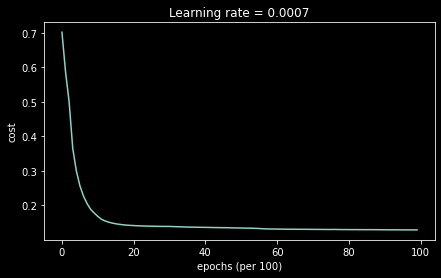

Accuracy: 0.94


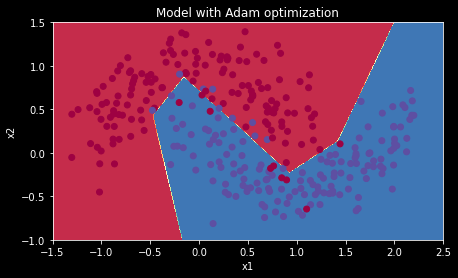

In [18]:
# train 3-layer model
layers_dims = [train_X.shape[0], 5, 2, 1]
parameters = model(train_X, train_Y, layers_dims, optimizer = "adam")

# Predict
predictions = predict(train_X, train_Y, parameters)

# Plot decision boundary
plt.title("Model with Adam optimization")
axes = plt.gca()
axes.set_xlim([-1.5,2.5])
axes.set_ylim([-1,1.5])
plot_decision_boundary(lambda x: predict_dec(parameters, x.T), train_X, train_Y)